In [1]:
import re
import nltk
import pickle
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
# !python -m nltk.downloader stopwords wordnet punkt averaged_perceptron_tagger # remove if not running on colab
from nltk.corpus import stopwords
from nltk.corpus import wordnet as wn
from nltk.stem import WordNetLemmatizer
from keras.preprocessing.text import Tokenizer 
from keras.preprocessing.sequence import pad_sequences
from keras.layers import Input, LSTM, Embedding, Dense, Concatenate, TimeDistributed, Bidirectional
from tensorflow.keras.layers import Attention
from keras.models import Model, load_model
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.preprocessing.text import Tokenizer 
from keras.preprocessing.sequence import pad_sequences
from keras.optimizers import RMSprop
from sklearn.model_selection import train_test_split
# !pip install rouge # remove if not running on colab
from rouge import Rouge

Using TensorFlow backend.
/bham/modules/roots/neural-comp/2019-20/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/bham/modules/roots/neural-comp/2019-20/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/bham/modules/roots/neural-comp/2019-20/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/bham

### Hyperparameters

In [2]:
BATCH_SIZE=40
EPOCHS=50
LATENT_DIM=256
EMBEDDING_DIM=128
TEST_TRAIN_SPLIT=0.15
LEARNING_RATE=0.005
PATH="../"
FILE_NAME="cnn-sp.csv"
MAX_TEXT_LEN = 250
MAX_SUMMARY_LEN = 20
UNCOMMON_WORD_THRESHOLD = 0
COLAB=False # true if running on colab
build_number="1"

In [3]:
# create rouge object for evaluation
rouge = Rouge()

## Data Processing

Read In Data

In [4]:
# Only needed if running on Google Colab
if COLAB:
  from google.colab import drive
  drive.mount('/content/drive')
  PATH = "./drive/My Drive/"

In [5]:
df = pd.read_csv(PATH + FILE_NAME)
print(df.head())

   Unnamed: 0                                            file  \
0           0  42c027e4ff9730fbb3de84c1af0d2c506e41c3e4.story   
1           1  ee8871b15c50d0db17b0179a6d2beab35065f1e9.story   
2           2  06352019a19ae31e527f37f7571c6dd7f0c5da37.story   
3           3  24521a2abb2e1f5e34e6824e0f9e56904a2b0e88.story   
4           4  7fe70cc8b12fab2d0a258fababf7d9c6b5e1262a.story   

                                                text  \
0  LONDON England Reuters Harry Potter star Danie...   
1  Editors note Behind Scenes series CNN correspo...   
2  MINNEAPOLIS Minnesota Drivers Minneapolis brid...   
3  WASHINGTON Doctors remove five small polyp Pre...   
4  National Football League indefinitely suspend ...   

                                             summary  
0  Harry Potter star Daniel Radcliffe gets 20M fo...  
1  Mentally ill inmates Miami housed forgotten fl...  
2  NEW thought going die driver says Man says pic...  
3  Five small polyps found procedure none worriso...

In [6]:
print(df.count)

<bound method DataFrame.count of        Unnamed: 0                                            file  \
0               0  42c027e4ff9730fbb3de84c1af0d2c506e41c3e4.story   
1               1  ee8871b15c50d0db17b0179a6d2beab35065f1e9.story   
2               2  06352019a19ae31e527f37f7571c6dd7f0c5da37.story   
3               3  24521a2abb2e1f5e34e6824e0f9e56904a2b0e88.story   
4               4  7fe70cc8b12fab2d0a258fababf7d9c6b5e1262a.story   
...           ...                                             ...   
92574       92574  e1fe287df99c17dff446cd0e814097b1784396a3.story   
92575       92575  0ac7adff1e1da0757f8ae1825872b0ac51236928.story   
92576       92576  1002ffb7a3bdaca4399f1c0f1774bd9ba31be097.story   
92577       92577  611b6133500989fb51cd81f280468f8d14f072e1.story   
92578       92578  8fa981f2a49b8833690e2ae82a5c37a89b5bbd31.story   

                                                    text  \
0      LONDON England Reuters Harry Potter star Danie...   
1      Editors not

Remove .'s that appear in stuff like U.S.A and U.N - Eventually need to move 
this to dataprocessing.py

In [7]:
print(df['summary'][0])
df['summary'] = df['summary'].apply(lambda x: re.sub(r'\..*$',' ',str(x)))
print(df['summary'][0])

Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings first five Potter films held trust fund
Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings first five Potter films held trust fund


In [8]:
print(df['summary'][0])
df['summary'] = df['summary'].apply(lambda x: re.sub(r'\.','',str(x)))
print(df['summary'][0])

Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings first five Potter films held trust fund
Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings first five Potter films held trust fund


Check for rows with null values in them, and copy these into a new dataframe (df1). Drop any rows in df1 from df to ensure no NaN valued rows are present

*Note. using simply dropna(how='any') does not seem to drop any of the rows*

In [9]:
print(df.isnull().values.any())
print(df.shape)

df1 = df[df.isna().any(axis=1)]
print(df1.shape)

df.drop(df1.index, axis=0,inplace=True)
print(df.shape)
print(df.isnull().values.any())

True
(92579, 4)
(114, 4)
(92465, 4)
False


Word Count Distribution

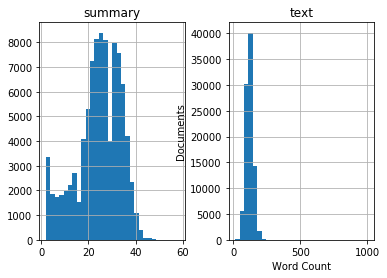

In [10]:
text_word_count = []
summary_word_count = []

# populate the lists with sentence lengths
for i in df['text']:
      text_word_count.append(len(i.split(' ')))

for i in df['summary']:
      summary_word_count.append(len(i.split(' ')))

length_df = pd.DataFrame({'text':text_word_count, 'summary':summary_word_count})

length_df.hist(bins = 30)
plt.ylabel('Documents')
plt.xlabel('Word Count')
# plt.savefig('word_count_distro' + str(build_number) + '.png')
plt.show()

Cut down text to MAX_TEXT_LEN words, and summaries to MAX_SUMMARY_LEN

In [11]:
print(df['text'][0])
df['text'] = df['text'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join(x[:MAX_TEXT_LEN]))
print(df['text'][0])

print(df['summary'][0])
df['summary'] = df['summary'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join(x[:MAX_SUMMARY_LEN]))
print(df['summary'][0])

LONDON England Reuters Harry Potter star Daniel Radcliffe gain access report 20 million 411 million fortune turn 18 Monday insists money wont cast spell  Daniel Radcliffe Harry Potter Harry Potter Order Phoenix disappointment gossip columnist around world young actor say plan fritter cash away fast car drink celebrity party  dont plan one people soon turn 18 suddenly buy massive sport car collection something similar told Australian interviewer earlier month  dont think Ill particularly extravagant  thing like buying thing cost 10 pound book CDs DVDs  Earlier year make stage debut play torture teenager Peter Shaffers Equus  Meanwhile brace even closer medium scrutiny he legally adult think Im go sort fair game told Reuters  Email friend Copyright 2007 Reuters  right reservedThis material may publish broadcast rewrite redistribute 
LONDON England Reuters Harry Potter star Daniel Radcliffe gain access report 20 million 411 million fortune turn 18 Monday insists money wont cast spell Dani

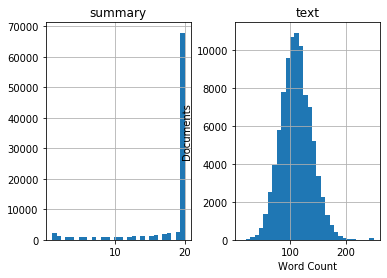

In [12]:
text_word_count = []
summary_word_count = []

# populate the lists with sentence lengths
for i in df['text']:
      text_word_count.append(len(i.split(' ')))

for i in df['summary']:
      summary_word_count.append(len(i.split(' ')))

length_df = pd.DataFrame({'text':text_word_count, 'summary':summary_word_count})

length_df.hist(bins = 30)
plt.ylabel('Documents')
plt.xlabel('Word Count')
# plt.savefig('word_count_distro_word_removal' + str(build_number) + '.png')
plt.show()

### Finding Uncommon Words and Removing Them.

Uncommon words are classified as those that occur in the whole corpus less times than UNCOMMON_WORD_THRESHOLD







#### Text

In [13]:
# x_word_dict = {}
# text = df['text'].apply(lambda x: nltk.word_tokenize(x))

# for index, row in text.iteritems():
#   for word in row:
#     if word not in x_word_dict.keys():
#       x_word_dict[word] = 1
#     else:
#       x_word_dict[word] += 1

# print(len(x_word_dict))
# # sort so that extracting acceptable words is more efficient for larger vocab sizes
# sorted_dict = sorted(x_word_dict.items(), key=lambda x: x[1], reverse=True)
# print(sorted_dict)
# x, y = zip(*sorted_dict)

In [14]:
# # find words that occur more than UNCOMMON_WORD_THRESHOLD times
# accept_words = []
# for word, occ in sorted_dict:
#   if int(occ) > UNCOMMON_WORD_THRESHOLD:
#     accept_words.append(word)
#   else:
#     break

# # remove uncommon words    
# accept_words = [x.lower() for x in accept_words]
# print(accept_words)
# print(df['text'][2])
# df['text'] = df['text'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join([word for word in x if word.lower() in accept_words]))
# print(df['text'][2])


In [15]:
# x_word_dict_after = {}
# text = df['text'].apply(lambda x: nltk.word_tokenize(x))

# for index, row in text.iteritems():
#   for word in row:
#     if word not in x_word_dict_after.keys():
#       x_word_dict_after[word] = 1
#     else:
#       x_word_dict_after[word] += 1

# print(len(x_word_dict_after))

#### Summaries

In [16]:
# y_word_dict = {}
# summary = df['summary'].apply(lambda x: nltk.word_tokenize(x))

# for index, row in summary.iteritems():
#   for word in row:
#     if word not in y_word_dict.keys():
#       y_word_dict[word] = 1
#     else:
#       y_word_dict[word] += 1

# print(len(y_word_dict))
# sorted_dict = sorted(y_word_dict.items(), key=lambda x: x[1], reverse=True)
# print(sorted_dict)
# x, y = zip(*sorted_dict)

In [17]:
# accept_words = []
# for word, occ in sorted_dict:
#   if int(occ) > UNCOMMON_WORD_THRESHOLD:
#     accept_words.append(word)
#   else:
#     break
     
# accept_words = [x.lower() for x in accept_words]
# print(accept_words)
# print(df['summary'][2])
# df['summary'] = df['summary'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join([word for word in x if word.lower() in accept_words]))
# print(df['summary'][2])

In [18]:
# y_word_dict_after = {}
# summary = df['summary'].apply(lambda x: nltk.word_tokenize(x))

# for index, row in summary.iteritems():
#   for word in row:
#     if word not in y_word_dict_after.keys():
#       y_word_dict_after[word] = 1
#     else:
#       y_word_dict_after[word] += 1
# print(len(y_word_dict_after))

View Word Distribution after uncommon word removal

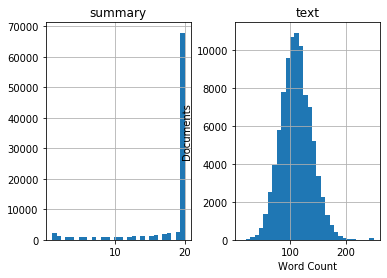

In [19]:
text_word_count = []
summary_word_count = []

# populate the lists with sentence lengths
for i in df['text']:
      text_word_count.append(len(i.split(' ')))

for i in df['summary']:
      summary_word_count.append(len(i.split(' ')))

length_df = pd.DataFrame({'text':text_word_count, 'summary':summary_word_count})

length_df.hist(bins = 30)
plt.ylabel('Documents')
plt.xlabel('Word Count')

# plt.savefig('word_count_distro_word_removal' + str(build_number) + '.png')
plt.show()

### Update Max Text Lenths After Uncommon Word Removal & Drop Empty Rows

In [20]:
print(df['text'][0])
df['text'] = df['text'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join(x[:MAX_TEXT_LEN]))
print(df['text'][0])

LONDON England Reuters Harry Potter star Daniel Radcliffe gain access report 20 million 411 million fortune turn 18 Monday insists money wont cast spell Daniel Radcliffe Harry Potter Harry Potter Order Phoenix disappointment gossip columnist around world young actor say plan fritter cash away fast car drink celebrity party dont plan one people soon turn 18 suddenly buy massive sport car collection something similar told Australian interviewer earlier month dont think Ill particularly extravagant thing like buying thing cost 10 pound book CDs DVDs Earlier year make stage debut play torture teenager Peter Shaffers Equus Meanwhile brace even closer medium scrutiny he legally adult think Im go sort fair game told Reuters Email friend Copyright 2007 Reuters right reservedThis material may publish broadcast rewrite redistribute
LONDON England Reuters Harry Potter star Daniel Radcliffe gain access report 20 million 411 million fortune turn 18 Monday insists money wont cast spell Daniel Radcli

In [21]:
print(df['summary'][0])
df['summary'] = df['summary'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join(x[:MAX_SUMMARY_LEN]))
print(df['summary'][0])

Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings
Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings


In [22]:
# update max text lengths
MAX_TEXT_LEN = max([len(txt.split(' ')) for txt in df['text']])
MAX_SUMMARY_LEN = max([len(txt.split(' ')) for txt in df['summary']])
print(MAX_TEXT_LEN)
print(MAX_SUMMARY_LEN)

250
20


In [23]:
# drop any lines that have no text or summary after the word removal process
print(df.isnull().values.any())
print(df.shape)

df1 = df[df.isna().any(axis=1)]
print(df1.shape)

df.drop(df1.index, axis=0,inplace=True)
print(df.shape)
print(df.isnull().values.any())

False
(92465, 4)
(0, 4)
(92465, 4)
False


### Add in start and end tokens to summaries
This is necessary to ensure that the model can tell when each summaries start and end

In [24]:
df['summary'] = df['summary'].apply(lambda x : 'sostok '+ x + ' eostok')
print(df['summary'].head())

0    sostok Harry Potter star Daniel Radcliffe gets...
1    sostok Mentally ill inmates Miami housed forgo...
2    sostok NEW thought going die driver says Man s...
3    sostok Five small polyps found procedure none ...
4    sostok NEW NFL chief Atlanta Falcons owner cri...
Name: summary, dtype: object


## Training-Validation Split

X - Articles text </br>
Y - Summaries

In [25]:
# convert to numpy array
X = np.array(df['text'])
Y = np.array(df['summary'])

In [26]:
x_tr,x_val,y_tr,y_val=train_test_split(X,Y,test_size=TEST_TRAIN_SPLIT,random_state=0,shuffle=True)
print(x_tr.shape)
print(x_val.shape)
print(y_tr.shape)
print(y_val.shape)

(78595,)
(13870,)
(78595,)
(13870,)


## Word Embeddings - Tokenization

X Tokenizer

In [27]:
word_dict = {}
text = df['text']

for row in text: 
  for word in row.split(" "):
    if word not in word_dict:
      word_dict[word] = 1
    else:
      word_dict[word] += 1

print(len(word_dict))

201145


In [28]:
#prepare a tokenizer for reviews on training data
x_tokenizer = Tokenizer(num_words=len(word_dict), split=" ") 
x_tokenizer.fit_on_texts(list(X))

#convert text sequences into integer sequences
x_tr_seq    =   x_tokenizer.texts_to_sequences(x_tr) 
x_val_seq   =   x_tokenizer.texts_to_sequences(x_val)

#padding zero upto maximum length
x_tr    =   pad_sequences(x_tr_seq,  maxlen=MAX_TEXT_LEN, padding='post')
x_val   =   pad_sequences(x_val_seq, maxlen=MAX_TEXT_LEN, padding='post')

#size of vocabulary ( +1 for padding token)
x_voc   =  x_tokenizer.num_words + 1
print(x_voc)

201146


In [29]:
with open('xtokenizer.pickle', 'wb') as handle:
  pickle.dump(x_tokenizer, handle, protocol=pickle.HIGHEST_PROTOCOL)

Y Tokenizer

In [30]:
y_word_dict = {}
summ = df['summary']

for row in summ: 
  for word in row.split(" "):
    if word not in y_word_dict:
      y_word_dict[word] = 1
    else:
      y_word_dict[word] += 1

print(len(y_word_dict))

89394


In [31]:
#prepare a tokenizer for reviews on training data
y_tokenizer = Tokenizer(num_words=len(y_word_dict), split=" ") 
y_tokenizer.fit_on_texts(list(Y))

#convert text sequences into integer sequences
y_tr_seq    =   y_tokenizer.texts_to_sequences(y_tr) 
y_val_seq   =   y_tokenizer.texts_to_sequences(y_val) 

#padding zero upto maximum length
y_tr    =   pad_sequences(y_tr_seq, maxlen=MAX_SUMMARY_LEN, padding='post')
y_val   =   pad_sequences(y_val_seq, maxlen=MAX_SUMMARY_LEN, padding='post')

#size of vocabulary
y_voc  =   y_tokenizer.num_words + 1
print(y_voc)
print(y_tokenizer.word_counts['sostok'],len(y_tr))

89395
92465 78595


In [32]:
with open('ytokenizer.pickle', 'wb') as handle:
  pickle.dump(y_tokenizer, handle, protocol=pickle.HIGHEST_PROTOCOL)

## Learning Model

#### Encoder Model

In [33]:
#encoder input
encoder_inputs = Input(shape=(MAX_TEXT_LEN,))
#embedding layer
enc_emb =  Embedding(x_voc,EMBEDDING_DIM,trainable=True)(encoder_inputs)
# bidirectional encoder lstm 
encoder_lstm = Bidirectional(LSTM(LATENT_DIM,return_sequences=True,return_state=True))
# outputs and encoder final states
encoder_outputs, fw_state_h, fw_state_c, bw_state_h, bw_state_c = encoder_lstm(enc_emb)

state_h = Concatenate()([fw_state_h, bw_state_h])
state_c = Concatenate()([fw_state_c, bw_state_c])
encoder_states = [state_h, state_c]

#### Decoder Model

In [34]:
# Set up the decoder, using `encoder_states` as initial state.
decoder_inputs = Input(shape=(None,))

#embedding layer
dec_emb_layer = Embedding(y_voc, EMBEDDING_DIM,trainable=True)
dec_emb = dec_emb_layer(decoder_inputs)

decoder_lstm = LSTM(LATENT_DIM*2, return_sequences=True, return_state=True)
decoder_outputs,decoder_fwd_state, decoder_back_state = decoder_lstm(dec_emb,initial_state=encoder_states)
                                                          
#dense layer 
#soft max creates a prob vector that allows us to determine the final output
decoder_dense = Dense(y_voc, activation='softmax')
decoder_outputs = decoder_dense(decoder_outputs)


#### Combined LSTM Model

In [35]:
# Define the model 
model = Model([encoder_inputs, decoder_inputs], decoder_outputs)

model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 250)          0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 250, 128)     25746688    input_1[0][0]                    
__________________________________________________________________________________________________
input_2 (InputLayer)            (None, None)         0                                            
__________________________________________________________________________________________________
bidirectional_1 (Bidirectional) [(None, 250, 512), ( 788480      embedding_1[0][0]                
____________________________________________________________________________________________

In [36]:
optimizer = RMSprop(lr=LEARNING_RATE, rho=0.9)

In [37]:
model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy')

- Early Stopping Callback to ensure we stop when Validation Loss is lowest - minimises risk of overfitting
- Model Checkpoint saves the model after each epoch so that we can load the model with the best weights later on. Alternatively, it allows us to continue training the model at a later data



In [38]:
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1,patience=2, restore_best_weights=False)
filepath = "./model/saved-model-{epoch:02d}.hdf5"
if COLAB:
  filepath = PATH + "project-model/saved-model-{epoch:02d}.hdf5"
mc = ModelCheckpoint(filepath, monitor='val_loss', verbose=0, save_best_only=False, save_weights_only=False, mode='auto', period=1)

#### Use this  to train a new model. To continue training a previously trained model see below

In [39]:
# reshape y from two dimensions to three dimensions
y_tr_3d = y_tr.reshape(y_tr.shape[0],y_tr.shape[1], 1)[:,1:]
y_val_3d = y_val.reshape(y_val.shape[0],y_val.shape[1], 1)[:,1:]

In [40]:
print(x_tr.shape)
print(y_tr.shape)
print(y_tr_3d.shape)
print(x_val.shape)
print(y_val.shape)
print(y_val_3d.shape)

(78595, 250)
(78595, 20)
(78595, 19, 1)
(13870, 250)
(13870, 20)
(13870, 19, 1)


In [41]:
history = model.fit([x_tr,y_tr[:,:-1]], y_tr_3d, batch_size=BATCH_SIZE, epochs=EPOCHS, callbacks=[es,mc], validation_data=([x_val,y_val[:,:-1]], y_val_3d))

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where

Train on 78595 samples, validate on 13870 samples
Epoch 1/50
78595/78595 [==============================] - 667s 8ms/step - loss: 7.3728 - val_loss: 7.0866
Epoch 2/50
78595/78595 [==============================] - 664s 8ms/step - loss: 6.9710 - val_loss: 7.0803
Epoch 3/50
78595/78595 [==============================] - 663s 8ms/step - loss: 6.8911 - val_loss: 7.0887
Epoch 4/50
78595/78595 [==============================] - 663s 8ms/step - loss: 6.6766 - val_loss: 6.9508
Epoch 5/50
78595/78595 [==============================] - 663s 8ms/step - loss: 6.3064 - val_loss: 6.7355
Epoch 6/50
78595/78595 [==============================] - 664s 8ms/step - loss: 5.9382 - val_loss: 6.8536
Epoch 7/50
78595/78595 [==============================] - 664s 8ms/step - loss: 5.7141 - val_loss: 6.9583
Epoch 00007: early stopping


#### This method is to only be used when loading a previously partially trained model

In [42]:
# model = load_model("./drive/My Drive/project-model/saved-model-53.hdf5")
# history = model.fit([x_tr,y_tr[:,:-1]], y_tr, callbacks=[mc], batch_size=BATCH_SIZE, epochs=1, validation_data=([x_val,y_val[:,:-1]], y_val))

### Plot training and validation loss overtime

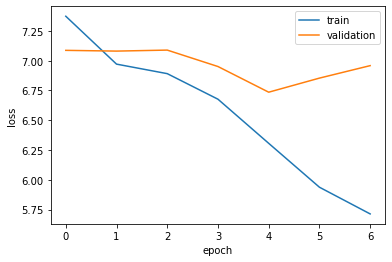

In [43]:
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='validation')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend()
# plt.savefig('loss' + str(build_number) + '.png')
plt.show()

## Inference Model

In [44]:
# load model from drive
# model = load_model("./drive/My Drive/saved-model-53.hdf5")

In [45]:
reverse_target_word_index=y_tokenizer.index_word
reverse_source_word_index=x_tokenizer.index_word
print(reverse_source_word_index)
print(reverse_target_word_index)
# used to get positions of sostok and eostok
target_word_index=y_tokenizer.word_index

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [46]:
# Encode the input sequence to get the feature vector
encoder_model = Model(inputs=encoder_inputs,outputs=[encoder_outputs, state_h, state_c])

In [47]:
encoder_model.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 250)          0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 250, 128)     25746688    input_1[0][0]                    
__________________________________________________________________________________________________
bidirectional_1 (Bidirectional) [(None, 250, 512), ( 788480      embedding_1[0][0]                
__________________________________________________________________________________________________
concatenate_1 (Concatenate)     (None, 512)          0           bidirectional_1[0][1]            
                                                                 bidirectional_1[0][3]      

In [48]:
# Decoder setup
# Below tensors will hold the states of the previous time step
decoder_state_input_h = Input(shape=(LATENT_DIM*2,))
decoder_state_input_c = Input(shape=(LATENT_DIM*2,))
decoder_hidden_state_input = Input(shape=(MAX_TEXT_LEN,LATENT_DIM*2))
decoder_state_inputs = [decoder_state_input_h, decoder_state_input_c]

# Get the embeddings of the decoder sequence
dec_emb2= dec_emb_layer(decoder_inputs) 
# To predict the next word in the sequence, set the initial states to the states from the previous time step
decoder_outputs2, state_h2, state_c2 = decoder_lstm(dec_emb2, initial_state=decoder_state_inputs)
decoder_states = [state_h2, state_c2]
# A dense softmax layer to generate prob dist. over the target vocabulary
decoder_outputs2 = decoder_dense(decoder_outputs2) 

# Final decoder model
decoder_model = Model([decoder_inputs] + [decoder_hidden_state_input,decoder_state_input_h, decoder_state_input_c], [decoder_outputs2] + decoder_states)

In [49]:
decoder_model.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, None)         0                                            
__________________________________________________________________________________________________
embedding_2 (Embedding)         (None, None, 128)    11442560    input_2[0][0]                    
__________________________________________________________________________________________________
input_3 (InputLayer)            (None, 512)          0                                            
__________________________________________________________________________________________________
input_4 (InputLayer)            (None, 512)          0                                            
____________________________________________________________________________________________

### Methods for Reversing Word Embeddings

In [50]:
def seq_to_text(input_seq, summary):       
  textString=''
  if not summary:
      for i in input_seq:
          if(i!=0):
              textString = textString + ' ' + reverse_source_word_index[i]
  else:
      for i in input_seq:
          if((i!=0 and i!=target_word_index['sostok']) and i!=target_word_index['eostok']):
              textString = textString + ' ' + reverse_target_word_index[i]
  return textString 

### Summarisation Method 

In [51]:
def decode_sequence(input_seq):
    # Encode the input as state vectors.
    e_out, e_h, e_c = encoder_model.predict(input_seq)
    # Generate empty target sequence of length 1.
    target_seq = np.zeros((1,1))
    # Populate the first word of target sequence with the start word.
    target_seq[0, 0] = target_word_index['sostok']
    stop_condition = False
    decoded_sentence = ''

    while not stop_condition:
        output_tokens, h, c = decoder_model.predict([target_seq] + [e_out, e_h, e_c])
        # Sample a token
        sampled_token_index = np.argmax(output_tokens[0, -1, :])
        sampled_token = reverse_target_word_index[sampled_token_index]
        
        if(sampled_token!='eostok'):
            decoded_sentence += ' '+sampled_token

        # Exit condition: either hit max length or find stop word.
        if (sampled_token == 'eostok'  or len(decoded_sentence.split()) >= (MAX_SUMMARY_LEN-1)):
            stop_condition = True

        # Update the target sequence (of length 1).
        target_seq = np.zeros((1,1))
        target_seq[0, 0] = sampled_token_index
        # Update internal states
        e_h, e_c = h, c

    return decoded_sentence

## Test Model Output

In [52]:
def getRouge(gt, pred):
  return rouge.get_scores(pred, gt)

In [53]:
for i in range(0,10):
    print("----------------------")
    article = seq_to_text(x_tr[i], False)
    original = seq_to_text(y_tr[i], True)

    if (original !=""):
      print("Article: " + article)
      print("Original summary:", original)
      # reshape data into correct format for encoder (1, max_text_len)
      x_tr_i_reshaped = x_tr[i].reshape(1,MAX_TEXT_LEN)
      summary = decode_sequence(x_tr_i_reshaped)
      print("Generated summary:",summary)
      print("\n")

      if summary != "":    
          print("ROUGE score: ")
          score = getRouge(str(summary), str(original))
          print(score)
          print(score[0].get('rouge-1').get('f'))
          print(score[0].get('rouge-1').get('p'))
          print(score[0].get('rouge-1').get('r'))

----------------------
Article:  hundreds russians hit street moscow sunday rally promote peace equality response rash ethnic violence unrest staterun medium report moscow everyone demonstration pushkin square drew 1500 participant accord ria novosti people come intend put event occur moscow december 11 15 say viktor shenderovich one event organizer believe riot moscow cause pu burst police officer set metal detector around square check knife weapon bid avoid repeat street violence earlier month december 15 police arrest 200 people downtown moscow four day later seize weapon bid prevent clash ethnic russians member caucasus ethnic group russian news agency report ilya kubrakov suspect riot ringleader three others arrest december 17 role sviridovs death moscow court announce accord ria novosti russian president dmitry medvedev blame rash ethnic violence investigator release suspect sviridovs death news agency report medvedev call authority take measure punish responsible crime
Original 

Generated summary:  ireport


ROUGE score: 
[{'rouge-1': {'f': 0.999999995, 'p': 1.0, 'r': 1.0}, 'rouge-2': {'f': 0.0, 'p': 0.0, 'r': 0.0}, 'rouge-l': {'f': 0.9999999999995, 'p': 1.0, 'r': 1.0}}]
0.999999995
1.0
1.0
----------------------
Article:  hong kong majority people west banking easy walk local branch atm log account computer million develop country even bank account reach india least could change vodafone india icici bank indias large private bank launch mpesa mobilebased money transfer payment service first establish kenya 2007 partnership announce news release april 17 claim give mobilebanking access 700 million indian people currently unbanked people access conventional banking service like bank branch atms 2011 india alone add 142 million new mobile phone subscription twice many whole africa europe middle east former soviet republic combine accord international telecommunication union itu june 2012 report 2000 2011 india record enormous boom cell phone subscription grow 35

In [54]:
for i in range(1243,1253):
    print("----------------------")
    article = seq_to_text(x_tr[i], False)
    original = seq_to_text(y_tr[i], True)

    if (original !=""):
      print("Article: " + article)
      print("Original summary:", original)
      # reshape data into correct format for encoder (1, max_text_len)
      x_tr_i_reshaped = x_tr[i].reshape(1,MAX_TEXT_LEN)
      summary = decode_sequence(x_tr_i_reshaped)
      print("Generated summary:",summary)
      print("\n")

      if summary != "":    
          print("ROUGE score: ")
          score = getRouge(str(summary), str(original))
          print(score)
          print(score[0].get('rouge-1').get('f'))
          print(score[0].get('rouge-1').get('p'))
          print(score[0].get('rouge-1').get('r'))

----------------------
Article:  news make headline personal story make last impact people touch life million year cnn invite people share personal essay world deliver dozens ireporters courage pour heart unforgettable story pain loss joy courage anger many publish cnncom parenting huge topic year ensue medium coverage cnn others prompt investigation incident marion county police got story share wed love see cnn ireport cnns sarah brown henry hanks katie hawkinsgaar rachel rodriguez nicole saidi daphne sashin christina zdanowicz david williams contribute report
Original summary:  got deeply personal 2013 essays parenting gun control essays sparked passionate conversations among others could relate one story caught
Generated summary:  george washington post reporter stephen colbert


ROUGE score: 
[{'rouge-1': {'f': 0.0, 'p': 0.0, 'r': 0.0}, 'rouge-2': {'f': 0.0, 'p': 0.0, 'r': 0.0}, 'rouge-l': {'f': 0.0, 'p': 0.0, 'r': 0.0}}]
0.0
0.0
0.0
----------------------
Article:  get decide end 

Generated summary:  gen


ROUGE score: 
[{'rouge-1': {'f': 0.0, 'p': 0.0, 'r': 0.0}, 'rouge-2': {'f': 0.0, 'p': 0.0, 'r': 0.0}, 'rouge-l': {'f': 0.0, 'p': 0.0, 'r': 0.0}}]
0.0
0.0
0.0
----------------------
Article:  michiganders look work might want keep eye peel superman zack snyders upcoming man steel sequel star brit actor henry cavill superman ben affleck batman slat film metro detroit throughout michigan michigan film office announce thursday warner bros production earn 35 million incentive 131 million project rack instate expense also expect upcoming release hire 400 worker create equivalent 426 fulltime job bit good news follow dreary summer july detroit become americas large city declare bankruptcy addition cavill affleck much way internets chagrin sequel also star amy adams lois lane laurence fishburne perry white diane lane martha kent snyder strongly hint summer batman superman rival installment beyond mythological superman new batman face since great superheroes world say 

## Evaluation

Using ROUGE (Recall-Orientated Understanding Gisting Evaluation) to evaluate the generated summaries.

*Note: This takes a long time, especially with large datasets* 

### For Training Data

In [55]:
print(len(x_tr))

78595


In [57]:
tr_target_summary = []
tr_generated_summary = []
x_tr_len = len(x_tr)

f_ov = 0
p_ov = 0
r_ov = 0
# x_val_len = 1
for i in range(0,x_tr_len):
  print(i)
  original = seq_to_text(y_tr[i], True)
  if original != "" :
      tr_target_summary.append(original)
      x_i = x_tr[i].reshape(1,MAX_TEXT_LEN)
      summary = decode_sequence(x_i)
      print(i)
      print(original)
      print(summary)
      print("-----")
      if summary != "":
          tr_generated_summary.append(summary)
          score = getRouge(str(summary), str(original))
          f_ov += float(score[0].get('rouge-1').get('f'))
          p_ov += float(score[0].get('rouge-1').get('p'))
          r_ov += float(score[0].get('rouge-1').get('r'))

0
0
 people attend moscow everyone rally staterun media reports event aimed promote peace several incidents violence turmoil began killing krygyz
 new opposition leaders gathered moscow rally friday new president vladimir putin putin putin putin putin putin putin putin
-----
1
1
 carrying 14 people crashed mountains north sumatra air official says flight bound aceh province crashed two children two infants
 plane went missing plane went missing plane crash eastern u
-----
2
2
 write captions backs photos toss bad duplicate pictures put rest boxes albums photos one topic one trip store photos
 photographer mike nichols spent photo favorite photo photo shows shot death photographer mike
-----
3
3
 new york fashion week runs thursday february 19 expect bespoke tailoring cinched waists 1970s vibes
 new york fashion designer new york fashion designer
-----
4
4
 ohio woman suffered gunshot wound first u
 ohio ohio state university texas killed 2010 2010 shooting spree st
-----
5
5
 daniel ye

43
 american horror story freak show premiered wednesday fourth installment fx miniseries viewers sufficiently scared
 jennifer lawrence premiered sunday night live sunday night live sunday night live
-----
44
44
 fancast xfinity tv goes live tuesday internet tv subscribers service follows trend trying keep users abandoning cable tv web
 microsoft releases android ios 7
-----
45
45
 around country creating bucket lists lists include anything see sunsets climb mount everest tj liston took family 10day canoe
 former french prime minister david cameron visits home invasion owner
-----
46
46
 man jim friel often faces innately hostile question single asks confirmation sexuality thrall tyranny coupledom doesnt claim single state
 david rothkopf womens rights groups leader criticized saying would make sure
-----
47
47
 afghans say u
 army staff sgt
-----
48
48
 found 1000 important documents paolo gabrieles possession among original documents signed pope benedict xvi many newspaper clippings

85
 torres love star trek inspired dedicate life nasa despite told woman couldnt work space program persisted one first women
 michelle wie spent time life terms russian athlete
-----
86
86
 beckham picked groin strain mls western conference final sunday los angeles galaxy lost match 30 fc dallas home depot
 ac milan coach fabio capello says teams play role sporting tournament st
-----
87
87
 breyer 74 fell bike near korean war veterans memorial underwent reverse shoulder replacement surgery supreme court says breyer expected
 former marine corps engineers attend memorial service u
-----
88
88
 dr
 new dr
-----
89
89
 seated courtroom began talking loudly campaign finance reform spectator outbursts rare supreme court justices ignored incident man led security
 former prosecutor officer darren fletcher case involving controversial remarks gen
-----
90
90
 nightcrawler appears edge ouija
 film planet apes film festivals film sequel film sequel film sequel film
-----
91
91
 husain died lo

134
 writers facebooks sandberg anomaly 7
 facebook post posts facebook posts facebook
-----
135
135
 union negotiating nfl fund study look variety health issues faced pro football players proposal study longterm health 200 players
 nfl players asked nfl draft agreement dr
-----
136
136
 five people still hospital one critical condition new flashing yellow lights warn motorists bridge megabus way toronto route company
 new york city official says incident occurred near atlanta airport boston marathon bombings reported injured
-----
137
137
 random humorous win day top blogs include pictures kids crying silly reasons actresses teeth humans new york poignant creating
 cnn ireport boot camp challenges ireporters share experiences cnn ireport
-----
138
138
 tv debates arrived uk 2010 broadcasters keen repeat headtohead format runup 2015 poll factional politics arguments invited may derail
 david rothkopf former world
-----
139
139
 mourning appear eduardo campos campaign website campos wel

178
 reentry expected 1145 p
 nasa official says mission ukraine u
-----
179
179
 preservation order senior pentagon official says order potentially could cover thousands civilian military personnel official says next step could
 u
-----
180
180
 owners irish daily star profoundly dismayed publication images palace motivation action greed editor irish daily star says catherine different
 queen elizabeth ii britains prince william british royal editor british newspaper editor newspaper newspaper newspaper editor newspaper
-----
181
181
 related accusations amado boudou economy minister alleged used influence give company controlled currencyprinting contract boudou argentinas first sitting vice
 former president xi jinping accused bribery bribery underage underage taiwan u
-----
182
182
 intelligence minister met french delegation spokesman says wsj israel used information obtained try undercut support deal allegations utterly false
 new iran says israel iran talks israeli prime minister

224
 15 protesters ryan gosling masks showed outside peoples headquarters wednesday gosling issue hits newsstand friday along 123 hot guys
 new york city council says new york city mayor
-----
225
225
 doesnt ukraine problem rather one russia al larson argues larson says focus western policymakers reengage russia trade negotiations u
 eu european union address europes highest ratings world governing
-----
226
226
 toronto man looking canadian woman named elizabeth gallagher booked several plane tickets exgirlfriends name march trip includes flights milan
 couple rescued couple couple expecting baby child photographer edward snowden named airport trip
-----
227
227
 one handful northern white rhinos left worldwide male fate subspecies rests ability conceive two females conservancy experts trying various
 south african nation history u
-----
228
228
 week coincides anniversary elvis presleys death august 16 1977 week kicks tupelo mississippi singer born elvis memphis home graceland
 cnn 

266
 national stadium polish capital warsaw opened sunday poland ukraine host forthcoming euro 2012 football tournament national stadium host opening
 fans celebrate opening ceremony poland ukraine tournament organizers hope fans welcome poland ukraine tournament organizers hope fans
-----
267
267
 obeidallah popular films come attack loose facts says film gravity clearly science fiction need factcheck every point documentary filmmakers
 film based true story film theater massacre film director sam mendes brings together film
-----
268
268
 lohan going guest star 2 broke girls shell play bridetobe needs wedding cake episode scheduled air april 14 addition
 actress jennifer lawrence reportedly expecting second child star wars star wars star wars star wars
-----
269
269
 new state news agency denies plan take mukalla yemeni official says foiled plot doesnt appear linked threat concerned u
 yemeni officials say yemeni forces killed yemeni government official says yemeni official killed ye

308
 dollars spent useless failed cancelled projects building teton dam took four years collapse took one afternoon 12 billion superconductor
 cities worlds largest cities u
-----
309
309
 kurtz weve seen media seize parade trivial statements campaign cites binders full women horses bayonets big bird kurtz says
 former president obama mitt romney campaign campaign campaign ads organizers say
-----
310
310
 nation member annette millers new motto life comparison fine line inspiration comparison says miller comparing others makes objectivity impossible
 bob greene learned heart disease born raised fears parents born
-----
311
311
 anthony cordesman tension u
 iranian nuclear weapons iran says iran iran wants sanctions iran nuclear power iran nuclear talks iran u
-----
312
312
 petersons mother scott peterson right blog prison scott peterson convicted deaths laci unborn child sharon rocha doesnt spend lot
 richard c
-----
313
313
 kerry kennedy daughter late sen
 former florida gov
-----


351
 scenarios violent police actions firefights play modern warfare 2 locales game include afghanistan kazakhstan brazil russia player modern warfare
 u
-----
352
352
 fire campaign office iranian president mahmoud ahmadinejad two adults child wounded attack ahmadinejad present attack happened near shia mosque
 new syrian president calls calm unity opposition group says attackers killed teacher gunmen killed opposition group
-----
353
353
 newtown felt every corner every store every church idyllic new england town rolling hills town green 100foot flagpole notable
 14yearold girl shot isis started nonprofit campaign knife attack
-----
354
354
 new york police obtain search warrant boys 1979 disappearance case rosemary hernandez lawyer feels strongly confession unreliable pedro hernandez
 new jersey police officer killed teen suspect custody new jersey suspect custody case authorities believe suspect
-----
355
355
 florida governor last week rejected 2
 new yorks gov
-----
356
356
 comp

394
 ingram worked fbis mississippi office turbulent 1960s 2005 bureau asked help reexamining unsolved cases work helped convict james ford
 fbi says fbi agent robert durst allegedly shot killed 2010 fbi says fbi investigating killings
-----
395
395
 basnet revealed sunday night 2012 cnn hero year basnet supports children nepal dont live behind bars parents named hero
 child refugee camp nepal nepal born nepal nepal born raised nepal children born raised nepal
-----
396
396
 4 6 u
 u
-----
397
397
 tanzanian leaders threaten evict maasai community create conservation corridor 60000 tanzanian maasai live 4000 sq
 africa middle east africa
-----
398
398
 voted fifa world player year european player year also represented portugal world european finals ronaldo signed manchester united sporting
 manchester united defender play manchester united defender portugal defender united states u
-----
399
399
 startup world competitive fragmented fast moving internetenabled devices wearable tech hot

440
 police investigating killing lawmaker early tuesday first legislator assassinated island nation death comes amid period political turmoil maldives
 egyptian president says egyptian president killed attack gen
-----
441
441
 mcrae lived 22 different homes abandoned parents one house accidentally shot caretakers grandson mcrae eventually adopted plans help kids
 dr
-----
442
442
 civilian witness says one touched actress inappropriately nypd says bynes squeakyclean teen image actress sloughs cops account says pot
 rapper arrested allegedly saying girlfriend rihanna police say rape victim revealed investigation
-----
443
443
 second day war games dubbed great prophet six iran announced monday built first ballistic missile silos iran aired video
 iranian ministry defence launches video showing nuclear power iranian ministry defence releases video showing signs sanctions korea launched
-----
444
444
 supermodel natalia vodianova runs naked heart foundation dream foundation build 500 pl

487
 ozolins carried latvian flag sochi games 1996 stanley cup colorado avalanches played total 875 nhl games scoring 167 goals
 eric schmidt says world championships moscow sochi 2014 winter olympics sochi olympics sochi olympics
-----
488
488
 champion andy murray beaten bulgarias grigor dimitrov dimitrov crushes briton 61 76 62 quarterfinal clash centre court bulgarian face
 roger federer loses andy murray win 2013 world
-----
489
489
 countries meet opposition william hague says britain seeking step pressure syria foreign secretary says hague urges opposition groups unify
 syrian opposition group urges syrian rebels syrian rebels syrian opposition group says syrian rebels sudan
-----
490
490
 metal detectorist found treasure field staffordshire england hoard described largest ever found including 1500 pieces value find said priceless
 british artist killed olympic committee london 2012 olympics
-----
491
491
 investigate possible federal violations ole miss statue incident attorney

527
 information detainees started chain events led raid trusted osama bin laden courier key locating bin laden u
 osama bin laden killed osama bin laden u
-----
528
528
 spanish media reported rosalia mera suffered stroke menorca selfmade billionaire aged 69
 sri lankas government official says german club died aged 11 2001 f
-----
529
529
 reports say competency hearing changeofplea hearing january 2011 attack kills 6 wounds 13 loughners mental condition central court proceedings
 new judge orders suspect scheduled appear court august 8
-----
530
530
 way fight flu including h1n1 virus get vaccinated eat lean protein fatfree dairy products good fats boost immune system
 cdc director dr
-----
531
531
 district attorneys association 13 killings past 100 years two prosecutors killed one texas county recently law enforcement memorial d
 new ohio state sen
-----
532
532
 ids 30 u
 new taliban commander gen
-----
533
533
 tigers shut advance american league championship series new baltimor

567
 disco inferno appeared saturday night fever soundtrack song grammy trammps singer jimmy ellis 74
 sang song music stars famed musician mike treisman says music legend christopher lee
-----
568
568
 cruise ship hits container vessel thick fog coast vietnam hit full force side container ship passenger says silversea describes
 incident occurred port authority official says crew members airport ships captain headed airport bus carrying fuel
-----
569
569
 kimoon warns african union forces short resources joseph kony wanted international criminal court accused crimes humanity alleged use child
 u
-----
570
570
 hauntrepreneur runs four haunted houses husband two adult sons haunted house association says business booming despite lean economy 20
 bob greene boston marathon bombings boston marathon bombings one worlds largest cities u
-----
571
571
 include 2 3 americans 1 british woman kenyas foreign minister says americans 18 19 somali origin said recruitment video
 nigerian military o

609
 new officials lab tests sample products plant taken plainview peanut co
 products sold u
-----
610
610
 energy reform access education pave way prosperity obama says new obama tells parents urge children aspire beyond ballers rappers
 obama spoke presidents speech obama obama spoke address u
-----
611
611
 open fire police station army camp authorities say gun battle army camp continuing military officials says indian premier calls
 new u
-----
612
612
 davis nominated awards season kerry washington star tv shows tied producer shonda rhimes maybe hollywood isnt progressive thinks one
 j
-----
613
613
 position responsibility little clout job created recommendation 911 commission cia director answers dni paper practice previous dnis john negroponte
 president bush issued apology obama administration sought inquiry benghazi investigation u
-----
614
614
 barrel bombs drums packed explosives shrapnel level entire buildings one hit days earlier u
 new syrian prime minister calls gover

651
 death row inmates electrocuted lethal injection drugs unavailable state make electrocution mandatory states use electric chair option drugs lethal
 arizona state department official says arizona state law allow samesex marriage
-----
652
652
 analysts say al qaeda arabian peninsula al qaedas effective affiliate group exploiting political turmoil yemen houthi rebels fighting government
 isis syria u
-----
653
653
 say flight 370 diverted likely terrorists responsible peter bergen says known terrorist groups seem unlikely involved jemaah islamiyah presence
 peter bergen says u
-----
654
654
 russians targeted includes vladimir putins closest aides highestranking politicians influential businessmen among listed informal aides longterm allies putin banned
 new president xi jinping meets gen
-----
655
655
 victoria azarenka defeats samatha stosur win qatar open doha world
 world no
-----
656
656
 greece swears new cabinet bringing end months political uncertainty national bank chairman

694
 royals make postseason first time 29 years beat oakland 98 game lasted nearly 5 hours
 alex trebek joined coaching game basketball club says club owner killed football coach mike mclelland wife son
-----
695
695
 page super bowl ad fame congenital heart disease actor eight surgeries date 8yearold uses voice raise money childrens hospital
 dr
-----
696
696
 american citizen sentenced eight years allegedly violating state secret laws u
 u
-----
697
697
 hasan testifies expected discuss religious justifications actions suspect advised judge good policy represent hasan barred arguing defense others
 army maj
-----
698
698
 denied prosecutions motion gag order noted court could reconsider attorneys case say anything prejudicial neighborhood watch volunteer george zimmerman
 trayvon martin case judge rejects appeal case judge rejects appeal
-----
699
699
 prime minister david cameron cracking internet porn cameron wants uks internet service providers filter porn default access pornograp

737
 pulls back fuelband apple speculation emerges companies ties apple ceo analyst says makes sense nike leave hardware others longrumored
 ceo tim cook ceo tim cook ceo tim cook ceo tim cook cook cook cook cook cook cook
-----
738
738
 padmanathan wasselfappointed leader tamil tigers sri lankan military defeated tamil tigers year tigers fought 25year war seeking independent state
 sri lanka tamil tigers tamil tigers tamil tigers
-----
739
739
 writes anonymously frustration pregnant twins ivf online commenters call selfish bitter ungrateful multiple births common ivf doctors becoming cautious
 parents share common core mom
-----
740
740
 100 efforts star wars episode vii lucasfilm says revised 3d release plans announced later date star wars episode vii
 new movie star wars star wars star wars star wars star wars star wars
-----
741
741
 actress called police help lawyer says lindsay lohan checked betty ford center september fails drug test ordered go jail
 new jersey police say mom a

776
 highlights release political prisoners peace efforts ethnic groups significantly reduces number myanmar officials subject travel restrictions australian government also
 myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar
-----
777
777
 customers clear bottled water market shelves restaurants take precautions several water districts including parts portland affected boil notice earliest
 louisiana gov
-----
778
778
 indiana first lady never forget horrific event perished state fair reopens monday beginning memorial service indiana governor officials focused
 new york church closed friday eastern u
-----
779
779
 looks indigenous idea carry china forward 21st century transition modern state anything smooth writes says chinese know agree china
 china beijing beijing worlds largest u
-----
780
780
 attorneys office hernandez charged assault battery tied fight allegedly punched fellow inmate february e

814
 max foster spent time prince charles camilla duchess cornwall camilla declined interviewed foster says couple seem close connected
 prince william kate middleton u
-----
815
815
 slow deployment troops hindered aid deployment relief group says aid starting reach chiles regions national emergency office says stores
 new president says quake left germany trapped rubble saturday 11 people injured quake
-----
816
816
 one u
 china president xi jinping expected rise
-----
817
817
 fleeing drought fighting central southern somalia others may returning conditions displacement camps million somalis displaced throughout country abroad supplies
 new u
-----
818
818
 tried wearing clothing deemed indecent jailed refusing pay fine sudanese court spared female journalist lashing wearing tight trousers faced
 former journalist accused raping 14yearold girl son former boyfriend accused raping 14yearold girl
-----
819
819
 degrasse tyson stirs controversy christmas day tweets tweet marking isaac 

855
 picasso mondrian stolen raid national art gallery athens thief thieves tricked guard deactivating alarm broke balcony door raider dropped
 photographer describes stolen egyptian artist stolen british museum art museum museum museum opened
-----
856
856
 help jessica get professor glenn mcclure used say passionate africa college president says jessica buchanan poul thisted rescued overnight
 cnn heroes asked families tell cnn
-----
857
857
 claims 20 victory chile leroy fer memphis depay goals means dutch wins group b chile qualifies second place spain
 euro 2012 qualifying victory spain spain beat germany 31 euro 2012 victory poland ukraine
-----
858
858
 denied allegations forced students work assembly lines worker rights group claims schools force students paid internships group english finance
 u
-----
859
859
 citys fire department classifies blaze northeast dallas sixalarm fire two firefighters injured expected ok least five residents rescued
 explosion happened near fort lau

895
 sky news drivers found guilty possession tv equipment police claim defendants journalists men deny claim drivers sentenced six months
 former deputy prime minister arrested last week former pm arrested last week former pm arrested last week
-----
896
896
 alexander says calling criminal friends starts interesting exchange many us even obama commit small crimes still think good citizens
 cnn
-----
897
897
 teachers finding work teaching greek language south africa teachers pay relocation south africa still receive salary greek government 50000
 south africa
-----
898
898
 philip rubio says u
 u
-----
899
899
 cultural influences malaysia among diverse countries asia despite global downturn nation remains one asias vibrant economies national cuisine exotic
 hong kong indonesia hong kong countrys economic boom countrys economic boom chinas growing economic boom chinas growing economic boom
-----
900
900
 queen rania voted spirit
 queen elizabeth ii brings together message power arab 

937
 another attempt could happen week perhaps thursday felix baumgartner hopes first person break sound barrier without vehicle risks include
 new mexico
-----
938
938
 prewitt baby conceived rape faced another unexpected ordeal prewitt found majority states give parental rights men father rape became
 ruben navarrette u
-----
939
939
 jersey mayor demands gun safety views gun manufacturers questions posed firms bidding sell guns jersey city police mayor hopes
 mayor says mayor bill de blasio fired gun control campus
-----
940
940
 number one golfer tiger woods become dad second time wife elin gave birth boy charlie axel sunday woods says
 tiger woods pulls golf course golf course no
-----
941
941
 family actress brittany murphy hold private service christmas eve service hollywood hills forest lawn cemetery christian jewish clergy family
 actress stabbed son family family family family family family family says
-----
942
942
 obama retakes oath office wednesday night new obama meets m

979
 policy wont affect law enforcement agencies fall homeland security rules product nearly five years internal debate fbi agents says
 new ban ban u
-----
980
980
 khanfar former director general al jazeera head istanbul think tank middle east beyond clarity beyond understanding says khanfar khanfar
 peter bergen says arab spring crisis u
-----
981
981
 rahman among 52 total indicted deadly 2004 attack political rally mother former premier blames political vendettas prosecution rahman lives
 former prime minister prime minister convicted genocide murder charges prime minister vladimir putin calls
-----
982
982
 pregnant teen boyfriend suspect murders michigan authorities say young couple suspected killer met online couple apparently agreed sex money
 police say suspect identified suspect identified suspect identified suspect identified suspect identified suspect identified suspect identified suspect
-----
983
983
 zelizer says harry reid appeared giving bipartisanship says democrats 

1021
 fbi n
 new york subway system attack occurred fort lauderdale county official says fbi investigating drone strikes
-----
1022
1022
 interesting cd dvd boxed sets available time holidays beatles mono collects fab fours mono mixes criterion 25disc akira kurosawa
 new video clip shows anticipated korean leader michael bay area
-----
1023
1023
 fiorina also tells msnbc john mccain isnt ready run corporation fiorina ceo hewlettpackard mccain adviser also says barack obama
 former aide facing tough questions daily barack obama campaign trail romney holds questioning late saturday
-----
1024
1024
 center obamacare website first official apologize rocky rollout republicans say presidents obamacare promise misleading administration cites massachusetts health care
 rep
-----
1025
1025
 stanislas wawrinka denies roger federer first title monte carlo world
 roger federer loses semifinals wta finals istanbul world
-----
1026
1026
 numbers 112 americans killed year compared 111 last year opera

1060
 hancocks crew first international news team reach tacloban hancocks debris destruction everywhere relief efforts early stage roads inaccessible hard
 cnn affiliate reports quake strikes boat carrying western port city refugee camp near refugee camp
-----
1061
1061
 new u
 new samesex marriage ban samesex marriage ban religious freedom religious marriage religious freedom religious freedom frida ghitis u
-----
1062
1062
 north koreas charm offensive coincides release u
 north korean leader kim jong un north korean leader kim jong un pyongyang wants u
-----
1063
1063
 interview hong kong opening retrospective exhibition work animated talking everything apart fashion media boring
 hong kong fashion designer former model fashion designer former model artist
-----
1064
1064
 alpine bolthole getting multimillion dollar upgrade josef stalins retreat resort town sochi host 2014 winter olympics leaving albania 1939
 new jersey shore team usa host 2014 winter olympics russian president vla

1102
 kehoe slashed sons throats left dead tried kill prosecutor says iowa jury hears tape surviving boy telling police mother
 new suspect allegedly tried murder victim says son victim treated knife suspect
-----
1103
1103
 second round wimbledon roger federer drops fifth rankings 17time grand slam champion hasnt low since june 2003 federer unusually
 andy murray wins masters title world no
-----
1104
1104
 boxer floyd mayweather jr
 floyd mayweather jr
-----
1105
1105
 midgett finds shipwreck regular beachcombing route beachcombers found numerous coins items wreck winter storms uncovered wreck historians feared would
 police say crew members owner owner rescued apparently apparently apparently apparently apparently apparently apparently pulled boat carrying
-----
1106
1106
 isaf confirms attack taliban suicide bomber one person killed 10 others wounded isaf leader says 911 changed world six
 taliban commander u
-----
1107
1107
 taylor already labor moore tornado roared toward hospita

1143
 monkey key authors tale worst hair day lisa kogan still struggles impulse control victim tell story laugh
 author story man started dating photo book describes writing eyes eyes
-----
1144
1144
 authorities release videos austin fire vehicle say people jeep tied anarchist group one charged arson fire caused heavy damage
 authorities say suspect identified gunman man apparently knife authorities say suspect identified gunman man apparently knife suspect
-----
1145
1145
 greene andy griffith died recalled awshucks sherriff andy taylor stunning performance gave earlier first film antithesis tv role face
 former footballer andy coulson former footballer robert f
-----
1146
1146
 court nothing cover military operations nato says libyan official white house spokesman calls another sign gadhafi lost validity state
 new libyan official says libyan ambassador u
-----
1147
1147
 racing magnate jack roush transferred mayo clinic roush facial surgery tuesday night ntsb says roushs plane roll

1182
 allows zimmerman defense introduce trayvon martins toxicology report teenager thc active ingredient marijuana system report says prosecutors objected admission
 trayvon martins mom says client trayvon martin case trial case prosecutor prosecutor says case
-----
1183
1183
 syrian national council also urges nofly zone least 45 women children said stabbed burned death tuesday day mourning opposition
 new syrian president calls shooting u
-----
1184
1184
 novak djokovic retains china open title beating rafael nadal sundays final nadal toppled serbian world
 novak djokovic beats roger federer 63 64 63 64 opening match swiss maestro world
-----
1185
1185
 months overthrow hosni mubarak egypt scene protests activists calling end militarys hold power demonstrations cairos tahrir square met violence
 egyptian protests egyptian capital cairo revolution egyptian womens rights groups leader mohamed morsi
-----
1186
1186
 part series promote old spice body sprays campaign called smellcome ma

1227
 designer kenya hara created stylish dog kennels architecture dogs supply free blueprints 13 different diy doghouses hara mulling idea
 underground hotel destination u
-----
1228
1228
 beat fulham 21 samir nasir scoring twice go top english premier league chelsea missed chance go top everton draw
 arsenal beat arsenal 21 arsenal newcastle united arsenal beat arsenal 21 arsenal newcastle united
-----
1229
1229
 hong kong fastest peak connection speeds past 50 mbps south korea japan also lead global rankings compiled akamai
 hong kong hong kong protests started track field moscow 2012 olympics
-----
1230
1230
 official clashes happened four places southern province dhaleh ministry says 14 soldiers captured resident bullets entered home numerous clashes
 new yemeni army spokesman calls operation military official says gen
-----
1231
1231
 payments company square announced new ipad stand credit card reader countertop unit usb port plug cash drawers printers bar
 new jersey shore servi

1266
 surgeon unsuccessfully attempts remove patients brain tumor later day reads cnn
 dr
-----
1267
1267
 congo reputation conflict violence campaigner congo native vava tampa says theres another side country immense natural beauty thanks rainforests
 myanmar myanmar congo decades worlds highest mountain gorillas u
-----
1268
1268
 syrian opposition leader says opposition groups meet decide approach kerry syrian opposition calling alassad go join talks william hague
 syrian opposition leader calls alassad address syrian regime bashar alassad regime syrian regime bashar alassad syrian regime
-----
1269
1269
 kindle fire hd good tablet best price consumer reports gave thumbsup citing improvements original reviewers like screen physical improvements
 company tablet smartphone unveiled friday new device sold 3
-----
1270
1270
 fire breaks clothing factory north dhaka least 7 reported dead cause immediately known
 least 15 people killed hundreds thousands hong kong government official says

1308
 born eight limbs makes first public appearance since surgery surgeons say lakshmi tatma two coping well making good progress
 new south korean prime minister arrives meet first blast since 2009
-----
1309
1309
 activist citing intensity gunfire predicts death toll rise protesters attacked maaret alnouman witnesses say 3800 syrian refugees fled turkey
 syrian opposition group calls calm unrest syria
-----
1310
1310
 bieber dont think sex anyone unless love bieber doesnt want become american citizen young singer 20 pushups performing warm
 justin bieber caroline wozniacki reportedly interviews christopher dorner
-----
1311
1311
 shorts representative would release details wifes death paramedics called couples home medical emergency saturday short nancy dolman married 30
 new family attend funeral home funeral home family says couple met family members family members family
-----
1312
1312
 twothirds surveyed say u
 cuban government says u
-----
1313
1313
 ozawa musical director bos

1351
 idea showing public emotion unbritish thing says richard quest usual time nation rallies behind queen celebrates diamond jubilee
 queen elizabeth ii hosted royal photo exhibition st
-----
1352
1352
 corn weighed 300 pounds fall 2011 started watching diet power walking lose weight since started road trip corn lost
 dr
-----
1353
1353
 twodrug combination never used u
 new army maj
-----
1354
1354
 russian lawmaker pushes exception children disabilities measure bans adoption russian children u
 new russia russia sanctions russia sanctions russia sanctions russia sanctions russia sanctions russia sanctions russia sanctions
-----
1355
1355
 league final provides brilliant showcase brand germany bundesliga clubs strong indigenous corporate engagement expert sponsor fan cooperation clubs greater
 chelsea take chelsea football club chelsea boss alex ferguson u
-----
1356
1356
 lily dionne says duped antiislam filmmaker knows filmmaker sam bacile shaking found
 film based true story man 

1394
 people stood trial deadly 2013 attack tiananmen square left six dead three accused given handed death sentences court urumqi
 mumbai attacks muslims china taiwan hong kong court sentenced death 2010 killing muslims 2005
-----
1395
1395
 players suspended indefinitely head coach nick saban says two victims said attacked robberies police said wtvm two players accused
 retired gen
-----
1396
1396
 new alleged ringleader detained 2 18 charged large spokesman says set panama later moved peru macho sports customers u
 federal prosecutors accuse alleged excessive force carolina complained fake snowden allegedly refused file complaint
-----
1397
1397
 hard partiers jam streets cape town south africa january 2 12 icelandic bonfires dot reykjavík bars open little midnight
 hotel chain reopens hour ahead hotel chain hong kong
-----
1398
1398
 ambassador mr
 new u
-----
1399
1399
 law disqualifies people standing election convicted court myanmar court convicted suu kyi last summer breaching 

1443
 adcock investigators need look closely flight 370s cargo manifest adcock malaysian officials said jet carrying 440 pounds lithium ion
 airlines flight 370 disappeared american airlines flight 370 disappeared american airlines
-----
1444
1444
 islamist terrorist attack ever france followed weeks warnings french officials threat terrorist attack eu greater time since 911 officials
 isis al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula u
-----
1445
1445
 attorney says completely 100 shocked news gregory peterson charged 25 counts sexual crimes four women allege assaulted peterson found
 rape victim describes case shocked rape case case case case case case case case
-----
1446
1446
 born karol wojtyla lived wadowice poland 18 wadowice created trail takes places frequented future pope youth devouring local cream
 pope francis takes streets st
-----
1447
1447
 queen elizabeth ii spent 50 minutes visiting husband hospital duke edinburgh admitted hospital 

1485
 mustafa tamimi among dozens protesters gathered west bank protesting encroachment nearby israeli settlement
 new protesters rally cairo headquarters egyptian pm says egyptian president calls resignation u
-----
1486
1486
 crashed july 17 eastern ukraine killing 298 board crash report says plane brought highenergy objects dutch foreign minister said
 new russian official says russian official russia u
-----
1487
1487
 new president obama talk syria capitol hill tuesday qatar says examining options deal syria syrian president tells u
 new syrian ambassador syria isis talks ambassador u
-----
1488
1488
 allow residents greer arizona return homes weather conditions expected improve tuesday winds lessen humidity increase week goes acres destroyed
 new mexico city official says residents ready start new york city city official says
-----
1489
1489
 richie havens came wide fame opening act woodstock died monday wrote recollection festival cnn
 festival takes place organizers gather cele

1527
 dioguardi new judge american idol dioguardi successful songwriter written pink gwen stefani dioguardi says shell tough fair paula abdul
 tv producer ron howard
-----
1528
1528
 sanders charged fourthdegree sex offense lawyer told baltimore sun charges fabricated
 rapper arrested allegedly driving intoxicated sexual assault allegations sexual assault allegations sexual assault allegations sexual harassment u
-----
1529
1529
 madrid salvage 22 draw atletico madrid derby los blancos stay top la liga cristiano ronaldo scores late equalizer barcelona
 la liga leaders barcelona beat barcelona 31 milan lose 31
-----
1530
1530
 testing minor privacy settings changes give users control new privacy checkup popup aimed users havent adjusted settings company bumpy
 facebook posts facebook posts facebook posts facebook posts facebook posts facebook posts facebook website posts facebook
-----
1531
1531
 new firefights going 10 days residents say one mexico soldier among dead drug suspects ambu

1570
 j
 phil mickelson returns mens womens downhill title world championships schladming u
-----
1571
1571
 judge dismisses companys attempt dismiss widows damage suit chiquita admitted making payments colombian rebels theyre like household name
 new u
-----
1572
1572
 increasingly seek reunions onceinstitutionalized relatives sent institutions form developmental disability 1967 many 100000 children housed 162 state facilities u
 parents filed divorce proceedings labor day care worker says u
-----
1573
1573
 injured violence throughout country state media says promorsy groups says nine people killed one neighborhood alone military helicopter crashes
 new least 13 people killed clashes opposition group says attackers killed opposition group says
-----
1574
1574
 pictures represent online help people know theyve found photo include clues life say facebook users occasion change profile photos
 photographer facebook posted photo photo instagram photo photo instagram photo photo instagram 

1613
 women bad relationships share wakeup moments one womans decision invite husbands 10 children wedding backfired michelle barrett mended relationship
 mom asked son together dating mom love son asked son together love family dating
-----
1614
1614
 jo myong rok vice marshal korean peoples army died heart disease saturday death great loss pyongyang says
 north korean leader kim jong un north korean leader kim jong un pyongyang north korean leader kim jong
-----
1615
1615
 illegal immigrants say fear new crackdown authorities running immigration checks people arrested irving deportations sharply since crackdown began
 new mexico leaders say theyre worried immigrants abroad robert e
-----
1616
1616
 hit united states 50 years ago influence touched lives spread throughout globe diane salsbery lifelong collector beatles memorabilia kurt
 bob greene recalls songs
-----
1617
1617
 japans foreign minister katsuya okada apologizes s
 japanese prime minister detained japanese prime minister 

1654
 kayongo donating soap impoverished countries via global soap project cnn hero personally delivered first box free soap kenya last
 cnn heroes selected refugee camp camp founder kenyan orphans
-----
1655
1655
 haiti earthquake victims check charities impact world fbi says dont click links files unsolicited donation request emails ever donate
 cnn
-----
1656
1656
 recovery work ends nairobi pipeline explosion new red cross says 82 bodies recovered new police pegged number 76 investigation
 explosion occurred near naples building pipeline exploded building pipeline exploded
-----
1657
1657
 armed groups syria sides conflict recruiting children u
 syrian refugee camp syrian refugee camp syrian refugees lebanon lebanon lebanon syrian refugee camps u
-----
1658
1658
 sign eightyear contract brand clubs training kit uniteds carrington training ground londonbased insurer act presenting partner manchester united tour
 manchester united manchester united arab emirates giants manchester cit

1696
 win three gold medals second night track field jessica ennis mo farah greg rutherford triumph hosts claim six golds
 olympic committee usa olympic gold medal winning olympic gold medal winner
-----
1697
1697
 report examines abuse abuse january 1975 may 2004 earlier report detailed allegations child abuse institutions across ireland institutions linked
 child abuse priests legal benedict xvi calls allegations sexual abuse priests child labor day
-----
1698
1698
 lifethreatening illnesses get wishes orlandos famous parks sierra club groups offer opportunities families good sweat trekking kids requires participants
 cnn heroes marks anniversary
-----
1699
1699
 displays made mist air next step visual technology displair users need wear special glasses screen responds intuitively hand movements
 internet sensation drive using mobile technology tools see technology help build nuclear power
-----
1700
1700
 got first reports early monday 4 smart cars tossed happened within residential

1738
 carlottas eye 10 miles southsouthwest puerto angel mexico new hurricaneforce winds probably already occurring hurricane center says storm gained
 new mexico
-----
1739
1739
 flight deck officers lose certification effective midnight tonight certifications extended six months light recent events official says officials said
 u
-----
1740
1740
 atomic bomb used battle 68 years ago hiroshima japan nearly 200000 people killed including died aftermath 70000 killed second
 u
-----
1741
1741
 returns two patients doctors hoped cured virus virus became undetectable patients eight months bone marrow transplants researcher says return
 dr
-----
1742
1742
 global tourist attractions disappointing visit eiffel tower statue liberty pyramids list treasury ancient city petra jordan voted best place
 visitors counted poland unveiled londons statue londons museum londons statue liberty londons o2 arena
-----
1743
1743
 reason wait summer head beach spring hotel prices point pleasant new jersey lo

1783
 sell cast new zealands pm wore broke arm sold charity online auction ended sunday winning bid nz18500 us 9362
 new ceo tim cook ceo tim cook ceo tim cook ceo tim cook served u
-----
1784
1784
 national climate assessment includes regional reports themes include infrastructure risks rising oceans changing energy needs forecasts included six u
 u
-----
1785
1785
 cnn
 gen
-----
1786
1786
 christophers new novel age atomic spans scifi fantasy spectrum book picks christophers previous novel empire state left private eye
 marvel comics launched airstrikes 3d
-----
1787
1787
 perris thousand years sets tone twilight saga breaking dawn part 1 dont let inclusion bruno mars song fool thinking
 vow promote film stars hollywood stars hollywood stars hollywood stars
-----
1788
1788
 couple married france weekend parents six children pitt jolie together almost decade
 daughter visits church maria alyokhina husband met children nepal
-----
1789
1789
 belounis says qatar deserves host world cup

1825
 tebow part threemember clutch team ea sports madden bowl xviii quarterback says happy part video game tournament ea keeps
 nfl game played basketball game u
-----
1826
1826
 vettel wins canadian grand prix montreal red bull star leads start finish extend championship lead german 36 points clear
 new teammate lewis hamilton wins grand prix pole position championship leader lewis hamilton wins race lewis hamilton
-----
1827
1827
 sought relax rules banning small knives commercial flights plan never took effect following strong criticism congress airlines unions ban
 u
-----
1828
1828
 tony designed clothes samuel l
 rory mcilroy fined 100000 golf balls tournament 2012 tournament organizers say masters tournament
-----
1829
1829
 apple offering easy streaming mlb nba games two subscription models mlb
 apple ceo tim cook apple ceo tim cook apple ceo tim cook u
-----
1830
1830
 victims shooting senseless stupid act terri lamanno therapist worked visually impaired children reat griffin

1864
 historians ranked former presidents various leadership qualities abraham lincoln ranked highest similar survey done 2000 james buchanan watched nation
 bush says george washington bush bush met french president francois hollande visits florida 2008
-----
1865
1865
 hollande reminds obama made promise french people france continue support afghanistan different way france 3300 forces afghanistan
 president obama speaks u
-----
1866
1866
 cheney written new book president james madison interview cnn also talks politics family jeb bush would make great contribution
 former presidents became first nation leader since 2001 u
-----
1867
1867
 negotiations countrys main aviation workers union collapsed strike turkish airlines could go effect 3 a
 turkey says u
-----
1868
1868
 new u
 new syrian rebels syrian rebels battling islamist militants syria isis fighters syrian rebels syrian rebels u
-----
1869
1869
 surely president staff make best decision says julian assange holed ecuadorian e

1906
 american sniper widow left speechless nonprofit donates raffle proceeds family americansnipers
 new film shot killed august 21 marks 50th anniversary shooting spree
-----
1907
1907
 india highest suicide rate worldwide ages 15 29 father recounts finding son dead exam results due suicide prevention worker
 former marine cpl
-----
1908
1908
 eleventh body found site west albuquerque new mexico one body found earlier identified prostitute reported missing 2004 first bodies
 bodies found since january 1 bodies found home body bodies found body bodies found saturday bodies found
-----
1909
1909
 perception moms better parents dads mom doesnt like feel child loves dad advice appreciate another pair hands help parenting
 mom daughter mom daughter mom asked son grandson mom daughter mom asked daughter mom mom
-----
1910
1910
 says son stopped killing alleged molester knife raymond frolander 18 charged sexual battery 11yearold boy 911 call dad tells
 mom sister says daughter mom asked son

1948
 granderson rihanna seems reunited chris brown beat 2009 says pair flaunts intimacy social media rihanna sending poor message says
 rapper tweets
-----
1949
1949
 pay 7 million victims 2006 shooting bell married following day bell killed friends seriously wounded police acquitted 2008 justice
 new york city mayor bloomberg calls investigation nypd officer killed officer shooting death 2010 shooting
-----
1950
1950
 pakistani lawmaker says hell pay 200000 filmmakers death pakistans railway minister offering 100000 bounty party condemns action saying opposes
 pakistan prime minister condemns attack pakistans prime minister erdogan calls pakistans prime minister condemns attack pakistans prime minister
-----
1951
1951
 scott hain shot death lebanon pennsylvania home meleanie hain brought loaded gun daughters soccer game 2008 police avoiding calling
 police say suspect shot killed girlfriend knife suspect shot killed eyes
-----
1952
1952
 carolina man says spent 66 days alone sea resc

1987
 adventures include james bondstyle takeoff schilthorn majestys secret service filmed trick staying air find circle around air currents known
 jennifer lawrence opens u
-----
1988
1988
 allegedly offered 5yearold internet chat undercover police officer chat began source told police saw man performing sex acts boy
 child custody fbi posted youtube video posted youtube video posted youtube video posted youtube video posted youtube video posted
-----
1989
1989
 users create list tv shows worth binging beginning end list includes ongoing dramas like game thrones orphan black fan
 peter bergen charlie hebdo shooting london 2012 shooting happened
-----
1990
1990
 doc watson critical condition resting followup procedure rep says watson 89 recovering colon surgery wake forest baptist medical center
 former marine cpl
-----
1991
1991
 centers using virtual worlds complement therapy addiction selfhelp already large feature second life psychologists say patients might distance avatar
 dr
---

2030
 implants made french company pip found contain industrialgrade silicone 300000 women 65 countries received implants made company health authorities
 u
-----
2031
2031
 rodger killed six people including 20yearold christopher martinez police said rodgers martinezs fathers met june 1 fathers day photos
 jordan one victims family says son jordan davis 17 shot killed jordan jordan
-----
2032
2032
 either half javier pastore zlatan ibrahimovic earn paris saint germain 20 win toulouse reigning champions montpellier lose reims 31
 france beat french football federation beat st
-----
2033
2033
 shepherd rescues crew alleged poaching ship chased 110 days conservationist group pursued vessel since found illegally fishing antarctica says
 boat carrying u
-----
2034
2034
 united named worlds valuable club forbes sixth straight year real madrid come second list arsenal third barcelona fourth top
 manchester united beat newcastle united states manchester united states israel u
-----
2035
2035


2070
 martin says lebron james grown man made grownup decision says james doesnt owe former employer city loyalty martin james
 donald sterling spoke nba commissioner donald nfl commissioner donald nfl commissioner says donald sterling
-----
2071
2071
 gregg describes strange behavior father ariel castro visited took forever answer door says also says basement always locked wouldnt
 teen kidnapped girls amanda bynes accused raping 14yearold girl 8
-----
2072
2072
 prince bandar bin sultan u
 saudi arabia saudi arabia saudi intelligence chief says saudi intelligence chief says u
-----
2073
2073
 designated national park 1947 south florida place american crocodile american alligator coexist everglades actually southwestwardly flowing river swamp park
 new species shark attack san diego california california hawaii
-----
2074
2074
 korea says plans launch rocket carrying satellite month countries say move cover ballistic missile test journalists granted rare access
 north korea says launc

2116
 sd eibar set play first ever match spains top tier sunday minnows take local basque rivals real sociedad ipurua
 german bundesliga club teams beat freiburg 31 euro 2012 matches spain germany
-----
2117
2117
 jensen 18 noticed lack showers recent visit williston north dakota williston epicenter regions oil boom many oil workers wait
 u
-----
2118
2118
 nigerian finance minister ngozi okonjoiweala freed kamene okonjo abducted five days ago home okonjo well good health police spokesman
 nigerian journalist abducted journalist camp nigeria journalist abducted journalist camp camp camp camp camp camp camp camp camp u
-----
2119
2119
 nfl players wayne clark fred mcneill participated ucla study protein tau linked brain disease found brains mcneill earlystage dementia
 dna tests showed signs trauma autism
-----
2120
2120
 offers nyc loft lieu 2 million bail anna gristina get jail hearing held thursday consider proposal gristina 44 accused
 rapper arrested last week charges filed tradema

2156
 return home wildfire evacuees police say state faces perhaps worst drought since records began 100 years ago governor asks
 new mexico city official says residents ready open fire started building
-----
2157
2157
 launches antidumping antisubsidy inquiries european wine imports probe seen retaliation eu tariffs chinamade solar panels one day earlier france
 hong kong european commission chairman european commission european commission european commission european commission 2012 european commission
-----
2158
2158
 suspected gunman worked company victims new recently dismissed due drug related issues embassy says shooting happened saudi arabias capital
 new u
-----
2159
2159
 painting bought part job lot auction 46 30 art experts say work english artist john constable worth 390000 250000
 london 2012 sells auction london 2012 kenyan forces used value items included huge collection includes
-----
2160
2160
 plus celebrates first birthday launches new features google plus events in

2198
 miles mississippi river closed new orleans southward closure could last days cleanup could take weeks coast guard says 400000
 new u
-----
2199
2199
 martins mom seeks trademark trayvon justice trayvon familys lawyers say trademarks keep unscrupulous profiting martins name family also would
 trayvon martin case trayvon martin case george zimmerman filed case george zimmerman filed complaint filed
-----
2200
2200
 caused 38 deaths since sunday 67yearold woman killed florida tornado struck mayflower vilonia arkansas sunday ef4 alabama official residents
 new u
-----
2201
2201
 allows passengers unlimited travel month jetblue 599 clark dever joe dinardo going cities 12 hours getting next flight travelers
 airport airline says plane landed safely airport reopens
-----
2202
2202
 justices raise previous affirmative action case wonder aloud theyre hearing new one new conservative justices seize initiative arguments application
 supreme court ruling party express students teachers union

2241
 ac milan chelsea striker andriy shevchenko retires football forward joined political party ukraine forward shevchenko hopes share experience gained
 former club world cup euro 2012 qualifying euro 2012
-----
2242
2242
 egypts presidential elections protesters clashed military cynthia schneider khaled abol naga military abuses arrested detained say ruling military councils
 egyptian president says egyptian president says egyptian president says egyptian president ruling party express concern
-----
2243
2243
 woman tells cnn shed rather die live wartorn neighborhood far areas internet service thursday connected opposition says outage sparks
 new syrian prime minister benjamin netanyahu calls internet threat syrian government forces
-----
2244
2244
 started massive explosion early friday graffiti found two san juan tunnels made reference fires puerto rico receive fuel imports
 new u
-----
2245
2245
 violence campaign teams nfls ad group super bowl commercial ad inspired domestic vio

2280
 husband wife say escaped taliban pakistan military says two kidnapped july pakistan taliban say group released couple
 pakistani taliban says kidnapped taliban militants pakistan taliban claimed responsibility pakistan taliban claimed responsibility
-----
2281
2281
 rapper dolla mourn loss atlantabased rapper killed beverly center mall los angeles family releases statement asking privacy mourn dolla
 police say suspect shot killed hollywood home police say suspect shot killed august 8
-----
2282
2282
 mukesh kapila united nations top official sudan 2003 since year estimated 300000 darfuris killed died says u
 u
-----
2283
2283
 possession crack carries severe sentence powder cocaine phillips disparity doesnt prove racism prompted 1980s crime wave oneparent families responsible
 jordan spieth describes writing society mr
-----
2284
2284
 de waal boston suspects chechen minority group suffered russia de waal parents two savage wars russia displaced homeland suspects
 new delhi u
--

2322
 fight erupted saturday climbers guides handwritten agreement pledges fights mountain climber says money western attitudes anger sherpas
 new st
-----
2323
2323
 new defense begin case thursday cindy anthony breaks tears several points casey anthony accused killing 2yearold daughter caylee 2008
 judge rejects request defense attorney says case involving george
-----
2324
2324
 novak djokovic crushes tomas berdych world tour finals london djokovic secures yearend
 roger federer loses semifinals serbia 2012 world no
-----
2325
2325
 many looking happiness dont realize already funeral director finds happiness job helping grieving people lachelle claims happiness even bad
 bob greene describes cnn hero son world soldier
-----
2326
2326
 ferrari atlanta artist whose work blurs lines street public art graffiti otherwise known street art becoming widely accepted art
 new york city council building
-----
2327
2327
 three israeli teens sparked national grief killing palestinian teen sparke

2364
 ms
 richard quest puts characters creative team submit book look like book
-----
2365
2365
 report recommends u
 u
-----
2366
2366
 macapagalarroyo arrested hospital treated hypertension shell remain hospital health wont allow moved official says shes accused fraudulently transferring money
 new president says hospital treated hospital hospitals authorities say
-----
2367
2367
 gaga appeared struggle since release album artpop album sales werent high earlier ones appearance sxsw festival included vomit art
 rock band mates claim song music video games
-----
2368
2368
 tsipras sworn greeces new prime minister greeces antiausterity party syriza claimed victory parliamentary elections european central bank said greece
 greek greek prime minister erdogan threatens attend state union address economic crisis
-----
2369
2369
 world trade center ruled taller willis tower council tall buildings says 1wtc measures 1776 feet 1wtc completed expected worlds
 new york city council building new

2406
 japans puffer fish capital home market specializing deadly sea creature trained specialists need remove liver ovaries roe kidneys fugu
 passengers crew members rescued japanese waters near indonesia south africa indonesia islands u
-----
2407
2407
 brossier french oceanographer living aboard yacht canadian arctic young family brossiers spent past eight winters aboard boat northern polar
 richard quest revealed french hospital plane went missing plane went missing
-----
2408
2408
 one dead 12 injured tripoli fire naval fuel storage facility nato carried bombing campaign sirte saturday sunday antigadhafi fighters
 new u
-----
2409
2409
 park sites saw fewer visitors last year mostly shutdown hundreds millions visitors still explored national parks seashores sites california
 korean parks marks end year year highest mountain peak weekend trip site
-----
2410
2410
 sam smith wins best new artist best pop vocal album beyonce 20 grammys passing aretha franklin
 awards announced retirem

2448
 myanmars first vice president resigns health reasons officials said illness military members parliament choose new vice president
 president filed ministers constitution constitution constitution constitution constitution follows political parties
-----
2449
2449
 mourinho tells manchester uniteds wayne rooney decide future lies chelsea manager two bids rejected england striker mourinho speaking chelseas
 jose mourinho chelsea boss jose mourinho u
-----
2450
2450
 electronic records hid thomas eric duncans travel history hospital says thomas eric duncan denied contact ebola liberia official says
 ebola patient u
-----
2451
2451
 eyewitness said turned black five minutes cleared severe weather caused significant damage bridgeport connecticut mayor put bridgeport state emergency
 new dozens people injured hundreds thousands homes destroyed damaged hundreds thousands homes damaged vehicles
-----
2452
2452
 scandal involves allegations payments popular party leaders december survey s

2492
 northern germany charged 58 counts killing jewish laborers killings took place weeks end world war ii man accused part
 new suspect allegedly ahmed shafik shot gunmen stormed home suspects former attackers charged killings
-----
2493
2493
 joseph walker new jersey detective charged seconddegree murder maryland state police say fatally shot driver joseph harvey jr
 suspect allegedly shot killed girlfriend authorities say suspect shot head knife suspect allegedly tried stop shooting
-----
2494
2494
 cristina spain appears saturday private proceeding buenos dias says upon entering hasta luego says upon departure cristina husband accused
 former royal family attend ceremony honoring juan mata visits appeals court ruling party express
-----
2495
2495
 cnn senior editor middle east affairs hackers definitely shiites twitter hacked early friday group claiming iranian cyber army popular
 wikileaks founder anonymous claimed responsibility attack twitter account twitter accounts twitter ac

2534
 ziegel lost arm part skull attacked iraq va initially rated brain injury 0 meaning got compensation another vet va
 retired gen
-----
2535
2535
 floridas governor calls day prayer unity 22 states laws saying residents duty retreat attackers national rifle association defends laws
 new jersey gov
-----
2536
2536
 republican dan sullivan defeated democratic sen
 democratic sen
-----
2537
2537
 girl pushed pile burning embers man late teens man charged attempted murder assault took place indias uttar pradesh state
 india authorities say mom injured girl beaten stabbed pregnant woman pakistan authorities say
-----
2538
2538
 cohen edward erikson serious solving student debt crisis cohen erikson root problem influence money politics students suffer sallie mae
 president obama says u
-----
2539
2539
 moviegoing easy ateam starring bradley cooper based 1980s tv series get greek starring russell brand opens theaters next week
 disney releases trailer premiered wednesday film stars hollyw

2578
 president obama pledges 15 million humanitarian aid new libyas foreign minister accuses western nations helping divide country nato begins
 new u
-----
2579
2579
 oregon boasts breweries city world san diego chosen host 2012 world beer cup olympics beer philadelphia beer explorers mustsee
 cities worlds largest cities u
-----
2580
2580
 top gop attorneys considering lawsuits challenging obamas immigration overhaul texas oklahoma attorneys general said theyll sue states could join
 attorney general eric holder says gop governors office state attorney general says state department official says
-----
2581
2581
 ban france extended bars clubs restaurants cafes jan 1 smoking ban first introduced february 2007 public buildings workplaces 13
 european commission reports 100000 people hong kong european commission 2012 competition
-----
2582
2582
 ahmed hashim abed accused planning 04 slayings mutilations 4 u
 lance cpl
-----
2583
2583
 americans could dramatically improve gas mileage d

2621
 federer rafael nadal win opening matches 2010 atp tour circuit worlds top two players triumph straight sets first round
 roger federer loses semifinals french open world no
-----
2622
2622
 park game set hit stores second half 2012 game available playstation 3 xbox 360 pcs roleplaying game firstperson shooter
 jason lewis returning u
-----
2623
2623
 surviving khmer rouge leader declared fit trial nuon chea righthand man late cambodian leader pol pot khmer rouge regime
 new former bosnian serb leader mladic face trial genocide terrorism trial adjourned january 1
-----
2624
2624
 didnt publicize crime local newspaper reported plea deal week man held developmentallydisabled relative captive since 13 raul ochoa richmond
 sex offender pleads guilty arraignment set 2009 kidnapping sex offender case
-----
2625
2625
 travel site gogobot names travelers picks best kids attractions u
 1
-----
2626
2626
 roils whether soldiers killed search former comrades accuse bergdahl desertion though 

2666
 egan pulitzer prize novel visit goon squad egan also landed spot times 100 influential list egans inspiration goon squad
 david rothkopf talks cnn
-----
2667
2667
 wonders many americans dont accept theory evolution comes six reasons including misunderstanding fear says divine creation cries praise regardless
 author says u
-----
2668
2668
 transportation safety board released final report 2013 accident investigators said actions cockpit crew caused crash san francisco boeing 777
 capt
-----
2669
2669
 hummer came define machismo america ashamed sticky note left hummer said hummer owners rally behind beloved behemoths
 bob greene americas tv owner bob greene americas tv owner americas owner americas largest africanamerican
-----
2670
2670
 thailands third prime minister four months youngest 60 years leader democrat party since 2005 leads coalition government career politician
 new prime minister gordon brown says prime minister gordon brown
-----
2671
2671
 vicepresident says wor

2709
 skepticism dominates house sentiment proposed syria strike house returns monday majority leader eric cantor says vote could slip following
 obama administration announced airstrikes isis syria iraq syria isis wants become u
-----
2710
2710
 farrell led bioterrorism rapid response advanced technology lab farrell submitted resignation tuesday potential anthrax exposure happened june 6 june
 new tests suggest testing testing testing testing testing testing testing testing testing testing testing testing testing testing testing testing
-----
2711
2711
 frida ghitis shocked death friend facebook says news pointed facebook friends real friends online people express special openness says
 cnn heroes asked readers share thoughts comments world
-----
2712
2712
 exclusive 12 individuals face asset freezes visa bans two key aides president vladimir putin controversial tv anchor list 33
 new u
-----
2713
2713
 large cheering crowds brave freezing weather see support obama borrows lincoln urg

2752
 initially said imam framed teen girl accused burning quran pages three witnesses recanted statements made police based partly statements
 pakistani taliban accused killing rape delhi pakistan taliban claimed responsibility
-----
2753
2753
 aircraft manufacturer set test fly new cseries commercial jet company hope challenge singleaisle jets bigger rivals 3 billion invested
 airlines ceo u
-----
2754
2754
 analysts assess basra fighting says iraqs future michael ware iran fosters clashes among rival shiite factions michael holmes crisis
 iraqs prime minister calls iraqi forces killed iraqs finance minister says u
-----
2755
2755
 court struck key part voting rights act left congress address gap theres little political incentive republicancontrolled house change law
 new supreme court ruling party express concern independent panel challenge ruling party express
-----
2756
2756
 david ranta served 21plus years killing brooklyn rabbi 1990 witness told prosecutors hed coached former in

2794
 netflix bringing back 80s cartoon inspector gadget episodes premiere u
 netflix released friday night live 3d printing 3d printer arent popular music streaming service
-----
2795
2795
 singletons vehicle strikes woman 57 stepped street singleton sober charged allowed leave questioning director nominated two oscars boyz n
 new york police officer stephen colbert apparently apparently shot stabbed death investigated murder death source says
-----
2796
2796
 kathy ireland quit worrying image start taking care heart oprahs trainer bob greene weight gain often signal something else
 david rothkopf months ago former world correspondent year award winner dr
-----
2797
2797
 u
 china sees chinese president xi jinping china japan open letter beijing
-----
2798
2798
 simonson wasnt fond mike fieseler dating mother mom died mike came funeral helped kate brother eventually adopted kids helped
 mom mom mom mom mom mom mom mom mom mom mom mom mom mom mom mom mom mom mom
-----
2799
2799
 wind f

2834
 roger bergendorff charged possession toxin firearms hospitalized ricin exposure found hotel room cousin charged failing report production possession
 man apparently went missing saturday night authorities say suspect apparently pulled body investigation
-----
2835
2835
 considered litmus test prime minister manmohan singhs government voters back regional samajwadi party giving decisive majority 224 seats results
 south indian pm narendra modi holds ahead elections elections sunday
-----
2836
2836
 week senate republicans defeated international convention disability rights misinformation fear overrode decency common sense says ted piccone opponents argued
 frida ghitis u
-----
2837
2837
 minister obamas first administration seemed indifferent latin america traveling costa rica meet central american leaders change says economic issues
 president obama says u
-----
2838
2838
 afghan president tours marjah site massive operation take control taliban next goal win support population u

2873
 desalination plants planet numbers rising huge desalination plant construction carlsbad california completed largest facility western hemisphere water expert ocean
 3000 u
-----
2874
2874
 carey says disappointed american idol singer says believed would three person panel says loved contestants
 amanda knoxs parents shocked true love story girl playing role model girl playing role
-----
2875
2875
 rep
 rep
-----
2876
2876
 bronk number isis fighters enough explain groups success bronk isis fighters armed sovietera small arms m16m4 pattern rifles isis
 isis isis fighters syria iraq syria isis u
-----
2877
2877
 attorney accuses police chief leaking affidavit media syracuse mayor defends actions police department assistant coach bernie fine placed administrative
 former marine cpl
-----
2878
2878
 fashion designer one recognizable figures fashion creative force behind chanel 25 years told cnn thinks little past successes failures
 author tim cook fashion designer created fashion de

2917
 simple four shoyu shio tonkotsu miso ramen grows dozens local styles ramen hokkaido miso also shoyu ramen asahikawa curry
 new dinosaur nimitz crew coffee
-----
2918
2918
 players 1960 college championship team went nba bob greene says three seemingly inseparable players parted says plan reunite 50th
 cnn
-----
2919
2919
 doctor kobani expresses gratitude airdropped medical supplies u
 syrian rebels say syrian refugee camp syrian rebels syrian refugees syria kills seven people united states
-----
2920
2920
 dispatcher identifies dead suspect ricky coley shooter found dead monday afternoon police officer detroit suburb killed sunday night 20hour
 police officer killed man shot death august 2010 suicide bombing suspect identified gen
-----
2921
2921
 criticism sides australian leader tony abbott begs time low approval ratings statelevel drubbings taking toll perceived rivals publicly backing
 former prime minister tony abbott ministers office says
-----
2922
2922
 hesiquio trevizo 

2959
 adult entertainment actor james deen costars lohan canyons talks infamous porn scene deen says always porn guy
 actress appeared tv show jon gosselin reality star wars star tv show jon huntsman
-----
2960
2960
 police chief says cody wilcoxson got shootout police suspect later went onto college campus ak47 chief says arrested without
 eric matthew frein killed since shooting police say suspect shot head intelligence officer says
-----
2961
2961
 say william parente killed wife 2 daughters parente may taken 27 million dozens clients clients got investment statements charged
 new york hotel filed suit filed federal judge rules request
-----
2962
2962
 granderson lot president obamas critics blaming ebola lz critics ignore reality reject facts want bash obama every chance says
 president obama calls ebola u
-----
2963
2963
 shiite neighborhoods affected violence 20 hurt bombings latest round violence comes amid longstanding instability
 iraqi prime minister killed blast iraqi govern

3001
 alyssa rieber medical student diagnosed cancer continued school undergoing chemotherapy radiation says experience makes treatment style bit different
 dr
-----
3002
3002
 jon huntsman death kim jong il could lead instability says u
 north korean leader kim jong un north korean leader kim jong un pakistans prime minister xi jinping
-----
3003
3003
 police investigating claims journalists behind widespread hacking news world apologized number people paid compensation sienna miller british lawmaker said
 rupert murdoch says wikileaks founder arrested suspicion spying assange holed ecuadorian journalist jailed internet
-----
3004
3004
 wing hamas admitted terrorist attacks israeli civilians soldiers hamas considered terrorist organizations israel united states wings devoted religious military
 israeli military denies hamas hamas islamic militants israeli military israeli military israeli military force
-----
3005
3005
 agree sign ivory coast striker gervinho undisclosed fee arsene we

3043
 navy destroyer visits new york first time since 2000 suicide bombing al qaeda operation killed 17 sailors wounded 37
 new york rep
-----
3044
3044
 german owners dhl announce 9500 job cuts owner deutsche post says u
 new u
-----
3045
3045
 promising albums music festivals horizon releases expected everyone beyonce wutang clan festivals rockin usa bumbershoot west bonnaroo south
 music festival takes place weekend music festival festival festival celebrates 50th anniversary
-----
3046
3046
 undocumented immigrant children without parents u
 parents children fled isis u
-----
3047
3047
 u
 u
-----
3048
3048
 syrians soldiers nine iraqi soldiers also killed convoy ambushed gunmen using roadside bombs machine guns violence raises concerns syrias
 iraqi forces killed iraq syria isis fighters syrian kurdish fighters u
-----
3049
3049
 night tornado shattered windows ripped roof last airports 13 airlines cape air resume flights tuesday tornado also damaged 750
 new u
-----
3050
3050
 th

3089
 caters people like photos beautiful homes dream improvement projects houzzs sites apps attract 15 million users month draws people
 new book store sees huge success site u
-----
3090
3090
 carrying miami dolphins clips another plane dfw biggest hit dolphins night one commenter noted dolphins lost dallas cowboys 3013
 incident occurred near atlanta airport returning airport marathon bombings one injured incident happened
-----
3091
3091
 munich restore 13point lead top bundesliga 20 win nuremburg secondplace leverkusen beat monchegladbach 10 friday dortmund thrash bremen 51
 arjen robben 41 defeat schalke borussia dortmund beat borussia dortmund 21 borussia dortmund
-----
3092
3092
 hopes find alternative mission planethunting probe kepler sidelined since control device failed midmay program idd nearly 3300 possible planets
 nasa official says launch investigation suggests russian spy agency launched investigation
-----
3093
3093
 family thanks public support prayers asks privacy 

3131
 oneoff entrant mark 60 years eurovision song contest huge following australia three million people watched last year bets placed
 michael bay arab world trade center annual conference festival takes place weekend japans main
-----
3132
3132
 washington says 50 years murders mississippi history repeats three young men killed 1964 trying secure voting rights today supreme
 jordan spieth criticized racial religious religious beliefs says st
-----
3133
3133
 masked men doused youssif gas set fire 2007 baghdad boy undergone extensive facial reconstruction counseling u
 parents u
-----
3134
3134
 blacks winger jonah lomu join french thirddivision club 34yearold play marseille vitrolles supposedly retiring 2007 new zealander became rugbys
 colombian colombian colombian colombian england defender fabio capello reveals world cup world cup
-----
3135
3135
 house says 2001 remark taken context sotomayor hopes wise latina woman would judge better white male speech said latinas
 former presid

3171
 somali women raped camps set shelter fartuun adan cofounder sister somalia countys first rape crisis center organization provides victims
 u
-----
3172
3172
 also defined number acronyms commonly used texting according ap pos stands parent shoulder full 2010 ap stylebook released wednesday
 new york post twitter account releases statement calling facebook twitter account posted youtube twitter account
-----
3173
3173
 strasskahn head international money fund criminal charges assaulted new york hotel housekeeper dropped housekeeper filed civil suit lawyers argue
 new york hotel judge filed u
-----
3174
3174
 like man amorous ensemble comedy based harveys 2009 bestseller kevin hart hilariously raging cedric cant stop jabbering divorce thinks
 jennifer lawrence reportedly released video showing man vs
-----
3175
3175
 judge sentences lohan 120 days jail probation violation new lohan expected post bond friday night lawyer appeals lohans theft
 rapper arrested lohan arrives home los a

3213
 say 100 canadians fighting abroad terror groups including isis five young male jihadists linked mosque western city calgary alberta
 isis fighters u
-----
3214
3214
 afghan uniform killed nato service member isaf says socalled green blue attacks killed dozens allied troops 2012 kerry karzai
 afghan president calls taliban attack afghanistan official says attackers targeted taliban claimed responsibility
-----
3215
3215
 haitis 10000 boys girls scouts contribute earthquake relief important involve young people right start care official says scouts help
 victims families need rubble rubble rubble portauprince earthquake tsunami victims families
-----
3216
3216
 visitors pinterest grew 400 september december 2011 pinterest drives visitors thirdparty websites google youtube linkedin visual social network organizes
 google digital revolution behind google fashion designer google
-----
3217
3217
 least one worker dedicated watching twitter facebook users following airlines social media

3257
 99 votes counted incumbent dilma rousseff 51
 new president says prime minister xi jinping victory comes amid economic crisis
-----
3258
3258
 medical unit assignment manager ann curley type diabetic learned diabetes 7 years old testing progressed fizzy tablets urine continuous
 dr
-----
3259
3259
 lecour firstgeneration cubanamerican skateboard shop owner wanted help cuban skaters get better equipment reached young skateboarders donated dozens old
 daughter north korean city trip u
-----
3260
3260
 army air forces 2nd lt
 retired gen
-----
3261
3261
 63yearold man hospitalized severe stomach pain nausea stunned doctors pulled yellow metal stomach india worlds secondlargest gold market china
 india banned japanese athletes compete indian ocean asian olympic village
-----
3262
3262
 attorneys office cites numerous deficiencies alleged victims case portland police recommended prosecution das office cites lack credible evidence alleged
 former president denies allegations rape alleg

3300
 san francisco shanghai landed lavatories broke replacement plane also mechanical problems passenger says got one 12 meal voucher luggage
 incident occurred june 1
-----
3301
3301
 46 members mawar sharon denomination airasia flight qz8501 162 people aboard plane went sunday en route singapore relatives plane
 passengers crew aboard rubble indonesia indonesia says indonesia indonesia indonesia indonesia indonesia indonesia indonesia indonesia
-----
3302
3302
 football transformed 20 years since hillsborough tragedy disaster created impetus allseater grounds improvements infrastructure top clubs also benefited creation
 cape town football football federation u
-----
3303
3303
 sen
 sen
-----
3304
3304
 seymour dave brubeck good guy masterly jazz musician died wednesday brubeck led iconic jazz ensemble 50s 60s crossed onto
 music band played band mates band mates band says band played role role role
-----
3305
3305
 gao important consider churchstate separation tibet debate beijing 

3340
 biloxi bay st
 st
-----
3341
3341
 words yo quiero taco bell gidgets popularity soared gidget female dog played male dog commercials commercials kind typecast gidgets
 film featuring beauty animal rights movement one men women color skin
-----
3342
3342
 son sen
 former president joe biden attend memorial service saturday night live honors u
-----
3343
3343
 official says concentrations gases unprecedented levels environmentalists say announcement important step reduction efforts critic finding may help destroy jobs
 u
-----
3344
3344
 korean man sentenced life hard labor north korea south korean ministry criticizes sentencing calls kims release kim jong uk
 former navy chairman chairman north korean leader kim jong il
-----
3345
3345
 david frum says americans eat exercise less earlier generations says obesity
 david frum says u
-----
3346
3346
 islamist group claims responsibility suicide bombing beirut group isis says first small payment bigger push hezbollah thursdays car bom

3389
 fda approves hiv drug use adults resistance existing treatments isentress merck co
 drugs tests reveal signs drugs u
-----
3390
3390
 exoneration brian banks says lifes biggest accomplishment 27yearold signs deal play atlanta falcons judge tossed rape conviction last year
 former nfl star gets serving life sentence rape charge signed agreement signed agreement 100000 agreement signed
-----
3391
3391
 shuji nakamura says winning nobel prize unbelievable committee trios work keeping spirit alfred nobel invented blue lightemitting diode coupled
 asian cup
-----
3392
3392
 duchess cambridge prince george arrive new zealand april 7 first visit 8monthold prince mother deborah telford says nz media
 prince william kate middleton world tour de france british open letter royal family
-----
3393
3393
 talk tenacity tips experts say keep couples together longer dont realize much time give kids says jenny triplett married
 mike huckabee started dating since 2010 world cup
-----
3394
3394
 ta

3431
 venezuelas president says hes monitoring situation new video shows column thick black smoke rising facility lightning strikes venezuelan refinery
 new mexico city official says u
-----
3432
3432
 vaccine give flu according cdc shot lasts entire season except kids may need two vaccine essential pregnant women protect
 cdc director dr
-----
3433
3433
 mustafa haji maalim dies shot government says fatherinlaw man recently somalias president witnesses tell media masked men shot maalim
 new president obama calls attack u
-----
3434
3434
 sudans government rebels agreed ceasefire oil accounts almost countrys exports uganda kenya vital south sudan trade south sudans economy
 u
-----
3435
3435
 dismisses classaction lawsuit googles bookscanning program thursday google book program scanned millions paper books made text searchable online authors
 google google glass launches phone committee appear google
-----
3436
3436
 closing arguments case set tuesday aaron hernandez charged firstdegr

3473
 lt
 robert durst charged firstdegree murder sons death investigated prosecutors office says
-----
3474
3474
 football seen number highprofile players fail drugs tests english fa tests performanceenhancing social drugs different punishments given depending offence
 roger banned football federation report concludes doping investigation u
-----
3475
3475
 creecy 57 died 1230 a
 former funeral funeral funeral procession funeral procession funeral funeral held honor funeral funeral procession st
-----
3476
3476
 edin took curling watching sweden take bronze 1998 olympics edin world junior title claiming european world championship double worked
 phil mickelson wins opening ceremony moscow st
-----
3477
3477
 girl heart condition forced flee home syria infant required treatment outside wartorn country eventually found hospital willing perform surgery
 dr
-----
3478
3478
 white house creates presidents council jobs competitiveness jeffrey immelt ceo chairman general electric lead group 

3517
 remember legendary radio host paul harvey affected lives john hargis lost 70 hearing harveys voice one recognized brent burns
 bob greene americas tv series presidents tour new york city mayor bob greene visits u
-----
3518
3518
 defence says acknowledges pain felt families british troops shot dead 13 people 14th later died injuries report last year
 british soldier killed london wounded british soldier killed london wounded british soldier killed london 2012
-----
3519
3519
 england patriots advance super bowl xlix 49 following thorough 457 dismantling indianapolis colts seattle seahawks advance super bowl 2822
 super bowl nfl team beat competition nfl team usa series super bowl championship nfl team usa series pit bull
-----
3520
3520
 celebrities med students congressional staffers react garner case spate controversial police slayings unarmed black men served protest catalyst garners
 former president calls racial slur statement says racial slur claimed racial tension
-----
35

3559
 cucumber batch denmark netherlands checked eu spokeswoman said new spains health minister says country would use necessary measures pursue
 new least 800 people died dozens injured official says
-----
3560
3560
 jol sacked english premier league fulham third managerial casualty epl season champions man utd battle 22 draw tottenham hotspur
 english premier league club liverpool beat west ham 31 result means defeat isis leaders ac milan
-----
3561
3561
 offered information leading joseph ozment outgoing mississippi governor pardoned ozment 200 others ozment free sought appear civil hearing pardons
 new york state rep
-----
3562
3562
 poehler smiled camera promptly ran onto stage sketch characters different shows popped dundermifflin office ricky gervais faced celebs slammed
 george washington hosted guest honors first lady michelle obama hosted tour
-----
3563
3563
 former landfill u
 u
-----
3564
3564
 gmail outage occurred servers taken offline maintenance new google says remaini

3598
 beckham makes charity work top priority launches 7 campaign alongside unicef charity gives funds children danger zones across world
 alex ferguson talks football football club world cup football
-----
3599
3599
 new chavez says expulsion livia acosta unfair immoral calls administrative closing consulate miami move follows u
 venezuelan president hugo chavez venezuela ambassador chavez venezuela ambassador chavez venezuela ambassador chavez venezuela
-----
3600
3600
 suing facebook withholding information companys ipo david wessels small investors like lose says new jobs act fact roll back
 facebook ceo marissa mayer may u
-----
3601
3601
 food breakfast yum cha sydney tradition climb harbor bridge great views city dine tetsuya ranked restaurant magazine 4th best
 cnn
-----
3602
3602
 gaza conflict experts try figure whos charge movements like hamas arent monoliths one analyst says military wing gaza appears
 egyptian egyptian general says egyptian pm gordon brown israel hamas lea

3637
 granderson youre politician assured good health care many americans cant pay basics says poverty linked bad health gop ignores
 bill passed bill would allow u
-----
3638
3638
 airline customers fare rule wrong shouldnt stand sen
 airlines ceo tim cook ceo tim cook airline ceo tim cook ceo tim cook u
-----
3639
3639
 climb top english premier league 20 victory london rivals west ham relegationthreatened west ham miss penalty thomas vermaelen sent
 europa league beat arsenal 21 arsenal 31 win newcastle united beat newcastle 21 victory newcastle united
-----
3640
3640
 waters near qingdao covered 28900 sq km green algae largest outbreak seen local officials doubling previous record 2008 scientist
 south african nation highest mountain bike bike year u
-----
3641
3641
 warren jeffs loses phone privileges officials investigating whether jeffs preached prison christmas day texas inmates allowed many 10 people
 new authorities say theyre worried weapons program allowed
-----
3642
3642
 

3679
 many 77 north carolina inmates scheduled released obama administration claims many remain sexually dangerous men must remain jail
 u
-----
3680
3680
 gallianos lawyer says client denies antisemitic fashion giant calls comments deeply offensive christian dior designer john galliano expresses love
 new video shows man dressed kill man dressed man dressed man dressed man dressed man dressed
-----
3681
3681
 seeing bodies body dead body emily chang 52yearold man pulled alive trapped 60 hours 300 homes buried yueyuan village
 bodies found dead bodies found home refugee camps authorities say bodies discovered syria saturday bodies found syrian authorities say
-----
3682
3682
 avlon florida onedimensional contains left right center voters avlon gods waiting room 17 residents seniors 22 18 cubanamericans usually
 democratic convention campaign campaign ads attract new york state union address economic forum conservatives want
-----
3683
3683
 mitt romney widened cash advantage president 

3721
 flow trans alaska pipeline reduced 5 normal leak found booster pump building technicians working fix leak
 oil pipeline exploded outside pipeline exploded outside pipeline pipeline explosion pipeline exploded
-----
3722
3722
 new attorney says iranian cameramans family fled iran odwyer says working u
 iranian president mahmoud ahmadinejad captured iranian authorities release iranian president mahmoud ahmadinejad says ahmadinejad considers presidential trip
-----
3723
3723
 security forces arbitrarily detain torture people amnesty international says government made progress human rights problems remain agency says honor
 iraqi government forces u
-----
3724
3724
 josh levs delivered son home moments wife went labor heart started pounding even faster adrenaline went overdrive supersonic day
 dr
-----
3725
3725
 night jorge munoz brings food unemployed men queens new york munoz estimates hes served 70000 meals since 2004 family
 nyc mayor michael bloomberg says trip u
-----
3726
372

3763
 barack obama struggled politically recently interim iran deal public could side congress however indicated skeptical foreign policy legacy could
 obama administration announced military exercises nato leaders meet discuss deal u
-----
3764
3764
 residents worry potential earthquakes tap water tainted natural gas energy company applied permission frack protesters try block work u
 new u
-----
3765
3765
 5yearold rafi kopelan got nearly 400 comments commenters supportive brittni garcias weight loss struggle one commenter likens flu vaccine
 dr
-----
3766
3766
 national pandemic strategy rooted lessons past epidemics four past pandemics mild spring outbreak followed virulent fall sickness expert true
 world cup h1n1 virus world cup
-----
3767
3767
 loyaukennett bus saw looked like car wreck decided get bus help realized man hacked death kept talking man held
 police say suspect shot killed charlie hebdo attack police say suspect identified attackers shot head attack happened
-----
3

3805
 president pleased hillary clinton emails become part public record clinton attends clinton foundation event promotes opportunities women girl
 clinton administration sought questioning clinton campaign campaign campaign clinton says u
-----
3806
3806
 downey new yorkers treating retirement derek jeter monumental event says sports fans around nation may sold momentous occasion good
 david rothkopf french national team usa vs
-----
3807
3807
 u
 obama visit u
-----
3808
3808
 captain salman butt banned along mohammad asif mohammad amir pakistani cricketers found guilty spotfixing test series england asif amir
 pakistan banned cricket world cricket championships pakistan banned cricket world governing body
-----
3809
3809
 3 people kidnapped yemen december freed believed kidnapped al qaeda arabian peninsula two freed captives finnish one austrian
 new kidnapped hostage yemen says kidnapped hostage al qaeda arabian peninsula accused killing prisoner pakistan pakistan
-----
3810
3810


3849
 jockeys fund caters suffer severe injury british racing community founded 1964 charity eased lives 1000 beneficiaries generous donors charitable
 new jersey shore team usa compete tournament started 2009 world basketball championships
-----
3850
3850
 u
 u
-----
3851
3851
 letters benjamin franklin found london letters copied hand filed copyists name letters concern war british french control north america
 british soldier killed london 2012 british soldier killed soldier wounded soldier robert f
-----
3852
3852
 u
 u
-----
3853
3853
 shelterbox aid box sent england takes five days reach haiti went via ireland canada u
 haiti rises 21 haiti earthquake tsunami haiti earthquake tsunami haiti earthquake tsunami haiti attack u
-----
3854
3854
 people honest katherine jackson says doctor told fly ride rv new mexico michael jacksons mother says plane landed tucson
 katherine jackson says michael jackson says son remains custody family asked details
-----
3855
3855
 student group select

3892
 kristie lu stout says theres shortage douchebaggery twitter klouchebag calculates twitter users douche score see rank recent survey finds
 hong kong protests started twitter account calling twitter
-----
3893
3893
 message posted radical islamic websites claims audio recording osama bin laden cnn verify recordings authenticity
 osama bin laden killed osama bin laden killed u
-----
3894
3894
 term california verdict could raise smartphone prices development time android phone makers scramble steer clear potential patent infringements manufacturers
 apple samsung calling creation make easier u
-----
3895
3895
 calls claim brittany murphy poisoned publicity stunt father sharon murphy accuses daughters father trying profit actresss 2009 death end
 daughter says daughter died heart attack daughter says daughter claimed responsibility family sister says daughter
-----
3896
3896
 new york city oks 500 million repairs city schools hospitals new yorks governor estimates sandys economic lo

3936
 two oklahoma schools leveled tornadoes talk reporters recall upbeat morning filled songs celebrations students staff practice tornado drills time
 mom tells cnn affiliate ktvu cnn affiliate reports 8
-----
3937
3937
 louisianas atchafalaya river basin ordered evacuate moved process moving everything krotz springs native brett ansley isnt sure others return
 new u
-----
3938
3938
 carlotta weakens tropical depression two girls killed mother critically injured house collapses tropical storm warning effect parts mexicos southern
 new mexico mexican president declares emergency storm death toll rises 8
-----
3939
3939
 one highest foreclosure rates country federal program makes funds available firsttime homebuyers experts unsure many applicants helped money yet
 u
-----
3940
3940
 cell injections offered various clinics worldwide therapy approved use united states one 8yearolds treatment china cost 26500 american doctor
 dr
-----
3941
3941
 fatherandson soldiers serve squadron afghan

3980
 atakan died injuries amid antigovernment protests hatay province tuesday turkeys interior minister police intervention fell high place turkish authorities
 turkey turkish citizens killed syrian opposition group says turkey fled turkey
-----
3981
3981
 suicide bomber vowed avenge taliban leader newly released video humam khalil abumulal albalawi thought bomber killed 7 cia operatives
 new video shows apparent suicide bombing video shows apparent suicide bombing video shows apparent suicide bombing video shows
-----
3982
3982
 south korean golfer yeon ryu come long way since days musician ryu became fifth player country win u
 south african athlete born 2012 tournament tournament revealed usa olympic basketball tournament
-----
3983
3983
 new clinic says made changes requested accreditation group rivers death dr
 new tests suggest case involving signs investigation
-----
3984
3984
 rebuild recover obama says obamas budget priorities energy health care education obama says budget pa

4025
 diaz almost quit writing years pulitzer prize 75 good pages couldnt write anything else liked putting away hundreds filled
 david beckham started career u
-----
4026
4026
 london olympics bill set rise 9
 olympic committee chairman governing body commission 2012 organizers say olympics organizers say olympics
-----
4027
4027
 india designates unique symbol represent currency rupee move highlight strength robustness indian economy new symbol help distinguish indian currency
 india indias prime minister ministers office countrys economic forum european leaders gathered london 2012 olympics
-----
4028
4028
 grainger wins first gold claiming silver previous three olympics eric murray hamish bond power victory mens pairs new zealand
 rory mcilroy becomes youngest winner win womens 100m olympic runner
-----
4029
4029
 leaker bradley manning convicted violations espionage act edward snowden disclosed sensitive programs run national security agency leaked circumstances future
 edward sno

4069
 plastic crocs clogs became wildly popular coloradobased company reported 850 million sales peak 2007 company hit hard 2008 economic
 company started company company employs thousands dollars spent 14 years since 2005 sold 100000 dollars sold 1
-----
4070
4070
 slain american teacher remembered compassion dedication woman also accused planting bomb near u
 new u
-----
4071
4071
 weekly newsquiz test knowledge stories saw cnn student news write answers space provided todays newsquiz includes media literacy question
 use questions remain transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
-----
4072
4072
 mukpo fell ill liberia early october hired nbc recalls bleeding high fever absolutely energy mukpo ebolafree treated nebraska medical
 ebola u
-----
4073
4073
 aides thought intensity enthusiasm would tip balance favor campaign officials say gave thought apology selfdeportation comments obama advisers sa

4108
 brigade originally scheduled among last leave iraq end 2011 move comes amid talks legal immunity u
 new u
-----
4109
4109
 mcilroy caroline wozniacki pictured together dubai tour championship reports claimed couple ended relationship months ago mcilroy shoots two european
 jordan spieth wants become youngest player pga tour de u
-----
4110
4110
 deputies reassigned threats sheriff says two deputies pinned eric harris ground one yelled fck breath shot
 sheriff says incident occurred san antonio county sheriff says suspect allegedly threatened kill man gun
-----
4111
4111
 stephen hawking comfortable hospital cambridge university says hawking hospitalized monday ill condition 67yearold suffers degenerative condition known lou gehrigs
 new former marine cpl
-----
4112
4112
 mandela successful surgery says presidents office mandela appeared public since 2010 world cup nobel peace prize laureate spent 27
 mandela attend meeting nelson mandela died saturday mandela suffering suffering 

4150
 flood waters st
 new jersey shore island nation
-----
4151
4151
 official president dilma rousseffs ruling party arrested bribery probe joao vaccari neto denies wrongdoing says donations legal hundreds thousands
 former president sepp blatter resigns amid bribery allegations bribery bribery bribery allegations bribery allegations bribery allegations
-----
4152
4152
 kristina brown seizures doctors take medication source says brown daughter late star whitney houston found unresponsive bathtub january 31
 dr
-----
4153
4153
 kepler space telescope spotted earthsized planets galaxy five plants distances suns liquid water could exist liquid water key ingredient
 nasa scientists mars mission mars mission mars mission mars mission mars mission mars mission mars mission mars mission mars
-----
4154
4154
 huge crowd attends parade savannah pub patrons filed chicago bars starting 7 a
 st
-----
4155
4155
 prison break severe blow security analyst says president 1000 inmates escaped state p

4195
 bear spotted sunday morning newton massachusetts state wildlife officers shot animal failing tranquilize remains given sports club meat
 bear cub university florida louisiana police investigating death death bear death university student says bear fired
-----
4196
4196
 voted july 7 general national congress 200seat assembly national forces alliance nfa wins 39 seats group results final 14day
 egyptian leader says egyptian military general says egyptian president says egyptian lawmaker says egyptian putin doesnt want
-----
4197
4197
 day aims show geographic information systems aid society amy gahran attending gis day event university california berkeley gis day
 u
-----
4198
4198
 officer shooter recognized certain look face surprised missed another officer said shot authorities john patrick bedell opened fire outside
 gen
-----
4199
4199
 events 29 years ago still draw visitors dakota john lennon killed outside dakota december 8 1980 greene dakota became
 bob greene recalls cnn

4234
 teacher charged lewd acts children case shed light dilemma school boards face board could fire teacher place paid leave
 parents allege fired sexual abuse teacher suspended authorities say mom asked son
-----
4235
4235
 toll rises five number injured 54 state media report quake hit mountainous area sichuan province causes stampede primary school
 new quake struck trapped rubble saturday morning bus headed east bus carrying least 200 people injured quake
-----
4236
4236
 emerged independent republic 2006 montenegros secession serbia lost coast little 7 million people since dark days yugoslav conflict serbia
 european union address european union address world trade
-----
4237
4237
 group 17 brothers sisters hits pick6 lottery jackpot 20
 nba champions usa announced retirement u
-----
4238
4238
 says longer make market hd dvd players recorders move delivers victory rival sonys bluray disc technology nextgeneration video toshiba
 new u
-----
4239
4239
 schultz joined starbucks compa

4276
 brazile obamas inauguration time rejoicing rededication brazile hardly anyone took obama seriously candidate two years ago brazile didnt run
 obamas inauguration speech
-----
4277
4277
 verge unveiling subscription service youtubes specialist video channels aims finance broader range content add second revenue stream viewers able
 microsoft unveiled friday video shows youtube video shows youtube video shows youtube video shows youtube
-----
4278
4278
 11000 dead missing wake disaster new fire discovered fukushima daiichi plant fire explosion tuesday nuclear plant led temporary radiation
 new japanese official says japanese official says japanese official says japanese official explosion caused explosion japanese authorities
-----
4279
4279
 serena williams suffers shock defeat last16 wimbledon williams beaten germanys sabine lisicki three sets world no
 serena williams loses second round defeat world
-----
4280
4280
 burlgars took sarandons laptop camera jewelry police say guess 

4318
 florida babies born addicted drugs infants go withdrawal symptoms nurse says government says prescription drug abuse nations fastestgrowing drug
 cdc estimates 6
-----
4319
4319
 report cites failures massive iraq reconstruction initiative shortcomings largely caused waste poor prewar planning report says report says violence
 u
-----
4320
4320
 classified cia document posted antisecrecy group wikileaks thursday said targeted assassinations positive negative outcomes
 cia releases statement calling intelligence abuses intelligence official says intelligence intelligence committee investigating spying report cia chief
-----
4321
4321
 andre 16 lineman 17 high school football team asked write poem english composition class critical coach teams superstar school
 new coach mike mclelland wife talks cnn student 2011 2012
-----
4322
4322
 young muslims using web rising experts say theyre using express connect others tools also providing way organize socially politically
 islamic milita

4358
 restrict tobacco farming threaten industry say farmers estimated one million tobacco farmers africa malawi tobacco top exports earner government
 nations largest u
-----
4359
4359
 investigator testifies odor coming car likely human remains defense argues odor could caused animal one recording casey anthony responds
 katherine jackson lawyers claim responsibility aeg live lawyers jurors believe aeg live lawyers
-----
4360
4360
 young population aging leaders says mo ibrahim says african leaders often reluctant relinquish power growing youth population huge opportunity
 africa middle east africa africa
-----
4361
4361
 spent decade fighting sodomy charges onetime student activist mahathirs righthand man opposition leader dented ruling partys majority elections 2008
 egyptian prime minister sentenced death indonesia economic crisis egypt tunisia
-----
4362
4362
 gordon 2000 found hiv new husband gordon wreck asked could happen death sentence says luckily found therapist helped navi

4405
 parts interstates 10 20 shut snow crashes snow plows crews kept busy forecasters predict fog saturday clear skies
 new jersey shore team says new jersey shore team says new jersey shore team says
-----
4406
4406
 ambassador london says protesters got embassy damaged furniture protests erupt syrian embassies cairo berlin washington london come amid reports
 new opposition group calls calm unrest syria opposition group says u
-----
4407
4407
 express concerns medicaid ruling requirement health insurance 2014 remains place insurance companies must cover people preexisting conditions small business
 supreme court ruling obamacare funding lower courts ruling obamacare funding obamacare funding lower courts
-----
4408
4408
 ruud van nistelrooy joined hamburg free transfer real madrid german bundesliga club confirmed
 ac milan ac milan move manchester city striker neymar joined ac milan defeat
-----
4409
4409
 history arab league viewed weak regional power group come hard syria however 

4449
 tech trends deactivating facebook social media sites leaving facebook favor real communication free time one study found facebook could
 facebook posts facebook posts facebook posts facebook posts facebook posts facebook posts facebook
-----
4450
4450
 tanka maya sitoula home kathmandu nepal deadly quake struck trapped inside ruins wrecked home 36 hours
 earthquake tsunami left nepal earthquake tsunami victims bodies village nepal injured quake tsunami left nepal injured blast
-----
4451
4451
 transportation security administration top heavy rep
 rep
-----
4452
4452
 murray hires amelie mauresmo new coach mauresmo becomes second woman coach mens top 10 player frenchwoman two grand slam
 roger federer loses andy murray womens world championships world no
-----
4453
4453
 pearlman things young foolish wiser heads try stop us sunday redskins quarterback stayed game worsening leg injury says coach
 mike downey says hes never fired interview matt former boyfriend mike huckabee says
--

4491
 u
 new ban ban samesex marriage ban u
-----
4492
4492
 released senate panel blames bush officials bin laden escape bin laden expected die report says noting copy found requests
 defense secretary defense secretary defense secretary defense secretary defense secretary defense secretary panetta u
-----
4493
4493
 years ago ger duany walked barefoot ethiopia sudan escape civil war former lost boy optimistic future south sudan homemade
 jordan spieth fled nation fled nation ukraine u
-----
4494
4494
 legitimate one vatican lawyer says illinois man accuses catholic church pope benedict xvi covering abuse plaintiff says molested priest
 vatican official says pope benedict xvi apologizes priest church church abuse priests legal benedict xvi
-----
4495
4495
 5000 flights u
 winter storm watch effect parts cities across u
-----
4496
4496
 peyrouxs new album bare bones unflinching peyroux alcoholic father spent time domestic violence shelter singer smoky voice wants songs
 girls ages 6
--

4533
 sunday mirrors rupert hamer embedded u
 new video appears show suicide bomber video showing video video shows video footage captured video footage
-----
4534
4534
 activists report arrests women saudi cities protesters unhappy pace judicial system saudi officials reluctant comment
 saudi arabia saudi arabia saudi ambassador saudi authorities saudi arabia saudi ambassador saudi authorities saudi arabia saudi ambassador saudi
-----
4535
4535
 jazeera english journalist baher mohamed released bail prison egypt mohamed sentenced 10 years belonging terrorist group muslim brotherhood vows
 egyptian journalist egyptian egyptian egyptian egyptian general egyptian egyptian egyptian egyptian egyptian egyptian egyptian premier
-----
4536
4536
 louis says speakers inauguration nyc mayor de blasio slammed predecessor partly political overreach issue inequality implicating bloomberg says solving
 mayor bloomberg calls city nyc mayor bloomberg says city council mayor bloomberg backs sen
-----
4

4572
 former cabinet member ends fast unto death ambulance rushes hospital protesters dislike u
 new president says talks president says government troops continue talks u
-----
4573
4573
 crew helped subdue suspect botched christmas day terror attack situations citizens last thinnest line defense terrorism expert says everyday
 peter bergen says gunman u
-----
4574
4574
 going europe first time since may 2013 planes designed combat soviet armor cold war a10s may fall victim air
 u
-----
4575
4575
 national protests morsy set second anniversary egypts revolution cynthia schneider u
 egyptian protests egypt egypt tunisia egypt tunisia egypt tunisia egypt tunisia egypt tunisia egypt tunisia egypt tunisia
-----
4576
4576
 family fears oil pipeline farm leak ruin livelihood transcanada plans 1661mile oil pipeline across key u
 oil pipeline exploded gulf pipeline near fort hood oil pipeline near fort hood oil pipeline
-----
4577
4577
 series week cnn explores gas prices shot upward cnns mar

4615
 prosecutor michael gmoser going phil deception phil predicted short winter quick arrival spring many americans think wrong cold theyve
 ohio state department official says winter olympics arent danger u
-----
4616
4616
 obama emerged ambitious agenda moving forward implored congress working relationship change one former member says relationship cant get much
 president obama says talks president obama administration sought address u
-----
4617
4617
 albrecht airlifted hospital sickening accident kitzbuehel supercombined world skiing champion training world cup downhill swiss albrecht airlifted hospital lengthy
 lindsey vonn suffered concussion fractures skiing accident happened world skiing championships world cup downhill champion lindsey
-----
4618
4618
 analyzing data alpha magnetic spectrometer seeking evidence dark matter particles thought part universe alpha magnetic spectrometer mounted outside international
 dna tests reveal evidence kepler mission discovered russian res

4654
 three teams semifinals europa league porto lead way 52 thrashing spartak moscow 103 aggregate win villarreal nonportuguese side thrashed
 barcelona beat barcelona 31 europa league quarterfinals euro 2012 qualifying place finish behind defeat poland ukraine
-----
4655
4655
 answers users concerns ownership images content flap arose socialnetworking site reorganized terms service last week blog phrased new policy
 facebook ceo tim cook brings attention networking site site
-----
4656
4656
 womens national soccer team also known nadeshiko beautiful flower japanese japan seeking first womens world cup title 25000 girls
 japans foreign minister says japanese football federation japan japanese football federation u
-----
4657
4657
 heartfriendly asking things prepared making requests chinese food hidden salt mine another dietitian says steakhouses portion size present challenge
 u
-----
4658
4658
 implant gave parkinsons patients tremorfree hours daily meds deep brain stimulation deliv

4696
 chicago atf field office head set meet attorney general job sources say sources say atf acting directors resignation could
 new mexico soldier killed homeland security chief says fbi investigating killings sen
-----
4697
4697
 slows failures new electronic voting system kenyatta faces crimes humanity charges international criminal court main rival raila odinga raises
 new former president sepp blatter calls kenyan president mohamed morsi
-----
4698
4698
 kaleka lost father shooting sikh temple wisconsin appeared cnns guns fire ac360º town hall special kaleka hopes country last
 police officer killed man shot death sparked protests police say attackers shot head toward church
-----
4699
4699
 video asiana plane crash shows firefighters spotting girl ground video shows firefighters failed save chinese girl familys attorney says
 new video shows man injured girl survive plane incident happened near fort lauderdale county florida
-----
4700
4700
 eager shake past scandals seize contr

4739
 make victory nasrallah says opposition group says dead include women children government blames terrorists
 syrian opposition leader calls unity government forces loyal islamist extremists claimed responsibility
-----
4740
4740
 says wouldbe conspirators must learn lesson tolerated saudi ambassador adel aljubeir apparent target plot manssor arbabsiar tried recruit mexican
 u
-----
4741
4741
 son male kidnap victim michel louis says father diabetic egynews authorities receive confirmation tourists near abducted security official bedouin
 egyptian authorities say detained missing since january 1 attack egyptian authorities say u
-----
4742
4742
 anderson cooper interviews yoko ono threepart exclusive airing week celebrate ono says lennon doesnt trust lennon murderer mark david
 former marine cpl
-----
4743
4743
 montalvans sales inc
 fda proposes u
-----
4744
4744
 lz syria bombing reminder obama president supporters expected polls show dems independents disappointed
 president oba

4785
 guitarist warren haynes helped start christmas jam 20 years ago asheville n
 south korean leader kim jong il born raised 8
-----
4786
4786
 calls gaza city city qualifications many cant find jobs describes day filled school work friends studying volunteering says realizes
 jordan spieth sees huge success syrian refugee camp
-----
4787
4787
 least 121 reported injured new muslim brotherhood hqs mahala two buses cairo burned thousands turn critics supporters egyptian president
 egyptian protests cairo egypt tunisia egyptian president mohamed morsy egypts revolution egyptian egyptian egyptian egyptian premier
-----
4788
4788
 spent months tree attempt stop logging miranda gibson forced march fire threatened tree describes feeling coming back ground 449
 hundreds thousands residents flee communities across u
-----
4789
4789
 announcement justice department could come weeks case test ability prosecute sitting lawmakers
 new sen
-----
4790
4790
 tim phillips tea parties broad grassroot

4827
 european feel passport required consider river cruise u
 hundreds thousands travelers sleep easter weekend u
-----
4828
4828
 trainer sought compete 2013 crossfit games games policy requires competitors categories gender birth chloie jonssons lawyer calls discrimination transgender
 lance armstrong banned doping doping underage athletes compete womens 100m bike 2012
-----
4829
4829
 woman posed aunt sandy hook victim district attorney says nouel alba 37 posted photos noah pozner 6 solicited donations
 robert durst allegedly killed dozens wounded victims family says fbi investigating murder death murder
-----
4830
4830
 every year instagram reveals geotagged places world disneyland california tops list year
 1
-----
4831
4831
 one side leyton orient hold barcelona conquerors arsenal 11 draw fa cup manchester city beat notts county 50 fa
 english premier league matches chelsea boss c opener e
-----
4832
4832
 capt
 capt
-----
4833
4833
 stephen segatore gave bombing victim cpr woun

4872
 regional security headquarters afghanistans spy agency taliban claims responsibility attack 19 suicide bombers took part 21 people died including
 taliban claimed responsibility suicide bomber bombing attack kills 32 wounded suicide bomber blew bus exploded
-----
4873
4873
 u
 u
-----
4874
4874
 captured alliance nebraska car chase kentucky state police say men assaulted three brothers took guns cash clothes suspects broke
 sheriff joe arpaio says new york police officer behind car chase arizona gov
-----
4875
4875
 spy arrested southeastern irans kerman province news agency says man allegedly met british intelligence officers 11 times isna reports
 iranian spy agency denies involvement journalist journalist detained iran journalist allegedly abducted journalist hanged iranian intelligence ministry says
-----
4876
4876
 schultz ceo starbucks spoke cnns boardroom masterclass coffee shop chain 14000 stores across 40 countries schultz achieve success takes
 starbucks started busines

4917
 prince released art official age plectrumelectrum tuesday
 prince harry tracks music world cup
-----
4918
4918
 says first international company market casual shoes made africa founder tal dehtiar wants africa known producing quality footwear dehtiar
 nigerian capital mumbai u
-----
4919
4919
 orleans 300 restaurants hurricane katrina city aggressively rebuilding tourism business superdome 250 million makeover 70000 85000 tourism industry jobs
 new york city mayor bloomberg offers tips learn new york city mayor bloomberg offers citys tradition
-----
4920
4920
 harry potter fan took social media say didnt see dumbledore gay author j
 harry potter fan jokes gay characters
-----
4921
4921
 users like content 14 times content liked 20 times discrepancy exists certain power users dominate one kind action power
 facebook users post facebook posts facebook post posts facebook
-----
4922
4922
 new president obama signs food safety bill bill allows greater governmental regulation u
 new p

4960
 pakistani prime minister nawaz sharif arrives lahore police arrest hundreds sharif supporters ahead arrival sharif deported back saudi arabia
 pakistans prime minister pakistans prime minister pakistans prime minister pakistans prime minister xi jinping arrives pakistans xi jinping
-----
4961
4961
 kim shattuck already left pixies bassist shared news twitter facebook shattuck joined pixies july founding bassist kim deal quit
 korean pop star revealed twitter facebook page begin japanese basketball star
-----
4962
4962
 montana judge g
 judge sentences davis 17
-----
4963
4963
 sabanci charge turkeys largest financial industrial conglomerate third generation family run business founded grandfather also controls university museum foundation
 jordan spieth fired u
-----
4964
4964
 2 million people affected flooding u
 least 80 people died flooding since january 1
-----
4965
4965
 two jewish sprinters u
 new york city council president obama meets gen
-----
4966
4966
 number two rafa

5000
 obama says power take military action comes 2001 vote congress voted days 911 give president power fight terrorism theres
 new obama says u
-----
5001
5001
 christopher stevens benghazi talk officials weapons stockpiles stevens information officer holed safe room compound two navy seals killed fighting
 new u
-----
5002
5002
 strike last three days march 20 next four days march 27 strikes easter planned strikes could still avoided unite
 new u
-----
5003
5003
 authorities oklahoma county searching possible arson suspect least six fires burning oklahoma largest cleveland county south oklahoma city red
 new mexico city u
-----
5004
5004
 richardsons family fought death investigated murder los angeles county authorities dont evidence homicide richardsons body exhumed familys private pathologist
 new dr
-----
5005
5005
 andrew johnson issued pardons every confederate soldier president reagan pardoned nascar racing star convicted moonshining three convicted conspiracy assassination
 f

5046
 christian stadil believes companies must care money sustainability treated business strategy says expert outdoor clothing company patagonia seen leader
 u
-----
5047
5047
 african leads two third round spanish open day overshadowed death golf legend seve ballesteros european tour players officials mark
 south florida keys williams claims victory tournament tournament tournament claimed sixth round tournament world
-----
5048
5048
 carrying 300 people tons merchandise wrecks congo river since friday authorities confirmed nine dead 200 survivors 100 people aboard
 least 80 bodies found rubble near naples trapped underground cargo ship
-----
5049
5049
 tennis star esther vergeer ends career unbeaten 10 years dutchwoman 470 successive matches defeat january 30 2003 31yearold four
 jordan spieth holds final round victory 2012 tournament womens 100m
-----
5050
5050
 attorneys want test results patriots team doesnt want comply defense requests former patriots tight end charged slayings 

5088
 say world war actually ended last sunday discover scientists learned marine biodiversity weigh plan put ads school notices use
 examine operation involving cnn student examine rare examine u
-----
5089
5089
 paid paid 18 schillings pretty hefty amount man bring camel mount vernon washington paid see exotic rare animals throughout
 cnn heroes marks first anniversary visit united states since 2005 u
-----
5090
5090
 20000 four groundmaneuvering brigades said u
 joint operation combat troops afghanistan afghanistan u
-----
5091
5091
 identified french authorities sid ahmed ghlam prosecutor someone syria asked arrested man target french churches evidence connects terror plot
 new syrian official says attackers used weapons attack journalist killed 2010 raid u
-----
5092
5092
 roland s
 roland martin says george washington george w
-----
5093
5093
 robinson went size 24 size 2 opened fitness studio robinsons family didnt understand overweight growing daughter encouraged get fit
 dr
--

5128
 nato force expects impact ability carry operations pakistan suspends convoys afghanistan key mountain pass route used carry food military
 u
-----
5129
5129
 television footage shows sarath fonseka walking prison letter pardoning fonseka sent prison authorities fell favor president rajapaksa challenging elections
 gen
-----
5130
5130
 minister says man denied wife liberty coming going face uncovered france scheduled vote whether ban full veils france denied
 new french president francois hollande visits mexican president francois hollande visits u
-----
5131
5131
 new u
 new u
-----
5132
5132
 says west clearly meddled internal affairs iran disappointment lost election natural outsiders stoked civil unrest says supreme leader referring
 new opposition leader calls iran president calls unity government president xi jinping
-----
5133
5133
 africas openly gay female team formed women expelled township sides chosen club based formerly notorious johannesburg prison players say
 u
---

5173
 khatib west supported mideast dictators became unpalatable 2011 khatib wests lack plan aftermath dictatorships catastrophic
 arab spring protests erupted december 2012 arab world leaders gathered outside arab spring 2012
-----
5174
5174
 questioning brothers yields leads summers disappearance ashley summers like two three women held captivity decade two women went missing
 wayne lapierre goes missing mom tells cnn affiliate ktvu says sister describes missing dna test
-----
5175
5175
 evacuation center set hospital officials say patients arrived burn injuries fire two miles san francisco international airport helicopters dropping
 new fire chief says explosion happened near fort collins colorado sen
-----
5176
5176
 troop greeters welcome soldiers marines bangor international airport mission includes troops returning heading war zone makes feel good says
 u
-----
5177
5177
 five five coppolas films released bluray box set says george lucas like kid brother coppola says anymore seq

5218
 eurozone exit fueled withdrawals savings greece greeks fear value money plummet country leaves euro currency one told cnn feeling
 david rothkopf paris saintgermain boss crisis left germany
-----
5219
5219
 new u
 new protests syrian capital cairo turkey state media reports syrian ambassador killed st
-----
5220
5220
 amnesty international says u
 new u
-----
5221
5221
 regime forces battling rebels control suburbs surrounding damascus battle control southern eastern areas capital could key outcome civil war
 syrian opposition group reports syrian refugee camp syrian rebels fighting rebel fighters
-----
5222
5222
 people stage street demonstration seoul rally turned violent protesters tried drag away police buses riot police fired water cannons
 protesters rally cairo cairo protests egyptian capital cairo interior minister egyptian pm cairo state assembly
-----
5223
5223
 list energized prospect electing first woman president preparing go big 2016 group plans make election cycle 

5261
 five people arrested april 30 plead guilty plotted blow bridge cuyahoga valley national park near cleveland another suspect pleaded
 suspects allegedly tried enter plea deal u
-----
5262
5262
 years speculated facebook making smartphone facebook ceo mark zuckerberg says move wouldnt make sense comments came facebooks earnings report
 facebook ceo tim cook leaving china u
-----
5263
5263
 new obamacare failing despite website woes white house spokesman says obama says healthcare
 new obama administration sought address healthcare
-----
5264
5264
 tzipi livni former justice minister centrist party hatnua first join future coalition livni play role welcoming u
 egyptian prime minister benjamin netanyahu meet egyptian prime minister benjamin netanyahu meet egyptian prime minister benjamin netanyahu
-----
5265
5265
 stay running routine even visiting big city running nycs high line like running outdoor museum says one city runner
 bob greene americas city st
-----
5266
5266
 monica mo

5304
 kim convinced daughter make trip happened says parents holding vigil harbor many angry officials arent enough
 new south korean state media reports suggest u
-----
5305
5305
 usa qualify last 16 despite 10 defeat germany thomas mullers fourth goal tournament seals victory portugal defeats ghana 21
 germany beat germany 21 defeat germany defeat germany 21 defeat germany 21 victory poland ukraine u
-----
5306
5306
 illustrations four main harry potter characters released first illustrated copy released october 6 series sold 450 million copies worldwide
 harry potter halfblood prince harry potter british film released july 17
-----
5307
5307
 earlymorning attack results death eight police personnel men killed gunfire attackers blew checkpost explosives checkpoint part nato supply routes
 attackers targeted taliban lahore pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility attack
-----
5308
5308
 identifies 29yearold arturo pierre martinez el paso t

5346
 nation shifted perspectives samesex marriage supreme court ruling californias samesex marriage ban critical test growing public support gay marriage
 samesex marriage ban samesex marriage ban samesex marriage ban samesex marriage ban samesex marriage
-----
5347
5347
 irans speaker due visit north korea promote parliamentary cooperation iranian authorities say ali larijanis trip china north korea rescheduled
 iranian north korean leader calls iran talks iran nuclear power iran nuclear talks iran
-----
5348
5348
 2000 troops go border response wave drug violence majority troops near northern border mexico juarez violence increased large part
 mexican government forces seize arms troops deployed troops deployed troops deployed iraq afghanistan isis fighters u
-----
5349
5349
 incandescent light bulbs longer manufactured theyre replaced energyefficient bulbs standard bulb puts 10 energy light epa says threeway standard
 gordon ramsay says u
-----
5350
5350
 asiapacifics innovative ci

5385
 scientists raise alert level watch second highest state alert 10200foot mount redoubt 100 miles southwest anchorage alaska volcano last
 mount redoubt peak weekend volcano erupted peak weeks weeks
-----
5386
5386
 people marched durban violence officials say twitter followers voiced support hashtag campaigns cape town resident tweets complaints zulu king
 occupy wall street protests started twitter hashtag organizers say protests started twitter hashtag organizers say
-----
5387
5387
 dr
 dr
-----
5388
5388
 still mexico 43 students went missing last month arrest warrants issued towns mayor wife mexicans dont trust government always
 mexican flag mexican flag mexican flag mexican flag face deportation mexico mexican officials say mexican flag football federation
-----
5389
5389
 patel 22 rutgers university senior died 300pound bear mauled authorities say attacks highly unusual patel became separated group four
 university virginia student ago university student leader since 2004 

5427
 arabia show saudi arabia first time three years touring world art booming saudi reflects new national pride say artists
 saudi arabia saudi arabia saudi ambassador iran saudi arabia saudi ambassador iran saudi ambassador iran saudi arabia
-----
5428
5428
 learned 19 veterans died delays basic screenings delays occurred va hospitals clinics took year veteran barry coates get colonoscopy
 dr
-----
5429
5429
 shiite worshippers attacked celebrated ashura attack harkens violent sectarian rivalries iraq pakistan kind sectarian aggression rare afghanistan
 attackers killed suicide bombing attack kills 32 people village mosque blast occurs baghdad
-----
5430
5430
 ryan conservative record major issues catholic workingclass roots ryan opposes abortion legalizing gay marriage seventerm congressman house budget chairman
 rep
-----
5431
5431
 accommodations early myanmars hotel room shortage expected last 510 years 1000 miles coastline country asias best beaches newfound press
 state park o

5470
 leading ecommerce sites look jarring reason rules west simply dont apply writes cnns kristie lu stout china worlds largest
 china sees chinese open market u
-----
5471
5471
 many achebe internalize brutalities prejudices oppressors writes leon botstein charisma one mixed authority kindness says botstein one hopes chinua
 cnn correspondent poland congo wars iraq afghanistan war
-----
5472
5472
 claire davis announce death unspeakable sadness high school senior shot december 13 classmate killed karl pierson seeking revenge librarian
 amanda knox tells cnn affiliate ktvu family says son died isis home invasion knife attack
-----
5473
5473
 aftab ali khan arrested bombing attempt year ago khan pleaded guilty sending money immigrations fraud accused knowing bomb plot
 u
-----
5474
5474
 59
 sandusky penn state wants return home penn state university officials say sandusky scandal sandusky scandal
-----
5475
5475
 michael lohan remain hospital least 24 hours new condition unrelated inc

5513
 advice manual given taxi drivers waiters hotel staff provides tips brazilians dutch like freebies chinese enjoy shopping around 29
 france germany worlds tallest hotel hotel hotel hotel guests
-----
5514
5514
 people faith favor marriage equality stand according new poll u
 samesex marriage first time since 1992
-----
5515
5515
 suspicions unsecured crime scene plague investigation start ramsey family spends years cloud suspicion new touch dna test cleared family
 new jersey authorities believe girl mom asked son dna tests prove killer found dead
-----
5516
5516
 two women wed flight queenstown auckland samesex marriages became legal new zealand monday fourteen countries allow samesex couples marry
 child labor officials say adoption cuba u
-----
5517
5517
 copeland contracted bacteria early may zip line broke lost hands leg foot spent two months hospital moved rehab live
 dr
-----
5518
5518
 myers says never wanted hurt individual americans myers sentenced life wife sentenced 6 

5553
 president omar elbashir crisis darfur region media fabrication plan detract atrocities iraq palestinian territories somalia says elbashir says less
 u
-----
5554
5554
 kovats found smashed skull foot 100meter 328foot cliff china thought parachute failed deploy wingsuit flight though investigation underway kovats
 japanese authorities believe body found japanese grave grave remains critical condition japanese authorities say
-----
5555
5555
 doesnt name woman says husband worked take full responsibility actions says statement senators wife says couple come reconciliation senator
 former florida senator presidential candidate north carolina sen
-----
5556
5556
 taliban source says commander alive well release tape soon pakistani military looking reported death hakimullah mehsud staterun tv reports
 pakistani taliban official says pakistani taliban claim responsibility suicide attack pakistani taliban claimed responsibility
-----
5557
5557
 one four people living hiv woman alicia ke

5596
 uk sparked recent deaths 15 british soldiers afghanistan al qaeda taliban separate entities strong links major military obstacle fighting
 u
-----
5597
5597
 founder steve jobs says sole decision maker apple jobs resigns ceo apple appointing tim cook familiar role apple organized
 steve jobs ceo tim cook ceo tim cook ceo tim cook cook cook cook cook cook cook cook cook
-----
5598
5598
 sergey brin google glass help fight habit compulsive smartphone checking brin youre actually socially isolating phone
 google google glass launches phone smartphone makers seeking better
-----
5599
5599
 cranston sees destructive role ego stories lbj fictional walter white julian zelizer says actors portrayal reveals important lessons politics
 charlie hebdo attack charlie hebdo interviews christopher dorner shot killed weekend
-----
5600
5600
 new redrado may go easily redrado said congress president could remove dispute appears stem government plan use 6
 new president says u
-----
5601
5601
 dal

5638
 seymour generation x soon join baby boomers grousing getting older says diana nyads feat proves baby boomers second wind
 cnn heroes 2011 revealed cnn
-----
5639
5639
 british airways first european airline allow phone usage taxiing faa u
 airlines ceo u
-----
5640
5640
 police say 68yearold man arrested childrens home abuse probe man questioned number alleged rapes 100 people claim abused haut
 police say mexican authorities found dead mexican authorities say police investigating killings bodies found suspects home invasion
-----
5641
5641
 drinking incidents involved aircraft shuttle soyuz spacecraft nasa briefs next shuttle crew new safety policy nasa institutes noalcohol policy
 shuttle atlantis crew scheduled begin next week nasa official says russian official says russian jets russian jets
-----
5642
5642
 president hugo chavez wants spend billions russia weapons reports say venezuela could buy submarines surface vessels venezuela spent 4
 chavez says venezuela venezuela ag

5680
 cnn issues response criticism tibet coverage network denies bloggers allegations bias
 cnn journalist asked talks cnn reporter interviews news conference news conference news agency criticizes media attention media
-----
5681
5681
 earring ripped dog jumped new orleans saints lawyer says junior galette posts 600 bond attorney says hes concerned working
 video game video shows apparent signs korean city university florida gov
-----
5682
5682
 filed california churchs preschool alleges oral sex among kids children may fully understood experts say preschool says close friday
 teen girls fled u
-----
5683
5683
 luis suarez appeal 10match ban biting branislav ivanovic incident occurred last sundays 22 drew two teams anfield suarez given
 ban banned 2010 fifa world cup ban banned banned ban fifa banned 2010 fifa banned 2010 fifa banned 2010
-----
5684
5684
 samantha streisands dog coton de tulear streisand announces instagram account twitter twitter instagram facebook youtube essential

5720
 tells tv station would rather get death penalty life sentence authorities place suicide protocol tv interview 15 hours deliberations
 new trial new york times case defense attorney says client evidence case
-----
5721
5721
 vitamin boosts latest health fad japan vitamin injections target specific health aliments beauty concerns nutritionists warn vitamin overdose high
 1
-----
5722
5722
 air travel apps designed phases trip mind kayaks app supplies travel options sorted price time airline gategurus app helps
 google apps let users download
-----
5723
5723
 pakistan helped coordinate surrender alshehri back days dozens people wanted saudis
 saudi arabia saudi arabia saudi ambassador saudi ambassador saudi authorities say saudi ministry saudi arabia saudi ambassador saudi
-----
5724
5724
 would permit woman terminate pregnancy threatens life includes provision women suicidal pregnancy conservative catholic critics say opens doors abortion
 texas louisiana law passed law banning sam

5762
 u
 u
-----
5763
5763
 kurdish commanders say 40 isis fighters killed fighting raged hours isis kurdish fighters near irbil iraq
 isis fighters isis fighters iraq syria isis fighters iraq syria iraq syria iraq syria iraq syria
-----
5764
5764
 annexation crimea feared threat invade ukraine grabbed attention simon tisdall says syria crimea directly affects western security basic ways
 russia ukraine u
-----
5765
5765
 rescuers trying reach 300 tourists stranded hotel new saw earth moved took family survivor says reports number people killed
 new u
-----
5766
5766
 prince happy free country government wanted gadhafi taken alive diplomat tells cnn antigadhafi messages spray painted pipe found libyan
 gadhafi libyan leader moammar gadhafi libyan leader moammar gadhafi libyan leader moammar gadhafi u
-----
5767
5767
 winfield sandbagging halted national guard efforts nearly complete football team skips weight training travels 25 miles help winfield missouri
 new mexico coach u
-----
57

5806
 vessel stuck frozen seas antarctica week three icebreaking rescue ships expected reach trapped vessel friday night expedition leader chris
 new u
-----
5807
5807
 comes end today wont first time least film man tries protect son horror people road bruce willis sent back
 film marks 60th anniversary shooting spree u
-----
5808
5808
 new u
 afghan official says u
-----
5809
5809
 breast cancer awareness month nearly 300000 women diagnosed cate edwards 20 30 breast cancer cases become metastatic says mother
 dr
-----
5810
5810
 beaches brew deserve attention next year city known barbecue jazz host somber commemoration 2014 jersey shore back welcoming visitors
 cities across country celebrate cities cities worlds largest cities u
-----
5811
5811
 rep
 rep
-----
5812
5812
 w
 ebola nigerian government troops killed nigerian ambassador nigeria nigeria nigeria nigeria nigeria nigeria nigeria nigeria
-----
5813
5813
 twitter playing bigger role years midterm elections voters also getting 

5849
 manchester city side thrash tottenham 51 english premier league city knock arsenal top table hold twopoint lead chelsea held
 manchester city beat arsenal 31 english premier league cup season manchester city beat arsenal 31
-----
5850
5850
 taipeis longshan temple lucky night provides cultural window faithful several religious traditions gather pray chaos modern city outside fades
 egyptian communist party chief egyptian egyptian president xi jinping victory poland india indonesia
-----
5851
5851
 allegedly stabs taxi driver asking hes muslim suspect police say intoxicated arrested michael enright charged attempted murder hate crimes
 new suspect shot head benghazi attack police say suspect arrested suspicion terrorist attack police say
-----
5852
5852
 kohn gop control congress needs better job kohn republicans must go beyond fringe conservative base ideologies crumbling infrastructure immigration
 rep
-----
5853
5853
 movement offers infinite opportunity invention massimo banzi

5891
 health officials say dentist may exposed thousands hiv hepatitis screenings began saturday monday nearly 1000 patients tested dr
 dr
-----
5892
5892
 brands uefas financial fair play sanctions illegal belgian jeanlouis dupont man transformed system bosman ruling dupont says ffp contravenes
 european union footballer qatar
-----
5893
5893
 w
 former marine star wars film shot wars vietnam afghanistan war
-----
5894
5894
 enthusiast chris pirillo suggests 10 free online digital photographry tools photographers today tools ever edit organize share images fotoflexer
 facebook digital tools share digital tools look digital tools
-----
5895
5895
 law 14yearold eligible death penalty life without parole found guilty boy could receive 32 years life plus 15 years
 jordan spieth describes death killings prosecutor says suspect confessed killing suspects confessed killing suspects confessed
-----
5896
5896
 receiving medical treatment shelter authorities say warren jeffs led fundamentalist 

5934
 camp secretary sebelius overrule fda emergency contraception wrong says fda study thorough found overthecounter sale planb safe says sebelius
 cdc director dr
-----
5935
5935
 isis militants taken control towns iraq syria group includes jihadists traveled europe elsewhere fight citizens france germany denmark u
 isis isis fighters syria isis fighters syria isis fighters u
-----
5936
5936
 kong hosted second largest toy fair world week buyer likens santas paradise citys toy industry uptick according fairs organizer
 hong kong hong kong hong kong hong kong citys highest level counts include burglary hong kong
-----
5937
5937
 groups say booming economy fueled demand prostitutes moscow nigerian woman forced prostitution says uncle lured moscow made know dont
 russia russia russia sanctions russia sanctions russia sanctions russia sanctions russia sanctions russia sanctions russia sanctions
-----
5938
5938
 castro suffered alzheimers disease juanita castro says hadnt seen sister sinc

5976
 new turkeys pm says country determined stem flow arms syria syria says turkey lying military cargo commercial airliner u
 syrian rebels turkey turkey turkey turkey turkey turkey turkey turkey turkey turkey turkey turkey turkey turkey talks
-----
5977
5977
 concepts licensed firearm manufacturer company made version m1911 stainless steel 3d printer spokeswoman printer costs college tuition fear 3d
 mit researchers developed robot robot 3d printing 3d printer mit researchers developed
-----
5978
5978
 fbi looking online posting neonazi white supremacist group court decides release mychal bell whether bond discussed friday unclear attorneys
 rapper arrested allegedly saying girlfriend case
-----
5979
5979
 elizabeth obagy fired institute study war lying ph
 isis iraq afghanistan war isis u
-----
5980
5980
 paralympian oscar pistorius says sorry timing blade comments blade runner oscar pistorius beaten 200m paralympics london doubleamputee said rivals
 pistorius returns home invasion

6018
 kevin costner says bp ordered 32 companys oil cleanup machines costner began developing machine brother early 90s devices use
 new bp official says bp transocean bp transocean authority boss bp official says u
-----
6019
6019
 mom called newspaper hadnt heard son three days two vacation lebanon havent heard since week ago reportedly headed northern
 u
-----
6020
6020
 message delivered phone english reports say threat happen routinely u
 north korean leader talks pyongyang north korea u
-----
6021
6021
 atlantis blast 1126 a
 shuttle atlantis blast russian president atlantis blast october 8
-----
6022
6022
 version fateh missile longer range iranian news outlets say defense minister denies missile response kuwaits patriot missile purchase iran
 iranian ministry defence calls iaea review iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks iran
-----
6023
6023
 changed terms asking playstation network users waive classaction rights change prompted supreme co

6064
 carroll true medicaid universal health care program poor people carroll medicaid chance become full safety net affordable care act
 david rothkopf says obamacare reform leaders say obamacare reform government shutdown may
-----
6065
6065
 number one novak djokovic western southern open quarterfinals djokovic defeated radek stepanek face gael monfils last eight rafael nadal
 roger federer loses semifinals serbia 2012 world no
-----
6066
6066
 new u
 new president francois hollande says hell take streets rival nations capital u
-----
6067
6067
 two patients die following stem cell treatments china japan independent group says deaths due treatments procedures permitted south korea
 korean official says u
-----
6068
6068
 indonesian pop star arrested sex tape suspect allegedly two tapes celebrity girlfriends incident spurred debate indonesia morality internet
 sex offender apologizes boyfriend justin bieber isis claimed responsibility
-----
6069
6069
 evans economics reporter wall st

6109
 blast williams chemical plant geismar also injured 100 ceo work years ensuring safety hard take police threat public toxic
 new bp official says leak occurred near fort lauderdale county florida sen
-----
6110
6110
 mandelas death south africa country adrift says justice malala despite peace stability past 20 years storm clouds looming spats
 mandela fled nation nobel peace prize mandela says countrys economic crisis
-----
6111
6111
 5 rebels killed along frontline dafniya hospital officials say human rights watch reports landmines nafusa mountains drone went u
 new u
-----
6112
6112
 enin 17 accepted eight ivy league schools incredibly dedicated priorities straight principal says enin plays three instruments track field
 school football coach mike mclelland student gets
-----
6113
6113
 new york university wants chinese activist work law programs china says chen apply study abroad like chinese citizens u
 new chinese president xi jinping accused planning terrorist activities ira

6156
 bay buccaneers defensive end daquan bowers gun airport authorities allege arrested laguardia airport ticket counter port authority says charged
 new york airport charged selling u
-----
6157
6157
 jackies merritt wever keeps brief point behind candelabra winner michael douglas teases matt damon ferrell three sons steal show
 jon stewart stephen colbert returns home win actress jennifer lawrence twitter facebook page begin january
-----
6158
6158
 u
 former president
-----
6159
6159
 crabs roamed escaping cages cargo plane new yorks laguardia airport u
 new passengers crew aboard flight crew members airport ships
-----
6160
6160
 speed sailing trimaran lhydroptere capsized sunday france nine crew board received minor injuries escaped serious harm boat may action
 boat capsized boat crew members crew members crew members crew members rescued boat boat capsized boat
-----
6161
6161
 jackson trouble learning dances choreographer travis payne says new weve got get together plug may pu

6199
 dynamite film lampooned black exploitation films movie made animated series cartoons network adult swim actors film voice characters series
 film stars hollywood studios film stars hollywood studios film festival academy award nominations nominated best film
-----
6200
6200
 ricci one 20 firefighters claimed reverse discrimination promotions plaintiff decision undermined concept meritbased civil service system sotomayor ruling based
 federal appeals court orders review practices review finds evidence case involves allegations racially motivated counts filed
-----
6201
6201
 represent defiant clanging world corporate glitz world cup skiing season brings sound bells slopes europe north america noise become
 new york city marathon bombers set 1
-----
6202
6202
 williams loses 60 62 simona halep yearend championships williams worst defeat since lost 61 61 oklahoma 1998 result adds
 serena williams beats defending champions spain open tournament williams tournament world
-----
6203
62

6241
 policies blamed breeding extremism supposed defeat report european govts failed address human rights dimensions crisis somalias ethiopianbacked transitional government
 u
-----
6242
6242
 historic drought leaves nearly thousand people without water residents filled dread water stopped coming taps grandmother ends retirement help
 hundreds thousands stranded underground streets st
-----
6243
6243
 blast occurred samangan province late saturday night victims finished counting work polling center
 blast occurs near pakistans tribal region pakistans prime minister says attackers
-----
6244
6244
 last month called muslims forget differences focus american targets charlie winter writes second communique al qaeda offshoot indicates much
 al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula u
-----
6245
6245
 indias richest woman kiran mazumdarshaw founder ceo biocon email questions business secrets success answers appear friday nove

6283
 years 10 babies kettleman city california born birth defects residents blame variety pollution including toxic waste dump government reports
 babies born united states state department official says u
-----
6284
6284
 22 people drown 10 others missing greek island samos greek coast guard rescued 36 survivors search operation way thousands
 egyptian state news agency reports rescued boats rescued rubble tuesday egyptian authorities say
-----
6285
6285
 days since rainsaturated hillside washington gave way officials located identified 41 bodies one resident says locals want search remaining
 new search area identified highest mountain refugee camp u
-----
6286
6286
 done everything chelisa grimes says indianapolis school district considering expulsion darnell dynasty young says bullied taunted months twothirds gay
 teen mexican teen teen died bullying school shooting parents school shooting school bus atlanta school bullying
-----
6287
6287
 china appears toughen foreign policy mat

6323
 golfer wins trip space holeinone andy sullivan offered flight finding cup klm open dutch company xcor aerospace behind prize
 u
-----
6324
6324
 man killed car crash late wednesday juneau alaska state troopers juneau police tell justin priests parents hes dead news
 police say man apparently died apparently car accident happened friday afternoon happened
-----
6325
6325
 militants threaten end ceasefire long began rebels claim government threatening one camps ceasefire put hold mends allout war government
 new military spokesman calls truce rebels rebels government forces rebels fought military force rebels u
-----
6326
6326
 investors preparing confront management ubs thursday significant number plan vote swiss banks 2011 pay award
 uk lawmaker announces u
-----
6327
6327
 surgical career gupta says sanjay gupta neurosurgeon cnns chief medical correspondent gupta mentioned possible surgeon general obama administration white
 dr
-----
6328
6328
 new dr
 katherine jackson says mic

6365
 new top u
 new u
-----
6366
6366
 abu hamza almasri tells court went london american style fun trial federal court terrorismrelated charges almasri backed plan establish
 former cia officer killed al qaeda arabian peninsula accused plotting blow u
-----
6367
6367
 major cities francois hollande plans visit historical city timbuktu timbuktu overrun militants control malian forces frenchled offensive flush militants
 new president says troops deployed libya rebels u
-----
6368
6368
 government study shows rate autism increased catherine lord striking increase uneven terms region gender race ethnicity says researchers trying
 autism syrian students learn u
-----
6369
6369
 sinise agreed help produce film made man two brothers military says brothers war shows side military rarely seen sinise
 bob greene recalls
-----
6370
6370
 films production looks flag raised world trade center became potent symbol unity across america real one went missing substitute
 bob greene americas cup base

6407
 wendy sachs wonders create healthy food habits kids 4060 children ages 6 12 worried weight kids weighed school seemed
 kids learning read kids school skills schools started dating school classes arent sure education education education education education
-----
6408
6408
 nottingham forest fan invest 52 thirdtier spanish club real oviedo jonathan hawkins interest oviedo piqued british journalist sid lowe
 german football federation take streets football club world cup finals
-----
6409
6409
 highlights elizabeth taylors extensive jewelry collection display christies london dazzling gems include 33
 queen elizabeth ii londons art museum london 2012 london 2012
-----
6410
6410
 test new roof centre court special event may former british number one tim henman john mcenroe lined play new
 roger federer loses sets reach final round russian grand slam tennis tournament
-----
6411
6411
 hagel visiting troops afghanistan defense secretary gets assurances karzai visiting iran sunday
 afgh

6449
 five jobs let try new things hit market consumer reports carries tests products cars gadgets home furnishings bloggers large
 cnn
-----
6450
6450
 park could become first south korean play final park dropped entire squad last years final manchester united travel seoul
 former champions league final match played poland ukraine world cup finals defeat ukraine 31
-----
6451
6451
 kim jong un greets civilian delegation group led former first lady widow industrial tycoon visit comes delicate point relations
 new south korean leader xi jinping announced talks korean leader xi jinping announced talks u
-----
6452
6452
 tennis enthusiasts seeking spread sports appeal beyond barbados game played flat surface using modified balls bats tennis star andy
 roger federer loses heat tennis players championship stars andy coulson tennis tournament tournament tournament swiss
-----
6453
6453
 world
 rafael nadal loses straight sets win world no
-----
6454
6454
 first prosthetic hand five individua

6491
 chi chapter wvu also suspended wvu freshman nolan burch died friday found unconscious kappa sigma fraternity house wvu greek
 former marine cpl
-----
6492
6492
 francisco 49ers beat denver broncos 2416 wembley stadium 49ers recover going 103 defeat broncos three tds fourth time famous
 nfl game played basketball game fans justin rose
-----
6493
6493
 win 20 lazio extend serie lead 11 points arturo vidal returns grab goals stadio olimpico spain real mallorca climb
 juventus beat ac milan 10 victory osasuna 41 aggregate win champions league group b
-----
6494
6494
 high number sea lions stranded since january noaa representative says speculation mothers difficulty finding food leaving pups alone long
 shark fin found ocean floor feet long history mountain bike shark attack u
-----
6495
6495
 softbank releases new robot pepper stores robots designed read emotions interact humans pepper sold japan february 2015 pepper designed
 new robot robot launch drone program launches investigat

6534
 boulder residents think evacuating city says entire chains trees ablaze rocky mountain foothills windwhipped fire claims nearly 170 homes
 new mexico city sen
-----
6535
6535
 population 22000 considered bellwether town ohio voters local restaurant skeptical upcoming election town voted george bush past two elections
 mccain says barack obama campaign trail democratic championships florida defeat democratic candidate democratic convention
-----
6536
6536
 emmy awards hosted neil patrick harris breaking bad best drama modern family best comedy hbos behind candelabra named best
 nominations netflix behind scenes nominations gates releases list nominations
-----
6537
6537
 president obama asked congress 3
 president obama says u
-----
6538
6538
 nadal beats jarkko nieminen first round monte carlo masters defending champions nadal aiming record eighth title tops seed novak
 rafael nadal play novak djokovic french open world no
-----
6539
6539
 leaders u
 president bush meets gen
----

6576
 suffered second highprofile embarrassment six months forced cancel trades kraft foods trading glitch cause shares soar came day market
 company started company company employs 1
-----
6577
6577
 bolivian police demand higher pay pensions protests include burning documents rock throwing government negotiations officers
 new government forces seize streets protest capital kiev protest site capital punishment crown
-----
6578
6578
 madrid star cristiano ronaldo says would vote barack obama could portuguese joins former manchester united colleague wayne rooney choosing
 obama says barack obama played role u
-----
6579
6579
 g7 nations hold conference call discuss downgraded rating shares dip across middle east markets open israels tel aviv 25
 u
-----
6580
6580
 louisville san diego offer vacations perfect sports fans visitors take indycar highspeed ride around track iconic ballpark wrigley field
 hundreds thousands fans celebrate mountain bike bike bike bike bike bike bike bike bike

6621
 sanctions iran remain place next six months despite historic deal iran produces two half million barrels day far lower
 u
-----
6622
6622
 says lincoln many ways made story possible president obama congress salute bicentennial lincolns birth library congress also opens exhibit
 president barack obama inauguration white house president bush spoke memorial weekend trip obama bush
-----
6623
6623
 new 24 hostages safe free held armed student new taken hostage around 3 p
 new u
-----
6624
6624
 contagious liver disease hepatitis b kills 38 people india victims died state gujarat western india past two weeks officials
 india officials say pakistan army official says pakistani official says contaminated officials say
-----
6625
6625
 brown went facebook respond critics relationship said mother would approved gordon life said
 whitney houston went missing daughter born 2004 first met daughter
-----
6626
6626
 democratic donkey republican elephant started negative connotations people cam

6666
 ryan fallen national spotlight since last years gop loss presidential election wisconsin republican house member remained largely silent budget
 rep
-----
6667
6667
 ban use trans fats new york citys restaurants health regulations local level measurable effect public consumption many chains chosen
 products sold u
-----
6668
6668
 authority news agency reports abu daoud dead 73 mahmoud abbas sends condolences daouds family palestinian terrorists killed 11 israeli
 israeli prime minister benjamin netanyahu calls israeli terrorist attacks israel ambassador killed israel u
-----
6669
6669
 commemorates ww1 centenary african story remains footnote ww1 resulted huge losses african lives consequences continents future two million african
 african nations african nation african nation africa cup nations committee
-----
6670
6670
 devices become major player americas media landscape mobile users increasingly multiple mobile devices use various ways emergence tablets making
 mobile phone 

6709
 woods struggles second round 73 quail hollow woods misses cut pga tour event north carolina nick watney sets clubhouse
 tiger woods wins u
-----
6710
6710
 three appear icc new allegations sound like movie one says six accused organizing violence left 1000 dead violence pitted
 new egyptian president calls resignation u
-----
6711
6711
 completed move german club schalke leaving real madrid 33yearold hinted might move england farewell monday former spain star agreed
 spanish club spanish club barcelona coach jose antonio club spanish club
-----
6712
6712
 says fourthquarter economic dip selfinflicted washington continually operate cloud crisis tells cbs presuper bowl interview obama says wants make
 new obama says sanctions russia criticized failing take steps game u
-----
6713
6713
 kills 13000 birds northwest control calls epidemic bird flu 500 fowl died xinjiang uygur autonomous region tested positive h5n1
 china considers human safety u
-----
6714
6714
 alaskan peninsula bega

6748
 show love possible says mother wife mumbai attack victims must send love forgiveness kia scherr says attack survivors describe
 malala yousafzai kidnapped mumbai attack mumbai attacks muslims killed mumbai attacks muslims pakistan mumbai attacks muslims killed mumbai
-----
6749
6749
 one new york hospital evacuates 200 patients another turns backup power least 11 u
 new jersey shore service u
-----
6750
6750
 investigator says boston trolley crashed 80 feet past red light trolley driver told investigators texting wreck injured 20 people
 boston marathon bombing boston marathon bombings killed dozens passengers crew members airlines flight boston marathon bombing boston marathon bombing
-----
6751
6751
 schumachers wife asks privacy formula one racer remains critical condition also asks media leave french hospital treated doctors say
 michael schumacher confirms george hospital former hospital former world no
-----
6752
6752
 rapper t
 rapper gets 22 actress returning home music a

6790
 street art includes graffiti inspiring murals painted shop fronts provides outlet political voices local culture cape town home thriving
 cape town hall londons underground revolution egyptian artists created fashion designer
-----
6791
6791
 testify ordered intercept 5 people month supervisors heard giving orders recorded roll calls plaintiffs lawsuit say blacks hispanics unconstitutionally
 new york city council says officers fired gay lesbian man filed suit saying would allow
-----
6792
6792
 new video proves bhutto shot widower says doctors claim pakistani police prevented autopsy benazir bhutto lawyer athar minallah said
 bhutto died hospital hospital bhutto injured hospital hospital bhutto charged firstdegree murder death former girlfriend model pakistani prime minister
-----
6793
6793
 pouryan coconspirator found guilty august talks dea agent thought taliban thought deal 25 million worth arms ammo training americans
 u
-----
6794
6794
 fazliddin kurbanov arrested boise ida

6836
 messi scores 49th goal season barcelona come behind beat sevilla victory puts catalan side 12 points clear atletico madrid
 barcelona beat barcelona 31 barcelona lose barcelona spanish league table spanish club barcelona
-----
6837
6837
 u
 u
-----
6838
6838
 one many cool things kansas city citys diverse nicknames include cowtown paris plains kc famous barbecue legacy jazz many
 st
-----
6839
6839
 jerry brown democratic gubernatorial nominee california two bitter political history dating 1992 ran democratic presidential primary
 former clinton star hillary clinton spoke cnn student loans saturday
-----
6840
6840
 traditional alleyways nanluoguxiang beijing beijing visit slightly less trammeled mutianyu section great wall take view solitary beauty peak guilin
 china considers streets destination countrys highest mountain rates u
-----
6841
6841
 ruth benghiat veterans day brings words remembrance
 cnn heroes marks anniversary wars vietnam wars iraq war wars vietnam wars vietnam 

6879
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz test
 cnn show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
-----
6880
6880
 police say six new cases come light male intruder targeting children police say 18 potentially linked cases region one
 police say theyve found dead border crossing northern ireland authorities say believe missing girl found moscow
-----
6881
6881
 confirms widespread scheduling problems va cnn first reported issue november va secretary eric shinseki resigned scandal twentyone senators parties
 new report says va facilities va secretary state department va facilities u
-----
6882
6882
 officials say agency wont punish employees report making mistakes change reduce stigma errors says faa chief operating officer david
 new faa releases statement report says faa regulations require addi

6918
 student suffered injury lifethreatening spokeswoman says shooting took place tuesday fern creek high school louisville high school area elementary
 new authorities believe
-----
6919
6919
 test pilot david cooley 49 palmdale california dies crash f22a fighter jet crashes 35 miles northeast edwards afb around
 pilot crashed germanwings crash killed dozens navy commander plane crashed atlantic ocean pilot
-----
6920
6920
 korean navy rescued 21 sailors killed eight pirates captured five freighter way sri lanka seized somali pirates south koreas
 new south korean navy says pirates captured captured pirates u
-----
6921
6921
 emt connecticut complained supervisor facebook page fired company saying work facebook writings national labor relations board issued complaint company
 former employee says company filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint filed
-----
6922
6922
 protesters davos built igloos camp close world 

6964
 correspondents producers contributors assess state union president obama deliver annual address tuesday night cnns acosta expect feisty stance obama
 president obama meets gen
-----
6965
6965
 smith deacon church austin texas moved libya year half ago taught chemistry international school benghazi gunmen killed 33yearold jogged
 new syrian army says attackers killed iraq syria friday attack happened
-----
6966
6966
 country music scion holly williams new album williams daughter hank jr
 robin williams says robin williams mom robin williams mom asked daughter get married mom
-----
6967
6967
 pfc
 manning knew defense department knew robert james jr
-----
6968
6968
 attorney general eric holder says enough evidence existed start criminal investigation new senator lauds criminal investigation launched department justice
 eric holder says officers fired u
-----
6969
6969
 rights activist stormed government conference confront nuri almaliki hanaa edwar said provoked attempts smear dem

7008
 feared would overwhelmed soviet attack papers reveal papers released national archives 30year rule prime minister james callaghan called situation
 new u
-----
7009
7009
 federers switzerland battles novak djokovics serbia davis cup federer unlike djokovic rafael nadal never prestigious team event record champion
 roger federer loses semifinals serbia 2012 world cup finals swiss world
-----
7010
7010
 spar historically families could begin without mother father spar technology surrogacy accomplish biology couldnt spar gay couples using surrogacy
 parents louisiana school closed samesex marriage group says u
-----
7011
7011
 lured killed israeli soldier knew israel says killing allegedly part plot gain release palestinian prisoner soldiers body dumped well
 israeli soldier killed israeli soldier killed israeli soldier killed israeli soldier israel says attackers found dead israeli soldier
-----
7012
7012
 cyclone daphne deluged fijis biggest island rain flooding left 4 people dead

7051
 mt
 new prime minister says speed
-----
7052
7052
 bennett sat reading scores 2011 high school class lowest record bennett college board blames record numbers diversity testtakers excuse
 high school football federation says u
-----
7053
7053
 fourth ask naturalized citizens chose become americans wanted better education career opportunities others needed escape political economic turmoil see
 cnn
-----
7054
7054
 dr
 dr
-----
7055
7055
 avlon critics targeted hagel since nominated secretary defense avlon hagel wrongly called antigay antiisrael really opposing iraq war hagel
 president obama calls military intervention talks military force u
-----
7056
7056
 new officials say security stepped ugandas entebbe airport lake victoria u
 u
-----
7057
7057
 velezmitchell writes journey addiction simpler honest life says taken decades selfexamination find makes happy velezmitchell change occurs emotional psychological
 dr
-----
7058
7058
 men demanding foreign ministry cleansed gadhafi 

7098
 levete working muchanticipated extension londons victoria albert museum stirling prize iconic media center lords cricket ground levete running practice
 new former egyptian prime minister david cameron visits west bank
-----
7099
7099
 longest nonstop flight 19 hours linking singapore newark canceled veteran passengers pilots sleep expert offer tips ultralonghaul airline flights
 airlines ceo tim cook u
-----
7100
7100
 democratbacked affordable care act bought time medicare made financially solid 2024 romney wants set premium support system medicare vouchers
 obama administration sought formula one first u
-----
7101
7101
 thousands turn 21 jobless rate appeals court upheld ban police deployed protesters tent city madrid even day care
 spains unrest spain spanish cities protest spain spain spain spain
-----
7102
7102
 protester alexandria says president mubaraks time new video footage shows demonstrators overruning police nile river bridge new protester cairo
 egyptian president

7141
 amsterdam crash shows safe modern aircraft become nine people killed crash 50 injured 25 seriously one expert said many
 plane landed safely landing gear due heavy metal detectors plane crashed near chicago
-----
7142
7142
 skiing legend franz klammer hahnenkaam specialist four world cup downhills famous feared slopes klammer claimed five overall world cup
 phil mickelson returns cricket world cup downhill tournament austrian
-----
7143
7143
 wright lost legs 2005 london bombings member britains sitting volleyball team team headed oklahoma world championships week wright says
 u
-----
7144
7144
 join meerkat founder ben rubin live chat 2 p
 ireport
-----
7145
7145
 school hit hard katrina aims build 2 million sports field donations four years storm 530 students attend classes fema
 school football club schools honor school football club schools honor school football club schools closed
-----
7146
7146
 fernandez says british preying argentinas natural resources prime minister cam

7183
 mccain sen
 mccain sen
-----
7184
7184
 u
 gen
-----
7185
7185
 filed suit last month halt sale items neverland ranch auctioneer items including jeweled glove returned jackson came resolution sides
 jackson estate sold auction november 1
-----
7186
7186
 report tells stories people affected climate change report suffering science catalogs challenges worlds poor stocking people always saying seasons
 u
-----
7187
7187
 weird al yankovics new album debuts
 new album
-----
7188
7188
 family implicated 2009 political massacre crimes considered worst politically motivated killings recent philippine history dozens people ambushed bodies buried
 u
-----
7189
7189
 nadal helps sail tuiga around montecarlo harbor tennis star monaco atp montecarlo masters spaniard looking reclaim title losing novak
 rafael nadal beats caroline wozniacki french open paris saintgermain st
-----
7190
7190
 report says black males 50 chance arrested age 23 white males 40 risk arrest age critics study say metho

7230
 cnnopinion research corp
 obama administration sought address issues afghanistan obama says democratic sen
-----
7231
7231
 air alaska arkansas north carolina colorado iowa new hampshire ads follow similar formula attaching democrat president barack obama group
 iowa republican presidential primary meeting republican presidential primary 2012 campaign campaign finance minister says
-----
7232
7232
 city stay five points clear saturdays 12th round epl matches city end thirdplaced newcastles unbeaten start 31 home victory
 ac milan beat manchester united 21 premier league leaders ac milan beat newcastle united states
-----
7233
7233
 janet ahn traveled haiti witness earthquake devastation help rebuild ahn met miriam frederick volunteering haiti past 30 years frederick
 u
-----
7234
7234
 international monitors gone missing time luhansk presidentelect petro poroshenko says punish behind helicopter attack acting ukraine defense minister says
 new u
-----
7235
7235
 death toll rises d

7269
 olympic pole vault champion yelena isinbayeva dominates sport broken world record 15 times since 2003 first woman clear 5m
 usain bolt sets fastest time world championships schladming japanese prime minister womens 100m 100m world
-----
7270
7270
 rule dont rule things commanderinchief president says obama says discussed issue leaders region agree says evidence chemical weapons use
 u
-----
7271
7271
 george paculis 62 accused allegedly trying extort paula deen paculis allegedly asked deens lawyer 250000 go public information exwife
 former fbi agent robert durst allegedly accused stealing murders fbi says fbi investigating alleged rape plot
-----
7272
7272
 top official says israel trying prevent iranian attacks years bomb blows one mans leg bangkok flees police three men
 iranian official says iran denies involvement attack u
-----
7273
7273
 unofficial results show rightwing party overtaking founding party polls shows kadima common denominator israeli society livni says netany

7309
 new skype 5
 facebook video featuring video showing video youtube video shows youtube video shows youtube video footage shows video footage
-----
7310
7310
 people fall victim human trafficking says yury fedotov world made progress reducing profitable crime says fedotov many countries passed
 u
-----
7311
7311
 planes distress signals located flight data recorder french navy yemeni authorities expand search efforts wreckage bodies airbus 310 went
 france french prime minister francois hollande visits plane crashed germanwings crash site french authorities say
-----
7312
7312
 like boston bombings kansas shootings meant divide people along lines faith rabbi minister boston remember community came together bombings
 bombing muslims boston marathon bombing muslims killed shooting attack happened boston marathon bombing shooting
-----
7313
7313
 day give 10 tips saving money environment visiting local library instead buying new books use organic cleaning products nontoxic
 new study 

7355
 ferdaus agrees sentencing recommendation 17 years accused plotting use model planes c4 explosives blow targets ferdaus closely monitored undercover
 u
-----
7356
7356
 phil mickelson claims 1
 phil mickelson claims first major win tournament u
-----
7357
7357
 look south korean colleagues friends advice many families back home concerned safety north korean threats continue say packed bags
 south korean president says u
-----
7358
7358
 wenger samir nasri serve onematch champions league bans pair handed suspensions arsenals defeat barcelona camp nou wenger furious referee
 alex trebek banned 2010 champions league champions league matches fa cup final match
-----
7359
7359
 actress dianna agron cut blond waves edgy shag august jennifer aniston chopped long layers onelength bob april drew barrymore
 jennifer lawrence reportedly expecting second child star wars star wars star wars star
-----
7360
7360
 shows oil train colliding derailed car oil trains united states also outfitted eve

7397
 hit philippines wake typhoon haiyan prince charles arranges delivery five million doses measles rubella vaccines hope vaccines potentially save
 philippines typhoon haiyan hit nepal philippines typhoon haiyan hit world trade center northern nigeria
-----
7398
7398
 party candidate eduardo campos killed last week plane crash running mate marina silva announces replace race polls suggest better
 former vice president biden attend state union address president xi jinping running reelection
-----
7399
7399
 millions pounds property damage estimated 8 arrested connection firebombing police station 111 officers suffered injuries three days unrest police
 new york police officers killed 2010 raid police say incident occurred 2010 world cup finals
-----
7400
7400
 shieldwielding riot police clash protesters early monday morning pm declares state emergency bangkok surrounding area protesters storm countrys interior
 thai army headquarters government offices police chief says interior mini

7439
 carr swam nearly 27 hours chilly waters course across lake 31 miles swam raise money childhood cancer raised nearly
 south korean society
-----
7440
7440
 many 95 people killed officials say flooding cut region rest country runways water shah amanat international airport
 least 80 people died flooding since january 1
-----
7441
7441
 stereotypes aside colombia much escobar gang legacy safety policies implemented 2006 vastly improved security situation salsa city cali renowned
 mexican national park mexican national federation u
-----
7442
7442
 southers chief homeland security airports police department southers known increasing focus intelligence colleague says unions airport screeners say southers
 u
-----
7443
7443
 lcd tv panasonic tc32lx85 good overall performer one better models size entrylevel 720presolution category model delivers surprisingly impressive hd
 barcelona tops annual annual pilgrimage includes 14
-----
7444
7444
 vonn claims fifth place womens super g event l

7479
 marshall photographed rolling stones american concert tour 1972 marshalls estate shares unseen photos new book gallery show museum exhibit
 photographer jon gosselin charlie hebdo collection video shows artist charlie hebdo collection shows apparent
-----
7480
7480
 gilbert recently started dating linda perry mean think always kinda knew melissa gilbert said talk sara eager change subject
 jon stewart stephen colbert born maria alyokhina husband mom sister son jason
-----
7481
7481
 creates gifs monrovia liberia french photographer francis beaurain moved monrovia live girlfriend found capital unlike harsh images represented google
 cnn journalist spent 21 years ago isis fighters abducted journalist kenyan photographer
-----
7482
7482
 captain michael ballack suffered fractured left knee cap ballack sustained injury playing bayer leverkusen hanover ballack ruled euro 2012
 ac milan beat germany 10
-----
7483
7483
 silent type zac efrons natural forte efron plays logan marine three

7522
 called end fossil fuel subsidies last months rio 20 earth summit subsidies fossil fuel sector total 1 trillion annually
 president obama announces u
-----
7523
7523
 gosselin isnt celebrity fall short hefs stringent standards audrina patridge 19 hired photographer take photos topless hefner rejected pictures
 jon stewart stephen colbert reportedly tweeted photo shows
-----
7524
7524
 activist says group pakistan apologize killing suffering protesters plan wear pink clothes carry banners recite antidrone chants organization code
 new pakistan u
-----
7525
7525
 madonna angers rochester hills michigan mayor criticizing town cant around basic provincialthinking people singer said
 rob charity
-----
7526
7526
 feller pitched 18 years cleveland indians pitched three nohitters team feller diagnosed leukemia august
 dr
-----
7527
7527
 peninsula hotel inroom espresso machines views park hyatt real star lost translation ryokan traditional inn futons tatami floor mats
 hotel hotel guests 

7564
 center apparent elections fall sort meeting international standards eu agency monitoring elections said vote paves way democratic progress counting
 new elections may 27 africas highest mountain country win since 2008 u
-----
7565
7565
 council san bernardino votes 52 pursue bankruptcy filing council declared fiscal emergency eliminating 60day mediation creditors vote mean city
 new york city council approves proposal ban block
-----
7566
7566
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculums newsquiz tests students knowledge events
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
7567
7567
 cia collects bulk records international money moves says source source program outgrowth terrorfinance tracking programs transactions purely nonu
 u
-----
7568
7568
 old men wins four awards including best picture

7604
 georgia man convicted sexual assault sleeping passenger woman says woke fellow passenger touching touched waist complained says
 fbi asked passengers flight attendant allegedly violated personal info
-----
7605
7605
 two u
 new u
-----
7606
7606
 yanira maldonados husband says video evidence clear day lawyer says security camera footage crucial evidence maldonado accused smuggling drugs
 video posted youtube video footage footage footage video footage footage footage footage video footage captured video footage shows u
-----
7607
7607
 kourtney kardashian named son reign aston see years unique baby names
 elizabeth born december 6
-----
7608
7608
 rasmussen cites wind change arab world theres way gauge end mission rasmussen says nato planes strike targets libya
 new u
-----
7609
7609
 new afghan international officials meet discuss implentation ban afghanistan banning private security firms president karzai stands decision u
 afghan president obama meets gen
-----
7610
7610
 cuts

7644
 police students blocking highway lessen rally union leaders claim large turnout protest 13000 17000 layoffs thousands strikers march rally
 new york city mayor says state assembly passed mayor says state assembly passed measure
-----
7645
7645
 congressman introduce bill grant purple hearts fort hood victims troops wounded combat eligible purple hearts fort hood massacre terrorist
 new u
-----
7646
7646
 abducted january police say family attorney says suspects girl found next day crying barely clothed incident raised questions philadelphias
 rape kidnapping girl disappeared familys custody 15yearold girl girl believed kidnapped girls father
-----
7647
7647
 boris tadic delivers address u
 u
-----
7648
7648
 benches celebrating popular londonlinked fiction scattered london paddington bear sherlock holmes mary poppins among literary creations celebrated benches seating
 author j
-----
7649
7649
 made dinner first day summit belgium diplomatic sanctions limited visits cuba senior e

7686
 camp 14 tells true story north korean prison camp survivor shin donghyuk known person born camp survived escape book
 north korean society helped create satellite images north korean refugee camp camp
-----
7687
7687
 ricas foreign ministry says situation threatens imminent irreparable harm suit asks court stop construction canal costa rican soil foreign
 new u
-----
7688
7688
 official says suicide bomber teenager president obama says outrageous attack affront
 pakistani taliban claimed responsibility blast pakistan taliban claimed responsibility blast pakistan taliban claimed responsibility
-----
7689
7689
 arun kundnani urge u
 frida ghitis u
-----
7690
7690
 least 65 militants killed since saturday yemeni officials say highvalue targets believed killed ground attack yemeni official says u
 al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula al qaeda u
-----
7691
7691
 bombing two night clubs island bali killed 202 people

7731
 chasing dreams says former coach ronnie berlack berlack bryce astle died avalanche skiing austrian resort four others managed ski
 u
-----
7732
7732
 increases total yardage golfs bighitters 2013 british open big changes ninth hole include moving tee adding bunker also changes
 rory mcilroy sees chances winning tournament 2012 tournament comes amid u
-----
7733
7733
 13 plaintiffs including four u
 new u
-----
7734
7734
 z gets nine nominations justin timberlake bruno mars taylor swift also receive multiple nominations nominees performed friday night television
 music awards announced wednesday night live music streaming service
-----
7735
7735
 year nearly 10000 high school athletes u
 nfl player sees chances nfl draft details healthcare
-----
7736
7736
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question day
 cnn show transcript daily use questions students comprehension vocabulary daily curriculum offers 

7773
 offshore owned 10 well involved 2010 gulf oil disaster settlement largest civil penalty ever recovered clean water act threemonthlong
 new bp official says bp transocean bp transocean bp employees contractors sued bp company u
-----
7774
7774
 david miller obamas absence paris tone deaf says one lesson attack dont let arab muslim nations tolerant jihad hook
 isis isis u
-----
7775
7775
 fled calls nielsens conviction fabulous win victims polygamy former top flds official found guilty three counts bigamy texas judge
 new judge orders j
-----
7776
7776
 rubio answers congress benghazi inquiry help prevent another tragedy rubio ambassador stevens others warned deepening security crisis security u
 u
-----
7777
7777
 says hes comfortable recent role deal closer vice president says running obama 2008 helped forge relationship one obamas biggest
 new obama says hell meet discuss deal obama says hell take steps address nato allies
-----
7778
7778
 security issues north african country f

7815
 injects new life dull medium presentations smartpens bring audio written notes together growth online applications makes slide shows lectures
 cnn heroes selected ireporters share photos images syrian refugees lebanon frida ghitis online video games
-----
7816
7816
 couple receive standing ovation lots tears laughter smiles british big brother star fasttracked plans get married cancer spread shetty
 prince charles camilla jailed british prime minister gordon ramsay said hed afghanistan
-----
7817
7817
 toll rises 13 hospital spokesman says dozens people feared trapped rubble old residential building southern mumbai gave way early
 new prime minister says blast occurred near mumbai indian capital mumbai
-----
7818
7818
 11 2004 bombs four trains madrid left hundreds dead wounded attacks took place near home cnns al goodman recalls
 retired gen
-----
7819
7819
 first uplink tool designed earth emailed printed space made space partnered nasa send 3d printer international space stati

7851
 studio behind hunger games considering theme parks possibility raised conference call analysts details given
 film planet apes russia ukraine
-----
7852
7852
 least 13 soldiers paramilitary personnel killed attack pakistani taliban claims responsibility attack militants raided army base gun battle lasted
 taliban commander al qaeda arabian peninsula killed attack pakistan taliban says pakistani taliban claimed responsibility
-----
7853
7853
 gergen two debates two weeks transformed presidential race gergen says polls tightened partisans sides fired cnn poll gave slight
 obama says hell take golf course americas cup campaign obama says u
-----
7854
7854
 navarrette phil robertsons role future duck dynasty shows unclear says network airs show continuing profit new episodes aired january
 david rothkopf charlie hebdo comments show host americas cup nations says
-----
7855
7855
 president barack obama attending summit americas frida ghitis says must work improve ties region
 presiden

7893
 algerian group jund al khilafa little known videotaped beheading french hiker changed group cited appeal isis spokesman muhammad aladnani
 isis french soldier killed isis french soldier killed isis fighters afghanistan french foreign minister says
-----
7894
7894
 ireporters areas unaccustomed heavy snowfall enjoy novelty asheville north carolina gets 11 inches snow cary north carolina cancels winter
 new storm watch effect parts north carolina new jersey shore park service boston marathon
-----
7895
7895
 steel appliances hardwood floors columns convey suburban comfort netzero house aimed energy efficiency nations newest science lab virtual family
 year ago u
-----
7896
7896
 lawmakers want st stephens tower renamed honor queen elizabeth ii clock tower one londons famous landmarks home big ben
 queen elizabeth ii londons o2 statue cnn affiliate reports st
-----
7897
7897
 new isis fighters still control parts iraq despite u
 isis fighters turkey iraqi kurdish fighters turkey ira

7933
 mccain challenge obama foreign policy new senate post arizona sen
 mccain says mccain camp nou camp
-----
7934
7934
 mayor says city remain open business olympic games citys infrastructure strained extra 550000 people city every day olympic organizers
 rio de janeiro 2012 organizers say organizers aim promote sanctions bribery targeting british cities
-----
7935
7935
 mexican newcasts refer arrested beauty queen miss pistols mexican police laura zuniga seven men face arms charges federal probe
 mexican authorities say mexican flag arrested nationwide investigation investigation mexican authorities say mexican flag football federation
-----
7936
7936
 attackers touch syrias secret police turkish minister says new two cars loaded explosive material set town reyhanli new 43
 syrian opposition group claims responsibility turkey attack turkey official says turkey syrian ambassador killed moscow
-----
7937
7937
 ruth bader ginsburg wrote opinion 72 court majority case dealt ambiguous l

7973
 greene flying become soulsucking slog cramped seats bad food says used pretty glamorous chicago photog captured 30s50s mike rotunno
 david rothkopf u
-----
7974
7974
 blast killed 3 injured 13 peshawar pakistan attack struck convoy pakistans frontier corps police said high ranking army officer
 pakistani taliban claim responsibility bombings taliban militants killed pakistan taliban claimed responsibility attack pakistan taliban
-----
7975
7975
 200000 people evacuated cyclone comes top high tide could mean higher storm surge hudhud strength category 3 hurricane
 new prime minister says floods affected flooding indian state emergency declared louisiana state emergency declared disaster
-----
7976
7976
 president cristina kirchner calls plans uk military grave grave falklands disputed island chain argentinas coast british rule since 1833
 u
-----
7977
7977
 acevedo surrendered pennsylvania mini mart police say friend helped negotiate surrender sunday crash killed young brooklyn co

8016
 batista says perplexing motive cant sleep night felix batista kidnapped december 10 outside restaurant saltillo mexico felix batista skilled
 new mexican journalist killed american journalist describes 911 dispatcher says
-----
8017
8017
 investigation ongoing attack st
 police say suspect allegedly abused beaten outside carolina authorities say believe victim identified attackers
-----
8018
8018
 wednesday mayor mark sokolich said traffic armageddon put town harms way fort lee mayor said gov
 new jersey gov
-----
8019
8019
 new sen
 new rep
-----
8020
8020
 missing soldiers family hardly believe could happen said court filing husband threatened wral reports authorities called fire 2nd lt
 new authorities say found dead apartment man apparently alive u
-----
8021
8021
 faid wanted criminal 90s known attacking armored trucks spent 10 years prison insisted hed changed arrested faid held guards
 former deputy chief general says hes accused plotting blow u
-----
8022
8022
 train retu

8056
 klitzman testing screen embryos gene mutations raises ethical issues klitzman upside eliminate mutations cause untreatable diseases technology abused may
 dr
-----
8057
8057
 men convicted gang rape face sentencing new delhi crowd comes near far hear decision case gripped india nine months
 mumbai attacks pakistan taliban claimed responsibility bombings killed mumbai attacks 2009 claimed responsibility
-----
8058
8058
 djokovic reaches semifinal rome masters beating jowilfried tsonga rafael nadal roger federer also go straight sets serena williams semifinals
 roger federer beats tomas berdych 21
-----
8059
8059
 former congressman anthony weiner wrote column praising sen
 paul ryan announced friday night live tv host 2016 presidential bid 2016 presidential bid 2016
-----
8060
8060
 teenager could face criminal trespass charge misdemeanor survived nearly fivehour flight california hawaii teen endured subzero temperatures oxygendepleted heights
 new video shows man shot video showi

8098
 taliban reject u
 taliban claimed responsibility attack afghan official says u
-----
8099
8099
 new pentagon finds evidence soldier deaths bergdahl case source says whether bergdahl trouble army wait hes u
 army staff sgt
-----
8100
8100
 island australia six tents available rent human nest united states gives guests chance sleep like bird hüttenpalast germany brings
 north korean defectors 1
-----
8101
8101
 french president francois hollande visits historical city timbuktu new residents give camel gift timbuktu overrun militants control malian forces
 french president francois hollande visits french president francois hollande visits killed attack u
-----
8102
8102
 adam sobel californias steps drought preview rest u
 louisiana gov
-----
8103
8103
 least 50 homes damaged state media reports one person reportedly killed vehicle another crushed house mexico citys mayor reports
 mexican officials say mexican flag killed 14 injured quake
-----
8104
8104
 number tea lovers turning r

8141
 fan asked kiss bit cheek bonaduce starred 1970s tv show partidge family attacker tiny little chucky teeth says
 former star mike mclelland wife son jason collins 17 years later
-----
8142
8142
 j
 j
-----
8143
8143
 phelps says doesnt get caught gossip involving son michael michael phelps reportedly seen partying ny bar phelps apologized january
 michael jordan talks nba star wars photo taken hospital june 8
-----
8144
8144
 middle east explores stories adversity faith triumph world sports ime meets khadija mohammed young olympian facing challenge athletics faith
 olympic runner womens 100m sochi arab world championships arab spring 2012 olympics
-----
8145
8145
 parishioners st
 st
-----
8146
8146
 awards 8 billion among 31 states develop highspeed rail service opponents highspeed rail expensive wont save energy supporters trains
 new york city mayor says u
-----
8147
8147
 viola davis speech orange showcase tv diversity sag awards birdman wins big prize films
 hollywood studios

8184
 mcdonalds open restaurant mall worlds visited museum decision attracted criticisms unpleasant smells museum restaurant fast food joint shopping mall
 company started building statue liberty museum opened 1
-----
8185
8185
 guatemalan man suspect five rapes palm beach county florida dna evidence linked suspect victims authorities say
 rape victim identified lt
-----
8186
8186
 copeland ventilator father writes copeland lost hands feet part torso due infection necrotizing fasciitis caused flesheating bacteria ziplining accident
 dr
-----
8187
8187
 south korea forced suspend previous attempt weeks earlier launch attempts 2009 2010 failed north korea successfully launched rocket last
 new south korean leader says talks pyongyang needs pyongyang launch u
-----
8188
8188
 sotomayor grew crimeridden bronx neighborhood senators holding confirmation hearings supreme court nomination sotomayors dad died 9 mother instilled value
 cnn student leader tony abbott calls president obama spoke r

8227
 fourth final suspect turned police say student government religious groups plan prayer vigils students two students killed one wounded
 student student shot killed teacher university virginia student killed student senior student says student shot head shooting
-----
8228
8228
 romney obama evaded mention chinas suspect human rights issues campaign perfect ai says america proud elections democracy ai chinas
 chinas communist party leader xi jinping chinas communist party chief chinas communist party
-----
8229
8229
 tempelhof airport symbol nazi power close airport also used british americans break soviet blockade pilots flew millions tons food
 new french prime minister meets gen
-----
8230
8230
 scheme turn desert back green profitable land trialed qatar sahara forest project testing technology onehectare site mesaieed industrial city
 u
-----
8231
8231
 take 10 lead world series 83 win pablo sandoval hit home runs first three atbats tied babe ruth reggie
 phil mickelson wins f

8271
 dont even think threw nohitter video games johan santana says feat leaves san diego padres team without nohitter im
 new york city beat l
-----
8272
8272
 81 people treated local hospitals dizziness nausea headaches incident started several players complained headaches wisc officials say leak came
 new officials say incident occurred near louisiana u
-----
8273
8273
 madrid held 11 draw manchester united first leg last16 tie cristiano ronaldo scored former club danny welbeck put united
 jose mourinho beats real madrid 10 victory poland ukraine
-----
8274
8274
 angeles school officials going back 40 years review past teacher misconduct reviewed past four years teacher discipline cases l
 new jersey state university virginia student suspended pending investigation investigation finds teachers
-----
8275
8275
 west released 20000 bond police say incident involved rap star road manager photographer cameraman west allegedly grabbed photographers camera
 rapper arrested suspicion drivi

8311
 details investigation expected unsealed week magistrate orders james everett dutschke held without bond dutschke charged possessing using ricin weapon
 new york airport federal authorities say james e
-----
8312
8312
 new tech ideas yet find audience tech writers good thing googles project glass isnt ground web ceo ready siri
 c
-----
8313
8313
 video obtained ktvu shows ball fire erupting front consulate video shows person throwing appears buckets gasoline consulate officials say
 new fbi says incident happened site police chief says suspect identified gunman u
-----
8314
8314
 asserting fifth amendment privilege selfincrimination jackson lawyers cancel deposition murray jacksons claim aeg live bears responsibility pop icons death
 katherine jackson aeg live lawyers aeg live lawyers aeg live lawyers aeg live lawyers argued
-----
8315
8315
 tuesdays memorial michael jackson appeared sale online ebay craigslist took steps monday thwart ticket sellers craigslist user ticket sellers

8354
 jessica jackley inspired example muhammad yunus says microlending enables people break free cycle poverty jackley entrepreneurs power improve lives
 cnn heroes selected highest level rising star wars east germany
-----
8355
8355
 cradock 18 allegedly fled scene motorcycle robbery silver pontiac police chase ends car hits home killing latoya smith 3
 police officer killed man shot dead bus driver shot dead bus driver shot dead bus driver
-----
8356
8356
 mcintyre burger kings purchase tim hortons means pay less taxes robert mcintyre americans right angry merger says warren buffetts
 new ceo tim cook ceo says company u
-----
8357
8357
 player year lionel messi nets treble barcelona thrash second division betis argentina forward helps put barca 50 ahead spanish
 barcelona beat barcelona 31 aggregate win barcelona 31 aggregate win barcelona
-----
8358
8358
 latin phrases commonly used today persona non grata person unwelcome due ideological differences quid pro quo refers deal trade


8397
 hazzah wanted help learned lions egypt extinct since devoted life lion conservation africa nonprofit turns warriors tradition killing lions
 group refugee camp camp jordan spieth describes
-----
8398
8398
 11yearold rape victim became pregnant says baby abortion illegal chile president called mature decision comments set debate abortion ban
 child rights watch accuses cameroon law banning sexual abuse children
-----
8399
8399
 dick white got divorced 37 years marriage divorce among baby boomers rise changing ideas marriage longer life span could
 mom asked son together couple decades
-----
8400
8400
 president sebastian pinera says theres curfew reiterates call calm pinera send necessary armed forces declare area catastrophe zone first
 new quake tsunami quake struck chile quake tsunami warning issued immediate comment response quake
-----
8401
8401
 general mexico guatemala agree share information guatemala extends state siege border province peten officials blame members zetas 

8436
 couple dutch nationals turkish origin arrested brussels airport official said three others arrested one belgium one turkey one netherlands
 turkey turkey attacked turkey authorities say turkey turkey attacked kenyan authorities say turkey turkey
-----
8437
8437
 district attorney must report jail september 7 disciplinary committee disbarred nifong june handling duke case three lacrosse players initially
 judge orders investigation case involving sandusky case case former boyfriend charged rape murder case case filed complaint filed
-----
8438
8438
 fernando alonso says hitting peak form right time alonso moved second drivers championship victory singapore grand prix red bull
 new race world no
-----
8439
8439
 egypt different story tunisia analyst tunisia little bit unique time writer says egypt ready revolution protesters believe cairo demonstrations
 egyptian protests cairo egypt tunisia egypt tunisia egypt tunisia egypt tunisia egypt tunisia egypt tunisia egypt tunisia
-----
8

8475
 design exhibition imagines new sports future paralympics eleven ideas new sports training equipment devised uk students design haptic training
 students created world technology students learn u
-----
8476
8476
 bell died complications surgery duo scored top 20 hit lfo produced several bjork albums
 taylor swift revealed death revealed wednesday night live music show host music tour
-----
8477
8477
 animated film festival annecy cannes animation festival highlights best animation student work studio shorts experts say future animation mobile
 new book explores creative language development digital industry increasingly increasingly increasingly popular images images syrian revolution
-----
8478
8478
 steves produces 30 guidebooks european travel since 1973 hes spent 120 days year europe company europe back door conducts
 new york city council building new york city hotel
-----
8479
8479
 commentator says nigerians largely indifferent growing security threat twentyfive students ex

8514
 relay fastpaced high action sport reserved rocky mountain west littleknown outside tribes arguably americas best kept sporting secret riders
 horse race runs track field test race northern ireland northern ireland race northern ireland northern ireland
-----
8515
8515
 phobias
 author started designer started campaign inspired blog suggests body found
-----
8516
8516
 reserve bank india raises key interest rates inflation climbed 9
 india proposed budget cuts cost taxpayers 1
-----
8517
8517
 new top u
 new pakistan official says pakistan military official says u
-----
8518
8518
 tsa administrator think decision solid stands congresswoman need stop new rules would allow knives blades 2
 tsa says tsa officers deployed afghanistan u
-----
8519
8519
 use information understand origins black history month
 examine history revolution history student examine images examine images examine images examine images examine images examine images black male
-----
8520
8520
 tiger woods finishe

8559
 berto wins vacant wbc welterweight title halts miguel rodriguez seven rounds mikkel kessler becomes wba supermiddleweight champion amir khan
 floyd mayweather jr
-----
8560
8560
 based 2011s biggest natural disasters several states receive funds recover hurricane irene alabama missouri receive aid tornadoes texas awarded
 new u
-----
8561
8561
 suspect jail awaiting trial ricardo sergio freire de barros trying open bank account fake id features jack nicholson nicholson
 former men arrested february 14 2005 2010 olympics
-----
8562
8562
 chris christie stumps fellow gov
 new jersey gov
-----
8563
8563
 parent questions submissive goal fifty shades daughters trailer received 28 million views fifty shades grey comes theaters valentines day
 mom writes mom love son son son son son son son son son son son son son
-----
8564
8564
 year marked 61st anniversary 1950 chinese invasion tibet benefit 21st year roots first performers bring entire audience feet
 cnn producer mike treisman says

8601
 tayyip erdogan swept power determined prove could transform turkeys economy track record good inflation reigned foreign investment flowing mayor
 turkey says turkey become youngest ever nation since 2005 u
-----
8602
8602
 years big three debates future europe yalta crimea heart argument arguments sovereignty selfdetermination influence suddenly electric many ukrainians think
 former world pm poland ukraine world trade center talks cnn putin poland ukraine world trade center worlds highest mountain
-----
8603
8603
 washington looks comments attributed sterling slam black jews israel go israel blacks treated like dogs said voice reported sterlings
 former israeli prime minister benjamin netanyahu post post photo shows male athletes israel compete
-----
8604
8604
 new florida gov
 new fire started friday morning fire started friday fire official says
-----
8605
8605
 votes tuesday cause 2013 asiana crash san francisco focus pilots actions automation pilots confused autothrottle mod

8645
 june cover story reparations generated strong reactions eric liu theres reflexive move find reasons reparation couldnt done says whether
 david rothkopf boston marathon bombing says
-----
8646
8646
 sailors say roger stone stayed behind get others safety five survivors found airlifted land around 2 a
 capt
-----
8647
8647
 vettel makes history becoming youngest ever triple f1 champion vettel claims sixth place finish deny fernando alonso fernando alonso
 new ferrari driver fernando alonso quickest ferrari
-----
8648
8648
 texas jury deliberated hours deciding eolas maintained patents entitled company royalty payments dueling teams lawyers spent millions creating elaborate
 judge orders grand jury decision f1 boss killed dozens people appeal
-----
8649
8649
 tehran ankara ink pact sunday spur trade two irans foreign minister says iran turkey
 new turkey iran turkey turkey talks turkey iran turkey talks irans nuclear weapons iran syria
-----
8650
8650
 cofounder steve jobs recoveri

8690
 show president obama headdress bone nose witch doctor imagery suggests larger anger government tea party organizer says expert movement
 tea party express debate race organizer says race
-----
8691
8691
 nussle says even va scandal gets worse duty fix broken system new allegations secret lists coverup surfaced phoenix va
 eric duncan releases statement calling wikileaks founder eric shinseki says rep
-----
8692
8692
 football star steven gerrard admitted punching man bar liverpool captain says court testimony selfdefense gerrard 29 denies charge affray
 steven gerrard admitted racially abused liverpool man arrested february 11 2001 former manchester united captain steven gerrard pleaded guilty
-----
8693
8693
 show theyre ready potty train 18 24 months mom resorted hospitals potty school daughter diapers 4½ sixweek program uses
 u
-----
8694
8694
 military official dont want soldiers sitting around
 u
-----
8695
8695
 skool cafe san francisco helping troubled youth realize potent

8734
 gayus tambunan also fined 30000 found guilty helping companies evade taxes daring exploits amid corruption charges stunned nation
 former president accused bribery corruption bribery allegations bribery allegations bribery allegations bribery allegations bribery allegations
-----
8735
8735
 group says decision came gloria allred made legal threats allred attacked pageant disqualifying jenna talackova born man change opens
 former miss usa miss universe miss usa miss usa usa winning streak u
-----
8736
8736
 left manchester united liverpool short transfer funds new era premier league prudence reigns according finance experts real madrid spent
 manchester united liverpool striker luis suarez u
-----
8737
8737
 least 15 rebels operations northern iraq earlier week says kurdistan workers party pkk members trying get turkey iraqi kurdish
 new turkey troops iraq syria iraq syria iraq syria iraq syria iraq syria iraq syria iraq
-----
8738
8738
 claims victory borussia dortmund aaron ram

8776
 africa awarded place fridays 4x400m relay final appeal second leg runner heats fell dislocated shoulder double amputee oscar pistorius
 british olympic runner champion olympic committee compete 2012 olympics
-----
8777
8777
 ban kimoon elected eighth u
 u
-----
8778
8778
 disney releases latest lone ranger film reallife inspiration historian believes could african american u
 jennifer lawrence opens theaters war classic film festival vs
-----
8779
8779
 twitter helped spark two hashtags women gaming industry one focuses social issues aims connect likeminded women advice seeking mentor
 frida ghitis u
-----
8780
8780
 congress returns washington wednesday lame duck session marks final weeks democratic control senate
 new sen
-----
8781
8781
 surge challenge reality tv shows cbs exec sort groundswell right 2 broke girls new girl feature young energetic female
 justin bieber beats caroline wozniacki returning u
-----
8782
8782
 korea fires two rockets sea says south koreas defense m

8817
 fbi agent details accusations ohio forced labor case mother daughter held captive repeatedly threatened affidavit says mother tells investigators
 fbi agent robert durst allegedly abducted december 7
-----
8818
8818
 african armies raid rebel camp democratic republic congo congos national army joined ugandan forces sudanese militia operation talks end
 new u
-----
8819
8819
 former u
 u
-----
8820
8820
 ever address immigration reform one professor says another argues reform needed timing bad given economy candidate obama promised immigration
 president obama signed bill would allow u
-----
8821
8821
 islamist justice development party wins votes party new observers call election transparent faulting relatively low turnout new hillary clinton
 new opposition leader xi jinping victory countrys economic minister xi jinping elected president
-----
8822
8822
 sb 1070 requires proof residency anyone investigated crime opponents say law discriminatory lead racial profiling supporters s

8861
 shoemaker geox specializes creating breathable shoes fabrics company employs 30000 people around world nearly 1200 stores economic downturn means
 new delhi worlds largest coffee fashion designers luxury brands like luxury brands like luxury brands like luxury brands
-----
8862
8862
 clashes broke large crowds gathered major religious observance ashura 300 arrested irans deputy police chief says state tv death
 iranian opposition leader calls protests protests iranian capital punishment crimes iranian official says egyptian president
-----
8863
8863
 bacon says majority dancing wished able flips new footloose opens friday
 jennifer aniston joined commander mars trip new york city los angeles played role
-----
8864
8864
 new 230 people killed tuesday opposition group says nonprofit group says least 20 journalists died syria conflict new u
 new syrian opposition group calls calm peace talks syrian rebels syrian opposition group says attackers
-----
8865
8865
 dryman convicted killi

8903
 sugar forefront londons retro renaissance hope greenwood sweet 1950sstyle candy store east ends treacle return nononsense proper british teahouse
 hotel marks 60th anniversary world cup
-----
8904
8904
 new fastest yacht 500 meters one nautical mile boat based marseille skippered frenchman alain thebault crew poised pass 100
 crew members rescued sailing race spain race seven races world sailing speed record speed sailing speed record speed
-----
8905
8905
 plans eventually launch counties offer sports talk news information along illuminating stats included ipo filing pandora 80 million registered
 netflix releases statement new york city releases statement tuesday website website site site
-----
8906
8906
 storm cross coast early monday tropical storm warning effect gulf coast veracruz tampico fernand could dump much foot rain
 new tropical storm warning issued coastal areas new tropical storm warning issued coastal cities u
-----
8907
8907
 former shuttle commander mark kelly g

8946
 figure skaters face huge costs making pursuit sport unattainable many girls sharon cohens nonprofit gives girls lowincome communities lessons
 olympic basketball team usa olympic basketball team compete sochi olympics
-----
8947
8947
 knight says ariel castro fascination fellow captive amanda berry calls defiance castro source pride felt good stand castro gun
 michelle knight releases statement sundays interviews michelle knight describes life shooting death
-----
8948
8948
 two men seen taking photos washington ferries pacing cargo hold fbi asking public help find men agents question media
 fbi official says fbi investigation underway investigation
-----
8949
8949
 reported engine failure sunday afternoon sought idaho airstrip singleengine plane carried family five headed butte montana search way near
 new pilot killed plane crash buffalo revealed emergency landing gear due heavy metal
-----
8950
8950
 new republicans plan call rep
 new rep
-----
8951
8951
 munich play mancheste

8985
 armstrong kim jong ils life mysterious even doubt birth year father made kim successor forestall change followed deaths mao
 kim jong il kim jong il born korean peninsula kim jong il born u
-----
8986
8986
 announced two projects development based bestselling books james clavells classic novel shōgun inspire fox event series jeffrey toobins o
 movie theater director james whitey bulgers theater company says
-----
8987
8987
 tweet read made reference dumb expletive crackers said kill teacher suspended without pay harshest disciplinary action allowed district says
 u
-----
8988
8988
 hamza almasri stands trial numerous terrorismrelated charges almasri one highestprofile radical islamic figures britain accused conspiring kidnap americans yemen
 al qaeda arabian peninsula accused plotting blow u
-----
8989
8989
 3vehicle crash eastern tennessee left eight people dead police say highway patrol says bluntforce impact caused tire blow bus
 bus driver suffered serious injuries bus driver

9027
 lord rings writerdirector peter jackson knighted new zealand lord rings trilogy largely filmed new zealand jackson currently working hobbit
 michael jackson memorial releases statement calling victory royal family museum
-----
9028
9028
 trust historic preservation names 12 distinctive destinations locations named share commitment historic preservation revitalization historic mining town virginia city
 mexican state park offers 1
-----
9029
9029
 symbian android dominate mobile operating system market 2014 research firm says gartner expects two together account 59
 apple tops annual annual pilgrimage table 2014 u
-----
9030
9030
 found todd harrell slumped steering wheel intersection harrell showed signs impairment police say musician still faces vehicular homicide charge
 rapper drake went missing game two months ago bus driver charged firstdegree murder death odin lloyd
-----
9031
9031
 scandal deceitful plot almost cost brazil place 1990 world cup crime scene brazils maracana 

9067
 durans condition upgraded critical serious bullet still lodged head 12yearold boy watching fireworks hit miracle hes alive says boys
 jordan spieth shot killed teen authorities say mom shot head neck injuries police say
-----
9068
9068
 granderson chickfila fan heard stance gay rights says constitution doesnt allow mayors ban chickfila based presidents views constitution permit
 ruben navarrette says names
-----
9069
9069
 governor declares state emergency following storms 25 homes destroyed phelps county missouri midwest storms left least six people dead
 new tornado watches effect parts east west virginia state emergency declared oklahoma storm warning issued parts oklahoma city
-----
9070
9070
 percentage homeless female veterans growing faster male veterans female iraq war vet blames wartime trauma ptsd nearhomelessness unemployment among
 gen
-----
9071
9071
 fbi involved investigation cyberattack spokesman says massive cyberattack creating ripple effects internet users arou

9109
 relatives may able find lost money free theres almost 33 billion unclaimed checks utility refunds stocks bank accounts missingmoney
 u
-----
9110
9110
 president joe biden apologizes uae said harvard allies inadvertently strengthened isis turkeys president recep tayyip erdogan demanded apology biden
 u
-----
9111
9111
 acts occurred across country reported cnns affiliates among postal worker helps mother whose baby unconscious offduty emergency worker pulls
 victim treated hospitals authorities say mom asked hospitals authorities say believe
-----
9112
9112
 judge ruled law unconstitutional later revealed gay proposition 8 recognizes marriages one man one woman case expected end u
 judge rules sued samesex marriage ban samesex marriage ban judge cites case involving gay lesbian groups
-----
9113
9113
 board one planes causes power failure test flight tests halted incident plane meets faa approval boeing begin filling orders
 faa says airbus a380 engine jets engine aircraft
-----


9152
 new pastor calls petraeus confront radical islam says congregation aware warning act could cause problems u
 new u
-----
9153
9153
 jackson reportedly tried stage intervention brother michael even family members may become enablers life addict experts say dont wait
 mom asked kids sleep mom asked son asked son grandson dr
-----
9154
9154
 real madrid legend alfredo di stefano dies aged 88 di stefano led real five consecutive european cup triumphs born
 midfielder kaka unveiled international football club world cup brazil suffering suffering heart disease aged 11
-----
9155
9155
 new prime minister promised citizens growth prosperity whats less clear narendra modi approach foreign policy modi wasted time connecting
 india china u
-----
9156
9156
 lioness leagues beyond hastily assembled fare like michael jacksons immortal
 vow join dr
-----
9157
9157
 lincolns life career included many historic sites across country steven spielbergs biopic lincoln shot several reallife locations v

9192
 beats pakistan world cup cricket opener sides india reigning champion 2011 triumph home soil virat kohli century inspires 76run
 pakistan cricket world cup cricket world cricket world cricket world cricket world cricket world governing taken indias cricket world
-----
9193
9193
 official let muslims conscientious objectors maj
 new taliban commander al qaeda arabian muslims u
-----
9194
9194
 virginia man charged interfering flight crew incident happened airtran airways flight 39 atlanta san francisco flight attendants say passenger
 new flight attendant charged kidnapping incident plane landed safely capt
-----
9195
9195
 stunt immediately sparks twitter parody account going sit senate race akinemptychair tweets
 hillary clinton spoke cnn interview interview cnn interview interview cnn interview interview cnn interview interview cnn
-----
9196
9196
 president sepp blatter among guests marking sheffield fcs 150 years english side sheffield fc recognized oldest football club world

9235
 smith remembers chuck stone legendary philadelphia journalist died april 6 stone known thorn side police advocate little guy stone
 gen
-----
9236
9236
 kandi burruss releases statement death ashley a
 aaron hernandez died friday night coroner says autopsy revealed body found dead bathtub coroner
-----
9237
9237
 appeal transfer ban dismissed court arbitration sport club found guilty breaching fifa rules transfer players 18 barcelona says could
 fifa banned football federation fined 100000 players fifa club
-----
9238
9238
 31 big deadline obamacare enrollment november elections true test win democrats change narrative obamacare failure support health care law
 obama administration sought win democratic powers gop leaders meet first time since 2009
-----
9239
9239
 three students died monday attack chardon ohio laying ground blood caller says suspect t
 shooting spree u
-----
9240
9240
 foreign fighters entering afghanistan pakistan general says facing tougher threat troops neede

9277
 measures likely airports spread diseases outbreak researchers looked airports locations connections waiting times honolulu ranked third list busier airports
 airlines study u
-----
9278
9278
 new cnn poll shows u
 democratic sen
-----
9279
9279
 new obama orders review law covering u
 new president obama calls president step military exercises u
-----
9280
9280
 unprecedented intelligence officials seek transparent national security court periodically renewed collection telephone data edward snowden leaks revealed extent telephone
 u
-----
9281
9281
 elaine stritch buried next husband chicago new broadway dim lights stritchs memory friday night autobiographical onewoman show elaine stritch
 actress died saturday night suffering acute music television series actress jennifer lawrence
-----
9282
9282
 cyclone india bangladesh kills nearly 200 people officials say cyclone aila left thousands people homeless countries aila packed winds
 india indonesia indian tribe movement indian pr

9320
 der spiegel reports attack may planned reichstag building publication identify sources building top tourist destination
 kenyan prime minister meets gen
-----
9321
9321
 tiger rebels acknowledge death leader velupillai prabhakaran sri lankan government said recovered body rebels initially denied claim sri lankan
 sri lanka soldiers killed sri lankas army general sri lanka
-----
9322
9322
 zakaria returns adl award islamic center stance adl says shocked saddened move center would interfaith programs
 new york city council president calls apology inauguration jordan says u
-----
9323
9323
 pharmacies reporting surge demand face masks unknown exactly much protection surgical face mask provides effective type mask called n95
 cdc estimates 4
-----
9324
9324
 india brokered groundbreaking twoyear deal global cricket ventures global cricket ventures licensing partner 2010 indian premier league deal gives
 indias indias prime minister narendra modi banned cricket world basketball champi

9365
 carrroll might able prevent tragedies better job treating mental illness carroll says 10 kids mental health care get says
 eric matthew gun control effort combat isis u
-----
9366
9366
 phil mickelson waited 22 years win british open 43yearold described elusive majors mickelson rates conquering muirfields links course great
 tiger woods
-----
9367
9367
 norway shooter says played world warcraft modern warfare 2 bloggers columnists quick say violent video games dont induce violent
 shooting spree u
-----
9368
9368
 cyrus act monterrey included spanking mexican flag nuevo leon state legislator brazenly made fun flag says mexicos interior ministry
 mexican flag mexican flag mexican flag killed mexican president says mexican flag shot head taliban claimed responsibility
-----
9369
9369
 says released documents response arizona immigration law group releases numerous documents thursday law enforcement official says release put officers
 new mexico authorities say theyre worried weapon

9407
 time holiday season settle one five recommended reads caroline prestons novel whimsical mashup historical fiction scrapbooking david guterson reimagines
 jennifer lawrence paris hilton
-----
9408
9408
 announced 93 nominees englishlanguage categories nomination categories include movies music tv journalism lady gaga elton john competing outstanding music
 taylor swift revealed several films acclaimed gen
-----
9409
9409
 watts insists right refuse give police id los angeles police officer told probable cause request id cant make boyfriend
 rapper arrested suspicion driving intoxicated bar police say police investigating alleged rape involving racial slur class
-----
9410
9410
 trump advises take advantage low prices get seller financing trump obama rebuilding u
 bob greene recalls presidents memorial owner george washington d
-----
9411
9411
 willing pay reduced continue series cast however yet agree terms studio 20th century fox tv demanded 45 pay cut
 tv broadcast tv series tv 

9446
 200yearold mechanical boy write poems draw pictures charles penniman first saw boy today caretaker automaton
 richard quest revealed u
-----
9447
9447
 dismembered victim studied sets funds honor police looking possible ties two grisly crimes luka rocco magnotta suspected killing mutilating
 police say student stabbed stabbed stabbed stabbed police say dna tests posted jihadist group says
-----
9448
9448
 found uss houston routine maintenance last month navy officials say amount radiation leaked water virtually undetectable sub spent time
 u
-----
9449
9449
 historic tokyo station turns 100 years old month tokyo terminus busiest station japan revenue among stations tokyo lies labyrinth
 japanese prime minister shinzo abe meets japanese pm gordon ramsay first time since 2005
-----
9450
9450
 depp angelina jolie alist stars line voice animated movies robin williamss performance genie aladdin removed stigma voice work traditional
 jennifer lawrence reportedly released video showing 

9485
 tech company created program turns data stories narrative science earned byline forbes
 mit researchers find information computer systems canadian soldier killed internet access football federation say
-----
9486
9486
 voted fifa world player year european player year also represented portugal world european finals ronaldo signed manchester united sporting
 manchester united defender play manchester united defender portugal defender united states u
-----
9487
9487
 urges wealthy muslims offer militants rewards posted statement jihadist websites 1 million bounty head
 al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula claimed responsibility u
-----
9488
9488
 u
 u
-----
9489
9489
 laurent died sunday evening following long illness innovative designer institution decades world high fashion new funeral set thursday icon
 former correspondent french prime minister died aged 11 2001 music legend
-----
9490
9490
 lawmakers considering measures setting limi

9527
 allergic rhinitis affects nearly 50 million americans keep windows doors closed avoid letting pollen inside shower every night remove
 cdc sees reason
-----
9528
9528
 holding oneday shopping event black friday discounts expected ipads ipods macs iphones even discounted ipad competition smaller less expensive
 microsoft launches new jersey shore party new jersey shore team usa
-----
9529
9529
 veteran slips nursing home attend firstclass show france obama tells putin risks isolation doesnt work kiev french president francois
 president obama visit u
-----
9530
9530
 collins estranged wife nothing release recording media collins 67 starred 7th heaven patriarch central family court papers estranged wife
 new york police department official says case filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint
-----
9531
9531
 victims hospital two critical condition gunman one victim dead shooter killed church security staff member police say gunma

9569
 kercher killed 2007 villa perugia italy rented amanda knox 21yearold lived life full big heart say friends
 amanda knox former boyfriend raffaele sollecito former world convicted murder meredith kerchers found apartment
-----
9570
9570
 cigars look like cigarettes evade cigarette taxes regulations come flavors like da bomb blueberry swagberry growing popularity among young
 california study finds 14
-----
9571
9571
 new nfl host super bowl arizona next year says monitoring situation gov
 arizona senator concerned situation u
-----
9572
9572
 school teacher jeff baxter 465 pounds heaviest underwent gastric sleeve surgery lost 270 pounds baxters newfound energy helped win
 dr
-----
9573
9573
 cdc 2
 cdc director dr
-----
9574
9574
 scientists launch flotilla 90 rubber ducks investigate ice melt glacier jakobshavn glacier baffin bay fastest moving glacier greenland researchers
 nasa scientists find new evidence solar power plants solar panels require affiliate
-----
9575
9575
 manag

9611
 surprises acting categories drives ryan gosling tinker tailors gary oldman drive help scored eight nods descendants war horse received
 nominees nominations gates wins best picture nominees
-----
9612
9612
 cook 21yearold entrepreneur ceo mogul media cook weighed 390 pounds heaviest hurricane katrina hit new orleans teen dropped 175
 new orleans nyc correspondent juan st
-----
9613
9613
 sen
 sen
-----
9614
9614
 sgt
 eric matthew frein killed since 2004 attack happened friday night authorities say suspect fired gun control campus
-----
9615
9615
 stock market best performing world last 18 months uae qatar upgraded emerging market status msci nine companies uae represented
 dubai worlds largest u
-----
9616
9616
 months year vanuatus pentecost island hosts dramatic landdiving ceremonies divers climb 100foot towers tie vines ankles leap headfirst ground
 japanese coast tops annual world cup ocean australia japan
-----
9617
9617
 look evidence practices suffolk county new york seve

9654
 kovalainen return caterham losing seat team 2013 finnish racer drive caterham first practice bahrain barcelona caterham want help understanding
 formula one team mclaren 2012 formula one team mclaren driver compete f1 world championships
-----
9655
9655
 lack electricity slow recovery efforts governor says new bush calls states send repair help new orleans mayor id saying
 louisiana gov
-----
9656
9656
 rhetoric meant boost north korean leaders appeal thrives political theater adventurous cautious hes still unknown quantity
 north korean leader kim jong un north korean leader kim jong un north south korea
-----
9657
9657
 musicians complaints grammys trent reznor happy performance cut short macklemore wishes kendrick lamar wouldve best rap album
 jennifer lawrence reportedly completed winter olympics tops list
-----
9658
9658
 141 people killed across country saturday historic mosque fire aleppo lakhdar brahimi meets turkeys foreign minister scheduled talks come
 new syrian rebel

9697
 nasa administrator sean okeefe critical condition survivors huddled fuselage 12 hours witnesses say investigators finding weather terrain part alaska
 pilot killed plane crash near chicago fort collins colorado sen
-----
9698
9698
 sheriffs office releases reports happened zanesville ohio deputies came face face dangerous animals owner terry thompson cut cages killed
 man shot death 2010 bear attack took place june 28
-----
9699
9699
 eleven people reportedly die clashes tuesday yemen crowds march downtown sanaa cnn independently confirmed details casualties
 new egyptian president calls calm protests egyptian capital cairo protests erupted december 2012 attack
-----
9700
9700
 rain lets areas floodhit pakistan secretary state hillary clinton appeals aid 3 million people affected monsoon rains flooding
 pakistan aid workers fled haiti pakistan aid workers fled aid workers fled u
-----
9701
9701
 775 people died zimbabwe cholera outbreak zimbabwe maintains situation exaggerated we

9739
 200 passengers swam shore little rock man says tilting ship rising water evoked film titanic crew member says chaos
 new boat ship italian port authority president says boat carrying 80 people
-----
9740
9740
 u
 u
-----
9741
9741
 publicist dmx counters report dui arrest rapper dmx arrested failing field sobriety test south carolina authorities say also driving
 arrested allegedly driving intoxicated possession marijuana authorities say authorities investigating alleged driving force
-----
9742
9742
 telectroscope allows londoners new yorkers see real time giant scope victorian age idea came reporter made typo artist st
 cnn ireport boot camp challenges ireporters share photos photos ireport boot camp challenges ireporters improve storytelling chops
-----
9743
9743
 enhanced image shows madeleine mccann may look like today madeleine 3 disappeared family vacation portugal picture 6yearold madeleine reportedly
 photographer describes images girls photographer abducted girl born jo

9782
 releases facts september 3 2007 accident killed adventurer steve fossett first circle globe solo balloon dna tests confirmed skeletal
 richard quest revealed remains critical condition coroner says dna tests show bodies found surface
-----
9783
9783
 company hired provide cleanup crews says got order beef 5 days ago new add workers president boss tells radio
 new york city mayor says louisiana gov
-----
9784
9784
 carolina man put intricate tattoos two dogs man says tattoos identification purposes critics say tattoos went far cruel animals
 dogs man apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently
-----
9785
9785
 year untimely death clear michael jacksons legacy lives lady gaga owes enormous creative debt jackson youd hardpressed find pop
 michael jackson memorial releases statement calling jackson aeg live true
-----
9786
9786
 new mexican re

9822
 u
 new york city council president vladimir putin putin turkey
-----
9823
9823
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
9824
9824
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
9825
9825
 sp shareholders get half merck share 10
 apple ceo tim cook ceo tim cook ceo tim cook ceo tim cook u
-----
9826
9826
 two people carrying big cleavers hacking whoever way witness says police say separatist group northwest china blame four suspects
 three suspects killed att

9866
 navarrette blame game immigrant kids streaming central america useless says issa blames obama influx hes got wrong bush law
 u
-----
9867
9867
 mobile users able use video voice chat google talk contact features work standard 3g 4g wifi connections using new
 google video camera footage suggests google video shows google glass makers
-----
9868
9868
 must made contain spread hateful media says lebanons daily star jordan times concludes islam muslims nothing justifies violence spilling
 arab muslims express arab spring libya egyptian muslims express outrage egypt tunisia egypt tunisia
-----
9869
9869
 girls around world protection raped maimed men governments taking action needs says kweskin individuals must lobby politicians condemn socalled
 girls born nigeria indonesia india indonesia india nepal fled u
-----
9870
9870
 opposition alliance condemns act calling horrific inhumane local rebel two mans brothers killed parents detained homs bastion dissidents endured
 syrian opposit

9905
 new berthas winds increase 115 mph 120 mph bermuda could affected hurricane weekend likelihood storm making landfall u
 new tropical storm warning issued advisory swimming alabama gulf mexico
-----
9906
9906
 holiday racked largestever memorial day weekend box office fast furious 6 earned estimated 120 million hangover part iii came
 vow c
-----
9907
9907
 absalon becomes first rider defend mens mountain bike title 36yearold german sabine spitz claims victory womens mountain bike china
 south korean womens team usa wins tour de france slovakian delhi
-----
9908
9908
 u
 new taliban commander gen
-----
9909
9909
 brotherhood decries coup recalls history military rulers brutalizing leaders morsys win secularists feared takeover theocratic muslim brotherhood muslim brotherhood
 egyptian president mohamed morsy criticizes boycott protests egyptian revolution egyptian pm erdogan signed egyptian president mohamed morsy mohamed morsi
-----
9910
9910
 prisons postal service agencies get 

9948
 concerns included investigation christies travel expenditures u
 former vice president joe biden praises decision answer questions sen
-----
9949
9949
 sharif elgamal plans build museum near ground zero elgamal previously planned 15story 100 million mosque near site new plan
 art created iconic islamic museum museum museum opened museum museum museum museum opened museum museum opened
-----
9950
9950
 u
 lance armstrongs soldiers killed army staff sgt
-----
9951
9951
 legend wayne gretzky among canadian sports legends lighting olympic cauldron georgian olympians others wear black armbands memory luger 60000
 bob greene describes world trade center marathon bombings world champion organization claimed 3000
-----
9952
9952
 newspaper vendor targeted area gang turf war police officer killed crowded intersection 100 police officers killed last year sanchez
 mexican flag killed shootout mexican authorities say killings targeted attackers police say
-----
9953
9953
 rory mcilroy reiter

9995
 two major issues among remaining announced cases include pair appeals testing right samesex marriage two cases involve future voting
 supreme court struck ruling wednesday morning court struck legal process case states week case
-----
9996
9996
 new ollanta humalas opponent keiko fujimori concedes state news reports new 90 ballots counted humala 51
 new constitution would allow democracy activists new constitution constitution allow crown king
-----
9997
9997
 years columbine schools taking new look security immediately shootings schools added cameras metal detectors theyre trying foster safer better
 school shooting syria friday school students claimed responsibility shooting school bus shooting students teachers
-----
9998
9998
 lawyer says theres reason believe mrs
 katherine jackson says former boyfriend robert mugabe talks defense attorney general says u
-----
9999
9999
 archbold among contest deerfield beach reptile store python eating dozens cockroaches worms sheriffs offi

10034
 200 yearold christmas eve fireworks fest ignites joy remedios cuba originally event attracted worshippers church closes safety afraid rockets
 mexican journalist killed mexican church started movement cup tradition
-----
10035
10035
 obeidallah says 2013 taught us lot things wed rather forget think pope francis views poor bad thing selfcentered generation
 cnn heroes asked readers
-----
10036
10036
 says despite officials claims seen military presence parents children sleep bushes fearing attacks boko haram father searched girls venturing
 girls kidnapped girls kidnapped nigerian girls abducted boko haram kidnapped girls kidnapped nigerian girls abducted boko haram
-----
10037
10037
 carville democrats expressing confidence beat romney easily says polls show race extremely close incumbents losing around world touting accomplishments
 ohio gov
-----
10038
10038
 josephs blames secret army program health issues including parkinsons disease facility tested potentially lethal gases 

10076
 officials say eta targeting tourists island mallorca four bombs detonated sunday injuries two civil guard officers killed mallorca two
 new interior minister says interior ministry says attackers injured blast occurred near capital mumbai
-----
10077
10077
 woman throws five eggs general direction simon cowell cowell takes jacket incident ew reports orchestra stage began tossing eggs
 taylor swift scheduled perform 2014 winter olympics
-----
10078
10078
 used family bible sundays swearingin use two others monday help god required part presidential oath said legal challenge fell
 former president lech kaczynski former president george washington post post former president george h
-----
10079
10079
 jelena jankovic beats world
 maria sharapova loses final wta finals istanbul world
-----
10080
10080
 roland martin chicago bid made behalf whole country says conservatives boast patriots applauding u
 roland martin 2012 race world
-----
10081
10081
 infosys six others 1981 250 capita

10118
 sony lost record 5
 apple ceo tim cook ceo tim cook ceo tim cook ceo tim cook cook cook cook
-----
10119
10119
 routine investigations police say mcafee acknowledges differences neighbor wireds joshua davis says mcafee eccentric multimillionaire founded internet security firm
 authorities say authorities believe victims families isis claimed responsibility
-----
10120
10120
 creator pronounced jif steve wilhite created graphics interchange format 1987 compuserve pronounced issue closed webby awards 2013 yet partisans
 apple releases annual show features include formula model company says
-----
10121
10121
 ailing campaigner continues hunger strike law minus key provision passes lower house hazare slams law weak deal graft
 new jersey state assembly approves measure banning measure would allow samesex marriage
-----
10122
10122
 women date younger men sets sail carnival cruise ship elation event fully booked 300 travelers organizers say cruise one
 photo shows instagram
-----
101

10161
 mission impossible ghost protocol cumulatively tallied 134
 new mexican leader michael bay offers 1
-----
10162
10162
 new police spokesman days go concern grows new weve ruled scenario
 new prime minister says new jersey state emergency declared louisiana u
-----
10163
10163
 york police officers wenjian liu rafael ramos shot dead marc harrold slaying police officers cowardly senseless need bigger discussion
 eric garners family u
-----
10164
10164
 say teens doused michael brewer 15 rubbing alcohol set ablaze attack came brewer reported one boy stolen fathers bicycle
 new video shows toddler mom mom mom mom mom mom tells cnn affiliate ktvu says mom
-----
10165
10165
 bryan played tim tool man taylors oldest son home improvement eight years bryan founded vision entertainment group inc
 new former marine cpl
-----
10166
10166
 developer rickrolls twitters vine app teen posted threeandahalfminute video site allows 6second clips removed video twitters request web already
 google m

10207
 breaks collarbone made treatment challenging doctor says wound heals armstrong use exercise bike train lower body doctor noncommittal armstrong
 dr
-----
10208
10208
 user spread lies superstorm sandy exposed shashank tripathi managing campaign congress hopeful 6500 followers got fake reports flooding destruction
 new york gov
-----
10209
10209
 weekly newsquiz test knowledge stories saw cnn student news write answers space provided todays newsquiz includes media literacy question
 cnn show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
-----
10210
10210
 spector smiles broadly july 2013 prison photo killerproducer looks sad october 2013 mugshot spector 14 years serve killing actress
 actress released picture dead apparent suicide plot kill man apparently alive actress describes acting role
-----
10211
10211
 yoshikazu tanaka billionaire founder mobile games company gree company valued 7 billion 

10246
 despite reforms ethnic cleansing continues myanmars rohingya muslims attacks ethnic rakhine buddhists rohingya muslims erupted june 125000 rohingya forced
 u
-----
10247
10247
 gmail tool allows sharing files 10 gb feature uses google drive companys cloud storage 10 gb 400 times data
 google announced new version companys google glass company company says google
-----
10248
10248
 trial makes american student amanda knox wellknown italy british student meredith kercher found dead house shared knox prosecutors say
 amanda knox former boyfriend raffaele sollecito former boyfriend convicted murder meredith kerchers found evidence
-----
10249
10249
 nelson kristi warriner wed cook childrens hospital fort worth couples premature son ring bearer baby jj delivered 25 weeks
 son grandson born couple married couple daughter born february 2
-----
10250
10250
 suspected major fire gasoline pipeline company tank holding 20000 barrels gasoline caught fire firefighters used foam extinguish bl

10289
 federal report shows significant performance improvement major airlines airlines set 18year record ontime performance first half year meanwhile complaints
 u
-----
10290
10290
 cooey executed scheduled tuesday morning inmate said health could affect execution ate steak eggs fries last dinner supreme court
 new defense commission says 100000 people died since 2001 2010 death row executions
-----
10291
10291
 architect rem koolhaas says greatest achievement cctv building beijing 54floor tower houses 10000 workers two adjoining towers took 10
 new york city council building 1
-----
10292
10292
 structural changes seen brain scans patients memory loss one year later many patients brain changes developed alzheimers memoryloss patients
 study shows alzheimers disease affects 1
-----
10293
10293
 soldiers trusted positions recruiters review finds soldiers misconduct included abuse drunken driving hagelrequested review says senate also held hearing
 army staff sgt
-----
10294
10294
 kur

10328
 police recorded 170 statements interview people search area new day shifts eastward malaysian authorities revise language used last radio
 fbi official says plane found japanese intelligence mission flight 370 disappeared 2003
-----
10329
10329
 jury hearing michael brown case believe wont indictment mark omara says important let process play case decided facts proxy
 michael j
-----
10330
10330
 touring agreement goes effect 2015 everything must come end drummer tommy lee says agreement peaceful decision move endeavors bands
 former british pm gordon brown says talks gen
-----
10331
10331
 remember fall berlin wall 20 years later gulf coast braces hurricane ida sesame street celebrates 40 years tell stories
 cnn
-----
10332
10332
 whitson eulogies praise ariel sharon legacy actually disturbing whitson sharons prosettlement virulently antipalestinian policies harmful says avoided prosecution killings
 former israeli prime minister benjamin netanyahu post israel israel releases s

10374
 summers fruitvale station butler reflects current conversation star butler said believes country tipping point pair moviegoers claimed audience racially
 michael bay releases details emerge george washington george zimmerman verdict ferguson martin luther king jr
-----
10375
10375
 say commercial partners future space flight mission specialist says hopes space travel cheaper frequent atlantis scheduled land thursday morning
 shuttle atlantis blast russia new zealand prime minister vladimir putin meet russian leaders meet russian officials russian russian officials
-----
10376
10376
 easy supreme court justices annual address obama irritated criticism conservative members 2010 custom dictates justices wear robes speech chief
 former vice president joe biden praises decision resign president obama praises sen
-----
10377
10377
 foreign secretary says libyas former foreign minister speaking officials report senior adviser one gadhafis sons london talks battles key
 gadhafi loyalist

10414
 development osprey nearly scrapped 1989 cv22 osprey crashed hurlburt fields eglin range air force says five crew members injured
 crew aboard plane crash killed crash happened wednesday night u
-----
10415
10415
 november 24 deadline reaching deal irans nuclear program u
 irans foreign minister warns iran must change world sanctions iran nuclear talks irans nuclear program
-----
10416
10416
 larry page admits google probably need new mission statement andrew keen suggests tweaking internet behemoths ten things know true
 google announced new version web month ago google
-----
10417
10417
 granderson checked mountain dew ad everybody says racist doesnt get offensive said silly absurd serious comedians like dave chappelle
 black men black men black men black men black men black men black men black men
-----
10418
10418
 presidents work best take regular breaks job press secretary clinton worked hard decisionmaking suffered ford said could think things
 white house president bush m

10456
 calls less severe punishments insulting monarchy international organizations criticized thailands lesemajeste law commission independent power change law addressed letter
 thai court rules transfer government official says ruling countrys economic crisis
-----
10457
10457
 korea appears moving ahead plans launch longrange missile analyst jim walsh discusses pyongyangs possible motivations walsh sees posturing going
 north korea launched nuclear talks pyongyang nuclear capability talks pyongyang agreed launch nuclear talks pyongyang launch
-----
10458
10458
 robbie rogers one highprofile voices battle gay rights los angeles galaxy midfielder came february 2013 former germany midfielder thomas
 david beckham speaks exclusively cnns world gay lesbian gay athletes
-----
10459
10459
 people injured clashes cult blocks children attending school governor need remind people living separate territory officials mexicos council bishops
 new mexican president calls situation affiliate says 

10495
 antidefamation league slams macfarlane jews hollywood joke world lots say macfarlane oscar host bits viewed sexist one reviewer said
 michelle knight charlie hebdo jokes st
-----
10496
10496
 trulli heikki kovalainen confirmed lotus team 2011 f1 season venezuelan pastor maldonado lands drive williams leading lineups red bull
 lewis hamilton wins race 2014 formula one season lewis hamilton mclaren teammate lewis hamilton mclaren teammate lewis hamilton
-----
10497
10497
 exhibition aims show former splendor orient express iconic trains first voyage 1883 connected paris istanbul stops way trains luxurious
 new york city mayor paris museum spent time since 2005
-----
10498
10498
 actor surprised partygoers bill murray initially declined stop bachelor party offered advice finding one
 new york city rep
-----
10499
10499
 senate president robert mugabe ally accused farm seizure production fallen many farms new owners government commission investigating farm seizures
 new president bu

10538
 baby among killed multivehicle crash truck headed lagos brakes failed
 bus driver injured car accident happened bus driver nigerian authorities say bus driver injured japanese bus driver
-----
10539
10539
 sharp readers digest huge role shaping opinion sharp digest propagated cold war view ussr primary danger american way readers
 david rothkopf writes open letter calling end words isis u
-----
10540
10540
 says im proud performance president obamas inauguration sang prerecorded track feel comfortable taking risk singer vows wont lipsync sunday
 bob greene visits band member song dance rep
-----
10541
10541
 louvre abu dhabi one expensive cultural attractions ever conceived indonesias funtasy island worlds largest ecotheme park
 new york city council building planned july 1
-----
10542
10542
 tv reports planes flight data recorder cockpit voice recorder found 168 aboard believed dead iranian plane crash plane thought
 plane crashed germanwings crash site russian official says pl

10582
 double winner womens wheelchair race dedicates victory boston victims new supporters voice solidarity boston cheer london runners runners joined
 boston marathon bombings boston marathon bombings boston marathon bombings killed dozens wounded attack st
-----
10583
10583
 j
 j
-----
10584
10584
 race mississippi shows tea party far dead littleknown state senator turns ads win iowa mitt romney success promoting candidates
 iowa democratic candidate mitt romney win iowa democratic primary win democratic primary
-----
10585
10585
 hundreds gandolfini sopranos items featured ebay photographs common sopranos clock available
 james bond names 100000 names
-----
10586
10586
 gets consecutive sentences life without parole district attorney says gosnell shown mercy failed show mercy gosnells attorney says bent
 new dr
-----
10587
10587
 sclerosis chronic disease affects central nervous system doctors cleared trevor bayne 22 compete racing team says cure ms patients
 dr
-----
10588
10588
 

10622
 dakota governor signs abortion bill requires woman wait 72 hours consultation abortion must also get counseling pregnancy help center
 new jersey gov
-----
10623
10623
 democratic sens
 new sen
-----
10624
10624
 finds 80 voters think nobody fired gay transgender alex lundry proposed law would extend workplace protection lgbt people lundry
 rep
-----
10625
10625
 cnns nick paton walsh reports unfolding crisis ukraine
 ukraine ukrainian prime minister says ukraine u
-----
10626
10626
 gmail adds feature translate emails languages update rolling coming days users turn feature speak languages
 facebook launch date goes far facebook post site facebook page begin next week
-----
10627
10627
 womans daughter says tsa agents acted professionally tsa says require passenger remove adult diaper depend undergarment wet firm daughter
 tsa banned federal investigation missing tsa says investigation investigation investigation investigation investigation investigation investigation investigat

10664
 kerik faces charges making false statements white house officials kerik vetted secretarys seat homeland security 2004 prosecutors allege kerik
 former irs chief gen
-----
10665
10665
 recovery nearly 4
 new u
-----
10666
10666
 crude bombs tear gas gunfire rock dhaka new least four people killed sundays protests new government calls protesters leave
 protests protests erupted clashes erupt capital capital capital world governing body immediately known
-----
10667
10667
 upgrading comment system new features make easier follow conversations share social networks listening tell us adding perspective cnns coverage
 rep
-----
10668
10668
 tosses conviction man pleaded contest rape charge woman made accusation recanted brian banks made plea attorneys advice fearing long
 former u
-----
10669
10669
 kong marks 15 years since handover british chinese rule island became british colony first opium war 1842 britain china
 hong kong hong kong hong kong hong kong taiwan hong kongs leader xi

10707
 meshaal meets king abdullah ii amman first official visit since jordan expelled hamas 1990s abdullah attempting broker new israelipalestinian
 new egypt israel hamas leader hamas hamas israel hamas backed hamas
-----
10708
10708
 returns verdict four days deliberation noriko uno killed 2009 crash family sued toyota claiming camry suffered unintended acceleration toyota
 former nfl star former nfl star former model sgt
-----
10709
10709
 patients thoroughly research conditions online dr
 dr
-----
10710
10710
 ryan lee carroll contest meet breaking bad cast taken custody tuesday neighbors said arrest like scene hollywood
 rapper arrested two friends family members family members family members family arrested
-----
10711
10711
 ios app donates 25 cents every time go back sleep crowdmug lets trade cash pics scene local bars restaurants
 new app lets users download favorite images online game
-----
10712
10712
 working group friends inspired fit nation participant erica moore
 cnn h

10749
 lutheran church america meeting minneapolis week policy allows gays lesbians serve clergy lay leaders celibate approved new policy would
 rep
-----
10750
10750
 aljumaili whod come iraq weeks earlier shot outside watching snow police suspected shooter went angry thinking someone shot girlfriends
 new shooting spree shot killed teen shooting police say shooter adam lanza killed shooter
-----
10751
10751
 adjourned day seven hours deliberations jurors sent two questions set addressed wednesday dzhokhar tsarnaev found guilty least one capital
 dzhokhar tsarnaev trial delayed wednesday boston marathon bombings trial boston marathon bombings trial
-----
10752
10752
 sen hillary clinton banking win pennsylvania governor backs columnist sen
 new sen
-----
10753
10753
 family spokesman says knoxs parents focused appeal curt knox edda mellas said daughter told physically verbally abused claims made
 amanda knox cleared murder british student meredith kercher found guilty case amanda knox

10792
 army planes also attack protesters witnesses say majority protesters houthi rebels houthis shiite muslims followers slain cleric hussein alhouthi
 new syrian army official says attackers killed dozens wounded attack yemeni capital city homs
-----
10793
10793
 michael douglas son insulted pool judaism douglas warns antisemitism rise awardwinning actor wants action confront antisemitism
 former photographer edward snowden speaks cnn
-----
10794
10794
 asiana flight 214 traveling slower recommended air crash investigators must complete analysis events leading crash national transportation safety board
 incident occurred near airport bus carrying least 13 people injured incident occurred incident occurred 2010
-----
10795
10795
 ali fedotowsky roberto martinez ended relationship duos romance unfolded 2010 season 6 bachelorette october fedotowsky downplayed rumors relationship rocks
 jon stewart tells cnn affiliate ktvu show host star wars star
-----
10796
10796
 minority party lawma

10834
 dean christine todd whitman government stopped working people dean whitman real reform electoral process needed get back track say
 rep
-----
10835
10835
 jennifer staple report experiences ghana india university founded nonprofit organization unite sight lead trip take charitable work overseas
 u
-----
10836
10836
 jason grumet keystone legislation likely vetoed process encouraging says senate returning tradition open deliberation
 senate intelligence committee chair says u
-----
10837
10837
 million yacht features ipad controller luxury interior features aerodynamic wings help glide along water cut fuel consumption spaceage shaped
 new worlds largest worlds largest worlds largest worlds largest worlds largest superyacht luxury
-----
10838
10838
 social enterprise aiming inspire young girls color promoting role models hosted platforms leading ethnic minority professional women impossible teamed
 womens 100m world footballer year award winning world compete 2012 olympics
-----
1

10876
 group alshabaab attacked mall targets kenya killing many ethan mesquita terrorist attacks sign rebels losing says goal alshabaab rule
 alshabaab al qaedas leader al qaeda arabian peninsula kenyan leader al qaeda iraq afghanistan u
-----
10877
10877
 breaking bad fare wraps final season modern family maintain comedy streak standup comic louis c
 golden globes tv series premiered sunday night hosted guest stars drama night live tv series
-----
10878
10878
 members libyas opposition civilians month ago opposition leadership comes group 31 people libyan opposition says united gadhafi
 gen
-----
10879
10879
 michael keaton hosted saturday night live first time 1982 2015 nods starring roles beetlejuice batman brief
 ew gives grade c
-----
10880
10880
 shannon wanted haiti send donations cookie sale used facebook phone calls organize student hearts haiti help rebuild schools dozen
 haiti earthquake tsunami warning issued aid workers haiti schools
-----
10881
10881
 reliable iranian sou

10919
 change billing angers veterans groups white house would neither confirm deny option considered argument proposal would free money va
 new obama administration sought combat veterans
-----
10920
10920
 deputy policeman arrested shootings incident occurred tuesday evening train south cairo family en route cairo buy engagement ring relations
 new egyptian president says egyptian journalist killed israeli prime minister erdogan speaks egyptian television egyptian president says
-----
10921
10921
 fathers day approaching june 16 gadgets gifts consider instead obvious tablets phones mostly showcasing lesserknown tech
 cnn
-----
10922
10922
 edel building zero waste veritcal farm chicagos south side bakers fish farmer tea brewer farms working use waste edel
 south africa u
-----
10923
10923
 officials say deadliest ebola outbreak history help needed fight disease west africa aid organizations need funds help fight ebola
 ebola u
-----
10924
10924
 say man killed six people home one est

10958
 ayandeh helps iranianamerican youth come terms cultures iranian alliances across borders sponsors summer camp nearly 400000 iranianamericans live u
 cnn heroes allstar hero 2009 syrian refugee camp
-----
10959
10959
 ilya shapiro says political speech regulated states u
 ruben navarrette says speech would allow speech illegal immigrants
-----
10960
10960
 munich returns top german league table 21 victory hoffenheim bavarians equal hamburgs record 36 matches unbeaten 198283 thomas mullers
 spanish football federation beat st
-----
10961
10961
 people abducted al qaeda islamic maghreb 2010 three released 2011 aqim posted video four remaining hostages april 2011 french
 french president francois hollande visits french foreign minister says french foreign minister says french foreign minister
-----
10962
10962
 debbie rowes lawyer wants new york post retract report lawyer report rowe agreed payment drop custody challenge false rowe
 katherine jackson says michael jackson asked testi

10997
 iphone smaller connection port according report differentsize port would mean existing iphone charging cords wont work new model switch
 new york times square new york city official says phone call
-----
10998
10998
 sen
 former sen
-----
10999
10999
 discovered four sets infant remains pennsylvania house july fifth set infant remains found landfill dna tests showed woman mother
 new former boyfriend charged firstdegree murder death dr
-----
11000
11000
 pakistani teen facing life blasphemy charge go juvenile court rimsha masih jailed august accused burning pages quran police say
 girl kidnapped pakistan rape victim describes pakistani authorities say pakistan rape case involving girl girl
-----
11001
11001
 200 people evacuated far thomson airways says canceling trips mombasa end october evacuation comes u
 new u
-----
11002
11002
 tripled ted turners life growing exponentially turner must assure children born safe world food water women want access contraception
 u
-----
11003

11042
 president ying jeou ruling kuomintang party seeking another fouryear term tsai ingwen leader democratic progressive party dpp would first
 xi jinping expected attend ceremony monday amid tensions china beijing remains countrys economic crisis
-----
11043
11043
 lawyer marissa alexander ecstatic incredibly grateful court jury received bad selfdefense instructions alexander convicted march aggravated assault alexander said
 prosecutor filed case trial set jury selection scheduled begin case george zimmerman trial
-----
11044
11044
 greene bring back ubiquitous phone booth cell phone users says common people talk public cell phones phone booth would
 facebook ceo tim cook brings together address tv press conference gen
-----
11045
11045
 nigeria 30th expensive city world beat cities like barcelona brussels washington los angeles private investment tourism help local development
 nigerian open worlds largest cities worlds largest cities worlds largest cities cities cities worlds lar

11082
 says aspergers syndrome diagnosis 48 helped explain otherness people aspergers often ultrafocused sometimes obscure topics intensified senses shes ultraattuned
 dr
-----
11083
11083
 spokesman german president wont discuss reasons skipping games president joachim gauck attend olympics sochi protest human rights harassment opposition
 new president sepp blatter says football federation council president sepp blatter calls team u
-----
11084
11084
 shed little light hundreds flights canceled delayed yesterday china cctv stateowned media company warned disruptions expected next weeks china
 new flights canceled airport delays cancellations delays delays delays delays flights
-----
11085
11085
 flight data recorder aboard af447 100 percent recovery rate top executive says finding flight data recorder could reveal cause
 air france 447 crashed atlantic ocean flight australia japan airlines flight 370 japanese airlines flight 370
-----
11086
11086
 batsmen succeed chase 226 runs beat 

11120
 selection starts monday trial accused serial killer anthony sowell tried 85 counts alleged rape murder 11 women police say
 prosecutor says case case case case prosecutor prosecutor says case case case case case case case case
-----
11121
11121
 munich beat freiburg 10 overtake league points tally set dortmund 2012 bavarians 84 points 31 games stretch winning streak
 barcelona beat bayern munich 21 bundesliga season bayern take lead bundesliga table defending champions league final season
-----
11122
11122
 gunmen kill two police officers another person police say two officers attacked ate lunch police say another person killed
 police officer shot killed sister police officer shot killed girlfriend authorities say police investigating killings
-----
11123
11123
 prime minister tony abbott meets susilo bambang yudhoyono jakarta leaders agreed needed work together combat view problem abbott last
 former pm gordon ramsay died zimbabwe last year suffering suffering suffering crisis

11159
 yahoo ceo marissa mayer started weekly allhands meetings fridays made food company cafe free facebook twitter already serve free
 google ceo tim cook ceo tim cook ceo marissa mayer ceo winner 2012
-----
11160
11160
 software developed enabling apples iphone used phone network device currently used att network u
 iphone 4s battery unit available phone 8
-----
11161
11161
 leader tribe includes saddam husseins family dies blast gunmen kill two tribal heads advocated national reconciliation u
 new u
-----
11162
11162
 toll nearly week israeli airstrikes gaza reached 186 around 70 fatalities civilians according united nations one bloodiest single strikes
 israeli forces killed gaza homs israeli forces israeli soldier killed israeli military israeli military official says
-----
11163
11163
 jacksons daughter arrested traffic stop nashville wednesday charged assault underage consumption alcohol resisting arrest 20yearold next due court september
 police officer arrested suspicion driv

11201
 mount vernons annual attendance matches highest since 1976 three new lifesize models depict george washington different ages visitors explore
 bob greene americas cup tradition
-----
11202
11202
 alice carr says new oklahoma abortion law protects doctors lie lawsuits doctor may withhold information believes would prompt abortion
 new jersey state assembly approves measure measure measure samesex marriage ban
-----
11203
11203
 video shows looks like largest dangerous gathering al qaeda years u
 new drone strikes isis fighters libya u
-----
11204
11204
 latest changes announced netflix mostly negative 23000 customers comment blog netflix ceo change changes netflixs dvdsbymail service rebranded qwikster
 netflix considering changes grand canyon season 3
-----
11205
11205
 xilais former righthand man said warned boss wife murder suspect wang lijun stranding trial abuse power defection bribetaking wang
 hong kong newspaper jailed chinese politician bo xilai bo xilai bo xilai trial f

11244
 barkhad abdis life changed captain phillips role paul greengrass film abdis debut role brought flood nominations including oscar nod
 actor charlie hunnam dakota
-----
11245
11245
 horrified seeing disabled jet crash california home crash killed four people home including two children relative four killed says
 pilot killed plane crash killed saturday night plane crashed shortly landing florida airport returning airport kenyan authorities
-----
11246
11246
 africanamericans missouri excited obamas chances 84yearold never thought africanamerican would get far u
 white black white black white black white black white black white black white black white black white black white
-----
11247
11247
 19 people remain missing official says curfew remained effect third day concepcion scene worst looting 70 percent chiles economy
 new president says aid workers attend memorial service
-----
11248
11248
 tsarnaevs parents play parts phone call itns channel 4 parents insist sons dzhokhar tame

11285
 bans protests friday week 4 die amid demonstrations diplomatic facilites closed indonesia sudan teachers lead young children carry antiu
 protests erupted religious freedom expression muslims buddhist muslims buddhist muslims buddhist religious beliefs muslim holy month
-----
11286
11286
 new fidel castro accuses u
 new talks fidel castro cuba talks fidel castro cuba talks pyongyang agreed meet talks pyongyang agreed
-----
11287
11287
 six dead clashes muslim rebels southern philippines least 20 people taken hostage mainly christian town zamboanga city moro national
 fighting occurred near border port city homs
-----
11288
11288
 protesters arrested new york 2004 republican national convention joint settlement resolved city protesters nine years litigation average payout per
 new york city mayor says mayor michael bloomberg says
-----
11289
11289
 inventor attaches laser module timepiece watch capable popping balloons burning plastic creator patrick priebe makes props living wat

11327
 patricia cornwell talks kay scarpetta fame forensics latest book scarpetta cnns chief forensic analyst cornwell says works hard keep
 cnn journalist author world war ii journalist kong u
-----
11328
11328
 dora schwendtner szabolcs prem found near site pennsylvania boating accident among 15 hungarians cultural exchange program pennsylvania church arrived
 new york city trip rescued weekend trip rescued
-----
11329
11329
 include one whose selection blocked twice already senate judiciary committee chair urges senate stop holding nominations republicans blamed blocking
 new obama calls foreign policy leaders express concern democratic sen
-----
11330
11330
 hinted rethinking system reeducation labor 2009 around 190000 chinese locked 320 centers according unhrc report system dates back 1950s
 china china u
-----
11331
11331
 fall saddam hussein pyschologically empowered arab opposition direct developments greater effect arab spring iraq war prevented done aid arab
 syrian oppositio

11369
 david elliot captured laporte county indiana woman says elliot told escaped convict wants get someplace far tells dispatchers elliot
 new authorities say suspect stopped
-----
11370
11370
 migrants arriving australia political issue new plan next 800 illegal migrants sent malaysia malaysia make claims asylum exchange australia
 myanmar myanmar needs confidence government eu official says eu leaders must become countrys economic sanctions
-----
11371
11371
 true war korean peninsula fought whispers secret phone lines smuggled radios s
 north korean leader kim jong un apparently captured military leader kim jong un pyongyang says u
-----
11372
11372
 750 customers buy coffee stranger random act kindness lasts two days florida city local blogger claims responsibility stopping chain
 bob greene gift jersey shopping coffee shop owner city owner says owner accused coffee shop owner
-----
11373
11373
 blatter criticized saying players run away racism fifa presidents comments came kevin

11411
 gillespie says andrew brietbart died polarizing liked says brietbart baited liberals straightup conservative says legacy creating discussion outlets away
 frida ghitis twitter romney asked readers share memories
-----
11412
11412
 new neighbor bringing kids
 new 6
-----
11413
11413
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students students students romneys champions snowden school student news campaign students knowledge events students students knowledge events students students
-----
11414
11414
 compete limited spots kindergartens hong kong october 2000 parents queued apply 240 spaces one kindergarten parents pressured taking measures
 child labor day visit united states child labor day visit site beijing city schools closed beijing citys
-----
11415
11415
 interviews premiere canceled theaters made plans going screen team america world police instead screenin

11450
 visitors take streets various dance parties tel aviv known gay capital middle east amsterdam celebrates 25th anniversary worlds first
 frida ghitis u
-----
11451
11451
 gotze ruled saturdays champions league final bayern munich midfielder alienated dortmund fans agreeing move bayern 1 july dortmund also
 bayern munich champions league champions league game bayern play champions league game bayern
-----
11452
11452
 worker jdimytai damour crushed unlocked stores doors wrongful death suit names walmart malls owner manager security firm suit accuses
 new york city mayor bloomberg orders investigation ongoing investigation finds grand jury investigating death investigation death investigated
-----
11453
11453
 new york look levees dunes options protection mayor says new york able better defend extreme weather city revise building
 new york city mayor bloomberg issued advisory travel area u
-----
11454
11454
 reports plane may flown four hours last known contact multinational search 

11492
 teens spotted denver school bb guns rifles police chief says new police believe 15yearolds intent burglary officers surrounded school
 new white teens shot school bus shooting teen school bus shooting teen teens police say school shooting happened
-----
11493
11493
 delaware student allegedly hid cameras restrooms around campus police say think javier mendiolasoto 38 hid cameras two years investigation
 university student releases video showing fake campus authorities say university campus
-----
11494
11494
 shes strong shes scared attorney tells cnn polygraph results admissible georgia criminal court test given leanna harris courtsanctioned leanna
 new jersey state news agency reports cnn affiliate ktvu new jersey state news agency reports
-----
11495
11495
 journalist author hot flat crowded spoke hong kong event pragmatic approach environmentalism also means transform u
 hong kong open letter beijing new york city marathon
-----
11496
11496
 experts users say mobile payments 

11533
 work depend culture office says 11 fewer accessories save garish eye shadow halloween says briefcase clean covered political buttons
 author says company started running business models company says
-----
11534
11534
 xvi stepping pressure gay lobby allen says allen benedict man prefers life mind nuts bolts government however says much
 pope francis joe biden apologized
-----
11535
11535
 stokes 30 miserable unhealthy weighed 300 pounds began raw vegan diet reading book health benefits stokes lost 160 pounds
 cnn heroes selected revealed cnn affiliate reports 8
-----
11536
11536
 4 found dead luxury apartment building new york city cuts burns visible bruising authorities say baby sitter 28 arrested
 police say mom stabbed pregnant woman stabbed stabbed boyfriend boyfriend boyfriend charged firstdegree murder death
-----
11537
11537
 captivated spectacle dennis rodmans trip korea frida ghitis rodman gone beyond saying isnt interested politics praising kim jong un
 kim jong il rod

11572
 new 911 call theres plane falling big aircraft falling like 911 sen
 new york airport spokesman says plane went missing plane went boston marathon bombing authorities say
-----
11573
11573
 heart st
 st
-----
11574
11574
 headley receives sentence prosecutors recommended faced life sentence conviction related deadly 2008 mumbai attack prosecutors say headley cooperated government
 u
-----
11575
11575
 bendjelloul struggled depression took life brother says enormous loss words says bendjelloul directed searching sugar man best documentary oscar
 former journalist describes world hero year award
-----
11576
11576
 bendiks wallet snatched 1982 new york marathon worker found wallet chopping black cherry tree central park wallet still contained
 new york subway workers killed hundreds thousands people runners runners runners runners runners runners runners runners runners runners runners
-----
11577
11577
 chief bernie ecclestone apologizes praising nazi dictator adolf hitler billion

11613
 proposal considers diplomatic effort way around iran nuclear issue legislation would give president barack obama time pursue diplomacy sanctions
 new obama says talks deal would allow nuclear weapons iran nuclear talks deal u
-----
11614
11614
 app designed preserve language spoken less 200 people australia currently fourthhighest smartphone penetration world unusual australian smartphone apps include
 u
-----
11615
11615
 university nevada students asleep motorist drove home around 4 a
 university student university campus authorities believe student drove streets near campus authorities say university campus
-----
11616
11616
 economic growth developing asia forecast slip 3
 chinas largest economy rising asia industry grows 1
-----
11617
11617
 800 dogs rescued chinese animal protection group caged dogs headed slaughter dog meat restaurants dog meat popular dish certain
 bear cub found hong kong taiwan issued pet animal cruelty authorities say 1
-----
11618
11618
 39 members h

11658
 carrying bono landed rear hatch missing rear hatch two pieces luggage still missing bono met germanys special envoy shortly
 plane landed safely motogp solo tour u
-----
11659
11659
 new judge denies motion throw charges least director appears roman polanski fled u
 judge orders release names case amanda knox former boyfriend accused raping 14yearold girl
-----
11660
11660
 smartphone market expected double next four years says nmachi jidenma companies like nokia samsung targeting continent africas growing techsavvy
 internet access internet access africa u
-----
11661
11661
 risk project allows young african girls deal issues teenage pregnancy seri wendoh able gain understanding risks young girls face
 womens rights advocate womens rights advocate says saudi arabia
-----
11662
11662
 currently gripped public trial chief justice supreme court country long used scandal spectacle political sphere president benigno acquino elected
 former president says hes accused spying governmen

11697
 hooks launched career bill tush show atlanta performed saturday night live 198691 played character carlene dobber designing women
 new album titled iconic music stars mike mclelland wife died friday age 8
-----
11698
11698
 austrian incest victim reunited family expected make full recovery kerstin fritzl 19 spent entire life cellar dungeon uncovered taken
 dr
-----
11699
11699
 three national championships head coach university texas helped introduce wishbone formation college football royal winningest coach texas one college
 former nfl player year award winners attend games sporting competition
-----
11700
11700
 african prosecutors appeal verdict sentence oscar pistorius case appeal doesnt mean pistorius getting cnn legal analyst kelly phelps says
 oscar pistorius sentenced death murder charges case former girlfriend reeva steenkamp athlete killed girlfriend reeva steenkamp
-----
11701
11701
 okorie okorocha claims client text messages support case gloria allred sex battery s

11739
 plane crashes near springfield ohio two men board died plane began test flights june
 plane crashed near buffalo area airport official says plane crashed germanwings crash occurred near buffalo area
-----
11740
11740
 new letter pope benedict xvi kennedy asked prayers sen
 new sen
-----
11741
11741
 romney jeb bush scheduled meet week utah source says first time two meet since romney became serious another run
 former aide says gop presidential run office sen
-----
11742
11742
 becomes first african nation win footballs under20 world cup result part shift balance power west africa nigeria ghana ghana
 fifa world cup finals fifa world cup organizers say africa compete asian cup organizers hope play tournament asian cup
-----
11743
11743
 signed fiveyear deal att iphone exclusivity back 2007 court documents show lawsuit claims apple att exerted monopoly iphone service
 apple samsung controls samsung controls phone system att claims responsibility
-----
11744
11744
 navarrette obam

11778
 herman thomas acquitted sexual abuse attempted sodomy assault judge says brought inmates office mentor lawyer trying get right productive
 former prosecutor accuses kevin rape sexual assault rape case involving former boyfriend charged rape case involving
-----
11779
11779
 beverly shea gospel singer billy graham crusades died recently 104 bob greene regardless faith people knew greatness heard shea
 bob greene recalls tv producer bob greene bob greene says
-----
11780
11780
 froome wins 15th stage tour de france summit finish froome passed young colombian nairo quintana steep climb top froome
 south korean flag victory usa olympic committee usa tour de france british olympic committee
-----
11781
11781
 new one beautiful rocket launches ive ever seen says launch director ares lx rocket heads space 1130 a
 new nasa launches rocket launches mission space station mission spacex mission mission take part mission space probe
-----
11782
11782
 people died gang violence friday mexico

11817
 black hat black jeans shirt lil wayne ran onstage sea fans swear god aint nothing nothing nothing like home
 kevin rudd gets stage concert tickets fans celebrate birthday celebrations music fans attend tour de france
-----
11818
11818
 auto giant also charged wire fraud prosecution deferred toyota admitted misleading consumers regulators unintended acceleration initiated massive recalls 200910
 donald former employee general manager accused bribery company filed complaint filed complaint filed suit
-----
11819
11819
 exchanges punctuate first congressional hearing bowe bergdahl deal defense chief chuck hagel says bergdahl swap last best chance get
 new pentagon official confirms gen
-----
11820
11820
 sethi americans go home holidays homeless go tent cities sethi tent cities either makeshift permanent proliferate across america says
 u
-----
11821
11821
 president says healthcare website problem shows government gap new obama tells business leaders hes socialist america poised b

11856
 beat sunderland 21 emirates move top half epl two superb goals robin van persie give arsenal three points tottenham
 arsenal 21 arsenal 21 arsenal newcastle united beat arsenal 21 fa cup
-----
11857
11857
 fighting nears densely populated gaza city witnesses say sources israeli artillery ignites buildings killing 1 wounding 49 leader gaza
 israeli prime minister benjamin netanyahu visit israel israeli military official says israeli military official says israeli military official
-----
11858
11858
 new mother driving stopped car got news need days like mississippi naacp president says gov
 new jersey state gov
-----
11859
11859
 u
 u
-----
11860
11860
 38 people died 82 remain missing philippine coast guard says new 750 passengers rescued rescue crews continue searching survivors
 new egyptian authorities say rescued near cairo river rescued
-----
11861
11861
 asa hill asked parents get married boy died last week injured traffic accident parents dealt death decided marry end
 ne

11896
 games dominated box office since release film beat new releases three stooges cabin woods titanic 3d came fourth place
 disney releases trailer box office weekend film sequel opens weekend box office
-----
11897
11897
 typhoon nesat made landfall southern china storm killed least 39 people philippines strongest typhoon hit china year
 new typhoon haiyan hit china sea u
-----
11898
11898
 kobayashi returns formula one caterham team 2014 popular japanese racer raised funds fans help pay drive every single one
 formula one team usa compete 2012 season 2012 organizers say formula one team compete 2012 organizers say
-----
11899
11899
 reform agreement first six points negotiators need broker farc engaged decadeslong bloody struggle government land agreement would take effect
 new talks agreement ac milan peace talks deal signed agreement talks farc
-----
11900
11900
 200 people detained clashes face charges reports cabinet posts offered muslim brotherhood salafists presidential decl

11938
 says state department plans 400000 art purchase embassy pakistan state department spokeswoman says decisions made art purchases defends program
 u
-----
11939
11939
 mig aggressive behavior unusual norways defence ministry says example pilots face clear mig pilot miscalculated distance norwegian jet ministry
 nato commander killed explosion plane crash near u
-----
11940
11940
 korean president lee myungbak apologized recent scandals lees older brother aides suspected receiving bribes fault lee said speech nation
 former president lee myungbak meets u
-----
11941
11941
 kong residents fund newspaper ad influx pregnant mainland chinese women number live births mainland mothers hong kong increased 52
 hong kong hong kong hong kong hong kong mainland china hong kongs capital mainland china u
-----
11942
11942
 filed request statewide injuction canvass cause judge rules group must stay 30 feet store entrance group protesting target donation
 new york city council approves proposal w

11980
 14yearold valentina maureira suffers cystic fibrosis video asks president allow assisted suicide
 amanda bynes abducted girl died 2009 suffering heart attack family says
-----
11981
11981
 report shows unprotected sex men rise surmised younger gay men arent concerned hiv artificial divide generations must bridged perry
 hiv positive gay lesbian groups heroes 2012 group says u
-----
11982
11982
 requiring guns include enough metal detected screening expire congress must act next week renew law wrangling continues white house
 new mexico congress
-----
11983
11983
 clinton first announced pregnant april due date could month boy girl well wait see clinton baby delivered clintons fans
 hillary clinton makes announcement visit middle east north korea next week
-----
11984
11984
 study uses twitter look predictions future research found prescient mentions comet ison pope francis physicists say time travel probably
 watch digital
-----
11985
11985
 fire hdx builtin live tech support re

12016
 tom charity tropic thunder doesnt always hit pow robert downey jr
 peter clark plays charlie hebdo story man shot man vs
-----
12017
12017
 knowles claimed afro searched tsa wednesday took twitter asking fans tsa find solanges fro tsa policy specifically searching afros
 video posted youtube video showing fake youtube video posted youtube video posted youtube video posted youtube video posted youtube
-----
12018
12018
 says sheriffs office clears deputy scene schizophrenic teen episode parents called help family says family says police officer shot
 new u
-----
12019
12019
 xavier tondo claims sixth stage parisnice cycling classic alejandro valverde finishes second claim sixsecond time bonus valverde trails race
 wins british grand prix de villiers former world champion 2012
-----
12020
12020
 messi scored 84 goals far 2012 barcelona star scored 72 goals catalan club 12 goals argentina barcelona star needs
 barcelona star lionel messi nets hattrick barcelonas 31 win barcelona
--

12060
 health officials say cause contamination still unclear one deaths germany number cases 3256 infection traced lower saxony producer
 sri lankas officials say officials say australia died outbreak following 2010 earthquake tsunami warning issued
-----
12061
12061
 rep
 rep
-----
12062
12062
 series provided travel inspiration james bond cinematic stops included bahamas paris swiss mountains always looking offer audience wow experience
 james bond celebrates 50th anniversary shooting spree james bond film stars
-----
12063
12063
 new trial ends former chongqing police chief wang lijun february fled u
 former vice president xi jinping accused planning bombings former chinese president xi jinping accused planning bombings
-----
12064
12064
 expected low 6 zero worries mother missing 10yearold baby girl sleet snow hit washington tuesday belowaverage temperatures predicted days
 14yearold girl killed davis cup authorities say bodies two children eastern ukraine tournament happened
----

12102
 motorsport officials rethink running bahrain grand prix later month british member parliament says event scheduled early season former world
 british pm gordon brown says f1 world governing month bahrain grand prix bahrain grand prix hamilton mclaren
-----
12103
12103
 deso dogg converted islam taped propaganda al qaeda peter bergen jihadists shifted focus afghanistanpakistan syria says influx foreign fighters
 isis al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula
-----
12104
12104
 rep
 rep
-----
12105
12105
 ribbon panel leaders humanitarians chose top 10 cnn heroes cnn heroes allstar tribute celebrate work years honorees anderson cooper
 british journalist honored ceremony honoring award 2012 award 2012 award 2012 award winner award winners honored heroes
-----
12106
12106
 antonio martinez home family bakery deputy approached developmentally disabled man 21 didnt respond calls pepper sprayed hit cuffed despite
 arizo

12144
 new soldier laid rest monday arlington national cemetery spc
 army staff sgt
-----
12145
12145
 debate centers texas gov
 rep
-----
12146
12146
 farinas says two blood clots could kill new political pirouettes hunger striker drinking fluids fiftytwo political prisoners expected released
 fidel castro accuses president xi jinping accused spying opposition leader aung san suu kyi
-----
12147
12147
 york city rolled fleet new iris scanners police initiative announced week police turned scanners recent escapes inmates used false
 new york city official says u
-----
12148
12148
 buckwalterpoza obama apparently tapped biden gun control point man says leader senate issue shepherding 1994 gun control legislation banned
 president obama calls gun control bill enforcement official says gun control bill would allow u
-----
12149
12149
 looks handwritten note threatening trees shrubs ole miss grove fans encouraged report suspicious behavior official says extra law enforcement
 former marine

12192
 earthquake struck hawaii monday evening according usgs immediate reports damage injuries quake struck 630 p
 new quake watch cnn meteorologist says u
-----
12193
12193
 complaint passenger didnt go back seat asked among things allegedly threatened urinate aircraft galley authorities trying locate utah man
 fbi agent edward snowden charged spying flight attendant arrested airlines flight attendant accused taking part investigation
-----
12194
12194
 pakistani military launched airstrikes flush terrorists area one pakistani soldier killed ied operation northern waziristan began june 15
 pakistani taliban claim responsibility attack pakistani taliban militants attacked u
-----
12195
12195
 take medical leave absence white house announces bryson history seizures official says bryson investigation possible felony hitandrun indication alcohol
 new york state department official says incident occurred san jose former florida gov
-----
12196
12196
 declaration frees federal funds pick t

12234
 number alternative medical practices solid science behind acupuncture highly recommended pain nausea research mixed st
 dr
-----
12235
12235
 cab drivers cause gridlock olympic lanes protest bhopal medical association demonstrate outside olympic park bma campaigners claim dow responsibility
 olympic committee ioc olympic gold london 2012 olympics organizers say olympic committee compete organizers say olympics
-----
12236
12236
 depeche mode 30 years music industry famous fans include coldplay frank ocean group soon kick tour
 south korean basketball team usa compete band mates able compete band music played role
-----
12237
12237
 health authorities euthanize dog cremated excalibur dog belonged ebola patient teresa romero ramos romero tested positive virus isolation studies
 cdc director general motors lift ban ebola outbreak killed dozens people died ebola
-----
12238
12238
 resident evil retribution opened top box office master one best opening weekends time limited release f

12277
 sacks coach claudio ranieri departs 10 home defeat faroe islands greece one point four euro 2016 qualifying games ranieri
 germany euro 2012 qualifying euro 2012 organizers say tournament organizers say tournament organizers hope tournament ukraine
-----
12278
12278
 george born july 22 2013 amid intense media attention first year travelled parents tour new zealand australia foster georges
 british open one worlds highest round world
-----
12279
12279
 2014 rc fly close earth sunday earths danger nasa says flyby give scientists something study asteroid expected fly new
 nasa scientists find mars rover mars mission mars rover mission mars mission mars rover mission mars mission mars rover
-----
12280
12280
 look cia concluded detainees knew valuable information inquiry also look whether coercive techniques yielded useful information cia director leon
 sen
-----
12281
12281
 exalabama gov
 former irs chief convicted bribery corruption scandal legal
-----
12282
12282
 new u
 new u


12320
 madrid completed signing portugal defender fabio coentrao coentrao join benfica fee believed region 43 million new manchester city announced
 manchester city striker signs twoyear deal transfer fee agreed transfer fee agreed transfer fee agreed transfer
-----
12321
12321
 asked readers share favorite things serbia click gallery see images sent
 frida ghitis world economic forum organizers hope arab spring 2012 world economic forum
-----
12322
12322
 french gendarmes sent abduction site cnn affiliate reports france cameroon suspect nigerian militant group boko haram kidnapping raises fears
 iranian hostage abducted journalist abducted abducted journalist kenyan authorities say boko haram kidnapped nigeria
-----
12323
12323
 death toll rises six bomb kills two iraqi soldiers diyala province visit kuwaiti leader comes iraq works improve ties
 new u
-----
12324
12324
 new orleans yet rebuild 22 firehouses struck katrina denis learys foundation helped rebuild five fire stations leary

12359
 granted former prosecutor sean casey says evidence supporting conviction pretty strong dershowitz says state department discuss individual cases charges
 amanda knox cleared testify july 2011 2003
-----
12360
12360
 million americans eat biggest meal year convenience chance enjoy family freed cooking obligations reasons cited chicago primehouses fourcourse thanksgiving
 chicago mayor bloomberg signs city memorial weekend
-----
12361
12361
 10 new species list includes frogfish golden orb spider bugeating slugs coincides international day biodiversity marked 11 countries united
 new species discovered last year ocean floor u
-----
12362
12362
 jennifer anistons bounty hunter performed shy expectations diary wimpy kid took
 disney releases trailer premiered wednesday film opens theaters october 8
-----
12363
12363
 ronaldo scores winner portugal knock czech republic euro 2012 ronaldo heads decisive goal 79 minutes quarterfinal warsaw portugal spurned
 euro 2012 qualifying euro 201

12398
 commit may tempted join many pta committees crave active role kids lives soon get overwhelmed one solution sign pta
 cnn heroes asked cnn heroes asked cnn heroes asked cnn heroes asked cnn affiliate ktvu cnn
-----
12399
12399
 mystery samples himalayas match ancient polar bear jawbone professor looking evidence unknown species may linked humans invited people around
 dna tests prove suicide bomber discovered video showing signs trauma nasa official says
-----
12400
12400
 beat real madrid league fixture first time since 1999 diego costas first half strike maintains atleticos 100 start league
 barcelona beat barcelona 31
-----
12401
12401
 could perjury charges ashton says cnn analyst says perjury charges unlikely ashton stepping delayed retirement case
 casey anthony trial
-----
12402
12402
 shed 80s reputation carjackings cocaine cowboys wynwood design district upandcoming arts neighborhoods language culture latin america part modern miami
 new york city council new york city m

12441
 victims included settlement among 32 seunghui cho killed april 2007 8 victims families two chose file claims two unresolved
 new u
-----
12442
12442
 women responded cnn ireports call testimonies surviving rape many angered recent comments rape u
 rape rape victim shocked rape victim rape victim rape victim sister says rape victim rape victim
-----
12443
12443
 judge utah struck part states antipolygamy law unconstitutional mark goldfeder practice polygamy exists even legally recognized says u
 judge rules sued samesex marriage ban judge cites case state law ban samesex marriage ban
-----
12444
12444
 china less 10 worlds cultivated land 7 potable water pressure increasing chinas people living longer eating according u
 china sees chinas communist party china worlds largest u
-----
12445
12445
 grader hiv denied enrollment milton hershey school pennsylvania private residential school named chocolate maker boy alleges discrimination lawsuit timed
 suit filed suit suit alleges sex

12480
 record 3 gold medals became first athlete retain olympic 400meter title renowned obsession privacy sprinter born may 9 1968
 gary giordano one men compete compete dubai world championships schladming u
-----
12481
12481
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
12482
12482
 captives unharmed well fed egyptian official says new son says contact father since fridays abduction security official bedouin kidnappers
 egyptian army egyptian egyptian soldier killed egyptian soldier egyptian soldier killed egyptian soldier egyptian soldier killed israeli military
-----
12483
12483
 shades could behind rise emergencies involving handcuffs london firefighters say citys firefighters called 79 handcuff incidents past three years
 new

12519
 american golfer matt kuchar climbs world rankings winning sunday finishes two shots clear 9
 tiger woods tops list championship saturday championship saturday championship saturday night tournament
-----
12520
12520
 americans bartering way cope tough economic times bartering involves trading goods services without exchanging money researcher bartering activity rises
 company says u
-----
12521
12521
 amazon apple barnes noble let customers give egoods gifts google spotify offer gifting features u
 google apps let users download service apps let users download
-----
12522
12522
 murder mysteries popular since days nero wolfe novels cooking inspires plots writers work recipes psychologist comfort foods help ease
 author j
-----
12523
12523
 people dead provinces including baguio city benguet mountain floods unleased tropical depression parma report worsthit areas pangasinan province bayambang
 least 15 people died quake indonesia injured quake tsunami official says floods
-----
1

12561
 senate candidate bill cassidy criticizes harry reid running senate like plantation
 rep
-----
12562
12562
 doctors without borders says international aid goes governmentheld areas got grapple problem brahimi says security council 110000 refugees registered
 new syrian opposition group accuses turkeys leaders syrian opposition group says u
-----
12563
12563
 china stripped bronze medal womens team event 2000 olympics
 olympic committee usa olympic committee 2012 olympic committee ioc olympic gold medal womens 100m olympic committee
-----
12564
12564
 future profound global impact analysts say muslim brotherhood wont fade existence cnn experts say economy falls riots could follow
 egyptian egyptian president mohamed morsy egypts revolution egyptian muslim brotherhood
-----
12565
12565
 frida ghitis u
 frida ghitis u
-----
12566
12566
 new u
 new u
-----
12567
12567
 martha pease hillary clinton struggled last week put email story behind pease consumers increasingly valuing brands 

12603
 young ghanaians rediscovering traditional beads government trying promote countrys bead industry beads made recycled materials including glass bottles
 south african countries international womens day organizers say theyre working together african countries
-----
12604
12604
 jets grounded february 21 thursday military officials said engineers analyzed nearly 400 billion fleet pentagons expensive weapons system
 pentagon defense department homeland security officials say jets combat aircraft carrier training mission combat u
-----
12605
12605
 president admits past year difficult josep maria bartomeu took club rocked controversy bartomeu believes pep guardiola one day return
 jose juan u
-----
12606
12606
 dotro 35 released hearing family provided 2 million bail nineyear edison police department veteran must surrender passport firearms edison
 new jersey man arrested suspicion making false statements fbi says suspect allegedly threatened fbi investigation
-----
12607
12607
 acto

12642
 u
 supreme court ruling party express concern legal challenge u
-----
12643
12643
 belugas trapped ice floes bering sea unless whales rescued soon could die suffocation starvation local authorities sought help moscow
 bodies discovered united states indonesia pakistani waters australia indonesia south korea waters floridaalabama line perdido key role
-----
12644
12644
 fdaapproved latisse promises thicken darken lengthen lashes latisse contains compound also found glaucoma medicine patients using medicine increased eyelash
 dr
-----
12645
12645
 maneuver necessary avoid satellite debris exact size sovietera debris unknown scientists say space station crew earlier forced take shelter
 nasa official says mission russian official says satellite imagery shows satellite imagery shows satellite imagery shows surface rocket launch
-----
12646
12646
 10 people killed car bombing mogadishu police say explosion happened outside popular restaurant somalias capital 15 others wounded alshaba

12684
 cleric pulls peace deal violenceplagued swat valley cleric says pakistani government serious implementing islamic law mohammad brokered ceasefire pakistani
 new taliban leader pakistans swat valley pakistan taliban claimed responsibility
-----
12685
12685
 puck arrived l
 los angeles marks l
-----
12686
12686
 wayne arrested july 2007 weapons charge hiphop artist pleaded guilty reduced charge thursday sentencing due february lil wayne launched
 rapper arrested spain february 22 2005 death planned july 1
-----
12687
12687
 built 1902 king edward viis coronation princess diana rode prince charles wedding another carriage used rains middleton ride rollsroyce
 queen elizabeth ii royal family attend ceremony honoring royal family royal family attend ceremony honoring ceremony st
-----
12688
12688
 trierweiler sends farewell message house staff afp quotes hollande saying ended shared life trierweiler allegations president hollandes personal life
 former president francois hollande vis

12724
 anthony field murray cook greg page studied early childhood education entertain children music visuals english mandarin spanish u
 video game u
-----
12725
12725
 president called state emergency certain parts country parts seen violence group boko haram
 boko haram militants attacked nigeria boko haram militants attacked northern nigeria
-----
12726
12726
 harry touring united states departing thursday last trip august 2012 las vegas ended naked photos published worldwide harry stopping
 prince william kate friday night live longer met british troops meet discuss issue
-----
12727
12727
 videos featuring statements obamacare architect incited furor among conservatives videos mit professor jonathan gruber suggested obamacare supporters overemphasizing benefits
 rep
-----
12728
12728
 bauer fattal blast irans brutality returning united states new espionage trial total sham bauer says new shourd says screams
 new u
-----
12729
12729
 uk border agency rounds last years unusual drug

12767
 democratic senators propose debt ceiling hike 2014 obama talk anything debt ceiling hike government reopens boehner says unconditional surrender
 new obama says talks deal republicans oppose obama boehner says republicans democrats republicans oppose obama
-----
12768
12768
 rollins matthew hoh quit foreign service due doubt war says hoh latest tradition americans resigned wars presidents must ask
 gen
-----
12769
12769
 sasselov earthsized planets plentiful galaxy says planets size suited chemical processes produce life sasselov says biologists finding clues origin
 study nasa study suggests u
-----
12770
12770
 duty may force former president sarkozy back politics tells magazine says balks picking france socialist party leave poll says
 former president francois hollande visits former president francois hollande visits former president francois hollande visits former president
-----
12771
12771
 nadal lindsey vonn win top laureus awards first time tennis star nadal ends twoyea

12812
 hendley top 10 cnn hero 2009 expanded wine water initiative nonprofit helped provide clean water people 17 countries including
 u
-----
12813
12813
 leak says nsa program essentially makes online trackable edward snowden provided training materials xkeyscrore program program allegedly lets agents
 snowden edward snowden nsa leaker edward snowden nsa leaker edward snowden snowden u
-----
12814
12814
 ntsb says little remains found wreckage ntsb could take weeks perhaps months determine cause crash sheriff says crash appears
 new search continues pilot identified lt
-----
12815
12815
 al quso killed riding vehicle yemeni officials say al qaeda arabian peninsula confirmed death text messages wanted uss cole
 yemeni officials say yemeni forces killed yemeni officials say al qaeda arabian peninsula al qaeda arabian peninsula
-----
12816
12816
 james taylor messed national anthem performance began singing america beautiful instead starspangled banner singer quickly smoothly recovered


12855
 tuesday walt disney co
 j
-----
12856
12856
 copper sculpture shoe thrown former president bush unveiled orphans help artist build 5000 sculpture displayed orphanage director monument gift
 new president obama pays tribute ceremony honoring saddam husseins taliban u
-----
12857
12857
 inches snow expected boston new england mountains see foot precipitation tornado hits tennessee county monday afternoon roads closed north
 new storm watch effect parts north carolina new york city mayor says snow forecast weekend boston
-----
12858
12858
 ministry health practice old story ended years ago glue used close eyelids hide missing corneas doctor says corneas heart
 new former israeli prime minister benjamin netanyahu meet benjamin netanyahu meet netanyahu meet netanyahu scheduled meet
-----
12859
12859
 radcliff wellbeing decided indifferent marketplace radcliff research shows happier people live places generous social safety nets western nations says
 study shows u
-----
12860
12860
 d

12896
 10th warmest record according world meteorological organization status report says la nina event closely associated 2011 extreme weather severe
 u
-----
12897
12897
 program aims fight cancer stimulate economy obama says president announces 5 billion grants support critical research projects money come
 obama administration started campaign 2009 2009 2009 u
-----
12898
12898
 schuringa subdued man accused trying blow plane schuringa says knew something wrong man sitting still fire investigators umar farouk
 fbi official says suspect shot killed 2010 raid u
-----
12899
12899
 500 people may arrested isfahan according opposition news agency videos shown bloodied possibly dead protesters government says forces fired
 egyptian authorities say protests erupt outside cairo protest cairo presidential election arab revolution nation
-----
12900
12900
 purportedly shot syria shows gruesome executions peter bergen atrocities syria continue appear involve sides cites human rights watch rep

12938
 koepka wins turkish open title holds ian poulter shot antalya rory mcilroy confirmed winner race dubai mcilroys main challengers
 rory mcilroy wins european championship title world championship leader european championship leader rory mcilroy becomes youngest winner row european
-----
12939
12939
 pallet crate company ifco systems north america pay 20
 u
-----
12940
12940
 lawyer wants negotiate porn company buy video kardashian recorded sex tape singer ray j reached agreement vivid share profits
 video posted youtube video showing fake video video posted youtube video youtube video youtube video youtube video youtube shows
-----
12941
12941
 russias foreign minister calls south sudan punish responsible four russians died south sudanese forces shot u
 new u
-----
12942
12942
 nashville flooding prompts many rescues lifts business foundation parts 21 states type flood watch warning friday southeast kansas southern
 new u
-----
12943
12943
 francois hollande meets pope francis va

12980
 mcilroy leads halfway dubai desert classic cards twounder 70 tworound total 11under 133 brooks koepka nearest challenger shot back
 rory mcilroy wins u
-----
12981
12981
 still recovering hurricane katrina state holds primaries tuesday voters looking candidate help area rebuild biloxi seen boost casino industry
 mississippi louisiana governors announce new orleans mayor says mississippi gov
-----
12982
12982
 cesar chavezs life widely known actordirector diego luna hopes change kennedy new york 37 years behind california
 mexican army corps engineers find names mexican army officers deployed mexico
-----
12983
12983
 accused killing flatmate british student meredith kercher told court june villa night roommate died prosecutors say evidence places knox
 amanda knox former boyfriend raffaele sollecito u
-----
12984
12984
 omar ortiz accused working kidnapping gang year ortiz known cat helped gang find details victims authorities say gang responsible
 mexican authorities arrested k

13017
 officials say decision tax hike cigarettes weeks away thursday night least 829863 votes yet counted proposition 29 subject fierce
 new rep
-----
13018
13018
 chinas economy grew 7
 chinas economy chinas highest economy rate highest chinas highest mountain rates u
-----
13019
13019
 workers hong kong striking seventh day crippling port operations 500 workers outside worlds third largest port demanding 15 pay
 hong kong government offices hong kong government offices hong kong government offices
-----
13020
13020
 federer beats novak djokovic win cincinnati masters federer triumphs 60 76 one hour 20 minutes swiss maestro increases advantage
 roger federer loses semifinals serbia grand slam tennis tournament tournament serbian world
-----
13021
13021
 cave murals show asia oil painting predates european art found caves bamiyan central afghanistan hardline taliban regime blew giant
 saddam husseins found taliban militants pakistans capital mumbai attacks 1
-----
13022
13022
 sen
 te

13060
 operator says weekend trips london australia intense doable itinerary includes 12hour drive along coastal road sydney melbourne austravel says
 hundreds thousands visitors tour events first time since 2000 tour u
-----
13061
13061
 new stephen brodie released prison brodie says police harassed took advantage get confess
 amanda knox former boyfriend convicted raping 14yearold girl killed 2009 rape victim case
-----
13062
13062
 bonapartes brother joseph wanted writer king joseph bonaparte abdicated throne spain went live new jersey lived like royalty mansion
 former french prime minister david cameron visits former french president francois hollande visits george
-----
13063
13063
 small amounts marijuana could help relieve people chronic pain marijuana helps pain patients fall asleep easily sleep soundly highest
 study finds u
-----
13064
13064
 new california gov
 new york fire started tuesday night detroit firefighters said blaze started building
-----
13065
13065
 ali abdull

13103
 aaa advises motorists courteous major freeway project weekend los angeles interstate 405 work cause backups throughout region people warned
 los angeles county l
-----
13104
13104
 north americans sail riverboats year nearly 60 percent since 2004 service smaller ships tends personal unlike price slashing youll
 david rothkopf paris saintgermain boss crisis cruise ships owners want see
-----
13105
13105
 hollow wrapped first season twistfilled finale executive producer mark goffman breaks cliffhanger next seasons theme going focus horseman war
 ew gives grade c
-----
13106
13106
 survivor similar shows filmed panamas pearl islands island contadora 20minute flight panama city beaches marine exploration main sources entertainment
 dawn brancheau 40 years ago remains worlds largest cities u
-----
13107
13107
 agassi admitted used crystal methamphetamine american used drug year winning french open 1998 former world number one lied atp
 roger federer loses winning french open title 20

13145
 paul plans oppose nsa reform bill could get voted next week hes staunch critic nsa doesnt approve bills renewal
 sen
-----
13146
13146
 davis charged misdemeanor assault sheriffs official says davis accused getting fistfight parking spot mall official says davis arrested january
 new taliban says suspect allegedly threatened kill girl knife officer pakistan victim sgt
-----
13147
13147
 keith olbermann says foolish join current first place leftwing news personality hits current tvs founders promises legal action currents
 new president says hell attend ceremony honoring andy samberg gen
-----
13148
13148
 schumacher return f1 racing year three years retirement despite high expectations schumacher finished season ninth place schumacher seven f1
 formula one driver driver driver lewis hamilton mclaren driver driver lewis hamilton mclaren driver lewis hamilton mclaren driver
-----
13149
13149
 west offers wide selection remarkable national monuments devils tower featured steven spi

13187
 immaturity usually isnt obvious right away emotionally stunted guys adult men reason never matured emotionally man needs secure secure
 women often women cant get better
-----
13188
13188
 shatner pays tribute gifted actress comedienne rob reiner says jean stapleton exquisite timing sweet lady tweets dick van dyke
 jennifer lawrence reportedly appeared tv show host 2014 tour de france played role
-----
13189
13189
 third seed marin cilic beats wildcard tommy haas munich semis cilic clay events 2010 runnerup play philipp kohlschreiber final
 roger federer loses semifinals wta championships istanbul world no
-----
13190
13190
 says muhammad yunus removed general manager grameen bank says fired yunus pioneered microcredit nobel peace prize 2006 supporters say
 new government officials say government accuses billions governing body fifa president resigned television inquiry investigation
-----
13191
13191
 wont take children made orphans ebola local pastor wants see change practices

13229
 sen
 new obama spoke 911 memorial weekend 911 memorial rep
-----
13230
13230
 cw grabbed freshman dramas felt like tomorrow people reign couldnt survive cw prez says built much stronger primetime schedule
 show marks end year season 3
-----
13231
13231
 inquiry former kgb agents poisoning death opens london alexander litvinenko died 2006 poisoned radioactive material blamed russian president vladimir
 british journalist denies allegations torture deaths british prime minister david cameron describes world trade
-----
13232
13232
 graves become public shrines fans followers grave hunters say people try visit michael jacksons burial site forest lawn memorial
 home memorial service photographer michael jackson memorial museum
-----
13233
13233
 new saints canonized pope benedict xvi priest worked hawaii leprosy colony among new saints four others included french nun
 pope benedict xvi arrives home sunday night vatican says st
-----
13234
13234
 italian carabinieri arrest 89 suspect

13272
 dykstra threetime major league allstar outfielder played new york mets philadelphia phillies indicted 13 counts relating bankruptcy fraud filed
 former owner donald trump pleads guilty arraignment scheduled plead guilty arraignment allegedly sold airlines sold airlines sold 1
-----
13273
13273
 awards lucrative oil contract bp china national petroleum corporation joint bpcnpc bid giant alrumeila oil field energy companies expected
 oil pipeline explosion oil leak u
-----
13274
13274
 matthew indicted 2005 virginia sexual assault charges also include abduction attempted murder university virginia student hannah graham missing since
 student hannah graham disappeared since 2009 incident occurred student hannah graham last seen september 11 2001
-----
13275
13275
 andersons moonrise kingdom young lovers reunite run away film stars bruce willis francis mcdormand tilda swinton ed norton anderson
 tom charity film stars stars hollywood stars hollywood film shot hollywood comedy
-----


13311
 said number one regret dying men wished worked less dean obeidallah im workaholic profoundly affected dying mens remorse says
 david rothkopf writes open letter girls world arent used
-----
13312
13312
 new u
 iraqi government forces killed iraqi kurdish troops deployed iraq isis fighters u
-----
13313
13313
 scare false alarm nasa says u
 new nasa official says russian official says russian official says russian official says
-----
13314
13314
 star pele reevaluated monday see needs go back dialysis went hospital sao paulo brazil last week urinary tract infection
 fabrice muamba suffered suffering cardiac arrest korean leader suffered cardiac arrest last month
-----
13315
13315
 stephanie coontz atlantic article riled women perennial issues feminism motherhood coontz says issue framed false feminist promise says u
 women allowed countries meet womens rights group says
-----
13316
13316
 hirst thought wealthiest living artist latest exhibition hong kong features pink diamond enc

13353
 akins comments legitimate rape reverberated worldwide playwright eve ensler penned piece city joy congo british columnist drew parallels akins
 cnns wolf blitzer describes campaign campaign promote religion revolution u
-----
13354
13354
 years since tatelabianca murders charles mansons next parole hearing 2027 79 manson still draws attention even supporters received mail
 james whitey bulgers death row executions united states u
-----
13355
13355
 russell stars new adam sandler film bedtime stories russell 1½yearold child whos squiggly stories russells boy named river recognizes
 actress jennifer lawrence shooting spree movie theater shooting
-----
13356
13356
 kcna expected release report kims visit shrine new report issued suggesting perhaps didnt attend kims absence longest since official
 north korean leader kim jong il died heart attack korean official says u
-----
13357
13357
 denver area biannual emergency drills gunshot wound patients fairly regular denver health althou

13397
 berlusconi making fourth run prime minister italys upcoming parliamentary elections monti leaving first big test italys bond market since
 david cameron sets new version black prime minister benjamin netanyahu holds ahead presidential bid
-----
13398
13398
 sobiech diagnosed 14 osteosarcoma bone cancer last may zach given year live doctors ran treatment options zachs song clouds
 dr
-----
13399
13399
 waite dies palm desert california home two sources say veteran hollywood actor appeared many movies tv series best known
 h
-----
13400
13400
 book next chapter explores benefits motherdaughter book clubs author lori day started one 2000 daughter 8 says clubs help
 cnn heroes selected become youngest player ever ever world cup finals u
-----
13401
13401
 fassbender edged firsttime nominee gary oldman joining fassbender ryan gosling notable snubs nominee leonardo dicaprio harry potter deathly hallows
 jennifer lawrence reportedly released weekend weekend film
-----
13402
13402
 able

13439
 water reactor took place nonradiation area officials say officials say risk public health safety identified information released concerning victim
 new official says incident comes wake deadly fire involving 2010 japanese official says u
-----
13440
13440
 rev
 rev
-----
13441
13441
 pop singers new album sold almost 1
 taylor swift releases numerous albums sold nearly 1
-----
13442
13442
 new smartphones coming droves cnn looks hottest models market
 apple releases statement tuesday tuesday morning show signs start apple
-----
13443
13443
 lay symbolic coffins government buildings rail erdogan 274 confirmed dead explosion fire inside mine western turkey 88 workers made
 turkey fled nation turkey fled turkey fled nation turkey fled haiti protests erupted 2010 mass grave unrest
-----
13444
13444
 new u
 iraqi forces iraq afghanistan iraq afghanistan iraq u
-----
13445
13445
 david rothkopf obama administration deal sets hold button
 u
-----
13446
13446
 president jean todt signs 

13482
 frum sandra flukes speech dnc sparked conservative outrage goes back rush limbaughs sexualized brutal attacks testimony says frum fluke
 former presidents office womens rights advocate conservatives say theyre working class independent
-----
13483
13483
 amazing race team shocked saddened american producer found dead uganda police attribute death drug overdose report issued jeff rice
 police say investigating death dr
-----
13484
13484
 20 years ago dr
 dr
-----
13485
13485
 states retain presidents cup beating internationals 1915 melbourne tiger woods defeated aaron baddeley score winning point united states woods
 u
-----
13486
13486
 error snow reasons stated buddy holly plane crash aviation enthusiast new theories crash also killed big bopper ritchie valens
 pilot killed plane crash eastern ukraine u
-----
13487
13487
 recruits convicted assault drug possession making terrorist threats allowed rep
 eric matthew frein suspected shooter sgt
-----
13488
13488
 singer filed peti

13524
 alsayed 27 hit shrapnel killed tuesday witnesses say crucial getting truth though videos friend says video posted youtube shows
 syrian president calls bombing video syrian revolution group says attackers shot killed eyes
-----
13525
13525
 engaged americans increasingly partisan according new pew poll hyperpartisanship local level eventually leads hyperpartisanship congress experts say trend moderate
 democratic party movement movement
-----
13526
13526
 consumer electronics show apple still major presence five hundred exhibitors ilounge pavilion apple accessory makers one reason apple customers
 apple ceo tim cook ceo tim cook cook cook cook cook cook cook cook cook cook cook cook
-----
13527
13527
 elections two provinces postponed immediately clear whether attacks related attacks come 10 years u
 iraqi forces killed iraq syria isis claimed responsibility attack iraq claimed responsibility
-----
13528
13528
 justin sylvester maternity photos taken images depict stereotypical 

13563
 systems arent designed support 4000 people five days cruise lines ticket contract protects company much liability passengers may legal
 new york city officials say
-----
13564
13564
 shia militia leader iraq says iran knows coalition help needed top u
 isis fighters libya u
-----
13565
13565
 u
 new u
-----
13566
13566
 jersey officials unsure whether bullet intentionally fired stray cnn anchors wife outside house october 5 incident bullet appears long
 police officer killed shooting police officer shot head shooting happened sunday night police say suspect fired gun
-----
13567
13567
 killing rabbis strikes soul jews around world jewish leaders say u
 group photographer shot egyptian journalist killed photo egyptian journalist shot egyptian jewish museum
-----
13568
13568
 parliament voted thursday authorize military action isis release hostages isis leaves turkey free reevaluate strategy says andreas krieg krieg
 turkey turkey isis fighters turkey syria isis fighters turkey sy

13605
 hong young 35 police guard hospital police said charged attempted firstdegree murder assault charges
 new police chief says suspect allegedly appears alone authorities say suspect identified suspect
-----
13606
13606
 jamali fashi convicted january 2010 killing university professor also convicted spying israel israel comment claims killing one several attacks
 iranian authorities say iran denies involvement journalist killed iranian authorities say case israel
-----
13607
13607
 bull car designer adrian newey says 2014 rule changes spice new season says guessing game team best enginechassis combination
 new york city formula one worlds fastest u
-----
13608
13608
 gen
 india myanmar criticized indian prime minister ministers meet discuss economic crisis u
-----
13609
13609
 works comedy dog profile family owen wilson jennifer aniston star film version memoir high marks wilson particular newspaper columnist
 j
-----
13610
13610
 mcafee tells cnn kill neighbor hire somebody certai

13650
 cdc director made case congress 6
 ebola outbreak killed nearly half u
-----
13651
13651
 comes less year iranian nuclear facilities targeted time computer worm appeared focus irans nuclear production capability announcement left unclear
 iran accuses iran holding nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks iran
-----
13652
13652
 sen
 retired gen
-----
13653
13653
 daunting 30something women america dating pool small successful women fear intimidate men one divorced mom criminal background checks dates
 women become common core religious beliefs says
-----
13654
13654
 shoebat advises police investigate islamic groups mosques says hes former palestinian terrorist bombed israeli bank cnn investigation found evidence
 u
-----
13655
13655
 wisconsin tops list drunk driving agency says rhode island tops lists drugged driving agency surveyed 400000 people get results
 cdc director report says u
-----
13656
13656
 smartphone apps let people control jukeboxe

13695
 sign marouane chamakh bordeaux undisclosed fee chamakh helped bordeaux win french league 2009 arsene wenger says chamakh attributes well
 arsenal striker manchester united defender confirms striker signs deal european union striker neymar signed fouryear deal
-----
13696
13696
 new public support strikes governing party spokeswoman says wikileaks cable quotes pakistans prime minister supporting u
 new pakistan taliban claimed responsibility threats pakistani intelligence official says u
-----
13697
13697
 voters turn polls third seats pandemocrats still hold veto power election comes day hong kong dropped national education requirement
 hong kong hong kong elections scheduled begin friday saturday hong kong protests
-----
13698
13698
 1300 confirmed suspected ebola cases hundreds deaths liberia closes schools sets day disinfection
 new guinea liberia sierra leone guinea liberia sierra leone guinea liberia sierra leone guinea liberia sierra leone
-----
13699
13699
 sites vying fi

13736
 new images former leader appear show frail man mandela 94 discharged hospital month happy
 mandela tells reporters u
-----
13737
13737
 suspends transfer ban preventing barcelona signing players transfer ban applied next two transfer windows ban put hold final decision
 spanish club barcelona banned football federation officials say ban kimoon signed twoyear ban ban
-----
13738
13738
 alassad says foreign support terrorists civil war must end crisis solved national dialogue among syrians adds vatican tells envoy
 syrian opposition group syrian opposition group says syrian ambassador syrian regime bashar alassad syrian refugees lebanon
-----
13739
13739
 banks sounds fat white americans racist conservative white people banks generational effects jim crow poverty linger rapper gives interview
 ruben navarrette jr
-----
13740
13740
 rescuers lafayette parish help 16 middle schoolers stranded bus new ive never seen anything like sheriffs spokesman says st
 new jersey shore service u

13779
 five militants killed helmand province including three taliban commanders paktika governor least 80 militants killed joint operations nato confirms
 taliban commander killed afghanistan militants killed afghanistan afghan official says nato forces afghanistan u
-----
13780
13780
 three time expremier silvio berlusconi finished second italys election italians nonitalians different views berlusconi argues journalist bill emmott faults
 david rothkopf paris saintgermain prime minister david cameron holds prime minister benjamin netanyahu
-----
13781
13781
 lauryn hill pleaded guilty friday evading federal taxes 1
 rep
-----
13782
13782
 forces bombard small part tikrit isis fighters holding sunni village leader lauds shiite military isis would slaughtered us 40
 iraqi army chief general calls isis fighters isis fighters afghanistan isis fighters blame isis fighters afghanistan isis fighters
-----
13783
13783
 two akune brothers fought u
 new york soldier killed military operation n

13818
 learns oil shale exploration jordan mme meets leonardo maugeri predicts steep drop oil prices 2020 maugeri says high oil
 oil spill oil field u
-----
13819
13819
 president hamid karzai said hes saddened killings launch investigation u
 new least 13 people killed attack gunmen killed clashes erupt police say
-----
13820
13820
 group congolese government accuse rebels massacring 400 civilians groups accuse ugandanbased lords resistance army rebels deaths blame rebels attacking
 syrian refugees fled refugee camp syrian refugees fled refugee camp northern sudan darfur refugee camp u
-----
13821
13821
 bahrain grand prix take place amid backdrop antigovernment protests formula one race canceled last year due civil uprising gulf
 formula one drivers world governing body race bahrain grand prix organizers say
-----
13822
13822
 tourism minister say jamie neal garrett hand found amazon hands mother says wont believe news hears directly son family
 new authorities say bodies found home 

13861
 friday afternoon gaga 46000 followers bieber according twitter counter bieber pass gaga sunday around 430 p
 girl tweeted twitter facebook twitter account twitter feeds stay mom
-----
13862
13862
 six fetuses found bangkok hotel room said used black magic rituals britain confirmed arrest
 police say two men arrested suspicion raping killing british authorities allege russian businessman swiss prime minister
-----
13863
13863
 california issues burning ban 70 large fires burning west mississippi river acreage burned far last year time national fire
 schools oklahoma city arizona fires burning power restored arizona department official says fires started
-----
13864
13864
 ill inmates miami housed forgotten floor judge steven leifman says result avoidable felonies cnn tours facility patient shouts son
 inmates escape prison convicted drug trafficking ring convicted august 2009 murdering dr
-----
13865
13865
 weekend winter storm blankets swath east coast atlanta passenger put two 

13906
 environment replicated help test future rover european space agency planning missions 2016 2018 mars yard used launch kept available
 nasa official says mission take look matter sun u
-----
13907
13907
 osman mohamud said wanted people leave lighting dead injured affidavit says jury convicts mohamud 21 trying use weapon mass
 new u
-----
13908
13908
 served 365 days year new mexico state longer winegrowing history california new mexicans may openly carry gun permit required
 california gov
-----
13909
13909
 pietersen left englands world twenty20 squad pietersen starred triumph caribbean two years ago south african born batsman odds england
 phil mickelson returns home tournament former world cup tournament former world cup winner
-----
13910
13910
 bernardino county deputies didnt fire guns last 2 hours dorner manhunt rogue exlos angeles police officer refused surrender police
 new l
-----
13911
13911
 film institute named best films tv programs year 10 winners category awards 

13949
 female recruits training bodyguards rise female bodyguards demand among chinas elite women said blend better male bodyguards training extremely
 former world no
-----
13950
13950
 mitig confirmed congress fifth prime minister since end 2011 uprising confirmation follows chaotic scenes parliament sunday tripoli government struggling
 new prime minister calls unity government opposition leader says leaders attend rally rally rally
-----
13951
13951
 tyson boxing iphone game availabe next month 99 cents rock software games creator says used high school buddies inspiration
 new york city releases video game game features include games game games game
-----
13952
13952
 scrolls v skyrim coming kinect system combat casting magic still done handheld xbox 360 controller english version expected released
 r
-----
13953
13953
 tokyo nikkei 7 plunge thursday sign health sign worry nikkei rallied 46 since start 2013 thanks pm abes fiscal
 tokyo gen
-----
13954
13954
 rainier national park r

13988
 united nations commission inquiry released monday testimony north koreans refugees presents bleak portrait human rights regime witnesses tell inhuman
 joseph gordonlevitt sentenced death sudan child refugee camp camp camp camp camp u
-----
13989
13989
 galvin ryan braun alex rodriguez still millions despite baseball scandal galvin many teens think cheating might way break sports
 eric schmidt says nba star played role u
-----
13990
13990
 djokovic rafael nadal lose canadian wildcards doubles debut first time 34 years top two players mens rankings formed pair
 roger federer beats ivan ljubicic 63 64 opening match swiss indoors tournament world
-----
13991
13991
 seven marines died training exercise marines follow correct procedures investigation finds criminal charges anticipated marines said earlier month three
 soldiers captured u
-----
13992
13992
 oscarwinning cinematographer andrew lesnie died best known lord rings hobbit babe
 j
-----
13993
13993
 wilson convicted shooting 

14030
 salam scars gop primaries dragging mitt romneys candidacy says romney moved right win conservatives lacks centrist appeal variety innovative
 romney romney win romney backed barack obama campaign mitt romney win romney
-----
14031
14031
 maersk security contractor launch drug action plan deaths needles traces narcotics found dead contractors seychelles official says two american
 u
-----
14032
14032
 beer turned popular brewing towns travel destinations experts say oregon california north carolina offer great brews wherever go make
 home worlds largest cities u
-----
14033
14033
 aegs lawyer calls convenient howard mann accepted responsibility leak new insurance company wants know aeg didnt disclose emails lawsuit
 new jersey gov
-----
14034
14034
 rosin womens vote turn historic election rosin first time women look less like outsiders political process example elected record
 frida ghitis u
-----
14035
14035
 akin human chariot racing horses tow racers skis behind franco moro b

14074
 gov
 new former nfl player eric garners death former nfl player describes scene 2010
-----
14075
14075
 politi says lin represents team first style knicks exhibited generation ago says 70s knicks put aside egos betterment team
 nfl team usa basketball team usa game basketball game played basketball game
-----
14076
14076
 world ends mayan calendar peters friday december 21 apocalypse theories rooted science religion simply notion theories involve governmental failure
 david rothkopf says u
-----
14077
14077
 france haitians turn sounds kompa comfort kompa musicians organizing performances raise funds victims kompa energetic jazzderivative accompanied creole singing
 jennifer aniston interviews visit cuba october 8
-----
14078
14078
 services best keep ahead flames officers looking animals left evacuated areas many shelters taking animals along people humane society
 bear cub city mayor bear home residents say river thames florida keys kill bear cub
-----
14079
14079
 tanks said 

14114
 bush leads gop field 10 points 23 support first time candidate taken statisticallysignificant lead gop field hes also strongest
 former florida gov
-----
14115
14115
 plane skids runway catches fire mashhad 150 passengers board aryan airlines flight 1625 according news reports flight originated tehran
 plane went missing plane went missing plane went missing plane went missing plane went beijing airport plane
-----
14116
14116
 cilic wins return atp tour doping ban court arbitration cut suspension nine four months cilic beats igor sijsling first
 roger federer loses semifinals australian open tournament former world no
-----
14117
14117
 obama discusses driving force behind political unrest overseas space shuttle discovery takes flight 39th final mission space hear life
 examine operation involving nato students learn u
-----
14118
14118
 obama said kissinger thought u
 obama says iran would allow u
-----
14119
14119
 woods 4yearold son jonah rare fatal disease family formed fou

14157
14157
 wireless debut revolution lg electronics thursday phone uses faster 4g lte data network cost 250 third 4g phone available
 google glass launches new smartphone market u
-----
14158
14158
 supporters ousted thai premier shinawatra take streets group knowns red shirts demanding pm dissolve parliament soon demonstrations began march
 thai pm thai pm prime minister prime minister ministers office ministers office says protesters gathered outside parliament
-----
14159
14159
 hamilton plays formula one title talk former world champion records fastest lap final day testing mclarens jenson button toro

-----
14160
14160
 billy graham discharged hospital treated bronchitis doctors say extremely fit 93yearold graham thanks people sent letters twoday stay
 former hospital hospital hospital treated hospital suffering suffering suffering heart disease suffering suffering heart disease suffering suffering heart disease
-----
14161
14161
 finds may largest gold deposit found britain ire

14199
 aaron miller debating went wrong iraq useful protecting u
 gen
-----
14200
14200
 duchess cambridge prince george visiting nz australia prince george play date 10 babies wellington wednesday 8monthold prince described one
 prince william kate friday tour de france tour de france tour de france trip
-----
14201
14201
 occurs prince georges county maryland police pursue car driven away double shooting man driving car exchanges gunfire police police
 police say suspect shot killed outside bar police say suspect shot dead inside outside bar
-----
14202
14202
 ships objective provoke blacken israels name netanyahu says despite repeated warnings ship keeps moving toward gaza israel says passengers
 israeli military official says ships strikes saudi arabia israeli military official says u
-----
14203
14203
 winehouses small private funeral tuesday spokesman says autopsy establish formal cause death coroner says lab tests may reveal killed
 autopsy revealed coroner death coroner death c

14241
 film festivals top prize goes turkish film winter sleep julianne moore wins best actress part maps stars timothy spall
 jennifer lawrence reportedly started turkey jordan spieth vladimir putin gay stars
-----
14242
14242
 teenager says people ireland found bottle threw ocean bottle part high school science experiment students bottles found georgia south
 u
-----
14243
14243
 new u
 pakistani military official says pakistani taliban claim responsibility blast pakistan taliban claimed responsibility
-----
14244
14244
 new search dead end official says
 search area new jersey shore search area u
-----
14245
14245
 homes israeli settlers west bank outpost private palestinian land israeli government said last year homes would demolished may 1
 new u
-----
14246
14246
 sagano bamboo forest considered one worlds beautiful forests nearby tenryuji listed one kyotos five significant temples best ways explore
 hotel marks 60th anniversary world war ii world
-----
14247
14247
 men 1 woman a

14286
 magazine launches campaign facebook complement sexiest man alive issue magazine chose five celebs arent sexy presence social media facebook
 facebook twitter feeds stay date marks anniversary year facebook features include murder vs
-----
14287
14287
 defeat rivals rangers 20 win scottish league cup final hampden extratime goals darren odea aiden mcgeady secure cup celtic
 steven gerrard returned australia tournament u
-----
14288
14288
 serves hearty breakfasts edge central business district parkway bakery tavern known po boy sandwiches chef john besh celebrates regional
 home hotel suite opened eyes
-----
14289
14289
 police worried suspect would try drive planes man crashes airport gates texas car chase chase shut love field 10
 new authorities say incident occurred near atlanta airport buildings
-----
14290
14290
 somali man sentenced 30 years prison highseas piracy attempt jama idle ibrahim one group wouldbe pirates captured admitted trying
 u
-----
14291
14291
 thuy le 26 

14328
 rebels claim responsibility attack minivan packed explosives hit restaurant popular security forces least 10 people injured last week militants
 alshabaab official says attackers killed dozens wounded attack kenyan official says attackers targeted attackers glass bomb
-----
14329
14329
 spending levels authorized january 15 run money february 7 income verification needed affordable care act subsidies furloughed works get
 new congress passed house bill would allow u
-----
14330
14330
 weather service warns bitter cold expected continue forecasters predicted four inches snow ohio valley midatlantic freezing rain forecast northern
 new jersey shore team says u
-----
14331
14331
 hernandezs attorney said client falsely confessed childs murder hernandez faces charges seconddegree murder firstdegree kidnapping etan disappeared may 25
 steven mother says client plead guilty arraignment prosecutor says evidence wasnt confessed killer killed prosecutor says
-----
14332
14332
 gale mitt 

14367
 reported omani industrial town sohar protests started saturday turned violent sunday least two people killed 10 injured sources say
 protests occurred capital capital capital cities protesters killed dozens wounded clashes capital city city homs
-----
14368
14368
 angeles times reports contents nba document sterling times league suggests team president got copy recording released times sterling wife
 donald sterling apologizes nba commissioner donald sterling banned nba commissioner donald sterling nba commissioner says clippers owner donald sterling
-----
14369
14369
 first legoland water park opens malaysia 50 kilometers singapore 300000 square meters worlds largest legoland water park legoland malaysia
 new york city council offers 1
-----
14370
14370
 angry government ban protests activists bangladesh call general strike grand mufti egypt says antiislam video spreads hatred illegal adds
 egyptian muslims protests egypt islamic revolution egyptian pm julia gillard calls musli

14406
 ballistic missile components sent taiwan pentagon says taiwan requested radio batteries u
 u
-----
14407
14407
 cruiser halted two small highspeed motor boats support vessel russia 10 pirates detained citizens somalia mt chemstar venus released
 new south korean military official says pirates seized russian naval vessel moscow japanese officials seized russian jets moscow
-----
14408
14408
 nsa says monitors countries economic activities israel says spying officials unacceptable u
 israeli prime minister benjamin netanyahu meet benjamin netanyahu meet benjamin netanyahu meet benjamin netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu
-----
14409
14409
 bus toppled mountain road river reports say death toll may rise happened early saturday morning near city trujillo
 bus carrying least 14 people died dozens injured authorities say bus carrying least 9 injured quake
-----
14410
14410
 benjamin netanyahu trying hold leadership post isaac herzog iran relations palestinians 

14452
 selfdeclared separatist republic eastern ukraine challenges poroshenko fighting raged eastern ukraine despite ceasefire signed two months ago ukrainian prime
 new ukraine rebels battling ukraines crimea fighting ukraine rebels ukraine u
-----
14453
14453
 damage reported 70 georgia counties 43 tennessee counties uprooted tree toppled onto driver atlanta 20 mississippi counties report damage
 new storm watch effect parts north carolina mississippi river rescued
-----
14454
14454
 walmart says products immediately pulled shelves recalled meat products sold walmarts nationwide meat products produced midjune early july listeriosis
 new products sold u
-----
14455
14455
 nation team named sassy six six ireporters bonded quickly kickoff weekend atlanta theyre ready start training first triathlon follow
 bob greene americas first ever win basketball team team usa compete compete tournament played basketball team usa
-----
14456
14456
 refugees living unsanitary conditions home neighbor

14495
 base chief arrested panama italian arrest warrant convicted absentia role 2003 rendition case state department says robert seldon lady
 new former u
-----
14496
14496
 gilad shalit go home israel announces deal free im bringing boy back prime minister benjamin netanyahu tells shalits family
 new israeli prime minister benjamin netanyahu meet benjamin netanyahu meet benjamin netanyahu meet benjamin netanyahu visit israel
-----
14497
14497
 years resolutions include push clean tips start organized control says professional organizer susan fleischman cleaning clutter eliminate need buy
 david rothkopf u
-----
14498
14498
 clinton says feels like old racehorse people call times need clinton regularly called raise money democrats clinton new hampshire
 clinton makes first appearance since 2008 hillary clinton campaign leader clinton campaign campaign campaign
-----
14499
14499
 record global focus tom morello says new solo album morello
 music producer rock band music producer runs m

14537
 obama israeli prime minister meet first time national leaders obama benjamin netanyahu discuss approach mideast peace leaders also touched
 benjamin netanyahu meet benjamin netanyahu reelection friday talks president obama netanyahu reelection
-----
14538
14538
 hakimullah mehsud met reporters sunday south waziristan mehsud also vowed avenge recent death taliban leader baitullah mehsud u
 pakistani taliban claim responsibility pakistani taliban u
-----
14539
14539
 new delhi gang rapists wont stop sexual violence writes karuna nundy says challenging attitudes sexual entitlement among men key
 rape case involves countrys highest court cases rape case case case case case case
-----
14540
14540
 britons future mclaren ends threeyear deal mercedes hamilton partner germanys nico rosberg michael schumacher making way 27yearold world championship
 lewis hamilton mclaren f1 world championship leader lewis hamilton mclaren mclaren rosberg begin 2014 formula one season lewis hamilton
----

14576
 glaad declares october 16 spiritday asks everyone wear purple eighty percent lgbt youth bullied glaad says tweet spiritday photo
 gay photographer mike pinto writes frida ghitis world act would allow gay men
-----
14577
14577
 lebron james visits miami friday heat sold initial allotment season tickets cavs owner blasts james decision cowardly betrayal james
 lance armstrong releases statement doping website tournament former nba star mike downey says
-----
14578
14578
 100 people stay visitor center situation safe spokeswoman says new theres 4 5 feet snow forested area shooter fled
 victims believed killed colorado springs new york city suburb authorities say remains critical condition authorities say
-----
14579
14579
 joshua komisarjevsky set begin case convicted komisarjevsky could face death penalty three members petit family killed connecticut july 2007
 convicted murder kidnapping rape torture killing 15yearold girl 2001 u
-----
14580
14580
 exhumation could begin within w

14619
 georgia walmart shows man grabbing young girl girl says punched kicked screamed let go police later arrest man said
 police say suspect allegedly abused woman mom tells cnn affiliate ktvu police say
-----
14620
14620
 tennis captivate onlookers especially contentious one agnieszka radwanska famously snubbed sabine lisicki wimbledon 2013 although players shake hands wont
 maria alyokhina french open world no
-----
14621
14621
 korean state tv says kim jong un suffering discomfort north koreas kim jong un attend prominent state meeting speculations
 kim jong un kim jong un north korean leader kim jong un kim jong un
-----
14622
14622
 venezuelan authorities detain 243 protesters raid campsites protesters staying protesters complain operation
 demonstrators protest movement council members parliament government offices
-----
14623
14623
 abound twitter bios 160character digital calling cards generators created mimic ninjas rock stars gurus good bios true dont forget
 twitter twitte

14662
 barcelona outstanding tourism destination official says spaniards dubbed project eurovegas decision comes amid nations deep economic crisis
 barcelona open market city reopen
-----
14663
14663
 newly discovered species looks lot like kermit see internal organs translucent skin belly
 dr
-----
14664
14664
 joy dropped american idol wednesday night dismissed judge simon cowells criticism cowell dismissed joy says idol opened new worlds
 new jersey judge ordered appear court september 11 2001 filed judge ruled october 8
-----
14665
14665
 hbo released teaser video new season starting june 21 series stars colin farrell vince vaughn
 rapper drake revealed new movie star wars star wars star wars star wars star
-----
14666
14666
 demi moore recipient suicide threat twitter moore helped put word police later took troubled texter custody moore twitterverse case
 actress posted twitter facebook page posted youtube twitter facebook posts twitter account posted photo posted youtube
-----
14

14702
 great red spot lost 15 percent diameter 1996 2006 possible spot may one day disappear astronomers say jupiters famous
 nasa official launches investigation underway world trade center remains worlds largest u
-----
14703
14703
 two homicide charges filed abuelazam jailed michigan hes linked attacks michigan ohio virginia attorney says investigators strong enough evidence
 suspect custody authorities say suspect identified suspect robert mugabe suspect charged firstdegree murder attempted murder
-----
14704
14704
 titled new castro cuba says raul castro brutal brother fidel cuba accused jailing people committed crime suspicion likely commit
 castro cuba cuban government says talks fidel castro cuba since 2006 fidel castro cuba
-----
14705
14705
 athletic director says time pity reflection former booster says spent millions gifts athletes coach al golden says current players
 former ambassador u
-----
14706
14706
 space shuttle atlantis lifts friday afternoon twoweek mission take 

14744
 gop leader mitch mcconnell says may hold obamacare repeal vote mcconnell campaigned repealing law root branch order win reelection
 new jersey gov
-----
14745
14745
 president jose manuel zelaya rosales referendum stopped new zelaya leads protest takes ballots controversial referendum honduran supreme court orders
 new constitution would allow president attend state assembly march 31
-----
14746
14746
 include nap nanny nap nanny chill infant models government wants stop sales manufacture products recliners manufacturer respond cnn five
 products sold u
-----
14747
14747
 joe biden doesnt matter live love country john mccain next president wont time get used office barack obama virginia
 mccain biden met gop presidential hopefuls campaign campaign campaign pennsylvania obama biden barack obama campaign trail
-----
14748
14748
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question da

14783
 600000 syrians fled neighboring lebanon u
 syrian refugee camp syrian refugee camp syrian refugees lebanon fled lebanon syrian refugee camp
-----
14784
14784
 expert says move step toward inevitable legalization proposal good chance bloomberg cuomo support professor said marijuana arrest hurts persons
 new york city council officers face charges include racial discrimination protest campaign campaign finance minister says
-----
14785
14785
 calls friendship 9 heroes thanks bravery 7 9 attendance hearings charges formally vacated friendship nine chose jail fine thereby
 st
-----
14786
14786
 number london restaurants adopting noreservations policy accepting walkins pitt cue co credited bringing southern american bbq london diners current
 downtown st
-----
14787
14787
 economy third world china moving second place united states remains worlds largest economy japans government predicts china overtake u
 japanese prime minister shinzo abe meets u
-----
14788
14788
 madrid recover g

14822
 super bowl flyover price tag 100000 9 army helicopters soar new jerseys metlife stadium pilot explains military aviators fly
 new mexican flag football team sen
-----
14823
14823
 u
 egyptian army egyptian president mohamed morsy egypts interior minister egyptian pm cairo egyptian general
-----
14824
14824
 new insurance exchange site healthcare
 healthcare
-----
14825
14825
 university says masters degree beatles world first course supervisor says academic study fab four long overdue lecturer miles brocken
 dr
-----
14826
14826
 hernandez visited pastor husbands arrest pastor says weeping confused pedro hernandez accused murder police say husband confessed killing etan
 new vatican says incident took place saturday night police say investigating alleged abuse involving sons counts filed
-----
14827
14827
 general greg abbotts office move marks final chapter nearly 5year effort august 2011 texas jury found sect leader warren
 texas gov
-----
14828
14828
 letter says chief wasnt 

14868
 jamaica maryam dilakian recognized soontobe son one smile trisha coburns dreams led push doctors discover colon cancer writer stephanie
 mom asked children share tips share common core ireport
-----
14869
14869
 new police identify hydra lacy jr
 police officer killed man shot killed saturday police say suspect identified gunman man apparently shot
-----
14870
14870
 leaders meet discuss future icelands coalition government business minister resigns collapse countrys leading banks stock market business minister bjorgvin
 government offices reopen thursday prime minister erdogan signed landmark step eu ministers meet government offices
-----
14871
14871
 dodds says siting new mosque lower manhattan continues long new york tradition muslims prayed city history says likely starting
 ferguson protests planned mass protests marks anniversary islamic revolution
-----
14872
14872
 status leading nation depend energy role expresident says energy independence would protect national secur

14907
 stone revises apology complaints victim blaming mistakes rolling stone jackie apology says magazine says contacted men woman says raped
 rape allegations sexual harassment rape allegations rape victim sexual harassment rape allegations rape allegations rape allegations rape allegations
-----
14908
14908
 complete series whitewash india seal world number one berth sachin tendulkar falls nine short 100th international century graeme swann
 india hosts highest wickets india runs cricket world athletics championships highest highest level
-----
14909
14909
 shares embarrassing stories email sent wrong person one click suddenly wed lost 5 million account says publicist service called
 new york post post releases statement calling facebook campus
-----
14910
14910
 nustar searches galaxy looking black holes black hole known markarian 335 capturing bending nearby xray light event literally shedding
 scott james foley ukraine shots fired black flag black flag black flag black holes blac

14946
 chilean president tells cnn u
 president obama announces u
-----
14947
14947
 qatar russia cleared corruption allegations fifa fbi pursuing corruption probe michael garcia appeal fifa probe bidding process closed
 fifa banned sepp blatter world governing body fifa fifa banned world governing body fifa fifa banned world governing
-----
14948
14948
 european union official killed rocket attack syria jordan averages 7000 new syrian refugees daily unicef says syria civil war
 new syrian refugees fled lebanon u
-----
14949
14949
 barrs tweet forced zimmermans live seclusion lawsuit says barr tweeted george zimmermans parents home address complaint contends comedic actress
 trayvon martin case denies rumors tweets happened twitter account saying george
-----
14950
14950
 million ballots cast race al franken recount 255 votes norm colemans attorneys argue ballots recounted improperly three ways coleman
 former senator sen
-----
14951
14951
 white house makes statement meeting ended oba

14988
 tv companies unveiling big ultra highdefinition tvs ces addition 4k oled new tvs adding social secondscreen features new features
 apple tv series companys tv version features include tablet screen detonated tv series similar smartphone unveiled friday
-----
14989
14989
 rice mother said police threatened arrived scene sons shooting tamir 12 shot police say reached toy gun waistband november
 new jersey police officer killed teen shooting police say shooting happened pennsylvania police officer shot killed august
-----
14990
14990
 least eight palestinian militants killed gaza airstrikes hamas sources say aunt beaten teen says doesnt really understand whats going
 israeli prime minister benjamin netanyahu calls israeli foreign minister israeli official says israeli ambassador killed israeli israeli
-----
14991
14991
 united sign sponsorship deal american insurance giants aon reports say earn premier league champions 131million four years would send
 manchester united join barcel

15027
 town prattsville upstate new york ravaged irene thursday residents many still displaced gather thanksgiving coming back life little little
 mississippi river thames louisiana st
-----
15028
15028
 donald black upwards 6 u
 internet access internet access internet access internet access internet access internet
-----
15029
15029
 rong former vice chairman chinas top political advisory body removed post party su investigation serious violation laws party disciplines
 xi jinping xi jinping announced statement saturday communist party chief resigned office xi jinping accused bribery corruption
-----
15030
15030
 timothy haydock said nurse trying exercise unnecessary control timothy haydock emergency room physician kennedy family friend testimony expected wrap
 new jersey state sen
-----
15031
15031
 prime minister says immunity bill help yemen avoid bloodshed new lawmakers argue nominating hadi presidential candidate parliament approve draft
 u
-----
15032
15032
 could still 80 bodi

15069
 new capt
 new egyptian president says juan carlos leader visits military official says gen
-----
15070
15070
 karadzic faces 10 charges including genocide srebrenica massacre butcher bosnia leader breakaway serb republic bosnia 1990s karadzics troops allegedly
 u
-----
15071
15071
 state police say reports unsubstantiated hurtful inaccurate adam lanza obsessed mass murderers cbs reports connecticut shooter may tried top
 new syrian authorities say shooter sgt
-----
15072
15072
 bobby browns lawyer says hes investigating events led hospitalization also says bobbi kristina brown never married nick gordon
 lawyer filed suit saying mom daughter
-----
15073
15073
 irving fled sentencing massachusetts 1978 found wednesday living maine using different first name case featured americas wanted shows irving
 rapper arrested last week authorities say death count north carolina authorities say believe arrested
-----
15074
15074
 avoid selfinflicted wounds washington president obama says oba

15110
 announces intent use security technology timeline given full body scanners place amsterdam three weeks dutch say scanners caused controversy
 french foreign minister says alshabaab violation operation u
-----
15111
15111
 electrical generator stopped working airline says diverted hong kong landed safely flight meant go incheon airport south korea malaysia
 japanese airlines ceo u
-----
15112
15112
 step closer making history taking pole position final race season 20yearold needs finish fourth sunday crowned world champion marquez
 new u
-----
15113
15113
 says means necessary used stop illegally granting amnesty democrats say cruz wants government shutdown center last years shutdown deja
 president obama calls congress address congress
-----
15114
15114
 first genocide trial finlands history 58yearold hutu man living finland arrested estimated 800000 ethnic tutsis slaughtered 1994 hutuled militias
 gunmen killed mexican pm abhisit found guilty genocide murder massacre
-----
1511

15149
 protect migrant kids sex trafficking causes hearing delays today delays encourage parents central america send kids north congress propose
 u
-----
15150
15150
 ready call disappearance criminal investigation kyron hormans parents release statement wednesday 7yearold last seen headed class police pursuing tips
 new boy disappeared iran seen similar investigation authorities say believe body found search warrant issued warrant issued
-----
15151
15151
 olinguito weighs 2 pounds 2
 bear cub found dead indonesia bear cub suggests discovery bear may contain toxic metals discovery bear cub
-----
15152
15152
 386 tribes gather white house tribal conference obama acknowledges government misdeeds vows forgotten many tribal chiefs ask help problems
 president obama calls meeting discuss afghanistan obama administration sought questioning afghanistan obama
-----
15153
15153
 jason jenkins says seemingly less sexy mobile operating systems drew attention mobile world congress barcelona fire

15188
 world
 rory mcilroy wins opening round european championship tournament 2012 tournament northern irishman shoots sixunder 67 beat st
-----
15189
15189
 shortages hitting cities across country particularly midwest northeast federal rules delayed delivery 40000ton pile salt new jersey governments using
 new jersey gov
-----
15190
15190
 sulaiman abu ghaith osama bin ladens soninlaw trial federal court accused conspiring kill u
 former marine cpl
-----
15191
15191
 forecasters lower odds weather system developing storm weather system moves atlantic caribbean questions loom impact work bp oil well
 new jersey shore team usa power restored u
-----
15192
15192
 mayor ed murray issues news release mourning mans death turns man alive well im dead tired today otherwise im
 death marks death
-----
15193
15193
 involved nfl since 1954 first introduced part baltimore colts marching band minnesota vikings one 26 nfl teams cheerleading squads
 nfl star chris pratt played nfl draft nfl draft n

15228
 wife wanted another baby neighbor says client devastated losing wife accused lawyer says robert ferrante pleads guilty arraignment pennsylvania
 lance cpl
-----
15229
15229
 greene americans political stripes listened paul harveys radio stories greene harveys 1978 god made farmer speech used dodge truck
 bob greene recalls presidents visit cuba hosted son grandson peace talks cnn
-----
15230
15230
 androgel testim approved use men produce little testosterone nonfda approved products sold internet women also use products offlabel
 fda proposes study finds genetic testing ban forms electronic products
-----
15231
15231
 kiosk scans interview subjects signs lying trialled arizona monitors voice eyes face movements interview subjects speak machine english spanish
 u
-----
15232
15232
 popular photo blog kim jong il says likely keep project going blog shows late north korean leader looking equipment
 north korean leader kim jong il known tea party movement known tea party movement kn

15270
 british motorists trapped fresh snow rescued met office issues another severe weather warning britain suffering coldest winter nearly two
 new jersey shore team usa power power lines planned
-----
15271
15271
 sandra samuel saved toddlers life sees heroism actions faced gunfire baby something precious samuel hear gunshot one 20
 jordan spieth describes afraid anything islam shocked
-----
15272
15272
 wounded agent released hospital officials say agent killed identified 30yearold nicholas ivie third agent die line duty year president
 mexican authorities say suspect identified gunman u
-----
15273
15273
 need first place live evacuee tells cnn affiliate wapt new crews work shore mainline mississippi levee lake albemarle severe
 mississippi river crest 3 states u
-----
15274
15274
 driver max chilton selected drive marussia 2013 formula one season chiltons deal means four british drivers f1 grid 2013
 british team usa formula 1
-----
15275
15275
 occurred early saturday coal mine 

15312
 felix magath suggested brede hangeland use cheese cure injury advised defender use old technique wrapping knee quark
 coach domenech suffered head injury fifa club world cup teams team compete 2014 winter olympics
-----
15313
15313
 find remains whaling ship two brothers master sailed another vessel sank hit large whale crew members sunken essex resorted
 boat captain francesco totti defeat costa concordia ran aground
-----
15314
15314
 one team calls patience understanding following jules bianchi crash frenchman suffered severe head injury hitting recovery vehicle japan gp
 driver suffered serious condition honda rider driver suffered serious condition honda rider driver suffered serious condition honda rider
-----
15315
15315
 schwartzel leads malaysian open first round eightunder 64 fellow south african louis oosthuizen shoots 66 augusta heroics pair 30hour
 u
-----
15316
15316
 mob boss whitey bulger generated well 25 million feds say bulger convicted august racketeering ext

15352
 relatives mexican marine killed president felipe calderon says marine killed shootout drug cartel last week drug lord arturo beltran
 mexican soldier killed mexican authorities say mexican soldier killed mexican soldier killed mexican authorities say mexican soldier killed
-----
15353
15353
 drawn argentina tonga draw 2015 rugby world cup tournament hosts england toughest pool along australia wales south africa 2007
 south african wins world cup winner hosts hosts asian winner 2012 victory poland ireland
-----
15354
15354
 groups india say oppose moves legalize homosexuality federal government set hold talks law classifying samesex acts crimes court due
 new ban religious freedom iraqs parliament calls religious freedom religious freedom religious freedom frida ghitis u
-----
15355
15355
 writer illustrator bob staakes new wordless childrens book book follows lonely boy bluebird friend even bullies threaten staake kids
 mom love mom mom mom mom mom mom mom mom mom mom mom mom mo

15389
 legal analysts debate whether prosecutors offer jodi arias deal source says jurors voted 84 favor sentencing arias death victims
 judge rejects appeal verdict death prosecutor prosecutor says jury selection scheduled begin next week
-----
15390
15390
 thinks found solution network woes att acquired tmobile usa whopping 39 billion deutsche telekom att tmobile usa combined 25
 verizon wireless carriers att ceo u
-----
15391
15391
 guard launches search missions five still missing plane went divers find mans body near shore quebradillas puerto rico search
 bodies found coast guard says bodies found bodies bodies found bodies bodies found bodies bodies recovered
-----
15392
15392
 awardwinning actress jennifer jones dies 90 florida mom reportedly tweets sons death baby born brain survives first birthday colorado
 actress jennifer lawrence reportedly died apparent suicide battle british actor born jordan
-----
15393
15393
 dantonio pope francis first month shown remarkable common tou

15428
 whitaker set tell story family year father died parents interracial couple braved prejudice faced many struggles tell familys story
 cnn heroes asked son become youngest child world
-----
15429
15429
 robert serry talks situation room wolf blitzer u
 new u
-----
15430
15430
 amateur paleontologist unearths remains two plateosaurus switzerland mass grave extends 1
 u
-----
15431
15431
 president xi jinping held talks japanese prime minister shinzo abe meeting frosty progress says jeff kingston relations severely strained
 xi jinping trip beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing
-----
15432
15432
 mauritius africas competitive economy reliant sugar exports decades mauritius diversified economy recent years tiny island country home 1
 hong kong population highest level rising countrys economic boom countrys highest countrys population u
-----
15433
15433
 charity adoptacamp offers support uaes laborer population

15472
 obama launched strikes isis syria without congressional approval thomas jefferson launched war barbary pirates without congressional approval conflict protecting
 isis isis fighters u
-----
15473
15473
 state news says 15000 ukrainian troops eastern ukraine selfdeclared mayor slavyansk says diabetic hostage medicine needs ukraines security service
 russia ukraine ukrainian talks ukraine ukrainian ukrainian troops ukraine ukrainian troops ukraine ukrainian troops ukraine ukrainian russian troops ukraine
-----
15474
15474
 azaleas fancy frontrunner 2014s top summer song hits rude aint fun bringing competition last year song summer robin thickes
 jordan share songs share music video games week song dance moves show host song music festival
-----
15475
15475
 armed forces colombia accused torture slayings farc guerillas killed indians helping army governor reportedly said allegations based part information
 colombian rebels handed death genocide colombian army october 2010 world no


15511
 whole team returning season 14 judges changed years ryan seacrest show since beginning
 new season breaking bad george 14
-----
15512
15512
 richest man called change countrys gerontocratic leadership ambani urged governmental reforms meet young populations economic ambitions 70 per cent
 indias largest government shutdown indias largest economy indias largest economy indias largest economy
-----
15513
15513
 jumped monorail car tiger mountain exhibit zoos director says zoo staff used fire extinguisher move tiger away man adds
 man died accident happened weekend accident occurred near santa bear 911 memorial
-----
15514
15514
 opponents new law hold rallies several cities new buffalo residents claim first couple married state city council speaker eyes
 new jersey governor says new york city mayor says st
-----
15515
15515
 8 iraqis suspected information attack detained 37 killed 81 wounded suicide car bombing north baghdad uh60 black hawk helicopter
 new u
-----
15516
15516
 gas

15551
 perez young peoples dreams shattered elect wrong politicians perez obama said wont deport young immigrants may illegal says mitt
 u
-----
15552
15552
 roger federer extends winning run 12 matches win david ferrer world
 roger federer loses semifinals serbia grand world no
-----
15553
15553
 peacekeepers deployed initial period one year mission aims help mali retake northern areas islamist rebels group neighboring nations already
 u
-----
15554
15554
 discovered tallil seyahi beach outskirts sabratha media officials say two appeared picnic shot sabratha media center said bodies found
 new egyptian authorities say bodies found dead bodies found dead bodies found dead bodies found
-----
15555
15555
 left engine shows evidence soft body impact damage ntsb says thousands greet us airways pilot danville california simply jobs
 new pilot whales died plane crash saturday night ntsb says capt
-----
15556
15556
 50 cent lost mother 8 never knew father
 new york city releases statement cal

15592
 kathryn bigelow writer mark boal planning bowe bergdahl movie bigelow boal team behind hurt locker zero dark thirty bergdahl
 film based true story wars afghanistan wars afghanistan war afghanistan wars iraq afghanistan wars iraq afghanistan
-----
15593
15593
 furlow 20 charged felony murder cruelty children district attorney says furlow fed vodka baby died result furlows public defender
 rapper arrested allegedly selling fake bodies police say mom confessed authorities say confessed threatening kill girl 8
-----
15594
15594
 people died attack karachis jinnah international airport pakistans military says tehreekitaliban pakistan ttp says attack revenge killing leader ttp
 al qaeda arabian peninsula killed attack pakistan pakistan official says u
-----
15595
15595
 edward snowden leaks info u
 snowden edward snowden snowden nsa leaker snowden snowden u
-----
15596
15596
 ouattara forces say control national territory u
 new u
-----
15597
15597
 news agency says officers removed 

15632
 meets world heartthrob rider strong engaged actress alexandra barreto couple met costarring shortlived tv series pepper dennis 2006 november
 actress jennifer lawrence reportedly appeared together october 8
-----
15633
15633
 mysterious filthy rain washington oregon power outages san francisco bay area category 4 hurricane strength winds nevada mountain
 new york city reopens fire department official says wind chill hit
-----
15634
15634
 ireporters varying personal experiences immigration shared views nancy ayala lived u
 ruben navarrette says latino community leaders urge unity nation time u
-----
15635
15635
 2011 arizona law bans ethnic studies programs advocate ethnic solidarity tucson school system teaching mexicanamerican studies since 1998 arizonas
 arizona gov
-----
15636
15636
 sequence dna 45000yearold leg bone found siberia study modern humans neanderthals mated 50000 60000 years ago roughly 2 genomes
 dna tests suggests dna tests find evidence dna testing dna testin

15675
 new sen
 new sen
-----
15676
15676
 michael hayden good u
 david rothkopf boston marathon bombing afghanistan likely become focus world bank
-----
15677
15677
 wong man exploring chinas remote areas since 1974 china shares land borders 14 countries wong says best places exploration
 china considers u
-----
15678
15678
 apple wednesday unveils new upgraded line ipods ipod touch mirrors upgrades iphone 5 nano gets thinner bigger 2
 apple releases statement apple tv game company says apple releases statement apple products
-----
15679
15679
 maersk alabama eluded pirates three hours crew says hijacker released hopes freeing captain hijackers reneged 4 hijackers boarded maersk
 crew rescued pirates released crew rescued two pirates released crew members rescued pirates
-----
15680
15680
 south korean officials meet footballs governing body fifa thursday zurich park jongwoo receive medal s
 south korean leader suspended pending investigation japans xi jinping announced retirement jap

15717
 20000 gather university california santa barbara remember victims new napolitano share memories come together love support new one victims
 new president obama praises campus
-----
15718
15718
 creative community artists musicians academics towns quirky venues include giant pineapple building agricultural museum pig whistle south africas oldest
 new artist created huge destination artist museum museum museum opened
-----
15719
15719
 businesstoconsumer ecommerce china predicted double share yihaodian online grocery business boomed since 2008 launch facets chinese ecommerce differs u
 facebook ceo tim cook taiwan china u
-----
15720
15720
 white house blatantly political national security issues mccain says u
 new obama administration sought review u
-----
15721
15721
 moved safe area medical treatment taliban source says mehsud appeared video released saturday pakistani taliban pictured next suicide bomber
 pakistani taliban says pakistani taliban claim responsibility attack pak

15762
 classic comic book dark knight returns getting second sequel legendary comics writer frank miller returning story made famous
 batman batman v superman batman v superman comedy
-----
15763
15763
 bar stolen key west florida museum worth 550000 video shows crime taking place leads sparse thieves often cant sell
 los angeles international criminal charges filed
-----
15764
15764
 maine mayor says backtoback storms pose cleanup challenge boston area could see yet another snowstorm sunday night monday clipper
 new jersey shore team usa watch cnn
-----
15765
15765
 heart mumbai one biggest slums world massive redevelopment dharavi could begin within six months 57000 families rehoused site many
 mumbai mumbai attacks indias highest levels countrys creation eastern mumbai
-----
15766
15766
 site funny die plans spoof steve jobs biopic featurelength movie stars justin long im mac guy apple ads films
 steve jobs biopic network tv series looks tv series hit tv series
-----
15767
15767
 br

15805
 group sex involved nrl personality matthew johns played cronulla time alleged incident christchurch new zealand nine network suspends johns
 nfl suspended players suing international football federation chief revealed investigation allegations sexual abuse football federation
-----
15806
15806
 reports names new ipad recommended tablet highresolution screen better camera fast connection earned high score tablets samsung toshiba sony
 new ipad mini may lead smartphone tablet games tablet smartphone makers say u
-----
15807
15807
 group like need carrot stick olusegun obasanjo says militants whove attacked churches mosques operate chiefly nigerias restive north undermine
 nigerian military leader calls boko haram militants attacked boko haram militants attacked
-----
15808
15808
 improbable pet baby street rat became one couples pride joy mr
 cnn heroes asked share memories
-----
15809
15809
 president sepp blatter believes spanish la liga best world eight players fifa 2010 world 

15844
 strait highest country music tour sales final show attended 100000 fans stubhub expecting big numbers 2015
 michael jackson announces tour de france tour de france british tour tour de france british tour
-----
15845
15845
 ghitis frustration politics leads people lash hatred says rather hate bush obama boehner cruz look root causes ghitis says
 president obama spoke press conference speech u
-----
15846
15846
 city say carlos tevez case answer breach contract tevez allegedly refused come substitute match bayern munich argentina striker could
 former manchester city manager arsene wenger says
-----
15847
15847
 york firefighters responded 911 call clinic joan rivers treated found cpr efforts already way least 10 rescue workers tried
 new jersey hospital treated hospital treated hospitals official says
-----
15848
15848
 aitazaz hassan bangash way school cousin says bomber dressed school uniform asked directions school says aitazaz challenged bomber tried
 malala yousafzai spoke 

15887
 1000 people marched protected nearly 5000 officers interior ministry 40 police officers injured 60 people arrested gay pride march
 protests protests erupted bar bar protest organizers say theyre worried crime scene sparked protests protests erupted december
-----
15888
15888
 comes players owners said reached deal season 66 games instead usual 82 deal gives players owners virtual 5050 split
 nfl game 2014 winter games signed agreement signed agreement signed agreement signed agreement signed agreement signed agreement signed agreement
-----
15889
15889
 2007 juarez recorded 300 homicides tuesday count 2010 3000 drugrelated violence hit city 2008 death toll skyrocketed since
 mexican authorities say killings 14 people wounded killings occurred near border town month ago northern ireland
-----
15890
15890
 fans came together across web share memories michael jackson thursday evening 9 10 top trending topics twitter jackson many
 twitter facebook fan tweet posted youtube twitter f

15929
 service provided vague details fence jumping incident initial affidavit lawmakers questioning whether secret service provided full account happened issa
 rep
-----
15930
15930
 iraq invaded kuwait 1990 u
 u
-----
15931
15931
 obama call congress pass paid sick leave workers president also announce programs help cities states provide paid family leave
 president obama administration sought address u
-----
15932
15932
 operation twisted traveler crackdown u
 new u
-----
15933
15933
 police say theyre limiting mosque access men aged 40 attend friday prayers al aqsa mosque israel says intelligence reports
 israeli prime minister benjamin netanyahu calls israeli military israeli military official says attackers
-----
15934
15934
 latest ferguson shootings push strained race relations breaking point donna brazile relationship police forces minority communities must improve
 eric garner shot st
-----
15935
15935
 new wrongful death suit filed federal court friday suit alleges dr
 kathe

15970
 japan meteorological agency cancels tsunami advisory 6
 quake tsunami quake tsunami quake japan quake happened japan tokyo tokyo electric
-----
15971
15971
 3000 cases 911related cancer among first responders civilians growing number diagnosed oropharyngeal cancer insurance coverage depends latency period defined
 john f
-----
15972
15972
 mars 4 began performing elvis impersonator mars grew hawaii moved los angeles write songs clear whether scheduled tour affected
 new album
-----
15973
15973
 nikolaenko arrested last month violations antispam policies prosecutors says hes responsible onethird email spam get lawyer says nikolaenko accused
 new fbi official says fbi investigation finds evidence spying agency violated u
-----
15974
15974
 feature tested ios 7 lets control iphone interface head movements feature reported 9to5 mac accessibility option help disabled guarantee
 apple releases video showing similar phone
-----
15975
15975
 france jet encountered problems near airbus j

16014
 almuhajiroun also known islam4uk take effect thursday islamist group proposed march town war dead brought home group already banned
 british muslims killed uk forces u
-----
16015
16015
 wants aerial platform carry drones defense advanced research products agency seeking proposals pentagon wants use existing aircraft launch recover
 u
-----
16016
16016
 four suspects custody part domestic terror investigation three suspects arrested earlier week allegedly material make ieds u
 new suspects arrested u
-----
16017
16017
 time runner longtime new yorker says mayors original plan hold race sparked chorus criticism locally nationally residents worried resources
 bob greene memorial service new york city mayor says race organizers gather honor cnn affiliate ktvu cnn
-----
16018
16018
 angelesbased charity begun distributing makeshift tents charity brainchild revenge nerds movie producer peter samuelson 500 get man woman child
 new york city los angeles new york city los angeles califo

16057
 new gregory l
 new mexico rep
-----
16058
16058
 lady michelle obama mispronounces iowa senate candidates name seven times former president bill clinton made mistake weeks ago obama
 former sen
-----
16059
16059
 predators avoided early humans body odor rank egyptians first popularize applying scents armpits offensive body odor actually illegal one
 man written man apparently shot killed 2010 raid kenyan authorities say investigating killings bodies two men
-----
16060
16060
 cited driving without license twenty years ago king beaten police stopped speeding rioting followed four officers charged beating acquitted
 former officers officer kevin rudd resigned television reporter shot death lt
-----
16061
16061
 managers departure latest sign weiners mayoral bid struggling weiner acknowledged didnt stop raunchy online chats left congress weiner said
 rep
-----
16062
16062
 current growth rate means 78 million people every year africas population growth 2
 u
-----
16063
16063
 ouarz

16096
 elizabeth become greatgrandmother first time grandson peter phillips wife autumn expecting december phillips son princess anne 11th line throne
 queen elizabeth born royal family son queen elizabeth ii royal family son queen elizabeth ii son
-----
16097
16097
 fbi used photo spanish politician depict older osama bin laden u
 fbi says french foreign minister says osama bin laden u
-----
16098
16098
 mission aims recover remains missing u
 u
-----
16099
16099
 truck driver seriously hurt rig picked female motorist missing austin texas rescue crews busy dallas fort worth tracking maps
 new jersey shore team kills seven people without power restored u
-----
16100
16100
 africas field hockey team shocked hear old anthem played song dates era white minority rule nelson mandela became president
 former world correspondent olympic correspondent british businessman retired gen
-----
16101
16101
 includes show transcript daily curriculum maps use transcript help students reading comprehen

16136
 works long days stays late friend said eats lot better used still indulges one friend tells cnn ought two
 clinton makes announcement first trip iowa win 2013 u
-----
16137
16137
 wants eliminate supplements containing dmaa stimulant cause increased blood pressure cardiovascular problems says 86 illnesses deaths associated dmaa reported
 study found u
-----
16138
16138
 george w
 queen elizabeth ii marks first lady since 2002 u
-----
16139
16139
 elizabeth ii praises peoples virtues resilience ingenuity tolerance spoke houses parliament marks 60 years throne stained glass window presented
 queen elizabeth ii meets royal family attend memorial service
-----
16140
16140
 christie brushed questions potential lawsuit handling ebola legal challenge could come nurse quarantined weekend argued isolation violation rights christie
 new jersey gov
-----
16141
16141
 books place semifinal world cup mats hummels scored goal game germany reaches fourth consecutive semifinal next plays brazil

16180
 gop pushes bill tying government funding end obamacare funding gop plan locks current spending levels prioritizes spending debt ceiling
 president obama signed congress
-----
16181
16181
 u
 u
-----
16182
16182
 georgia police chief says 2 people found unconscious bathroom nine people including 3 firefighters sent hospital due odor chief
 police say incident occurred near naples police say bus driver working together immediately clear whether
-----
16183
16183
 says 44 employees newarks airport follow screening procedures plans fire 25 suspend 19 procedures followed 250 bags two months
 tsa releases statement investigation tsa says tsa tests test japanese manufacturer
-----
16184
16184
 africa beat australia nine wickets second test melbourne victory gives south africans unassailable 20 lead series south africa first
 south african nation win u
-----
16185
16185
 infections subsaharan africa 15 percent lower 2008 report says area remains region hardesthit hiv decline attributed 

16219
 sen
 sen
-----
16220
16220
 new u
 new u
-----
16221
16221
 team usa fights back tie series 88 81 backer billionaire larry ellison bailed oracle conference see crew journalist paul
 former olympic committee wins 100000 races 2014 2014 winter olympics
-----
16222
16222
 house issues statement explaining iran nuclear deal includes details halting progress irans nuclear program also lays temporary reversible relief
 iran talks iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear
-----
16223
16223
 new woman one images well heal
 mom tells cnn affiliate ktvu cnn affiliate reports 8
-----
16224
16224
 bourdain revisits early culinary stomping ground cape cod also looks heroin epidemic raging western massachusetts addiction part bourdains story
 richard quest marks first time since 2005 u
-----
16225
16225
 kaku professor theoretical physics city university new york spoken scientists predicted future technologies biotechnology may

16262
 run two vehicles october left street one drivers convicted manslaughter sentenced prison case provoked outrage soulsearching china microblog users
 chinas investigation beijing claimed responsibility count police say death toll stands 54
-----
16263
16263
 conor mcdonnell young photographer behind instagrams liked photo 23yearold snapped likes calvin harris drake justin bieber
 photo shows instagram photos instagram account photo shows instagram photo photo shows instagram account photo shows instagram
-----
16264
16264
 fifas transfer matching system handled 12309 international player moves 2013 12309 moves worth 3
 european football federation announce move ahead games euro 2012 season u
-----
16265
16265
 fivetime u
 roger federer loses semifinals serbia 2012 tournament federer beaten 63 64 victory tournament swiss maestro
-----
16266
16266
 lawmakers consider whether burka threatens french secularism panel set president sarkozy says burka welcome france debate raging france 

16304
 exhibition new york showcases art origami practice discipline say bridges science art today origami artists use software help design
 author j
-----
16305
16305
 u
 u
-----
16306
16306
 octane requirements found inside cars fuel door using higherthanrequired octane wont make car run better experts say ford says
 drivers license plate
-----
16307
16307
 beauty bettie page dies hospital week suffering heart attack page graced magazine covers 1950s helped usher sexual revolution page
 queen elizabeth born 2004 queen elizabeth born 2004 born 2004
-----
16308
16308
 dogs earned spot history soviet dog named laika rode space history dog stood alexander great charging elephant one puppy
 richard quest revealed egyptian tv series remains french journalist race
-----
16309
16309
 sudan south sudan meet ethiopia key issues remain since south sudan became independent 2011 topics include land disputes demilitarized
 new south sudan u
-----
16310
16310
 park rhree new scoreboards beyond righ

16349
 tampa florida mother accused killing two children police say julie k
 police say police department investigation investigation police say remains found found dead inside home invasion
-----
16350
16350
 new york church give away ar15 rifle giveaway part service honoring hunters gun owners pastor john koletas country built
 gun control northern jordan st
-----
16351
16351
 allegations extremely serious must investigated grigorieva spokesman says joe eszterhas says mel gibson spews looney rancid antisemitism gibson denies
 bob greene says incident involving racial abuse former vice president joe biden praises j
-----
16352
16352
 violence inherent vehicle flight justice anthony kennedy says court rejects argument car chase shouldnt lead stricter sentence justice scalia
 prosecutor filed complaint filed complaint filed suit saying case would allow black community
-----
16353
16353
 missionary phyllis sortor kidnapped masked gunmen central nigeria february 23 sortor affiliated free 

16395
 olympic 100m gold medal winner sally pearson says ioc think paying athletes pearson gold london 2012 olympics
 olympic silver medals 1
-----
16396
16396
 drug cartel informer leads arrests officials say drug unit says seized almost 3 million cocaine defendants range age early
 mexican authorities arrested last week authorities say authorities seized weapons seized weapons
-----
16397
16397
 carrying 16 people attending birthday party collision moskva river moscow crane expected arrive help free private boat still wedged
 new boat carrying moscow st
-----
16398
16398
 potential evidence case sent lab analysis jesse matthew wanted suspicion abduction intent defile university virginia student hannah graham last
 new fbi says suspect identified student hannah graham disappeared december 2012 shooting happened
-----
16399
16399
 world war ii shipwrecks lie two miles apart gulf mexico one german uboat sank american steamer nazis sank 50
 crew member crew members crew members rescued g

16436
 reportedly furious flight frightened new yorkers plane used air force one taking part official photo shoot faa says flyover
 white house official says white house plane found white house plane landed safely airport reopens
-----
16437
16437
 recent corruption crackdown creates problems chinas political elite conviction bo xilai follows familiar pattern chinese leadership changes observers believe
 xi jinping chinas communist party leader xi jinping countrys largest economic forum curriculum visit chinese communist party
-----
16438
16438
 plan would charge veterans private health care servicerelated injuries groups say government moral obligation pay serviceconnected injuries obama says
 new rep
-----
16439
16439
 bloomberg city snow plows fitted global positioning systems city also deploy scout teams transmit video images back city hall
 new york city mayor bloomberg declares emergency examine conditions u
-----
16440
16440
 rubbish piling streets naples municipal dumps full ma

16478
 michael hayden u
 benjamin netanyahu spoke ambassador iran world war ii war israel says israel u
-----
16479
16479
 safran foer inhumane way raise animals slaughter poisons us foer factory farming tied global warming swine bird flu illnesses
 food chain u
-----
16480
16480
 homeless almost year streets nyc bizarre foods chef struggled alcoholism drug addiction hes working nonprofit services underserved sus provides
 new york city mayor bloomberg says islands falklands government says
-----
16481
16481
 swung portions letter joshua komisarjevsky read court defense komisarjevsky tried separately mastermind hayes convicted capital murder 2007 home invasion
 new judge orders army commander sgt
-----
16482
16482
 king first met george carlin dj convention 1958 king says carlin kind gentle man stage carlins biggest comedic influence
 george washington george washington charlie hebdo interviews 911 call
-----
16483
16483
 judith tebbut abducted husband killed incident took place remote

16521
 14 mississippi counties declared major disaster areas new authorities predict major spillway could opened within week crest estimated new
 new u
-----
16522
16522
 negatives stored pool table years man paid 45 california garage sale 65 glass plates experts concluded negatives lost ansel
 new york city council approves 1
-----
16523
16523
 laws media foreign investment drafted amended reviewed laws reach reflect international human rights standards zawacki says 1982 citizenship law
 amnesty international warns boycott protest change u
-----
16524
16524
 official title man steel sequel announced called batman v superman dawn justice title roasted twitter
 batman v superman batman v superman batman v superman dawn king charlie hebdo batman v
-----
16525
16525
 one u
 u
-----
16526
16526
 house votes measure fund u
 new mexico congress
-----
16527
16527
 involved case sara weir stabbed death california victims mother lawyer put together moving video scrapbook defendant douglas olive

16565
 jean carper says 2050 13
 study finds u
-----
16566
16566
 raddatz kudos moderator vice presidential debate scored fan following twitter criticism conservatives performance fellow journalists gave raddatz thumbs tough
 former vice president joe biden praises president interview ii praises president running mate running mate
-----
16567
16567
 obama discusses options war council wednesday afternoon one confirmed option calls sending 34000 u
 obama administration sought combat troops afghanistan iraq afghanistan obama administration sought questioning afghanistan obama administration sought questioning
-----
16568
16568
 facebook buys facerecognition site face
 facebook posted youtube facebook page begin friday facebook page begin week
-----
16569
16569
 teo picked 38th 6th pick second round nfl draft predicted heisman trophy runnerup would go first round news broke
 retired gen
-----
16570
16570
 yousafzai 15 become global symbol girls education worldwide shot october pakistan ta

16610
 reports impersonation facebook increasing facebook says fewer 1 percent 150 million users affected seattlearea man says someone impersonated get
 facebook page site facebook page facebook posts facebook post posts facebook post posts facebook website posts facebook
-----
16611
16611
 products must undetectable levels gluten use label products also contain wheat rye barley crossbreed grains manufacturers use label anyway
 products sold u
-----
16612
16612
 troubled 19yearold emotional centerpiece bioshock infinite creators wanted unique companion character increase emotional investment game delayed year get elizabeth
 new video game shows characters game u
-----
16613
16613
 women require less fuel men says goair new policy help save 500000 per year
 airlines ceo u
-----
16614
16614
 boeing 787 dreamliner promises wow passengers analyst says innovative lighting airy quality bigger windows less turbulence among 787 benefits
 airlines ceo boeing 787 dreamliners first aircraft engin

16652
 gmail turned online email service profitable business company scans emails uses data targeted ads user profiles many users dont
 facebook ceo marissa mayer started company company says customer service
-----
16653
16653
 l
 rapper los angeles county sheriffs office says l
-----
16654
16654
 pugh first man complete longdistance swim arctic people cant go 20 meters icecold water says coach pugh able increase
 new korean team take break silver winter olympics
-----
16655
16655
 key says one florida gop insider fight fall focused exciting base winning middle latino republicans make key block romney
 republicans say gop fight isis
-----
16656
16656
 blast appeared work suicide bomber died hospital official says new officials blame al qaeda say public fight back bombing
 attackers believed kidnapped attack pakistan official says attack occurred near border bus attack occurred u
-----
16657
16657
 obama shook hands cuban leader raul castro mandelas memorial paul begala like reagan shak

16691
 teenage u
 lindsey vonn wins world cup downhill tournament russia russia u
-----
16692
16692
 deal viewed key step forward quest peace muslim rebels muslims get 75 share income derived exploitation minerals rebels fighting
 new u
-----
16693
16693
 arthur maintained lucrative employment collector port ny andrew johnson took 1865 vicepresidential oath drunk belligerent hell aaron burr tried
 robert durst named award 2013 piers morgan went missing january 8
-----
16694
16694
 two suspects face attempted murder charges shooting caracas strip club carlos mejias blanco windy fabiani mejias accused shooting u
 new suspects arrested alleged terrorist plot norwegian suspect allegedly used weapons weapons seized weapons
-----
16695
16695
 melanie oudin 17 moves quarterfinals latest win oudin caused hubbub beat former
 miss world cup downhill tournament austrian beat hosts switzerland weekend world cup
-----
16696
16696
 richie benaud first earned fame cricket player later broadcaster pri

16734
 republic womens team wins fed cup final second successive year lucie safarova clinches unassailable 31 lead win ana ivanovic
 world no
-----
16735
16735
 detective finds contact tracing system ebola outbreak shambles many contacts addresses missing vague 20 30 contacts database properly followed
 ebola outbreak confirmed cases ebola outbreak traced africa africa
-----
16736
16736
 hauser started second round chemotherapy week spokesman says daniel angry depressed forced undergo chemo jim navarro says 13yearold needs
 doctors say u
-----
16737
16737
 university quarterback leads effort unionize football team national labor relations board holds hearings issue starting tuesday northwestern supportive teams
 new u
-----
16738
16738
 film set july 7 2017 fifth film initially targeted 2015 release project delayed lone ranger
 film marks 60th anniversary u
-----
16739
16739
 man severely beaten black man new york police say suspect heard saying would punch first white man see police
 

16777
 pulled away middle senate dems face uphill climb 14 six democrats states voted romney reelection midterms mike begich notes
 republicans want vote gop fight isis u
-----
16778
16778
 hotels shortstay locales security checks airports close terminals rates transit hotels vary often cheaper regular hotels one popular transit
 airport airports airport airports airport airports airport airports airport airports
-----
16779
16779
 new source says military kills 12 alqaeda militants repelling attack u
 new u
-----
16780
16780
 afghanistan helicopter crash navy seals officials say men killed bin ladens killers belonged unit seals rambo wannabes said former
 osama bin laden killed osama bin laden u
-----
16781
16781
 randy scott worked world trade center family thought killed instantly september 11 dna testing links note written impact
 retired capt
-----
16782
16782
 rogo mohammed accused supporting alshabaab militants somalia kenya police disappointed trial spokesman says rogos wife ha

16820
 security administration special teams protect trains vipr teams started 2005 made mistakes phillips says phillips amtrak train closely monitor
 tsa says tsa officers deployed afghanistan u
-----
16821
16821
 icons making living brittany daniel sweet valley high tv show producing ruby womans weight loss new kids blocks jonathan
 cnn heroes selected revealed cnn affiliate reports 8
-----
16822
16822
 clear charges judge must decide whether charges merit moving case forward police escort former dictator hotel courthouse haitian journalist
 former official says u
-----
16823
16823
 downturn producers strike hit bollywood financially foreign money pouring mumbais film industry year ago trickling harder get funding films
 film mumbai mumbai u
-----
16824
16824
 hope hong kong destroy huge horde confiscated ivory want incinerated wipe demand prevent returning market gateway china worlds biggest
 hong kong hong kong hong kong hong kong mainland china hong kongs capital nairobi 2012
----

16862
 new spy doesnt mean chancellor merkel says edward snowden leaks part u
 president obama meets u
-----
16863
16863
 helped curate playlist celebrate uns international day happiness mark day performing sxsw festival fans encouraged share songs make happy
 artist ben affleck meets artist howard stern killed music festival festival hosted june 21
-----
16864
16864
 remains expected sent forensic examination wednesday authorities think breeann rodriguezs remains found along ditch breeanns neighbor shawn morgan charged
 new authorities say remains missing girl found dead home police say dna tests determine caused bodies
-----
16865
16865
 qatars economy booming emirate highest inflation rate gulf two recent cuts u
 u
-----
16866
16866
 leader aung san suu kyi elected myanmars parliament ability take part electoral politics sign reform military leadership authors say
 myanmar myanmar leader aung san suu kyi meets myanmar leader xi jinping since 2006
-----
16867
16867
 house democrats s

16904
 franklin fixture new york radio tv 60 years also played films like manhattan ghostbusters broadway danny rose
 new york city mayor says fans arent sure
-----
16905
16905
 head charge one frances famous racing dynasties head trained three troikas prix de larc de triomphe first season 62yearolds
 richard quest revealed french prime minister de facto race cricket world governing died race
-----
16906
16906
 lonnie david franklin jr
 new york police officer darren fletcher fbi investigating murder death michael jackson shot death investigated murder death
-----
16907
16907
 john clark gable arrested malibu california 52yearold son legendary actor clark gable first time gable family member arrested
 actress arrested suspicion driving intoxicated son stopped alcohol
-----
16908
16908
 like complain political gridlock congress nothing much gets done christopher karpowitz chad raphael public forums used successfully tackle big
 david frum says u
-----
16909
16909
 martinez new director 

16947
 barcelona coach sees new team lose german super cup borussia dortmund two goals marco reus help beat reigning german
 german bundesliga club borussia dortmund beaten 21 victory home defeat germany
-----
16948
16948
 says dated brown briefly never made plans sort murphy never publicly acknowledged paternity dna test confirmed murphy father browns
 new rep
-----
16949
16949
 forces loyal laurent gbagbo attack golf hotel u
 new president says u
-----
16950
16950
 new power outages fall 1
 new jersey governor declares emergency emergency landing louisiana gov
-----
16951
16951
 seize 750 kilos bombmaking materials suspected eta hideouts week 1600 kilos explosives components found eta blamed 800 deaths campaign
 new spanish government official says operation occurred 2010 world cup finals spain
-----
16952
16952
 hides bones part decor since ancient times modern versions involve crueltyfree animal decor like fauxidermy ireporter people thrilled others
 underground hotel owner found h

16990
 ellison may coming rescue island losing millions oracle ceo larry ellison buys 98 hawaiian island governor says island grew
 coast guard says crew members owner owner coast guard u
-----
16991
16991
 c130 firefighting crews reflect reset review crash colonel says military spokesman reports lives lost south dakota crash many air
 new u
-----
16992
16992
 soldiers headed capital leave islamist militants wanted islamic state sinai stepped attacks egyptian soldiers since mohamed morsy deposed
 gen
-----
16993
16993
 jury said defendant willfully knowingly seized baby defendant pettway turned last month carlina renae white 23 reunited birth mother
 judge steven slater freed custody authorities say confessed authorities say confessed spying israel u
-----
16994
16994
 games canceled weekend dutch football association says minutes silence held professional games tribute linesman three teenagers charged death linesman
 jordan football football federation announce investigation death foo

17032
 goes congress 30day review period considered unlikely democratic majority capitol hill would block bill massachusetts connecticut vermont iowa legalized
 new mexican council approves bill measure measure measure measure measure measure samesex marriage ban
-----
17033
17033
 gear creator hideo kojima working less cinematic game games praised like movies criticized rigidness screenshots show war game set
 aaron carroll game game game april 8
-----
17034
17034
 claims nepali men told would work kitchens jordan instead sent iraq captured killed suit says kbr issued statement defending
 u
-----
17035
17035
 trashed defendants jury selection started order states justice official fanned flames trial judge says federal judge tosses danziger bridge
 eric garner case charged firstdegree murder assault charges filed police officer refused testify criminal hearing
-----
17036
17036
 top legislature approves changes onechild policy couples allowed two children one parents child national peo

17075
 yorks mayor appeared different signlanguage interpreter wednesday want lydia callis back fan tweeted callis replaced dramatic expressions body language
 new york post twitter account posted youtube twitter account twitter account posted youtube video posted youtube video
-----
17076
17076
 forces target shooters afghan security force uniforms authors say note five attacks past week nato withdraws combat troops advisers
 afghan taliban claimed responsibility afghanistan afghan taliban claimed responsibility
-----
17077
17077
 koreas announcement satellite launch provoked alarm china says held frank talks pyongyang situation region japan says considering destroying launch
 china expresses concern china north korea china japan agreed meet korean leaders pyongyang north korea u
-----
17078
17078
 snowden admittedly leaked classified information surveillance programs media obama administration officials conducting assessment potential damage intelligence community adamant snowden
 u


17115
 celebs oscars made great memes lady gagas gloves mocked john travolta
 former french prime minister david cameron visits former egyptian star wars
-----
17116
17116
 feline loose france isnt tiger authorities say residents still use caution according police think afraid dangerous resident says
 police say remains discovered near site friday bodies found dead inside outside atlanta georgia authorities believe
-----
17117
17117
 u
 north korean leader kim jong un trip u
-----
17118
17118
 honor liu xiaobo draws small crowd actor reads statement liu issued sentenced liu first nobel peace prize winner 75
 award marks first anniversary communist party communist party express message former journalist egyptian leader
-----
17119
17119
 lechia gdansk juventus fueled downfall communism half time crowd began chanting solidarity party banned stadium match become refuge protest
 german chancellor angela merkel former football federation stadium fans celebrate football football football clu

17155
 yorks attorney general asks nfl explicitly state wont tolerate sexual orientation bias prospects said teams asked girlfriends skills audition
 nfl commissioner roger goodell nfl commissioner roger goodell nfl commissioner roger goodell nfl commissioner roger goodell nfl commissioner
-----
17156
17156
 departed actress vera farmiga cast aes bates motel bates motel prequel 1960 alfred hitchcock film mrs
 film stars actress jennifer lawrence claim best picture world war world no
-----
17157
17157
 champions al sadd beat african champions esperance 21 club world cup qatari side face european champions barcelona semifinals competition
 germany beat germany euro 2012 qualifying euro 2012 serbia victory poland germany germany
-----
17158
17158
 showed stories courage thrilling athleticism writes dave gilbert gilbert asks earth united states america american citizens missed fantastic endeavours
 olympic committee ioc holds olympic flag medal honor olympic committee
-----
17159
17159
 li

17194
 snow macaque wandered ikea store december animal services sent primate animal sanctuary yasmin nakhuda sued sanctuary get pet monkey
 police say man apparently spotted bear grave fathers man apparently spotted bear inside holidays
-----
17195
17195
 wife ex british pm tony blair suspected swine flu cherie blair prescribed tamiflu told rest british media says due
 british pm gordon brown describes death row hong kong australian prime minister benjamin netanyahu hold
-----
17196
17196
 diamond told story sweet caroline royalties song donated boston bombing victims singer first album six years
 kate one best known jennifer lawrence second time since 2009 tour tour new york
-----
17197
17197
 van bommel signed serie leaders ac milan bayern munich bayern allowed van bommel leave contract early move san siro
 ac milan ac milan coach jose
-----
17198
17198
 prosecution says francesca grillo spent company money trips shopping grillo tells court shed see nigella lawson white powder nose


17236
 police island nevis say man charged robbery case justice breyer vacationing caribbean island robbed machetewielding assailant made 1000 neither
 capt
-----
17237
17237
 womens names gops 2016 presidential short list gop women governors fewer congresswomen democrats gop trying recruit support women could
 sen
-----
17238
17238
 next year ford enters fray automakers offering incar internet access fees apply since consumers use usb mobile broadband modems
 tech startups find ways prevent consumer electronics games
-----
17239
17239
 noaa hoping nature take course whale likely die overnight stuck water five feet deep firefighter says whale alive looks
 whales died overnight saturday morning louisiana st
-----
17240
17240
 rules airlines must disclose full price air travel consumers united violated price advertising rules twice five months government taxes
 u
-----
17241
17241
 criminal court poised investigate laurent gbagbo human rights monitors accuse proouattara forces atrocities

17284
 take streets protest egyptian president mohammed morsy frida ghitis whats striking intensity anger muslim brotherhood says egyptians realize morsys
 egyptian protests protests egyptian television egyptian prime minister erdogan calls egyptian regime
-----
17285
17285
 frenchlanguage starbuck undergoes hollywood remake american version called delivery man star vince vaughn film spermdonor fathered hundreds children
 hollywood stars hollywood hollywood rabbi born united states
-----
17286
17286
 britons leap defend national health service u
 new sen
-----
17287
17287
 three women share coveted peace prize yemens tawakkul karman says win runs presidency liberias ellen johnsonsirleaf vows hold peace
 former world no
-----
17288
17288
 bombs near shrines holy city karbala leave last three people dead baghdads sadr city roadside bomb killed three people
 new least 15 people killed blast explosion happened near border iraqs largest blast u
-----
17289
17289
 justice samuel alito said m

17329
 4100 people injured quake last sunday town ercis hardhit 230 people pulled alive rubble
 new prime minister says quake strikes hit streets quake hit streets saturday tsunami hit streets quake
-----
17330
17330
 kirshenbaum kiss tell us pursue deeper connection someone back says science unraveling mystery happens passionate kiss acts drug causing
 author j
-----
17331
17331
 international juan mata close joining english club chelsea mata due london discuss personal terms undergo medical mata joined valencia
 ac milan chelsea midfielder neymar striker neymar played club defeat 2012 champions league final match
-----
17332
17332
 feehery obamas nobel prize win surprised right left obama hard see notable achievements peace obama far feehery says says
 president obama says obamas speech americas economic forum president robert mugabe blames u
-----
17333
17333
 gov
 new york city council official says
-----
17334
17334
 mckagan played explosive threesong set guns n roses songs slash 

17370
 officers patrol car bomber detonated device bombing leaves crater 1
 explosion happened near world trade center official says explosion happened near world trade center
-----
17371
17371
 jane fonda father prozac lives would different fonda ted turner im proud
 dr
-----
17372
17372
 saenz wanted connection four murders kidnapping rape saenz member cuatro flats gang reportedly kills man video fbi believes saenz
 fbi says fbi official names fbi director michael jordan spent time
-----
17373
17373
 analysts say wrecked chopper likely stealth aircraft reuters published graphic photos compound wednesday pictures include bodies three men helicopter
 al qaeda arabian peninsula killed attack osama bin laden killed u
-----
17374
17374
 emerged amid sand dunes united arab emirates result recycled waste water dumped uaes water management system attracts wide variety
 u
-----
17375
17375
 girls lawyer says would safer hiding family accused burning pages quran gathering fuel cooking lawyer s

17412
 giant panda born japan 24 years dies one week zoo officials said mothers milk entered airway cub generated huge
 born robert mugabe korean leader born indonesia japans prime minister shinzo abe visits japans
-----
17413
17413
 u
 u
-----
17414
17414
 codebreaker gareth williams body found locked bag apartment 2010 coroners inquest death concluded likely someone killed scotland yard says
 roger williams says dna tests prove death killings occurred 2010 bodies found dead bodies found dead bodies found
-----
17415
17415
 percent zimbabwes population fled nation humanitarian groups say november 1016 kids traveled south africa social workers say children say
 state department official says u
-----
17416
17416
 paid members lokomotiv yaroslavl hockey club died among 11 international players number ties nhl two 45 people aboard plane
 russia ukraine russia ukraine russia ukraine russia ukraine russia ukraine russian president vladimir putin sochi 2014 winter olympics
-----
17417
17417


17454
 kicking cancer provides martial arts classes focus breathing meditation elimelech goldbergs nonprofit inspired daughter sara passed away age 2
 dr
-----
17455
17455
 gets left leg caught platform train perth australia authorities cant pull ask people leave train commuters line push train
 incident occurred near naples police say incident occurred incident occurred weekend incident occurred incident occurred incident occurred incident occurred
-----
17456
17456
 palin facing katie couric competing guest hosting stints palin romney still bit shakeup points numbers lead palin also took
 chris christie appeared tv series shows tv shows tv shows tv shows
-----
17457
17457
 cartoonists satirizing political system face great pressure book iranian political cartoonists work published honor role society satire used straightforward
 iranian journalist roxana husseins regime detained united states considers islamic revolution campaign campaign leader
-----
17458
17458
 embryonic stem cell 

17493
 blackberry release secondquarter results friday canadian company struggled compete smartphone market unveiled passport smartphone attempt woo back customers
 microsoft launched site launch wednesday morning company launched website website site company launched site
-----
17494
17494
 ministers meet thursday vienna discuss oil prices member countries sit atop three quarters world reserves opec also marking 50th
 u
-----
17495
17495
 visit europe michelle obama shows american style mrs
 michelle obama met michelle obama michelle obama spoke michelle obama campaign michelle obama
-----
17496
17496
 touched montrose pennsylvania thursday forecasters said trees bending sideways man new jersey says national weather service reports possible tornado
 new jersey governor declares emergency responders oklahoma city storm u
-----
17497
17497
 fallon takes tonight show monday show long storied history viewers care johnny carson dominated latenight tv tonights perch landscape
 jay leno anno

17536
 weeks raising two young sons without husband aboard mh370 paul weeks traveling mongolia work mining industry mh370 passenger gave
 s
-----
17537
17537
 raid led detention 28 people washington state raid first kind new obama administration homeland security chief says unaware raid
 u
-----
17538
17538
 nato says websites attacked hackers attack affect nato systems spokeswoman said ukrainian website claims responsibility attack
 nato official nato allies libya u
-----
17539
17539
 last month one three months since 2002 u
 gen
-----
17540
17540
 company one largest uranium extraction operations u
 new u
-----
17541
17541
 shell bp evacuate nonessential personnel gulf mexico platforms stopped oil recovery could suspended two weeks alex could push oil
 new sen
-----
17542
17542
 caroline kennedy vetted post u
 frida ghitis u
-----
17543
17543
 industrial complex reopens monday fivemonth closure 123 companies operating zone experienced heavy losses two koreas agreed reopen assurance w

17586
 came lastsecond field goal usually hitormiss situation auburns chris davis caught missed field goal returned 109 yards iron bowl
 roger federer loses heat game u
-----
17587
17587
 plans renovate locker room university hired executioner hired louie freeh legal analyst says trustee kenneth frazier says schools board
 sandusky scandal involving sandusky sexual harassment sandusky jerry sandusky resigned allegations sandusky sexual harassment u
-----
17588
17588
 botched high note songs climax came defense others offered ridicule still others blamed adele dazeem
 new york city marathon
-----
17589
17589
 target
 new york subway stations stop april 1
-----
17590
17590
 noh wins maiden pga tour event noh finishes 19under 269 new orleans andrew svoboda robert streb two shots back
 tiger woods beats fellow american golf championship no
-----
17591
17591
 sister wives kody brown divorced first wife marry fourth couple married 1990 family says chosen legally restructure
 couple married c

17633
 iphone users consume 25 percent less data verizon wireless customers iphone users typically viewed heaviest data users mobile market
 google announced new version android android ios 7
-----
17634
17634
 internet connection myanmar cut londonblogger vows keep fight woman phone help us student sent video cnn people know happening
 cnn
-----
17635
17635
 kidnapped boys mother says shes relieved new tells rodriguezs mother feels pain lost son water authority worker alerts police
 sheriff says mexican authorities believe body bodies found police say body found near santa monica california authorities say
-----
17636
17636
 ordered january open combat jobs women plans allow women serve special forces units including seals commanders share enthusiasm integration
 pentagon report military operation combat troops afghanistan iraq afghanistan u
-----
17637
17637
 police ruling jackie raped uva facing new report sexual assault campus university trying move forward fallout rolling stone ar

17677
 previously booked fingerprinted lahore official police come boys home collect unpaid gas bill police official suspended media reported story
 girl girl found dead home pakistans tribal leaders say pakistan taliban claimed responsibility
-----
17678
17678
 kills 6 civilians donetsk city officials say 73 ukrainian troops released prorussian rebels donetsk president petro poroshenko talks ceasefire
 ukrainian troops killed ukraine ukrainian troops rebels tripoli ukrainian troops ukraine u
-----
17679
17679
 250 people arrested second day demonstrations police say opposition leader arrested rally organized facebook analyst real surprise number people
 protests occurred moscow subway protests
-----
17680
17680
 premier league unveils new code conduct social media websites soccer stars facebook twitter accounts combined followers rio ferdinand wayne
 wayne u
-----
17681
17681
 raul castro reelected second fiveyear term 86 2018 miguel diazcanel tapped first vice president
 president sa

17717
 geithner defends obamas record job creation romney supporters say gop candidates proposals benefit women recent poll shows obama leading
 romney campaign trail romney campaign trail romney campaign campaign campaign trail romney campaign campaign campaign
-----
17718
17718
 team choosing youtube questions asked debate questions personalized questions journalists would ask candidates may challenged questions outside comfort zones
 cnn reporter posted youtube video youtube video shows youtube video youtube video footage showing signs selection
-----
17719
17719
 assouekotto footballer plays tottenham hotspur england born france chose represent birth land father cameroon assouekotto 28 dropped school aged
 miss libya cup euro 2012 olympics
-----
17720
17720
 removes study published alleged link vaccines autism paper taken serious concerns validity conclusions study author says reanalyzed data used
 study autism group releases statement report suggests vaccine arent chemical weapons

17756
 city council mandates food waste composting residents fined 1 violations critics say program waste money san francisco first city
 report finds amount product coming weeks u
-----
17757
17757
 sportscaster appears mistake social network actor mark zuckerberg deadspin video shows actor jesse eisenberg olympic basketball match announcer know
 olympic committee announced thursday night live game thrones star wars fans compete
-----
17758
17758
 decision send iraq trainers reflects new phase isis fight obama says new need ground troops iraqi ground troops obama
 u
-----
17759
17759
 juventus star still enjoying football 40s italian striker enjoyed stints sydney fc delhi dynamos record scorer juventus considering offers
 former coach bhutto suffered cardiac arrest bolton coach says
-----
17760
17760
 first cnn house oversight chairman demands records fec contact irs rep
 irs official says irs targeting military investigation irs targeting irs targeting u
-----
17761
17761
 patriots m

17801
 number measles cases california grown 73 health department says 50 cases linked disneyland says
 cdc director dr
-----
17802
17802
 economic future depends empowering migrant workers current investmentbased economic model running gas making migrants legal urban residents create new
 chinas largest economy rising economic boom chinas economy
-----
17803
17803
 amritanandamayis religion rooted hinduism tied uses hugs way minister people teach service others believes lack love significant financial poverty
 india mumbai u
-----
17804
17804
 expedition discovered huge phytoplankton bloom arctic ice scientists say melting ice pools function skylights enabling underice photosynthesis timing blooms
 1
-----
17805
17805
 rollins says president obama explained health bill cost taxpayers dearly says health care consumes 17 percent nations economy says
 obama administration drops economic forum meeting leaders meet discuss economic issues affecting u
-----
17806
17806
 stained sons blood d

17841
 storm indian army camp indiancontrolled kashmir firefight comes two days indian prime minister narendra modis visit modis hindu nationalist
 new u
-----
17842
17842
 samaritan drowns trying save teen man swept ocean near los angeles 36yearold victim one several people tried help victim
 man rescued rubble st
-----
17843
17843
 dna found bodies nine women matched walter e
 man stabbed stabbed boyfriend ago authorities say dna tests bodies found dead bodies found
-----
17844
17844
 protesting greater numbers recent weeks lashed president saleh advising stay home said saleh called unislamic attacked morality government says
 protests yemen capital sanaa since june 2011 uprising protests yemen president saleh ali abdullah saleh
-----
17845
17845
 alexander porsche dies age 76 company says porsche unveiled first porsche 911 1963 also designed porsche 904 carrera gts
 w
-----
17846
17846
 reactor safety test set worst nuclear disaster history 1986 5 million people remain termed contam

17884
 southern eastern suburbs damascus rebels syrian regime priority syrian troops retook sbeineh opposition fighters brutal siege november government says
 syrian opposition group syrian rebels syrian rebels syrian refugees fled lebanon u
-----
17885
17885
 david slayton mark e
 u
-----
17886
17886
 outrage photos sunbathers beach two roma girls drowned photos showed girls bodies lying sand covered beach towels newspapers report
 girl found roma home bodies found roma home bodies found roma home giant giant panda giant
-----
17887
17887
 patrol uses drones scan desert illegal immigrants report says drones patrol 170 miles 1993 mile border critics say return
 u
-----
17888
17888
 edwards stood trial accusations violating campaign finance laws edwards accused using campaign funds cover extramarital affair edwards acquitted one
 former fbi chief staff sgt
-----
17889
17889
 puts case parole boards hands spokeswoman says susan atkins serving life sentence role manson family murders late

17926
 teacher scott bedleys class featured microsofts super bowl ad bedley teaches fifthgrade history writing science plaza vista school class
 university virginia tech student loans campus
-----
17927
17927
 mother killed protecting daughter red cross says hundreds people shelters 4 people killed throughout state 200 injured officials say
 immediate reports damage reported missing state emergency declared oklahoma state emergency declared louisiana state emergency declared oklahoma state emergency
-----
17928
17928
 gatwick operations nearing normal spokeswoman says ba considering transporting passengers bus heathrow airports uk transport secretary lays blame heathrow
 new u
-----
17929
17929
 contestant got engaged four months jilted national television rycroft married insurance agent tye strickland mexico saturday rycroft strickland earlier
 whitney houston texas returns home las vegas hospital said
-----
17930
17930
 patrol officer turned selfproclaimed jesus following thousands f

17967
 study 54 percent myspace profiles 18yearolds mentioned risky behaviors authors looked 500 randomly chosen web profiles u
 study suggests u
-----
17968
17968
 situation australian official says people australian detention center manus island breached fences human rights groups criticized offshore facilities processing
 new dozens people hospitalized since january 1
-----
17969
17969
 death philip seymour hoffman raising questions thousands heroin death investigations year many yield results makes death important 19yearold son
 new york police officer killed captured video surfaced isis claimed captured video killings occurred 2010 killings
-----
17970
17970
 satisfying thing every show tour sell tells cnn 19 one successful u
 music awards concert london 2012 tour de france british soldier
-----
17971
17971
 fashion label dice kayek awarded jameel art prize first time fashion designer nominated prize honors works art inspired islamic
 exhibition explores ancient temples africa
---

18012
 baby girls latest rescued chinese trafficking ring children allegedly taken sold maternity doctor baby boy allegedly taken doctor recovered
 beijing remains missing child beijing remains custody girl born china beijing remains custody girl born china u
-----
18013
18013
 u
 new u
-----
18014
18014
 60 1 6 chance getting alzheimers disease 60 alzheimers caregivers women according new report cost alzheimers care estimated 214
 dr
-----
18015
18015
 emailed hours attack navy monitoring ship crewman emails attack pirates hit rockets four freighters seized last two days greek
 new u
-----
18016
18016
 new u
 new u
-----
18017
18017
 williams says think fired preventing woods downfall im 100 percent telling knew nothing thats says interview wife defends says
 former nba player bob greene knew woods apologized
-----
18018
18018
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 students stu

18057
 2014 bet hip hop awards aired tuesday drake kendrick lamar earned two honors dj mustard biggest winner night four
 justin timberlake announces new album year award winners awards ceremony
-----
18058
18058
 u
 new south korean official says u
-----
18059
18059
 pierno federal government shutdown closed national parks says means loss millions parks businesses nearby communities says parks already hurt
 new york city mayor bloomberg says residents worry recovery efforts build trust businesses says
-----
18060
18060
 leader union leaders attend memorial marking 2004 bombing anniversary criticize unions holding nationwide protests labor reforms day protest absolutely
 spains national unity government says spanish leaders rally rally rally rally rally rally rally rally rally rally
-----
18061
18061
 flourished cultural capital recent years former east berlin boasts museum island contemporary art galleries cluster around mitte hip district
 underground hotel artist banksy artist creat

18097
 project analyze sewage spot diseases monitoring city sewage could reveal infections circulating population project could one day applied create
 cities sees huge cities u
-----
18098
18098
 united face barcelona champions league final wembley teams aiming become european champions fourth time final repeat 2009 final rome
 ac milan beat fc barcelona 10
-----
18099
18099
 paul begala bourbon summit obama mcconnell good idea
 obama says u
-----
18100
18100
 generations age 18 94 jump plane 14000 feet greatgrandmother harriett shepard jumped age 91 jumpers included family members age
 richard quest revealed son plane went missing
-----
18101
18101
 president obama receives israels highest civilian honor obama calls young israelis pressure leaders work peace secretary state john kerry
 new obama calls israeli foreign minister israeli leaders israeli leaders israeli leaders israeli leaders israeli leaders israeli leaders
-----
18102
18102
 pedrosa wins japanese motogp motegi cuts titl

18141
 lebanon children women married foreigners denied citizenship contrast men countries confer nationality families neighboring countries reformed similar laws past
 women fled refugee camp united states
-----
18142
18142
 investigators also detail august chlorine attack allegations fingers point assad u
 syrian official says syrian ambassador syria chemical weapons inspectors syria
-----
18143
18143
 lodged review abdelbeset al megrahis conviction al megrahi found guilty 2001 1988 bombing panam flight 103 died 2012 freed
 jordan trial u
-----
18144
18144
 asking threejudge appellate panel move dzhokhar tsarnaevs trial boston judge turned three previous defense requests move boston marathon trial
 dzhokhar tsarnaev trial delayed wednesday boston marathon bombings trial boston marathon bombings trial scheduled begin july 2011
-----
18145
18145
 dawn mackeen 2015 marks 100th anniversary slaughter armenians ottoman empire
 dawn brancheau 40 years ago world leaders gathered poland polan

18184
 post reports secret service mishandled response 2011 shooting incident officials dismissed gunshots backfire turned shots broke white house windows
 new obama administration official homeland security source says white house intelligence committee chairman white house intelligence committee releases
-----
18185
18185
 pacquiao loses wbo welterweight crown american timothy bradley las vegas two judges rule fight 115113 american judge backs filipino
 roger federer loses winning streak grand prix 2011 2012
-----
18186
18186
 venues beijing celebrate cultural revolution cultural revolution largely erased official discourse china decry cultural revolution others nostalgic
 chinas communist party china promote cultural revolution china revolution chinas communist party movement
-----
18187
18187
 league last 16 draw sets old trafford return david beckham ac milan pitched ac milan jose mourinho face former
 manchester united join ac milan defeat manchester city 21
-----
18188
18188
 sa

18224
 three years haitis earthquake many still living displacement camps women reporting rape sexual violence tent cities amid depressing dire
 rape rape rape victim suffering suffering disease rape protests u
-----
18225
18225
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students learn knowledge stories todays students write information consider u
-----
18226
18226
 oneill says told cant even identify navy seal oneill says audio interview doesnt care criticism people think im shooter
 retired gen
-----
18227
18227
 comes donations congressional black caucus foundation scholarship rules prohibit relatives receiving money relatives johnson aide receive 25000 scholarships johnson
 new rep
-----
18228
18228
 goldibox toy company used parody song girls video viewed seven million times adam yauchs prohibited use music advertisements
 sex tape posted youtube video youtube video 

18267
 zheng first f3 racer mainland china enter macau grand prix aims graduate f1 racing become first chinese compete internationally
 formula one worlds fastest lap race
-----
18268
18268
 girl 2yearold boy 5yearold boy mother died investigation suggests mother intentionally drove hudson river relative called earlier report domestic
 mom says mom mom mom mom says mom mom says mom mom says mom mom
-----
18269
18269
 africa reports africas seats united nations security council cnns tj holmes sat alicia keys talk visit africa photographer tim
 nigeria marks 60th anniversary anniversary world trade center countrys economic boom
-----
18270
18270
 voters head polls october 5 candidates trying stand funny bizarre campaign ads ads features dancers superheroes barack obama impersonators
 bob greene democratic candidates debate race organizer says race
-----
18271
18271
 space probe philae touched comet wednesday first time probe occupied comet interesting space missions also happening
 nasa 

18308
 obama administration may losing internet savvy others argue interest groups online resulting noise author says health care first policy
 obama administration use president obama campaign address syria obama administration sought address u
-----
18309
18309
 journalist paul refsdal embedded taliban last year aim capture everyday life like members taliban one trip takes harrowing turn
 afghan taliban claimed responsibility bombing afghanistan
-----
18310
18310
 andrea sloan 45 ovarian cancer seeking compassionate use new drug thats fdaapproved sloan says shes willing accept risks
 chavez says u
-----
18311
18311
 moving forward teenage mutant ninja turtles movie first film opened 65 million weekend producer michael bay turtles writing team
 movie theater cinema sequel
-----
18312
18312
 try determine whether body found mexico missing american harry devert motorcycle ride mexico family friends new york heard months
 new mexican authorities say mexican authorities believe body found

18352
 profiler hasan fits profile mass murderer better terrorist maj
 army maj
-----
18353
18353
 qantas says flights resume monday afternoon pilots union called grounding fleet maniacal overreaction government labor board said dispute could
 new flights delayed 8
-----
18354
18354
 founded 1947 response plans establish nhs companys biggest base uk customers three continents bupa care homes cater number conditions
 hong kong government announces investigation countrys economic boom ceo u
-----
18355
18355
 20th century fox confirms deadpool movie way marvel hero isnt exactly typical fans believe movie would need r rating
 film premiered theaters friday night live sequel released friday
-----
18356
18356
 bayern munich defeats hamburg 80 five separate players scoresheet allianz arena wolfsburg wins classic dortmund moves relegation playoff places
 new champions league final defeat germany defeat ukraine 31 aggregate defeat ukraine 31
-----
18357
18357
 medical tourism industry said gro

18393
 indian prime minister narendra modi enters office big mandate change ravi agrawal says modi need move quickly carry economic
 frida ghitis u
-----
18394
18394
 new hotel releases statement tmz released video claims fight beyonce jay z headed tour summer
 rupert murdoch apologizes calling facebook post reporter posted youtube video posted youtube video posted youtube video youtube
-----
18395
18395
 alavi foundation assa corp
 new york city officials say u
-----
18396
18396
 kbr bribed nigerian government billions dollars contracts 22page document outlines venture pay international consultants kbrs chief executive officer convicted
 blackwater ceo says contracts former contracts contracts contracts contracts contracts contracts contracts contracts contracts contracts contracts contracts contracts contracts
-----
18397
18397
 vince camuto died age 78 camuto cofounded nine west 1978
 artist marks first anniversary celebrations decades ago artist created fashion designer
-----
18398

18435
 tour hold 2014 tournament li nas hometown wuhan china li made history becoming asias first grand slam singles champion
 li na chinas li na china beats andy murray reach final round china open tournament tournament organizers say
-----
18436
18436
 obamas state union address look solutions jobless longer people work harder find job must policy stops discrimination longterm unemployed
 david rothkopf says u
-----
18437
18437
 champion spain tournament spain beaten 20 chile rio de janeiro eduardo vargas charles aranguiz scored goals 10man cameroon also
 ac milan beat germany 21 friendly international striker neymar played st
-----
18438
18438
 immigration agents challenge administration halting deportations legal analyst jeffrey toobin lawsuit legal standing issue move allow children illegal immigrants
 new u
-----
18439
18439
 suspected witch papua new guinea burned alive death adds growing list people accused sorcery tortured killed victims often scapegoats
 man killed man death 

18474
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 students students use transcript student daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
18475
18475
 global initiative outbreak disease announced uk epidemiologist says 3000 people would require experimental drugs vaccines number deaths ebola outbreak
 ebola outbreak worlds largest u
-----
18476
18476
 given family sitcom pilot 1600 penn series order 13 episodes bill pullman stars potus josh gad stars presidents outofcontrol
 george
-----
18477
18477
 one young model getting jobs looks like obama daughter expert marketers finally waking know black beautiful j
 michelle obama speaks cnn student loans raised 1
-----
18478
18478
 river peaks 19 feet flood level weekend fema chief craig fugate tour fargo north dakota see areas response flooding
 mississippi river

18517
 relief wells may used stop oil gushing gulf bp hopes well place august drilling first well began may 2
 new bp official says gulf mexico gulf oil spill gulf mexico gulf mexico u
-----
18518
18518
 confirms rumors first virgin galactic space tourists take 2013 chief executive george whitesides says 529 aspiring astronauts paid deposits
 new jersey shore team usa series signs russian planes flew u
-----
18519
18519
 shows teachers dancing strippers retreat teachers permission miss class april event paraguays education ministry investigating union leader suggests punishing
 new video shows u
-----
18520
18520
 president visit india indonesia south korea japan obama participate g20 apec summits 10day trip includes bilateral meetings cultural events
 president obama visit u
-----
18521
18521
 richardson disappeared september 17 release sheriffs station arrested hours earlier refusing pay restaurant tab family says suffered mental health
 sheriffs deputies
-----
18522
18522
 captain e

18553
 200 artifacts found early archaeological investigations site unusual picked relic hunters items go display october georgia southern university
 men found dead apartment man u
-----
18554
18554
 lafaves probation forbids contact anyone 18 floridas corrections department lafave talked 17yearold coworker two discussed family problems sexual issues
 rapper arrested allegedly violating documents stem alleged rape case involving men allegedly sexual assault false statements
-----
18555
18555
 international air extreme science exploring global warming arctic july 2011 documentary hosted cnn special correspondent philippe cousteau next going
 green green curriculum scores daughters japanese children 8 world championships world championships world championships schladming u
-----
18556
18556
 johnson inspires australia innings victory sri lanka melbourne injuryhit tourists crash series defeat ahead third final match sydney johnson
 sri lanka cricket world cup victory sri lanka cricket te

18592
 alleged unretouched photos beyonce caused stir cindy crawford picture dubbed empowering writer finds praise crawford disingenuous
 beyonce posted youtube youtube photo shows instagram account egyptian pop star hollywood reporter visits hollywood
-----
18593
18593
 death toll expected rise says u
 u
-----
18594
18594
 case involves suicide marine allegedly berated beaten peers dead marine nephew u
 retired marine cpl
-----
18595
18595
 chief abdel fattah elsisi declared resignation candidacy national polls elsisi deposed president mohamed morsy muslim brotherhood last july egypt
 egyptian president says egyptian president mohamed morsy egypts revolution egyptian president xi jinping egyptian president
-----
18596
18596
 u
 u
-----
18597
18597
 baby might blue eyes like william green ones like catherine likely baby darker skin royals expert says royal offspring
 baby born birth twin sons home babies born couple babies born 2012
-----
18598
18598
 food entirely partially produced g

18637
 couples lined marry city halls washington national cathedral site presidential funerals four presidents inaugural prayers also place worship episcopal
 st
-----
18638
18638
 sit back portion bus ultraorthodox avoid mingling sexes tanya rosenblit first passenger morning bus took seat behind driver rosenblit
 incident occurred israel bus driver struck bus driver driver driver driver driver driver injured bus driver
-----
18639
18639
 people across world sent pictures stunning outrageous christmas displays one man u
 cnn heroes world refugee group u
-----
18640
18640
 grassleys spokeswoman says new documents raise questions attorney general eric holder appear committee next week justice officials documents reflect
 new u
-----
18641
18641
 spotlight new world cup football 2014 tournament ball comprised six identical panels thermally glued together avoid controversy past world
 world cup world cup tournament played tournament u
-----
18642
18642
 protests move cities inner mongolia 

18680
 architect imagines climate refugees living futuristic lilypad ecopolis structure would support 50000 inhabitants zero carbon environment goal create harmonious
 ancient temples huge natural wonders u
-----
18681
18681
 backed bill 168 voted leaving short twothirds needed passage bill doctors perform abortions could face five years prison democrats
 measure would allow samesex marriage
-----
18682
18682
 actor superstar bollywood cinema 40 years known big b became icon millions sholay film 1975 blogs regularly seen great
 film currently indias prime minister film festival academy award festival academy award festival festival festival festival theater cinema
-----
18683
18683
 highest court rejected extradition request hungary suspected nazi war criminal charles zentai allegedly beat jewish teen death 1944 failing
 amir former journalist accused abducting slayings british soldier killed 2010 raid u
-----
18684
18684
 suggests top data users utilize wifi avoid reduced speeds futur

18723
 cnns fit nation launches great american road trip summer meet dr
 cnn heroes selected honored annual event cnn heroes 2012 cnn heroes 2014 winter games
-----
18724
18724
 townhall meeting may error translation translator posed question asked bill clintons thoughts clinton responded tell opinion im going channel
 clinton criticized clinton campaign campaign clinton campaign campaign clinton says u
-----
18725
18725
 nasa gives armstrongs family american flag johnson space center hundreds attend memorial ceremony washington national cathedral armstrong remembered extraordinary
 former marine cpl
-----
18726
18726
 worked two biggest government projects new york area source says fraud charges expected filed next week company reportedly negotiations
 new government official says u
-----
18727
18727
 philadelphia club invites kids largely minority day care come back lawyer creative steps says day care give offer due
 club
-----
18728
18728
 houck 2009 cancer college scholarship recip

18765
 12 new events sochi olympics origins extreme sports incredible tricks style relaxed atmosphere big part competitions seriousness games seems
 olympic committee ioc olympic committee compete 2012 olympics sochi olympics
-----
18766
18766
 found along east river queens may belong autistic boy familys lawyer says police notified family avonte oquendo went missing
 new jersey authorities say mom asked children elderly mom says daughter drove home
-----
18767
18767
 take social media voice outrage new dress code airline turkeys national flag carrier turkeys culture pits muslim elite old
 pope francis posted youtube twitter feeds protests video posted youtube video youtube video footage showing turkey youtube
-----
18768
18768
 new funeral held thursday manhattan family friend says thanks italian u
 actor slain jewish community funeral funeral procession funeral procession funeral procession funeral procession funeral
-----
18769
18769
 maker fights speculation pulling consumer market

18805
 cnn man boat havana tells cnn josh hakken cuba says turn hakkens back united states authorities believe hakken abducted
 child custody rescued couple rescued couple rescued rubble husband rescued couple rescued couple rescued
-----
18806
18806
 jeff yeager says radical changes lead big savings lose cell phone give second third car yeager says families spend
 study finds u
-----
18807
18807
 weisinger proposed erica breder july 4 inside statue liberty couple among first people see statues crown since reopening 911
 new york city mayor says memorial owner boston marathon bombings memorial museum owner
-----
18808
18808
 hear u
 examine operation involving moscow korean basketball union address u
-----
18809
18809
 13yearold found 4 feet water lifeguards duty time pop century resort lake buena vista near orlando
 new album u
-----
18810
18810
 james m
 white white black white black white men black white flag black white house shot killed weekend
-----
18811
18811
 juniors reach cop

18845
 clinic published top 10 medical innovations list since 2007 110 cleveland clinic physicians scientists submitted ideas 2015 three innovations
 new study shows u
-----
18846
18846
 people worked long hard day law take effect january 1 2012 extends rights gay couples spouses marriage enjoy july
 texas gov
-----
18847
18847
 u
 new french president francois hollande visits u
-----
18848
18848
 bars subject heated discussion brooklyn strollers rule singles dont want watch language behavior parents dont want shut debate began
 parents arent allowed make sure
-----
18849
18849
 selvaratnam wrote book big lie reality biological clock despite celeb magazines suggest harder get pregnant age 35 says selvaratnam
 women pregnant women born hiv africa women arent sure
-----
18850
18850
 case centered series federally controlled managed floods ruling would require federal government pay damages flooding state owned flooded land
 u
-----
18851
18851
 ray routh trial 2013 shooting deaths chris 

18890
 official firefighters part crew tasked digging fire line evidently safety zone wasnt big enough fire overtook says facebook page
 new fire soldier killed fire official says new york fire department official says
-----
18891
18891
 greater newtown connecticut community react fridays school shootings relatives attend work school people twitter posted images scene nearby fire
 newtown shooting spree school massacre isis claimed responsibility
-----
18892
18892
 cnns rob marciano gives behindthescenes look reporting cnn special spent time u
 american mexican flag gulf mexico gulf mexico jordan u
-----
18893
18893
 law says prime minister must form government less 42 days netanyahu cites government stability reaching agreement important issues reasons
 benjamin netanyahu calls benjamin netanyahu reelection midterms president francois hollande visits israel says israel criticized failing
-----
18894
18894
 pulling based ancient indian health systems one study shows oil pulling reduce 

18931
 addictive buildingblock video game turns 25 month cnn speaks alexey pajitnov games creator popularity last year 10 percent games
 video games cnn heroes selected host 2014 winter olympics
-----
18932
18932
 stacked googles new operating system rival windows chrome os must face challenges linux compatibility unfamiliarity big stumbling block google
 google glass users feature phone tablet competition
-----
18933
18933
 bears attacks hunting party carrying deer sally island alaska 65yearold hunter need medical assistance airlifted kodiak fact five bears
 hundreds thousands people rescued near mountain resort town
-----
18934
18934
 prosecutor gerrie nel says law requires evaluation pistorius psychiatrist testified suffers general anxiety depressed says tell difference right wrong
 george zimmerman trial murder trial james whitey bulger defense attorney says pistorius seek death penalty evidence
-----
18935
18935
 says theres evidence antibacterial washes better soap water data sho

18971
 munich beat hertha berlin 31 clinch 24th bundesliga title pep guardiolas team extend record winning run league 19 matches
 borussia dortmund beat bayern munich 21
-----
18972
18972
 prince deployed part search rescue crew sixweek deployment conventional rescue pilots complete ceremonial duties ministry defence says deployment draws
 crew members rescued plane crash northern ireland rescued
-----
18973
18973
 skater charles hamelin says sport like walking wire air hamelin twotime olympic gold medalist eight world championship titles racing
 retired gen
-----
18974
18974
 lawyer says client feared losing life rebuilt past prison term lawyer jeanfrancois dister spoke gunman shortly went rampage attack
 retired gen
-----
18975
18975
 mississippis attorney general slams outgoing gov
 new jersey state gov
-----
18976
18976
 shevchenko unlikely stay ac milan next season claims agent ukrainian shevchenko returned san siro loan chelsea last summer however
 ac milan move ac milan move fol

19016
 bombing occurred city southeastern turkey area usually known site terrorist attacks eight people died 66 injured attack
 new least 11 wounded attack blast outside port city official says u
-----
19017
19017
 man shot video horrified nation broadcast sarfraz shah begs life video human rights activist says sindh rangers security forces
 new pakistani taliban claimed responsibility attack pakistani taliban claimed responsibility
-----
19018
19018
 black history month questions activities help students learn history culture achievements africanamericans questions activities adapted accommodate students different grade
 examine history student examine history research institute examine history research institute examine history research institute examine history
-----
19019
19019
 louann brizendine male female brains mostly alike profound differences exist mens sexual pursuit area 2
 women often women womens rights groups say theyre worried groups want become role
-----
19020
19020
 

19059
 thailaos border rescues dogs previously destined dinner plates vietnam makeshift shelter housing 400 dogs 1700 animals dogs often destined
 authorities say shark attack occurred near border border pet owners say
-----
19060
19060
 jimmy fallon pulled saved bell reunion cast members joined tonight show skit jackee harry also reunion 227 castmates
 actor robert durst revealed comedian returning home episode show guest star wars show
-----
19061
19061
 mens seventh final season begins sunday show become shorthand referring early 60s helped dictate fashion even made names popular
 george
-----
19062
19062
 governor declares state emergency 18 counties karen expected near hurricane strength late friday early saturday tropical storm warning issued
 louisiana alabama florida louisiana governor declares state emergency louisiana alabama louisiana mississippi river closed
-----
19063
19063
 government said deal release girls part ceasefire agreement boko haram confirmed deal continuing b

19101
 another top barclays executive resigns hours ceo bob diamond bank fined 450 milllon alleged manipulation lending rates ratefixing scandal
 bank accounts bank accounts former irs scandal chairman chairman ceo says bank chairman resigned
-----
19102
19102
 years european tour increased prize fund total 5 million shared 15 players dp world tour championship thats increase 3
 rory mcilroy sees chances winning european tour olympic tournament london 2012 olympics
-----
19103
19103
 hurricane gonzalo slams bermuda powerful winds heavy rain high surf new national hurricane center says gonzalo wind gusts top
 new hurricane watch effect parts asia islands islands islands islands islands islands islands islands islands islands islands islands islands
-----
19104
19104
 president obama announced trade complaint china oded shenkar says politicians tend get tough china election season says obama tackling
 chinas foreign minister xi jinping holds annual meeting 2010 u
-----
19105
19105
 charl

19140
 dr
 dr
-----
19141
19141
 huge day veterans troops chief veterans group says government establishing new system updating medical records joint virtual lifetime electronic
 new obama administration sought combat combat troops afghanistan obama administration sought combat combat combat u
-----
19142
19142
 lawyer david boies asks twitter block tweets stolen company email paul callan questions key court ruling permitting illegally obtained
 rupert murdoch says tweet posted youtube twitter account twitter account twitter account twitter account twitter account
-----
19143
19143
 inconsistencies found suspects account sheriff tells hln court document details alleged confession indiana girls death document says suspect admitted
 new fbi says suspect allegedly abused man shot death sparked days authorities say authorities believe
-----
19144
19144
 talking robots installed drc capital kinshasa regulate traffic powered solar panels equipped surveillance cameras aim cut accidents help r

19182
 cuts congos debt 80 percent congo marked 50 years independence week nation rich resources copper cobalt remains one worlds
 u
-----
19183
19183
 new suspect struggled fellow soldier weapon defense official says army sgt
 new u
-----
19184
19184
 people faced death sentences 2011 least 676 people executed countries middle east recorded steep rise 50 compared previous year
 u
-----
19185
19185
 doug wilson people know janet napolitano surprised shes head uc system another first woman nod
 new jersey gov
-----
19186
19186
 eisenbergs nick delivers pizzas living 30 minutes less crimes likely committed per minute film since blues brothers movie loaded
 film stars stars jason collins two u
-----
19187
19187
 one person killed fire west dallas fort worth new former television reporter wife die texas wildfire waiting son number
 texas fire started friday fire official says blaze sen
-----
19188
19188
 oneword reply happen jared loughner husband mark kelly spend thanksgiving tucson kelly

19227
 says guardsman contractors exposed cancercausing chemical iraq plant suit alleges kbr knew contamination threat nothing protect soldiers guardsmen suffer
 blackwater contractors exposed creutzfeldtjakob disease officials say u
-----
19228
19228
 palin documents show gop overtures august 2008 new emails reveal frustration early ethics questions palin aides express frustration questions
 new sen
-----
19229
19229
 cristina fernandez de kirchners surgery scheduled january 4 medical exams indicate cancer spread beyond thyroid spokesman says spokesman routine
 doctors say u
-----
19230
19230
 israeli prime minister says intention hurt civilians palestinians fire two rockets ceasefire declaration palestinian authority president calls aid gaza
 israeli forces israeli forces gaza israel hamas israel hamas israeli military official says israeli military official hamas
-----
19231
19231
 oversees entire intelligence community cia director concentrates spy agency director national intellig

19266
 clothing project creates clothes purify city air clothes coated titanium dioxide used selfcleaning glass nanoparticles added fabric conditioner cling
 artist created fashion designer coffee fashion designer forests redskins designed fashion designer
-----
19267
19267
 piper comanche 260 carrying married couple landed u
 sheriff says passengers crew headed airport reopens incident family says rescued
-----
19268
19268
 artist 50 cent lends image ideas new video game blood sand features former 50 cent hits exclusive music players
 video game video game video game video game video game video game video game video game
-----
19269
19269
 two decades past south africa claimed spot top africa destination west country upington designated space shuttle emergency landing runway
 south africa u
-----
19270
19270
 largest senior citizen wii bowling tournament held houston texas event fun fitness also health fair immunization clinic sports like
 u
-----
19271
19271
 conservationists park ra

19308
 population set grow almost 11 billion 2100 united nations estimates onethird worlds food wasted room optimism whether world feed
 africa indonesia world trade center countrys economic crisis u
-----
19309
19309
 rooney scores hattrick manchester united thrash arsenal 82 first time arsenal conceded eight goals league game since 1896 united
 manchester united beat manchester united beat newcastle united english premier league manchester united beat newcastle united
-----
19310
19310
 gibbs denies political reason timing decision bromwich expects permits new drilling year salazar announces conditions resumed drilling moratorium declared
 new u
-----
19311
19311
 norway switzerland netherlands sweden worlds happiest countries rwanda burundi central african republic benin togo least satisfied lives united states
 u
-----
19312
19312
 iranian president urges u
 iranian president mahmoud ahmadinejad says iran wants sanctions iran talks iran talks u
-----
19313
19313
 steven spielbergs 

19353
 kuti making music 26 years like father fela femis music carries political message 1985 femi left fathers band formed
 group releases statement calling talks cnn
-----
19354
19354
 moon envisions prenatal babies future professions photos part larger campaign encourage safe sleeping home accidental suffocation strangulation bed leading
 babies born united states born united states u
-----
19355
19355
 rihanna washington veterans day benefit concert valor toured white house monday posting instagram photos along way made apparent references
 former marine cpl
-----
19356
19356
 human rights groups file lawsuit governments targeting american terrorists aclu ccr say represent father yemeniamerican cleric anwar alawlaki groups
 u
-----
19357
19357
 second mers case reported netherlands two cases involve family members traveled together 571 confirmed cases mers including 171 deaths
 new tests suggest virus japan first reported since virus virus reported 14 countries worldwide virus conf

19392
 women post details partners mistresses shes homewrecker site peggy drexler women called lifesucking whores skanks steal men drexler women
 rape woman woman asked 7yearold girl woman woman mom asked facebook post photo photo male photo female
-----
19393
19393
 tornado strikes branson missouri overnight ground 20 miles damage reported commercial strip resort thirtythree injuries reported deaths town vows
 new u
-----
19394
19394
 speedy peterson silver medal 2010 winter games left suicide note car according cnn affiliate ksltv report peterson arrested suspicion
 nfl team played basketball game played basketball team shot dead bus driver shot dead bus driver injured injured
-----
19395
19395
 may 1 may 10 climbers barred going 6400 m
 india nepal injured countrys highest mountain mountain bike village northern india nepal
-----
19396
19396
 former candidate mitt romney insists 2016 presidential run isnt cards instead says former florida gov
 former aide hillary clinton running mat

19432
 ortizs bail hearing moved august 14 police say ortiz arrested firearms charge associate exnfler aaron hernandez hernandez charged murder
 aaron hernandez charged firstdegree murder rape charges filed police say odin lloyd killed aaron hernandez
-----
19433
19433
 security photo shows lester tonya hobbs death tonya hobbs found dead inside parked rv lester hobbs sought questioning girl
 girl identified man found dead inside hotel room authorities believe body found dead inside home invasion
-----
19434
19434
 duchess cambridge named son george alexander louis george many bookies favorite also name queens father george vi name alexander
 jordan george jordan jordan st
-----
19435
19435
 high shooting client says multiple shots fired ronni chasens mercedes police suspects motive publicists killing publicists start reward fund
 hollywood studios son killed hollywood star hollywood star shot killed hollywood
-----
19436
19436
 man united states 41st wedding anniversary world war iiera

19472
 women make nearly half business travelers maidenvoyage
 hong kong u
-----
19473
19473
 fighting erupted past week ukraines donetsk airport michael kofman u
 russia ukraine ukrainian troops ukraine ukraines crimea ukraine u
-----
19474
19474
 rickey hundley accused slapping 19monthold jonah bennett flight hudley charged assault incident allegedly used racial slur many cnn commenters
 rape victim describes 911 call 911 dispatcher says
-----
19475
19475
 man wounded blast protest friday died nine people died since protests started november number violent incidents flared around protests
 new prime minister calls resignation gen
-----
19476
19476
 city beats liverpool 31 premier league monday forgotten man stevan jovetic scores twice defending champions rickie lambert gets liverpools
 ac milan move second place table
-----
19477
19477
 nazeri father shahrem play hybrid iranian western music played enthusiastic crowd carnegie hall saturday night son says wants show
 cnn heroes select

19515
 allens image used american apparel without authorization allen sued insurance company made decision settle ceo says american apparel used
 former ceo tim cook sued company company fined 100000 people sued u
-----
19516
19516
 parker recent administration controversies boosted tea party polls says maintain support tea party must make dustup last till 2014
 david gergen shutdown obama romney americas victory americas cup tea party movement gain attention americas economic crisis
-----
19517
19517
 homes destroyed another 175 damaged official says original quake centered 200 miles 320 km north capital usgs says quake
 new quake centered 200 miles north naples quake struck chile quake struck chile quake struck chile
-----
19518
19518
 made entirely waste plastic built river tweed scotland structure worlds longest sturdiest recycled bridge company behind venture hopes prototype
 u
-----
19519
19519
 valencia signed new fouryear deal manchester united ecuador winger joined united wiga

19554
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
 cnn student news news poll shows transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum
-----
19555
19555
 christina greens family arrives funeral passes flag flag damaged one world trade center towers fell restored using flags recovered
 bob greene memorial service sgt
-----
19556
19556
 avlon pew study confirms politics divides americans race class age gender says bigotry learned behavior profoundly alienating americans says
 frida ghitis u
-----
19557
19557
 shivashankar olathe kansas wins fourth trip national finals 13yearold eighthgrader receive 40000 cash prizes focus task keeps cameras media
 new york city mayor bloomberg made headlines 2009 2010 olympics
-----
19558
19558
 kevin obrien scores fastest ton cricket world cup history obrien takes 50 balls reach thr

19595
 hugh masekela inspirational campaigner apartheid left south africa 1960 go music school london new york hit songs included grazin
 mandela born taiwan born taiwan born taiwan born raised thousands countries worldwide
-----
19596
19596
 new harsh words syrian western diplomats united nations villager 2 dead military push protesters roughed aleppo u
 syrian army syrian army syrian army syrian army syrian refugees lebanon killed syrian army syrian army syrian army syrian
-----
19597
19597
 theresa may delivered address counterterrorism says terror threats likely continue comes days plot send bombs u
 al qaeda arabian peninsula accused militants yemen u
-----
19598
19598
 trainer ordered freed two weeks refused testify jury given bonds perjury case decide thursday afternoon baseball legend faces three
 former defense minister testifies defense lawyers testify defense secretary defense secretary defense commission says
-----
19599
19599
 3 million still without power several states d

19635
 buildings eight east harlem died served 127yearold gas main u
 new york city building construction site construction site buildings explosion happened eastern ukraine u
-----
19636
19636
 involving student resold books bought overseas major copyright test supreme court consider competing views law oral arguments monday copyright
 former ceo u
-----
19637
19637
 suarez rescues point uruguay copa america opener peru paolo guerrero given peru lead 23 minutes chile came behind defeat
 victory puts copa america victory chile germany
-----
19638
19638
 role forgetting sarah marshall written booky wook released 2009 quickly became bestseller brand soon appear arthur tempest hop bad
 tv series charlie hebdo official says
-----
19639
19639
 islands common source friction countries region northern limit line drawn 1953 north korea wants push line sea dispute also
 north korean prime minister shinzo abe visits japanese prime minister shinzo abe islands u
-----
19640
19640
 randy travis sur

19678
 stillborn baby kept jar four years hospital joann burrows believed years son cremated motheroffive taking legal action hospital authorities
 found dead bathtub hospital room authorities find body parts found remains critical condition remains critical condition
-----
19679
19679
 lab researchers created small aerial robots quadrotor takes commands programmed decide youtube video quadrotors playing james bond theme reached
 researchers developed robot developed computer worm called electronic equipment robot computer technology
-----
19680
19680
 dr
 dr
-----
19681
19681
 seymour james garner devoted following playing coolly principled coward noted rockford files maverick played reluctant dogooder seymour movies uneven
 james gandolfini appeared late friday night hollywood studios
-----
19682
19682
 fontbased personality quiz help identify perfect partner british designer sarah hyndman believes taste fonts revealing try test see find
 cnn heroes selected ireporters share memories

19717
 bob votruba traveled nearly 60000 miles across u
 new york city mayor st
-----
19718
19718
 kurtz story kidnapped women cleveland riveting one says news outlets switched attention jodi arias verdict wednesday afternoon kurtz says
 new film describes amanda knox new york city carolina accused killing 23 murders 2009 murder
-----
19719
19719
 possible 2016 presidential candidate ted cruzs birth circumstances raise eligibility questions cruz born canada u
 obama says u
-----
19720
19720
 city guangzhou succeeds doha host 16th asian games spectacular ceremony launches beginning 15day competition china seeking continue winning run
 olympic committee beats chinas olympic committee compete 2012 olympics chinas olympic committee compete 2012 olympics
-----
19721
19721
 bob michelle duggar hold memorial service 20th child following miscarriage sunday night michelle taken hospital michelle recovering well expected
 michelle wie attend memorial service
-----
19722
19722
 soledad obrien cre

19762
 prorussian separatists hit two helicopters ukranian military confirms new ukranian military jet also struck wednesday another ukrainian fighter jet
 russia ukraine u
-----
19763
19763
 interstate 15 reopens los angeles las vegas new overpass caught fire hesperia california blowtorches ignited wooden structure bridge
 los angeles county california california authorities say bridge suspicious fires happened outside londons l
-----
19764
19764
 committee republicans say hearing could help diminish national security ali soufan people given
 former fbi agent robert durst served u
-----
19765
19765
 schriock 2012 voters elected women congress ever schriock despite progress still men sign door oval office says emilys list
 frida ghitis u
-----
19766
19766
 vessel towed italian port genoa dismantling cruise ship could take two years 32 passengers crew killed ship capsized 2012
 italian prime minister italian port authority crew members owner says ship
-----
19767
19767
 hidary cash clun

19804
 sinha psychologist head yale stress center stress leave people overwhelmed unable cope cravings addiction overeating behaviors affected stress levels
 cnn heroes asked cnn heroes 2011
-----
19805
19805
 replacement hunger games gary ross might francis lawrence bennett miller lawrence extensive experience visual effectsdriven action sequences miller academy
 jennifer lawrence reportedly released friday night live sunday night live
-----
19806
19806
 barack obama hosts allstar concert broadcast pbs obama calls motown music soundtrack civil rights era motown legends smokey robinson
 music concert honor concert honor honor andy coulson
-----
19807
19807
 myriad genetics vows vigorously defend legal challenge aclu sues behalf universities genetic specialists medical associations says patenting genes unconstitutional
 new york state department filed suit saying ruling body parts filed
-----
19808
19808
 president insists states nuclear arsenal safe despite taliban gains recent gains t

19845
 court invalidates two casey anthonys convictions upholds two others convicted four counts lying authorities investigation investigation disappearance anthonys 2yearold
 judge orders eighth case defense secretary defense secretary defense commission says appeal decision appeal decision
-----
19846
19846
 tone debate change intensity politicians say democrat schumer republican coburn want symbolize civil discourse schumer says move may help
 ruben navarrette sen
-----
19847
19847
 protocol proven boost endurance 25 minutes method based studies highintensity intermittent training done properly tabata fatigue even fit gym
 study finds pit bull star take part 1
-----
19848
19848
 un secretary general ban kimoon says charges sudans president omar albashir serious faces charges war crimes crimes humanity genocide
 sudanese ambassador u
-----
19849
19849
 justine henin beats sania mirza india three sets comeback match maria sharapova beats tamarine tanasugarn australian open first round

19891
 says al qaeda behind bombing killed 4 tourists according local press four fatalities south korean citizens nationalities injured unknown
 al qaeda arabian peninsula since 2000 bombing one worlds largest refugee camp bombing pakistan bombing u
-----
19892
19892
 jepchumba founder african digital art chooses eight africas best upandcoming photographers african photographers giving voice experiences says
 africa photographer born africa africa taught nations africa international recognition
-----
19893
19893
 gov
 gov
-----
19894
19894
 footballer european cup english premier league winner age 19 told could never play football hole found heart unicef ambassador
 british footballer fifa u
-----
19895
19895
 unveils new playstation portable system launch late year system 3g cell service touchscreen touch control pad back smartphones tablets
 microsoft launched gaming gaming gaming gaming system launches game tablet gaming gaming network game u
-----
19896
19896
 gross arrested 2009 s

19933
 two disney ships took multiple honors fine dining increasingly important sea one ship best overall best value money awards
 cruise ships spain ships ships ships ships ships ships sail cruise ships capt
-----
19934
19934
 martin says election day changed weekend weekday voting made sense longer martin says goal make easy many people vote
 cnn poll finds americans think would survive presidential candidates campaign
-----
19935
19935
 swinton 33 arrested month charge unrelated ranch texas rangers said person interest sect case court record swinton connected phone
 california authorities say theyre worried crime scene
-----
19936
19936
 mohammadi ashtiani dare use name lie name lawyer says client made comments save life mohammad mostafaei goal attorney help
 iranian journalist mohammed ajmal convicted espionage murder wifes death iran denies involvement murder case
-----
19937
19937
 people charged possessing stolen painting fbi says undercover agents made arrest hotel north miami 

19976
 veterans buried arlington national cemetery section 60 final resting place troops killed recently iraq afghanistan particularly touching mementos left
 retired gen
-----
19977
19977
 bears creator says familys journey vietnam inspiration ben vu created quirky mobile game downloaded 24 million times hopes expand
 cnn heroes selected isis
-----
19978
19978
 3 security officers killed recent protests official news agency reports yemens main opposition bloc rejects calls unity government president
 new opposition leader says u
-----
19979
19979
 diplomats say russia stonewalling efforts deal syria diplomats say best hope action request intervention arab league russia believes nato
 new syrian ambassador syria killed syria opposition group says u
-----
19980
19980
 mcconnell lauded ability work together deal obama sticks guns deal part boehner takes licks fiscal cliff drama congressional republicans
 boehner says deal would agree deal deal would deal would deal would deal would deal 

20019
 martin 17 walking home gated community neighborhood watch captain says shot unarmed martin selfdefense sanford florida residents say think
 george zimmerman shot trayvon martin case george zimmerman george zimmerman shot killed girlfriend jordan
-----
20020
20020
 josh hardy critical condition st
 new mexico known u
-----
20021
20021
 new cnnorc poll shows statistical dead heat democratic sen
 new sen
-----
20022
20022
 beyond marco rubio latinos could mitt romneys vice presidential pick govs
 democratic sen
-----
20023
20023
 founder ilja laurs says factors make difficult europe compete points red tape labor markets cultural differences important factors laurs
 internet piracy population grows 1
-----
20024
20024
 priscilla chan marries longtime boyfriend mark zuckerberg chan reportedly graduated medical school two met harvard nine years ago
 facebook founder owner becomes first child sold since 2005 death posted online facebook page
-----
20025
20025
 restaurants targeting nib

20065
 book portraying character joker makeup gun head stirred controversy critics say violent creepy step tone series dc comics says
 film theater shooting twitter includes theater shooting twitter
-----
20066
20066
 least 12 u
 robert champion died age 14 2001 attacks u
-----
20067
20067
 anthonys anthony cumia made racially charged tweets cumia took photo africanamerican woman claimed assaulted behavior wholly inconsistent siriusxm represents
 former fbi agent posted twitter account alleged rape allegations twitter account former nfl star
-----
20068
20068
 signs fiveyear contract barcelona greeting packed camp nou spanish club say transfer cost 75 million raised late interest real
 barcelona star lionel messi joins spanish club spanish club
-----
20069
20069
 10 american idol winner scotty mccreery debut album 17yearold singer juggle promoting new album senior year mccreery says country
 idol winner revealed friday night live music festival celebrates 50th anniversary
-----
20070
2

20109
 rios famous landmark christ redeemer usually heaving visitors
 north korean capital champion take place saturday night live stunning held trip cities ireport
-----
20110
20110
 new u
 u
-----
20111
20111
 says new lead 50yearold cold case danny barter 4 believed taken stranger boy went missing family camping trip perdido
 dna tests reveal evidence dna tests show bodies found body found home day
-----
20112
20112
 perry suggests joan rivers might still alive shed treated texas clinic perry signed law requires abortion clinics meet facility
 texas gov
-----
20113
20113
 legalization passed colorado washington lots readers debating pot use many readers support legalization unsure enforcement think share thoughts comments
 ruben navarrette readers weigh favorite places campaign vs
-----
20114
20114
 two tons ivory five rhino horns seized sunday nairobis airport cargo disguised avocados two suspects arrested officials say
 kenyan authorities seized elephants seized elephants seized e

20154
 silver leading proponent maker movement doityourself culture inventing makey makey kits let anyone turn everyday objects computer interfaces silver
 jennifer aniston received photo threats revealed cnn
-----
20155
20155
 cristina fernandez de kirchner blood clot surface brain month rest recommended spokesman president suffered cranial trauma august
 doctors want president obama signs twoyear deal doctors say
-----
20156
20156
 new china millionaires happiness report shows dissatisfaction health life hurun general report shows richer less happy
 china sees chinese government figures beijing beijing claimed responsibility
-----
20157
20157
 took selfie running bulls pamplona spain authorities outlawed carrying cameras event try prevent runners distracted eight people gored bulls
 antonio mayor fatally injured injured st
-----
20158
20158
 comes responsibilities says president barack obama united states joins britain france others recognizing opposition group obama breaks news inte

20193
 champions league final see two continents giant clubs meet madrid clash pitch portugals jose mourinho hollands louis van gaal
 spanish club world cup finals defeat germany 31
-----
20194
20194
 county clerk says asked stay cruel set people new gay rights groups cheer ruling adding legal battle isnt necessarily
 texas gov
-----
20195
20195
 among thousands serving life sentences nonviolent drug crimes justice department recently announced changes clemency rules new criteria could shorten
 california judge orders u
-----
20196
20196
 storm warning stretches pascagoula mississippi sabine texas louisiana governor declares state emergency new orleans mayor warns residents prepare flooding
 new louisiana governor declares emergency emergency louisiana mississippi river expected take effect saturday saturday louisiana governor declares state emergency
-----
20197
20197
 f22 flew first combat mission isis government estimates plane costs 412 million fighter jet plagued mechanical proble

20235
 firm claims produce sustainable building materials waste mineral gypsum extracted polluted water mixed cement make bricks 60 houses built
 u
-----
20236
20236
 davis two different children found hair spotlight past week davis dante de blasios afro hearts tiana parkers dreadlocks got
 bob greene nyc mayor st
-----
20237
20237
 played fire theaters late next year dragon tattoo screenwriter steven zaillian still working script rooney mara daniel craig locked
 movie currently releases fourth highest round box office
-----
20238
20238
 committee must merge house senate bills bills differ public option abortion language funding final bill look lot like senate
 senate passes bill would allow senate approval bill passed senate bill would allow samesex marriage
-----
20239
20239
 new typhoon downgraded crosses land chanthu third typhoon season storm drenching region already devastated floods
 new typhoon haiyan hit china hit southern china storm expected finish line
-----
20240
20240
 u


20277
 stolen europe used make calls somalia despite theft reported customer told pay 500000 case highlights global concerns costs cell
 u
-----
20278
20278
 cross reports people burned alive ethnic fighting kills 47 people since thursday western kenya opposition says violence follows meeting
 new least 15 people killed fighting clashes erupted kenyan forces fighting northern iraq
-----
20279
20279
 former florida gov
 former florida gov
-----
20280
20280
 officers harry weeks jason mccuiston recall shooting fellow officer heard shots museum knew something gone terribly wrong call slain
 new york soldier shot killed jordan spieth shot killed august 31 museum shot killed august 31
-----
20281
20281
 new bodies two airmen found pacific ocean four airmen sought u
 bodies found bodies bodies recovered bodies bodies recovered official says bodies discovered u
-----
20282
20282
 demare williams 17 atlanta held pennsylvania 250000 bond surrendered authorities videotaped beating victim brandon

20319
 putting country risk oconnor says declining civics knowledge retired justice sandra day oconnor founded icivics 2009 announced partnership boys
 u
-----
20320
20320
 house take immigration legislation year bill ripe ready republican strategist says republican leaders keep door open next year
 boehner says gop leaders meet discuss immigration reform bill would allow u
-----
20321
20321
 kim kardashian spoken new engagement 33yearold says feels like luckiest girl world fiancã west proposed monday elaborate surprise
 kate
-----
20322
20322
 colbert el dos causing snapping cute dog contest dog named satirical tv anchorman cutest dog competition mozart 6yearold cavalier
 richard quest celebrates 50th anniversary attack dog st
-----
20323
20323
 pakistan play international cricket fiveyear suspension india ceased cricketing activity neighbor following 2008 mumbai terror attacks short oneday international
 india pakistan pakistan cricket world cricket stadium mumbai
-----
20324
20324
 

20361
 chongqing party chief indicted bribery corruption abuse power 64 year old bo xilai detention since april 2012 last year
 hong kong chief bo xilai scandal bo xilai former bo xilai former bo xilai former journalist bo xilai
-----
20362
20362
 snay filed age complaint work contract wasnt renewed employer came agreement snay would get 80000 settlement daughter posted deal
 suit filed bankruptcy judge rules sued korean suit university virginia
-----
20363
20363
 barack obama meets foreign leaders trip mideast europe obama slight edge john mccain u
 obama romney barack obama campaign leaders meet discuss economic forum times u
-----
20364
20364
 heist jailed santa rosa county warrant brenda heist disappeared pennsylvania home 2002 heist turned police florida missing person distraught
 police say suspect allegedly posed fbi photo shows man robbery robbery robbery theft
-----
20365
20365
 years jeon wookpyo back family 68 jeon abducted 1972 among 25 fishermen aboard two boats seized nor

20400
 u
 spanish travelers get cash travelers buy additional u
-----
20401
20401
 27yearold honeymoon gaelic football star john mcareavey mauritius mauritius police say mcareavey suspect wifes death horrible contemplate
 police say former egyptian president shocked saddened death prosecutor says egyptian authorities say
-----
20402
20402
 u
 u
-----
20403
20403
 ethiopian holy festival reenacts baptism jesus historical bath filled holy water festival pilgrims jump thousands visitors flock gondar event
 st
-----
20404
20404
 witheridge david miller discovered early september 15 partially undressed severe injuries heads police two burmese men admitted murders raping
 police say bodies discovered streets outside indonesia authorities say believe bodies discovered russian authorities find remains moscow
-----
20405
20405
 froome current leader tour de france first tour since lance armstrong admitted doping last january uci president pat mcquaid
 lance armstrong banned doping doping doping

20444
 protect new smart smoke carbon monoxide detector sends alerts phones turns wave includes human voice recording 129 device available
 new technology sensors launch new device official says
-----
20445
20445
 1900 hong kongers took streets call democracy marcher main concern end oneparty rule china protest foreshadows even larger planned
 hong kong protests hong kongs streets protest hong kongs leader
-----
20446
20446
 tmobile plan lets customers upgrade new phone twice yearly upgrade program called jump cost 10 per month march tmobile
 apple ceo tim cook phone companies working phone att ceo u
-----
20447
20447
 winehouse leaves hospital spending night observation spokesperson says singer reaction medication taking home ambulance took 24yearold winehouse london home
 dr
-----
20448
20448
 prime minister benjamin netanyahu says hamas responsible pay israel arrested hundreds demolished homes closed institutions adds littleknown group supporting
 israeli prime minister benjamin net

20488
 john martorano governments star witness bulger martorano admitted 20 murders part bostons winter hill gang testifies bulger directly involved
 fbi agent testifies bulger fbi agent testifies bulger defense attorney testifies bulger fbi agent testifies bulger fbi agent testifies
-----
20489
20489
 1946 hiddink become one best managers world dutchman enjoyed huge success club international level hes currently coach russia charge
 new european union football federation take part european football federation
-----
20490
20490
 cameron russells ted talk viewed million times says winner genetic lottery able modeling career looks fit narrow definition beauty
 facebook founder host 2014 world correspondent year award 2014
-----
20491
20491
 leader rejects plea clemency andrew chan australian citizens chan sukumaran executed drug smuggling pair arrested 2005 caught attempting smuggle
 colombian president francois hollande visits indonesia thai court orders u
-----
20492
20492
 new u
 new 

20528
 national assembly chooses coup leader new prime minister general prayuth chanocha sole candidate post military seized power may months
 new constitution expected take effect thursday prime minister party leader declares state emergency declared countrys
-----
20529
20529
 confession raises questions social sharing matthew cordle confessed drunken driving death youtube video viral post 1 million views marks
 james c
-----
20530
20530
 strikes hit loosely governed tribal regions border afghanistan come peace talks taliban broke last week military carried series recent
 new pakistani official says pakistani taliban claim responsibility attack pakistani taliban u
-----
20531
20531
 lifetime respun 1980s tale blue lagoon awakening brenton thwaites costars reboot also costars upcoming film angelina jolie
 film stars stars hollywood stars hollywood film stars hollywood stars hollywood stars
-----
20532
20532
 homemade bomb attacks iraq afghanistan pentagon says 14 billion spent past fo

20570
 tara sonenshine disasters needs disabilities forefront says hurricane katrina japan haiti earthquakes demonstrate problem u
 u
-----
20571
20571
 agency says 1200 hot spots south sumatra fires created thick blankets haze parts sumatra singapore malaysia aircraft using cloudseeding
 new zealand prime minister benjamin netanyahu arrives area indonesia indonesia still missing indonesia indonesia indonesia indonesia
-----
20572
20572
 house hasnt released numbers enrollment leading many assume low attention focused difficulties signing online health care exchanges hhs spokeswoman
 dr
-----
20573
20573
 people killed saturday midair collision boulder colorado one planes towing glider boulder county sheriffs department says glider pilot able
 new pilot killed plane crash happened wednesday night ntsb says pilot killed plane crash happened
-----
20574
20574
 says hopes truce give space reach political solution pushes unity government pave way fair free elections ukrainians able determi

20615
 college basketball end ncaa championship game april 6 duke students camp three months get game ticket last year 100000
 basketball team usa basketball team team usa basketball team team usa basketball team team compete
-----
20616
20616
 opening new retail store next year santa monica california sources say apple contractors declined say whether store coming sources
 new apple ceo tim cook ceo tim cook ceo tim cook cook cook cook cook cook
-----
20617
20617
 attack iran would involve 100 planes experts say would need hit many eight wellprotected iranian targets experts israels air
 israeli military official says iran launches airstrikes iran israel u
-----
20618
20618
 people captured authorities also seized weapons vehicles interior minister characterizes operation major blow drug trafficking bolivia one worlds largest
 new mexico mexican officials say u
-----
20619
20619
 commissioner hits four conduct detrimental league nearly two dozen players took part saints bounty program

20655
 york city fc become 20th club major league soccer epl manchester city mlb giants new york yankees partner franchise
 u
-----
20656
20656
 lupita nyongo special message sesame street tuesday encouraged kids watching love skin youre oscar winner spoken struggle selfacceptance
 film featuring beauty industry hollywood ghitis decades syrian population industry arent true industry arent true
-----
20657
20657
 twain prize awarded performers use comedy influence society bill cosby refused award twice poor language used honor richard pryor
 david rothkopf david cameron says hes never run reelection bid
-----
20658
20658
 costumes made children 11 times allowable lead limit shipments headed distributor seattle costumes destroyed
 commission releases statement hong kong company says u
-----
20659
20659
 economist jeffrey miron says candidates economic plans flaws says romneys position taxes stronger higher rates curb growth miron says
 romney says romney drop tax cut
-----
20660
20660
 r

20697
 couple engaged since december 2011 remain great friends spears says spears also announces return second season x factor
 new singer attend concert talks singer leaving hospital said statement statement saying would korean tour
-----
20698
20698
 carolina woman says fantasia barrino relationship husband couple accused recording sexual encounters court documents say barrino 26 named american
 judge filed behalf korean labor rights group accuses u
-----
20699
20699
 china executes 8 people convicted terrorism three executed roles attack tiananmen square october china cracked violence xinjiang involving uyghurs
 xinjiang xinjiang xinjiang xinjiang xinjiang region xinjiang xinjiang xinjiang xinjiang xinjiang xinjiang region xinjiang xinjiang xinjiang xinjiang xinjiang xinjiang
-----
20700
20700
 hamas number stated goals like destruction israel repudiated globally hamas also wants end israeli control gaza
 hamas hamas leader hamas hamas israel hamas backed hamas rebels fighting gover

20736
 robby mook hillary clintons soontobe campaign manager distributes values statement memo maintains campaign must remain humble disciplined united
 hillary clinton spoke presidential bid pick clinton campaign campaign clinton says clinton campaign campaign clinton says
-----
20737
20737
 murals created without electricity moving parts appear move rufus seder inventor lifetiles artist world using eyecatching lifetiles installations take
 boston marathon bombings first place since 2005 u
-----
20738
20738
 queensland emergency minister 170000 homes without power new australian officials say could take weeks power restored areas new tropical
 new tropical storm warning issued advisory louisiana u
-----
20739
20739
 homeland security chief joins survivors local officials others memorial ceremony felt like id hit car said daniel gordon 37
 new u
-----
20740
20740
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance ment

20775
 soldiers received minor injuries training exercise tuesday night six 10 returned training wednesday soldiers lawrenceville n
 retired gen
-----
20776
20776
 period fbi opened 184 criminal cases aboard cruise ships lawmakers introduced cruise vessel security safety act improve security attacks
 french airport ships captain french authorities say theyre worried ship
-----
20777
20777
 dorner superhero like django unchained expert says social media weirdness favors villains another analyst says little guy fighting injustice
 new york police officer killed 2010 raid police say police officer killed police officer fired gun control
-----
20778
20778
 netflix new content streaming november hulu itunes also programming original series debuting
 netflix new streaming service netflix netflix netflix streaming service announced netflix streaming service netflix netflix netflix streaming service
-----
20779
20779
 imf officials agree cyprus bail small islands financial sector brought econo

20814
 meet leaders afghanistan pakistan wednesday presidents ambitious agenda nations faces first critical test recent taliban gains nucleararmed pakistan especially
 pakistan taliban claimed responsibility afghanistan obama says pakistan taliban claimed responsibility afghanistan obama says u
-----
20815
20815
 mired economic crisis countrys youngest residents immune parents struggling deal financial situation forced place children care mother better beside
 cnn heroes arrives united states meet discuss economic crisis u
-----
20816
20816
 facebook unveiling redesigned news feed event thursday morning news feed center facebook homepage hasnt radically updated since 2009
 facebook posts facebook posts facebook posts facebook posts facebook posts facebook posts facebook posts facebook posts facebook
-----
20817
20817
 mile connecticut home hernandezs uncle hernandez former nfl player charged murder massachusetts hernandez charged death man dated sister hernandezs
 aaron hernandez charg

20853
 dimitrov wins atp tournament mexico beats kevin anderson south africa final acapulco 2nd atp title 22yearold bulgarian dominika cibulkova
 roger federer beats andy murray reach final world match tournament world
-----
20854
20854
 judge finds enough evidence continue holding gary giordano clothing found phosphate mines robyn gardners official says giordano arrested aruban
 woman found dead authorities say authorities say authorities believe arrested case authorities believe case case
-----
20855
20855
 gorod scalia champions fourth amendment sided liberal wing gorod may cases whether police allowed search cell phones says framers
 supreme court ruling case involving racial slur former president says case may seem headed u
-----
20856
20856
 joined peace corps active service marines ended found two organizations much common despite clear differences peace corps volunteers take
 gen
-----
20857
20857
 katy perry popular person twitter singer knocked justin bieber
 rapper tweets mu

20895
 zelizer new film presents stark portrait struggling americans nebraska vividly shows deterioration middleclass america zelizer says american politicians parties
 david rothkopf boston marathon bombing
-----
20896
20896
 60 eligible voters turn polls close ballotcounting process begins least seven people killed attacks targeting polling stations vote first
 iraqs deputy prime minister calls coalition government forces u
-----
20897
20897
 acquitted sunday charges linked videotaped torture afghan grain dealer sheikh issa bin zayed alnahyan member emirates ruling family charged
 pakistan pakistan denies involvement bombing pakistan denies involvement bombing pakistan denies involvement journalist mohammed ajmal amir u
-----
20898
20898
 duty beyond president obama says dakota meyer first living marine recipient current war theaters u
 retired gen
-----
20899
20899
 center bullying preventions julie hertzog feared syndrome son david wasnt bullied hertzog proactive teaching kids work

20937
 velezmitchell new study says 3 millionplus americans stalked says victims dont report crime law enforcement velezmitchell cases wind resolved
 florida louisiana man charged firstdegree murder death florida louisiana
-----
20938
20938
 dean obeidallah trusted police like many polls show sharp drop trust police one majority disagrees eric garner grand jury
 former officers face charges filed u
-----
20939
20939
 sitara sleeping husband attacked asking money looking money fuel longterm drug habit husband threatened sell young daughters child brides
 girl born united states india since 2005 rape pregnant woman united states india since 2005
-----
20940
20940
 go polls september 7 border protection economy set key issues parties likely agree education national broadband policy media play
 democratic party leader xi jinping may become youngest ever win since 2005
-----
20941
20941
 kadcyla presents new way knock cancer cells meant patients certain type metastatic breast cancer drug av

20977
 springsteen says wrecking ball inspired occupy wall street diehard fans hear fierce rallying cry behalf 99 percent wrecking ball
 bob greene visiting u
-----
20978
20978
 says performances affected transfer saga 22yearold saddened former club santos behaved brazil international targeting world cup win home soil
 spanish club spanish club spanish club spanish club spanish club
-----
20979
20979
 u
 president bush issued statement honor soldier bush obama administration sought questioning afghanistan soldier
-----
20980
20980
 closes day two aaron hernandez murder trial warning odin lloyds girlfriend testifies victim hernandez close former new england patriots
 aaron hernandez trial aaron hernandez trial aaron hernandez charged firstdegree murder odin lloyd defense attorneys say
-----
20981
20981
 electrical fire cause plane lose power boeing says new crew relied backup systems land aircraft crew testing fire prevention
 faa says aircraft aircraft leak u
-----
20982
20982
 buildin

21021
 button wins belgian grand prix commanding drive pole reigning twotime champion sebastian vettel second kimi raikkonen third spectacular first
 lewis hamilton wins grand prix sundays bahrain grand prix lewis hamilton wins race german grand prix
-----
21022
21022
 fee new startup offer visitors nyc clean private bathroom yearly membership costs 15 members purchase day passes cost 8
 new york city council new york city mayor
-----
21023
21023
 angelina jolie brad pitt costar screen first time nine years couple met set 2005s mr
 caroline wozniacki meets french open paris hilton film stars stars hollywood stars
-----
21024
21024
 new tunisia says detained libyas former prime minister gadhafi u
 new u
-----
21025
21025
 sen
 senate gop senator senators say theyre worried immigrants
-----
21026
21026
 france flight leaving venezuela searched explosive scare saturday government alerted alleged threat detonate explosives parisbound flight postponed sunday operation
 new french official s

21063
 york doctor soontobeexwife fighting kidney gave 2001 doctor tells cnns larry king real issue get children back doctor says
 dr
-----
21064
21064
 teenagers accused burning florida boy mother 2 suspects apologizes says crime never occurred doctors say victim burned 65 percent
 mom tells cnn affiliate ktvu police believe mom mom hurt locker room mom tells cnn affiliate ktvu
-----
21065
21065
 ruben navarrette jr
 rep
-----
21066
21066
 milan beat udinese 31 italys serie stay hunt champions league spot wednesdays matches rescheduled death livornos piermario morosini leaders
 italian champions ac milan beat juventus 31 europa league final match match
-----
21067
21067
 oil contains monounsaturated fats may help heart united states strict regulations labeling bottle extravirgin olive oil beauty products multibillion
 dr
-----
21068
21068
 mediated indirect talks israel syria neighboring countries adversaries years syrian president bashar assad need israel partnership order renew peac

21109
 strongly approve obama performance poll finds election fewer black people thought discrimination serious problem smaller percentage whites blacks say
 black americans believe u
-----
21110
21110
 maj
 new pentagon official says gen
-----
21111
21111
 missing drops less 140 northern brazil death count flooding remains 46 countrys president cancels trip g20 summit canada nearly
 new president says aid workers attend state union address issues statement says u
-----
21112
21112
 says officers search area near whitewater river saturday attorney says parents rue fact didnt report missing adam herrman reportedly
 sheriff says 7yearold girl missing family sheriff says 7yearold girl found dead home moscow home invasion authorities
-----
21113
21113
 one teams association write sports governing body 2011 calendar fotas letter also sent bahrain international circuit host bahrain gp
 new formula one f1 world governing body race bahrain grand prix mclaren bahrain grand prix mclaren driver
-

21148
 mohamed morsy clearly recognized egypts national interest george mitchell says new egypt behaved responsibly talks hamas leader says brokering
 egyptian president mohamed morsy egypts revolution egyptian pm egyptian pm egyptian pm egyptian pm egyptian pm egyptian
-----
21149
21149
 widow says shes gratified investigation led arrests authorities probing group police believe helped georgia man end life wednesday arrests
 police say suspect allegedly used killings bodies identified victims family says suspect identified gen
-----
21150
21150
 woods niece wins first major tour title 23yearold cheyenne woods claims australian ladies masters two strokes huge accomplishment woods
 tiger woods beats caroline wozniacki shots behind beat st
-----
21151
21151
 british government says wont pay ransom pirates move kidnapped british couple hijacked spanish ship pirate source says ship men
 pirates seized last year somalia alshabaab claimed responsibility crew member pirates
-----
21152
21152


21187
 obama praises broder incisive commentator gracious individual david broder died age 81 broder washington post columnist pulitzer prize 1973
 former correspondent general eric schmidt became first lady since 1992 cnn
-----
21188
21188
 team relinquished contractual rights suspended pro football player vick reinstated best nfl opportunity would another club manager says vick
 nfl star joe paterno 29 former nfl player convicted drug possession charge
-----
21189
21189
 loud hard hear people room cnn ireporter says least 106100 electric customers lose power okinawa airport schools businesses closed
 new u
-----
21190
21190
 banda reunited dad first time since adoption publicist confirms singers application adopt mercy james judge rule whether adoption go
 child labor benedict xvi arrives united states meet discuss vatican state media reports say
-----
21191
21191
 caught camera placing shawl shoulders chinese leaders wife censors quick delete comments chinese social media cctv ancho

21229
 common products traced back research conducted nasa freezedried food artificial limbs edible toothpaste among nasa spinoffs contrary rumors tang
 scientists say u
-----
21230
21230
 italy spain release hundreds millions euros blocked libyan assets restrictions ports oil gas industry financial institutions could removed week
 u
-----
21231
21231
 jewell 44 died attorney tells cnn jewell wrongly suspected setting deadly bomb 1996 olympics jewell cleared 12 weeks scrutiny
 former marine cpl
-----
21232
21232
 football fans celebrate first international match baghdad since 2003 plans new international stadium 21st gulf cup basra revealed expert
 germany finish world cup finals defeat germany 21 win asian cup tournament ukraine
-----
21233
21233
 ryan oneal tells jury doesnt want lose portrait farrah fawcett late actress onagain offagain couple 30 years pop artist
 dr
-----
21234
21234
 rep
 u
-----
21235
21235
 rubio excited potential romney run 2016 tea leaves bidens touch top demo

21273
 petacchi claims first stage tour de france brussels fabian cancellara switzerland retains race leaders yellow jersey series crashes mar
 new jersey shore team usa wins tour de france slovakian victory
-----
21274
21274
 company president said racial complaints filed omar thornton brought two guns lunch box police say authorities believe least victims
 new york police commissioner filed racially abused officer killed racial profiling
-----
21275
21275
 bass questions fairness figure skating judging sochi likely unfounded bass controversy surrounds event due odd scoring history shenanigans judging
 olympic committee ioc womens basketball team usa olympic basketball team compete sochi olympics
-----
21276
21276
 attorney general eric holder visit ferguson new grand jury could begin hearing testimony wednesday protests michael brown case likely
 ferguson missouri eric holder shot ferguson police officer darren wilson gen
-----
21277
21277
 dem sen
 david rothkopf barack obama campai

21312
 auction one earliest versions magna carta document expected go least 20 million 30 million charter mandated king cede certain
 auction puts u
-----
21313
21313
 krzyzewski surpasses bobby knight mens major college basketball coach k among highly acclaimed coaches sport krzyzewski nearly left team
 maria alyokhina member game basketball legend teammates game one worlds largest refugee football coach
-----
21314
21314
 bend indiana native terence moore players come notre dame great irish remain relevant despite lack national championship 23 years
 st
-----
21315
21315
 football team southern italy surname team de feo founded former serie player maurizio de feo team ambitions get guinness
 new coach italian team coach domenech suffered head injury doping world cup
-----
21316
21316
 says failed recent drug test actress says working hard overcome drug problem judge warned failed drug test could mean
 new judge rules actress placed jail rehab facility judge ordered release jail sente

21354
 crew aboard greekowned bulk carrier mv filitsa ship changed directions heading north european union naval force says 100 pirate
 pirates seized first european union cricket world cup
-----
21355
21355
 workers stopped bleeding levee plaquemines parish president says new levees held new orleans mayor says water spills top new
 new jersey shore service u
-----
21356
21356
 plane ticket netherlands dated may 2 fbi says nationwide alert issued uga marketing professor george zinkhan zinkhan suspected shooting
 fbi says attackers found dead campus authorities say believe
-----
21357
21357
 25 allinclusive resorts include drinks food fun clustered mexico caribbean exceptions brazil greece egypt also made list
 underground jewish schools offer hotels greece
-----
21358
21358
 stevie wonder talks cnn new u
 u
-----
21359
21359
 two weeks save megaupload files lawyer says announcement comes feds said files might deleted week filesharing storage site accused
 new zealand authorities say ha

21396
 nine jurors selected midafternoon 12 total needed plus six alternates william balfour accused fatally shooting hudsons mother brother nephew
 new judge rejects murder conviction case prosecutor says death prosecutor prosecutor says evidence case prosecutor prosecutor
-----
21397
21397
 writers launch selffunded fastpaced book tour south promote work tour shows theres still audience small press lit era blockbuster
 photographer ben wedeman visits london 2012 shooting spree
-----
21398
21398
 original dirty dancing star excited remake remake include songs 1960s original movie new pieces kenny ortega films original choreographer
 rapper drake robert durst named best known famous songs
-----
21399
21399
 fishing boat repels attack suspected pirates indian ocean african coast private security company aboard fishing vessel returned fire thwarted
 thieves seized cricket world cup cricket team claimed responsibility attack occurred near
-----
21400
21400
 leap second added worlds standa

21438
 state northern ireland condemns thuggish lawless behavior police officer stationed lawmakers office attacked petrol bomb police say tensions high
 new police officers wounded attack police say incident occurred near naples police say
-----
21439
21439
 beat germany 53 friendly international basel eren derdiyok scores hattrick rampant swiss world european champions spain beat serbia 20
 germany beat euro 2012 qualifying euro 2012 serbia victory poland ukraine tournament ukraine tournament ukraine tournament ukraine
-----
21440
21440
 new snow ice freezing temperatures expected across southeastern u
 new u
-----
21441
21441
 czar stands pot garden arent cheech chong plants authorities say mexican drug cartels send illegals grow marijuana forest 1
 mexican drug cartels seized mexican border authorities say u
-----
21442
21442
 says exploited overworked family radio interview nanny says wasnt fired quit gave 30 days notice california judge ruled favor
 new jersey state officials say

21483
 robert downey jr
 robert durst played role role model soldier robert f
-----
21484
21484
 swimming stretch orange beach alabama lifted sharks disperse saga began friday helicopter pilot witnessed five sharks near perdido pass
 new zealand shark fin made emergency landing gear due arrive u
-----
21485
21485
 rhimes three shows premiering thursday night two returning one new shows share similarities
 former prime minister david cameron arrives new york city los angeles played role
-----
21486
21486
 infants bodies discovered home woman used live authorities identify woman 39yearold megan huntsman say gave birth babies killed
 maria alyokhina found dead bodies found authorities say dna tests bodies found
-----
21487
21487
 navarrette new term add national lexicon white hispanic label applied george zimmerman shot black teenager navarrette says says anyone
 david rothkopf barack obama says u
-----
21488
21488
 new lone dissenter know little
 new u
-----
21489
21489
 cell phone video

21526
 john chambers digitization potential revolutionize france new phase internet brings opportunities revolutionize world says
 france germany france germany france germany u
-----
21527
21527
 guard indicate long cleanup take investigation ongoing injuries reported 50block area evacuated coast guard deployed 4000 feet boom four
 new york airport closed gulf mexico gulf mexico gulf mexico authorities say planned
-----
21528
21528
 several people responsible encrypted phones dismissed suspended recordings allegedly erdogan talking son money laundering go viral protesters lambast prime
 turkey opposition leader erdogan threatens u
-----
21529
21529
 ahmadinejad slated sworn second term iran president supporters opposition candidates protested election result ahmadinejad must support clerics stay office
 iranian opposition leader calls unity government opposition leader says iranian president mahmoud ahmadinejad calls unity government
-----
21530
21530
 raine says biology destiny medic

21568
 interior secretary ken salazar cape cod wind farm start new energy frontier salazar approves nations first offshore wind farm
 new prime minister shinzo abe meets u
-----
21569
21569
 richard v
 president obama praises st
-----
21570
21570
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 cnn student news news affect news news news news news news daily news knowledge todays todays daily news help
-----
21571
21571
 daughter jfk provided key support president obama 2008 campaign bestknown living member one americas influential political families
 former president bush mitt romney criticized affair u
-----
21572
21572
 mans mother identified gentile cherie 20yearold carpenter companion wounded third man nearby says hit stray bullet cnn crew spotted
 man killed man killed raid kenyan police say man identified gunman man fled knife found dead
-----
21573
21573
 colorado recently became 

21611
 australian court grants qantas permission pursue legal action new qantas says already started discussions rollsroyce officials issue safety recommendation
 new zealand boss says qantas ceo tim cook suspended without power engine agency says
-----
21612
21612
 authorities slaughter market birds shanghai h7n9 found pigeons poultry markets shanghai close starting saturday fourteen human cases h7n9 reported
 hong kong hong kong hong kong officials say japanese manufacturer investigating alleged japanese manufacturer
-----
21613
21613
 gon na happen raekwon says remix think end day shorty bieber sensation raekwon says kanye taken twitter sing wu
 jon stewart stephen colbert appeared twitter show host star wars fans twitter
-----
21614
21614
 brown 24 wrote naked truth young beautiful hiv positive book tells brown contracted hiv age 19 unprotected sex uses
 hiv positive positive h5n1 says u
-----
21615
21615
 john ensign working veterinarian hospital owned former nevada senator left w

21650
 cousins made exciting find michigan creek learned bone belonging mastodon one taking find school friday
 new york city kansas city took basketball team team usa series pit bull trip
-----
21651
21651
 kelly chamberlain ii 42 last seen saturday south san francisco considered armed dangerous fbi says dont know intent motive
 fbi fbi agents fbi investigation underway authorities say suspect fired gun fbi investigating alleged plot occurred
-----
21652
21652
 author story tapped latent anxiety war afghanistan frontline troops nowadays also online troops writes hendrik hertzberg
 u
-----
21653
21653
 king overturns journalists sentence 60 lashes twoyear travel ban female journalist worked controversial tv show sexual taboos saudi man
 saudi arabia received nobel peace prize saudi arabia saudi ambassador saudi capital former ambassador u
-----
21654
21654
 eleven bodies recovered rescuers looking three lozano says crews close reaching says hope finding miners alive
 new mexico leaders

21692
 putin russia wrong side history kerry says new ukraine faces beginning dangerous conflict lawmaker says putin calls crimea inalienable
 new u
-----
21693
21693
 player mother took five home loans indictment says irving fryar allene mcghee secured loans six days 2009 papers say
 former nfl player robert l
-----
21694
21694
 across u
 u
-----
21695
21695
 leaders meet hong kong government representatives tuesday evening first time two sides met since prodemocracy protesters took streets talks
 protest hong kongs leader says protests started campaign protest organizer general says u
-----
21696
21696
 claim overpowered gunboat bombed major pipeline third alleged attack week emancipation niger delta mend last month militant group declared
 nigerian military denies militants seized nigerian military operation kills nigerian military leader nigerian military official says u
-----
21697
21697
 house admits plans announced last year havent carried president rejects idea nothing get done

21732
 ted haggard acknowledges 2006 relationship 20yearold male accuser alleges haggard masturbated front haggard claims incident part compulsive behavior ruled
 maria alyokhina lawyer says son remains critical condition remains critical condition remains critical condition
-----
21733
21733
 screening procedures enhanced marshals put aboard new homeland security chief says terrorist lists reviewed janet napolitano says air marshals
 new tsa says intelligence security officers investigation u
-----
21734
21734
 presidential election begins sunday followed runoff two weeks incumbent nicolas sarkozy trailing centerleft francois hollande polls couple extreme candidates
 former president francois hollande visits french president francois hollande visits former french president francois hollande visits democratic
-----
21735
21735
 romanian photographer looks beauty around world shes traveled 37 countries atlas beauty project
 photographer tim burton uses photo images show man travels worl

21775
 tv personality farrah abraham bad lip augmentation procedure tweeted photos painfullooking outcome reality star kept sense humor
 justin bieber releases interviews cnn affiliate ktvu nfl star revealed twitter account alleged rape involving
-----
21776
21776
 new anybody complicit
 rupert murdoch wants apology hacking former communications editor wikileaks founder denies allegations snowden gen
-----
21777
21777
 messi named barcelona squad sundays la liga trip real betis argentine recovered quickly injury threatened world record bid messi
 barcelona beat barcelona 31 milan coach jose mourinhos team beat barcelona 31
-----
21778
21778
 iran struggling import staples export crude oil key products u
 u
-----
21779
21779
 sabahi elbaradei moussa investigated prosecutors spokesman says new umbrella opposition group calls mass protest says authorities lost legitimacy president
 new egyptian president calls resignation u
-----
21780
21780
 jason reitman fatherson tandem behind award da

21821
 secretary state hillary clinton made comments world refugee day u
 new clinton says u
-----
21822
21822
 national committee names michael steele chairman katy brown advocates bipartisan cooperation ireport roundtable chat kevin neugebauer suggests republicans need
 democratic rep
-----
21823
21823
 says appeal filed wednesday sam mcnair senior suspended sexual harassment says never told hug teacher mother says never told
 school teacher wants return school teacher wants return teacher school teacher says teachers teachers beat students
-----
21824
21824
 speedwagon booked play seaworld orlando february 16 rock band cites concerns decision cancel trisha yearwood willie nelson cheap trick
 rapper band mates appear joint tour de france rep
-----
21825
21825
 22 people killed mobs targeting foreigners johannesburg police arrest 200 people offenses including rape murder zimbabweans fled country driven
 south african nation president killed gunmen stormed streets protest
-----
21826
2

21866
 democrats closeddoor meeting vent obamas tax proposal complain left final negotiations gripe administration agreed quickly estate tax proposal sense
 new sen
-----
21867
21867
 iaea n
 north korea says nuclear talks pyongyang north korea nuclear talks pyongyang wants sanctions nuclear talks pyongyang
-----
21868
21868
 raikkonen fastest man track final day testing ferraris felipe massa clocked best time week sebastian vettel completed 96 laps
 marc marquez claims pole position world no
-----
21869
21869
 ghanas workforce employed agriculture 2013 farmers ghana learning collaborative business practices workshops teaching farmers expand businesses ghana exported 46000
 asian countries u
-----
21870
21870
 diplomats meet aijalon mahli gomes bostonarea native serving eightyear sentence north korea media reports recently attempted suicide swedish embassy
 u
-----
21871
21871
 coo sheryl sandbergs first book lean monday book deals workingwomend issues put sandberg fire sandberg always

21910
 conservatives praise pick daley liberals question obama announces william daley new white house chief staff appointment latest move white
 new president obama meets gen
-----
21911
21911
 wimmer new york city right ban use ecigarettes indoors wimmer industry free rein promote ecigarettes safe without proof report
 report finds u
-----
21912
21912
 plaintiff accuses john travolta propositioning groping massage none events claimed suit ever occurred travoltas rep says lawsuit first incident
 former marine cpl
-----
21913
21913
 obama spokesman debuts cnn presidents isis speech carney served obama administration since shortly inaugurated joining white house carney bureau
 president obama meets gen
-----
21914
21914
 6
 new jersey shore team usa watch effect 8
-----
21915
21915
 moammar gadhafis body display interim leaders declare liberation day sunday nato scaling back operations libya seeking new constitution
 new u
-----
21916
21916
 palin speaks fundraiser group supporting cons

21952
 turns nonrecyclable waste ecofriendly products founder tom szaky started company packaging worm poop recycled plastic containers company recycled billions
 company started company company employs 1
-----
21953
21953
 lawmakers abortion providers must obgyns admitting privileges observers say could force states lone abortion clinic shut bill effectively end
 new jersey gov
-----
21954
21954
 guatemala native pedro zapeta dishwasher u
 mexican u
-----
21955
21955
 decided joining israeli military political ethical grounds israel sometimes split patriotic isolationist thought inclusion udi segal 19 one 130
 queen elizabeth israel sending israeli troops deployed afghanistan israel israel israel israel israel sending israeli troops
-----
21956
21956
 ghitis secret service scandal latest example careerending misbehavior says men positions power prominence risk everything john edwards former presidential
 former french president francois hollande meets gen
-----
21957
21957
 south suda

21997
 mit completed first trial drugreleasing microchip human patients pacemakersized microchip devices implanted seven 60something women osteoporosis drug delivered effectively
 dr
-----
21998
21998
 says reports pope step foundation reality popes butler suspected taking confidential documents leaking journalist butler probably seek monitored surveillance
 pope benedict xvi apologizes calling resignation
-----
21999
21999
 one submitted minimum 3
 former fbi agent robert durst convicted 2005 counts paying 1
-----
22000
22000
 navarrette dreamers behaving entitled brats ruining immigration bids others says one dreamer group national platform demanding citizenship health care
 ruben navarrette u
-----
22001
22001
 top serie winning opening nine league matches serie leaders clear top table five points stunning start new coach rudi
 ac milan beat
-----
22002
22002
 militant known jihadi john mohammed emwazi advocacy group cage says contact emwazi londons metropolitan police declines conf

22039
 jack johnson artistfriendly record label brushfire records johnson also puts green interests forefront singersongwriters new album sleep static
 r
-----
22040
22040
 producer ronni berke written online dating misadventures recent hunt great apartment buy new york berke says difficult tell search
 cnn heroes marks first time since 2009
-----
22041
22041
 italian flavor pervading screening room month asked romebased critic lee marshall nominate top 10 italian films chose classics like
 film premiered sequel film festival film festival cannes festival film festival cannes festival festival cannes poland
-----
22042
22042
 eastern edge mediterranean sea tumultuous recent history capital beirut known paris east city renowned nightlife culture country known confessional
 south african nation nation seen changing revolution egyptian culture
-----
22043
22043
 angry spains high unemployment voters go polls next week one protester says wont enough opposition conservatives expected win no

22083
 suspects lawyer says consensual act sexual assault police say rape happened front large crowd lawn xfinity center woman stopped
 police say suspect allegedly abused woman stabbed stabbed boyfriend later girl believed stabbed police say
-----
22084
22084
 women talk book changed thinking sometimes lives warren buffet donald trump bill gates others talk business ideas shaped cite
 cnn heroes selected 2001 attack
-----
22085
22085
 shaukatally investigative journalist colombo newspaper police yet establish motive reporter survived surgery remove bullet journalists sri lanka face heavy
 former journalist stabbed former journalist stabbed former journalist stabbed footballer ago police say
-----
22086
22086
 dorf sonia sotomayor pick strong personal professional grounds says hoped obama would pick someone appellate judge dorf supreme courts
 supreme court ruling sotomayor
-----
22087
22087
 bounce back two successive defeats beat trinidad tobago javier aguirre experiences first victo

22122
 nascar veteran jason leffler returned dirttrack racing died wednesday crash new jersey dirt track nascar calls leffler fierce competitor
 chris pratt played basketball legend kansas city rep
-----
22123
22123
 roland s
 roland s
-----
22124
22124
 champion sebastian vettel wins seasonopening australian gp red bull driver finished ahead lewis hamilton second russian vitaly petrov came
 world no
-----
22125
22125
 say alabama professor amy bishop accused verbally abusing striking patron two fought booster seat bishop charged assault battery disorderly
 police officer charged firstdegree murder rape charges filed police officer accused raping 14yearold girl 1985
-----
22126
22126
 spillways impact one louisiana follow new member peace corps begins journey hear baseball icon civil rights eras influence use
 examine operation involving winter olympics u
-----
22127
22127
 turkey balked joining u
 turkey turkey turkey talks turkey syrian kurdish rebels turkey turkey talks isis fighter

22164
 woman apparently infected female partner hiv transmission rarely reported difficult ascertain cdc says newly infected woman reported risk factors
 dr
-----
22165
22165
 two men sentenced life must least chance parole court says 14 years old time crimes kagan mandatory sentencing schemes
 convicted rape murder rape case involves appeal case case
-----
22166
22166
 julian zelizer george w
 julian zelizer george h
-----
22167
22167
 responded report officer shot heard gunshots rescue nearby authorities found bodies brandon goode 18 alexandria hollinghurst 17 goode hollinghurst
 jordan spieth shot killed teen authorities say suspect knife shot head knife knife suspect custody
-----
22168
22168
 serbia face russia first ever fed cup semifinal serb ana ivanovic ranked 15 lead campaign injuryhit russia former world
 maria sharapova loses semifinals russian open russian womens world
-----
22169
22169
 president bush makes definition human rights expresident says u
 u
-----
22170
22170
 

22209
 care worker diagnosed virus asking experimental drug therapy first diagnosed ebola uk fell ill returning west africa medical volunteer
 dr
-----
22210
22210
 jose mourinho substituted sulley muntari low energy ghanaian midfielder muslim fasting ramadan france international franck ribery another highprofile muslim
 terry mcauliffe mohamed morsi named footballer tournament cairo 2012 world cup
-----
22211
22211
 christmas story museum ohio near house featured film seneca falls new york believes town wonderful life romance sweetie desserts
 james bond visits jordan home invasion home photographer texas
-----
22212
22212
 new shanes poppop posts heartwarming message page hacked weekend shane michael haley born 235 a
 cnn heroes asked baby born maria alyokhina ceo tim cook born u
-----
22213
22213
 u
 u
-----
22214
22214
 accuses russianbacked separatists trying disenfranchise entire regions billionaire petro poroshenko leads exit polls declares winner batkivshchyna party concedes de

22248
 storm knocks power almost 200000 households south korea new 100 flights canceled 20 roads closed four chinese fisherman found
 new typhoon haiyan hit dozens boats official says u
-----
22249
22249
 member appears documentary panel surreal sxsw panel gregg housh tells crowd 200 anonymous associates remain motivated housh says prominent
 fbi agent posted online statement alleged rape plot
-----
22250
22250
 steps aside june 6 appear many friday evenings moderate panel began pbs career robert macneil report 1975 show renamed
 new york city releases statement calling apology
-----
22251
22251
 targeting widespread previously revealed use socalled bolo lists screen applicants halted official ongoing irs probe targeting finds evidence yet
 rep
-----
22252
22252
 americans charged kidnapping criminal association missionaries denied bail kidnapping charges involve children missionaries say trying help children leave country
 new u
-----
22253
22253
 never bigger evidenced series walking

22290
 new business school scholarship honors marine killed iraq captain robert m
 u
-----
22291
22291
 lopezs new movie plan b sort backfires columnists plan b man turned different plan writers friends plot behind back
 ew gives grade c
-----
22292
22292
 tried spy g20 delegates 2009 guardian reports report published day g8 summit northern ireland latest revelation based documents nsa
 new edward snowden snowden nsa leaker edward snowden snowden u
-----
22293
22293
 ministry faced largescale attack december minister says g20 documents seem target paris hosted g20 summit last month
 france germany claimed responsibility bombings french journalist sent message world trade center spying u
-----
22294
22294
 swept sea currents father jumped point father son separated three miles father floating waiting help come boater finds father
 daughter north carolina son family rescued rescued family mother sister says rescued family rescued
-----
22295
22295
 prince william kate returned st
 prince

22333
 across europe report disruptions schedules european air traffic controllers strike ryanair urges european union officials ban controllers taking industrial
 new airport delays u
-----
22334
22334
 softcover harry potter philosophers stone one 200 copies 223page book includes autograph author j
 j
-----
22335
22335
 malawi tuning radio programs get vital information broadcasts farm radio malawi help improve yields say farmers gather together listen
 u
-----
22336
22336
 waters huge area pacific running 5
 u
-----
22337
22337
 house cards back season 3 second season launch valentines day netflixs first foray original programming
 netflix announced return october 1 season netflix scheduled start season 3
-----
22338
22338
 morgan says hed like larry king first interview morgan made name posing tough questions public figures cnnus chief says
 david beckham removed former french newspaper general newspaper reporter describes scene journalist soldier
-----
22339
22339
 psychiatrist sa

22377
 arrested asked leave trafalgar square students upset planned hikes university tuition change part government plan cut massive deficit
 occupy wall street protests started movement organizers say capital capital capital capital capital capital
-----
22378
22378
 william shows football skills takes part training session specially laid pitch buckingham palace pitch used match two historic english
 david beckham named fifa world cup finals world governing taken 100000 people
-----
22379
22379
 high social gaming site tween teen girls ages 8 16 site encourages rewards girls positivity creativity users post videos
 girls ages 17 8
-----
22380
22380
 william tops list hottest royal list compiled forbes magazine british young royals came top four spot list forbes list
 prince harry potter halfblood prince william kate month u
-----
22381
22381
 develops robotic sailboat clean oil spills cesar harada left mit pursue project visiting 2010 gulf oil spill motherboard visits
 u
-----
22382
2

22417
 overcrowding created unconstitutional conditions judges conclude gov
 state department official says ruling would allow samesex marriage ban u
-----
22418
22418
 milan swoop sign american international defender oguchi onyewu 27yearold joins belgians standard liege threeyear contract onyewu first american appear
 colombian president sepp blatter confirms club world cup
-----
22419
22419
 china armed interference pushing regime change russia china vetoed u
 new syrian foreign minister warns governments killed syrian opposition group says u
-----
22420
22420
 european union stand ukraine crisis one wants armed conflict especially eus backyard europes economic ties russia make less likely
 new russia russia u
-----
22421
22421
 sulemans lawyer says shes met ghost writer publisher yet shes also getting advance reality tv show handle camera lawyer
 judge filed wednesday tv tv show girl 8
-----
22422
22422
 two smallpox vials found nih contain viable samples virus nih employees found s

22460
 says targeted terror tunnels including least one going gaza israel israeli military says suspects one intended help militants kidnap
 hamas hamas israeli military official says israeli military official says attackers gaza israel hamas leader hamas hamas
-----
22461
22461
 novak djokovic knocks defending champion andy murray miami masters world
 roger federer loses andy murray reach final round french open world no
-----
22462
22462
 ibrahim hassan alasiri believed yemen grew riyadh saudi arabia recruited brother terrorist movement
 saudi arabia saudi arabia saudi ambassador u
-----
22463
22463
 years prison lawyers claim new evidence could free exmillionaire kris maharajs lawyers say framed drugmoney hit ordered pablo escobar
 judge ordered testify hearing thursday new york city judge ruled murder
-----
22464
22464
 77 writing 55 years writer influential new wave characterdriven bestseller unknown many readers experts say ellison several new projects
 film nominated nobel prize

22505
 islamic countries organizing new flotilla iran foreign ministry says new jewish groups say also try break blockade aid group
 new u
-----
22506
22506
 driver identified austin wuennenberg 21 eight people aboard including family six crash occurred 2 a
 bus driver returning train driver train train driver train driver injured train driver train train driver tracks
-----
22507
22507
 suspected shooter recently fired died apparent selfinflicted gunshot wound fbi birmingham immediate comment
 new authorities believe suspect knife shot killed 2010 raid police say suspect identified shooter gen
-----
22508
22508
 vettel refuses distracted thoughts fourth world title red bull driver wrap f1 championship sundays japanese gp vettel admits booed
 lewis hamilton wins f1 grand prix mclaren driver jenson button lewis hamilton mclaren teammate lewis hamilton mclaren teammate lewis
-----
22509
22509
 honduras 176 police officers investigation worked police post tegucigalpa officers worked post 

22547
 half dozen movies portraying africanamerican experience released trend may signify renaissance africanamerican film actors look forward day trend anomaly
 film theater massacre
-----
22548
22548
 sharapova confident 2014 winter olympics success tennis star believes people worry safety sochi russian spent number years living sochi
 roger federer defeats moscow world cup finals world no
-----
22549
22549
 accused surreptitiously taping andrews nude posting videos online previously tapes thought shot nashville hotel court documents filed wednesday claim
 video posted youtube video footage footage video footage footage footage video footage footage footage video footage footage footage footage
-----
22550
22550
 smile pinki wins best short documentary oscar pinki sonkar born cleft lip family india couldnt afford surgery smile train
 malala yousafzai wins award nominations austrian journalist oscar nominations cannes film festival festival festival festival
-----
22551
22551
 taking 

22592
 greene faa looks letting passengers use gadgets takeoff landing says texting emailing surfing allowed better cell phone calls opposite
 study finds u
-----
22593
22593
 world closely watched events iran unfolded past week relations iran arab states always tense egypt morocco accuse iran trying
 irans foreign minister warns iran holding talks irans revolution iran arab spring movement
-----
22594
22594
 identified mason 12 shot abdomen outside sparks middle school nevada monday mason one two students injured teacher killed mason
 new school student says student teacher teacher gunman killed teacher teacher students
-----
22595
22595
 palmer says tiger woods showing signs returning top form woods playing annual bay hill tournament palmer hosts weekend 14time
 tiger woods
-----
22596
22596
 rotilla largely apolitical 3day rave cofounder charges cuba barred organizers meetings festival financially independent government comment
 state department japanese prime minister vladimir puti

22631
 attorney says dad legal options besides grabbing kids american dad tries snatch children exwife took japan fugitive tennessee broken
 child iranian japanese girl born japanese capital japanese girl japanese girl born 2012 japanese refugee camp
-----
22632
22632
 bishop anderson plead guilty capital murder charges september 24 former biology professor opened fire faculty meeting 2010 also stands
 new trial marks 60th anniversary shooting death prosecutor says u
-----
22633
22633
 conroy 17 faces count murder hate crime conroy charged firstdegree manslaughter hate crime conroy six others tried find latinos
 aaron hernandez charged firstdegree murder death odin lloyd prosecutor says client found dead florida prosecutors say
-----
22634
22634
 iran president made annual trip new york u
 frida ghitis u
-----
22635
22635
 benedict cumberbatch apologizes calling black actors colored u
 film received criticism award nominations rio de janeiro state television broadcast tv series televis

22675
 branches many still occupying imposing buildings becoming expensive white elephants one bank repurposing 300 branches bring people back using
 u
-----
22676
22676
 common products traced back research conducted nasa freezedried food artificial limbs edible toothpaste among nasa spinoffs contrary rumors tang
 scientists say u
-----
22677
22677
 jahi mcmaths family wants transfer another facility 13yearold suffered complications tonsil surgery doctors judge declared brain dead
 doctors treated hospitals doctors say medical examiner ruled death
-----
22678
22678
 new reports damage injury moderate earthquake new experts officials say earthquake reminder prepared 1142 a
 new quake official says u
-----
22679
22679
 frida ghitis attack u
 isis syria iraq syria isis u
-----
22680
22680
 men taken custody connection blast baby injured blast died bringing total number fatalities 3 mexico citys mayor says gas
 new mexico city hospital near san antonio mayor says u
-----
22681
22681
 obam

22717
 phet dumps heavy rain along coast oman powerful storm weakens phet forecast hit pakistan sunday
 new u
-----
22718
22718
 new obama urges parties work together strengthen economy sp downgrades u
 new obama says u
-----
22719
22719
 obama promised couldnt deliver comprehensive reform latinos factored heavily obamas reelection giving political clout defeat republicans may see immigration
 president obama says congress
-----
22720
22720
 ted haggard acknowledges 2006 relationship 20yearold male accuser alleges haggard masturbated front haggard claims incident part compulsive behavior ruled
 maria alyokhina lawyer says son remains critical condition remains critical condition remains critical condition
-----
22721
22721
 use rise china amid falling handset prices cheaper call plans china set overtake united states largest market smartphones analyst
 european union launches u
-----
22722
22722
 irish lions selected england scotland wales ireland tours take place every four years aust

22759
 spokesman says boko haram fighters forced town damaturu explosions dawn jolt residents sleep boko haram invades daaaturu nearby city
 nigerian military official says attackers used attack militants boko haram militants attacked
-----
22760
22760
 author sociologist met gunman says grew hardcore gang culture elhussein kicked gang appears turned radicalism says
 peter bergen charlie hebdo attack muslims angry muslims terrorist attacks u
-----
22761
22761
 dolphins killed every year peruvian waters dolphins used shark bait despite outlawed country fisherman cost fish bait peru gone
 u
-----
22762
22762
 officials say new years eve stamped killed 35 totally preventable feel sad extremely guilty vice mayor tells press conference
 new protests erupted december 2011 anniversary deadly riots crackdown protests started march 2010 police say
-----
22763
22763
 goals lionel messi saw barcelona defeat racing santander 20 messis double takes 50 goals competitions season seven week barcelonas

22804
 cup golden boot winner james rodriguez joins real madrid sixyear contract moving monaco real madrid rodriguez completed dream move
 david beckham joins international club world cup finals argentina striker neymar played club world cup finals
-----
22805
22805
 protesters step trap violence ireporter people right express hearing opposition leader held inside parked bus leopoldo lopez charged arson
 new opposition leader calls charge military coup commission says egyptian president calls investigation
-----
22806
22806
 office says jailbreaking iphone longer violates copyright law users want software app store need jailbreak phone apple could pursue
 new tech allies allow us access phone att releases statement new york times
-----
22807
22807
 recession border enforcement cited possible reasons decline rate mexicans leaving u
 mexican drug cartels mexico u
-----
22808
22808
 milan fined 58500 fans racist abuse tottenhams emmanuel adebayor inter game 41 went away goals contest last

22846
 nicholson says department veterans affairs enough money va hospitals funded year advance never run money says nicholson problem failure
 rep
-----
22847
22847
 gives williams maximum aggravated assault shooting death exnet accidentally shot limo driver 2002 accused coverup attempt former player offers
 former prosecutor says former nfl player robert durst convicted murdering fellow student
-----
22848
22848
 men convicted helping madrid bombing suspects flee ten others acquitted spains national court march 11 2004 attacks killed 191
 former spanish premier court orders investigation linked case roger federer loses three defendants
-----
22849
22849
 vaccine could first preventive tool ebola history trial campaign conducted hardhit region west african nation guinea authorities success curbing
 ebola virus kills 14 people hospitals week ebola
-----
22850
22850
 dna report met jumping hugging knoxs mother says evidence involved knoxs conviction could contaminated experts say knox e

22887
 republicans accuse democrats assault first amendment senate gop stops democrats ending debate campaign finance bill bill would require groups
 democratic senators oppose measure repeal measure would allow senate approval includes straight democratic sen
-----
22888
22888
 pick patient remote part airport doctor ebola tests negative disease cdc director brief president barack obama monday authorities find
 dr
-----
22889
22889
 girl attacks israeli man west bank police say knifing victim lightly wounded idf says police open fire girl wounding
 israel hamas attackers shot dead israeli border israel israel hamas leader israeli military israeli
-----
22890
22890
 say suspect sent school administrators notes packages bullets authorities ciudad juarez mexico arrest alberto enrique hernandez magallanes spokesman letters
 mexican authorities say suspect wayne rooney says suspect allegedly targeted gun police say
-----
22891
22891
 sandra ávila beltrán known queen pacific leaves prison j

22929
 halloween wild weekend others yearlong occupation ravens grin inn u
 cnn ireport
-----
22930
22930
 troy daviss sister says disappointed keep fighting evidence davis presented credible smoke mirrors court finds davis faces execution killing
 new judge orders death penalty case execution case scheduled begin wednesday case
-----
22931
22931
 mans pay reduced cant support family fixes rickety camper wife baby 1000 sets colorado camp woods someone offers reducedrent
 couple rescued mom sister family vacation home struggling kids
-----
22932
22932
 victoria azarenka suffers first loss 2012 marion bartoli miami masters world
 maria sharapova announced retirement u
-----
22933
22933
 sen
 sen
-----
22934
22934
 girl found unconscious barracks fort lewis washington soldier questioned arrests made two teens outward signs trauma spokesman says fort
 new army staff sgt
-----
22935
22935
 man created account november pretending supremacist used account make death threat black university st

22974
 milan defender kevin constant suffers alleged racial abuse friendly contest frenchborn guinean player stormed field protest italian football federation
 miss football coach jose luis suarez apologizes racial abuse football coach jose antonio vargas fined fined
-----
22975
22975
 sitting large underwater reserves natural gas country expected exploit fields coming years generate billions dollars process cypriot president believes
 u
-----
22976
22976
 adam lewis jobs last month conceals reality changing job picture says u
 u
-----
22977
22977
 240179 vote formal admonishment passes mostly along party lines 12 democrats voted 5 voted present 7 republicans voted measure
 new rep
-----
22978
22978
 least four people injured protests bahrain sunday evening protests scheduled monday bahrains protests latest wave began tunisia
 protests erupted protest protest protest protest protests egyptian pm protests egyptian pm arrested last week protests
-----
22979
22979
 slain soldier security 

23015
 kleinebrockhoff says deal emergency eu summit promising crisis says sarkozy merkel faced huge task uniting eurozone leaders plan greece
 european union address german chancellor eu leaders meet discuss economic crisis
-----
23016
23016
 epa says groundlevel air tests dont show elevated toxic chemicals city official says released toxins appear pose threat public
 new official says leak reported leak plant explosion leak occurred june 28
-----
23017
23017
 jiabao opens annual session chinas parliament national peoples congress complete chinas leadership transition chinese leader xi jinping formally assume
 xi jinping arrives beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing
-----
23018
23018
 mark udall said executed journalists would urge caution isis colorado democrat apologized comments udall facing tough reelection bid fall
 isis sen
-----
23019
23019
 u
 u
-----
23020
23020
 dog walker found head first thought holl

23061
 soccer fans welcome ac milan tehran charity match persepolis game part collaboration two clubs giants europe asia persepolis hoping
 u
-----
23062
23062
 father says family plans belated christmas celebration christopher tierney wait return broadway show father says says son walking
 new golden mission arrives nato says mission new york city los angeles family members attend
-----
23063
23063
 protesters want faster political reform pro antigovernment groups clashed last week week police kept two groups separated protest comes
 new protesters calling protests planned protest protest leader calls peaceful protests planned protest planned protests
-----
23064
23064
 king alex ferguson may going brand manchester united survive ferguson team 30 trophies including 13 league championships football team
 manchester united football club liverpool football federation say u
-----
23065
23065
 probably never swim competitively manager says thorpe contracted infections shoulder injuries man

23104
 docuseries world jenks premiere monday 10 p
 cnn heroes world premiered
-----
23105
23105
 sick mideast issues bound together impossible disentangle syria iran israel palestinians saudi arabia intertwined politically obamas first step must
 syrian president obama meets turkeys leaders syria isis syrian opposition group says u
-----
23106
23106
 man stopped amsterdams schiphol airport dressed priest initially refused searched saying religious person found 155000 worth cocaine strapped legs
 mexican authorities say mexican citizens detained ambassador mexican authorities say mexican citizens arrest warrant issued
-----
23107
23107
 joins investigation death 3yearold riley fox slain 2004 riley reported missing home body found day authorities initially charged father
 authorities say authorities believe killed jordan authorities believe missing 7yearold girl found dead inside home invasion
-----
23108
23108
 official hakeemullah mehsud selected friday 42member panel taliban official

23146
 lawyer reason commit suicide parents ram singh say murdered accused raping fatally beating woman gang assault new delhi bus
 rape victim describes case shocked rape case shocked rape case shocked rape case
-----
23147
23147
 court clerk says kardashianhumphries divorce became final monday kardashian close giving birth daughter fathered boyfriend kanye west
 judge rules couple expecting baby child custody couple married couple couple married couple expecting first child custody
-----
23148
23148
 ac milan italy star gennaro gattuso investigated match fixing probe four individuals arrested investigation italian prosecutors gattuso two serie
 italian football federation fined 100000 players suspended football club world cup football federation fined 100000 players
-----
23149
23149
 rights watch issues warning employment laws migrant workers ahead 2022 world cup qatar qatari labor ministry denies workers exploited
 u
-----
23150
23150
 president says kiev ask hague tribunal investi

23185
 dr
 dr
-----
23186
23186
 prefer vegan treats meatinfused counterparts combine pizza buffalo wings buffalo cauliflowerwing pizza youll appreciate crisp crunch dessertlike apple nachos
 nfl game basketball star mike mclelland wife team usa basketball team usa compete compete
-----
23187
23187
 30000 hotel mystery shoppers u
 hotel hotel suite worth worth 1 million worth luxury hotels
-----
23188
23188
 thomas bach new president international olympic committee bach succeeds belgian jacques rogge stepping 12 years charge bach second round
 new winning winning winning winning winning winning winning winning winning winning winning winning winning winning winning winning winning winning
-----
23189
23189
 disrupts maryland teenagers life forces leave college teens story echoes experience nathaniel ayers subject film soloist family struggles learn
 robert f
-----
23190
23190
 tampa crisis syria get extensive media coverage killing congo m23 newest militia gang terrorizing local popula

23227
 weisure blurring work play weisure changing modern society says nyu sociologist dalton conley lose private sphere says
 cnn student soccer team compete sochi olympics
-----
23228
23228
 ricciardo wins canadian gp red bull first victory f1 young australian nico rosberg finishes second mercedes teammate lewis hamilton
 german wins pole position sundays race spaniard german grand prix reigning champion casey stoner finishes second qualifying session
-----
23229
23229
 eric hartwell convicted sex offender group home appears cut ankle monitor fled caught virginia
 sex offender maria alyokhina jailed 14 months prison authorities believe
-----
23230
23230
 new discovery consistent looking sheriff says new cpl
 sheriff says two men killed 14 bodies found dead authorities say remains critical condition
-----
23231
23231
 robert bourque daniel george mcallister face 99 years pastor church attended tells kltv one quiet mischievous call tip hot
 new authorities say suspect identified gunman

23269
 new york times obama decides extend u
 new obama says u
-----
23270
23270
 scott australia masters augusta scott defeated argentinas angel cabrera second hole playoff 32yearold first australian ever win tournament scott
 jordan spieth holds lead masters u
-----
23271
23271
 warnings winter weather advisories issued southeast airtran airways canceled 69 flights atlanta tuesday delta air lines cancelled 250 flights
 new jersey shore team u
-----
23272
23272
 reporter says armstrong needs competition fans love lot people still lying onetime teammate says oprah winfrey tells cbs lance
 former nba star wars retired gen
-----
23273
23273
 running back plays two days learning son died adrian peterson said never thought sitting sundays game god wants good
 chris pratt played basketball legend nfl player mike
-----
23274
23274
 murdoch wendi deng married 1999 famously defended media mogul husband piethrower murdoch filing divorce deng murdoch spokesman confirmed thursday
 rupert murdoch 

23314
 54 people injured vehicle pileup texas highway new four people remain critical condition new texas state highway 73 shut
 new dozens injured incident occurred near chicago district columbia area near chicago chicago largest smoke
-----
23315
23315
 general eric holder tangled republicans obama advisers holder held contempt congress fast furious gun sting four years battles holder
 eric holder says secret service gen
-----
23316
23316
 4 party lawmakers well leader golden dawn arrested police party leader nikos michaloliakos others face charges forming criminal gang
 new opposition leader arrested suspicion supporting opposition party leader opposition party leader opposition party
-----
23317
23317
 man antiaids medication 312 years stemcell transplant credited ridding hiv costly dangerous probably cure comes bit price says one
 dr
-----
23318
23318
 elephants found dead recent weeks malaysia world wildlife fund suspects poisoning government officials investigating elephants poi

23353
 works art expired copyrights enter public domain william patry long copyright last contentious issue since 1790 patry length copyright
 new york city council approves bill banning measure would allow museum community service
-----
23354
23354
 dabashi says young people continue fight freedom iran says green movement marks anniversary survives repression regime green movement embodies
 iranian woman iranian students attend protest iran frida ghitis u
-----
23355
23355
 taken parents court demanding 588 monthly allowance judge gave 30 days leave home find work parents ordered pay 292
 spanish court rules would allow stay court ruling ruling appeal ruling appeal
-----
23356
23356
 autopsy shows signs trauma foul play woman told police kelly taken heroin cocaine tuesday night died wednesday atlanta hospital
 police say death investigated death investigated death investigated death investigated death investigated death investigated death investigated death investigated death
-----
23

23396
 asked people document everything smartphones week idea demonstrate much lives conducted little glowing screens one virginia man sent 423
 cnn
-----
23397
23397
 possible tornado caused heavy damage prosperity south carolina unable respond calls dispatcher says deaths reported polk floyd counties georgia
 new storm warning issued advisory swimming alabama alabama atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta
-----
23398
23398
 pm calls china stop assimilation efforts uyghurs xinjiang prime minister erdogan labels latest violence urumqi genocide clashes urumqi erupted
 turkey occupy movement movement
-----
23399
23399
 begins cook islands regional pacific islands forum heads indonesia beijing east timor brunei clinton end trip apec summit russia
 u
-----
23400
23400
 abu ghaith osama bin ladens soninlaw accused al qaedas propagandist defense wanted testimony admitted 911 mastermind khalid sheikh mohammed
 former defense secretary defense c

23438
 nigerias military denies abuses says rights group allegations unfounded rights group nigerias security forces committing abuses combat militants amnesty
 boko haram kidnapped nigerian soldier killed boko haram islamist militants boko haram kidnapped boko haram
-----
23439
23439
 former student pipe bombs chainsaw 2footlong sword potential catastrophic incident official says sets two devices school personnel wrestle student
 14yearold girl went missing school bus driver teachers school bus driver teachers
-----
23440
23440
 official trailer mockingjay part debuted monday nearly twominute clip featured jennifer lawrences heroine katniss everdeen movie debuts november 21
 film premiered theaters friday night movies tv series movies stars hollywood stars hollywood stars
-----
23441
23441
 frum republicans havent nearly tough court nominees democrats frum says last three democratic choices court relatively easy confirmations frum
 david frum sees chances winning u
-----
23442
23442
 

23477
 capsule xrayed sunday next steps decided water leak led unearthing nearly 220yearold time capsule capsule buried 1795 paul revere
 new york city mayor michael bay home rover found surface giant giant
-----
23478
23478
 university dorm raided tear gas beatings alleged ireporter says several students reportedly still detained iranian police parliament speaker calls
 irans interior minister says student protest iranian student protests erupt iranian university students
-----
23479
23479
 boy u
 new u
-----
23480
23480
 sracic says whatever political bent celebrate supreme courts decision says evidence theres still american institution nakedly partisan says career
 supreme court hear case involving independent week case involving independent state media outlets consider
-----
23481
23481
 rules require passengers go regular metal detector new ait machine set detector machine refuse go get enhanced patdown new
 tsa releases photos showing tsa weapons program tsa officer deployed airp

23519
 visited garrido home two dozen times past three years phillip garridos parole officer checked least twice month garrido violated
 girls ages 6
-----
23520
23520
 grand jury considering whether bring charges officer darren wilson tough convict officer retired chief deputy u
 ferguson protests ferguson protests ferguson protests ferguson protests michael brown
-----
23521
23521
 dube 20 orono maine indicted kidnapping murder charges nichole cable 15 died abduction according affidavit dube intended find girl
 14yearold girl shot killed teen allegedly abducted girl 2007 attack happened friday authorities say
-----
23522
23522
 jobs battled cancer years jobs founded apple 21 developed concept personal computer mouse oversaw launch ipod iphone ipad
 steve jobs biopic apple releases video showing google music video games
-----
23523
23523
 maxim healthcare services leading provider home health services u
 new jersey gov
-----
23524
23524
 india worlds two populous countries 1 billion p

23562
 government feel backed lot people jebali says party yet decided whether accept jebalis edict protesters clash security forces along
 new opposition leader declares state emergency declared prime minister prime minister calls unity government
-----
23563
23563
 14 large crosses public roads honor fallen state troopers atheists group successfully sued crosses removed public land federal appeals
 new york city mayor bloomberg calls tradition tradition
-----
23564
23564
 formula ones dominant team set new fastest pit stop time 1
 u
-----
23565
23565
 hardy loved singing working kids family says boyfriend teaira batey bighearted person helped need anith jones car found abandoned
 mom says daughter mom killed daughter mom hurt mother boyfriend daughter mom sister says daughter
-----
23566
23566
 marine cpl
 marine cpl
-----
23567
23567
 boeing 747s wing clips tail much smaller embraer140 smaller plane carried 18 passengers larger one cargo jet one injured
 new passengers crew aboard p

23605
 judge gives police time quiz gerry adams questioned connection 1972 abduction killing adams denies role death mcconville widowed mother
 new u
-----
23606
23606
 harm relations china norway spokesman says spokesman foreign ministry says liu xiaobos actions contradict purpose award award supposed promote
 communist party chief jailed chinese communist party china member bo xilai scandal jailed bo bo xilai
-----
23607
23607
 inside ben ainslie racing hq find exactly americas cup boat built 130m project currently workforce 55 set grow 100
 united states world cup giant americas cup race u
-----
23608
23608
 alberto lopez orozco wanted elmore county idaho fbi still working friday confirm identity man custody wanted charges shot killed
 fbi suspect wayne lapierre list fbi agent says fbi agent shot killed 2010
-----
23609
23609
 inception cannes attracted protests spats stunts cnn looks greatest scandals rocked festival among danish director lars von trier says
 egyptian prime ministe

23647
 jason dinant quest sixpack abs sweet tooth binge mens health model fitness expert said falling wagon ok temporary dinant
 dr
-----
23648
23648
 problems social economic racial analysts say many brazilians dont think racial terms analysts say nearly half brazilians people color
 president obama signs sporting protests turkey
-----
23649
23649
 airways airbus a330300 skids runway landing bangkok airline says 13 injured evacuation fatalities flight originated guangzhou china incident second
 passengers crew aboard train collide port authority captain crew members airport passengers crew aboard train
-----
23650
23650
 clarke confirmed new captain australias national cricket team 29yearold succeed ricky ponting stood tuesday ponting included 14man squad brief
 phil mickelson announced retirement cricket world cricket played cricket world cup captain confirmed dead
-----
23651
23651
 rumor internet says mark zuckerberg shutting facebook rumor true facebook director corporate communic

23693
 sources say detainee koreanamerican businessman state department working case swedish embassy pyongyang north korea detained several americans recent years
 north korean official says detained north korean government denies involvement pyongyang north korean government denies u
-----
23694
23694
 physical abuse child labor alleged southeast asia shrimp industry thai police described one factory little short medieval report says
 u
-----
23695
23695
 began fall monday northern central chinese provinces xinhua 9000 buildings collapsed since monday xinhua civil affairs ministry says 159000
 new chinese authorities say storm left least 8 dead dozens injured quake
-----
23696
23696
 set new record 1892 receiving yards one season lions wide receiver gained 225 receiving yards atlanta falcons surpassed jerry
 bob greene describes
-----
23697
23697
 gather small missouri town support girl says raped family left town alleged assault saying harrassed special prosecutor appointed different

23735
 capital group extends due date repayment leibovitzs 24 million loan art capital exclusive agent sale real property copyrights used
 new york city council approves proposal sale ebay sale u
-----
23736
23736
 scotty mccreery victim armed robbery monday home invasion took place raleigh north carolina mccreery luckily friends safe
 new york city marathon bombing one person died alone home invasion home invasion
-----
23737
23737
 world champion lewis hamilton start opening race 2015 pole position hamilton significantly quicker mercedes teammate melbourne

-----
23738
23738
 defender carles puyol set miss spains euro 2012 campaign puyol miss six weeks suffering knee injury game espanyol 34yearold
 spanish club world cup finals spain beat sporting gijon 2012
-----
23739
23739
 civility nostalgic love letter new york late 30s firsttime novelist amor towles also principal manhattan investment firm book discourse
 cnn producer spent 21 years since 2001 2001
-----
23740
23740
 zora sabri

23778
 triumph service first time since fire crippled cruise ship february fully booked 3350 passengers 4day cruise texas mexico triumph
 crew crew members owner las vegas cruise ship gets underway
-----
23779
23779
 yaos agent tells cnn hold news conference july 20 discuss future yao ming nbas top overall draft 2002 one
 former world no
-----
23780
23780
 official u
 u
-----
23781
23781
 rinks around u
 1
-----
23782
23782
 struggle 21 victory home malaga return top spanish table lionel messis late winner puts catalans two points clear secondplaced
 spanish leaders barcelona beat barcelona 31 victory home victory gen
-----
23783
23783
 new 17yearold alleged shooter appears miami courtroom new eric rivera jr
 former nfl player robert f
-----
23784
23784
 boko haram militants went village preached abducted 40 kidnapped ages 10 23 fled say boko haram blamed similar incidents
 boko haram militants attacked boko haram militants attacked boko haram militants attacked kenyan border village n

23821
 number bodies pulled train rises 32 new additional 25 passengers hospitalized burns new ministry railways says cause yet determined
 incident occurred near train station blast happened near site police say incident occurred near indias bus station
-----
23822
23822
 22 people died violence across syria saturday opposition group says new opposition activists describe aftermath attack homs state media
 syrian opposition group says attackers killed syrian opposition group says attackers killed syrian government forces
-----
23823
23823
 president blatter admits knew payments former fifa officials blatter says didnt think offense time fifa set ethics committee since
 fifa president sepp blatter calls allegations bribery allegations bribery allegations bribery allegations bribery allegations
-----
23824
23824
 vettel beats red bull teammate mark webber win malaysian gp vettel started pole position first two f1 races season
 lewis hamilton wins german grand prix lewis hamilton mclaren

23864
 cornered rebels assault trapped 50000plus civilians tamil fighters called end fighting backed corner rebels fought independent state minority tamils
 rebel commander says rebel commander rebel leader rebel leaders urge military coup sri lankas northern ireland
-----
23865
23865
 children lost one parents syrias brutal civil war beytin orphanage southwest turkey established september maram foundation trying raise children
 jordan spieth describes syrian refugee camp syrian refugees lebanon lebanon lebanon syrian refugees fled lebanon
-----
23866
23866
 prime minister says resign report police trained terror attack investigation found one imagined sole attacker could cause devastation report
 attackers killed attack pakistan official says attackers targeted attackers pakistans interior minister says attackers
-----
23867
23867
 large pumps set arrive japan week plant worker falls ill diagnosed exhaustion engineers hope drone give better picture reactors
 new tokyo electric power r

23905
 global witness says scheme ignoring links diamonds violence tyranny move follows sale diamonds zimbabwe kimberley process backed united nations
 state department official says countrys economic crisis u
-----
23906
23906
 derby celtic rangers wednesday postponed decision made mark respect death explayer phil odonnell motherwells home game celtic next sunday
 jordan spieth suffered heart attack st
-----
23907
23907
 industrial corridor scheme cost 90b leading project amitabh kant man lead indias successful tourism campaign project seen necessary countrys
 india indias highest level rates u
-----
23908
23908
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students learn survive activities students u
-----
23909
23909
 unveils smartphone featuring powerful 41 megapixel camera device among gadgets unveiled mobile world congress barcelona new phones include huawei
 smartphon

23950
 california gov
 new jersey shore service u
-----
23951
23951
 box died 911 without speaking family remains recovered visit tribute center prompts family look photos day search yields picture
 new york 911 memorial owner says memorial owner killed dozens u
-----
23952
23952
 becoming dangerous divers technical experts say head operation unlikely overrule office says 15 people still missing january 13 shipwreck
 new french governor declares emergency emergency landing
-----
23953
23953
 20 years since mozambiques civil war ended capital maputo number lively cafes jazz venues 2500km coastline number unspoilt beaches
 underground hotel destination
-----
23954
23954
 sandy barrels ashore east coast killing dozens leaving path damage witnessing effects sandy share photos video cnn ireport use
 cnn ireport boot camp photo cnn ireport
-----
23955
23955
 winds caused stormy weather delay search missing south korean sailors 46 sailors missing explosion sank naval ship friday yellow
 boat 

23989
 u
 new u
-----
23990
23990
 six current former journalists arrested connection alleged phone hacking police say alleged phonehacking conspiracy separate one already probed londons
 rupert murdoch appears hacking arrest warrant issued statement calling rupert murdoch denies allegations hacking former journalist arrested hacking
-----
23991
23991
 journalists threatened cameras stolen channels blocked crimea coverage shows tensions crisis ukraine hotel orders cnn stop broadcasts
 peter bergen charlie hebdo attack world trade center talks cnn affiliate reports claim responsibility
-----
23992
23992
 kapil komireddi 2012 outside syria seemed regime would fall says proved mistaken military still backs bashar alassad says u
 syrian opposition group syrian ambassador syria
-----
23993
23993
 chemist 34 faces new charges alleged lying masters degree pleads guilty obstruction charges two courtrooms wednesday last month indicted
 former prosecutor says case involves alleged victim case au

24031
 male elephant pins sydney zookeeper post zookeeper initially critical condition upgraded stable elephant herd including young male continuing daily
 korean wildlife fund investigation underway body dr
-----
24032
24032
 vidal sassoon golfer nick faldo honored uks queen dracula star christopher lee knighted queen elizabeths birthday honors list actors
 queen elizabeth ii britains queen elizabeth ii artist robert f
-----
24033
24033
 belongs glazer family also tampa bay buccaneers manchester united powerful brand also high level debt share offering intended pay
 david beckham manchester united states u
-----
24034
24034
 check national hockey league game last week put one player hospital air canada tells nhl curtail lifethreatening injuries airline
 nfl player criticizes team team nfl commissioner says nfl commissioner says nfl commissioner im worried safety board
-----
24035
24035
 grimsson principal voices frontline pioneer economics energy grimsson president republic iceland si

24074
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students students students romneys champions student students killed student news show transcript daily use transcript daily tests students knowledge
-----
24075
24075
 bocchini notes issue hpv vaccine safety coming recent gop debates says cdc others say vaccine helps prevent hpv lead
 cdc director dr
-----
24076
24076
 baseball season coincides easter year john avlon says church baseball open avlon return baseball reliable sign spring moment savor
 bob greene americas racial history grand prix
-----
24077
24077
 may use eminent domain seize land needed 911 memorial hijacked united flight 93 crashed shanksville pennsylvania federal officials say
 new u
-----
24078
24078
 peter clark notes wolf wall street uses fword hundreds times says word become acceptable though still fit polite society
 new york city marathon bombings c

24116
 movie based 2002 novel british journalist allison pearson kate
 film based true story writing book celebrates 50th anniversary
-----
24117
24117
 united announce deal sign borussia dortmunds shinji kagawa kagawas move subject passing medical obtaining work permit japan playmaker helped
 italian club
-----
24118
24118
 lovins says smart businesses becoming energy efficient hes chairman chief scientist rocky mountain institute lovins integrative design often make
 new york city council approves include emissions
-----
24119
24119
 u
 u
-----
24120
24120
 remains excavated unmarked grave winchester churchyard archaeologists think may belong king alfred great ninth century monarch credited fending viking
 group releases statement calling french president francois hollande visits indonesia ban kimoon says
-----
24121
24121
 suggests facebook seems bringing world closer together average less five intermediary contacts users old adage says strangers connected six
 facebook posts facebo

24162
 laptop per child launches give 1 get 1 scheme first time people get hands rugged green xo north americans
 u
-----
24163
24163
 five deaths blamed falling trees 86000 without power new york city westchester county con ed says customers without power
 new storm watch effect parts new york city mayor says storm left behind storm largest st
-----
24164
24164
 report residents la paz evacuate homes quakes center 185 kilometers santa ana bolivia earthquake felt countrys capital immediate reports
 quake centered 200 miles epicenter
-----
24165
24165
 lot tickets gone sale 2010 world cup south africa three millions tickets total made available 64 matches prices range
 london 2012 organizers say tournament organizers say tournament organizers hope play tournament organizers hope tournament organizers hope play tournament
-----
24166
24166
 duchess cambridge makes last official appearance due give birth next month kate prince william son george
 prince william kate prince william kate pr

24204
 oaklands port asks union members come due protests union says 20 arrested port protest houston impacting 99 portland port
 protesters blocked protest hong kong protests planned protest protest protests planned protest protest leader xi jinping
-----
24205
24205
 maria sharapova play fellow former world
 maria sharapova loses sharapova play womens tournament former world no
-----
24206
24206
 yeonpyeong island caught middle korean tensions south korea said hold livefire drills next week near island villagers afraid north
 south korean prime minister benjamin netanyahu meet korean prime minister benjamin netanyahu hold u
-----
24207
24207
 joan rivers always quick oneliner jokes often aimed though skewered others rivers died thursday age 81
 actor comedian stephen colbert appeared tv show premiered january 8
-----
24208
24208
 ceo going board ship apologize passengers carnival cruise lines says take five hours everyone disembark one passenger says conditions
 new passengers crew a

24248
 summit called important gathering nato leaders decade nato may return core mission facing reemerging security threat east russian president
 new nato allies nato allies putin talks u
-----
24249
24249
 state improperly used forced testimony indict officers two killed four others injured new orleans shooting days hurricane katrina state
 prosecutor prosecutor jury selection trial scheduled begin monday prosecutor says prosecutors seek death trial
-----
24250
24250
 top leaders cambodias 197579 khmer rouge regime found guilty crimes humanity men sentenced life imprisonment nuon chea regimes brother
 new u
-----
24251
24251
 significant delays longer reported las vegas airport l
 new u
-----
24252
24252
 controversy raises questions sportsmanship levels readers wonder lance armstrong singled among cyclists oped suggesting doping allowed sports gets fiery
 lance armstrong releases video showing lance armstrong lance armstrong 2012 olympics
-----
24253
24253
 new u
 new north korean 

24287
 new margaret thatchers coffin brought chapel st
 st
-----
24288
24288
 jenni rivera 6 others died plane crash december 9 2012 rivera 43 height career families four passengers suing plane
 mexican senator says mexican pilot killed plane crash killed saturday
-----
24289
24289
 qatars economy booming emirate highest inflation rate gulf two recent cuts u
 u
-----
24290
24290
 fowle visited north korea part tour group earlier year fowle one three americans detained north korea family lawyer asks
 new edward snowden detained u
-----
24291
24291
 rothkopf hagels departure isnt foreign policy housecleaning urged says hagel wasnt cause tensions miscommunication white house pentagon susan rices
 president obama administration sought combat combat war afghanistan u
-----
24292
24292
 airline lufthansa takes delivery 1500th boeing 747 major landmark large passenger jets 747 credited ushering era mass tourism making
 airlines ceo u
-----
24293
24293
 brian mccarty used toys art projects yea

24332
 shares 600 kilometer border somalia many somali residents alshabaab blamed presence kenyan troops somalia nairobi mall siege godwin murunga
 kenyan government kenyan government kenyan government kenyan kenyan kenyan kenyan kenyan kenyan kenyan kenyan kenyan kenyan kenyan kenyan
-----
24333
24333
 man extraordinary memory known hyperthymestic syndrome remembers specific dates days week events decades ago researchers hope gain new insights
 former world correspondent world trade center former u
-----
24334
24334
 make adjustments harrison fords broken leg ford well looking forward returning set soon producers say two young aspiring actors
 actor charlie hunnam dakota johnson hosted weekend actor seth meyers played role role
-----
24335
24335
 sokht leader circassian community arrested friday night circassians protested sochi olympics held ancestral homeland want russia acknowledge connection major
 new opposition group says russia arrested russia ukraine russia charge vladimir put

24371
 u
 iraqi military iraq afghanistan iraq afghanistan iraq afghanistan iraq afghanistan iraq afghanistan iraq afghanistan iraq afghanistan u
-----
24372
24372
 seven 10 people believe leaders countries respect obama poll findings sharp contrast george w
 obama administration leads leaders meet discuss war rhetoric u
-----
24373
24373
 vote tuesday whether repeal senate bill 5 paul sracic says battle repeal could first skirmish 2012 election says unions
 senate passes bill passed senate bill passed bill bill passed senate bill passed bill
-----
24374
24374
 part fun super bowl watching ads number released big game seven ones cant wait watch
 bob greene super bowl u
-----
24375
24375
 millions people chew betel quids mostly asia research shows chewing parcels raises risk oral cancer betel quids parcels areca
 hong kong u
-----
24376
24376
 says state department spokesman 500 soldiers defect create opposition brigade opposition leader says two journalists killed government shelling b

24417
 pedro victor valdes among three uncapped players spains 23man squad england coach fabio capello brings liverpool defender jamie carragher
 ac milan coach domenech striker neymar played england winner world cup finals argentina striker neymar played tournament defeat
-----
24418
24418
 mclean nra bought many elections massive spending mclean americans finally fed seem cooling toward nra says senators voted background
 sen
-----
24419
24419
 azuz common remedy bullying tell someone says advice doesnt go far enough students need become involved efforts stop bullying
 aaron miller says u
-----
24420
24420
 knapsack heated rice footsie caused thirddegree burns feet lawsuit contends dr
 new jersey mom tells cnn affiliate ktvu new jersey mom dr
-----
24421
24421
 horse announced winner competition design new landmark equine artwork brainchild conceptual artist mark wallinger designs selectors describe sculpture outstanding
 british designer born london 2012 londons o2 province british 

24463
 boyfriend third man charged bizarre fake kidnapping feds say abduction staged collect 50000 womans exhusband said kidnappers bound teen
 new fbi says fbi fbi agent says fbi fbi investigation found suspects home fbi says fbi investigating killings
-----
24464
24464
 drogba claims african footballer year award second time drogba beats challenge samuel etoo chelsea teammate michael essien ghanas dominic
 chelsea striker neymar striker born africa cup nations first time since 2002 u
-----
24465
24465
 best opening ever movie fronted dwayne johnson watchmen dropped hefty 67 percent big opening last weekend last house left
 jennifer lawrence opens theaters weekend box office
-----
24466
24466
 commentator santas fictional hes also obese alcoholic elf questionable labor practices st
 school district columbia university maryland class student students attend classes school students
-----
24467
24467
 harith bin ghazi alnadhari senior cleric al qaeda arabian peninsula three others killed

24500
 crime scene showed signs struggle police say suspect darren deon van 43 convicted aggravated rape 2009 indiana authorities found
 police say man arrested suspicion killer rape authorities say woman stabbed pregnant woman authorities say
-----
24501
24501
 21yearold daughter 5yearold girl adopt live haiti spent hours trying get information missy wilson says daughters 47 children made
 mother says quake mother trapped rubble video showing quake plane went missing haiti quake
-----
24502
24502
 rick ross reportedly suffers seizure new event marks second medical emergency day source tells cnn another incident happened aboard
 new capt
-----
24503
24503
 devengoechea provided artifacts helped venezuelan investigation devengoechea let venezuela use dna samples bolivars hair confirm remains never returned sample
 mexican journalist killed man u
-----
24504
24504
 leaders bestowed endearing nicknames included brother leader king kings africa toppled ruler among largest contributors afri

24542
 top u
 syrian opposition group accuses u
-----
24543
24543
 department takes action string derailments safety questions raised highly volatile petroleum crude concern older tankers used shipments derailments past
 u
-----
24544
24544
 gen
 u
-----
24545
24545
 purchased playland market rye august 25 2012 winner may late turn ticket lottery service centers mailed postmarked august 25
 tickets sold u
-----
24546
24546
 coaster six flags texas closed since july death rosa esparza 52 killed fell ride family filed wrongfuldeath suit six
 texas gov
-----
24547
24547
 u
 u
-----
24548
24548
 university california berkeley design efficient solar water heater heaters installed roofs several homes quetzaltenango guatemala students plan enter design
 u
-----
24549
24549
 2000 vitro fertilization babies born 2012 2011 since 2007 u
 babies born united states born birth infants born birth infants born birth infants born birth infants born birth infants
-----
24550
24550
 minister ordered sear

24585
 horton 38 went 319 pounds 142 pounds horton runs morning workout daily recently started working weight watchers receptionist weight
 dr
-----
24586
24586
 bergen president obama several qualified choices replacing david petraeus says could face questions cia interrogation techniques secret prisons acting
 cia releases statement calling cia spying report cia interrogation techniques used attack cia chief george
-----
24587
24587
 cdc chief u
 u
-----
24588
24588
 bridgette carr says sex trafficking thrives u
 rape united states considers proposal french governments violation u
-----
24589
24589
 holding huge war games exercises coast scotland alliance says planning started long russia renewed status alliances chief adversary commanding
 u
-----
24590
24590
 case transferred judge edward burmila new next hearing set may 17 though trial date set april illinois appellate court
 judge ordered release hearing scheduled begin wednesday case prosecutor says case prosecutor jury selectio

24627
 released children elderly care kurdish authorities
 u
-----
24628
24628
 hidden ac ducts sunni mosque separate attack kills 4 different sunni mosque wednesday suicide bomber killed 30 shiite mosque
 iraqi security forces killed dozens militants attack militants u
-----
24629
24629
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question day
 cnn show transcript daily use questions students comprehension vocabulary daily curriculum offers media literacy question day
-----
24630
24630
 kemp former congressman vice presidential candidate dies 73 kemp announced january battling cancer politics kemp professional football quarterback kemp
 former democrat joe biden praises f
-----
24631
24631
 anderson driven american media coverage church abuse scandal 1983 one lawyers country taking cases key figure bulk settlements u
 u
-----
24632
24632
 population tampa florida 346037 port tampa one nations largest seaports 5000

24671
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students learn survive students students u
-----
24672
24672
 howard k
 former journalist describes club post newspaper reports newspaper published photo showing gay lesbian man
-----
24673
24673
 dershowitz prosecutor trayvon martin case could face nightmare scenario says based evidence public could probable cause indict may enough
 prosecutor filed case case trayvon martin case george zimmerman george zimmerman verdict says
-----
24674
24674
 compared dna remains living romanov relatives results dna analysis published online tuesday journal plos one romanovs last russian monarchy
 dna tests reveal dna bodies found dna testing dna dna testing dna dna dna dna dna dna dna dna
-----
24675
24675
 says boston tragedy motivate countries work together vladimir putin denies use stalinist tools limit freedoms russia televised sessi

24713
 berkeley students post petition remove bill maher commencement speaker change
 students allege racially abused team students learn clubs schools students
-----
24714
24714
 kitterman found pueblo colorado police say 53yearold broncos fan game chargers last week friend says wasnt drunk doesnt mental
 maria alyokhina jailed super bowl halftime mom police say mom drove home alone atlanta georgia
-----
24715
24715
 5 bodies found burned station wagon police say new inspection tunnel occurred months ago company official says new partial
 explosion happened near naples italy southern germany city official says construction site construction site construction site
-----
24716
24716
 jenelle embrey says fiery crash occurred placement fuel tank chrysler rejects request recall 2
 incident occurred near naples owner says owner general motors scheduled appear court june 2010
-----
24717
24717
 holmes redding says saw contradiction muslim minister christian parishioners family saw redding ab

24756
 new group says isis taken 60 kurdish villages three days u
 syrian kurdish fighters syrian kurdish fighters isis fighters syrian kurdish fighters syria isis fighters syrian kurdish fighters
-----
24757
24757
 newspaper reports secret missile pact signed state department says report credible venezuela also denies allegations author report says stands
 new u
-----
24758
24758
 washed ashore rio grande sul biologists say birds decomposed otherwise seem unharmed penguins migrate argentina time year biologist says
 japans prime minister shinzo abe launches investigation japans prime minister shinzo abe visits japans main mountain gorillas
-----
24759
24759
 munich cruises victory manchester city manchester united held ukraine shakhtar donetsk real madrid paris saintgermain triumph juventus held home
 european champions league final defeat ukraine 31 aggregate defeat ukraine 31 aggregate defeat ukraine
-----
24760
24760
 university says students could kicked violating schools weapons 

24798
 end 16 potential jurors selected viable candidates total 12 plus 8 alternates must picked casey anthonys trial jury selection
 casey anthony trial
-----
24799
24799
 pearlman says dreaded revisiting traumas youth high school reunion forced go says one best nights life hung cheer leader
 cnn
-----
24800
24800
 reese witherspoon divorce keep together kids actress says exercises hour day boyfriend jake gyllenhaal cook grow cucumbers tomatoes
 mom spent time mom mom mom mom mom mom mom mom daughter says mom sister mom asked son
-----
24801
24801
 approximately 150 homeless people invited tour vatican city visit organized office papal charities includes stops museums sistine chapel
 st
-----
24802
24802
 council passed legislation 453 mayor bloomberg vows veto city council override veto twothirds vote council says measure could affect
 new york city council members labor dispute mayor bill de blasio seeks address economic forum
-----
24803
24803
 hundreds gather denounce bill signed 

24841
 hallers know government wants change medicare ways dont like frum says says changes wont kill grandma medicare cover less
 david rothkopf says obamas policies would allow u
-----
24842
24842
 bar aims get couples talking sex lives survey shows 86 men women intrigued kinky sex expert hard wonder match
 sex offender maria alyokhina video shows sex tape pregnant women saudi arabia japan
-----
24843
24843
 netanyahu says deal would open way irans nuclear weapons iranian foreign minister says speech effect negotiating table
 irans foreign minister benjamin netanyahu says iran must take steps israel iran israel iran
-----
24844
24844
 three bodies found french sending team help search rescue 5yearold boy recovered alive yemeni jet crash indian ocean jet
 french prime minister francois hollande visits nepal rescued rubble french authorities say bodies found bodies bodies two bodies
-----
24845
24845
 de villiers suffered major knee injury seven minutes international debut part team 200

24884
 bermuda weather service issues tropical storm watch new hurricane berthas fringes expected reach bermuda saturday category 1 hurricane causing
 new tropical storm warning issued advisory swimming alabama gulf coast guard says hurricane sandy struck hurricane
-----
24885
24885
 found compound southeast afghanistan nato two women two men shot executionstyle bodies found hidden room gunbattle eight men held
 taliban commander killed suicide bomber compound afghanistan official says u
-----
24886
24886
 captain michael clarke sets new record runs scored calendar year clarke hits 106 sri lanka pass ricky pontings national
 sri lanka u
-----
24887
24887
 still first bestselling product kind apple 300 retail stores worldwide selling ipads directly customers competitors trouble beating ipad widget
 apple tops annual list includes phone att games 2012 market
-----
24888
24888
 apparent suicides occurred taiwaneseowned foxconn plant concrete answers yet may motivated workers workers far f

24926
 becoming increasingly concerned lauren spierers safety spierer 20 last seen early friday walking away friends apartment building officers looking
 police say suspect identified gunman man apparently running home alone man apparently pulled alone police say
-----
24927
24927
 says launch adds credibility indias security test firing met objectives official says missile called agni means fire hindi range
 u
-----
24928
24928
 native american heritage month simon moyasmith months time learning natives contributions however many americans remain ignorant real history says
 mexican senator says mexican flag core flag luther king jr
-----
24929
24929
 workers scheduled protests across country week john sutter class seems social justice issue time 50 years since march washington
 st
-----
24930
24930
 incumbent hawaii governor never lost primary came saturday gov
 democratic party primary runoff election commission holds annual state dinner cnn
-----
24931
24931
 say vladimir putin weig

24967
 argentinian star lionel messi says hope recover soon friend neymar fractured vertebra brazils world cup win team doctor says
 miss world cup final match match brazilian football coach domenech revealed uruguay coach fabio capello miss
-----
24968
24968
 nepalese journalist reported womens rights hacked death sunday uma singh said death things become difficult us u
 south african journalist african journalists kong protests erupted 2010 world cup
-----
24969
24969
 lynch stories coming ferguson missouri worrisome lynch small middle america city seems turned war zone says pentagon doling military
 ferguson protests ferguson missouri eric matthew ferguson officers fired
-----
24970
24970
 defense seven key senate races sure lose three seats democrats retiring democrats privately admit going difficult keep control senate
 democratic sen
-----
24971
24971
 international judges resigned past 6 months court complained difficulties cambodian officials problems concern investigation two 

25010
 recorders found ntsb says asiana identifies two 16yearold girls killed crash 182 people hospitalized 123 uninjured passengers say planes
 incident occurred san francisco 49ers airport landed safely landed safely airport returning airport hours
-----
25011
25011
 themes gop convention dealt patriotism putting country first president bush attacked angry left convention bernstein mccain rejected old gop
 former sen
-----
25012
25012
 social network eight awards kings speech gathered 12 oscar nominations cowboy remake true grit nominated 10 times
 charlie hunnam charlie hunnam dakota film released film stars hollywood studios
-----
25013
25013
 say medieval remedy made garlic onion wine bile may able defeat mrsa superbug ancient recipe found 10thcentury medical book
 scientists believe found hidden grave grave expert says dna testing links remains mystery species discovered species
-----
25014
25014
 walking dead fall finale features multiple deaths social media erupt reaction next 

25053
 attacks come day barrel bombs killed 25 children aleppo according opposition syrias largest city hotly contested area civil war
 syrian opposition group says syrian opposition group syrian rebels syrian opposition group says u
-----
25054
25054
 gain directed michael bay based true crime story film stars mark wahlberg anthony mackie dwayne johnson directors callous disregard
 charlie hebdo shooting took place weekend french open letter
-----
25055
25055
 apparent military effort reopen tahrir square rebuffed new mubarak leaves leave protesters say tahrir square protesters form human chain
 egyptian army egyptian egyptian egyptian general says egyptian army egyptian egyptian egyptian soldier killed egyptian army egyptian egyptian egyptian
-----
25056
25056
 hillary clinton confronted dreamers iowa obamas immigration delay werent happy response dreamers promised keep pressure democrats republicans
 hillary clinton says presidential run office secretary state hillary clinton says c

25092
 dean obeidallah george w
 david rothkopf george washington george h
-----
25093
25093
 attorneys say total settlement 30 million 58 191 students cases los angeles schools attorney says dollar figure multimillions district
 new jersey state university virginia student loans robert l
-----
25094
25094
 man arrested russian nightclub fire 2009 156 people killed fireworks triggered fire panic konstantin mrykhin wanted russia blaze
 new authorities say new suspects arrested friday afternoon authorities say authorities believe russian authorities believe
-----
25095
25095
 drug used powder crystal form mdma ecstasy molly often made toxic mix labcreated chemicals almost chemicals molly synthetic drugs
 u
-----
25096
25096
 tiger woods wins world golf championship title two shots florida world
 tiger woods
-----
25097
25097
 woman neighbor gunman ambushed firefighters dawn nguyen rochester new york faces charges filing falsified business record nguyens attorney immediately
 new york pol

25131
 users posted tributes soldier killed brutal london attack several serving members armed forces among honoring dead man wanted show
 gen
-----
25132
25132
 successful begin rehab shortly publicist says disney studios earlier said 71yearold actor injured ankle ford reprising han solo role
 actress critical condition hospital says publicist confirms gen
-----
25133
25133
 densuke watermelon japan sells record 6125 nearly 18pound melon grown northern japanese island hokkaido melon one thousand made available
 japans prime minister shinzo abe unveiled japanese giant giant giant giant giant giant giant giant giant
-----
25134
25134
 kenyatta kenyas fourth youngest president rival raila odinga challenged election results court odinga accepted results offered congratulations kenyatta recent
 new u
-----
25135
25135
 new state law adds additional tax 1
 new jersey gov
-----
25136
25136
 rights watch says needs done improve working conditions report found lapses effectively punishing abus

25173
 work tv manufacturers build roku tv sets plan ship tvs variety sizes 32 inches 55 inches fall roku best
 microsoft company video featuring video showing company company video game company company
-----
25174
25174
 second exyugoslav country join eu slovenia 2004 croatia relies heavily adriatic coast draw tourism staterun shipyards countrys economic strife
 euro bailout syriza announced european union euro 2012 2005 ukraine u
-----
25175
25175
 eightweek long push alshaabab hisbulislam militias prompted exodus u
 u
-----
25176
25176
 frederickson lost 155 pounds reality show fans said thin shes regained 20 pounds says healthy happy
 cnn heroes revealed cnn heroes 2011 revealed cnn affiliate ktvu examine interviews cnn affiliate reports
-----
25177
25177
 behavioral therapy actually normalize brain activity kids autism early start denver model type play therapy measuring brain activity could
 autism
-----
25178
25178
 last contemporary art auction four 10 expensive works women nea

25213
 receiving stem cell treatments europe bladder cancer working final novel due december dunne covered trials wealthy notorious vanity fair
 former marine cpl
-----
25214
25214
 pulls popular mexican books shopper complains memin pinguin cherished mexico generations characters features insult blacks say activist shopper stories
 mexican author mexican congress
-----
25215
25215
 chinas highspeed rail network worlds busiest daily ridership exceeding 1
 chinese government announces investigation chinese capital mumbai
-----
25216
25216
 bouna coundoul new york red bulls senegalese goalkeeper moved u
 fifa football federation inspire inspire football matches organizers say
-----
25217
25217
 reports 10yeargirl afghanistan intent suicide bombing first unusual children groomed martyrdom say taliban deny practice writers children often dark
 girls kidnapped girls kidnapped girls kidnapped girls kidnapped girls boko haram kidnapped girls kidnapped girls
-----
25218
25218
 estimated 5
 new

25259
 directv ordered 10 episodes full circle filmmaker labute serve writer coexec producer series production start summer
 jennifer lawrence reportedly released friday show anticipated indian wells tour
-----
25260
25260
 suspicious bags spotted oneyear anniversary attacks man carrying one bags charged possessing hoax device runners allowed wear backpacks years
 boston marathon bombing boston marathon bombing boston marathon bombings killed dozens injured boston marathon bombing boston marathon bombings
-----
25261
25261
 beat greece 20 finish top world cup group b south korea qualify runnersup drawing 22 nigeria argentina face mexico
 germany germany germany germany germany germany germany germany germany germany germany germany germany germany germany germany germany germany germany
-----
25262
25262
 klimts kiss superimposed destroyed syrian building gone viral image created digitally syrian artist tammam azzam lives dubai hopes return
 syrian revolution images syrian revolution i

25298
 presidential debate may crucial says julian zelizer democrats national security advantage hangs balance says recent weeks advantage seemed eroding
 obama romney barack obama spoke presidents campaign isis leaders obama says obama administration targeting foreign policy
-----
25299
25299
 nico rosberg admits dark times 2014 f1 season german says overcame disappointment finishing second immediately rosberg f1 champion lewis
 new world champion sebastian vettel extends lead formula one season lewis hamilton mclaren teammate lewis hamilton mclaren teammate lewis
-----
25300
25300
 fay made landfall cape romano south marco island new hurricane warnings dropped fays winds never reached 74 mph third
 new tropical storm warning issued advisory swimming alabama gulf coast guard says st
-----
25301
25301
 native american group displeased meeting nfl officials oneida nation representative says group wants forum owners super bowl nfl says
 nfl commissioner roger goodell nfl commissioner rog

25338
 u
 u
-----
25339
25339
 share names couple nativity story get free room almost 30 josephs marys signed free nights stay couples bring proof
 hong kong officials say theyre worried tour underground visits japanese village
-----
25340
25340
 ladd good bet mitt romney win gop nomination says make judgment based support among party insiders candidates endorsement party
 romney holds first major win 2013
-----
25341
25341
 head floridas prisons says orgies common arrived james mcdonough also says system run like mafia like frat boys control
 new former u
-----
25342
25342
 residents may able come home weeks ireporter carlos ortega says beachfront houses gone neighborhood ireporter matteu erchull rode storm
 storm expected hit cities across country saturday night dozens people killed hundreds thousands homes destroyed hundreds thousands homes destroyed
-----
25343
25343
 gov
 new jersey gov
-----
25344
25344
 gadhafi last reported seen june 12 two weeks icc issued warrant arrest
 new 

25380
 senate voted ban child beauty pageants kids 16 lawmakers france argue pageants sexualize girls young age many americans think
 cnn heroes asked share experiences cnn
-----
25381
25381
 miss bumbum runnerup andressa urach 10 cosmetic surgeries steroid hydrogel pmma injections thighs suffered septic shock hospitalized lesson hopes
 maria alyokhina revealed japanese hospital aged 14
-----
25382
25382
 masked men raid opposition partys headquarters leader says opposition leader vitaly klitschko urges police stay calm u
 new opposition leader says protests ukraine stabbed moscow rally opposition leader says egyptian president calls calm
-----
25383
25383
 u
 u
-----
25384
25384
 supporters say gave rural poor voice real benefits detractors say prime minister greedy selfserving dangerous current premier abhisit vejjajiva
 thai pm thai pm thai pm government forces protesters gathered outside parliament building protesters gathered outside parliament
-----
25385
25385
 club world see fi

25420
 dropped lawsuit demanding carrie prejean repay 5200 breast implants prejean exchange withdrew suit accusing pageant violating privacy suit said
 rep
-----
25421
25421
 reeds widow wrote passing says asked get hospital calls prince fighter
 actress posted youtube twitter feeds stay date
-----
25422
25422
 rescues coworker jaws crocodile northern australia shot crocodile causing let go mans arm second shot hit mans arm two
 man shot man killed man apparently alive fbi says attackers discovered dead inside apartment man apparently alive
-----
25423
25423
 manning access mental health experts like inmates official says new manning cant alter prison uniform could legally change name
 manning serving 35year sentence espionage
-----
25424
25424
 antarctica warmer much u
 new jersey gov
-----
25425
25425
 mccain accuses democrats cynical stance defense bill new durbin says republicans wanted kill immigration provision defense bill would repeal
 new jersey sen
-----
25426
25426
 penalty 

25462
 jurors opportunity meet families sunday afternoons jurors also limited access internet television jury costing state estimated 361000
 katherine jackson says jurors seek new trial new jurors hear
-----
25463
25463
 claims responsibility attack killed least 8 people ghazni 4 killed car laden explosives rams military convoy helmand province civilian
 taliban claimed responsibility attack afghan official says attackers targeted taliban claimed responsibility attack afghan official says
-----
25464
25464
 new 106 killed opposition says united nations says 612000 syrian refugees rebel claim capturing base called significant u
 syrian opposition group says u
-----
25465
25465
 weak moderate explosions seen government says friday authorities say decreasing activity heightened alert remains place guatemalas volcan de fuego
 hundreds thousands flee syrian border guards killed hundreds thousands homes destroyed building near naples burned 80 cities
-----
25466
25466
 evacuates thousands n

25504
 tourists charged 84 four gelati rome travel related charges like visas unavoidable avoidable rip offs sting travelers whats worst
 new york city council official says
-----
25505
25505
 officials say michael schumacher required immediate brain surgery formula one legend critical condition hospital says german suffers head injury
 michael schumacher confirms suffered brain injury suffering suffering heart failure formula one driver recovering hospital suffering heart failure formula
-----
25506
25506
 obama encourages framework european integration international monetary fund receives additional money u
 new u
-----
25507
25507
 anniversary connected show russias military might debate whether theres future charging readers view news content online depart earths surface
 examine potential threats russia examine u
-----
25508
25508
 belarus says cant guarantee natural gas transit europe talks continue debts owed russia belarus gas cuts gradual gazprom operates
 russia ukraine u
---

25545
 stefansson regarded icelands famous handball player 40yearold played iceland 330 matches olympic silver medal retiring 2013 coaching next generation
 maria alyokhina named basketball team usa olympic basketball team usa compete tournament olympics
-----
25546
25546
 canizares leads pga championship heading final day canizares cards fourunder 68 saturday lead lee westwood one shot matteo manassero
 rory mcilroy wins pga championship wentworth st
-----
25547
25547
 va inspector general report reveals bonuses may factor va audit concludes managers felt compelled manipulate process reason according audit
 report shows u
-----
25548
25548
 britney spears demi lovato l
 rapper drake expecting second child custody weekend rumors hosted japanese star robert a
-----
25549
25549
 roses come directly kenya colombia ecuador picked freight 10 hour flight land frankfurt speed punctuality
 company started company u
-----
25550
25550
 twothirds 63 expressed disapproval raid pakistanis said want

25584
 lionel messi tops annual list worlds bestpiad footballers messi relegates david beckham second place 44
 barcelona tops list highest ranking european champions league matches barcelona star
-----
25585
25585
 afghanistan gets astonishing yield hashish cannabis crop u
 u
-----
25586
25586
 based andy diggles vertigo comic book film stars chris evans jeffrey dean morgan columbus short zoe saldana musters modicum
 marvel comics characters 2015 film characters include characters marvel comics characters
-----
25587
25587
 men jailed london admitting string terror offenses actions could resulted serious casualties fatalities official says men based three cities
 new u
-----
25588
25588
 officials declared ruling party candidate juan hernandez winner opposition candidate xiomara castro alleges fraud wants full recount look irregularities
 former president francois hollande visits appeals court ruling party express victory
-----
25589
25589
 rare honus wagner baseball card sold auction

25625
 rick bragg used covering disasters never expected one close home april devastating tornado alabama history cut swath tuscaloosa read
 cnn heroes marks first anniversary largest city since 2000 u
-----
25626
25626
 meerkat launched february 27 caught quickly
 cnn heroes asked share stories eyes
-----
25627
25627
 french president francois hollande wants 75 tax salaries 1
 fifa president sepp blatter says club world governing body fifa world governing body fifa
-----
25628
25628
 fay minors buy smokable herbal blends sprayed chemicals fay says synthetic marijuana labeled herbal incense mask intended purpose k2
 u
-----
25629
25629
 bad days beijing seeing breathing difficult rapid industrialization explosive growth cars contribute chinas air pollution staterun media acknowledge chinas
 cnn heroes china started running together business leaders beijing capital mumbai
-----
25630
25630
 di montezemolo warned complacency ferrari british gp win fernando alonsos victory ferraris first 

25664
 billion 2 trillion annual health spending considered wasteful medicine kevin pho new guideline lists 45 tests procedures performed often
 new tests suggest drug tests rule would require u
-----
25665
25665
 yorks stopandfrisk policy allows police stop consider suspicious clive lino others brought suit clear names nypds database lino black
 new york city council approves ban samesex marriage ban
-----
25666
25666
 ranks 50th life expectancy american life expectancy decreasing ashamed furious health care system brawley says focus treating people get
 dr
-----
25667
25667
 analyst courts provide clarity vague state statute marlise munoz 14 weeks pregnant stricken hospital said must follow state law
 doctors say doctors seek death penalty hospitals authorities say
-----
25668
25668
 sidibe received mean tweets golden globes dress 30yearold actress responded witty tweet response reply positive isnt first time actress
 actor charlie hebdo jokes
-----
25669
25669
 military council part

25706
 conducted sang movie lion king arrangements grammy currently working first ever tour south african advises young people continent embrace
 documentary marks 60th anniversary attack mandela said
-----
25707
25707
 tazhayakovs father speaks cnn meeting son says tazhayakov wrong place wrong time wrong people tazhayakov dias kadyrbayev due back
 boston bombing suspect allegedly knew knew knew knew knew knew nothing wrong
-----
25708
25708
 ontarios race tracks could close government pulls funding scheme feeling pinch 115yearold fort erie race track ontario canada british
 new york city mayor says hell take golf course basketball team sen
-----
25709
25709
 tells radio station hand warnings obese kids halloween unclear suggestion real merely radio station stunt idea met outrage online
 facebook post post post post post post post post post post post post post post post post post
-----
25710
25710
 james salliss 2005 noir classic drive arrives big screen week latest killer dying involv

25749
 farrell replaces carrie prejean next five months farrell says hopes avoid controversy plagued prejean im blessed opportunity farrell says
 rapper drake kevin hart says shes suffering heart failure win rep
-----
25750
25750
 colón indicted 40 counts corruption federal prosecutors announced colón accused shopping running errands instead working faces 20 years prison
 former vice president joe biden accused plotting blow u
-----
25751
25751
 analysis shows celebs donated nearly 7 million obama far romney hasnt attracted many alisters hollywood george clooney hosting major
 george h
-----
25752
25752
 goal generate small contributions large numbers people new products gadgets posted online seeking backers funding crowdfunding similar startup model
 global business development global global global economic growth global development global global global global global global global economic growth
-----
25753
25753
 u
 u
-----
25754
25754
 america higher level income inequality develop

25791
 new pm says linda norgrove valuable work aid agency leader devastated news abduction occurred last month eastern afghanistan
 new british soldier killed afghanistan soldier killed soldier killed soldier killed soldier killed soldier
-----
25792
25792
 died attack boston hotel tuesday police say posted craigslist ad offering massages man may behind two recent robberies say
 boston marathon bombing suspect posted jihadist websites fbi
-----
25793
25793
 baby weighing 19
 baby chocolate born indonesia indonesia indonesia indonesia indonesia indonesia indonesia indonesia india indonesia indonesia
-----
25794
25794
 kimchi season south korea record number housewives turned countrys largest kimchi charity event 250 tons kimchi donated poor households
 south korean government started huge gathering saturday night live nation annual pilgrimage event since 2009
-----
25795
25795
 duvalier waves supporters waiting outside hotel former dictator would fight formal charges could return polit

25831
 new un chief announces appeal 71 million aid interim kyrgyz government rep
 new president says talks u
-----
25832
25832
 european union open benghazi office sunday four detained french citizens released libyan official says airstrikes limit flow food fuel
 new u
-----
25833
25833
 examine stories making headlines washington d
 examine potential threats u
-----
25834
25834
 playing matches starting fire says police report boy whose name age given home parents buckweed fire burned 38000 acres
 new authorities believe
-----
25835
25835
 tycoon clive palmer delivers scathing tirade china insulting remarks widely condemned china australia many chinese took social media back
 rupert murdoch apologized journalist posted youtube video youtube twitter account twitter account posted youtube youtube twitter account
-----
25836
25836
 nfl chief atlanta falcons owner critical michael vicks conduct nfl suspends falcons quarterback indefinitely without pay vick admits funding
 nfl star robert

25873
 high hopes deal announcing talks nine months ago made dozen trips region facilitate negotiations optimistic sounds resigned deadline progress
 new talks cnn affiliate ktvu u
-----
25874
25874
 second time two days turkish riot police used force protesters monday security forces ankara used pepper spray water cannons
 turkey iraqi government forces
-----
25875
25875
 sen
 sen
-----
25876
25876
 officially acknowledges area 51 long fixation conspiracy theorists documents area 125 northwest las vegas testing ground cold war aerial
 cnn correspondent looks tv shows apparent suicide bombing site
-----
25877
25877
 white ranks top color automobiles u
 white house says black star americas cup nations oldest athlete
-----
25878
25878
 eastwood wins palme dor lifetime achievement ingmar berman filmmaker received honor eastwood directs stars new film gran torino dirty
 film stars hollywood hollywood film festival film festival played role film festival film festival played role
-----
2587

25915
 caring caterpillars endangered species schaus swallowtail butterfly declined numbers lives small area within south florida mostly small islands university
 1
-----
25916
25916
 airports offering nutritious food special relaxation zones walking paths phoenix airport ranked
 new york st
-----
25917
25917
 mourinho sent along two chelsea players 10 defeat aston villa fabian delph scores goal 82nd minute willians second booking
 chelsea beat chelsea 20 english premier league title manchester united beat newcastle united states
-----
25918
25918
 actor kevin costner speak funeral source says new source stevie wonder aretha franklin perform funeral death certificate says burial
 whitney houstons funeral funeral home funeral singer whitney houston died hospital publicist says publicist says
-----
25919
25919
 granderson diva applied people long records achievement says term used many famous famous early careers lz true divas people
 david rothkopf former world no
-----
25920
25920
 sci

25958
 amount cocaine found restricted area processing hangar discovery nasa drugtested employees worked area nasa doesnt think incident interfere discoverys
 shuttle atlantis launches investigation explosion fire official says discovery comes heels u
-----
25959
25959
 bangs hate bobbi brown suggests stylish fixes patience key brown keeps teeth bright white meticulous habits tiny floss picks
 bob greene recalls
-----
25960
25960
 patrick doherty fiscal cliff doha climate talks reminder challenges u
 u
-----
25961
25961
 u
 u
-----
25962
25962
 two russian planes flew within 500 feet u
 russian military official says russian jets russian jets russian jets russian jets russian jets russian jets russian jets
-----
25963
25963
 young adults less concerned older adults privacy online pew research shows concerns online data dipping youngest users least concerned
 facebook posts facebook posts facebook posts facebook posts facebook posts facebook
-----
25964
25964
 cnns state union john king

26001
 risman mommy wars cooked politicians media everyday women says women know well conflicts society presents value work says women
 frida ghitis u
-----
26002
26002
 film scheduled july 2014 release production put hold paul walkers death walker 40 killed car crash last month p
 shooting spree movie theater shooting spree theater shooting spree theater shooting
-----
26003
26003
 new vice presidentelect joe biden hopes pakistan india overcome tensions biden sen
 new u
-----
26004
26004
 recall comes ahead halloween orange black white lanterns burn users lanterns batteryoperated
 products sold 3
-----
26005
26005
 eius top 10 liveable cities since 2011 melbourne takes first place fourth year row damascus kiev among cities declined
 united states u
-----
26006
26006
 linfoot wheelchairbound since 2008 monday used new exoskeleton walk around statue liberty hes first veteran receive suit personal use
 new president says u
-----
26007
26007
 allen wounded april 12 father opened fire fami

26046
 albert greenwood browns execution first since lethal injection review brown refuses choose single injection threedrug cocktail sentenced death 1982
 texas appeals court overturned appeal ruling means death penalty ruling means
-----
26047
26047
 court let stand law requiring proof gun needs carried public four gun owners appealed saying new jersey law violated
 eric holder says gun laws require religious freedom legal process attorney general eric holder says
-----
26048
26048
 tens millions innocent kids found new jerusalem liberate keen takes join crusade click mouse 15 millions watched kony2012 movie
 girls world refugee camp turkey jordan spieth criticized turkey compete tournament
-----
26049
26049
 clinton says vladimir putin indirectly responsible mh17 downing former secretary state says europe needs stand putin describes putin arrogant
 russian foreign minister vladimir putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin
-----
26050


26085
 love jones 15th anniversary think like man earns 39 million films earnings doubled 12
 adam scott charlie hebdo shooting spree movie theater shooting took place weekend
-----
26086
26086
 human rights workers gone missing qatar krishna upadhyaya ghimire gundev work gnrd british government confirms investigating matter qatar host
 japanese football federation council talks football federation council announced investigation bribery probe
-----
26087
26087
 rijksmuseum reopens massive 489m 10year rebuilding program altarpiece cathedrallike gallery honor rembrandts night watch curator pieter roelofs says painting
 new york city council approves countrys economic value countrys art museum art museum
-----
26088
26088
 facebook poke may spurred popularity mobile app snapchat snapchat lets users send images videos disappear seconds popular young users
 facebook apps let users share photos photos ireport
-----
26089
26089
 foreign minister bernard kouchner greets news great joy kidnapp

26125
 new 154 others wounded bombings bombs targeted shiite pilgrims 2 bombs hit karbala one baghdad
 shiite shiite shiite muslims holy month ramadan one shiite leader islamic shiite muslims holy grail shiite neighborhoods
-----
26126
26126
 beltline bringing abandoned rail road adjacent land back life walkways parks ryan gravel first envisioned regenerating land graduate thesis
 1
-----
26127
26127
 hastings reporter buzzfeed remembered rolling stone profile gen
 former journalist worked gen
-----
26128
26128
 man running six marathons six continents less 30 days adam chataway raising funds build four classrooms ethiopian town final
 boston marathon bombings boston marathon bombings boston marathon bombings boston marathon bombings boston marathon bombings
-----
26129
26129
 report gunfire masked men blasting progadhafi music tripoli new death toll nationwide least 219 medical sources say moammar gadhafis
 gadhafi libyan leader moammar gadhafi libya libya libya libya libya libya liby

26167
 opposition activists say think vidoes horror baba amr surface video footage purportedly shows bodies 17 civilians discovered near baba
 syrian opposition group says syrian refugee camp syrian refugees lebanon lebanon syrian refugees fled lebanon
-----
26168
26168
 reports claim cell towers recorded phone copilot mh 370 number factors determine phones work airplanes location speed onboard technology
 u
-----
26169
26169
 cup final chelsea everton held weekend established 1871 fa cup worlds oldest association cup tv viewing figures suggest fa
 fa cup football federation announce announcement international football federation announce announcement international football federation
-----
26170
26170
 comedy art form virtually unknown china shanghai comedy club hopes bring standup masses city home several open mic nights
 nigeria
-----
26171
26171
 defeat liverpool 20 merseyside derby goodison park sunday tim cahill mikel arteta score goals give everton deserved win defeat
 wayne roo

26211
 disney employee recognized decades service laid next day laidoff employees reluctant talk fear jeopardizing severance packages orlando area hotels
 new york city mayor bloomberg says u
-----
26212
26212
 tells paper hemant karkare way home heard attacks reports karkare shot three times chest responding mumbai attacks colleagues describe
 new video shows shot killed mumbai attack took place near mumbai attacks pennsylvania
-----
26213
26213
 seymour james gandolfini helped elevate medium dramatic television without actor gifts character tony soprano might worked says seymour complex
 james gandolfini spent time since 2002 shooting spree theater shooting
-----
26214
26214
 investigator meets north korean officials first time 10 years special rapporteur unexpectedly met officials one hour north korea gone
 north korean foreign ministry says north korea needs pyongyang north korea pyongyang north korea
-----
26215
26215
 temperatures regional average time year u
 syrian refugee camp

26250
 unit level commanders worked hiatus indonesia offered help resolve crisis ancient temples core dispute
 new military official says operation comes amid tensions flared military operation erupted 2010 raid gen
-----
26251
26251
 journalists pay tribute cameraman mick deane former coworker deane killed covering violence cairo sky news producer says shot sniper
 egyptian journalist killed egyptian journalist egyptian journalist killed egyptian journalist egyptian egyptian journalist shot egyptian jewish jewish jewish jewish
-----
26252
26252
 trail aims sell drone hunting licenses 25 offer bounties downed drones proposed law statement coming surveillance society author says
 u
-----
26253
26253
 nikki azerbaijan win sweet pop song running scared italy second sweden third contest viewed fans across europe viewer votes
 usain bolt sets name twin songs japanese japanese prime minister vladimir putin name
-----
26254
26254
 richmond one two students convicted raping 16yearold richmond 

26290
 airlines jet crashes canal skidding landing papua crash follows two accidents involving merpati aircraft last year stateowned merpati process
 plane went missing plane went missing plane crashed atlantic ocean plane
-----
26291
26291
 accepts rodman apology outrageous remarks embarrassed lot people rodman says statement released publicist rodman made bizarre outburst american detained
 former marine cpl
-----
26292
26292
 van persie scores two firsthalf goals netherlands beat mexico 21 mathieu valbuena comes bench score winner france defeat costa
 france beat france 32 europa league quarterfinals spain beat germany 31 euro 2012 win germany
-----
26293
26293
 versions kindle fire beefed video faster processors better screens easy buy videos amazon kindle go services nexflix may amazon
 microsoft unveiled store tablet tablet smartphone makers still controls smartphone makers may contain additional smartphone available
-----
26294
26294
 william potts hijacked u
 u
-----
26295
2629

26333
 least 32 states form voter id laws books cite concerns id laws make difficult vote discriminate minorities republicans sen
 texas gov
-----
26334
26334
 arrested stepmother missing 10yearold joins police search police said elisa baker earlier admitted writing fake ransom note missing girls
 girl disappeared girls missing girl disappeared familys bodies girl disappearance stabbed boyfriend boyfriend girl disappeared familys disappearance 15yearold girl
-----
26335
26335
 chef says restaurant fired tweeted sort forum naming shaming bad employers chef still access restaurants twitter account tweets restaurant
 rupert murdoch tweeted announcement twitter account saying company must appear court documents show counts twitter
-----
26336
26336
 highway 1 maine dotted 60 lighthouses watch mountain goats bighorn sheep going sun road montana salt air slow speed
 new york city marathon take place saturday night live st
-----
26337
26337
 cocaine fell hiltons purse looking lip balm police 

26372
 skyrocketing prices gulf making life tough workers survey found two thirds workers may look another job 2008 mass exodus
 u
-----
26373
26373
 halloween recipes healthy fun alternatives popular treats try chocolatecovered fruit veggie cockail jello brains peanut butter pumpkins
 ireporters share experiences taliban share tips share common core skills cnn affiliate ktvu
-----
26374
26374
 mazzer photographed londons underground transport network 40 years images exhibited howard griffin gallery shoreditch show fashion music attitudes smoking
 photographer ben affleck travels london 2012
-----
26375
26375
 pakistan pregnant woman wanted marry love killed relatives gayle lemmon nigeria well u
 maria alyokhina pakistans swat valley pakistan taliban claimed responsibility attack muslims pakistan womens rights
-----
26376
26376
 hippos crocodiles along chobe river botswana namibia trips gothenburg stockholm go along three canals 66 locks discover former indochina
 david rothkopf paris 

26411
 took place wednesday puncak west java authorities say bus carrying members churches jakarta returning retreat mountainous area indications brakes
 bus carrying western rail official says incident occurred near mountain province
-----
26412
26412
 writer bunmi laditan expectations new moms bounce back farcical kate middleton kim kardashian displayed svelte physiques soon pregnancy laditan
 babies born nepal born 2012 olympics born year u
-----
26413
26413
 argument opinion concludes lower court didnt authority set aside michigan law michigan law bars publicly funded colleges granting preferential
 supreme court ruling ruling sotomayor
-----
26414
26414
 make stops several countries egypt meets mubarak discuss wide range issues vp wife also visit south africa world cup
 jordan u
-----
26415
26415
 track record al qaedainspired extremists targeting soldiers british police uncovered 2007 plot kidnap murder muslim british soldier security services
 gen
-----
26416
26416
 number elder

26451
 estimate 1000020000 yazidis mount sinjar isis captured villages syria activists say join actually kill us yazidi says arab residents
 isis isis syrian refugee camp syria kills seven people killed syrian authorities say
-----
26452
26452
 shembe religion southern africa strive wear leopard skins church gatherings poachers increasingly kill leopards profit use traditional medicine ceremonial
 nigerian army chief general
-----
26453
26453
 republicans reach deal budget rick mcgahey teresa ghilarducci austerity budget hurt economy say president obama make cuts programs like
 gop sen
-----
26454
26454
 hayes weinman 18 suspected miami serial cat killings released bail psychological evaluation says hes danger self others cat killing
 richard stabbed 19 shot killed sister authorities say suspect shot killed knife authorities say suspect apparently apparently shot
-----
26455
26455
 miracle required pope paul vi beatified relic bloodstained vest attempt life philippines miracle involves

26496
 saudi arabia gave 10 million 25 million bill gates univision tv owner also gave millions kuwait qatar governments also
 hillary clinton announced plans friday night clinton says u
-----
26497
26497
 toll two powerful earthquakes struck indonesia risen 608 343 still missing officially although number could closer 1000 students sma1
 15yearold girl swept turkey
-----
26498
26498
 authority president mahmoud abbas invites pope francis holy land holy land biblical region referring israel palestinian territories pope emeritus
 pope francis meets pope francis meets pope francis meets pope francis meets pope francis trip u
-----
26499
26499
 civil rights lawyers sue meridian lauderdale county agencies say children youth court denied rights youth court sees minorities disproportionately
 judge filed behalf mom
-----
26500
26500
 make life miserable boston might feel like icy hurricane massachusetts governor extends valentines day last week storm surge could
 boston marathon bombings rep

26536
 officials say government water company failed miserably northern ireland water says 60000 customers affected running water since christmas could
 new south korean prime minister says u
-----
26537
26537
 boko haram latest terrorist groups 12 countries pledge allegiance isis says spread isis poses questions obama congress deciding future
 u
-----
26538
26538
 private investigator jailed phone hacking apologizes anyone hurt acts ford pulls advertising british newspaper claims investigated victims family horrified
 amanda knox cleared release girls world trade center founder accused spying assange denies involvement journalist allegedly
-----
26539
26539
 george huguely stupid drunk calculating attorney argues new witness questions nature injuries led 22yearold yeardley loves death new prosecutor
 aaron hernandez trial scheduled begin july 17 defense attorneys testify defense defense attorney says dna tests show
-----
26540
26540
 new dangerous levels radiation reported fukushima d

26578
 zelda skyward sword doesnt offer much thats new link elf seems emotionless storys timeline unclear wii motionplus controls offer
 new game thrones star wars team usa game thrones star wars team game
-----
26579
26579
 used aragon catalonia battle fires four firefighters died tuesday eastern catalonia far teruel spain plagued forest brush fires every
 explosion occurred near mountain bike fire official says
-----
26580
26580
 arent disclosing zawahri obtained guns used rampage slain gunman john zawahri hopes fathers estate support mother handwritten letter farewell
 new york police chief says gunman killed jordan wounded shooting family says family asked details emerge
-----
26581
26581
 men accused conspiracy detroit woman abducted set fire shot police say gave birth baby boy tuesday one suspects former
 police custody authorities believe missing 7yearold girl found dead authorities say remains critical condition bodies found
-----
26582
26582
 new french unions say 2
 new frenc

26620
 spanair md82 crashed madrid shows plane got ground video shows plane bursting flames runway skid source says dna tests
 fbi says pilot killed plane crash killed plane crashed near chicago houston authorities say
-----
26621
26621
 commander conservative recommendations navy limiting outdoor activities securing ventilation systems navy says radioactivity detected comes fukushima daiichi plant workers
 new u
-----
26622
26622
 alaskan island built 223 million taxpayer money ketchikan mayor bob weinstein calls road waste money road supposed access connector
 new jersey gov
-----
26623
26623
 nicholson 60 dies new york hospital city spokeswoman says one woman died instantly another died week later officials said
 new york died sunday morning coroner says died serious condition known
-----
26624
26624
 madden nfl 11 one bestlooking hd games platform consider n
 chris pratt becomes focus music streaming video games game features features similar games
-----
26625
26625
 companies may 

26661
 brazile 2014 shaping pivotal year republicans brazile internal war brewing gop establishment tea party says sides schooled tactics extreme
 republican party express support tea party express tea party express tea party express tea party express tea party express
-----
26662
26662
 seventime grand slam winner mats wilander tips andy murray u
 andy murray wins 2013 masters world no
-----
26663
26663
 five adult suspects accused raping killing woman appear court new media outlets report details happened hearing new supreme court
 rape rape victim shocked delhi rape case shocked rape case shocked rape case shocked rape case
-----
26664
26664
 drum majors parents file lawsuit robert champion 26 badly beaten football game orlando seems best interest university board chairman
 new president obama praises korean basketball team discuss possible u
-----
26665
26665
 says united states rush judgment lugar says pakistan strategically vital country must engage witnesses tell senate committe

26703
 article entitled runaway general puts gen
 gen
-----
26704
26704
 orders formula 1 hot topic following events malaysia red bull teammates odds sebastian vettel overtakes mark webber team orders
 lewis hamilton wins malaysian gp german grand prix mclaren driver jenson button lewis hamilton mclaren teammate lewis hamilton
-----
26705
26705
 lopez beginning latenight talk show november comedian believes time diversity latenight concept lopez star george lopez show active barack
 david letterman shows tv show host george washington d
-----
26706
26706
 images show large sediment deposits along louisiana coast officials concerned loss wetlands across state mississippi river flooding negative positive
 new u
-----
26707
26707
 minister benjamin netanyahu may pick avigdor lieberman media say might hurt ties west improve ties russia unclear whether talks
 israeli prime minister benjamin netanyahu meet benjamin netanyahu netanyahu spoke netanyahu speech netanyahu benjamin netanyahu netan

26746
 celebs tv new years eve ryan seacrest hosted dick clarks new years rocking eve kathy griffin anderson cooper teased
 amanda bynes joined barcelona star played role role afghan 2012 amanda seyfried played role role
-----
26747
26747
 u
 iraqi prime minister calls iraqi government troops deployed iraq syria iraq syria iraq afghanistan u
-----
26748
26748
 plans rejuvenate iconic battersea power station site unveiled new chimney ecodome form part 21st century blueprint sustainability critics remain
 new york city council building scheduled friday new york city city building
-----
26749
26749
 host first formula one race sochi starting 2014 sevenyear deal agreed taking race 2020 season russian grand prix could
 new world champion host 2014 formula 1
-----
26750
26750
 pakistani forces swat valley claim victory fight taliban militants refugees trickling back region find towns bridges destroyed 2
 pakistani forces pakistans swat valley pakistan taliban militants fighting militants pak

26789
 images capturing crazy parties studio 54 legendary new york nightclub released book form celebrities michael jackson cher mick jagger
 david beckham wrote book details emerge photo shows shot death 2012
-----
26790
26790
 cleveland buffalo locales see snow system moves east new combination snow powerful winds make driving difficult new parts west
 new jersey state emergency u
-----
26791
26791
 report examines transportation security administrations work report specifically targets tsas behavior detection program report requested congressman helped create agency
 u
-----
26792
26792
 accused killing 13 wounding 32 2009 fort hood shooting hasan communicated via email islamic cleric anwar alawlaki shooting officials
 fbi agent describes 911 attacks fbi says fbi investigation underway fbi cia website account false information
-----
26793
26793
 group argues secret federal courts ok nsa snooping improper supreme court sidesteps attempt cut nsa access phone records justice
 supreme c

26834
 judge finds former teacher violation probation student sex case judge spares debra lafave jail warns dont come back lafaves
 judge filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint complaint filed
-----
26835
26835
 hbo air kurt cobain documentary 2015 cobains daughter frances bean executive produce brett morgen writer director producer
 film stars hollywood studios film stars hollywood stars hollywood hollywood film
-----
26836
26836
 mohamed echaabi allegedly tried acquire firearms explosives allegedly planning killings spain elsewhere europe echaabi surveillance prior thursdays arrest echaabi
 france captain u
-----
26837
26837
 jim ruderer hillsborough new jersey shared sons schoolwork reddit son jonas misidentified walrus wordbank walruses online called wordbanks
 cnns ben ainslie born hawaii year ago born canada u
-----
26838
26838
 painting top seller auction set uk record proceeds reach christi

26876
 check two cases connection alleged kidnapper phillip garrido jaycee dugard held captive 18 years sex offender police say dugard
 girls kidnapped girls amanda bynes abducted girl believed kidnapped authorities say dna tests show homicide victim
-----
26877
26877
 professor mthuli ncube chief economist africa development bank
 nigerian finance minister says countrys economic crisis
-----
26878
26878
 benitez tells cnn en espaãol family awaiting medical reports christian benitez died suddenly monday age 27 forward passed away
 former marine cpl
-----
26879
26879
 focuses ease teens obtain protective orders new hampshire state allows minors apply protection order nine states let minors obtain
 new jersey state law enforcement official says
-----
26880
26880
 plant exploded west texas wednesday killing 14 people priest church west vows strong city overcome tragedy texans rallying aid
 new church church santa sgt
-----
26881
26881
 one ship libya tunisia people making journey since fe

26915
 harman egypts opposition governing party planned dueling millionman marches says egyptian model neither working system compromising isnt useful says
 egypts revolution results libya rule u
-----
26916
26916
 streets sealed around london blaze smoke seen billowing british capital soho popular nightlife district
 fire burned utah buildings building fire chief says building company buildings explosion fire building buildings blast
-----
26917
26917
 vice president guy scott take elections cabinet secretary says sata took office 2011 incumbent president tearfully conceded nicknamed king
 new president lee myungbak visits zimbabwe president attend ceremony honoring communist party leader xi jinping victory
-----
26918
26918
 libraries partnered google get book digitization efforts ground authors object unauthorized scan storage works single archive arent orphaned books
 u
-----
26919
26919
 win 21 scotland secure qualification euro 2008 finals result means scotland qualify finish thi

26954
 19 demonstrators killed tunisia government says amnesty international says death toll least 23 new government calls u
 new hong kong thai official says egyptian authorities say clashes erupt state news agency reports
-----
26955
26955
 200 people died three horrific stadium tragedies 1980s say one heysel 1985 largely forgotten thirtynine fans died belgian stadium
 new french football federation want fans celebrate sporting football football federation say theyre investigating
-----
26956
26956
 team tries paint gilberto valles conversations fantasy prosecutors say police officer accessed database looking info women prosecutors valle planned
 fbi alleged plot plot show hacking plot cover alleged plot fbi official says fbi investigation finds evidence spying
-----
26957
26957
 national park drc inviting tourists overnight treks see erupting volcano eight volcanoes found vicinity national park two currently active
 mount redoubt peak weekend peak century ago highest mountain peak
-

26999
 marsh romney 47 comment bothered many attack vulnerable says research shows wealthy like romney impaired social emotional skills money
 frida ghitis u
-----
27000
27000
 says intercepted russian jets airspace incident happened near territory disputed japan russia russia denies jets entered japanese airspace newspaper
 japanese military denies jets japanese jets japanese jets russian japanese military jets russian japanese jets russian japanese jets russian
-----
27001
27001
 trip turned tragic 16yearold jordan thomas double amputee discovered others struggling pay prosthetic limbs jordan thomas foundation raised 350k
 ruben navarrette jr
-----
27002
27002
 died canadian police shot vancouver airport october 14 polish immigrant became agitated left waiting airport 10 hours flight first
 video footage selection video shows man shot video footage footage video footage footage footage footage video footage footage footage
-----
27003
27003
 langford engaged fraud bribery indictment 

27042
 brazil include broad spectrum population 6 brazilians live slums known favelas want security health clinics middle class upset corruption
 brazil protest organizers say
-----
27043
27043
 55 daughter recent oscarwinner christopher plummer shell play wiress veteran tribute district 3 catching fire catching fire set hit
 amanda seyfried played role role role filming scenes theater director says
-----
27044
27044
 weather shouldnt keep competing doors one canadian dog sled race available novices experienced competitors alike tobogganing sliding driveway cardboard
 1
-----
27045
27045
 30th edition africa cup nations kicks hosts equatorial guinea held draw congo brazzaville tournament played backdrop controversy
 beckham played world cup africa cup nations tournament played tournament angola hosts asian tournament tournament nigeria
-----
27046
27046
 last campaign worthy addition robert kennedy books thurston clarkes work follows rfk 82day presidential run book sometimes glorifies 

27088
 pulled deal sign carlos tevez manchester city brazilian club able conclude signing prior close transfer window one player leaving
 striker signs deal transfer deadline deal transfer brazilian striker neymar signed fiveyear deal club
-----
27089
27089
 also known festival lights began thursday fiveday holiday celebrates triumph good evil people worldwide celebrate diwali colorful displays lights
 dawn brancheau 40 years ago artist festival celebrates 50th anniversary celebrations londons o2 arena
-----
27090
27090
 u
 new u
-----
27091
27091
 china katy perry known fruit sister fruity costumes jennifer lopez called lord butt benedict cumberbatch called curly blessing
 china beijing beijing first beijing beijing woman beijing beijing artist ai
-----
27092
27092
 allegedly tried enter home danish political cartoonist kurt westergaard westergaard known controversial depictions muslim prophet mohammed since 2006 danish
 man allegedly shot killed december 21 mumbai attacks muslims ang

27130
 two border states intensified displaced thousands many arriving refugee camps malnutrition disease rampant doctors without borders staffer says charity
 south sudan sudan become countrys refugee camps refugee camp remains sudan sudan u
-----
27131
27131
 long thorough says jonathan evans games easy target says concerns moving less monolithic wider threat british wouldbe jihadis new
 former marine cpl
-----
27132
27132
 launched isymphonic worlds first massage chair synchronized music 2007 launched upilot massage chair featuring robostic technology osim operates asia
 u
-----
27133
27133
 widespread flooding reported florida floridas governor declares state emergency woman killed apparent tornadoes hit central florida debby expected dump
 new jersey shore team arrives atlanta utah alabama florida governor declares emergency emergency lt
-----
27134
27134
 instructs bp scale back use oil dispersants gulf epa administrator says bps use dispersants reduced 80 percent official unhapp

27170
 mechanical problems cause delay 13
 train derailment train train rail official says passengers train headed atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta
-----
27171
27171
 driver charged connection wreck comedian james jimmy mack mcnair killed wreck happened new jersey turnpike early saturday morning morgan
 rapper injured explosion happened weekend driver critical condition new jersey shore star witness tells cnn affiliate ktvu
-----
27172
27172
 clarence house prince williams official residence couple dating since 2003 students scotland prince currently training searchandrescue pilot royal air
 prince william catherine prince william catherine prince william kate prince william kate prince william kate prince william kate
-----
27173
27173
 victims greataunt stop happening anyone elses child ever maybe wake shake people rev
 video posted photo showing man shot death sparked protests video posted photo posted photo posted photo posted photo posted
---

27214
 costolo weighs stop online piracy act protect intellectual property act twitter participate blackouts would counterproductive ceo addressed new censorship
 new york post twitter account addresses twitter site twitter account posted youtube twitter account group claims responsibility
-----
27215
27215
 began domesticating cattle bos taurus 8500 years ago americans today consume nearly 63 pounds beef per person year us
 author recalls starbucks started cooking coffee shop coffee shop owner roadside shopping malls coffee shop owner
-----
27216
27216
 surgeon wants us think care dying says medical profession isnt trained embrace inevitable 2050 83 million americans older 65
 dr
-----
27217
27217
 kieu 50 sentenced life possibility parole seven years convicted severing thenhusbands penis putting garbage disposal husband filed divorce two
 dr
-----
27218
27218
 dead police commandos honored day mourning philippines killed firefight muslim rebels last weekend government main rebel grou

27256
 choose church want attend sen
 hillary clinton spoke cnns wolf blitzer joe biden spoke reporters clinton campaign campaign campaign
-----
27257
27257
 reach spanish cup quarterfinals away goals 11 draw athletic bilbao substitute eric abidal scores second goal career put visitors
 barcelona beat barcelona 31 spanish cup spanish cup spanish cup strike spain beat
-----
27258
27258
 figiel american samoa food big part culture figiel developed diabetes struggled manage since moving united states figiel lost 100
 dr
-----
27259
27259
 next galaxy smartphone slated may 3 london invitations launch tease idea come meet next galaxy samsung may reveal muchawaited
 galaxy samsung released friday samsung galaxy iii pulled friday samsung galaxy iii pulled early friday
-----
27260
27260
 drug kingpins lieutenant handled security durango defense ministry says arrest affect joaquin el chapo guzmans sinaloa cartel official says
 mexican president calls investigation u
-----
27261
27261
 new tempo

27296
 reports obama ground afghanistan actually reporters involved effort keep trip secret concerns safety fueled white house efforts squash early
 president obama calls u
-----
27297
27297
 explosion fire rip fuel storage complex one person injured 350 evacuated near san juan puerto rico caribbean petroleum corp
 explosion caused explosion fire explosion fire explosion fire explosion fire explosion fire explosion fire explosion fire department official says
-----
27298
27298
 rushkoff european commission ftc challenging google monopoly says familiar thing happened microsoft 14 years ago says charges google using
 facebook ceo tim cook ceo marissa mayer
-----
27299
27299
 arkansas player tevin mitchel also injured major hit saturday walker tulane safety hurt playing tulsa escorted field stable traction
 dr
-----
27300
27300
 dozens injured including 12yearold boy clash knesset plan displace bedouins negev arab members knesset joined demonstration
 egyptian government says egyptian law

27336
 funeral king abdullah held friday analysts predicting smooth political transition next king prince salman bin abdulaziz state tv reports
 former leaders saudi prime minister pakistans prime minister xi jinping victory saudi arabia saudi ambassador saudi
-----
27337
27337
 onion committee place cutouts shrek grocery stores industry officials say good means children eat vegetables popeye disney characters also
 disney worlds largest u
-----
27338
27338
 drops piracy charge adds new charge hooliganism greenpeace says charge still wildly disproportionate 28 activists two freelance journalists arrested
 greenpeace arrested russian foreign ministry says russian foreign minister vladimir putin russian foreign minister vladimir putin russian
-----
27339
27339
 agent joe segal expects vick return football soon september new vick ready return community positive light show remorse suspended
 donald nfl appeal football federation sued nba nfl commissioner roger goodell nfl commissioner roge

27373
 munich beat minnows sw rehden 50 german cup thomas muller scores hattrick pep guardiolas second competitive game charge loic
 barcelona beat liverpool 32 europa league final season german side beat freiburg 31
-----
27374
27374
 new president obama sends vladimir putin letter addressing matter u
 new russia u
-----
27375
27375
 lorenzo closes within seven points motogp leader dani pedrosa spaniards dominate montmelo marc marquez finishing third world champion lorenzo
 new motogp world champion valentino rossi qualifies pole position sundays race spaniard dani pedrosa
-----
27376
27376
 torres claims left liverpool club still rebuilding chelseas recordsigning hopes liverpool fans understand decision former liverpool manager rafael benitez
 manchester united join striker david beckham scored two goals manchester united states
-----
27377
27377
 sailor surgery stable hospital shot abdomen stopped sailor drove onto base hit two cruisers spokesman says passenger car injured
 capt
---

27416
 mexico remains
 mexican officials say u
-----
27417
27417
 changes f1 cars 2013 prior tsunami regulatory change 2014 new pirelli tires significant changes 2013 says red bulls adrian
 u
-----
27418
27418
 shook chile 800 times powerful one hit haiti countrys infrastructure built withstand quakes death destruction inescapable reports dozens aftershocks
 u
-----
27419
27419
 new nexus q media device manufactured united states report says plant california employs hundreds people vast majority electronic gadgets
 google video showing signs phone smartphone would allow phone use u
-----
27420
27420
 says two agents regularly accepted solicited bribes four others allegedly smuggled illegal contraband drugs investigation led indictment prosecution 20
 u
-----
27421
27421
 holds key parliamentary election march 7 fareed zakaria says test vibrancy iraqs democracy says crucial iraq show rights minorities
 iraqs parliament calls iraqi coalition forces u
-----
27422
27422
 kung fu star bruce

27459
 mcdermott broke olivia newtonjohn day vanished seen boarding fishing boat june 30 2005 paid bar tab july 1 accounts
 police say crew member owner owner owner owner owner owner owner owner owner owner owner owner owner owner owner
-----
27460
27460
 ottery st
 watch tourist destination visitors city basketball star held citys annual tourist destination
-----
27461
27461
 fbi agents suspected serial robber exchange gunfire fbi stakeout two fbi agents injured suspect shot gunfight
 fbi agent shot fbi agent shot fbi agent shot fbi agent shot killed july 2010 fbi says fbi
-----
27462
27462
 york times asks cyberbullies punished schools cyberbullies damage away school questions arise deal onefifth middle schoolers affected bullying phones
 parents filed school bullying parents say theyre worried kids
-----
27463
27463
 new fire ruled accident electrical cord 100 firefighters responded highrise blaze brooklyn lt
 new york fire department official says fires started 911 memorial firefig

27501
 pakistani military intensifies drive taliban restive tribal regions recent military operation resulted 180 militant casualties stopped u
 pakistani taliban militants attacked pakistan taliban militants pakistan taliban claimed responsibility attack pakistani taliban claimed responsibility
-----
27502
27502
 hundreds syrians pack camp turkey one several set refugees came flee violence u
 syrian refugee camp syrian refugees lebanon turkey fled syrian refugees lebanon turkey fled turkey syrian refugee camp
-----
27503
27503
 apologize opposing player abused fa cup tie man arrested following incident anfield bailed merseyside police liverpool friday accepted luis
 luis suarez banned football matches fa cup matches football coach domenech manager arrested suspicion racially abused football players
-----
27504
27504
 italy small resort town along amalfi coast perched upon cliffs open views tyrrhenian sea positano steep wear comfortable walking
 visitors flock treisman says
-----
27505

27541
 ruben navarrette nine dreamer activists federal immigration detention arizona theyd tried reenter u
 ruben navarrette u
-----
27542
27542
 diet plan developed national institutes health also topping list tlc diet mayo clinic diet mediterranean diet rankings based safety
 dr
-----
27543
27543
 visible north america greenland iceland united states wont see another total lunar eclipse 2014 last lunar eclipse happen day
 nasa says mission mission find u
-----
27544
27544
 officer patted ebola patient amber vinson cleveland watching symptoms doctor calls allegations lax care due patients status race remarkably
 ebola patient liberia sierra leone patient u
-----
27545
27545
 happened height business weekly market town biu borno state claim responsibility immediately made northeastern nigeria long scene attacks boko
 nigerian military official says attackers used attack militants official says attackers believed kidnapped nigerian military official says
-----
27546
27546
 talerico 5 pl

27585
 fell almost 100 feet wire rope broke osha said happened final scene performance front audience cirque du soleil faces
 death marks 60th anniversary death witness says
-----
27586
27586
 opponents hold public party thatcher effigy new guerrilla theater antithatcher activists sign divisive legacy new participants carry makeshift coffin
 new prime minister calls honor honor honor honor honor funeral procession
-----
27587
27587
 united defeat norwich city 40 ryan giggs first game charge wayne rooney juan mata scored two goals norwich point
 wayne rooney manchester united beat newcastle united beat newcastle united 10
-----
27588
27588
 ireport boot camp challenges ireporters improve storytelling chops cnns brandon ancil shares advice editing video show us editing skills
 cnn video talks cnn
-----
27589
27589
 special edition ime focusses women middle east rima maktabi travels cairo meet renowned egyptian author feminist dr
 frida ghitis womens rights movement organizers say organiz

27627
 shooter yelled laughing theres kid gun student tells 911 dispatchers slain teacher served kuwait afghanistan air national guard two
 school shooting isis claimed responsibility students killed teacher gunman killed teacher school shooting school bus shot
-----
27628
27628
 songs featured commercials victorias secret red bull band released six albums recent hurry dreaming m83 gets name distant galaxy
 u
-----
27629
27629
 launch new shoe range manolo blahnik cost 195 500 per pair nordstrom sex city star tries shoe ensure comfort
 nigerian women allowed girls ages
-----
27630
27630
 process complex information congested airspace could useful air force research laboratory find engineers create drones integrate seamlessly fedex thinking
 drone strikes drone strikes u
-----
27631
27631
 country says blackberry services conformed regulations news agency say uaes concerns addressed blackberry dominant smartphone uae
 new u
-----
27632
27632
 bolivias evo morales says ordering ambassado

27667
 religion professor mark goodacre appears episode program
 amanda knox reportedly named honor cnn heroes 2013
-----
27668
27668
 property beirut grown impressively despite war neighboring syria real estate purchases totaled 8
 syrian opposition leader says turkey spent time since 2005 u
-----
27669
27669
 new germany confirms release reporters men sentences replaced fines arrested october accused espionage
 former journalist edward snowden jailed iran journalist edward snowden journalist accused spying iran journalist
-----
27670
27670
 boasts beachfront properties overlooking pristine white sand beaches even obamas made yearly holiday vacation spot city says permit short
 cities around cities cities cities cities cities cities cities cities cities cities cities cities cities cities cities cities cities
-----
27671
27671
 chrysler dealership holds central place tiny georgia crossroads generations families purchased vehicles claxton chrysler dodge folks walk street shoot
 cnn
----

27711
 gather sunday others oppose idea moroccans vote constitution referendum slated july 1 king mohammeds role would citizen king mohammed
 new prime minister calls resignation comes amid antigovernment protests erupt victory bahrain supporters gathered cairo rally
-----
27712
27712
 right everything going planned coast guard spokesman says new golden seas expected reach dutch harbor tuesday freighter suffered engine
 new crew members rescued overnight boat carrying 80 ships crew members rescued
-----
27713
27713
 says democratic administrations produce privatesector jobs federal statistics show numbers bit substantially gop terms hit recessions population growth may
 clinton says democratic leaders meet clinton campaign campaign finance economic forum conservatives concerned u
-----
27714
27714
 1 billion hungry u
 u
-----
27715
27715
 plotting attacks would undermine security homeland group alleged links al qaeda also allegedly planned raise funds help extend activities
 u
-----
27

27754
 people come back trips abroad carrying extra pounds disruption regular exercise regime extra business dinners partly blame fitness consultant
 u
-----
27755
27755
 cepeda says identifies latina dominicanamerican says genetic testing confirms ancestory kaleidoscopic mix says census form shows architects touch diverse
 frida ghitis u
-----
27756
27756
 president daughter make six stops nineday trip chelsea clintons african awakening nelson mandelas release prison 1990 foundation work closes
 mandela spent 10 years since 2006 mandela describes
-----
27757
27757
 evo morales policy subsidies smuggling rampant says 150 million siphoned country smugglers morales predicts calm return bolivians benefit revenue
 united states announces plans meet next year countrys economic workers u
-----
27758
27758
 roberts arrested police called montreal hotel july 7 unfortunate incident misunderstanding rep says
 rapper arrested friday night police say incident occurred june 28
-----
27759
27759
 ze

27796
 mcguire catholics knew obama deceptive rest america knows says obama went back word regarding conscience rights types birth control
 president obama praises president obama remarks discussed white house press conference d
-----
27797
27797
 600 evacuated vicksburg mississippi corps engineers studies spillway scenarios nuclear plant louisiana could affected flooding 3 million acres farmland
 mississippi river crest mississippi river louisiana mississippi river closed since january 1
-----
27798
27798
 new penalty latest salvo longrunning dispute globovision government broadcaster fined 7
 new york city council members parliament seeking independent investigation bribery allegations bribery allegations
-----
27799
27799
 lanning among sidelined injuries skiing accidents number injuries increases technology improvements allow higher speeds panel convened make racing safer
 mike mclelland wife texas suffered concussion heart failure injured quake
-----
27800
27800
 dubai police chie

27832
 daughter tennis star bob bryan become big hit internet micaela bryan twitter account set born last year 12000 followers
 roger federer loses winning tournament israel finish line tournament tournament tournament tournament sees tournament tournament
-----
27833
27833
 jean s
 new jersey man accused killing soldier 2010 killing dr
-----
27834
27834
 czech vaclav havel helped lay foundations democracy eastern europe havel development civilization good economic interests superior human interests hopes
 frida ghitis world refugee camps u
-----
27835
27835
 finished 2016 race begun julian zelizer says hillary clinton mixed night tuesday zelizer says zelizer rand paul surely laid
 republicans democrats republicans want win 2016 presidential candidates campaign democratic candidates gop presidential hopefuls
-----
27836
27836
 mikaela shiffrin wins gold ladies slalom alpine world ski championships u
 lindsey vonn wins womens 100m slalom 2014 world cup downhill world championships schla

27874
 hearings attorney generaldesignate eric holder begin next week republicans criticize holder role clinton pardon marc rich 2001 gop unlikely
 new jersey gov
-----
27875
27875
 denies making political statement italian navy flag f1 cars marque says flag hope italy india settle political dispute two
 italian prime minister francois bozize ferrari officers hurt locker room italian prime minister vladimir putin resigned
-----
27876
27876
 mauled blinded connecticut woman earlier year owner aware risk chimpanzee posed states attorney says criminal prosecution would determine owner
 virginia man accused taking part general investigation state department investigation finds evidence investigation found investigation
-----
27877
27877
 rebels battled bashar al assads troops atareb syria fighters renamed stretch highway town street death elderly resident says al
 syrian rebels fighting rebels syrian rebels fighting rebels forces isis fighters fled isis fighters u
-----
27878
27878
 jigme 

27914
 farc captives talk cnn week freed one keeps lock held chain placed around neck night another cardboard chess set
 u
-----
27915
27915
 egyptair said plane move tower issued clearance near miss monday captured audio recordings egyptair flight made wrong turn taxiing
 new york airport arrives airport delayed wednesday new york airport spokesman says u
-----
27916
27916
 polices drug squad arrests 500600 people annually detective people get prescription narcotics support habits many patients doctor shop try
 dr
-----
27917
27917
 woman back plane weirdo passenger tells cnn new passengers say flight crew apologized false story diversion woman claimed device
 capt
-----
27918
27918
 joel separating wife almost five years katie lee joel decision result much thoughtful consideration said joint statement marriage billy
 former wife married wife son married wife son prince charles wife son talks cnn
-----
27919
27919
 watson charged 2003 death wife honeymoon tina watson died scuba diving

27957
 u
 mexican national council members football federation congo northern ireland u
-----
27958
27958
 decision keeps twopill version drug overthecounter market official says fda says allow overthecounter sales onepill product federal judge new
 u
-----
27959
27959
 winners didnt represent secretive client spokesman says statement winners set trust fund mainly benefit veterans causes spokesman says 1
 new jersey gov
-----
27960
27960
 jill wielinski escaped minor injuries plane crashed house doug wielinski killed plane slammed middle house mom didnt think going
 capt
-----
27961
27961
 accuses georgia company relabeling stun grenades devices sold least 12 fbi offices defense department declines comment 3 company officials
 fbi seized company employs dozens employees contractors released documents show men accused plotting blow u
-----
27962
27962
 outlawed magazines newspapers operating inside myanmar myanmar authorities remain control newspapers tv radio aung zaw cautiously optimi

27999
 vitamin boosts latest health fad japan vitamin injections target specific health aliments beauty concerns nutritionists warn vitamin overdose high
 japan general motors meet no
-----
28000
28000
 zelizer hillary clintons comment dead broke landed thud says gaffes tend drive lot media coverage politicians vast majority gaffes
 hillary clinton running mate running mate female candidates campaign campaign campaign campaign finance minister says
-----
28001
28001
 mit team first discover locations 10 balloons scattered across u
 mit team team team compete sochi 2014 winter olympics
-----
28002
28002
 postarab spring mideast enriched awakened society disrupted society arab spring simply call change change ideologies change direction change hope
 arab spring 2012 arab spring 2012 arab spring 2012 world frida ghitis u
-----
28003
28003
 uncovered january 16 inside hollowedout books shipped mexico city bag made look like diplomatic pouch lacked destination address without
 u
-----
28004

28038
 marks first organized observance blasphemy day leader devoted protecting persons right ridicule criticize lambaste god painter aghast someone could
 new york city council official says
-----
28039
28039
 green involuntarily admitted june 18 agitation psychosis kings county hospital center target lawsuit conditions tape shows green collapse convulse
 new york city mayor bloomberg declares state emergency declared louisiana u
-----
28040
28040
 jana winter reported alleged holmes notebook days theater massacre foxnews
 james holmes accused shooting rampage theater shooting happened james bond film shot girlfriend reeva steenkamp case
-----
28041
28041
 kids triathlon inc
 nfl team usa compete kansas city kansas city kansas city kansas
-----
28042
28042
 america longer land opportunity china romney obama attempt score points debate bashing china romney day one label china currency
 china sees chinas communist party china beijing
-----
28043
28043
 british government warns media end

28083
 19141945 described modern version thirty years war second thirty years war gave way four decadeslong cold war says frank
 new president obama calls u
-----
28084
28084
 conviction donald kagan upheld new york judge judge 1999 case shed doubt murder conviction handed says racially biased defendant
 new trial jury selection scheduled begin friday case trial scheduled begin july trial
-----
28085
28085
 made decision evaluating race family campaign hoped texas would become winnertakeall state santorum also wanted gingrich race shows sign
 ohio ohio ohio ohio ohio ohio ohio sen
-----
28086
28086
 new remains found two u
 new u
-----
28087
28087
 frida ghitis years conservative views predominated u
 frida ghitis u
-----
28088
28088
 copelands dad tells broke news hands would amputated never seen strong display courage says daughter copeland already lost leg
 dr
-----
28089
28089
 workers find additional vehicles none teachers missing honda accord terrilynn monette last seen march 2 b

28126
 instructor maine prostitution ring released jail good behavior alexis wright serves nearly six months tenmonth sentence prostitution case rocked
 rapper arrested last week november 23 authorities say authorities believe
-----
28127
28127
 like rolling stone black eye pop song dylan achieved perfect balance rolling stone mr
 los angeles marks 60th anniversary saturday las vegas video game show anticipated korean war
-----
28128
28128
 writes facebook everything world teacher walked toward shooter police confirm boy gun killed teacher wounded two students identity shooter
 new york police chief says gunman killed teacher wounded shooting spree iraq syria
-----
28129
28129
 dunn says girlfriend fled scene shooting went bb ordered pizza justifiable use deadly force stand ground defense attorney says
 michael bay calls shooting spree gun control florida shooting
-----
28130
28130
 cnnorc poll finds 50 percent americans think gop control congress bad america sixtyeight percent america

28166
 jon huntsmans daughter hit twitter tv youtube support dads campaign mary anne abby liddy huntsman known jon2012girls tweets serious
 ruben navarrette charlie hebdo twitter twitter account twitter followers twitter
-----
28167
28167
 storm cristobal close north carolina coast storm expected dump three five inches rain along coast cristobal evolved saturday tropical
 south korean coast guard u
-----
28168
28168
 dortmund beat nuremberg 20 lead bundesliga 10 points mats hummels poland star robert lewandowski score goals half bayern boss
 borussia dortmund beat borussia dortmund 21 borussia dortmund 21 borussia dortmund
-----
28169
28169
 madrid beat athletic bilbao 30 clinch la liga title lionel messi sets scoring record earlier barcelona win malaga ajax
 barcelona beat barcelona 31 milan barcelona
-----
28170
28170
 printed model airplane reach 25 30 kilometers airplane launch virgin galactic spaceport new mexico lifted heliumfilled balloon powered rocket
 u
-----
28171
28171
 pre

28209
 court justice antonin scalia wrote bombastic dissents major opinions term scalia faced criticism call resign dissent arizonas immigration law
 supreme court ruling party express court ruling party express victory conservatives say ruling party express victory conservatives
-----
28210
28210
 university students take stand dressing racial stereotypes halloween best way get rid stereotypes racism discussion one says dean supports
 frida ghitis says words true story racial black nation says ghitis racial violence
-----
28211
28211
 tim hennis convicted 1986 2010 murdering mother two girls author hennis american tried life three times guilty guilty verdicts
 robert durst convicted murder counts murder death killings deaths two women sister killed 2009
-----
28212
28212
 vladimir putin cuts government salaries including 10 move comes putin canceled holiday vacations
 vladimir putin meets pm putin leaders gathered moscow organizers gather beijing beijing
-----
28213
28213
 remains inv

28251
 brings kids met married working show audience members say show also includes song james taylor conan obrien lenos first
 george washington post interview cnn correspondent talks cnn
-----
28252
28252
 squads option utah banned 2004 new law would allow execution method proper drugs available lethal injection many states problems
 new law requires state allow lethal injection sen
-----
28253
28253
 life liz selfdescribed nerd taken twitter unique mtv show controversy liz lees nerd cred mtvs popular series daria started
 starbucks started music streaming service celebrates 1
-----
28254
28254
 doohan 8 alerts relatives earlymorning fire 6 escape returns mobile home help disabled grandfather dies effort singlewide trailer working
 victims families say theyre worried homes destroyed u
-----
28255
28255
 villegas victory moves third position 2010 standings kim comes second rose third casey singh tied 4th south korean noh
 rory mcilroy wins first round win u
-----
28256
28256
 picks ma

28296
 democrats say removal oil spill liability cap needs permanent 1990 oil pollution act caps liability 75 million republicans warn
 new obama says bp transocean authority president obama signed agreement 5 billion bailout u
-----
28297
28297
 officials identified gunman cedric g
 sheriffs deputies killed shooting spree home shooting spree killed gunman killed bus shooting happened outside chicago
-----
28298
28298
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz test
 news debate may require mission end presidential campaign knowledge examine remains worlds knowledge examine remains worlds highest u
-----
28299
28299
 three brothers serve georgia national guard company another three brothers washington state also serve afghan war two mothers open
 sgt
-----
28300
28300
 parnevik said lost respect fellow golfer tiger woods following revelations private life former european ryder cup star parne

28338
 pakistan one three countries world polio yet eradicated new taliban announced ban polio vaccinations june 10 workers killed recent
 pakistan taliban militants pakistan pakistan taliban militants pakistan taliban militants pakistan taliban militants pakistan u
-----
28339
28339
 judge washington ordered release document foreign aid obama administration refused make information public judge cites believes cavalier attitude white
 president bush filed complaint filed u
-----
28340
28340
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
28341
28341
 sound video games violence think share thoughts comments post video cnn ireport newtown shootings prompted conversation though gaming link
 university campus mexico basketball game video

28378
 st
 hong kong u
-----
28379
28379
 rode obama way give keynote address 2004 dnc obamas keynote electrified nation emphasized unity candidate john kerry took chance
 president barack obama visit white house trip obama visit white house trip obama visit white house building
-----
28380
28380
 school official chris boyd suspended team deeply troubling allegations standout vanderbilt wide receiver faces accessory fact charge 2 california
 rape victim suspended pending investigation alleged rape involving nfl player allegedly rape case involving alleged rape rape case
-----
28381
28381
 ozil believes cristiano ronaldo fire real madrid glory ozil delighted ronaldo staying club germany international reveals new way playing
 cristiano ronaldo scores hattrick real madrid spanish football coach jose mourinho
-----
28382
28382
 rep
 rep
-----
28383
28383
 tv personality wayne brady opened battle depression robin williams death inspired come forward hopes sharing journey help someone else
 

28424
 captures seal balancing sharks nose seal one lucky pup david baz jenkins tells caters news agency jenkins website struggled
 photographer richard branson founder james foley phil james foley joseph gordonlevitt goes missing
-----
28425
28425
 takes look back five fashionable tv shows mary tyler moore show brought colorful scarves twopiece suits bright dresses sex
 sandra bullock plays girl girl born united states estate sees shes born
-----
28426
28426
 study finds one four families mothers make fathers peggy drexler men say support equality struggling new reality says husbands
 donna brazile says u
-----
28427
28427
 tankel nonpashtun afghan army readiness take pashtun areas doubt tankel pashtuns small minority army could spark civil war army
 gen
-----
28428
28428
 frith says one story recounts apple logo tribute alan turing sadly truth rarely simple beautiful would like writes apple
 cnn correspondent revealed cnn affiliate ktvu new book includes books gen
-----
28429
28429
 

28466
 balog says didnt know fast enormous quantities ice vanishing says eyes opened photo assignments heads extreme ice survey balog
 cnn
-----
28467
28467
 announces twoyear moratorium converting forests peat lands plantations norway pledges 1 billion support indonesian deforestation effort announcement comes eve
 u
-----
28468
28468
 security administration puts brakes private screening program agency chief says advantages program last month agency said would help airports
 new tsa says program would allow employees contractors
-----
28469
28469
 mandela called everyone something make world better place many ways carry mandelas struggle justice equality mandela fought racism increased
 mandela describes nelson mandela funeral procession mandela first female president since mandela became symbol political revolution
-----
28470
28470
 largely peaceful incumbent goodluck jonathan frontrunner lead comes despite poor performance parliamentary vote last week main challenger former milita

28509
 drops bombs market unity state south sudanese spokesman says sudanese spokesman says military didnt carry attacks south sudan dispute
 new south sudan military says military spokesman says sudanese military spokesman says sudanese military spokesman says sudanese military official
-----
28510
28510
 cricketer phil hughes struck ball match sydney hospital says critical condition undergoing surgery hughes playing south australia new south
 south african island nation severely injured injured following death
-----
28511
28511
 tsa agent daniel boykin 33 videotaped female coworker restroom authorities say authorities say found 90 videos 1500 photos victim
 fbi posted video showing man allegedly posed photos video posted photo posted photo posted photo posted photo posted photo
-----
28512
28512
 cardiologist administering stem cell therapy dominican republic claims hes success turning stem cells cells target organ cell regenocyte stem
 dr
-----
28513
28513
 uses cell phones satellit

28548
 northrop grumman close new orleans shipbuilding facility 2013 louisiana gov
 new york city mayor bloomberg declares state emergency louisiana
-----
28549
28549
 blanco grew surrounded cuban exiles finding america sitcom reruns blanco negotiating identity american gay man wellspring poetry blanco says
 cuban refugee camp united states u
-----
28550
28550
 zola sacked west ham united exengland coach steve mclaren left fc twente german club wolfsburg italian media claims marco
 ac milan move
-----
28551
28551
 photo taken cnn post new photo monday morning reveal answer later day photo might related recent story could something
 egyptian prime minister benjamin netanyahu meet egyptian prime minister benjamin netanyahu meet egyptian prime minister benjamin netanyahu
-----
28552
28552
 department releases 2010 human rights report report notes dramatic changes sweeping across countries middle east 2011 predict outcome changes
 u
-----
28553
28553
 decline name 19yearold murder suspect 

28590
 denegri wife found matter resembling pink linguini pepsi july fda concludes blob toad frog lacking internal organs sure got
 dr
-----
28591
28591
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students learn history questions students understand students learn u
-----
28592
28592
 converts penalty give holders brazil 43 confed cup win egypt substitute ahmed almuhamadi redcarded handling goalline egypt lodged complaint
 brazil beat world cup euro 2012 qualifying place euro 2012 final poland germany
-----
28593
28593
 freedom requires religion religion requires freedom romney says wont confuse religion politics romney convictions indeed inform presidency speech compared
 romney criticized calling religious freedom religious freedom speech religious freedom religious freedom expression religious freedom religious freedom
-----
28594
28594
 sanchez fashion choices importan

28629
 one suspect california shooting spree previously deported according u
 new suspects suspect identified mexican authorities say suspect shot killed august 31 police say suspect identified suspect
-----
28630
28630
 jessop sentenced 10 years prison sexual assault teen bride jessop must also pay 8000 fine girl one hundreds seized
 3
-----
28631
28631
 found quarter mile belongings found last week police say medical examiner determine remains shannan gilberts search led discovery bodies
 bodies found since july bodies found home bodies found remains discovered bodies found remains discovered saturday
-----
28632
28632
 pakistani crew members shot filming kandahar break despite difficulties director david whitney says great film location star hurt locker
 peter bergen taliban claimed responsibility attack afghanistan pakistan taliban claimed responsibility
-----
28633
28633
 alkasasbehs cousin layla shares fond memories shes crying people jordan come express solidarity family king ab

28671
 50 states impressive achievement celebrated fifty club avid 50state travelers criteria counts visiting state criteria ranges snapping photo border
 cnn
-----
28672
28672
 toll reaches 35 65 wounded authorities say suicide bomber detonates explosives outside bank rawalpindi bomber rode front national bank
 bombing suspect attacked suicide bomber detonates explosives outside pakistan official says incident occurred 2010 mumbai
-----
28673
28673
 kate middleton engaged britains prince william pick prince several many needs prince kitchen could emeril lagasse jamie oliver castle
 prince william kate usa royal ascot 2012 royal couple announced thursday tour de france rep
-----
28674
28674
 says discovered highly contaminated water leaking tank estimated 100 metric tons flowed barrier onto ground says company says shut
 new bp official says leak contaminated water leak contaminated water leak contaminated water leak contaminated water leak contaminated water
-----
28675
28675
 lawsuit

28712
 maldives comprehensive victory agoda
 new luxury shopping malls shopping malls cities u
-----
28713
28713
 pilot making first landing control boeing 777 san francisco airport pilot 10000 hours experience 43 hours flying time 777
 pilot pilot pilot pilot pilot pilot general motors landed plane landed safely p
-----
28714
28714
 indianborn entrepreneur relaunched east india co
 hong kong fashion brand luxury brands hong kong fashion brand luxury brands like luxury brands like luxury brands
-----
28715
28715
 tourism official calls isolated incident guams worst tragedy decades new japanese official says two citizens died 12 injured guam
 new bodies found wednesday bodies recovered crash happened weekend bodies two bodies recovered crash happened weekend
-----
28716
28716
 four million used cars reportedly purchased u
 new york city council official says u
-----
28717
28717
 humanity expand space newspace movement say space humanitys future others say focus fixing issues earth first

28758
 signed works british artist damien hirst stolen gallery london spot pictures entitled pyronin oleoylsarcosine together worth 54000 thief forced
 british photographer swiss bank stolen london 2012 london 2012 british artist held london 2012 londons o2 arena
-----
28759
28759
 gun show held tucson arizona one week massacre organizer said killings nothing gun ownership attendance expected higher years
 gun control arizona capitol hill gun control operation grows
-----
28760
28760
 court hearing whether bill casey anthony rescheduled september 2 sheriffs office spent 293123 investigating caylee anthonys disappearance figure counts
 judge filed wednesday authorities say believe case involving robert durst allegedly george
-----
28761
28761
 live 15 20 years equates lot expenses expect drop around 1000 privilege owning cat start search walk animal shelter
 florida keys owner animal bear bear cub owner dogs rescued bear home bike ride home bike
-----
28762
28762
 jones purple reign hus

28803
 says horse meat found hotdogs produced sale russia company says testing shown vast majority products affected horse meat scandal
 new zealand owner general motors recall products sold u
-----
28804
28804
 u
 new u
-----
28805
28805
 tweaking news feed put popular older posts back top average day people see 300 1500 posts friends pages recent
 facebook posts facebook posts facebook posts facebook posts facebook posts facebook posts facebook posts facebook posts facebook
-----
28806
28806
 rushkoff new facebook app allows disoriented even message flow zuckerberg butt joke ad new app employee ignoring facebook updates
 facebook posts facebook launch website site website posts facebook website posts facebook website posts facebook
-----
28807
28807
 felton arrested initial charges criminal possession weapon police felton illegally firearm loaded ammunition magazine arrest came hours knicks loss
 new york police officer arrested saturday night shooting suspect allegedly running gun c

28846
 man threatens police calls emergency center suspect hit taser shot police suspect reportedly knife witnesses say police report
 eric matthew frein killed shootout police officer shot killed officer wounded police officer shot killed officer
-----
28847
28847
 richard sobel comprehensive immigration reform good thing u
 mexican president obama signed bill would allow u
-----
28848
28848
 lalani founder 99p stores talks growing business recession lalani says key success business making fast decisions buying recession helps
 hong kong u
-----
28849
28849
 kohn gop needs win female voters policies alienating kohn look care gop candidates coming domestic violence gop blocked violence
 rep
-----
28850
28850
 wellwishers sign oversized card ethan turns 6 wednesday two bombs found kidnappers bunker fbi says state police ethan released
 new fbi official says incident occurred near border afghanistan
-----
28851
28851
 generals report says amtrak managers overlook substance abuse amtrak w

28890
 gabriele amorth chief exorcist vatican claims 70000 exorcisms says faithful believe power exorcism liberate devil amorth pedophiles possessed devil
 pope francis calling creation ban religious freedom expression religious freedom religious freedom arab spring protests
-----
28891
28891
 parents beam pride cant stop smiling outpouring support mom happy didnt know burn center u
 girls parents say theyre worried kids loved ones u
-----
28892
28892
 koller three stanford computer science courses opened online says thousands took part showing hunger education around world online education
 cnn heroes 2011 started nonprofit student loans founder founder kenyan students
-----
28893
28893
 lifestyle store sells clothes home products dar es salaam tanzania kemi kalikawe creates products bring together african western styles
 nigeria ghana worlds largest industry figures suggest africa african countries international brands list worlds largest
-----
28894
28894
 ramirez found epilepsy 22 

28932
 ministry attack kills 52 people including relative yemens president attack targeted hospital defense complex yemen state media reports militants
 attack occurs city airport attack yemeni capital mogadishu yemeni officials say attackers killed dozens wounded attack
-----
28933
28933
 gulet mohamed naturalized u
 u
-----
28934
28934
 founder elon musk rocket landed droneship hard survival second attempt historic rocket booster barge landing dragon spacecraft head toward
 nasa launches rocket launch rocket launches mission space mission space mission mission space mission mission space mission mission space
-----
28935
28935
 served secretary state president bill clinton americas top diplomat oversaw dayton agreement ending bosnian war also led negotiations release
 new president obama praises u
-----
28936
28936
 former secretary state reportedly made 5 million speaking fees since leaving government issue came interview abc mrs
 former secretary state hillary clinton spoke ambassa

28979
 israel closes fuel terminal gaza border sniper fire military says israel says troops fired militants gaza trying infiltrate border
 israeli military official says israeli military operation kills seven civilians gaza blockade israeli military official says
-----
28980
28980
 tragedy provided fodder several creative works musicians writers filmmakers game developers responded projects elephant example film tackled tragedy marilyn
 bergen says alshabaab militants killed kenyan kenyan athlete
-----
28981
28981
 israel middle class worries money equal pay crumbling infrastructure says gop shown priorities party instead attacks obama says boehners
 republicans want congress
-----
28982
28982
 blumenthal founder fat duck regularly voted worlds best restaurant british chef perfectionist helped popularize art molecular gastronomy looks back
 bob greene recalls u
-----
28983
28983
 47 vice presidents serve u
 president obama calls campaign address war crimes u
-----
28984
28984
 suspects

29020
 new obama speaks forum hosted expresident george h
 former president george h
-----
29021
29021
 underground streets edinburgh scotland dark truth tours make stop new orleans primer things voodoo visit sleepy hollow look origins
 mount everest destination world looks like ancient temples wonders
-----
29022
29022
 true detective premiered sunday hbos biggest premiere since boardwalk empire show golden globes
 jennifer lawrence appears show premiered sunday night live sunday night live sunday night live
-----
29023
29023
 order covers zone within 20kilometers nuclear plant enforcement uneven checkpoint checkpoint wish could trust government cant evacuee tells cnn
 new tokyo electric power plants
-----
29024
29024
 plans run tells cnn possible return politics plans work behalf women girls also may help bill clintons foundation work
 hillary clinton makes announcement visit clinton says clinton talks clinton campaign campaign raise awareness clinton
-----
29025
29025
 almuhafda acc

29066
 heads polls saturday vote presidential elections since ties beijing warmed thousands taiwanese businesses based china returning taishing could decide
 xi jinping chinas communist party leader xi jinping countrys economic crisis xi jinping countrys economic crisis
-----
29067
29067
 mehta social media like twitter became key point contact news says mumbai terror attacks led sadness rage mehta emotions
 frida ghitis twitter become internet sensation ghitis twitter u
-----
29068
29068
 writers experience dreams totem animals cures anxiety jefferey eugenides happened buoyed owl imagery writers block ultimately whether owls divine
 cnn heroes asked son syrian refugees fled lebanon find body parts unknown
-----
29069
29069
 boxing included 2012 olympic games london boxing olympic event without female participants golf rugby considered inclusion 2016 summer games
 u
-----
29070
29070
 earth stood still remake 1951 classic keanu reeves plays klaatu alien come earth tell humanity straigh

29109
 dallas mavericks owner wants facebook remove offensive pages brian cuban fighting holocaust denial groups banned site facebook spokesman offensive
 facebook posted youtube facebook page posted youtube video facebook youtube video posted youtube video posted youtube video posted youtube
-----
29110
29110
 proposal brings new round congressional opposition legal counsel concludes base facility use sexual orientationneutral memo says letter signed 63
 new mexican president calls kerry calls kerry ban u
-----
29111
29111
 twitter becoming good tool use career heatherhuhman helps gen recent grads navigate professional world careerdiva often brings issues
 twitter twitter feeds stay twitter site twitter
-----
29112
29112
 david gergen growing concern government responding adequately oil spill says doesnt make sense fate u
 david rothkopf says u
-----
29113
29113
 wealthy elite classic cars popular collectible asset 395 rise 10 years total number superrich defined 30 million assets gre

29148
 new 2 u
 new u
-----
29149
29149
 held 22 draw swansea liberty stadium liverpool lead premier league table single point roma makes three wins three 31
 mario balotelli signs start ac milan beat st
-----
29150
29150
 pacman pacquiao wins macau fight brandon rios fight came two weeks super typhoon haiyan devastated homeland fight pacquiao told
 alex trebek named world no
-----
29151
29151
 thomas 37 died beaten fullerton police department officers two former officers trial death manuel ramos charged seconddegree murder involuntary
 new york police officer darren fletcher killings occurred 2010 killings happened weekend st
-----
29152
29152
 cullen danielday lewis wins best actor award oscars record cullen daylewis made impact playing americans notably frontiersmen says actors
 film stars jason lee win award winning film
-----
29153
29153
 1 flight attendant trapped chute 2 ejected ntsb chief says flying pilot training fly boeing 777 adds deborah hersman
 pilot pilots fly capt
----

29195
 star reveals talks football legend mls miami franchise james says talks preliminary stage interest sides beckham revealed interest owning
 players selected football coach mike mclelland wife talks cnn
-----
29196
29196
 lab tests say decomposition evidence could human report says tests also find unusually large concentration chloroform trunk casey anthony
 dna tests showed osama bin laden u
-----
29197
29197
 identified suspect victim several witnesses police say beverly hills police give details alleged battery west already charged battery attempted
 rapper arrested suspicion making false statements saying planned
-----
29198
29198
 canadian counterterror research group tracks woman isis syrian lines months ago toronto jane la tweeting canada
 isis twitter isis claimed responsibility mass shooting twitter
-----
29199
29199
 ronald cummings held 12500 bond charged thursday burglary assault daughter haleigh cummings went missing home february 9
 rapper arrested allegedly running 

29234
 accords 2001 civics 200203 acura tls included airbag inflators produce overpressurization company says least six injured one killed potential
 train sold nearly 2000 rail official says train train collide hong kong train driver train train train collide spain
-----
29235
29235
 roadside bombings doubled kidnappings rose afghanistan past year u
 u
-----
29236
29236
 chris christie struck defiant tone responding ebola christies response shows tone display runs president
 new jersey gov
-----
29237
29237
 bus drivers union strike wednesday doesnt reach deal new york city 150000 students city would affected strike union officials
 new jersey state union address issues new jersey gov
-----
29238
29238
 place coffee shopping coffee estate kupaa farms farmers markets become regular shopping opportunity locals sustainable food maui isnt produce
 crop ban indonesia offer visitors arabia indonesia offer visitors arabia indonesia india include worlds largest chocolate
-----
29239
29239
 ne

29276
 hates labels wants called american black american roxanne jones says symone wrong black equals american jones identified strongly strong
 bob greene michelle obama created campaign promote rock star wars show
-----
29277
29277
 privilege often invoked president rarely accepted congress differing circumstances led mishmash supreme court rulings time early cases involved jay
 new justice department official says gen
-----
29278
29278
 family attorney says volunteer deputy donor paid play cop attorney representing reserve deputy robert bates says excusable homicide eric
 sheriff says two men shot killed 2010 shooting spree gun killed 2010
-----
29279
29279
 government announced bringing end 10 months uncertainty tammam salam named new head government president formally accepts najib mikatis resignation
 new prime minister calls resignation scheduled meet wednesday prime minister benjamin netanyahu scheduled meet monday morning
-----
29280
29280
 long history civil unrest dozens gov

29319
 japans fukushima nuclear plant dies cancer masao yoshida hailed containing worlds worst nuclear disaster since chernobyl cancer thought unrelated
 new japanese prime minister shinzo abe meets u
-----
29320
29320
 littleknown south carolina congressman shouts lie president obama wikipedia disables editing rep
 president obama calls jokes white house press secretary clinton calls campaign speech rep
-----
29321
29321
 hoover protests police killings gop seems disengaged hoover republicans protests reflect doubts criminal justice system says gop support reforming
 protests protests erupted racial tensions religious leaders call religious freedom movement
-----
29322
29322
 disabled animals feel alone online communities provide feedback hope veterinary technician christina simpson build dog wheelchair pvc lawnmower parts
 dr
-----
29323
29323
 texas woman set 100000 police say deadly weapon used shoe investigators found stiletto next victim cnn affiliate ktrk reports
 police say sus

29364
 nfl commissioner roger goodell calls stallworths action inexcusable cleveland browns wide receiver tuesday pleaded guilty dui manslaughter stallworth serving
 former nfl player steven slater pleaded guilty october 2010 former nfl player pleaded guilty 2012
-----
29365
29365
 illinois study first study effects classmate putdowns study suggests taunting make difficult students behind catch professor high level verbal
 study finds u
-----
29366
29366
 f1 test driver maria de villota admits shed like family one day youngster spaniard joined racing father emilio track
 season becomes first woman win season 8
-----
29367
29367
 new al qaeda branch infiltrates pakistans navy tries hijack vessel plot included plans launch rocket attacks u
 al qaeda arabian peninsula accused plotting blow pakistan pakistan u
-----
29368
29368
 singersongwriter wife elaine parting ways couple together 20 years publicist says
 wife tells cnn affiliate ktvu new york family asked details emerge family member

29404
 australian shock jock alan jones clash prime minister days gillards fathers death jones said died shame advertisers pulling funding
 bob greene dawn king abdullah asked prime minister julia roberts
-----
29405
29405
 blast occurs iraqi parliaments parking lot terrorists confess car bomb targeting prime minister official says attack monday kills two
 new u
-----
29406
29406
 former vice chairman central military commission statement took advantage position promote others take bribes xu senior military leader face
 former vice president xi jinping accused bribery corruption bribery allegations bribery allegations bribery allegations
-----
29407
29407
 campaign serves papers cochran intent challenge campaign says found nearly 5000 irregularities primary voting records mcdaniel supporters call foul
 former florida gov
-----
29408
29408
 florida rules new murder trial 27 years prison lawyers claimed new evidence could free exmillionaire kris maharajs lawyers say
 new trial death row 

29446
 sapphire could screens smartphones tablets mit says screens would three times stronger current displays currently sapphire screen costs 30
 google glass makers say smartphone makers seeking better u
-----
29447
29447
 many 400 people killed nigerian violence group says militants disagree governments teaching islam 176 people also arrested according police
 nigerian army chief general calls arrests u
-----
29448
29448
 opposition party calls routes blocked drone strikes continue politicians pakistan say killing pakistani taliban leader hurt peace talks u
 pakistani taliban claim responsibility bombings pakistan taliban militants u
-----
29449
29449
 nidal hasan facing death penalty fort hood shootings grew beard saying muslim beliefs beard conform army regulations shaved
 army maj
-----
29450
29450
 search agency says 60 divers 7 boats military chief orders teams pull wreckage area investigators reportedly looking whether onboard
 new bodies recovered official says bodies found u

29491
 raid camp led clashes iranian opposition group peoples mujahedeen organization iran allied saddam hussein 1980s iran wants see camp
 new u
-----
29492
29492
 agents organized crime investigator among casualties crash occurs day authorities carry arrest warrant suspected zetas plane mechanical problems day
 new mexican official says suspect detained ambassador u
-----
29493
29493
 media changed great deal since last strike 1988 broadcast tv viewers could gravitate elsewhere away tv altogether cut internet
 new york city releases recording company company says cable tv series similar network
-----
29494
29494
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
29495
29495
 beauregard says motherdaughter relationship slain model beau

29531
 two half times bigger texas 90 desert alcohol banned theres smuggled booze bokha distilled dates figs gasoline cheaper water
 north korean leader kim jong un pakistans ambassador u
-----
29532
29532
 new u
 mandela describes 911 memorial mandela statement honor nelson mandela fled nation nobel peace prize mandela said
-----
29533
29533
 people quarantined hong kong following single case h1n1 isolated due remain quarantine friday confined persons include 36 travelers threerow
 hong kong hong kong hong kong hong kong hong kong hong kong officials say japanese authorities
-----
29534
29534
 david schwimmer shows police surveillance footage helps stabbing case three individuals engaged physical dispute next door stolen computer alleged
 police say video footage footage footage footage footage footage footage footage footage footage footage footage footage footage footage footage
-----
29535
29535
 stiglitz fed pumped much money aiding housing bubble newfangled instruments hid overus

29574
 beats swansea 10 english premier league monday night fortunate goal liverpools jordan henderson settles matters wales brendan rogers side
 manchester united beat newcastle united states english premier league club liverpool beat jordan 20
-----
29575
29575
 lange hurt fall minnesota vacation home lange suffered bruised ribs broken collarbone small cut actress 60 expected completely fine
 actress st
-----
29576
29576
 appearing new film cloud atlas says doesnt think debates determine upcoming election hanks said viewed debates like tv shows
 film based true story
-----
29577
29577
 new years baby summit county ohio shaken death father confessed police attorney fighting murder charge autopsy 12weekold infant indicates
 dr
-----
29578
29578
 president says new plants produce fuel civilian power plants cabinet approves five plants like existing one says start planning
 new u
-----
29579
29579
 police detained arrested 18000 people 11 days human rights groups decry actions politicall

29620
 ranged widely prevent terrorist attacks arun kundnani says answer surveillance says mosque leaders fearful engaging discussion radicals kundnani dont
 peter bergen says muslims islamic extremists muslims killed islamic extremists says muslims u
-----
29621
29621
 crash october 2011 killed two five people aboard third person died later injuries ntsb says ntsb says chopper weight
 new ntsb investigating death toll afghanistan official says new jersey shore team claimed responsibility
-----
29622
29622
 production companies behind jersey shore pawn stars talk reality tv sallyann salsano brent montgomery touch pitch series favorites two
 judge filed motion picture musical theater spirit tv series looks tv series rick perry opens
-----
29623
29623
 riley died saturday nursing home new south wales recounted life 2 world wars raising three kids working barmaid final
 born united states born raised october 8
-----
29624
29624
 begins constructing new racing circuit argentina south ameri

29663
 newest country descends violence chaos united nations scrambles ease carnage protect civilians 150 marines positioned djibouti help evacuate americans
 new u
-----
29664
29664
 lillo brancato jr
 actor alex trebek allegedly played role role killing man accused stealing murders two men
-----
29665
29665
 tomorrow buzzedabout movie sundance filmmaker shot 10 days disney parks orlando two weeks disneyland theme parks unaware filming occurring
 man dressed man shot man dressed man dressed man dressed man dressed man dressed man dressed man dressed
-----
29666
29666
 stiglitz nobel economics laureate former world bank chief economist says bank secrecy west facilitates corruption africa calls african states
 nations finance minister zimbabwe president pays 1
-----
29667
29667
 thailand constitution looks recognize third gender people right change sex protected thai constitution says spokesman
 countrys womens rights advocate says ruling countrys womens rights abuses u
-----
29668
2966

29702
 kentucky derbys hometown worth lingering bourbon looms large booming foodie town get outside explore local museums youre
 new york city council one worlds largest city council building organizers gather around world
-----
29703
29703
 kerry still real gaps iran six world powers progress made workable formula found yet says new could extension july
 new sanctions imposed agreement iran sanctions u
-----
29704
29704
 holding referendum independence september 18 voters face yesno question scotland independent country poll sunday first time suggested yes campaign
 referendum independence u
-----
29705
29705
 authorities searching missing 7yearold kyron horman twoweekold case labeled criminal investigation search one largest oregon history
 authorities say search warrant issued missing search warrant issued warrant issued missing warrant issued missing 7yearold girl missing
-----
29706
29706
 u
 nfl players allowed football federation department study finds u
-----
29707
29707
 peopl

29744
 attack ads sometimes used candidates influence voters cnn gathered eight undecided voters measure impact attack ads psychologist drew westen
 rick santorum holds campaign trail 2012 presidential candidates debate race
-----
29745
29745
 rules lisa jackson cant sue race discrimination white best plaintiff accidental victim alleged racial discrimination judge writes deen believes
 judge filed suit suit alleges allegations sexual harassment rape allegations sexual harassment
-----
29746
29746
 blind horse knives created 2007 l
 u
-----
29747
29747
 indicted selling buying exchanging archaeological artifacts artifacts stolen native american lands authorities recovered 256 artifacts worth 335685 undercover investigation
 new u
-----
29748
29748
 travels kenya india tricky third kidney transplant lorna irungu suffers lupus already received two previous transplants one kidney removed
 india transferred indian wells october 1
-----
29749
29749
 djokovic advances final miami masters with

29786
 rights groups calls due process saadi gadhafi accused trying destabilize libya prime minister says niger handed son tripoli government
 new egyptian official says libyan ambassador u
-----
29787
29787
 politicians taken nationalistic stance arrest devyani khobragade many observers feel reaction aimed gaining political support ahead critical elections political
 u
-----
29788
29788
 evening meeting obama congressional leaders fails bring agreement new obama says sense urgency needed avoid shutdown new senates harry
 new obama says talks agreement signed agreement deal would allow u
-----
29789
29789
 clark war triggered accident kind miscalculation clark recent bellicose rhetoric north korea raises possibility however north korea history using
 north korean military leaders meet korean leader kim jong un north korea
-----
29790
29790
 screeners union says get firearms arrest powers shooting los angles airports restarts debated screeners role airport security airport police
 tsa o

29829
 noah baumbach best known squid whale ben stillers character neurotic narcissist returns los angeles housesit film involves ideas person
 film marks 60th anniversary u
-----
29830
29830
 tweeted moment night best picture win argo google busiest moment night happened william shatner came stage overall 8
 caroline wozniacki announced twitter account tops list
-----
29831
29831
 taliban influences pakistan developed years pakistan government weak could weakened pakistan options deal taliban come problems
 taliban leader pakistans taliban claimed responsibility pakistan taliban claimed responsibility
-----
29832
29832
 faa spokeswoman says doesnt appear issue related crash warning concerned runway 23 one crashed plane lined use airline advised
 faa official says pilot headed airport planes flew runway canadian planes
-----
29833
29833
 dimiceli named one top 10 cnn heroes 2011 dimiceli gives financial assistance working poor near home people reach dimiceli
 cnn heroes selected organi

29871
 overnight freeze keep southeast stuck new southeast storm expected merge another coming plains traffic fatalities reported mississippi alabama school
 new jersey shore service u
-----
29872
29872
 aaron miller speech could sell skeptical americans need action syria says speech couldnt convince warweary citizens u
 president obama spoke address leaders u
-----
29873
29873
 brown currently californias attorney general polls suggest brown frontrunner next years race california governor brown first elected governor california
 new jersey gov
-----
29874
29874
 detective writer nic pizzolatto accused plagiarizing essay ezine editor says pizzolatto took author thomas ligotti pizzolatto defenders say drawing
 isis isis fighters shot killed photo book isis fighters shot
-----
29875
29875
 president joe biden visiting japan meets prime minister shinzo abe central talks ongoing air zone dispute china biden united
 u
-----
29876
29876
 berezkovsky awarded 150000 damages libel case russian 

29913
 security firm g4s says young people employed olympics good job sebastian coe says extraordinarily impressed security contractor g4s extra
 u
-----
29914
29914
 murdochs news corp reportedly interested buying f1 rights elite motorsports boss bernie ecclestone insists owner cvc sell ecclestone says
 formula one chief bernie ecclestone says f1 world governing killed bahrain grand prix mclaren organizers say
-----
29915
29915
 rwandan president held assassination sparked genocide rose kabuye arrested saturday frankfurt airport private visit leaders rwanda burundi killed plane
 president orders release names french foreign minister francois hollande visits french president francois hollande visits u
-----
29916
29916
 legal guidance issued school districts states justice education departments schools cant ask proof citizenship block students parents cant prove
 supreme court rules school draft ban school students
-----
29917
29917
 portuguese winger cristiano ronaldo unveiled real ma

29952
 japanese architect toyo ito wins highest prize architecture ito oversaw reconstruction projects japan following 2011 tsunami firm currently working
 japans prime minister gordon ramsay silva signs twoyear deal includes japanese city japanese capital award asian cup
-----
29953
29953
 douglass wanted join military meet weight requirements little year lost 110 pounds hopes drop 20 douglass sworn army december
 new york city council one worlds highest mountain bike bike week u
-----
29954
29954
 defending champion novak djokovic survives fiveset epic defeat stanislas wawrinka serbian world
 roger federer loses semifinals australian open world no
-----
29955
29955
 beat united states 40 win fed cup title home reggio calabria italians second fed cup success three years previously
 world cup finals beat poland germany world cup finals spain beat germany
-----
29956
29956
 kurtz karl rove challenged networks pros election night fox decision team called ohio obama rove refused accept ku

29994
 new least 54 people killed friday says opposition group aid delivered tens thousands people fled icrc says u
 new syrian opposition group calls humanitarian situation syria
-----
29995
29995
 find way reduce secondary damage caused spinal injuries compound bbg similar blue food dye used sweets sports drinks side
 new york city official says u
-----
29996
29996
 competition tight major four categories grammys frank ocean fun
 michael bay releases first album year ago first major winner since 1992 japanese star
-----
29997
29997
 pakistani taliban claims responsibility attack least 60 injured blast shrine sufi saint karachi shrines shut time president zardari condemns
 pakistani taliban claimed responsibility blast pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility
-----
29998
29998
 filedagainst greg mortenson central asia institute claims fabricated stories generate book sales donations mortenson charity ripped critical 60 minutes
 california 

30036
 judge keeps place detention order wikileaks founder julian assange assange holed ecuadorian embassy london two years assange faces accusations
 wikileaks founder arrested december 2008 wikileaks founder arrested december 2008 wikileaks founder arrested december 2011 2006 assange holed ecuadorian
-----
30037
30037
 william rockefeller jr
 new york city mayor says hell take steps pursue killer whales died
-----
30038
30038
 reported two navy ships collide 120 miles california coast amphibious assault ship uss essex refueling vessel usns yukon involved
 new capt
-----
30039
30039
 jenny mccarthy announced engagement donnie wahlberg view couple dating since last summer mccarthy previously unsure shed marry
 jon stewart tells cnn interview interview interview oprah winfrey star george
-----
30040
30040
 james corbett charged felony residential burglary police found corbett inside chainlined fence surrounding bullocks home lapd says police given
 rapper los angeles county sheriffs off

30078
 de lautomobile mulhouse france home worlds biggest bugatti collection luxury performance cars collected brothers fritz hans schlumpf collection includes
 men stars crazy fashion designers found dead luxury car hit kenyan man
-----
30079
30079
 fliers warn terror suspect could sochi official ships aircraft ready evacuate americans necessary video jihadist website threatens winter olympics
 russian president vladimir putin sochi olympics sochi 2014 sochi olympics russian athletes sochi olympics
-----
30080
30080
 subway lines capital running delayed schedule smoke fills lenfant plaza metro station electrical arcing event
 new york subway workers killed train rail official says explosion happened near chicago chicago
-----
30081
30081
 says native haitians made deal devil freedom france robertson evangelical christian made similar comparisons suggested god punishing americans hurricane
 pope benedict xvi arrives haiti quake tsunami haiti quake victims haiti quake
-----
30082
30082


30117
 lawrie returns ryder cup next host venue gleneagles scot speaks hostile reception europe players received medinah lawrie believes made
 james foley ryder cup
-----
30118
30118
 onaga beats incumbent governor approved measure base construction im determined work toward canceling withdrawing onaga says plans move u
 new u
-----
30119
30119
 winnie mandela says former husbands struggles extremely painful watch visited sunday hospital receiving treatment since june 8 daughter says
 former president says mandela regrets months suffering suffering suffering heart disease mandela said regrets would allow
-----
30120
30120
 blast happened funeral police official killed earlier day least 40 people wounded half policemen official says explosion came people
 attackers killed suicide attack lahore attack lahore taliban lahore attack occurred near mumbai province
-----
30121
30121
 gives fda power ban candyflavored fruitflavored cigarettes also prohibits companies using terms low tar light m

30160
 clintons team reaches warren supporters boehner mcconnell make new years resolution obama bets emerging coalition
 sen
-----
30161
30161
 coalition women congress visited women afghanistan improvement quality life afghan women unmistakable say still longterm success preservation gains made
 afghan taliban claimed responsibility afghanistan afghan taliban claimed responsibility afghanistan
-----
30162
30162
 extending tests absolutely best way forward bp says new expert says signs indicate well casing breach officials working identify
 new bp official says bp transocean bp transocean bp leak u
-----
30163
30163
 williams avid follower cycling actor regular charity cycling rides supported lance armstrong tour de france team sky pays tribute
 former world cup winner former world cup winner former world cup winner gen
-----
30164
30164
 tour seeks new commissioner carolyn bivens stands bivens resigned 15 top womens golfers demanded quit role first woman role
 maria alyokhina visits 

30205
 baseball book author says babe ruth sparked professional game japan robert fitts says 1934 tour american allstars led first
 lance armstrong banned doping fifa basketball tournament played basketball tournament 2012 tournament played basketball tournament 2012
-----
30206
30206
 u
 u
-----
30207
30207
 renner showed vocal skills sang ed sheeran hit
 george
-----
30208
30208
 female fans south korean baseball games rising next year could many women men stands clubs catering demand selling jerseys
 olympic basketball federation olympic gold womens 100m basketball team compete organizers say olympics
-----
30209
30209
 announced new assignment american cardinal raymond burke burke post vaticans supreme court position little responsibility burke outspoken direction church
 pope francis announced retirement wednesday attend ceremony honoring u
-----
30210
30210
 chief dj pranksters shattered job notice nurse husband 2 children family deeply saddened loss prince william catherines pra

30247
 ferguson 29 released serving quarter 40year sentence murder robbery judge case ruled prosecution withheld material interview witnesss wife ferguson
 man shot killed 2010 shooting death row muslim brotherhood says boston marathon bombings killed 8
-----
30248
30248
 gush water came along boulders parts trees woman says rescue crews work free people trapped cars water main break
 boat carrying survivors trapped survivors search rescue crews rescued rescuers say rescued
-----
30249
30249
 years americas cup forefront yacht design scotlands traditional boats modern winged yachts cnn looks highlights includes australias controversial keel
 france race uae race italy americas cup competition u
-----
30250
30250
 franchitti injured crash october 6 grand prix houston franchitti 40 suffered concussion well fractures spine ankle based medical advice
 retired gen
-----
30251
30251
 new mohammed wali zazi sentenced 4
 new york hotel bombing suspects filed federal judge ordered release date 

30289
 defeats italy 10 book place knockout phase diego godins header secured victory natal italy coach cesare prandelli offers resignation
 ban kimoon arrives ban brazil st
-----
30290
30290
 emmott good italy bad italy represent spit personalities troubled country 1950s italy europes emerging economy pioneering center design old
 italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy jordan spieth criticized
-----
30291
30291
 like dreams coming true singer tweets people magazine reports two got engaged may 31 liam hemsworth proposed may 31
 miley cyrus observe music video game video shows male female korean pop star win award
-----
30292
30292
 prosecutors scammers made 500000 selling fake cuban birth certificates scheme aimed use u
 cuban lawmaker says u
-----
30293
30293
 sami alhajj arrives home sudan taken hospital network says pakistani intelligence officers captured afghanistan december 2001 alhajj transferred u
 new president obama orders u


30330
 altercations preceded shooting popular seattlearea bar cnn affiliate king reports several nfl players bar time detectives still interviewing witnesses
 nfl player shot killed bus driver shot driver shot head bus driver shot head bus driver shot
-----
30331
30331
 andrew kuchins jets downing must awaken u
 turkey russia denies foreign minister turkey russia ukraine u
-----
30332
30332
 davis fired head football coach unc academic scandal unfolded davis tell ever fiber know cheating davis said doesnt get
 former football player robert jordan university student admits hes committed football coach university university student
-----
30333
30333
 many express grief twitter holly robinson peete says cornelius friend miss chaka khan says cornelius like family
 cnn heroes died attack home home fans injured attack happened site
-----
30334
30334
 300 migrants left libya saturday two rubber boats historically many migrants trafficked overcrowded inadequate boats
 migrants migrants rescued

30372
 rep
 rep
-----
30373
30373
 shows middle school boys harassing new york bus monitor story goes viral many condemning boys praising expert says people
 teen girls ages 17 14 14 children ages 17 14 8
-----
30374
30374
 central command chief william fallon denies president sought third war fallon concern confidence chain command led resignation many ways
 gen
-----
30375
30375
 taylor artists join together produce united neda song one support iranian people wake crackdown house sand fog actress another
 iranian journalist went iranian revolution movement inspired iran iran turkey celebrate revolution iranian revolution
-----
30376
30376
 daniel radcliffe isnt keen sixth film harry potter franchise feels hes good favorite installment fifth film franchise
 harry potter halfblood prince harry potter film stars adam scott scott sam mendes brings together film
-----
30377
30377
 protests reveal increasing divide urban south rural north bangkoks cosmopolitan urban middle class contrasts 

30413
 effort underway south carolina reduce state money two colleges freshman assignments schools included gaythemed material legislator proposed cuts says
 state department education schools closed thursday schools schools organizers say
-----
30414
30414
 empire state republicans among praising mario cuomo died thursday cuomo governor new york three terms seen leader left
 new jersey governor praises king bhumibol
-----
30415
30415
 everly dies age 74 california hospital spokeswoman says brother made renowned duo everly brothers hits included bye bye love
 new york city band member band member band mates died heart attack
-----
30416
30416
 change
 new song posted youtube video game show host song music festival played role israel
-----
30417
30417
 holders choose souvenir get tickets conceived jackson fifty soldout jackson concerts scheduled start july 13 london jackson expected earn
 jackson memorial releases statement londons o2 arena show jackson estate fans attend memorial serv

30452
 red panda found yesterday brief escape national zoo rusty joins elite group crafty animals eluded captivity bronx zoo cobras
 zoo zoo zoo zoo zoo zoo zoo zoo zoo staff sgt
-----
30453
30453
 attorney getting students interested important cases affect everyone fantasyscotus
 supreme court ruling wednesday case involving student case involving student case involving student loans last month
-----
30454
30454
 party deputy enrico lettas comments come berlusconis popularity surges media tycoon owner soccer club ac milan forced step 2011
 former prime minister david cameron holds resignation parliamentary elections sunday
-----
30455
30455
 approaches lure office candy dish grows john bare says traditional approach relying willpower doesnt work studies shown design changes
 study finds u
-----
30456
30456
 gingrichs immigration plan attacked amnesty william bennett says plan nuanced strict deserves study says emphasizes border security attracting skilled
 david frum sees economic ref

30492
 punctuation day september 24 former newspaper reporter says created day help educators people celebrated baking punctuationshaped cookies writing haiku
 mike huckabee recalls ambassador floyd mayweather jr
-----
30493
30493
 coast guard death toll rises 228 74 missing 70 survivors ferry visit danwon high school ansan school sent 325
 south korean president barack obama visit u
-----
30494
30494
 novak djokovic drawn play david nalbandian opening tie davis cup semifinal world
 novak djokovic beats serbia 32 victory poland ukraine world
-----
30495
30495
 reminds travelers natures bounty become vintner day observe historic sugar cane harvest digging clams prince edward island fun activity
 1
-----
30496
30496
 gov
 new jersey gov
-----
30497
30497
 planned move ukraine protests ukraines president says german leader says implementing ceasefire easy still best chance peace continued violence
 new ukraine leader calls ukraine crisis ukraine crisis ukraine says talks continue ukraine 

30533
 belize authorities want talk mcafee spokesman says hes run since belize neighbor found dead november 11 mcafee said belize
 castro accuses u
-----
30534
30534
 c
 c
-----
30535
30535
 german broadcaster reports nazi hiding egypt died 1992 aribert heim known inmates dr
 german chancellor seized former bosnian leader francois bozize egyptian journalist died saturday french journalist reported injured egyptian journalist
-----
30536
30536
 urban farming project claims worlds first ever farm shop produce including fish eggs vegetables herbs salad grown one roof
 river thames louisiana u
-----
30537
30537
 allegedly took place flight united arab emirates new delhi 24yearold flight attendant alleged molestation attempt pilots refute air india
 airlines flight 370 disappeared pakistan pakistan pakistan international airlines ceo says pakistan pakistan pakistan international airlines
-----
30538
30538
 cobain died 15 years ago suicide 27 cobain frontman band nirvana influential music ev

30576
 situation dictates quickest way get cab taxi magic iphone app help catch cab easily taxis drive past night cant
 st
-----
30577
30577
 aron pleads guilty second degree murder kidnapping second degree attorney declined comment would also confirm client plead citys chief
 new jersey man pleads guilty arraignment plead guilty arraignment set plead guilty arraignment set plead guilty
-----
30578
30578
 taliban currently resurgent afghanistan along afghanpakistan border pelosi tells afghan president u
 afghan president obama meets gen
-----
30579
30579
 celebrates 20 years vegetarians tables year vegetarians say fake meat options increased quality years roast brings taste texture turkey
 crop population grows 1
-----
30580
30580
 recovers paris following surgery ruptured left knee tendons surgeon performed twohour operation said went well ronaldo sustained injury playing
 former coach jose juan mata suffered concussion defeat last month
-----
30581
30581
 pitt gets protective order a

30617
 two former cecil hotel guests file lawsuit l
 man filed suit saying hell seek death investigation finds man apparently pulled bike home bike
-----
30618
30618
 home purchases february firsttime homebuyers reo realestate owned buy directly bank foreclose property clark fan houses smell since really
 new york city rep
-----
30619
30619
 justice act limits appeals process speeds state executions freed death row inmates want governor veto bill say bill would
 texas gov
-----
30620
30620
 veterans affairs uses discretionary authority permit burial believed first kind involving samesex spouse military veteran oregon senator hopes case
 retired gen
-----
30621
30621
 union carbide officials subject jurisdiction indian court top chemical company executives guilty causing death negligence nearly 4000 people died
 india indias indias largest indias indias largest u
-----
30622
30622
 six seven unresolved house races remain close call saturday current leads hold democrats gain eight seats 

30660
 greene new year consider like cardinals la russa quit ahead asks many us could make resolution like many could
 bob greene says u
-----
30661
30661
 forecasters warn high winds hail around oklahoma city tornado watches stretch texas panhandle nebraska sporadic warnings issued immediate reports
 new tornado watches effect parts oklahoma oklahoma city sen
-----
30662
30662
 photo book home stage jessica todd harper explores parenting childhood combines naturally occurring moments carefully planned compositions
 photographer mike huang named photo photo cnn ireport
-----
30663
30663
 cyprus bailout deal crisis averted problem solved cyprus still left unsustainable debt load national level new normal european banks
 david rothkopf europes economic crisis u
-----
30664
30664
 tornado watch effect parts northwestern alabama law enforcement official reports tornado damage tupelo mississippi storm damages trees power lines
 new storm warning issued parts coastal cities new york gov
----

30702
 vos spent 24 hours trapped rubble pyne gould corporation building voss conversations media hiding desk broadcast internationally vos rescued
 earthquake tsunami victims trapped rubble rubble rubble rubble rubble rubble rubble rubble rubble rubble rubble rubble rubble rubble
-----
30703
30703
 germany international footballer thomas hitzlsperger comes gay 31yearold says wants debate homosexuality sport hitzlsperger played world cup european championship
 david beckham joined football club world cup finals fifa president sepp blatter says football federation
-----
30704
30704
 world heavyweight champion david haye keen fight vitali klitschko beating dereck chisora haye lost ukrainians brother vladimir 2011 says
 david beckham unveiled floyd mayweather
-----
30705
30705
 mannings defense calls two witnesses new witness tells hearing manning outburst former hacker says traded emails someone believes manning
 army maj
-----
30706
30706
 sean brady apologizes role 1975 abuse investiga

30743
 louisiana sen
 new sen
-----
30744
30744
 nights show become lowestrated finale franchises history nbcs voice 11 percent versus last week fox came third twohour installment
 new album coming true ew gives grade b
-----
30745
30745
 forgive anybody needs step peggy shannon says works senior citizens service desk city hall 15 women previously come forward
 rep
-----
30746
30746
 united hold defending champions bayern munich 11 draw england barcelona draw 11 visiting atletico madrid camp nou return legs
 barcelona beat barcelona 31 aggregate defeat manchester united sees champions league final match
-----
30747
30747
 danny santos 21 says made 50000 four years drug mule santos smuggled drugs across u
 mexican drug cartels club world governing body given 1
-----
30748
30748
 still risk even never burn even slight tan indicates damage 80 percent suns ultraviolet rays pass clouds glass like
 study finds genetic testing chemical weapons inspectors say
-----
30749
30749
 opened may 14 h

30783
 say paramedic sexually assaulted woman back ambulance woman 22 transported hitting head christmas day mark powell released 25000 bond
 sheriff robert durst arrested suspicion driving intoxicated possession firearm rep
-----
30784
30784
 father says would preferred brunn die electric chair ryan brunn died apparent suicide georgia corrections spokeswoman says pleaded guilty
 new serving life sentence role death sentence prosecutor says dna tests showed apparent suicide bombers authorities believe
-----
30785
30785
 munich clinch german league title recordextending 23rd time saturdays 10 win eintracht frankfurt seals crown record six matches left
 german bundesliga leaders ac milan beat freiburg 31
-----
30786
30786
 breed australian horror film set tasmanian jungle group researchers go looking tasmanian tiger find cannibals instead director jody dwyer
 wolverine xmen marks 60th anniversary attack film xmen
-----
30787
30787
 youths 8hour abstinence lesson sexual intercourse within

30822
 newtown half nation favored stricter gun control laws less six months later number dwindled 40 national polls show 90
 david rothkopf shooting spree u
-----
30823
30823
 dempsey scored 29 seconds united states led next 81 minutes ghanas andre ayew tied score 11 john brooks started
 u
-----
30824
30824
 apple announces october 16 event new ipads macs expected apple could release huge new ipad
 apple ceo tim cook reportedly working apple company company apple ceo tim cook cook
-----
30825
30825
 klass ebola spanish flu world war iera pandemic killed tens millions died war mainly young adults similar ebola one
 ebola u
-----
30826
30826
 journalist collapses work according nbc russert best known host nbcs meet press russert returned trip italy family mayor buffalo
 former journalist describes world correspondent world correspondent york correspondent french journalist met british journalist
-----
30827
30827
 cause death pancreatic cancer deputy prime minister freundel stewart swor

30864
 documents show unjustified homicide detainees aclu says documents released rights group u
 new u
-----
30865
30865
 plays pokemon drawn tens thousands followers game lets crowd control old game boy game chat commands social experiment spawned
 video game video game video game video game video game video game video game video game
-----
30866
30866
 ted stevens alaska oldest serving gop u
 new sen
-----
30867
30867
 free leave florida might face life marked man expert advises zimmerman return pursuit law enforcement career another expert says
 zimmerman george zimmerman george zimmerman shot trayvon martin case george zimmerman george zimmerman shot trayvon martin case
-----
30868
30868
 cambridge prince williams baby due july couple announce royals forced reveal pregnancy earlier planned catherines illness duchess suffering acute
 prince william catherine arrive royal palace royal couple royal family meet prince william catherine arrive visit catherine visit catherine
-----
3086

30903
 suspect justin ross harris breaks silence funeral leanna harris said shes absolutely angry husband charged murder death 22monthold son
 rapper died friday daughter home family home family home family says daughter died friday alone l
-----
30904
30904
 kurdish lawmakers say theyll resign seats days court banned party new struggle may leave many voters without representation european
 turkey opposition leader calls turkey opposition leader calls turkey
-----
30905
30905
 democratic group releasing tough new ad scott brown brown running u
 republican sen
-----
30906
30906
 release charles mansons prison photo rekindles interest case members mansons family shun described model prisoners susan atkins brain cancer
 castro susan atkins admitted affair affair husband husband said ryder became first woman became prisoner tennis player
-----
30907
30907
 equation initiative involves 100 ceos focuses education science technology engineering math better math science education vital future 

30942
 levin responds lawsuit actor nicolas cage filed cage bought 2 castles 15 homes yachts rolls royces advice levin says
 former los angeles hotel rep
-----
30943
30943
 u
 u
-----
30944
30944
 imdb hopes add onebutton streaming 1
 film festival opens theaters october 1
-----
30945
30945
 messi ruled six eight weeks barcelona say torn hamstring left leg third injury layoff season world player year also
 barcelona star lionel messi joins barcelona international football federation announce move forward next month
-----
30946
30946
 vass seven compounds consistent decomposition found vass says odor air samples trunk overwhelming casey anthony accused killing 2yearold daughter
 dna tests showed evidence bodies found surface remains found remains critical condition dna testing dna testing dna testing
-----
30947
30947
 orbit designed anish kapoor cecil balmond heart olympic park tower stands 114
 olympic committee ioc olympic basketball team olympic basketball team olympic basketball te

30984
 motors announced winners 3d printed car design challenge italian design michele anoe took top 5000 prize strati concept design
 new design design created 3d printing 3d printer display 3d printing 3d printer display 3d printer arent used
-----
30985
30985
 cnn hero year pen farthing founder nowzad dogs nowzad named dog farthing adopted afghanistan reunites soldiers strays farthing know
 w
-----
30986
30986
 without borders condemns mounting violence journalists gunmen made staff leave building first attack latest wave violence targeting libyan media
 new gen
-----
30987
30987
 kiron skinner become fashionable talk multipolar world says u
 frida ghitis u
-----
30988
30988
 woman two children found southern illinois home last week police states attorney decide whether file charges certain person threatening
 arizona authorities say theyre worried crime scene jordan spieth police say suspect identified gen
-----
30989
30989
 killed bangladesh clothing factory collapse many still mi

31026
 exhibition celebrates centenary captain scotts expedition south pole show brings together writings photographs personal items illfated trip curator describes
 british photographer richard quest photo finds man traveling world refugee camp
-----
31027
31027
 silicon valley professionals start web site connect donors troops need founder models site craigslist kiva
 u
-----
31028
31028
 democratic govs
 rep
-----
31029
31029
 developing radar range 1864 miles staterun media reports iran also upgraded missile defense capabilities iran holding five days air
 iran releases statement nato mission deal iran nuclear test nato force nato allies iran gen
-----
31030
31030
 harvey weinstein says wont back crazy action movies blow
 robert durst revealed wars iraq afghanistan war says u
-----
31031
31031
 pioneers say felt pressure extraordinary poll shows americans split race obama judged racial pioneer says pressure make person starkraving
 president bush obama attend memorial weekend white

31068
 defender dani alves signed new contract club brazilian international agreed threeyear extension current deal alves 27 contracted spanish champions
 barcelona spanish club spanish club spanish club spanish club
-----
31069
31069
 elite team doctors researchers seek solve medical mysteries undiagnosed diseases program tries save patients lives create new science 6800
 dr
-----
31070
31070
 prime minister naoto kan faces maze domestic international issues economic issues forefront week leading apec summit japan cnn interview
 japans prime minister xi jinping announced talks japanese prime minister shinzo abe visits japans prime minister xi jinping
-----
31071
31071
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 newsquiz test knowledge knowledge theyll intended reading comprehension vocabulary daily pieces knowledge knowledge bottom organizers knowledge knowledge knowledge

31113
 agreement signed minsk sets series steps eastern ukraine ceasefire followed withdrawal heavy weapons local elections
 new ukraine talks agreement talks ukraine ukrainian government talks agreement talks ukraine ukraine talks gen
-----
31114
31114
 vongfong pours intense rain okinawa winds weaken warnings still remain southern japan expected make landfall mainland sometime sunday monday
 new u
-----
31115
31115
 experts publish findings journal american medical association conclusion people 60 older might able handle higher blood pressure readings traditionally
 dr
-----
31116
31116
 winter clears crowds nations national parks snow bathes sandstone sculptures arches national park see 14thcentury nambé pueblo new mexico
 winter olympics dont see unique images winter olympics winter olympics winter olympics winter olympics
-----
31117
31117
 hamilton predicted 2011 british grand prix could bestever mclaren drivers future subject press speculation team principal martin whitmarsh con

31155
 english dictionary revises entry tweet includes verb noun definitions related twitter use dictionarys editor says adding word soon breaks
 twitter twitter become popular site twitter twitter twitter twitter hashtag tweets
-----
31156
31156
 armed forces number 774500 ukraine 139000 report says acting defense minister said believe ukraine doesnt military force prevail ukraines
 russian official says russian foreign minister vladimir putin talks russian foreign minister ukraine russia ukraine u
-----
31157
31157
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question day
 cnn student news news poll suggests transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum
-----
31158
31158
 unemployed getting help job searches houses worship st
 occupy wall street movement association says u
-----
31159
31159
 lin first u
 former girlfriend olympic committee compete 

31200
 yohan blake current world 100 meter sprint champion blake took gold 2011 world athletics championships south korea 22yearold trains
 olympic committee usa olympic committee compete 2012 olympics world championships world championships schladming olympic 100m world governing
-----
31201
31201
 children 1 adult killed knife attack creche belgian interior ministry says three others reported seriously injured attack town dendermonde
 new syrian authorities say theyve found dead apartment building mumbai attack took place near chicago suburb
-----
31202
31202
 new michelle obama helps kids track santas journey google norad track old saint nick christmas eve log noradsanta
 facebook page becomes first woman since 2005 u
-----
31203
31203
 chef ahmed jama owns five restaurants across mogadishu left successful cafe london start new business hometown jama says wanted
 cnn
-----
31204
31204
 film marilyn monroe sitting around offered ebay week clip film 1950s shows marilyn monroe laughing

31243
 greste australian journalist working qatarbased al jazeera greste arrested along producers mohamed fahmy baher mohamed egyptian authorities accused men
 egyptian journalists egypt tunisia egypt tunisia mohamed morsi mohamed morsi mohamed morsi mohamed morsi mohamed morsi mohamed morsi mohamed
-----
31244
31244
 ravi go trial february 15count indictment involving hate crime charges turned plea deal would allowed avoid jail time roommate
 new judge says suspect allegedly abused man charged spying shooting death threats u
-----
31245
31245
 government later ordered pirates released according bbc report japan considering sending vessels top official said wednesday waters somalia key
 pirates seized disputed islands french foreign minister says pirates u
-----
31246
31246
 7 marks 20 years since start rwanda genocide leann hager aid worker spent 20122014 rwanda heard rwanda thought genocide
 world refugee camps u
-----
31247
31247
 garden project symbol hope haitian shantytown former

31282
 new music video featuring rihanna racy racy children colombia politician says marco fidel ramirez wants singer pull video found
 video posted youtube video showing signs youtube video youtube video footage footage video footage footage video footage shows youtube
-----
31283
31283
 recalls 34373 pounds organic ground beef products shipped six states company sampling confirms positive result e
 new products sold 3
-----
31284
31284
 printer recreates digital prints hand using fine tip markers stinsensqueeze design duo behind project mimics cmyk color processes project
 cnn
-----
31285
31285
 hopes purchase gm europe move comes week fiat agreed buy stake chrysler fiat plans would create one worlds largest
 u
-----
31286
31286
 al qaeda militants died clashes yemeni forces security officials say least 15 soldiers also lost lives violence southern yemen
 yemeni officials say al qaeda arabian peninsula yemen u
-----
31287
31287
 beck disagrees column suggesting u
 cnn
-----
31288
312

31322
 biggest tech firms moving san francisco 14 different companies signed leases 97000 square feet worth space property 2014 real
 google ceo tim cook phone giant giant giant nokia ceo tim cook ceo tim cook cook
-----
31323
31323
 obama denounces remark says put behind us hillary clintons camp says obama intentionally stoking controversy clinton says editorial knows
 hillary clinton spoke cnn interview interview former clinton first lady michelle obama visit sen
-----
31324
31324
 subsaharan africa 6 collegeage students enroll higher education internet growing availability quality online education change koller conversation accessibility shifts
 students u
-----
31325
31325
 house cards emmy race breaking bad mad men 30 rock get emmy noms american horror story asylum game thrones
 netflix releases trailer netflix releases statement netflix netflix includes 14
-----
31326
31326
 bought popular texting service whatsapp last week whatsapp adding voice calls messaging service ceo announ

31364
 referenced brangelina wake anistontheroux engagement cnn commenters taken sides perpetuating fictitious imagine rivalry commenters well wishes aniston masked unkind
 david rothkopf says shes shocked world message says
-----
31365
31365
 outlines reasons martial law declaration 20page letter report house senate might jointly convene tuesday house speaker says least six
 new opposition leader calls end mass killings new opposition leader says killings occurred 2010
-----
31366
31366
 asian grilled salmon brown rice p
 asian nation meet first female female prime minister narendra modi
-----
31367
31367
 roads kill 1
 david frum says u
-----
31368
31368
 pledges topped 450000 project jacket brainchild zane lamprey lamprey hosts show drinking
 police say theyre working together uae street vendors build trust government buildings
-----
31369
31369
 san diego county say destructive cocos fire intentionally set unidentified minor accused case officials say 36 homes along business
 fire 

31406
 poet javier sicilias son six friends killed drug cartel hit men sicilia gave writing started movement peace end war
 mexican president calls cartel boss mexican flag football federation u
-----
31407
31407
 light originally radio serial nbc debuted 1937 show moved cbs put tv 1952 last episode show air september 18
 george washington returning tour american idol x factor
-----
31408
31408
 longlist ballon dor revealed cristiano ronaldo title last year list whittled three names december 1 winner set announced january
 david beckham manchester united states u
-----
31409
31409
 monsoonal flooding worst decades fears spread bangkok drown torrents water gush hardhit auytthaya people help one another streets deadly
 nearly 80 percent flooding flooding flooding since january 1
-----
31410
31410
 declines outweighed gains 09 freedom house says annual survey number electoral democracies low group says calls voting rights relatively
 nigerian womens rights activists gather around nation n

31448
 world uighur congress says 16 people died tuesdays rioting chinas xinhua news agency put death toll 12 including two
 chinese authorities say chinese citizens killed attack police say attackers chinese authorities say chinese authorities believe
-----
31449
31449
 drills end rash fiery rhetoric north korea regional tension prompted closure kaesong industrial complex complex located north houses south
 new south korean official says u
-----
31450
31450
 japans mobile phone include radiation detector pantone 5 107sh released june softbank device developed wake fukushima nuclear disaster softbank
 new phone testing testing testing nuclear site launch site testing testing testing testing testing testing testing
-----
31451
31451
 rubio campaign organization ready run president aide tells cnn told supporters twoday meeting miami plans decide sooner rather later
 former sen
-----
31452
31452
 officials urging drivers avoid travel least tuesday go icy roads aaa recommends essential win

31487
 karzai civilian deaths causing serious tensions afghanistan allies afghan president says strikes cant used even nato forces attacked nato
 nato official says nato troops afghanistan nato says nato allies gen
-----
31488
31488
 keith says ncaa colleges beginning hire coaches color says years failure advocates diversity succeeding keith says victories teams coached
 eric garners family football coach says hes proud
-----
31489
31489
 carnival says ship tied cruise terminal one person missing incident came high winds ship gash stern cnn affiliate reports
 new mexico
-----
31490
31490
 north korea declares invalid armistice agreement ended korean war new north korea refuses answer hotline south korea north koreas
 new north korean leader kim jong un talks foreign minister says north korea holds talks pyongyang north korea
-----
31491
31491
 doesnt hide brutal past evidence pol pots regime show tuol sleng killing fields khmer rouge attempt create agrarian utopia
 mexican prime minist

31527
 silvio berlusconis government passed law protecting officials prosecution prosecutors challenged constitutional grounds berlusconi facing two separate prosecutions law passed
 new jersey gov
-----
31528
31528
 harold pinter died christmas eve wife tells british media pinter 78 suffering cancer nobel prize literature 2005
 former journalist minister shocked news reports cnn hero year award winner announced statement calling death
-----
31529
31529
 attack two men killed thursday sadr city area baghdad witnesses tell cnn sadr city cafe also popular gay men
 new u
-----
31530
31530
 abby wambach scores 142nd international goal u
 u
-----
31531
31531
 gunfire kills 23 wounds 17 northern nigeria marketplace new authorities believe criminal gang behind attack victims left nearby mosque
 new least 200 people killed nigerian government official says attackers targeted attackers burned northern nigeria
-----
31532
31532
 think wrong place wrong time victims sister says george thomas wain

31570
 recently regime insiders tripoli deal works british move seen escalation gadhafi libya insists ceasefire must come first rebels western
 new u
-----
31571
31571
 bitcoin developer says heist seems unlikely unnamed group demands 1 million bitcoins online currency mitt romney responded publicly secret
 new ceo tim cook ceo tim cook ceo tim cook rep
-----
31572
31572
 shahnameh 1000year old persian epic cultural mainstay iran
 group releases photo images syrian revolution 2012 campaign frida ghitis u
-----
31573
31573
 kicked convention lineup heavy women democrats republicans locked fight female vote obama leads romney double digits among female voters
 michelle obama spoke cnn student presidents trip obama barack obama campaign founder boston marathon bombing
-----
31574
31574
 patz disappeared 1979 case turned spotlight missing children remains never found case open decades man confessed last may killing
 14yearold girl shot killed teen authorities say dna tests prove suspect
--

31615
 hare team graduate students duke university study dogs think domestication made dogs intelligent theyre still perfect hare says dogs
 dogs man apparently using dogs pit bulls dogs officers find dog drink coffee shop owner
-----
31616
31616
 pedy remote australian opalmining town underground homes hotels hide residents visitors blistering sun 50 countries represented town fewer 2000
 hundreds thousands visitors flock year old luther king jr
-----
31617
31617
 attendant tells collective grief fallen colleagues attendants wear black ribbons mark one week since crash mh17 dozens crew killed
 peter bergen says pilots fly u
-----
31618
31618
 afghanistan kept growing bumper crops opium poppies providing 80 worlds illegal opium supply
 u
-----
31619
31619
 travolta son john travolta kelly preston died january 2 travolta family sent letter thanks ocala florida neighbors outpouring support
 former marine cpl
-----
31620
31620
 cristina fernandez de kirchner says addicts persecuted argent

31655
 edna korth lived isolated life 30 years raising family wilderness area size south carolina nearest neighbors 60 miles away
 vbs
-----
31656
31656
 uruguay beats italy stars alleged bite people talking new greece scores 2 goals advance new colombia continues impressive world
 germany world cup finals spain beat germany 21 euro 2012 finals germany germany germany germany
-----
31657
31657
 israeli official calls convoy ships cheap political stunt government says stop flotilla taking aid gaza knesset member among flotilla
 israeli prime minister benjamin netanyahu calls israeli foreign minister israeli government says israel
-----
31658
31658
 obeidallah president obama take presidential oath left hand two bibles obeidallah presidents swear uphold constitution use document constitution doesnt
 president barack obama spoke presidents inauguration year
-----
31659
31659
 pope tells bishops abuse children gravely immoral behavior pope president discuss middle east latin america says w

31700
 martin kaymer holed crucial winning putt europe 2012 ryder cup completed remarkable comeback u
 jordan spieth holds championship playoff victory turkey tournament tournament comes amid controversy world trade tournament
-----
31701
31701
 star jpop sensation akb48 makes tearful admission youtube apology prevent demotion within ranks wildly popular japanese girl bands producer
 former world no
-----
31702
31702
 monitor works software made digitaloptics corporation sensor determines whether youre sitting optimal distance monitor device made 65 recycled plastics
 new technology could take weeks
-----
31703
31703
 reasonable expectation survivors passed coast guard rear admiral says coast guard suspends search missing gulf mexico oil rig fire
 new mexico gulf mexico gulf mexico gulf mexico gulf mexico gulf mexico highest point operation near u
-----
31704
31704
 navarrette gallup poll finds majority favor raising taxes corporations rich buffett rule would set minimum tax rate peopl

31743
 international says nation one worlds highest execution rates report says least 1000 death row executions often carried secret iraqi
 u
-----
31744
31744
 unveiled new vuvuzela 2014 world cup instrument designed brazilian musician carlinhos brown president dilma rousseff endorsed caxirola fitting symbol
 germany germany world cup brazil brazil
-----
31745
31745
 middle east takes look inside multimillion dollar golan heights winery picturesque vineyard northern israel attracts tourists next door sirens
 jordan israel istanbul turkey israel israel turkey israel israel turkey israel israel turkey israel
-----
31746
31746
 convicted stabbing another broad daylight news agency says executions common iran public ones amnesty international iran trails china number
 iranian authorities say syrian authorities say syrian citizens died syria friday according iranian authorities say
-----
31747
31747
 tollbooth norton juster celebrated 50 years print last year juster said book stayed releva

31783
 victims identified national airlines 7 crew members passengers taliban claim responsibility claim cant verified immediately flight en route bagram
 new u
-----
31784
31784
 richard nixon presidential library open access 154 hours recordings tapes include conversations watergate roe v
 former journalist neil armstrong presidents nobel peace prize honors memorial honors world war ii afghanistan
-----
31785
31785
 three soldiers killed suicide car bomb attack checkpoint prime minister calls repugnant terrorist act
 new taliban commander killed attack attack u
-----
31786
31786
 matters cnn techs weekly offbeat look social web week jarrett ponders popular study saying women prefer skinny men least
 women share memories share religious memories
-----
31787
31787
 sungur peppersprayed security forces images red dress unarmed move people call icon turkey protests sungur says difference others teargassed
 protests erupted turkey protest site protests started movement turkey
-----
31788


31825
 mcintosh 48 charged depriving inmate civil rights falsifying records mcintosh found mayland jail inmate unresponsive notified one indictment reads
 prosecutor robert durst charged firstdegree murder death prosecutor says client didnt want death
-----
31826
31826
 africans using neknominate drinking game good deeds brent lindeque started trend posting video feeding homeless man ashley hayes neknominated
 video game man apparently shot video game video game video game video posted youtube video game video posted youtube
-----
31827
31827
 tatum developing reality pilot revolves around saints sinner friend opened barrestaurant together new orleans unclear appear show
 new york city releases details wars
-----
31828
31828
 new u
 new mexico soldier arrested drug cartel boss mexican authorities say u
-----
31829
31829
 created seinfeld vet jeff schaffer wife jackie jeff schaffer league written produced way curb jackie marcus schaffer funny show
 nfl star gets name names
-----
31830
3

31867
 zych ben bostic never met miracle hudson flight began dating meeting person six months plane crash motto live moment
 capt
-----
31868
31868
 cult conspiracy theorists believe nasa faked apollo moon landings u
 nasa official launches investigation u
-----
31869
31869
 obama house speaker boehner meet white house spokesmen issue identical statements first talks 23 days democrats gop sparring efforts
 new obama says talks deal includes 5
-----
31870
31870
 speaks sacrifice suffers paris family london psg star calls barca one best teams history rates messi cristiano ronaldo former
 midfielder kaka unveiled french club world cup
-----
31871
31871
 stark reminder need tight security antidefamation league says antisemitic incidents last year violence adl says hate groups decline southern
 new u
-----
31872
31872
 activists started movement change racist attitudes country migrant workers lebanese different backgrounds treated poorly say group carried stings beach
 saudi arabia turkey j

31910
 two protesters detained police occupy congress demonstration fight payroll tax cut longterm unemployment benefits picks back members get chance
 new congress passed house speaker boehner says u
-----
31911
31911
 texas gov
 former florida gov
-----
31912
31912
 work players like kevinprince boateng fight racism soccers governing body joined united nations discuss racism sport ac milans boateng
 fifa banned football federation international football federation council criticized calling apology
-----
31913
31913
 steven jiang recalls time student shanghai tiananmen crackdown jiang says chinese friends express surprise indifference cnn marks 25th anniversary
 china beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing
-----
31914
31914
 dr
 dr
-----
31915
31915
 canadas frank dancevic faints opening match australian open temperatures reached 107
 maria alyokhina becomes first woman win world 

31954
 customs processes keeping medicine getting earthquake survivors said klein schoolchildren haiti prize donated uniforms gives aid workers encouragement exhausted
 haiti quake tsunami haiti quake tsunami haiti quake tsunami haiti quake tsunami warning issued aid haiti earthquake tsunami warning
-----
31955
31955
 venus williams australian open monday first time theyre last eight together major since 2010 theyll meet semifinals win quarterfinals
 serena williams beats defending champion maria sharapova reach final round world
-----
31956
31956
 prosecutor takes case december 2012 incident fsu star jameis winstons lawyer says client cooperating state attorney willie meggs says
 former marine cpl
-----
31957
31957
 thomas eric duncan passed away october 8 751 a
 ebola patient died ebola patient u
-----
31958
31958
 rory mcilroy beats tiger woods exhibition mission hills shoots sixunder 67 beat world no
 rory mcilroy sets new world no
-----
31959
31959
 court documents reveal conversa

31994
 bomb londons olympic park results evacuations bomb appears date world war ii park hosted invictus games closing concert hours
 olympic committee ioc olympic committee compete 2012 olympics british soldier killed olympic committee ioc olympic committee compete 2012 olympics
-----
31995
31995
 turner clean water vital sources rivers lakes protected epa advance ruling protect streams wetlands legal limbo turner streams wetlands
 louisiana
-----
31996
31996
 mare black caviar make history wins morphetville australian horse bidding 20th win 20 races successful beat american thoroughbred zenyatta
 black caviar holds record winning streak u
-----
31997
31997
 writers housing recovery fueled immigrants moving u
 new u
-----
31998
31998
 actions illegal immoral standards chairman says video men stripping woman nairobi went viral month attack prompted outrage social media
 nigerian allegations racial discrimination u
-----
31999
31999
 mcilroy lands 100000 bet rory mcilroy wins british op

32034
 still rages lost emails irs targeting controversy irs official thinks emails backed republicans accused agency coverup democrats say republicans
 irs targeting irs targeting irs targeting irs targeting irs targeting irs targeting irs targeting irs targeting irs targeting
-----
32035
32035
 embassy says credible information possible threat warns u
 u
-----
32036
32036
 1
 nigerian military operation isis militants boko haram militants kidnapped nigerian militants launched airstrikes isis fighters
-----
32037
32037
 league cup sunday chelsea triumphs league blues beat west ham 10 keep five point lead man city manchester city
 manchester city beat chelsea 20 english premier league cup tie newcastle united nations champions league final match
-----
32038
32038
 aircraft makes emergency landing equipment failure none 151 passengers board injured plane flying rome madrid pilots made several attempts
 plane landed safely landing gear due heavy metal detectors plane carrying fuel landed

32073
 new authorities recover note bombing scene law enforcement sources tell cnn new note well may
 new u
-----
32074
32074
 suspect questioned police officer school court says officials need consider age applying miranda guidelines sotomayor officers simply need use
 new york city council members asked individuals children ages 17 13
-----
32075
32075
 said pa system black people leave store people left carts disgust one customer said walmart appalled anyone spokesman says
 incident posted youtube video posted youtube video posted youtube video posted youtube video posted youtube video posted youtube video
-----
32076
32076
 bounty captain robin walbridge lost sea hurricane sandy coast guard hearings tuesday aim answer questions possible negligence widow claudia
 capt
-----
32077
32077
 line charles bridge late dissidents body moved havel died sunday age 75 writing activism helped overthrow communism czechoslovakia buried
 mandela describes death born poland poland
-----
32078
32078

32115
 exposed spilled oil may longterm risk breathing trouble doctors lookout respiratory problems gulf mexico workers gulf worker study investigate
 cdc estimates 10 percent u
-----
32116
32116
 beaten 31 home monaco champions league former tottenham player dimitar berbatov scores second goal shock win last years finalists
 former chelsea star win arsenal 11
-----
32117
32117
 time indoors cold weather foster spread viruses dry cold conditions may make easier cold virus invade cold could actually
 dr
-----
32118
32118
 1 million people fled syria since civil war began u
 syrian opposition group syrian refugees fled neighboring damascus syria homs u
-----
32119
32119
 netanyahu speak members congress tuesday netanyahu warn making bad deal iran source says congress understanding deal shaping source says
 new clinton says talks agreement signed agreement talks agreement signed agreement sanctions u
-----
32120
32120
 yohannes gebregeorgis fled ethiopia u
 state media reports claim nobel

32157
 gop control congress proposing reforms health law plan redefine fulltime employment 40 hours week would hurt americans
 rep
-----
32158
32158
 georgian authorities release recording man saying russia come russia denies involvement accuses tbilisi yet another antirussian prank authorities believe
 new prime minister detained russian official says russian foreign minister says body official russia
-----
32159
32159
 suarez signs new deal english premier league liverpool uruguayan international fourandhalfyear contract 2018 scored 17 goals 11 epl starts
 manchester city striker signs deal european champions league club liverpool striker signs deal manchester united liverpool striker
-----
32160
32160
 committee focused recruitment somaliamericans group al qaeda ties hearing highlighted case first suicide bombing naturalized u
 u
-----
32161
32161
 republican leader john boehner expected become new house speaker virginias eric cantor expected become next majority leader boehner said

32200
 worlds fate longer decided roosevelt churchill sitting brandy europeans respond favorably presidents message new era obama meets russian president
 president obama meets greek leaders visit united states russia ukraine u
-----
32201
32201
 macklemore fiancée tricia davis expecting first child may video shows personal moments ultrasound room
 video posted youtube video posted youtube video posted youtube video posted youtube video youtube video posted youtube video
-----
32202
32202
 giants one mourner says memorial ceremony procession military funeral set monday sharon remembered controversial military political career israeli officials
 egyptian journalist killed israeli soldier suffering suffering suffering suffering suffering death coroner ruled accidental
-----
32203
32203
 18yearold man police custody regional chief inspector timo leppälä says new police responded reports shooting front restaurant early hours
 new suspect shot killed outside store police say suspect knife a

32241
 rights watch calls ruling setback human dignity law banning gay sex leftover colonial era high court overturned four years
 new ban ban religious freedom expression ruling church banned religious freedom expression religious freedom legal process
-----
32242
32242
 1922 monza oldest track formula one calendar la pista magica hosted greatest races deadliest crashes one quickest tracks world
 formula one race italian grand prix mclaren driver jenson button lewis hamilton mclaren teammate lewis hamilton mclaren teammate lewis
-----
32243
32243
 bitsy ritzy shop designs custom furniture small spaces furniture comes network skilled craftspeople fairfield county connecticut share dedication quality
 examine fashion designer created fashion designer coffee shop owner
-----
32244
32244
 calls missing womans father says heard inmates talking police say inmates information nothing new jennifer kesse 24 disappeared three
 woman stabbed stabbed pregnant woman authorities say mom confessed a

32283
 saudi arabia submitted countrys first feature film oscar consideration
 saudi arabia saudi arabia saudi arabia saudi ambassador saudi capital mumbai
-----
32284
32284
 first officer talked pilot fear crashing transcript shows safety board releases transcript cockpit planes final moments february crash near
 retired gen
-----
32285
32285
 former d
 new york mayor says hes accused raping 14yearold boy scouts face tough economic times
-----
32286
32286
 slur threatened end tv career duane dog bounty hunter chapman chapman says want controversy forgotten chapman heard repeatedly using
 bob greene former marine cpl
-----
32287
32287
 judges role make law apply law sotomayor tells panel democrats praise sonia sotomayors experience dedication rule law republicans say
 supreme court rejects appeal ruling appeal ruling sotomayor
-----
32288
32288
 gov
 texas gov
-----
32289
32289
 bostrom says technology let humans manipulate biology ray kurzweil predicts humans mostly nonbiological arou

32325
 decade cities built exceptionally designed airports jfk clubhouse new york features spa standout layover option concorde room heathrow soothing
 new york city airport u
-----
32326
32326
 counselors require innerstrength work tough field theater shooting colorado hit close home counselors experience emotional toll checks place ensure
 peter bergen shooting spree u
-----
32327
32327
 favorite maria sharapova reaches wimbledon semifinals 2004 champion defeats dominika cibulkova loss two games sharapova next faces german sabine
 maria sharapova loses sharapova 64 win final straight sets win defending champion andy murray semifinals world
-----
32328
32328
 clinton talks tough russias moves annex crimea ukraine says russian president putin wants rewrite european boundaries analyst clinton seeks
 hillary clinton says russia ukraine talks agreement russian president vladimir putin vladimir putin putin putin putin putin putin
-----
32329
32329
 lynn lopez 25 pleads guilty murder charge

32368
 new rain forecast unlikely push river levels significantly new rivers receding around st
 new st
-----
32369
32369
 japanese airlines say submit flight plans china zone chinese ambassador right every country defend airspace u
 u
-----
32370
32370
 railed politicians requesting earmarks watchdog group says obama requested nearly half billion earmarks obama campaign says sarah palin also
 new sen
-----
32371
32371
 syrias third largest city known capital revolution battles army defectors government forces left hundreds dead recent months opposition members
 syrian opposition group releases 3000 international syrian refugees syrian rebels syrian rebels syrian rebels killed hundreds thousands
-----
32372
32372
 dalian wanda group buys amc 2
 china sees chinas communist party china chinas communist party china worlds largest
-----
32373
32373
 korean leader kim jong un first parliamentary election 100 vote kim chose cast vote sparked interest kim accompanied polling
 north korean lea

32413
 police hail courts rejection attempt prevent examination material seized court bars use materials seized except purpose protecting national security
 new u
-----
32414
32414
 pacquiao threatens floyd mayweather camp legal action drugtesting row pacquiao angered demands submit bloodtesting buildup proposed bout claims instructed
 floyd mayweather jr
-----
32415
32415
 archives releases personnel records cias predecessor thursday barbara podoski 94 one many worked office strategic services wwii podoski received
 david rothkopf former marine cpl
-----
32416
32416
 law doesnt require statement unusual police say new police seek surveillance tape review 911 call spokeswoman says florida highway
 former marine cpl
-----
32417
32417
 rob kardashian posts pic gone girl instagram compares lead character sister kim rob kardashian uneven relationship family members
 jon stewart arrives beijing media outlets representative says u
-----
32418
32418
 stems tikit brand folding bicycles breakin

32459
 tenure clouded colombia scandal involving agents prostitutes served secret service agent 30 years director since 2006 agency culture review
 new rep
-----
32460
32460
 giant fc barcelona supporting project distribute 1 million ebooks africa project see ereaders given children ghana kenya uganda rwanda
 u
-----
32461
32461
 pakistani taliban takes credit attack army spokesman militants strike government troops northwest pakistan 17 suspected militants died others escape
 taliban commander al qaeda arabian peninsula pakistani taliban claimed responsibility attack pakistan taliban claimed responsibility
-----
32462
32462
 rick wade says magic johnson put money mouth urban market donald sterling criticized johnson black people doesnt anything
 bob greene bob greene puts sterling skills nba commissioner says nba commissioner talked nba commissioner
-----
32463
32463
 shaun goodmans seventh dui misdemeanor washington state law drove ferrari 90 mph fleeing police crashing two cars hous

32502
 u
 u
-----
32503
32503
 nature park sanctuary rescue center elephants northern thailand foundation also runs emergency field clinic elephants remote villages many thailands
 elephants struggling elephants elephants elephants nepal elephants born nepal thousands elephants arrived nepal
-----
32504
32504
 avlon media emphasizing jenny sanford stephen colbert special election reality story race mark sanford elizabeth colbert busch says theres
 s
-----
32505
32505
 kohn obama administration 400000 immigrants year deported says majority deported criminal record families torn deportations says gop immigration reform
 president obama signs u
-----
32506
32506
 involved fuel spill boston found second leak japan airline says inspection japan found leak nozzle used remove fuel boeings
 new tokyo electric ceo says airbus a380 japanese airlines flight diverted officials say airbus
-----
32507
32507
 camera developed taser mounted behind officers ear officer activates camera situation field 

32543
 new tracy morgan says hes seen mother 11 years reasons us person street
 new york city seen september 11 2001 went missing since december 2012 shooting
-----
32544
32544
 americans could spend nearly 5 billion celebrating st
 st
-----
32545
32545
 sharapova wins second french open crown victory simona halep russian served thrilling 64 675 64 victory firsttime grand slam
 maria sharapova sets win french open world no
-----
32546
32546
 suspect drugs make stronger awake attacks lippestad says
 peter bergen says attackers killed another attack occurred near border afghanistan u
-----
32547
32547
 football body caf calls thorough investigation dr congo stadium disaster fifteen fans died stampede broke game vita tp mazembe
 african football federation stadium teams soccer stadium cameroon striker started football federation stadium fans injured football coach
-----
32548
32548
 hernandez charged firstdegree murder slaying odin lloyd hernandezs fiancee testifies asked discard box lear

32585
 marks drew barrymores directorial debut ellen page plays woman signs roller derby film leans towards softness hurts impact roller
 jennifer lawrence reportedly released weekend box office weekend film festival takes place weekend
-----
32586
32586
 suspect v
 donald sterling banned racial profiling 2012 shooting death prosecutor says robbery targeting independent investigation
-----
32587
32587
 like hushhush says one man tested positive year advocates say cant post red ribbons offices stigma new hiv infection
 dr
-----
32588
32588
 6
 new quake struck chile quake struck chile quake struck near st
-----
32589
32589
 arrested hid money homes authorities say dozens people return money found street nearly 2 million spills cash transport hong
 police say authorities say authorities say 1
-----
32590
32590
 decision second time vote suspended spanish government calls referendum unconstitutional polls show catalans want chance vote might vote independence
 new government says ruling g

32629
 crisis top g8 meeting agenda friday talks also focus world hunger commitments expire donor governments wont able solve hunger
 u
-----
32630
32630
 arizona students crafting petition senate bill 1070 dozens protests held nationwide since bill signed even students favor immigration reform
 new mexico mexican student says u
-----
32631
32631
 weina set first private special needs school china first center guangzhou hui ling operations dozen chinese cities one ten
 chinas onechild policy china set 1
-----
32632
32632
 police say thomas elliot huggins strangled cut puppy police arrived found dogs ribs cooking stove
 dogs man apparently wearing dogs pit bulls dogs men arrested animal cruelty animal rights groups say
-----
32633
32633
 one chief bernie ecclestone tells cnn sports future secured current deal called concorde agreement runs end current season ecclestone
 formula one teams team principal says formula one team mclaren 2012 2011 2012 formula one season mclaren 2012
-----
32

32668
 republicans must pick six seats win control senate six democratic races two republican races key balance power
 democratic candidate democratic primary win 2016 presidential bid 2016 presidential bid 2016
-----
32669
32669
 freshman congressman flexing legislative muscle congress mark meadows insisted strategy defunding obamacare condition new spending local tea party organizer
 rep
-----
32670
32670
 nearly half u
 dr
-----
32671
32671
 romero ramos suing madrid regional authorities putting dog also suing exregional health minister says blamed falling ill clear ready
 castro confirmed dead hospital officials say officials say
-----
32672
32672
 madrid keep sixpoint lead 51win real sociedad cristiano ronaldo scores double easy win bernabeu barcelona beat mallorca 20 maintain
 barcelona beat real madrid 31
-----
32673
32673
 spokesman exrap mogul back l
 los angeles county sheriffs office says l
-----
32674
32674
 suge knight wont appear court least monday prosecutors office says

32715
 yumi nakai committed suicide seven years ago bullied parents waged lengthy legal battle daughters school boy bullied rehearsing suicide
 mother found dead apartment daughter prisoner says son remains critical condition remains critical condition
-----
32716
32716
 japan popular target hackers years playstation network shut april 2011 hackers stole information 77m people former sony employees suing
 wikileaks founder hackers seized internet piracy figures show hackers hackers hackers hackers hackers hackers hackers hackers hackers hackers hackers
-----
32717
32717
 egyptian leaders push law mandating equality building places worship new pledge comes emergency meeting led prime minister new violence
 protests erupted december 2012 protests egyptian capital cairo similar protests egyptian journalist killed egyptian prime minister cairo
-----
32718
32718
 activists want minute silence opening ceremony 11 israelis killed 1972 rep
 new u
-----
32719
32719
 chatperf attaches mobile dev

32754
 says two jetliners passed closer considered safe houston thursday singapore airlines flight took level altitude 4000 feet required delta
 new faa says u
-----
32755
32755
 hub cities bottleneck air traffic brookings institution study says frequent flier advises connecting smaller cities possible aviation expert says
 new jersey shore airlines flight delayed wednesday new york airport airports
-----
32756
32756
 kenyan government sends condolences marie dedieus death french foreign ministry says dedieus death announced dedieu seized october 1 kenyan
 alshabaab militants kenyan government offices kenyan government offices kenyan government
-----
32757
32757
 cnn san diego businesswoman becomes mayor bob filners 18th accuser dianne york tells cnn filner touched buttocks photo opportunity
 bob filner says rep
-----
32758
32758
 gottfried apologizes attempt humor aflac says gottfried fired tweeting jokes disaster japan tweets posted saturday aflac hold national casting
 japanese prim

32797
 report accusing bashar alassads regime torture may shift focus peace talks syrians may question authenticity photos writes cnns nic
 syrian opposition group accuses u
-----
32798
32798
 haram kills least 106 people attack targeted males officials residents say another village victims drown lake chad flee islamists
 nigerian military official says boko haram militants killed nigerian military official says attackers believed kidnapped nigerian military official says
-----
32799
32799
 cameron pledged renegotiate britains terms membership eu confrontation german chancellor angela merkel looms uks demands oakley camerons miscalculations could
 david cameron meets world bank eu eu leaders meet discuss economic crisis eu official eu leaders discuss economic crisis
-----
32800
32800
 vials ebola vaccine land liberia friday 37000 people expected involved first largescale test vaccine health care workers first get
 cdc director dr
-----
32801
32801
 new u
 new u
-----
32802
32802
 cultu

32839
 investigating man alleged comments suggest violence travis corcoran accused posting blog titled 1 534 go police seized large amount
 police officer killed dozens police officers allegedly used attack weapons seized weapons
-----
32840
32840
 da silva top 10 cnn hero 2008 nanny actress ricki lake da silva funds school aids orphans native country
 actress named son
-----
32841
32841
 top group b euro 2012 21 win denmark lars bender scores late winner germans cristiano ronaldo scores twice portugal
 group b euro 2012 qualifying place euro 2012 serbia serbia victory poland ukraine serbia finish behind serbia serbia
-----
32842
32842
 abdulhadi alkhawaja hunger strike eight weeks protesting life sentence participating antigovernment demonstrations daughter detained outside bahrains interior ministry
 egyptian authorities say arrest warrant issued arrest warrant issued arrest warrant issued arrest warrant issued arrest warrant issued arrest
-----
32843
32843
 chung 73 convicted econom

32878
 love former secretary state would need woo africanamerican voters turn big numbers 2016 memories bitter 2008 battle barack obama
 hillary clinton says obama campaign trail 2012 campaign campaign campaign targeting women
-----
32879
32879
 jiayang railway offers spectacular mountain scenery window industrial revolution trains headed coal town bagou powered one six working steam
 china worlds largest u
-----
32880
32880
 impossible think picasso gave works away family representative says 71yearold retired electrician sought 271 unknown works authenticated picasso family
 former deputy editor david cameron visits son killed shootout gen
-----
32881
32881
 friendship highway takes cyclists 800 lungbursting kilometers foothills everest relaxing rides available japans shimanami kaido easily completed day riders
 cnn
-----
32882
32882
 foundation come scrutiny operations finances james moore hillary clinton likely run president critics looking mistakes says evaluation clinton president

32925
 sunday school teacher sentenced life without parole kidnap murder alone responsible sandras death wish could give explanation gag order
 judge orders release name case case robert mueller freed
-----
32926
32926
 januzaj helps manchester united come behind sunderland teenager scores goals first epl start ends 21 victory champion united six
 wayne rooney manchester united beat liverpool 21 liverpool beat liverpool 32 newcastle united states
-----
32927
32927
 player mutters nword breath wisconsin player postgame news conference andrew harrison black tweets apologized frank kaminsky white kaminsky says
 chris pratt played basketball hall fame basketball team rep
-----
32928
32928
 inmates use federal civil rights law get advanced dna testing 44 states laws allowing postconviction access evidence william osborne
 new justice department official says ruling body parts robert mugabe blames u
-----
32929
32929
 hassan ahmad mohammad hassad wife ayman alzawahiri purported message says 

32967
 violence epidemic levels guatemala according united nations two women killed guatemala every day five abuse survivors known la poderosas
 rape victim born jordan world refugee camp church staged attacks u
-----
32968
32968
 iraqi oil minister 35 companies qualified bid service contracts oil fields new contracts would raise iraqs production 1
 iraqi government troops deployed iraq afghanistan oil companies u
-----
32969
32969
 treasure sounds hear important effect lives health noise cause physical harm sound heal says says headphone abuse creating deaf
 u
-----
32970
32970
 munich striker luca toni move roma sixmonth loan deal clubs confirm move subject medical 32year italy star toni wants
 ac milan ac milan coach domenech striker neymar played club world cup finals spain striker neymar
-----
32971
32971
 bianculli nbcs fear factor redux even disgusting new wave grossout shows bianculli says desperate nbc network relaunching known entity
 peter bergen charlie hebdo attack took pl

33006
 christina ricci shares books impacted life ricci loved chronicles narnia much tatoo aslan actress recommends shes come undone friends
 cnn heroes asked ireporters share memories images online
-----
33007
33007
 william scores four goals final pivotal match im good loser joked playing competition raised money charity publicized sport william
 maria alyokhina named olympic basketball team usa olympic basketball team wins
-----
33008
33008
 pearce says theres good news attached 7 billion population milestone says woman far fewer children forebears global average 2
 u
-----
33009
33009
 york police department wont take condoms prostitution arrests new policy aimed protecting public health department says suspect condoms used
 report filed federal investigation ongoing investigation finds alleged sexual harassment workers
-----
33010
33010
 ticketmaster live nation reportedly merger talks cnn
 cnn heroes asked cnn heroes asked cnn heroes asked cnn heroes asked share stories
-----
330

33048
 tyrone johns died heroically line duty museum says suspect 88yearold white supremacist law enforcement officials say man long gun
 sgt
-----
33049
33049
 new egypts prime minister says paid protest outside u
 new u
-----
33050
33050
 doctor goes lot companions series jennalouise coleman 26 steps role clara oswin doctor matt smith said hes excited fans
 dr
-----
33051
33051
 done says citadel president lt
 incident occurred wednesday night incident occurred incident involving incident involving incident occurred 2010 raid u
-----
33052
33052
 becomes complicated details emerge witnesses made seemingly contradictory statements zimmerman told police martin slammed head sidewalk martins girlfriend says
 zimmerman asked george zimmerman verdict george zimmerman verdict says trayvon martin case george zimmerman verdict
-----
33053
33053
 atmospheric river give reservoirs pleasant boost much needed years drought nasa says new analysis satellites measure gravitational field planets
 new

33090
 sales meant fewer tax dollars even wellfunded beverly hills city officials expect tax revenues drop 24 million next 16
 new york city council members congress
-----
33091
33091
 djokovic hails wimbledon final win roger federer best career serb taken wire sealing second wimbledon title djokovic lost five
 roger federer loses andy murray reach final round world
-----
33092
33092
 official says sulfur ammonia sulfur trioxide may caused explosions cause blast unlikely bomb police official says witness reports hearing
 explosion happened blast explosion happened blast explosion happened blast happened bus driver mumbai blast explosion happened bus
-----
33093
33093
 marquez seeking bounce back weekends british grand prix motogp leader finished fourth brno ending unbeaten run 2014 honda teammate
 marc marquez wins world championship leader victory world no
-----
33094
33094
 new pakistan continues block border crossing attacks come amid increase drone strikes pakistan strikes occurred

33130
 joshua pitcher wounded iraq rethink career took part entrepreneurship bootcamp veterans disabilities program run five universities teaches business skills
 u
-----
33131
33131
 bomber kills pakistan presidents security chief police bomber approached security chiefs car foot set bomb driver fruit stall vendor
 attackers believed kidnapped taliban attack pakistan official says attackers targeted attackers pakistans interior minister says attackers
-----
33132
33132
 leishman sergio garcia lead field first day play woods shoots solid twounder 70 mimic opening round previous successes history
 rory mcilroy shoots augusta round masters tournament tournament tournament spaniard beaten northern irishman
-----
33133
33133
 boutique london destroyed looters last years riots lost everything owners gisella jan asante thought giving year later boutique back
 london underground names religious holidays month ago london 2012 olympics
-----
33134
33134
 larose accused conspiracy depressed fath

33170
 senate democrats backing votes meant embarrass sen
 senate passes bill would allow senate vote sen
-----
33171
33171
 kinds require union saudi foreign minister says gcc move could effort counter influence shiite iran bahrain blames iran antigovernment
 saudi arabia saudi arabia uae saudi arabia uae saudi arabia uae iran wants turkey
-----
33172
33172
 forecast beijing cleans weekend downpour wednesday morning state media announces mayor vice mayor resigned official link made resignations flood
 new u
-----
33173
33173
 tsa received 30000 claims missing valuables 20102014 missing valuables packed checked luggage miamidade police set hidden cameras part sting
 tsa seized video suspicious bags stolen vehicles stolen
-----
33174
33174
 approves obamas request train arm syrian rebels fight isis kerry tells senate committee countries agreed put boots ground report
 u
-----
33175
33175
 often learn sex tech says cofounder digital literacy site cyberwise sex porn popular search terms 7

33212
 ruben toledo share 30plusyear marriage creative partnership isabel designed first lady michelle obamas outfit husbands inauguration 2009 toledos met
 cnn heroes selected 2013 award 2009
-----
33213
33213
 officers arrive house speak emotional rescue took everything hold together one officer says cleveland police release interview officers involved
 rape victim describes family friends family members rape victim describes case shocked rape case
-----
33214
33214
 attend funeral rightwing politician joerg haider austria chancellor many people expected things haider could fulfill haider died last saturday
 elections opposition leader imran khan calls unity government supporters gathered outside parliament
-----
33215
33215
 con kids program annual def con hackers conference las vegas beginner hackers ages 8 18 taught hacking techniques ethics
 facebook founder kenyan artist created conference visit site website site website website site site
-----
33216
33216
 heard around world ca

33251
 doctors group says impending rollback conscience rule discriminatory rule lets health care providers refuse provide services theyre morally right
 new jersey state media reports suggest obamacare reform law would allow church workers
-----
33252
33252
 person died others injured blast kansas city missouri restaurant explosion came worker laying cable damaged 2inch gas line city
 explosion occurs blast explosion damaged buildings explosion damaged buildings explosion damaged buildings explosion
-----
33253
33253
 new kate mccann says tabloid showed respect mother human new james murdoch resigns boards news corp
 new edward snowden journalist asked apology journalist snowden allegedly hacking claims hacking claims hacking u
-----
33254
33254
 police examine evidence celebrity chef nigella lawson took cocaine news came days lawsons two former assistants cleared fraud assistants
 new former british soldier killed 2010 investigation finds evidence doping allegations bribery allegatio

33291
 killed wolves last week jogging near alaska town wildlife officials tracked shot 2 wolves believe killers carcasses tested rabies
 bear attack occurred near border southern california northern iraq syria kills seven people ages
-----
33292
33292
 tutu urges mandelas cool burial dispute mandelas family weighed taking life support document states court papers filed dispute burials
 former president says mandela regrets months mandela said regrets would allow mandela interview nelson mandela
-----
33293
33293
 investigating jacques chirac alleged corruption charges officials believe alleged charges stem time mayor paris chirac could face fiveyear prison
 former president denies allegations bribery allegations bribery allegations bribery allegations bribery allegations bribery allegations
-----
33294
33294
 number one luke donald claims victory scottish open sunday donald wins four shots traditional warmup event british open tournament
 rory mcilroy wins opening race dubai world no


33331
 gujranwala largely free militant violence three police officers injured explosives detonated remote control
 bomb blasts targeted shiite neighborhoods pakistan official says explosion happened near bus bus
-----
33332
33332
 steves writes european travel guidebooks hosts travel shows tv series rick steves europe airs pbs stations steves company europe
 new fashion star prime minister david cameron sets new movie
-----
33333
33333
 authorities plan anticipated tensions freedom expression constitutional right sheriffs office says however raising hand authorities warn
 prosecutor filed case case case case case case case case case case case case case case
-----
33334
33334
 premiered fox sunday night new series new version popular 1980 pbs show carl sagan cosmos hosted astronomer neil degrasse
 robin series premiered friday night live tv series premiered friday night live tv series
-----
33335
33335
 pinks latest album produced indie kingmaker paul epworth adele future updates best 

33370
 obama celebrates americans disabilities act signs executive order increase federal hiring disabled people several hundred guests attend white house
 president obama meets gen
-----
33371
33371
 shells landed south korean waters analysts strong likelihood north preparing another nuclear test u
 north korean military official says u
-----
33372
33372
 leader touts plan leave estimated 1 billion barrels oil ground exchange wealthy nations would pay 350 million year ecuador
 u
-----
33373
33373
 romney face three debates next month debates mark last chance reach large tv audience undecided voters obama campaign trying
 romney romney win romney barack obama campaign mitt romney campaign romney romney win
-----
33374
33374
 madonna premiere video give luvin thursdays episode idol song includes guest appearances nicki minaj m
 rapper drake revealed friday night live music streaming video featuring justin bieber
-----
33375
33375
 google new mechanisms helping suicidal people facebook l

33413
 people die yemeni city taiz four killed civilians observers say heaviest clashes took place mountain region manakha manakha considered
 new least 13 people killed clashes opposition leader says opposition leader calls unity government forces
-----
33414
33414
 boys member adam mca yauch cancerous tumor band postponing tour delaying release next album gets treated yauch tumor localized
 new album source says whitney houston dr
-----
33415
33415
 eric hill died finishing filming bachelorette one 25 bachelors vying heart andi dorfman shows host praised passion courageous spirit
 robert e
-----
33416
33416
 hospital denies every allegation womans family family said marlise munoz brain dead medical records prove lawyers say munoz 14
 judge ordered release date death dr
-----
33417
33417
 delays trial suspect mumbai terror attacks finally gets underway mohammed ajmal kasab 21 accused gunmen survive siege november siege
 mumbai attacks mumbai attacks mumbai attacks mumbai attacks mumba

33457
 williams suffers surprise defeat german angelique kerber gold medal favorites serena williams roger federer progress local hero andy murray
 world no
-----
33458
33458
 7inch tablet running android operating system webenabled tablet 150 truly affordable mass consumer audience tablets like could become popular
 new tablet currently launches new version companys tablet price tag 5
-----
33459
33459
 nearly 9hour flight delay turned standoff hong kong airport wednesday passengers refusing leave plane 5hours airline agreed pay
 airline orders airlines agreed retirement u
-----
33460
33460
 woodstock festival 40 years ago saturday festival represents idealism music money mud depending ask festival cocreator audience created legend
 festival takes place egyptian capital mumbai egyptian artists promote artist festival takes place moscow
-----
33461
33461
 greatest vocalists time says founder radio one teena marie born mary brockert found dead sunday home threedecade career music
 daugh

33499
 posted youtube video racist rant papa johns pizza delivery man remember dominos employee stuck cheese nose follow cnn living
 c
-----
33500
33500
 begum first female parliamentary candidate tribal region shes campaigning election must still accompanied male family member pakistan polls open
 former u
-----
33501
33501
 gyno ad starring macy mcgrail seen nearly 10 million times new video mcgrails character makes bad decisions middle school
 video posted youtube video showing signs youtube video game thrones raised 1
-----
33502
33502
 york medical examiners office investigate rivers death joan rivers funeral temple emanuel manhattan sunday undergoing procedure clinic suffered cardiac
 new leader visits hospital treated hospital treated hospital treated hospital treated hospital suffering suffering heart attack
-----
33503
33503
 people feared dead volcano eruption siau island indonesia mount karangetang said one indonesias active volcanoes five people injured eruption
 mount redo

33544
 prejean dethroned miss california usa sued pageant source extremely graphic home video involving prejean spurred suit settlement tmz managing
 suit filed suit suit alleges armstrong refused sell sex underage girl suing california judge filed suit saying
-----
33545
33545
 dr
 dr
-----
33546
33546
 syria findings beyond doubt beyond pale ban says u
 u
-----
33547
33547
 luis leon sanchez wins 14th stage marred punctures front field leaders including bradley wiggins cadel evans several others progress
 world no
-----
33548
33548
 security reviewed previous wikileaks disclosures pentagon says new safeguards make leaks much difficult troops got access classified documents 911
 wikileaks founder senior intelligence committee chairman gen
-----
33549
33549
 rushkoff education threat online computer courses blame says educations value hard measure making money engaged says massive open online
 frida ghitis u
-----
33550
33550
 kennedy accused twisting one nurses arm kicking another jan

33587
 ali khamenei obamas recent remarks positive criticized obamas threat impose sanctions iran obama said options table cautioned military action
 iranian president mahmoud ahmadinejad says ahmadinejad allies iran u
-----
33588
33588
 u
 u
-----
33589
33589
 questions former air marshal email encouraging talk cnn march cnn reported armed air marshals fewer 1 percent flights tsa
 tsa administrator robert gates meets gen
-----
33590
33590
 health officials fear outbreak might spread northern cameroon access potable water disease caused contaminated water
 cholera outbreak killed least 800 aid workers indonesia northern nigeria
-----
33591
33591
 retina restoring partial vision blind people argus ii collects visual information using video camera pair glasses roger pontz second
 new u
-----
33592
33592
 clijsters beats justine henin special exhibition match belgium henin playing first time since july elbow injury pair hint could
 former world
-----
33593
33593
 bush warns russia overthr

33629
 champion rafael nadal loses set paris second match row nadal play consecutive days second round match finished friday roger
 rafael nadal wins opening match swiss indoors tournament world no
-----
33630
33630
 ghitis tough times idealistic prodemocracy protesters hong kong ghitis lets hope wont repeat tiananmen square violence says china appears
 hong kongs leader xi jinping since 2008 2011 revolution hong kong protests started campaign communist party
-----
33631
33631
 hagupits wind strength equivalent strong category 5 hurricane could hit area around tacloban devastated last year typhoon haiyan im
 new typhoon haiyan hit haiti wednesday storm left dozens people killed dozens hospitals
-----
33632
33632
 ravi convicted may spying intimidating gay roommate roommates suicide thrust issue cyberbullying national spotlight officials reviewed ravis criminal record
 new former marine cpl
-----
33633
33633
 myls dobson burned beaten death police commissioner says child suffered horrif

33671
 reportedly launching iphone tradein program users could get discount new phone trading old ones new iphone expected introduced september
 apple releases android operating system rolled new jersey company store company u
-----
33672
33672
 study researchers accurately predict suicidal thoughts suicide attempts researchers looked certain chemicals related gene called ska2 abnormal version gene
 dr
-----
33673
33673
 greene candidates lose presidential race deep unexpressed feelings says many challengers lose losing incumbents hes talked also complex emotions
 obama romney wins presidential race
-----
33674
33674
 ishmael beah child soldier sierra leonean civil war beah works u
 children fled refugee camp lebanon fled lebanon u
-----
33675
33675
 eight people flight andrew speaker sue 1
 u
-----
33676
33676
 apple seems like exception idea openness helps companies says apple open many people realize becoming transparent apple guards software
 company ceo tim cook ceo company says c

33711
 comedy central roast singer justin bieber march 7 bieberroast hashtag encourages people suggest jokes
 justin bieber justin bieber justin bieber justin bieber justin bieber justin bieber
-----
33712
33712
 new family says burke died natural causes part 1960s atlantic stable ray charles ben e
 new york city visit st
-----
33713
33713
 skier lindsey vonn take break world cup circuit vonn says break help regain physical strength american iooking forward getting
 phil mickelson announced retirement 2014 winter olympics ioc said tournament would compete tournament
-----
33714
33714
 protesters clashed police mass quarantine liberia cerue garlo people angry scared infrastructure struggling says extended family members died ebola
 gen
-----
33715
33715
 heartbroken portrayal way racist says beauton gilbow says singing along song understands video must appear
 nfl game played video game game video game shows male learning university university student loan video
-----
33716
33716
 joe g

33753
 lost narrow streets marrakechs old medina great way find antiques oddities jardin majorelle created french painter jacques majorelle later
 cnn ireport
-----
33754
33754
 former orange county sheriff michael s
 former florida judge sentenced life prison sentence prosecutor says case filed suit saying hell seek
-----
33755
33755
 lost stone circle sheds new light stonehenges purpose researchers say bluestonehenge starting point funeral processional route bluestonehenge named color
 discovery part ancient temples discovery features ancient temples discovery
-----
33756
33756
 announces three new 3d printers ces las vegas makerbot mini new entrylevel 3d printer thats designed easy use theres
 3d printing 3d printer arent used 3d printer arent used 3d printer arent used 3d printer arent allowed
-----
33757
33757
 sentencing january 18 jurors deliberated 30 minutes convicting youth police said derrion albert innocent bystander got middle street fight
 new judge orders death pending a

33793
 cnn en españols ismael cala interviews larry king king talks still wanting interview fidel castro forget politics
 castro writes castro speaks cnn
-----
33794
33794
 prime minister vladimir putin revealed love abbas hits abba tribute band founder says flew group russia private concert rod
 band band member band putin vladimir putin vladimir putin vladimir putin band putin putin putin putin putin putin putin
-----
33795
33795
 felix wins womens 200m united states second placed shellyann fraserpryce denied sprint double jamaica usain bolt yohan blake win
 usain bolt wins womens 100m butterfly 2012 olympic womens 100m butterfly victory
-----
33796
33796
 denver teacher kyle schwartz asked students share wish knew honest answers moved schwartz sparked discussion online
 student students started nonprofit student teacher teacher barack obama taught school skills students
-----
33797
33797
 jeffrey walz killed attack world trade center walz 37 last seen north tower remains identified 

33837
 gary player tells cnn 20yearold rory mcilroy world feet mcilroy raised eyebrows decision last year commit rival u
 tiger woods
-----
33838
33838
 ugandan opposition leader kizza besigye kenya treatment arrested several times protesting rising fuel prices protests continue absence says
 nigerian government forces arrested last year kenyan government says
-----
33839
33839
 water disinfecting tarpaulin aims reduces disease death awardwinning design eric olsen portable well purifier flexible robust design morphologically inspired
 japans prime minister gordon ramsay died natural gas months ago u
-----
33840
33840
 young lawmaker known flashy dressing nicknamed sonko slang rich man admonished asked leave session
 new york city council members parliament attend ceremony honoring lawmaker fled u
-----
33841
33841
 missouri woman says send tweet grand jury proceedings investigation police shooting unarmed teen michael brown complete official says ferguson
 trayvon martin case posted tw

33873
 testifies hayes desperate money hayes told police suspects didnt find much money hoped trial slayings three connecticut judge tells
 new york police officer killed 14 others wounded authorities say suspect confessed killing fbi official says
-----
33874
33874
 model amber rose talked kardashianjenners interview khloe kardashian responded rose last word
 rapper tweets media outlets interviews statement statement saying shes expecting baby
-----
33875
33875
 publishes patent folding saddle seats low backrests vertical seat design packs passengers cabins spokesperson says patent application mean design
 u
-----
33876
33876
 storm moving north faster rate 6 mph storm warning issued parts florida coast little change strength forecast next 48
 new mexico
-----
33877
33877
 birthplace features replica log cabin lincoln born reagan library visitors peek boeing 707 used 40th president springwood mansion shows
 queen elizabeth iis u
-----
33878
33878
 rapid transit cars seat four six peop

33915
 buck designer new yorks iconic blue andwhite coffee cup died cup appeared film tv including law orderand sea love
 new york city mayor bloomberg calls l
-----
33916
33916
 like sarah jessica parker marykate olsen kelly ripa wear silly bandz zoe saldana said goodbye avantgarde instead favoring clean
 jennifer aniston student loses home sunday night live longer arent always
-----
33917
33917
 pejeta conservancy plans use drone monitor wildlife fend poachers kenyan reserve hopes conduct first flight month home four last
 kenyan army corps engineers mission kenyan troops deployed pole vault kenyan army mission kenyan troops
-----
33918
33918
 hermosa mayor octavio manuel carrillo castellanos killed outside home carrillo second mayor pacific coast state michoacan killed eight months
 new mexico mexican president enrique peña nieto mexico mexican president enrique peña nieto mexico
-----
33919
33919
 new least 64 killed syria friday opposition group reports putin obama doesnt agree do

33954
 icann international organization governs internet criticized icann expanding types available domain names initiatives
 internet access internet access internet access internet access internet access countries
-----
33955
33955
 park fire destroys least 181 homes blaze burned 55000 acres far fire officials say 1600 firefighters battling flames agriculture
 new fire burned utah fire official says firefighters battling blaze burned ground fire department official says
-----
33956
33956
 infected infant arrived atlanta outside u
 cdc director dr
-----
33957
33957
 wine mogul bob oatley announced plans enter team americas cup vintner filed challenge golden gate yacht club oracle team
 crew members owner americas cup americas cup americas cup americas cup americas cup americas cup americas cup
-----
33958
33958
 uniteds park jisung month hamstring injury south korean midfielder played united since returning asian cup miss key champions league
 wayne rooney arrives united nations club 

34001
 lawmakers back sweeping amnesty law pussy riot members greenpeace activists seen affected law amnesty take effect december 19 report
 new opposition leader says countrys economic crisis chief jailed since 2008
-----
34002
34002
 man gunned greenwich village street suspect allegedly made antigay remarks bias attacks significantly police commissioner says
 new york police officer killed gunmen stormed streets ago police say man shot killed eyes
-----
34003
34003
 rains flooding lash sourthern nepal northern india nepal flooding forced many 50000 homes india officials say least 74 people
 india mumbai
-----
34004
34004
 johnson manager store reportedly killed trying tackle gunman proud beautiful boy tori family says katrina dawson successful lawyer mother
 new fbi investigating killings man shot killed 2010 raid kenyan authorities say believe
-----
34005
34005
 center constitutional rights filed lawsuit group wants videotapes terror detainees interrogations made public u
 u
-----
3

34042
 mayor darren scully resigns saying would longer represent people black african origin said black africans aggressive towards accused standing
 st
-----
34043
34043
 oil may present thin intervals reservoir quality poor argentina uk odds ownership south atlantic islands falklands government says every
 u
-----
34044
34044
 fitness guru jack lalanne died home california lalanne died due complications pneumonia lalannes workout program air u
 lance armstrong says crew member killed marine corps apparently pulled alive u
-----
34045
34045
 avlon telling sad irs workers lookout patriot groups patriot word whose meaning corrupted extremists says avlon past decade seen
 rep
-----
34046
34046
 school day evaluations compensation among major issues chicago teachers union represents 26000 teachers chicago public school teachers best paid
 president obama meets gen
-----
34047
34047
 adelson wife miriam gave big pronewt gingrich super pac gingrich planning bow republicans aided billionaire

34084
 baitullah mehsud increasingly using children attacks video training camp shows children going exercises children young 11 officials say suspected
 new video shows taliban claimed responsibility attack pakistani taliban claimed responsibility suicide bombing pakistani taliban claimed responsibility
-----
34085
34085
 prime minister vladimir putin dismisses notion retiring town hall forum putin common principles let president dmitry medvedev work well
 vladimir putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin
-----
34086
34086
 coowner registers interest entering new team formula one gene haas says responded fias call new teams 2015 2016 haas
 formula one team gen
-----
34087
34087
 found site jenni riveras plane believed crashed investigators say whose remains yet wouldnt describe condition dna tests way results
 new mexico remains missing since 2010 remains critical condition remains critical condition remains critical c

34127
 police say theyve detained four suspects tied dea agents killing washington submitted extradition request suspects police say two suspects
 u
-----
34128
34128
 nimrud city assyrian kingdom flourished 900 b
 isis isis fighters nepal across world refugee camps
-----
34129
34129
 al qaeda leaders die attack southern province officials say defense ministry 30 people killed airstrikes unclear whether fatalities caused
 yemeni officials say yemeni forces killed yemeni officials say u
-----
34130
34130
 romney lies obama foreign policy offers vague platitudes obama upped israels security crippled iran sanctions romney supports say say
 romney obama romney barack obama campaign leaders obama
-----
34131
34131
 836 confirmed cases mers infection scientists trying figure mers transmitted researchers saudi arabia found mers rna barn air
 cdc director says japanese official says evidence virus killed 8
-----
34132
34132
 eden ashdod seen photos blindfolded prisoners israeli military calls 

34169
 jack nicklaus tells rory mcilroy spend time u
 jordan spieth holds annual tour u
-----
34170
34170
 dutt indian wrestler bronze 2012 olympics 32yearold also two commonwealth games gold medals dutt began wrestling traditional mud pits
 olympic runner womens 100m olympic gold london 2012 olympics
-----
34171
34171
 new european union banning import seeds beans sprouting egypt also ordered withdrawal market seeds one exporter total 4178 e
 european union address euro 2012 2010 2012 olympics u
-----
34172
34172
 olympic hurdler edwin moses learned business international athlete
 olympic runner usain bolt olympic gold medal olympic gold medal womens 100m
-----
34173
34173
 tim holbrook indianas law allows discrimination lgbt community says state governor others using religion act excuse
 ruben navarrette says religious freedom groups express religious religious beliefs says religious freedom groups want boycott
-----
34174
34174
 recall sotomayor tireless focused worker hobby people 

34212
 burundi gabon tanzania ban import suspect milk products china new singapore taiwan bangladesh malaysia indonesia brunei impose bans head
 china considers china japan hong kong china japan claimed responsibility chinas largest japanese manufacturer china japanese capital
-----
34213
34213
 boss ann cairns also first female engineer uk offshore oil rig also led european team managing lehman brothers bankruptcy
 u
-----
34214
34214
 padraig harrington uses cryotherapy part fitness regime deepfreeze treatment increasingly popular professional athletes athletes enter chamber chilled 130 degrees
 dr
-----
34215
34215
 emir hands power son sheikh tamim bin hamad al thani tamim led implementation vision 2030 qatars reform program meanwhile
 arab spring protests erupted december 2012 arab spring 2012 campaign finance minister says arab spring 2012
-----
34216
34216
 first face transplant performed france 2005 u
 dr
-----
34217
34217
 centers disease control prevention issues zombie prepa

34256
 sushi restaurant apologizes statement posted web site feds alleged restaurant chef illegally sold meat endangered whales whale meat considered
 new zealand officials say meat meat products sold u
-----
34257
34257
 attorney theres allegations
 new robert durst arrested suspicion spying sexual assault oregon sen
-----
34258
34258
 ai weiweis probation period ended chinese dissident remains pessimistic ais travel ban reduced leaving country instead chinese capital ai
 india accuses chinese citizen movement taiwan taiwan taiwan taiwan taiwan taiwan taiwan taiwan taiwan taiwan taiwan
-----
34259
34259
 gallaga facebook get important glimpses 1365 friends everything post twitter google also ends facebook gallaga says something ever surpasses
 facebook post posts facebook posts facebook website posts facebook facebook post site facebook page begin january
-----
34260
34260
 residents may able come home weeks ireporter carlos ortega says beachfront houses gone neighborhood ireporter ma

34295
 economic policymakers preparing gather washington d
 david frum sees economic crisis u
-----
34296
34296
 laws leave everyone scratching heads ok shoot whales car tennessee sheep allowed montana truck cabs without chaperone texas battle
 driving force drivers license plate round driving force drivers license plate round driving force
-----
34297
34297
 drake thanks madonna says got make queen singer madonna kisses rapper drake onstage coachella drakes reaction priceless according web
 rapper announced friday night live music video game show host nation
-----
34298
34298
 survey finds 26 worlds adults deeply infected antisemitism adl says nearly half never heard holocaust u
 u
-----
34299
34299
 people still missing shipwreck coast italy missing include minnesota couple gerald barbara heil relatives plan memorial service coming weeks
 capt
-----
34300
34300
 stephens suit accuses kevin clash causing psychological harm clashs lawyer says suit meritless barred statute limitations s

34335
 10yearold boy taken custody police suspect killed mother deborah l
 police officer shot killed teen identified suspect later authorities believe suspect knife suspect knife suspect knife suspect knife
-----
34336
34336
 civilians stand arminarm front tanks protect famed egyptian museum protesters turn droves fifth day demanding president mubaraks ouster casualties
 egyptian president says egyptian president says egyptian president says egyptian president calls charge u
-----
34337
34337
 secretary state hillary clinton appeals aid new clinton says crisis aid essential part building ties pakistan 3 million people
 pakistan pakistan u
-----
34338
34338
 reno nevada hospital says two people dead new top official tells reporters 54 people transported injuries memorial held pilot
 retired navy official says plane crashed near buffalo saturday night plane crashed near buffalo p
-----
34339
34339
 danish study finds babies whose mothers took antidepressants born earlier babies mothers 

34377
 gustav downgraded tropical storm new 2 million evacuees urged stay away damaged assessed 800000 lose electricity may take weeks
 new jersey gov
-----
34378
34378
 perry found smile face manager says dillers career standup comic skyrocketed 1960s pop culture icon jokes looks cooking fictional
 actor simon tisdall
-----
34379
34379
 filing holmes admits mass shooting first time suspect last years shooting spree movie theater colorado court document says psychotic
 james holmes trial james whitey bulger defense attorney says client u
-----
34380
34380
 city juarez last year 1600 gang killings mayor turns military control trafficking violence opinions vary whether tactics working lawyer
 mexican national security council ends mexican flag isis mexican forces killed shootout gen
-----
34381
34381
 confirms peter kassig american shown video held isis isis claims beheaded another westerner video appears show killing alan henning
 isis isis fighters killed isis isis fighters isis fighte

34417
 like im going long time justin bieber tells ama audience koreas psy teams mc hammer dance medley man dat
 katherine jackson appeared true dr
-----
34418
34418
 manager arsene wenger confirms jens lehmann set resign club lehmann spent five years arsenal 20032008 former germany international retired
 new england unveiled french club world cup
-----
34419
34419
 china building islands disputed waters south china sea land reclamation taking place five sites ihs janes defence weekly says
 china sea u
-----
34420
34420
 bigger impact going forward says cnni meteorologist taylor ward 374000 people evacuated shanghai another 250000 evacuated zhejiang haikui third
 new typhoon haiyan hit taiwan canceled taiwan china taiwan issued immediate response storm delays
-----
34421
34421
 911 flag returned long island family flag gift sister firefighter lost life 911 flag taken fourth july melissa ielpibrenge
 richard marine killed u
-----
34422
34422
 brazile recalls 50th anniversary civil right

34459
 district 9 winning debut says cnn
 jordan spieth wants make sure audiences allow us u
-----
34460
34460
 justice department sued block planned combination two big airlines deal announced tuesday requires carriers sell certain facilities boost competition
 donald trump ceo marissa mayer ceo tim cook 2005 u
-----
34461
34461
 im willing lose dream happen new wanted negotiate us night rubber bullets wael ghonim played key role organizing first
 egyptian egyptian egyptian egyptian president mohamed morsy egypts revolution egyptian revolution egyptian journalist egyptian journalist egyptian journalist egyptian journalist
-----
34462
34462
 lubna first female minister united arab emirates openness foreign ownership natural path says countries lock interest due protectionism places
 united arab emirates international womens day provided beijing media outlets report arab emirates international nations global economic forum
-----
34463
34463
 magazine published controversial article atta

34498
 borger obama uses executive powers aggressively despite electoral losses says obama doesnt softpedal stances since faces elections obama acted
 obama administration leads congress
-----
34499
34499
 football player dies suffering game injury tom cutinella 16 transported hospital died later police new york say suffered serious
 nfl player dies hospital hospital says nfl commissioner roger goodell says nfl team died suffering hazing accident
-----
34500
34500
 diplomat recounted notable meeting north korean officials north korean officials criticized longtime allies suggested talks mongolia north korea interested
 u
-----
34501
34501
 williams sister venus course final quarterfinal wins thursday serena rushes past jelena jankovic 62 62 venus battles past flavia
 serena williams wins world
-----
34502
34502
 airline ceo briefs families behind closed doors monday morning family members say heard news television radio dont know says
 pope benedict xvi arrives search iran capt
-----
3

34537
 white house holding summit countering violent extremism week isis run hashtag campaigns tap trending topics twitter
 isis leader barack obama speaks kenyan parliament
-----
34538
34538
 trip hawaii may october best value condo rental offers flexibility hotel often affordable hopping every island pricey timeconsuming consider
 hawaii tops annual list favorite places world
-----
34539
34539
 helped put crack glass ceiling wendy greuel tells supporters eric garcetti found salma hayeks lost purse north pole la
 former mayor bob filner gets
-----
34540
34540
 corden starts hosting late late show march 2015 corden tonywinning actor hes one stars woods craig fergusons last broadcast
 james e
-----
34541
34541
 president wants outlaw performing genital mutilation circumcision symbol female childs maturity womanhood cultures ban girl dies circumcision cutter would
 rape japan born brazil indonesia japan open letter girls world
-----
34542
34542
 vang pao fought alongside u
 new u
-----
3

34579
 alleges crew sent pirateinfested waters without protection representatives ships owners yet comment maersk alabama hijacked pirates april 8 plaintiff
 pirates released crew ship ship pirates piracy capt
-----
34580
34580
 european media reports suggest kaka offered 726000 weekly pay u
 european union football federation announce move ahead 2014 2014 world cup finals
-----
34581
34581
 absolute shock arrest melissa huckaby say huckaby faces murder charges death sandra cantu 8 daughters friend police sergeant says
 amanda girl kidnapped family father says pakistani authorities say amanda bynes believed kidnapped girls murder sisters
-----
34582
34582
 motogp star casey stoner leave ducati end current season 24yearold rejoin honda manufacturer made debut 2006 stoner join dani
 dani pedrosa wins pole position sundays race world championship leader dani pedrosa wins race 2014 motogp honda rider pole
-----
34583
34583
 year show says live regis kelly show 23rd season national syndicat

34621
 experts weigh internets popular home cures yogurt doesnt cure yeast infests black tea bags help cold sores disappear oils
 study finds u
-----
34622
34622
 u
 u
-----
34623
34623
 steele recounts surviving bataan death march world war ii men died like flies says steele 91 steeles story recounted
 cnn journalist went missing french soldier killed 2010 world war ii killer
-----
34624
34624
 james everett dutschke faces unrelated child molestation charges dutschke charged possessing using ricin weapon tuesday authorities dropped charges another
 new york airport arrested u
-----
34625
34625
 witnesseses tell ntsb fedex truck fire hitting bus like 3d movie said man car clipped truck fedex truck crossed
 bus driver went missing afghanistan bus driver bus driver bus driver bus driver bus driver killed car crash bus
-----
34626
34626
 obama continue push plan economy ahead congressional recess senate minority leader mitch mcconnell takes fire left right reelection campaign
 new obama s

34663
 stars ben stiller vince vaughn jonah hill movie typical buddy comedy scifi paranoia thriller reviewer tom charity says seth
 jennifer lawrence premiered friday night live sequel weekend film premiered sequel weekend film premiered sequel
-----
34664
34664
 call may distracted train driver shortly crash expert says court driver received call railway staff minutes crash derailment train
 driver driver driver driver driver driver driver driver driver driver driver driver driver driver driver driver driver
-----
34665
34665
 saudi arabias stock market drops 6 value israeli knesset member says mubarak told army prepared iranian official says egypt
 egyptian military official says saudi arabia saudi ambassador saudi capital egyptian territory
-----
34666
34666
 got accident pickup truck early thursday spokeswoman 17 students transported hospital injuries werent serious trucks driver serious injuries airlifted
 bus driver suffered serious condition bus driver bus driver injured bus dri

34707
 trouble filling profile online dating service figures borderline dishonest traits date thinks would better dressing like zeus bellowing street
 new york fashion week ago week
-----
34708
34708
 years since daniel albrecht suffered brain trauma kitzbühel downhill remarkably returned injury world cup circuit two years event eve
 world cup downhill hosts japanese prime minister world cup downhill swiss maestro
-----
34709
34709
 shown people throughout world perfectly understandable spokesman says mandela taken pretoria hospital early saturday breathing despite lung infection history
 mandela suffered head injury suffering suffering suffering heart disease mandela said suffering heart disease mandela suffering suffering heart disease
-----
34710
34710
 police deployed belfast prevent possible outbreaks violence parade marks centenary signing prounion ulster covenant 30000 people expected take part
 st
-----
34711
34711
 obama holding concerts win africanamerican christians s
 mccai

34749
 bjorn takes oneshot lead penultimate day qatar masters round 66 39yearold shot bogeyfree round usurp austrias markus brier top
 jordan spieth holds lead masters european championship dubai world championship wentworth st
-----
34750
34750
 former vice chairman central military commission dies bladder cancer official senior military leader face corruption charges recent memory statement
 new chinese president xi jinping accused bribery corruption bribery allegations
-----
34751
34751
 leaders seek campaign donations rank file representatives midterm vote nears democrats want final push incumbents tight races representatives asked
 new rep
-----
34752
34752
 state news uae putting f16 squadron jordan reaffirm solidarity kayla muellers parents ask captors contact privately u
 new syrian president bashar alassad met syrian authorities release isis fighters syria isis
-----
34753
34753
 government official declares vice president ineligible presidency bingu wa mutharika 78 took offic

34789
 still stuck interstate kentucky governor says state officials everything could advance motorists also stranded interstate 24 near paducah kentucky
 sheriff says new jersey governor declares emergency lt
-----
34790
34790
 worse worstcase scenario oxfam says homes hospital schools churches damaged aid group reports aid officials supplies start arrive vanuatus
 aid workers fled haiti earthquake tsunami warning issued aid workers fled aid workers fled aid workers rescued
-----
34791
34791
 emilia 110 mph sustained winds gotten stronger monday may become major hurricane later day national hurricane center says centered
 new jersey shore team usa hurricane season tropical storm warning issued parts u
-----
34792
34792
 responders hill air force base utah searching pilot crash site found remote area utah test training range contact made
 pilot killed plane crash buffalo revealed wednesday morning crash happened saturday night 911 call
-----
34793
34793
 torres scores twice second time

34828
 kindall war veterans tales sometimes harrowing many cant tell others cant understand says like father served ww ii says
 bob greene letter cnn
-----
34829
34829
 new 6 americans died attack 6 afghans insurgent group claims responsibility many afghan civilians killed wounded isaf said
 blast occurs near kabul afghanistan militants killed blast afghanistan u
-----
34830
34830
 commander leads officers western ukraine kiev tolerate longer commander says scenes violence police officers committed crimes vassily krikowsky says
 protests erupted december 2012 shooting protests egyptian president says egyptian president says egyptian troops deployed
-----
34831
34831
 obama name japanese internment camp national monument pullman historic town brown canyon also named
 president obama visit washington d
-----
34832
34832
 tanner told sequester fairy tale tanner think sequester imposes savage spending cuts thats true says although defense spending cut
 new york city council national securi

34870
 interview abdel fattah elsisi says duty run president vows finish muslim brotherhood elected egyptians head polls pick new president
 egyptian president says egyptian president mohamed morsy egypts revolution egyptian general says egyptian pm
-----
34871
34871
 fareed zakaria sen
 president obama wins presidential election barack obama campaign leaders discuss economic forum conservatives say
-----
34872
34872
 deaths petitioned inclusion years oscars memoriam process listing actors segment takes place weeks advance list roughly 300 submissions often
 j
-----
34873
34873
 greene politicians tossing around word moderate like insult says gop rivals deride mitt romney mushy massachusetts moderate word connotes
 bob greene says obamas speech shows words arent facing tough economic times
-----
34874
34874
 traian basescu survives nationwide vote remove countrys top court invalidates referendum low turnout prime minister says president consider stepping
 new president says new constit

34913
 prime minister describes amounts goldforoil barter system government says iran imported billions dollars worth gold turkey since march april
 arab world trade center eu leaders discuss economic crisis eu nations committee chairman countrys economic system eu
-----
34914
34914
 cnn radio anchor stan case dies car wreck wife angela stiepel case injured friend says stan rock colleague said
 former journalist describes world reporter says band member claimed responsibility attack happened october 8
-----
34915
34915
 two black boxes found crash site canadian safety board investigate crash three people injured one critically flight went 10
 plane crashed germanwings crash happened friday morning crash occurred near buffalo area airport crew members aboard
-----
34916
34916
 groups peace deal signed 2005 brink collapse aid groups 2500 people killed 350000 fled southern sudan last year u
 aid workers fled aid groups sudan military refugee camp aid groups fled aid groups fled aid groups

34956
 doohan played scotty original star trek television series ashes among 320 people orbit rocket rocket eventually burn falls back
 james gandolfini released friday night live tuesday night live longer sold u
-----
34957
34957
 couple got postnuptial agreement save marriage postnups set budgets determine family visits nights mediator use postnup blueprint eventual divorce
 judge selection
-----
34958
34958
 never imminent danger prosecutor says people got ta die save constitution court papers quote one suspect four suspects face
 fbi suspect allegedly planning attack fbi official says fbi investigation finds evidence operation occurred u
-----
34959
34959
 factors anal cancer include suppressed immune system hpv stds new cases anal cancer number 5000 year 680 deaths per
 dr
-----
34960
34960
 dies every 19 minutes average accidental prescription drug overdose congressional testimony reveals 80 worlds pain pills consumed united states
 dr
-----
34961
34961
 gaga got start bussing ta

35000
 russian president vladimir putin announces annexation ukraines crimea region admonition sanctions pour west
 ukraine ukraines crimea putin russian president vladimir putin vladimir putin putin putin putin putin putin putin putin putin putin
-----
35001
35001
 governmentfunded health insurance option taxes wealthy leaders say meets obamas requirements health care reform gop fiscally conservative democrats oppose
 obama administration drops congress
-----
35002
35002
 chosen host 2018 winter olympics south korean city chosen ahead munich germany annecy france pyeongchang narrowly failed bids host
 u
-----
35003
35003
 ordered two new drama pilots first depicts personal computing boom 80s texas second revolutionary war drama based book washingtons
 ew gives grade c
-----
35004
35004
 ballen interviewed taliban leaders fighters two years ballen taliban react arrests key leaders cant predicted ballen found taliban leaders
 afghan taliban claimed responsibility afghanistan pakistan ta

35041
 ohios cleveland clinic tout prototype vaccine prevent breast cancer single vaccination shown prevent breast cancer tumors mice vaccination also
 dr
-----
35042
35042
 sets discovered dna testing done typhoon megi unleashed slides last week nineteen tourists southern china among missing search also
 bodies found chinese authorities say bodies discovered chinese authorities say remains critical condition bodies found chinese authorities believe
-----
35043
35043
 investigators raid kfw bank offices payments made lehman brothers kfw transferred 412m lehman u
 german chancellor seized office construction site construction site construction site construction site construction site construction site
-----
35044
35044
 court hear case involving rap lyrics used prosecute 28yearold man authors say prosecutors increasingly use rap lyrics prejudice juries
 supreme court hear case involving secret video showing man case case
-----
35045
35045
 xbox one designed hub living room entertainment

35081
 rickey hundley accused slapping crying 19monthold airline flight charged assaulting minor released bail hundleys attorney said client unfairly portrayed
 15yearold charged alleged sexual assault alleged assault false statements investigation alleged rape involving false statements investigation
-----
35082
35082
 hondas marc marquez back winning ways silverstone marquez started pole jorge lorenzo took early lead motogp leader marquez made
 marc marquez wins world no
-----
35083
35083
 decorated u
 new u
-----
35084
35084
 want know google drive seemed claiming ownership customers files turns company claims ownership says right terms service public file
 google users share posts facebook google users blocked
-----
35085
35085
 katidis barred life senior greek national team fascist salute 20yearold says know meaning actions leading aek fans group calls
 former football federation officials say football federation council members football federation say
-----
35086
35086
 exchanges

35121
 syria egypt travelers worried entire region countries oman united arab emirates safe calm experts say agents set clients trusted
 egyptian foreign minister benjamin netanyahu says egyptian foreign minister says egyptian foreign minister says egyptian
-----
35122
35122
 wine cellar inhouse ski boot fittings provided elisa aspen colorado shogun mustique island already famous overthetop exclusivity pezula private
 cnn
-----
35123
35123
 population reach 7 billion two years research institute projects growth occurring developing poor nations study finds ugandas population expected
 1
-----
35124
35124
 alshawsh one wanted militants yemen purported member al qaeda arabian peninsula yemen major al qaeda battleground washington recently underscored
 al qaeda arabian peninsula convicted murder attempted bombing al qaeda arabian peninsula al qaeda arabian peninsula
-----
35125
35125
 populous fastest growing minority group census says asians secondfastest growing minority group numbers s

35166
 dala get name dollar journey cost 1970s theyre local way get around citys districts destinations uncomfortable theyre always fun
 new york city council one worlds largest cities u
-----
35167
35167
 president obama tells nation u
 u
-----
35168
35168
 new tabloids stand behind reporting articles issue mr
 new judge rules case robert durst allegedly asked testify process capt
-----
35169
35169
 obama blasts republicans minimum wage vote issue priority democrats trying keep control senate november republicans cite various reasons opposing
 republicans want democrats republicans oppose democratic primary state senate hearing november 1
-----
35170
35170
 donetsk inflict first champions league defeat chelsea since english sides triumph may john terry sports antiracism armband year day
 jordan u
-----
35171
35171
 champions chelsea begin title defense 60 thrashing west brom didier drogba scores hattrick florent malouda nets twice promoted team
 chelsea beat chelsea 20 liverpool beat 

35207
 visited one three solarpowered clinics whole iraq despite setbacks clinic doctor optimistic clinic benefit solar grid unreliable medicines stored
 dr
-----
35208
35208
 obeidallah says administration done poor job explaining obamacare says plan many popular features public doesnt fully understand failure explain
 president obama says healthcare
-----
35209
35209
 mediterranean diet declined moribund state according u
 hong kong u
-----
35210
35210
 laurens county sheriff would execute search warrant home claim dogs private residence allegedly bred fight authorities find almost 100
 woman rescued pet womans husband womans husband apparently apparently pulled dog apparently apparently shot family
-----
35211
35211
 corrupt officials china exposed vigilantes social media opportunists also using social media extortion schemes officials young greater freedom traditional
 hong kong protests started twitter hashtag organizers say twitter account twitter account organizers gather london

35255
 leukemia returned eight years remission desperately needs bone marrow transplant soon possible south asian bone marrow donors hard find
 parents mom asked mom mom mom mom mom mom mom mom mom tells mom mom mom
-----
35256
35256
 bridge reopens friday morning highway engineers give ok four killed chain reaction crash started two tractortrailers collided three killed
 new mexico soldier killed six others injured explosion happened near chicago lt
-----
35257
35257
 resolution house frown attempts ban references christmas others say signs holiday everywhere public space war christmas real go far
 new congress passed bill would allow u
-----
35258
35258
 sweden confirms foreign submarine unknown county waters sweden considers grave violation military investigating three weeks
 france russian spy agency captured japanese military korean leader says russian spy agency claimed responsibility
-----
35259
35259
 mancini said manchester citys sergio aguero yet 100 argentina scored two goal

35297
 sends plan capitol hill goal get funding place start 2012 fiscal year plan includes significant increase education funding plan
 president obama signed deal congress
-----
35298
35298
 time ever fergusons city council half black two winning black candidates vowed bring reform election critical test beleaguered city
 st
-----
35299
35299
 obama campaign trail airwaves gop also featuring nancy pelosi ads say toxic president republicans used similar strategy putting pelosi
 obama administration holds ahead presidential election gop presidential hopefuls
-----
35300
35300
 flee swat valley orphanage taliban attack home army setup position building mining playground boys cowered back room fighting raged
 pakistan taliban says pakistan taliban militants pakistan taliban militants u
-----
35301
35301
 dreaded complexity length department education cut quarter questions online version slashed 30 screens 10 changes fafsa take effect 20102011
 u
-----
35302
35302
 canada send 440foot frig

35339
 type town barack obama described last week obama offended saying smalltown pennsylvanians bitter coaldale faces shrinking population tough economic
 cnn heroes
-----
35340
35340
 two sets let loose spectacular outburst destroys racket smashing ground wrecks three penalized 800 figure much smaller massive hits
 japanese prime minister shinzo abe meet japanese city russian athlete beat u
-----
35341
35341
 support peta parade floats without controversy jett says wants another float peoples political agendas rightly concerned representing south dakota
 south carolina army corps engineers attend memorial service
-----
35342
35342
 paris prosecutor arrest warrant issued three men suspected 1982 attack six people killed 22 people injured attack kosher restaurant
 french journalist killed man shot killed charlie hebdo attack police say suspect identified attackers shot
-----
35343
35343
 tiger woods says revealed romance lindsey vonn limit paparazzi focus worlds
 tiger woods wins women

35381
 magnate set plantation amazon rain forest produce rubber didnt research land found late wasnt suitable growing rubber brazilian workers
 mexican journalist killed car bomb explodes outside londons o2 arena
-----
35382
35382
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students learn survive special transcript daily use transcript daily use transcript daily curriculum maps use transcript help students reading
-----
35383
35383
 carolina panthers coach says team get right greg hardy convicted domestic violence appealed saying innocent ray rice suspended indefinitely
 former nfl player robert f
-----
35384
35384
 new rocket satellite thought pacific spacecraft contingency declared six minutes launch spacecraft reach orbit
 nasa official satellite rocket launches mission satellite rocket launch satellite rocket satellite rocket launch satellite satellite imagery
-----
35

35421
 michael todd wolfe a
 new fbi director robert durst arrested suspicion spying isis two men working together fbi says
-----
35422
35422
 conan obrien etsy
 rock roll hall
-----
35423
35423
 charles blow tweeted angry son wrongfully detained yale son described father blow writes officer brandished gun yale confirmed police
 new york police chief says gunman killed student activists say police investigating killings university campus
-----
35424
35424
 dettori made history 1996 riding seven winners seven races feat made italian jockey famous punters cleaned bookmakers lost dettori
 queen elizabeth iis epsom derby racing born 2012 crown prince george
-----
35425
35425
 former pennsylvania gop sen
 former ohio sen
-----
35426
35426
 crash monday morning immediately clear official 18 people dead 162 people injured crash news agency wounded treated sports center
 train derailment train train rail official says train driver train train rail rail official says
-----
35427
35427
 law bans

35466
 misdemeanor charges punishable one year prison nine men ages 21 26 charged hazing court document shows accused striking alpha
 former student leader tony abbott 17
-----
35467
35467
 arrested victor manuel felix seven members sinaloa cartel felix fatherinlaw one joaquin guzmans children guzman one mostwanted men mexico
 mexican authorities say mexican drug cartels seized mexican authorities say u
-----
35468
35468
 michelle obama tells cooking light magazine shes banished processed foods cheese dust food says quoting familys former chef
 california louisiana
-----
35469
35469
 including japan pakistan egypt nonnato ally status status allows kabul washington maintain defense relations secretary state hillary clinton makes
 new clinton says u
-----
35470
35470
 briatore successfully appeals life ban f1 part 2008 singapore gp race fix conspiracy exrenault boss briatore said ordered nelson
 formula one team becomes highest court formula one worlds highest speed cricket formula one t

35507
 mickey 2 power two oswald lucky rabbit steps forward oswald created walt disney 1927 year mickey mouse designers say
 new york city releases video showing classic game thrones sold 100000 copies worldwide
-----
35508
35508
 injured suffered burns fires caused collisions officer says three killed 14 people hurt five seriously dust storm caused least
 bus driver struck canadian bus driver bus bus driver bus driver bus driver bus driver bus driver bus driver
-----
35509
35509
 duflo dont know billions aid fight poverty actually worked says scientific method determine policies work duflo received award accomplished
 u
-----
35510
35510
 rosberg warns rivals mercedes peaked yet mercedes four grands prix far season rosberg leads drivers title race spanish grand
 formula one team mclaren 2012 season ferrari driver finished second drivers championship leader lewis hamilton mclaren teammate lewis hamilton
-----
35511
35511
 gillard need dispute brought end australian pilots union says qa

35546
 oregon boasts smalltown charm coastal attractions historic buildings line streets small old town nearby heceta head lighthouse muchphotographed scenic
 hundreds thousands visitors
-----
35547
35547
 republicans want roll back regulation dismantle obamacare none measures likely become law electionyear manuevering congress must act end year
 new rep
-----
35548
35548
 anthony acquitted murder july amid media frenzy god judge set free cindy anthony said casey anthony accused killing 2yearold
 amanda knox says daughter says amanda knox boyfriend charged murder spying judge ordered testify criminal
-----
35549
35549
 new assanges lawyer says surprised unbelieveable decision prosecutors reopening rape case involving wikileaks founder say reason believe crime committed
 new wikileaks founder julian assange denies allegations assange holed ecuadorian embassy london 2012
-----
35550
35550
 liverpool play highest scoring merseyside derby 80 years substitute daniel sturridges late goal giv

35589
 hopes capitalize relationship indian prime minister narendra modi india united states shared sometimes frosty relations united states wants ease
 president obama meets pm gordon ramsay u
-----
35590
35590
 sheriff western arkansas apparently drowns part rescue effort residence least 9 injured storm thursday western arkansas official says
 sheriff says rescued
-----
35591
35591
 film looper explores concept time travel physicist mit discredits able travel back time time travel past virtually impossible hopping
 wolverine mission take look film xmen experiences u
-----
35592
35592
 australian lawyer three court staff members released weeks melinda taylor defense attorney court met saif gadhafi libya says found
 new libyan ambassador u
-----
35593
35593
 santa monica fatally shot mountain lion tuesday tried escape initial efforts tranquilize animal failed animal first reported 6 a
 bear fired signs gun safety team releases statement tuesday morning police investigating
-----
35594


35628
 fbi identifies pilot adam leon turkey canadian citizen new pilot formerly known yavuz berke captured landing plane fleeing cessna
 new pilot killed plane crash fbi says investigators believe isis pilot killed plane crash
-----
35629
35629
 isis demands 200 million release two japanese citizens request much higher typically requested paid hostages nations policies paying ransom
 u
-----
35630
35630
 buses traveling northeast mexico face dangerous situations bus drivers report assaults crossfire finding bodies criminals extort exchange safe passage
 u
-----
35631
35631
 new u
 new u
-----
35632
35632
 worst cowards members pakistani taliban says frida ghitis terrified malala yousufzai 14yearold girl shot ghitis says want subjugate local
 malala yousafzai pakistan taliban claimed responsibility pakistan taliban claimed responsibility
-----
35633
35633
 evidence suggests men killed diplomat robbers police say u
 new u
-----
35634
35634
 tsarnaev charged another woman received bomb t

35670
 soldier remembers kind stranger wrote letters encouragement army 1st sgt
 former marine corps engineers founder kenyan soldier killed soldier wars soldier
-----
35671
35671
 social media response april 14 kidnapping 276 nigerian girls cries worried families inspired people worldwide participate campaign alasholuyi kehinde
 girls kidnapped girls kidnapped nigerian girls abducted boko haram kidnapped girls kidnapped nigerian girls rape
-----
35672
35672
 detained troops reported food water medicine fijian official says detained golan heights thursday rebels syrian conflict u
 u
-----
35673
35673
 ecuador granted asylum assange u
 wikileaks founder julian assange denies involvement journalist edward snowden wikileaks founder kenyan journalist
-----
35674
35674
 medalist flavio canto helps young people free lessons 1000 rio de janeiro youths enrolled reaction institute judo teaches discipline
 olympic stadium organizers say organizers hope compete organizers say olympics organizers 

35713
 navy says washing soap water removed radioactivity u
 u
-----
35714
35714
 must report daily police court spokeswoman said judges order requires report daily police station nearest home cuban national arrested
 prosecutor alleged incident involving alleged terrorist plot u
-----
35715
35715
 beck hundreds years wall street history vanished week major companies collapsed due subprime mortgage fiasco says beck firms still
 bob greene americas largest economy u
-----
35716
35716
 chicago could see 8 inches snow
 1
-----
35717
35717
 cold flu season runs october may best means protection getting flu shot eating well getting plenty sleep also help
 cdc director dr
-----
35718
35718
 oud used widely middle eastern music handful traditional oud makers still work cairo performer composer naseer shamma runs oud
 japans prime minister benjamin netanyahu travels home countries international sanctions
-----
35719
35719
 fails gaza less two hours aaron miller latest events demonstrate confli

35755
 tradition desert racing continues united arab emirates 50 horses riders set completing laps 30kilometer course horses given thorough medical
 northern ireland u
-----
35756
35756
 two doctors among killed remotecontrolled mine went southern somalia somali driver also died attack journalist second die conflict situation
 alshabaab claimed responsibility attack kenyan official says kenyan official kenyan journalist killed kenyan journalist kenyan official says kenyan journalist
-----
35757
35757
 china connections used stoke fear u
 super bowl ads ads ads ads featuring male athlete class u
-----
35758
35758
 furkan temir spent 17 days immersed refugee camps turkish border temir brought sleeping bag canon 6d camera spare change
 syrian refugee camp syrian refugee camp syrian refugees lebanon fled refugee camp
-----
35759
35759
 facing food shortage largely due last years deadly cyclone nargis cyclone destroyed nearly rice crops fertile ayeyarwaddy delta rice
 u
-----
35760
35760
 f

35793
 federal court throws laws limiting illegal immigrants live work judge says ordinances conflict supremacy clause u
 new ban ban ban ban u
-----
35794
35794
 african business leaders study abroad find difficult connect business opportunities back home communication recruitment challenges biggest obstacles students subsaharan
 nigerian finance minister finds nigerian trade africa u
-----
35795
35795
 clinton talks president uzbekistan human rights tajikistan discusses new silk road initiative aimed developing region clinton thanks tajik president
 iranian president mahmoud abbas arrives iran speaks iran talks u
-----
35796
35796
 street enchanted adults children alike 40 years creator jim henson died 1990 inspired new generation muppeteers puppeteering tough physical
 malala yousafzai named ambassador ukraine love music festival inspired hollywood music world celebrate birthday music festival
-----
35797
35797
 former world
 rory mcilroy becomes first u
-----
35798
35798
 prejean s

35837
 jenny sanford ill fine regardless whether marriage survives south carolina gov
 rev
-----
35838
35838
 two years killed trayvon martin george zimmerman speaks cnn says hopes become attorney stop miscarriage justice paintings zimmerman says
 zimmerman filed case prime minister george zimmerman judges say case would allow race
-----
35839
35839
 took place rule president took power june coup many nations said would withhold recognition ousted leader wasnt returned power
 new president says victory venezuela president says president governing body fifa president sepp blatter elected president
-----
35840
35840
 peacefully protesters futile said ukraines interior minister talks opposition leaders government ended stalemate european union holding talks government protesters
 iraqs prime minister erdogan threatens u
-----
35841
35841
 leblanc lost 55000 manager job troubled economy keep family debt took 10 per hour pizza delivery job couple four
 william bennett says son maryland stat

35880
 child mortality rate 2010 stood 180 deaths per 1000 live births somalia plagued constant conflicts famine doubt somalia one
 u
-----
35881
35881
 exemployee said teacher let class name teddy mohammed sources sarah khawad trying shut khartoums unity high school briton gillian
 new u
-----
35882
35882
 russian bombers using venezuela airfield train neutral waters russian defense ministry spokesman nato fighters followed bombers news agency venezuelan
 russian military official says russian troops fired russian jets russian troops russian jets russian troops russian jets russian troops
-----
35883
35883
 total 39 hostages released 22hour siege military official taliban claimed responsibility incident raging gunbattle leaves four gunmen six guards
 new taliban says attack occurs pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility
-----
35884
35884
 four prison officials wounded twohour attack police official says new 21 384 escapees highprofile mil

35922
 abdo sunnishia tension erupted deepening split muslim world says prominent sunni cleric gave sermon demonizing shia sect yusuf al
 new syrian prime minister benjamin netanyahu calls syrian regime bashar alassad regime bashar alassad regime
-----
35923
35923
 could decide mccreadys son lives singer boys grandmother decision made case mccready took son late last month legal custody
 new judge denies request sons family says son remains critical condition remains custody daughter
-----
35924
35924
 green matt senreich launched online reality webisodes controltv life unemployed 20something tristan couvares documented streamed online bachelor director ken
 film based true looks tv series similar attacks
-----
35925
35925
 judge sentences jordan linn graham 30 years prison pleaded guilty murdering husband pushing cliff reckless act told judge december
 judge orders release details case robert f
-----
35926
35926
 timothy stanley wednesday 100th anniversary richard nixons birth says go

35961
 abandoned al qaeda iraq bunker base littered bones enemies u
 peter bergen al qaeda arabian peninsula since 2001 attacks u
-----
35962
35962
 lone wolves difficult detect disrupt officials say army major accused fort hood shooting left 13 people dead information suggesting
 new al qaedas intelligence committee says al qaeda arabian peninsula killed drone strikes u
-----
35963
35963
 footballer says lack education regarding racism football epl seen racism incidents involving highprofile players last 18 months tsf says
 eric schmidt writes cnn
-----
35964
35964
 coast ghana meet africa cup nations final ghana last title 1982 ivory coast 1992 ghana beat hosts equatorial guinea
 world cup nations hosts asian cup nations hosts asian cup nations tournament ghana ghana
-----
35965
35965
 mary j
 jennifer lawrence reportedly appeared together music producer tour band played role role music together
-----
35966
35966
 treasurehunting draws shoppers around world american flea markets trad

36005
 levine creator one years talked games bioshock infinite considered nerd child continuously spent hours playing video games levine also
 aaron hernandez football game played video game game features include games game games
-----
36006
36006
 127 u
 mexican officials say u
-----
36007
36007
 pope prays peace bethlehem thousands flock town jesus believed born parishioners gather china christmas mass
 pope benedict xvi arrives beijing vatican visit beijing vatican leader xi jinping
-----
36008
36008
 occurred sunday diemtigen valley 34 miles 55 km south bern first incident avalanche buried one person party eight crosscountry
 south african island nation seen immediate reports injuries occurred near mountain bike village bus driver
-----
36009
36009
 street elite earned enormous amounts cash author says jordan belfort known wolf wall street said crook congressional researchers lehman
 new york city mayor bloomberg says u
-----
36010
36010
 hayes defendant connecticut home invasion c

36044
 pele ayew ghanaian football legend skills field garnered nickname arguably games greatest player helped lead olympique de marseilles first
 cnn heroes allstar hero
-----
36045
36045
 versus samsung patent trial closing arguments tuesday jurors decide samsung products copied ipad iphone finding apple could farreaching implications
 apple samsung claims samsung claims samsung claims samsung claims samsung controls mini
-----
36046
36046
 fifty shades author confirms jamie dornan cast christian grey 31yearold known modeling calvin klein also appeared abcs upon time
 actor charlie hebdo attack charlie hebdo attack
-----
36047
36047
 york airports closed saturday incoming flights tropical storm conditions spread across parts north carolina biggest dangers involve storm surge
 new north korean coast guard u
-----
36048
36048
 hemingway explores familys troubled history running crazy documentary premiered sundance film festival hemingway granddaughter author ernest hemingway last four


36086
 withholds payment prize money 23 clubs clubs punished owing money teams employees failing pay taxes europa league european super
 european commission football federation decide whether club euro 2012 organizers say
-----
36087
36087
 noriegas attorney says hes reviewing court order conferring next steps judge says first amendment protects creators call duty games
 former marine cpl
-----
36088
36088
 pushed plan talks house speaker john boehner official plan would include 400 billion savings medicare 10 years budget show
 president obama says healthcare
-----
36089
36089
 mom posted video daughter crying shed allegedly bullied mom says posted video school nothing bullying parents might realize avenues
 parents filed complaint knife mom says mom asked mom mom
-----
36090
36090
 president praises people miraculous transformation saakashvili says creating meritocracy reverse corrupt planned society soviet times poverty levels falling georgia
 president obama visits moscow st
-----


36126
 report backed prince charles says fisheries could bring 50 billion aim bring businesses transform way conservation efforts funded prince
 prince william kate month u
-----
36127
36127
 aims reflect ideas new generation african leaders 13 speakers discuss engage africa event shoecase inspiring african stories says organizer
 frida ghitis u
-----
36128
36128
 former official fbi uses triage approach checking possible terror links sen
 fbi official fbi official says fbi official fbi investigation underway investigation investigation
-----
36129
36129
 scientists hope samples yield previously undiscovered life clues planets history russia says scientists reached lake 2 miles ice lake
 new russian official says ice official russian official russian authorities discovered russia moscow
-----
36130
36130
 toads blamed mass crocodile deaths australia small indian mongoose one worlds worst invaders red fox responsible dozens mammal extinctions
 china considers u
-----
36131
36131
 expert

36169
 memorial park mission hills california large jewish cemetery lawsuit says breaks open vaults discards remains make room cemetery owned
 man allegedly found hotel room authorities say u
-----
36170
36170
 berbatov claims five goals manchester united thrash blackburn rovers 71 arsenal beat aston villa 42 manchester city draw stoke
 wayne rooney u
-----
36171
36171
 white house spokesman jay carney joins cnn political analyst cnns peter hamby interviews carney president obamas speech isis carney
 president barack obama spoke ambassador iran u
-----
36172
36172
 s
 bob greene former tv host general campaigns take look forward presidential candidates debate
-----
36173
36173
 rider marc marquez earns fastest time motogp qualifying session spaniard quickest three practice sessions thursday friday world champion jorge
 world no
-----
36174
36174
 state voter program mailed voters state weekend mailer used public records see voted voted recent elections alaska home competitive
 democrat

36212
 errol barnett visited table mountain cape town south africa descendant khoi first people live near mountain showed barnett sacred
 jordan spieth trying figure nepal world cup nations oldest japanese population u
-----
36213
36213
 world cup stickers taken football world storm people ages engaged world cup tradition produces 25 million packets stickers day
 u
-----
36214
36214
 recover going goal behind defeat bologna 41 saturday result lifts juventus within four points inter milan top serie filippo
 juventus beat espanyol 20
-----
36215
36215
 allison cancerous tumor trachea allison shared videos singing youtube cnn ireport videos received attention actress pop star selena gomez
 video showing girl shared eyes video showing signs eyes eyes
-----
36216
36216
 often perpetuated fear sense muslims taking jobs says imran awan awan media must provide responsible objective proportionate way reporting
 isis isis fighters u
-----
36217
36217
 wickrematunge editor sri lankan paper sunday

36254
 responsible manipulating patient wait lists one center face action 70 locations investigated va boss says wait investigation complete anyone
 rep
-----
36255
36255
 national intelligence gave report congress clapper says internet increasingly used tool nations terror groups north koreas rhetoric indicator attitude
 u
-----
36256
36256
 apple faced mounting counterfeiting products china company recruited pfizers security team success u
 apple ceo tim cook ceo tim cook ceo tim cook ceo tim cook u
-----
36257
36257
 really really really really want step away tv ipad focus fully treat want eat eat feel good let feel
 ew gives grade c
-----
36258
36258
 suarez apologizes giorgio chiellini uruguayan says deeply regrets occurred suarez vows never another incident fifa banned liverpool uruguay forward
 luis suarez fifa denies wrongdoing fifa banned sepp blatter fifa club world cup fifa banned
-----
36259
36259
 voeckler wins 10th stage tour de france french star also takes king mountain

36297
 ww iiera b17 bombers still fly nearly 13000 flying fortresses made starting 1935 commemorative air force restores flies b17s
 cnn correspondent jordan talks cnn
-----
36298
36298
 world cup soccer tournament stateless teams recognized fifa years event played sweden may 31june 8 record 12 teams darfur
 world cup soccer team beat germany world cup tournament germany
-----
36299
36299
 rebel commander says opposition still control bir alghanam town 53 miles tripoli little libyan pm says town back governments
 nato rebels rebels tripoli libyan rebels libya rebels libya rebels libya rebels libya rebels libya libya rebels libya
-----
36300
36300
 mars foundation wants send man woman mars handling stress well getting along person important experts say middleaged couples stable
 new jersey man wants see better chance survive mission take look matter severely injured
-----
36301
36301
 ancient road uncovered running jerusalems center discovery lends credence byzantine madaba map theory r

36339
 stanley reasonable political predictions made 2013 one thing says 2016 election start early biden already dropping hints says gun
 david rothkopf boston marathon bombings world trade center u
-----
36340
36340
 george convicted jury london falsely imprisoning male escort norwegian audun carlsen said star beat metal chain photo shoot singer
 amanda knox reportedly arrested february 2005 death artist revealed investigation death case revealed investigation
-----
36341
36341
 australian childrens band wiggles international sensation band earned 45 million 2004 beat acdc australias topearning band cnn
 new album coming music festival played beijing music festival held october 1
-----
36342
36342
 windsor police reopening fully inspected tunnel call came canadian side officials say anonymous caller reported bomb detroitwindsor tunnel tunnel
 explosion happened near naples bridge owner las vegas police say incident occurred near border bus
-----
36343
36343
 home could give company ac

36381
 u
 u
-----
36382
36382
 angry birds moving facebook pigs prominent role rovio ceo says like facebook page rovio keep posted migration
 facebook game lets users connect friends share content via twitter account game
-----
36383
36383
 people regular cocaine users look like nigella lawson says lawson says shed rather honest drug use bullied lies known
 new book u
-----
36384
36384
 car flipped firstround race nhra arizona nationals caught fire wheel flew car struck woman stands airlifted local hospital died
 wayne jones suffered serious condition slayings police say death toll stands 48
-----
36385
36385
 authorities install cameras school mentally disabled admissions also suspended wake fight club scandal seven school employees placed leave arrest
 teen allegedly asked leave school bus driver allegedly refused complaint filed complaint complaint filed complaint complaint filed complaint complaint
-----
36386
36386
 posts chinas version twitter claim kim jong un assassinated senio

36425
 wertheim charges sex abuse cant pursued victims reach certain age abuse depends secrecy shame says victims often take years
 rape allegations racially abused university virginia student says sandusky case involving racial slur rape
-----
36426
36426
 peles 1970 meeting bobby moore captures football legends shot ronaldo tumbling 1998 world cup sums brazilians problems sports photography
 phil mickelson talks football legend world cup world cup
-----
36427
36427
 serena one many college students whove sought sugar daddies time need seekingarrangement
 ruben navarrette u
-----
36428
36428
 kentucky derby overshadowed severe storms nationwide two inches rain fell monday alone ontrack training delayed one trainer likened downpour
 florida louisiana mississippi florida louisiana gov
-----
36429
36429
 republicandesigned online platform implements public suggestions pending laws comes actual governing republicans shed luddite stereotype rep
 rep
-----
36430
36430
 helicopter returns pa

36468
 kids longer hidden public view michaels mom speaking joe jackson filing wrongful death suit jackson estates debt goes income
 katherine jackson aeg live lawyers attend memorial service
-----
36469
36469
 session trial mohamed morsy postponed february morsy supporters clash security forces courthouse cairos nasr city former egyptian president tried
 egyptian president calls trial egyptian egyptian president mohamed morsy egypts interior minister egyptian muslim brotherhood
-----
36470
36470
 inmates escaped indonesian prison following deadly riot least five people dead including two guards three prisoners angry prisoners burned
 new authorities say least 200 people arrested suspicion planning bomb attack occurred near border bangkok
-----
36471
36471
 grayson clamp 3 born without cochlear nerve grayson became first child u
 cnn heroes selected celebrate birthday football legend 2009 world war ii started
-----
36472
36472
 ordered bernice king turn fathers bible nobel peace prize 

36510
 henry lands first acting role beasts southern wild henry baker owns bakery new orleans henry say gift take finished
 robert durst named best picture survived attack
-----
36511
36511
 gates announces winner tiolet challenge new toilets showcased fair week challenge part effort improve worldwide sanitation lack toilet access
 british pm gordon ramsay joins cnn
-----
36512
36512
 mcdonalds hamburger 250 calories 9 grams fat top salad pick atlanta bread companys salsa fresca salmon salad wendys grilled
 dr
-----
36513
36513
 behring breivik remain norwegian custody april court rules fact may confined mental health facility reason keep locked psychiatrists deemed
 prosecutor accuses u
-----
36514
36514
 soldier critical condition fort carson says 12 soldiers injured lightning strike fastmoving storm spokeswoman lightning struck able get sheltered
 new u
-----
36515
36515
 eyed peas use video push fans red cross website linkin park designs tshirts raise money japan relief lady gaga
 

36550
 jackson hires probate lawyer adam streisand jackson fighting control sons estate michael jackson made john branca john mcclain executors
 katherine jackson says michael jackson says michael jackson wants return home invasion
-----
36551
36551
 freed 21 52 political prisoners jail cuban officials pressuring united states free five cuban agents five agents held united
 cuban government says cuba must serve u
-----
36552
36552
 forensic experts testify appeal knox boyfriend experts poke holes dna evidence knife victims bra clasp meredith kercher 21 found
 amanda knox former boyfriend convicted murder murder death odin lloyd defense says dna testing dna testing dna testing dna
-----
36553
36553
 gift ideas hard find long list people love respect consider gift ideas teenagers inlaws distant relatives friends secret santa
 facebook founder bob greene facebook
-----
36554
36554
 turned great tale amazing pictures photos remind one ireporter good times spent family everyones illnesses v

36594
 targets boys high school mingora swat valley monday attack marks 183rd school destroyed past six months fighting hundreds people
 pakistan taliban militants fighting taliban militants fighting taliban militants fighting taliban militants fighting militants killed hundreds wounded
-----
36595
36595
 99 vacancies 857 federal district appeals court judgeships 46 names currently put forth president obama administrative office u
 new judge orders u
-----
36596
36596
 undergone major change attitude toward intellectually disabled shanghai hosting special olympics great fanfare city opened special homes help care
 asian games chinese football federation meet student loans student loans china beijing organizers say
-----
36597
36597
 kill 15 people borno state abduct village chief yobe state residents say borno state april boko haram abducted nearly
 nigerian military official says boko haram militants killed nigerian government forces killed nigerian military official says attackers
--

36639
 u
 dr
-----
36640
36640
 storm moves northeast people voice love hate snow 43000 people like facebook page love hate snow 2010 poll candy
 police say st
-----
36641
36641
 navarrette seeing political ads may scariest part halloween year says candidates parties resorting politics fear turn voters navarrette warned
 frida ghitis u
-----
36642
36642
 fbi identifies pilot adam leon turkey canadian citizen new pilot formerly known yavuz berke captured landing plane fleeing cessna
 new pilot killed plane crash fbi says investigators believe isis pilot killed plane crash
-----
36643
36643
 comes nowhere finds 4yearold rena mothers lap shot tears cheek familys desperate rush help begins dar alshifa hospital sees
 jordan spieth shot killed jordan spieth shot dead inside syria jordan spieth attackers shot dead inside syria
-----
36644
36644
 american comedy north korea upset president kim jong un gene seymour seriously folks comedy really act war says maybe
 jon huntsman arrested friday n

36685
 find fdas official report recalled product product within useby date still recalled
 cdc director dr
-----
36686
36686
 winning singer builds community center scratch south africa photographer singer document umuzi kababa performing arts centers progress thulani shabalala
 girls ages 6
-----
36687
36687
 weekdays 7 a
 european union announces investigation europes highest level rate highest level rate highest level rate worlds highest level
-----
36688
36688
 china key topic u
 china open chinese president xi jinping first visit beijing beijing beijing territory beijing beijing
-----
36689
36689
 refugee agency says credible reports least 256 deaths since october human rights watch says witnesses tell rebels killing people
 new syrian army killed syrian army state news agency reports say syrian refugees fled neighboring lebanon
-----
36690
36690
 gwynn died age 54 battling salivary gland cancer hes mlb player battle oral cancer mlb implemented rules 2011 hasnt
 phil redskins nfl

36730
 ngs everything never told tops amazons 2014 best books list titles include stephen kings revival david mitchells bone clocks
 british journalist pays tribute late winner 2012 award 2010 world no
-----
36731
36731
 survivors say theyd paid 2000 travel office gaza voyage italy migrant shipwreck survivors human smugglers deliberately sank vessel survivors
 migrants rescued cairo boat carrying saudi refugees cairo rescued egyptian state media reports suggest migrants rescued refugee camp
-----
36732
36732
 department expressed condolences memorial service held tuesday police ruled possibility attack may hate crime note left beside woman called
 jordan davis shot killed jordan spieth officer killed isis shot killed saturday night ago police say
-----
36733
36733
 labeouf opened art exhibit los angeles project called iamsorry visitors sit room actor choosing implement doesnt say hes actually
 cnn correspondent poland star wars fans twitter account twitter account twitter
-----
36734
3

36772
 55 official minorities preserving language culture difficult education system prioritizes national language putonghua china likes appearance ethnic diversity wider
 china india china become girls education u
-----
36773
36773
 upstate new york firefighters asked nearby canadian units help blaze firetruck responded held u
 new mexico soldier injured explosion fire burned fort hood fire department official says u
-----
36774
36774
 research invitro meat grown lab using animal samples advocates say invitro meat better health humans environment labmade meat could
 meat meat co
-----
36775
36775
 cnns revealed explores life diane von furstenberg belgian designer wowed fashion world simple wrap dress dvf became familiar initials
 author recalls love book book explores relationship u
-----
36776
36776
 rushkoff many upset facebook changes confused says changes monetizing information companys paying customers says users actually work company inputting
 facebook ceo marissa mayer started

36811
 obama said welcomed republicans talking income inequality actually leads take different actions potential 2016 republican contenders started mentioning growing
 obama administration drops congress
-----
36812
36812
 moorea aircraft crashes takeoff moorea island en route papeete police say 14 bodies recovered 20 people aboard feared dead
 plane believed flown french authorities say bodies found french authorities believe bodies found bodies bodies two bodies iranian authorities
-----
36813
36813
 gay receives oneyear ban doping offense sprinter gay tested positive anabolic steroid 2013 received shortened suspension cooperating authorities gay
 ban ban doping banned doping gold doping banned doping gold medal womens 100m jamaican
-----
36814
36814
 kenyan pm warned crisis s
 u
-----
36815
36815
 five jailed 10 years criminal conspiracy five years antiterrorism charge d
 pakistan sentenced 15 years prison convicted rape murder rape charges filed u
-----
36816
36816
 alleges british

36859
 grand mufti egypt says actions isis far islamic sheikh shawky ibrahim abdelkarim allam leads premier authority islamic legal interpretations
 egyptian egyptian prime minister erdogan calls egyptian egyptian egyptian egyptian egyptian muslims egyptian revolution egyptian muslims
-----
36860
36860
 attorneys release photos showing smiling relaxed also shown posing stanley cup girlfriend former fbi agent says boston office rampant
 bulger defense lawyers testify bulger defense lawyers testify criminal investigation trial james whitey bulger reputed mob boss
-----
36861
36861
 2000 client records handed wikileaks could publish documents within weeks julian assange says rudolf elmer says right stand sees
 wikileaks founder julian assange accuses wikileaks founder wikileaks founder wikileaks founder wikileaks founder wikileaks founder wikileaks founder wikileaks founder
-----
36862
36862
 u
 u
-----
36863
36863
 fight back earn 22 home draw barcelona going 20 captain cesc fabregas sco

36899
 show reeva steenkamp aspiring model established cover girl friend photographer says early images show steenkamps natural beauty later picture
 pistorius photographer shot egyptian artist appears egyptian photographer shot dead london 2012 olympics
-----
36900
36900
 margaret thatcher received ceremonial funeral full military honors queen elizabeth ii prime minister david cameron among mourners former u
 queen elizabeth ii marks first time since 1992 royal family
-----
36901
36901
 president karzai meeting president obama washington week felbabbrown afghan politics corrupt army ready 2014 troop pullout says taliban insurgents
 afghan president obama meets gen
-----
36902
36902
 unknown gunmen killed afghan supreme court official kabul saturday police say two isaf members killed friday american u
 new u
-----
36903
36903
 survivor migrant honduras officials say previously known survivor ecuador survivor said someone else also lived ecuadorian president said bodies
 mexican authori

36944
 children leave hand drawn get well cards outside mandelas johannesburg home relatives visit nelson mandela hospital say appreciate public
 mandela suffered head injury suffering mandela said suffering heart attack mandela said suffering heart attack mandela said
-----
36945
36945
 fighting damascus signifies beginning end one syrian says rebel gains past month taking oil fields downing aircraft getting weapons
 syrian army syrian army syrian army syrian army syrian army syrian army syrian ambassador u
-----
36946
36946
 winds expected storm way western north carolina massachusetts governor declares next week valentines week bostonians dug mayor says city
 new jersey shore team usa watch cnn meteorologist says u
-----
36947
36947
 scientists piece together remains massacre victims many 8000 slaughtered srebrenica still identified team uses mix dna forensic anthropology
 new dna tests reveal happened world refugee camp remains critical condition official says
-----
36948
36948
 sc

36986
 spray recalled small amount product found contain bacteria bacteria poses little risk healthy people proctor gamble says reports illness
 products sold u
-----
36987
36987
 william drops girlfriends house using raf chinook ministry defense says operation standard training procedure newspaper says landing angered military
 british troops begin afghanistan military official says british troops begin afghanistan military official says u
-----
36988
36988
 new dissident victory cuban people dr
 fidel castro arrives myanmar freed thursday nobel peace prize nobel peace prize
-----
36989
36989
 u
 u
-----
36990
36990
 city steeped culture cnn worlds treasures selects top cultural destinations visitors home mozart sigmund freud painter gustav klimt city
 ancient temples beauty art fashion week ago
-----
36991
36991
 alex guerrero albuquerque isotopes lands utah hospital fight ear bitten detective says catcher miguel olivo confronts teammate guerrero play
 nfl players say nfl players wan

37031
 cnns errol barnett takes hip hop cultural tour gabon
 japanese band member played role music tournament played key role
-----
37032
37032
 igbo people nigeria exists small group practicing jews jewish igbos believe descendants lost tribes israel settled nigeria draw many
 nigeria israel islamic militants israel hamas leader kenyan artist kenyan artist kenyan artist created kenyan photographer kenyan slum
-----
37033
37033
 ad toy maker goldieblox smashes idea beauty perfection companys first ad went viral last year led super bowl spot
 facebook commenters require online ads require digital tools
-----
37034
37034
 american troops 650 afghans involved operation khanjar focuses helmand river valley hotbed taliban violence operations size scope significant official
 u
-----
37035
37035
 kerry says unilateral action north korea would costly says north korea must honor commitments made spoke end threeday trip
 u
-----
37036
37036
 behind small car bomb belfast show callous disregard 

37071
 shawn morgan enter plea court tuesday charged firstdegree murder girl last seen riding bicycle brother affidavit morgan tells police
 police say suspect allegedly raped girl 14 others allegedly tried murder victim
-----
37072
37072
 least 1 killed airport clash troops zelaya supporters deposed president jose manuel zelaya says hes denied permission land leftist
 new president says u
-----
37073
37073
 maria sharapova play samantha stosur sundays final rome threetime grand slam champion beats world
 maria sharapova loses sharapova round defeat maria sharapova sets final round russian open russian womens world
-----
37074
37074
 militants pakistans swat valley take control neighboring buner district swat valley one pakistans top tourist attractions militants closer islamabad
 pakistani taliban claim responsibility womens rights pakistan taliban claimed responsibility
-----
37075
37075
 kurt buschs ex patricia driscoll requests nocontact order saying slammed wall buschs attorney de

37114
 music originated dominican republic mostly speaks heartbreak sadness music danceable heavy guitar percussion anthony romeo santos rising star bachata
 new mexico city beat germany 10
-----
37115
37115
 initial court appearance 15yearold suspect waived new weapons used slayings purchased legally nehemiah griego wanted mass destruction sheriff says
 new mexican authorities say suspect shot killed jordan spieth shot killed mans apartment authorities say suspect knife suspect
-----
37116
37116
 mayer appears september issue vogue magazine women say vogue shoot inappropriate female ceo women cite double standard female male
 women become women arent afraid talk women says women arent allowed
-----
37117
37117
 officials recognize dem chances retaking house remote best theyre recruiting women candidates many competitive districts win gop seats recently
 democratic candidates democratic party express female candidates campaign campaign campaign campaign campaign
-----
37118
37118
 supe

37156
 branson takes spin prototype designed transform commuting designed reach speeds 250 kph transport passengers comfort creator says electric superbus
 u
-----
37157
37157
 storm warnings issued new england south georgia alabama washington declares snow emergency could get 10 inches monday night heavy
 new jersey gov
-----
37158
37158
 warren received new trachea made stem cells april warren died saturday childrens hospital illinois new trachea fine family says
 new jersey hospital treated hospital suffering heart attack family says dr
-----
37159
37159
 star gawker toronto mayor seen video appearing smoke crack pipe video given reporters someone claiming gave rob ford drugs
 video posted youtube video posted youtube video posted youtube video youtube video posted youtube video youtube video youtube video
-----
37160
37160
 kate mckinnon hit another snl impression park hillary clinton clinton discussed controversy private email account
 clinton criticized clinton campaign leader cl

37198
 address bar https entering payment information shopping mobile devices use trusted apps wifi networks always turn passcode protection mobile
 users sold consumer electronics stores sales consumer electronics show sold 1
-----
37199
37199
 decision hardly ringing endorsement doctor says panelists recommend avandia stay market restrictions glaxo says avandia remains available appropriate patients
 new sen
-----
37200
37200
 jagger turns 70 friday hes latest 60s rocker cross threshold like many jagger still playing creating music mocked young
 cnn heroes asked share memories
-----
37201
37201
 mode isnt cutting cellular internet connections airplanes feature used people want disconnect without leaving devices behind improvements mode could
 tech startups meet discuss online tech startups meet discuss online tech startups meet
-----
37202
37202
 frankels cousin says bringbackourboys effort helped change world frankels uncle works involve palestinians hightech businesses gilad shaar 

37237
 laser tested ship persian gulf september november weapon fired sailor using video gamelike controller laser costs less 1 shot
 u
-----
37238
37238
 timoner documentary live public internet visionary josh harris harris said web would rule lives created experiment prove turned experiment
 david beckham started dating internet society sees huge success stories eyes
-----
37239
37239
 wineries washingtons walla walla valley navarro vineyards anderson valley california offers daily tours tastings virginias premier wine country spreads
 california hotel offers tips korean city trip california usa series pit bull trip
-----
37240
37240
 owner lot fun today werent two llamas escape assisted living facility arizona tv cameras follow chase spurring reactions twitter
 police say winter olympics dont know exactly kind kind kind kind kind kind kind kind kind kind
-----
37241
37241
 facebook friends really need know details personal life facebook user decided separate friend friends work frie

37279
 mayor sparks debate tells employees buy american cars big threes financial woes impact michigan economy customer hypocritical buy american
 david frum says u
-----
37280
37280
 teacher sudan found guilty insulting religion gillian gibbons 54 arrested class named teddy bear mohammed gibbons convicted two charges
 sudan daughter arrested suspicion raping 14yearold girl born 2003 p
-----
37281
37281
 jersey teen sues parents pay college costs says parents kicked say left reaction online swift many pointing sense entitlement
 judge rules school district attorney general says ruling party wants carolina legal process
-----
37282
37282
 37 larry king 42 name job daughter support became reclusive decided would good therapy go friend went track larry
 bob greene fathers relationship daughter born 2004 first met son grandson son
-----
37283
37283
 hashemi rafsanjani arrested last year taking part antigovernment protests serving sixmonth sentence father akbar hashemi rafsanjani former ira

37322
 agricultural workers slowing progress immigration reform key sticking points gang eight wages number visas farm workers senate house hoping
 new mexico rep
-----
37323
37323
 house members expected decide contempt citation month issue documents concerning illfated operation fast furious operation focused gun trafficking along
 new york eric holder calls investigation benghazi investigation u
-----
37324
37324
 madrids cristiano ronaldo talks cnns pedro pinto spanish title scoring 46 goals record ronaldo says believes better lionel messi
 cristiano ronaldo scores hattrick barcelonas 51 cristiano ronaldo scores
-----
37325
37325
 winner 2014 worlds best restaurant title announced popup venture tokyo head chef coowner rene redzepi says reason simple really
 tokyo hotel chain owner restaurant organizers say theyre fine organizers say
-----
37326
37326
 prime minister david cameron backs tottenham fans right use word yid section spurs fans jewish nonjewish refer yid army
 miss libya 

37364
 u
 u
-----
37365
37365
 cnns larry king talks george clooney trip see darfur refugees clooney meets vice president joe biden urges aggressive u
 former president francois hollande visits arrives home monday night live television peace talks president
-----
37366
37366
 national soccer team officially disqualified 2010 africa cup nations confederation african football confirms news togo fail play opening game
 fifa world cup finals u
-----
37367
37367
 snowden wind leaving hong kong russia edward snowden 29 source leaks nsa surveillance program public needs decide whether programs
 u
-----
37368
37368
 wengen candidate communist party chinas central committee central committee important body chinas topdown political structure previous applications liang chinas
 chinas communist party chinas communist party chinas communist party chinas communist party athlete
-----
37369
37369
 enemies solid gangster flick thats quite great says tom charity film stars johnny depp bank robber john

37406
 screenwriter defends film says key moments story altered movie two connecticut lawmakers seen voting ending slavery history shows four
 ron paul ryan gosling shot killed weekend film shot death weekend weekend
-----
37407
37407
 incident involving concertgoers superstar dj avicii swedish artist behind hit song wake patients problem dehydration drugs alcohol authorities say
 new york city korean leader calls investigation death investigation dr
-----
37408
37408
 officer charles kondek killed line duty sunday officer tarpon springs florida suspect custody
 suspect custody authorities say suspect shot killed august 31 police say suspect shot killed august 2010
-----
37409
37409
 first five launches year shuttle fleet retired nasa scheduled launch space shuttle endeavour february 7 shuttle deliver final u
 shuttle atlantis blast explosion shuttle atlantis blast tuesday shuttle atlantis blast early wednesday nasa says space shuttle atlantis crew
-----
37410
37410
 derrick estell len

37448
 artist paul sika describes photos oneframe films vibrant colors work result extensive post production approaches photos like movie director
 film premiered sequel june 21 theater director james foley movie theater massacre killed 8
-----
37449
37449
 blogger perez hilton talks coming openly gay latino public figures like hilton rare gay latinos say face discrimination outside
 ruben navarrette jr
-----
37450
37450
 embid spaniards want know much money bankia needs bankia sucks financial aid spaniards wait hear news welfare state cuts
 david rothkopf germany u
-----
37451
37451
 leashes hard control opt sturdier leash stop tug war walking dog try harness secures front id tags cheapest easiest
 mom share memories
-----
37452
37452
 gisela dulko beats former champion maria sharapova 62 36 64 argentinean meet nadia petrova third round 24yearold reached third
 world
-----
37453
37453
 looks like difficult year euro european union oakley says antiausterity party syriza could win snap 

37493
 cheney speaks ceremony honoring former president ronald reagan egyptian protesters pledging stay streets hosni mubarak steps
 egyptian president says egyptian president xi jinping resigned post gen
-----
37494
37494
 massa brazil home formula one grand prix october 18 ferrari driver special guest wave chequered flag interlagos massa recovering
 ferrari driver fernando alonso signs formula one season ferrari officials say formula one season
-----
37495
37495
 archaeologist former cnn journalist paul sussman died suddenly londoner sussman completed fourth series novels books translated 33 languages sold
 scott born 2004 first time since 2001 2001 sold nearly 2000 copies
-----
37496
37496
 thomas gallo 23 probation prior drunken driving conviction gallo killed los angeles angels pitcher nick adenhart two others adenhart
 rapper robert durst convicted firstdegree murder death count firstdegree murder death count firstdegree murder
-----
37497
37497
 angelou reportedly objected quote

37535
 kaka expects joined fellow world galacticos real madrid president florentino perez constructing side hopes rule supreme cristiano ronaldo zlatan
 lionel messi named world cup brazil argentina striker neymar played role barcelona world cup finals
-----
37536
37536
 held front white house tuesday hannah among demonstrators protesting plans oil pipeline expansion state department expected rule issue end
 new york state department homeland security measures would allow u
-----
37537
37537
 devil inside earned tremendous 34
 film stars adam sandler movie theater director sam mendes returning
-----
37538
37538
 los angeles police team reviews 2009 termination officer christopher dorner firing factually legally proper report says termination due actions
 police officer killed car bomb suspect identified gen
-----
37539
37539
 justice hoping exist victims kin says band acquittal members callejeros band indicted case venue buenos aires argentina overcrowded many
 former marine cpl
-----


37574
 arrests politically motivated group says journalists media executives arrested turkey arrested associated gulen religious movement gulen supporters support government
 occupy wall street protests protests erupted december 2011 revolution protests erupted 2003 2006 egyptian journalist
-----
37575
37575
 white house snubbed israeli defense minister traveled washington relations israel deteriorated americans try broker palestinians engage nuclear talks iran
 new obama says u
-----
37576
37576
 facebook bought snaptu platform apps run feature phone models 72 u
 google rolled mobile phone chat secretary phone
-----
37577
37577
 members congress select health care coverage starting week say participate obamacare exchanges many opt favor private plans options
 rep
-----
37578
37578
 describes searching two vehicles one man 69 went missing sibling friend 1969 1953 chevy routine police training sonar gear
 new authorities say remains missing since 2010 killings happened wednesday morning

37617
 first spacecraft orbit comet place lander surface esa says mission objective help understand evolution solar system mapping comet lander
 nasa launches hunt behind mars rover mission mars rover mission mars mission u
-----
37618
37618
 sheree whitfield tweeted yes official im leaving real housewives atlanta
 jon stewart abducted girl playing world reality star wars star wars star
-----
37619
37619
 modelturnedbodyguard anna loginova killed moscow carjacking loginova recently told magazine fought car thief four months ago many russians feminine
 russian journalist russian prime minister benjamin netanyahu says egyptian prime minister vladimir putin met kenyan prime minister moscow
-----
37620
37620
 taliban says target enemies weddings funerals thursdays explosion killed 40 people injured 67 others
 taliban commander killed taliban militants pakistan taliban says pakistani taliban claimed responsibility attack pakistan taliban
-----
37621
37621
 neymar included fifas golden ball 

37653
 new site 4000 flights originating flying u
 airline flights canceled atlanta airport delays u
-----
37654
37654
 new snowdens father asks president dismiss complaint son snowdens father talks u
 u
-----
37655
37655
 flaky croissants fabulous buffet new hotel athens mandarin oriental boston lobster part breakfast montana fresh huckleberries come luxury campsite
 hotel gov
-----
37656
37656
 pichushkin confesses murders unclear many jury must decide whether 33yearold supermarket worker sound mind killer lured victims inviting drink
 prosecutor prosecutor says case may 14 murders prosecutor says case prosecutor prosecutor says case
-----
37657
37657
 sporting director leonardo says david beckham join french club leonardo says los angeles galaxy veteran want move family beckham
 jose antonio barcelona face portugal champions spain italy spain tournament former footballer
-----
37658
37658
 lama marks 50 years exile exclusive cnn interview recalls frightening flight himalayas tibet i

37695
 sentences came trial pakistan judge says malala yousafzai outspoken advocate education girls attacked pakistan 2012
 malala yousafzai sentenced life taliban pakistans ambassador u
-----
37696
37696
 winehouse representative singer bad reaction medication another bad reaction medication prompted winehouse enter hospital july grammywinning winehouse suffered string
 dr
-----
37697
37697
 reeves says well facts come good shape 71yearold charged seconddegree murder january theater shooting one conversation reeves tells daughter
 james bond
-----
37698
37698
 toy story 4 announcement thrilled fans original 1995 movie almost didnt happen four fun facts film
 film premiered theaters friday night live game thrones star wars characters star wars characters
-----
37699
37699
 premier league leads way lucrative shirt sponsorship deals epl clubs near 200 million per year mark europes top clubs
 david beckham tops annual forbes forbes list highest competition
-----
37700
37700
 rambling spee

37738
 250000 could one step short famine end april usaid official says new george clooney points link rising gas prices
 new president obama calls u
-----
37739
37739
 sam torrance irishman des smyth named first european vice captains captain paul mcginley says wait team line naming remaining
 european ryder cup captain european ryder cup captain european championship series european ryder cup captain u
-----
37740
37740
 obamas road show informally launches midterm election campaign obama sounds themes benefiting democrats state union address goal highlight differences
 republicans want democrats want see obama campaign gop
-----
37741
37741
 asks tepco decommission reactors 5 6 crippled nuclear plant two reactors didnt suffer level damage four prime minister visits
 new tokyo electric power plants
-----
37742
37742
 9 offers scifi thrills food thought aliens south africa separated township apartheid similarities obvious film made relative unknowns bring
 wolverine takes look film st

37781
 first sgt
 gen
-----
37782
37782
 zelizer ted cruz follows barry goldwaters path party could lose big contrary conventional wisdom gop primary voters interested victory
 chris christie mitt romney holds first win democratic convention
-----
37783
37783
 secondlargest city frenchspeaking natives world paris rocky islands saintpierre miquelon coast canada still part france french first language residents
 french french star arrested saturday french french national museum star
-----
37784
37784
 donated carmen 9yearold boxer dog unsuccessfully tried save owner ohio house fire family continues amazed amount donations victims brother
 new york soldier died los angeles hospital says dogs killed dozens wounded hospitals official says
-----
37785
37785
 superman wonder woman archie debuted new looks thursday three wellknown comic book characters time look radically different
 marvel comics characters star wars characters
-----
37786
37786
 spent year designing diamond engagement ring je

37824
 federal government steps fuel personnel help nsw fire effort 130 fires burning across nsw one hottest days record 90
 new u
-----
37825
37825
 male students dressed miss america nicki minaj spirit week principal told go change go home superintendent says situation handled
 students
-----
37826
37826
 christies sells nearly 36carat diamond 24
 christies sells auction record sales sale ebay sale ebay sale ebay sale ebay sale u
-----
37827
37827
 shiite pilgrims reported last several days police say peace marked contrast last 8 years ashura attacks ashura marks martyrdom
 shiite muslims killed least 50 people wounded iraqs interior ministry says shiite neighborhoods premier league leader
-----
37828
37828
 ana navarro romney furiously wooing latino voters
 cnn poll finds half
-----
37829
37829
 author doesnt believe nations want viktor bout tell knows new little known bouts early days new bout sees soldier
 new u
-----
37830
37830
 health worker pauline cafferkey confirmed ebola de

37863
 company creates largest thoughtcontrolled computing installation visitors olympics use brainwaves control lights 3 major canada landmarks people put headsets
 1
-----
37864
37864
 singer says never asked delay show jennifer nettles says would complied asked seven people killed stage collapsed indiana state
 new jersey shore team confirms death lt
-----
37865
37865
 u
 new south korean state department says u
-----
37866
37866
 malaysian woman fears husband leave younger woman wok kundor married husband man 70 years junior four years malaysian media
 woman woman husband husband husband husband husband husband husband husband husband husband husband husband husband husband husband husband husband
-----
37867
37867
 women obstetric fistula see walking dead doctor says fistula repaired delicate surgery followup care many african hospitals doctors lack
 dr
-----
37868
37868
 boys plot kill girl outside washington state school unravels boys also intended kill six students one one auth

37905
 lawyer kinsmans false accusations already exposed rejected six times erica kinsman said jameis winston raped 2012 prosecutor declined bring
 former student suspended indefinitely accused rape rape case involving sandusky rape case involving sandusky rape case
-----
37906
37906
 game developers making mobile games aimed local market games aim fun interactive also educational burgeoning digital industry creating jobs
 internet sensation coming u
-----
37907
37907
 julian zelizer america tends exaggerate impact presidents presidents day remember many people make president succeed fail says
 president bush meets gen
-----
37908
37908
 federer wins indian wells hits oncourt coaching federer happen hopefully im done playing italys flavia pennetta chinas li na
 maria sharapova meet tennis player win 2013 world
-----
37909
37909
 ambulances called investigators prepare search temple number people removed ranch grows 183 including 137 children authorities served search arrest
 new jersey

37944
 9 drugged tethered part kidnap plot staged mother uncle karen matthews 33 michael donovan 40 jailed 8 years guilty
 former agent says u
-----
37945
37945
 obama said believes u
 frida ghitis u
-----
37946
37946
 beat russians shootout earlyround hockey game american matthew antoine wins bronze mens skeleton american favorite shani davis doesnt medal
 u
-----
37947
37947
 samantha shannon j
 j
-----
37948
37948
 four children shot death florida womans husband shot killed saw police authorities said four mans stepchildren killed fifth wounded
 man shot death st
-----
37949
37949
 film pixar opens cannes film festival critics widely praise animated film usual reaction pixar movies opener wonderful story terrific
 film stars nominated best picture film festival cannes film festival cannes film festival cannes film festival cannes film festival
-----
37950
37950
 soccer matches called riots algeria several imams call calm friday prayers rising food prices sparked protests
 occupy wal

37984
 released study examines rates high school dropouts study finds africanamerican latino youths prevalent among dropouts urban league head crisis
 u
-----
37985
37985
 lon morris college founded 1854 school officials say financial liquidity difficulties behind furloughs three months havent gotten paid
 former marine cpl
-----
37986
37986
 argentina withdraws ambassador paraguay several leaders condemn impeachment former president lugo president federico franco says process constitutional leaders say
 jose president francois hollande visits zimbabwe president refused resignation president francois hollande visits appeals court ruling
-----
37987
37987
 ends libyas liability lawsuits families victims terrorist acts libya pay 700 million settle lockerbie la belle disco cases libya
 new u
-----
37988
37988
 consider killing ron rowling said easy imagine might bit dust relatively early much freakier latter potters would felt without
 j
-----
37989
37989
 tubes designed nourish patients 

38029
 questionnaire returned day sotomayor addresses latina remark judge cites backing players union mlb strike significant case career questionnaire covers
 former president sued senate intelligence committee chairman committee chairman committee chairman committee chairman committee chairman says sen
-----
38030
38030
 zelizer president obamas speech outlined vision second term says president placed emphasis economy combating inequity taxes speech likely game
 obama romney barack obama spoke presidents speech wednesday obama romney barack obama campaign leaders discuss economic forum
-----
38031
38031
 say missile fired drone plane flying low village official says militants fired back pilotless drone according official pakistans tribal
 militants attacked pakistan kills seven militants pakistans tribal region pakistani taliban claimed responsibility blast u
-----
38032
38032
 greenstein bremner says problems getting insurance surviving cancer bremner says settled pricey health polic

38069
 released report claiming 18inch seats better sleeping 17inch seats passengers start demanding airlines headrests also key focus design plane
 airlines ceo u
-----
38070
38070
 weight blood pressure cholesterol healthy doctor says obama intermittent smoker doctor says obama quit smoking several times currently using
 sen
-----
38071
38071
 school bus driver help teen beaten bus elizabeth englander says criticizing place blame assailants driver terrible spot studies show
 maria alyokhina student shot head coach teen shot killed teen boys father says shooter
-----
38072
38072
 iraqi forces could begin move retake mosul soon april u
 u
-----
38073
38073
 illinois official says flooding could worse drought rain delays reduction water levels areas hit hard flooding fargo north dakota
 new u
-----
38074
38074
 tiger woods apologizes transgressions let family woods tells personal web site far perfect statement follows allegations affair tabloid publications
 former marine cpl
-----
3807

38113
 lawsuit filed common pleas court thursday ncaa sanctions penn state include 60 million fine louis freeh says family review
 sandusky suspended former nfl star joe paterno fired jerry sandusky sandusky jerry sandusky scandal sandusky scandal sandusky
-----
38114
38114
 bidding closed coffee chat apple ceo tim cook winning bidder paid 610000 hour apple chief coffee chat happen apples
 new ceo tim cook ceo tim cook ceo tim cook ceo tim cook cook cook cook
-----
38115
38115
 marzieh vafamehr stars film tehran sale appeals court reportedly reduces sentence rights groups accuse iranian government targeting film workers
 new iranian leader jailed since 2005
-----
38116
38116
 muslim brotherhood describes charges trumped political another prominent muslim brotherhood figure safwat hegazy arrested badie held least 15 days
 egyptian army chief egyptian army egyptian egyptian general says egyptian army egyptian egyptian egyptian egyptian soldier killed egyptian army
-----
38117
38117
 holm

38159
 interview fidel castro describes illness four years ago handed power younger brother raul castro underwent surgery fidel says deaths
 fidel castro arrives cuba october 2010 world no
-----
38160
38160
 suicide bomber standing among mourners funeral ceremony member antitaliban militia tuesday school bus attacked
 attackers believed killed suicide attack pakistan taliban says attackers shot taliban lahore pakistan taliban claimed responsibility
-----
38161
38161
 shows wedding celebration caught crossfire 1 soldier 1 police officer 2 suspected militants 3 civilians killed official says official
 fighting occurred near border turkey official says attackers killed dozens wounded wounded attack police say
-----
38162
38162
 clubs topped spend january transfer window january one two periods year european soccer clubs buy players english premier league
 alex ferguson unveiled manchester united defender super bowl european football federation u
-----
38163
38163
 examines new orleans fiv

38198
 wichita dwight d
 new obama says hell take look nation inauguration sudan sen
-----
38199
38199
 wood lottery winners face rampant jealousy endless speculation wood know feels father lottery 19 years ago wood wish father
 former world no
-----
38200
38200
 pakistan cricket board summons team captain two bowlers new three people arrested suspicion moneylaundering icc chief haroon lorgat says
 former england pakistan pakistan cricket team accused injured cricket world governing body
-----
38201
38201
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz test
 cnn student news show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
-----
38202
38202
 ronaldo scores twice real madrid beat celta vigo 21 la liga portuguese strikers tally real madrid 188 goals 186
 barcelona beat barcelona 31 win barcelona 31 win barcelona 31 

38239
 single motel room brantford ontario two four people occupying room children spca official pythons suitably cared distress arrests made
 child authorities say theyre working together group says u
-----
38240
38240
 steve harvey says women set bar low dating harvey workers wait 90 days benefits women date 90 days sex
 david beckham started tv week tv series together american idol winner 8
-----
38241
38241
 suspect johnny wicks lengthy rap sheet wicks shot killed opening fire courthouse lobby slain guard identified former vegas police
 new suspects suspect shot killed august 31 police say suspect identified gunman scott jordan spieth shot
-----
38242
38242
 saudi spokesman says appeal process used australian mansor almaribe 45 found guilty blasphemy family members say worried health australian
 saudi arabia saudi arabia saudi ambassador saudi authorities say saudi foreign minister saudi authorities arrest warrant issued
-----
38243
38243
 cotton mill northwest georgia americas
 cn

38279
 fxs new series strain return scary vampires series produced guillermo del toro carlton cuse chuck hogan critics lauded debut
 new movie star wars characters like characters like ew gives grade b
-----
38280
38280
 lottery officials dont say winner come forward single person instantly becomes rich david victoria beckham
 david beckham announced retirement u
-----
38281
38281
 birthday sex singer jeremih arrived late newark airport gate bouncer allegedly already aircraft bouncer allegedly opened aircrafts back door
 new jersey airlines flight attendant claimed responsibility
-----
38282
38282
 al qaeda took warren weinstein hostage family paid ransom pakistani source says captors demanded prisoners released source says weinstein
 new u
-----
38283
38283
 lugo accused stealing picasso sketch san francisco gallery last week also allegedly tied several new york robberies lawyer says
 arrested february 22 2005 trial alleged plot charge authorities say accused plotting blow police say


38324
 chinese auditor warned local government debt control zhang ke said could spark bigger financial crisis us housing market crash
 nigerian finance minister finds huge numbers china u
-----
38325
38325
 granderson four gop candidates say felt called run candidates grown bolder using religious faith justify campaigns says asks people
 candidates debate whether obama
-----
38326
38326
 united states says attack wakeup call pakistan men car motorcycles fired hamid mir reports network geo news hit three
 suicide bomber pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility
-----
38327
38327
 rothkopf bush obama overseen unsettled era post 911 foreign policy obama made mistakes judgment execution final 2 years change
 president bush says u
-----
38328
38328
 say inappropriate use steroids worsened many cases new cases condition confirmed since last saturday pathogens include enterovirus 71 streptococcus
 new 

38367
 wayne lapierre delivers progun red meat political conservatives keep advice well keep guns lapierre tells white house let damned
 ruben navarrette jr
-----
38368
38368
 kicks new tour wednesday hollywood florida says mix classic hits fan favorites richie says young artists going shock value
 fans celebrate birthday game thrones star wars fans celebrate birthday music legend
-----
38369
38369
 tsarnaev found guilty 30 counts may face death penalty sentencing phase starts april 21 judge predicts last four weeks
 dzhokhar tsarnaev convicted boston marathon bombings dzhokhar tsarnaev charged firstdegree murder death
-----
38370
38370
 paper says rejection part standard backandforth procedure john mccain writes essay defending iraq policy new york times suggests mccain
 mccain criticized jokes barack obama campaign targeting isis claimed responsibility
-----
38371
38371
 york crystal ball atlanta peach key west rubyred shoe shoe carry drag queen sushi lowered balcony bar performer ri

38408
 bashir funded approved terror plot bashir onetime leader jemaah islamiyah heads another hardline group police raided second groups headquarters
 new u
-----
38409
38409
 athletes tested positive doping banned 2012 olympics david potter long games stories cheating says cheating methods ancient times included
 david beckham becomes youngest player achieve success world
-----
38410
38410
 several people including two europeans reported arrested u
 protests erupted december protest capital frida ghitis u
-----
38411
38411
 lanza said mental health professionals didnt see potential violence crystal clear something wrong middle school father speaks newtown first
 teen shooting spree school shooting isis claimed responsibility shooting syria colorado shooting happened school shooting isis
-----
38412
38412
 yeah sounds like something would mayor says learning killings frazier glenn cross charged capital murder premeditated murder decision whether
 new york city mayor bloomberg says sus

38451
 randazza uproar video ray rice dragging unconscious fiancee elevator espn commentator smith slammed comments possible provocation says says smith
 former nfl player says video game played basketball show player shot killed basketball team sen
-----
38452
38452
 women seek equal opportunities egyptians feminists praise role women played revolution toppled mubarak
 egyptian womens rights groups leader womens rights groups leader womens rights groups leader womens rights
-----
38453
38453
 dynasty star suspended due controversial remarks gq interview lz granderson says mistake say tv network violating first amendment first
 lz granderson says
-----
38454
38454
 alvaro colom says microphones cameras found palace says organized crime may involved mexicos antitrafficking campaign may pushed criminals guatemala
 mexican president accused genocide slayings alleged incident alleged rape crimes humanity u
-----
38455
38455
 soldiers one civilian convicted shooting death sarfraz shah one m

38494
 jackson gary indiana mayor pushing jackson tourist site idea calls museum performing arts center michael jackson siblings born gary
 mayor michael jackson memorial museum opened november 1
-----
38495
38495
 death toll rises 46 according police rescuers still searching rubble police say first four floors building illegally occupied authorities
 explosion happened near naples building official says explosion happened near road bus bus driver kenyan official says
-----
38496
38496
 morgan talked glaad staffers phone monday morgan agreed help glaad antibullying campaign group says fly nashville next week personally
 jon stewart tells cnn interview ii night live tv show host nation
-----
38497
38497
 sen
 democratic sen
-----
38498
38498
 rights council enters gaza investigate possible abuses israel hamas threeweek conflict two sides ended january 18 thirteen israelis 1000
 israeli foreign minister calls israeli military action gaza israel hamas israel hamas backed hamas official sa

38538
 indoor golf center netherlands would biggest kind center would boast stateoftheart facilities carries price tag 66 million trends point
 golf club worlds largest golf club worlds largest golf balls balls year u
-----
38539
38539
 ceo defends tires manufacturer supplies formula one tire blowouts attracted headlines 2013 season ferraris fernando alonso described tires good
 formula one team mclaren formula one team mclaren formula one team mclaren formula one team mclaren formula one team
-----
38540
38540
 france begun reconnaissance flights iraq defense ministry says saudi foreign minister limit kingdom provide fight u
 u
-----
38541
38541
 author broke taboos black community harris created new genre black literature private struggles led literary success author helped us
 scott joseph gordonlevitt sees characters
-----
38542
38542
 charles taylor found guilty u
 former president francois hollande visits former military chief says u
-----
38543
38543
 premiered one new comedies 

38580
 conducting naval exercises region nations fought protracted military conflict 1980 1988 middle east neighbors enjoyed closer ties recent years
 iranian military official says iran wants sanctions iran iran u
-----
38581
38581
 estimated 6 billion spent candidates parties outside groups 2012 u
 david rothkopf election commission selection
-----
38582
38582
 illnesses traced northern germany three people hospitalized u
 u
-----
38583
38583
 voting rights fight generational battle jealous tells cnn jealous says wants spend time family advocated voting rights gun regulations
 jordan gun control laws shooting u
-----
38584
38584
 2004 tsunami stretched across indian ocean hundreds thousands left homeless poor isolated communities worse humanitarian groups helped rebuild schools
 u
-----
38585
38585
 reviewer film beautifully acted directed funny touching descendants manages sad without maudlin supporting cast loaded exceptional performances
 oscar picks film film starring tina fey fi

38625
 iraq wants close camp iranian dissidents deadly violence camp ashraf broke last month united states proposing temporary relocation u
 new u
-----
38626
38626
 set camera take photo mountains backdrop squirrel pops front camera snapped photo appears web national geographic question authenticity cant
 photographer mike mclelland wife photo photo photo shows instagram photo photo photo shoot
-----
38627
38627
 chism 15 accused attempted murder assault youth services worker another case teen charged rape killing algebra teacher colleen ritzer
 rape victim describes 911 call 911 call 911 call 911 call 911
-----
38628
38628
 jaime student georgetowns nursing health studies school posted twitter late last week high fever think im dying jamie dies
 university virginia student university virginia student university virginia student university virginia student university virginia student
-----
38629
38629
 currently working eighth studio album tweedy working title right get well soon ever

38667
 nominees rock roll hall fame class 2013 list varied rap group n
 rock band hall fame releases statement recording rep
-----
38668
38668
 officials concerned spread swine flu millions visiting country years hajj saudis expressed fears safety h1n1 vaccination prompting abdullah alrabeeahs
 virus reported saudi arabia saudi arabia saudi capital saudi arabia saudi capital saudi arabia iran continue
-----
38669
38669
 search continue theres absolutely chance locating survivors new people aboard chopper wearing survival suits locator beacons one survivor hospital
 accident occurred near mountain bike hospital official says rescued
-----
38670
38670
 saru jayaraman restaurant workers rarely paid sick leave spread flu says minimum wage tipped workers 2
 cdc director michael bay offers advice help prevent disease outbreak u
-----
38671
38671
 guru james ray arrested wednesday grand jury indictment hes charged manslaughter deaths three arizona sweat lodge ceremony many 65
 arizona jury se

38709
 zimbabwes inflation rate soars 11
 zimbabwe zimbabwes council meets zimbabwe zimbabwes council hong kong
-----
38710
38710
 obama support feinstein effort reinstate assault weapons ban sandy hook shooting might become tipping point gun legislation several progun
 new obama calls u
-----
38711
38711
 obama calls russias invasion turning point relationship west john mccain aggressive condemning russias military action barack obama vacation receiving
 mccain obama says mccain camp obama mccain says obama administration sought questioning benghazi attack
-----
38712
38712
 see commercial return scientific exploration says alistair scott earth observation missions met commercialization yet says scott launcher market opening
 nasa launches mission mars mission space launches u
-----
38713
38713
 reynolds 20 months old reported missing december divers search two bodies water near central maine home official say divers
 new search warrants rescued boys family says bodies found u
-----
3

38751
 job fair held specifically former military members telecommuting mom helps potential telecommuters look work grocery store hires hundreds californias
 u
-----
38752
38752
 frum conservatives pushed ideological approach campaign says paul ryan conservatives get wish may come back haunt picking running mate
 david gergen shutdown barack obama spoke presidential bid pick
-----
38753
38753
 estelle hunt bald hills vineyard new zealand couple started making wine without previous experience 2005 pinot noir judged best
 1
-----
38754
38754
 oren military strategy hamas media strategy says exposing population danger cultivates sympathy cause oren sovereign state israel cant tolerate
 israeli military intervention israel hamas israel says israel hamas planning military exercises
-----
38755
38755
 louis c
 mexican photographer mexican mexican mexican flag mexican flag mexican flag mexican flag mexican flag
-----
38756
38756
 survivor says crash site looked like scene hell victim suddenly

38791
 champions galatasaray announce deal sign drogba shanghai shenhua chinese club look set lose nicolas anelka well undergoes medical juventus
 german club world cup euro 2012 qualifying euro 2012
-----
38792
38792
 aeg live fail follow adequate hiring practices expert says prince blanket attend cirque du soleils michael jackson one premiere
 katherine jackson aeg live lawyers claim responsibility
-----
38793
38793
 court rules samsung infringe apples patents iphone ipad case focused technology used galaxy devices transfer data computer samsung last
 samsung galaxy samsung released friday samsung released friday samsung sold u
-----
38794
38794
 rip michael jackson
 katherine jackson memorial service
-----
38795
38795
 bikers motorcycle road trips exciting vehicles like dancing like dreams youre flying says harley owner follow cnn
 cnn
-----
38796
38796
 beckhams 2011 season best fiveyear mls career former england captain helped lead club first championship since 2005 says hes
 davi

38834
 new products showcased consumer electronics show helpful technology seniors emergencies big show floor many companies planned kickstarter funding campaigns
 company started manufacturing robot vehicles
-----
38835
38835
 50 people injured suicide attack local officials say least 25 killed incident police chief says district chief dor baba
 taliban claimed responsibility attack afghan official says attackers targeted taliban claimed responsibility attack afghan official says attackers
-----
38836
38836
 tech companies making progress conflict minerals term refers metals come democratic republic congo metals used gadgets said fuel violence
 u
-----
38837
38837
 roger federer loses semifinals german tennis championships federer beaten world no
 roger federer loses semifinals serbia 2012 world no
-----
38838
38838
 z beyonce appeared game elevator fight video surfaced beyonce posted prayer instagram account crisis management says celebs public fair
 beyonce posted youtube youtube yo

38876
 lewis 15 kills shotgun blast chest saw school presentation bullying day view potential stressor doctor says bullying national suicide
 new video posted youtube video posted youtube video posted youtube video posted youtube video posted youtube video posted youtube
-----
38877
38877
 jake gyllenhaal lost little 20 pounds actor getting character nightcrawler movie says hes playing someone whos hungry literally figuratively
 jennifer lawrence reportedly released video game thrones star wars star wars star wars team
-----
38878
38878
 athletes deny kiss symbol gay defiance kseniya ryzhova yulia gushchina caught camera victory podium two athletes part russias womens
 south african nation win womens 100m moscow olympics
-----
38879
38879
 one legend niki lauda defied wealthy family pursue career racing austrian impressed tough team boss enzo ferrari despite criticizing
 lewis hamilton wins race world championship leader world no
-----
38880
38880
 hernandez going trial charged murder 

38915
 federer kick starts 2014 campaign straight sets win beats finn jarko nieminen 64 62 69 minutes brisbane using biggerheaded
 roger federer loses semifinals australian open world no
-----
38916
38916
 oregon governor says fiancees past illegal activities private matter oregons first lady cylvia hayes admits involvement plan pot farm
 california gov
-----
38917
38917
 protest decision rename memphis tennessee parks one man says wanted kids see ignorance looks like community leaders urged residents
 st
-----
38918
38918
 rival muslim christian militias brings respite central african republic muslim militia leader says rare interview allies leave power french
 new muslim leaders killed dozens wounded attack church leaders say muslims killed religious freedom expression
-----
38919
38919
 state police say possible suspect identified mayor authorities believe gunman left mall storebystore sweep westfield garden state plaza ongoing
 new authorities believe mass arrests come fire officia

38957
 assist defense due mental illness judge rules agrees two experts came conclusion evaluating defendant loughner outburst hearing removed courtroom
 new judge rejects appeal u
-----
38958
38958
 minister papandreou greece default debt payment obligations obviously difficult work recent survey showed 75 respondents thought greece would default
 david rothkopf germany prime minister benjamin netanyahu meet discuss economic crisis eu leaders discuss economic crisis
-----
38959
38959
 changed court rules judge misapplied law cnn legal analyst says pistorius sentenced five years prison last month track star
 oscar pistorius sentenced death killing girlfriend reeva steenkamp case denies witness says
-----
38960
38960
 farah wins 5000 meters final time 13 minutes 41
 inbee park wins opening stage dakar rally championship 37 victory austrian womens world compete
-----
38961
38961
 european authorities busy last weeks terror attacks france theres raid belgium arrests around europe official

38999
 nelson mandela quotes flood social media
 mandela describes nation nobel peace prize mandela said
-----
39000
39000
 tracy anderson surprised study says women partners gain weight people partner says get lax eating fitness habits sticking rational
 study finds genetic society study finds study finds twothirds americans ages
-----
39001
39001
 jones penn staters outraged postsandusky ncaa penalties says many university football program responsible says penn state got easy heinous
 former penn state university investigating alleged sandusky scandal ncaa
-----
39002
39002
 martin del potro wins estoril open beats richard gasquet 64 62 philipp kohlschreiber wins munich focus shifts madrid blue
 roger federer loses semifinals serbia grand slam title world
-----
39003
39003
 yus official team apology suggests may play future farewell beloved badminton says weibo account yu yang changes microblog profile
 fifa world governing body decide fifa compete 2012 olympics
-----
39004
39004
 se

39042
 beijing moves cool property market prices continue rise beijing home prices 16 shanghai 17 yearonyear september economist problem chinese
 china tops annual forbes annual survey chinese cities worlds fastest growing economic growth inflation beijing
-----
39043
39043
 17 declared national unfriend day jimmy kimmel live show kimmel believes facebook cheapening meaning friendship admittedly facebook friending seem
 facebook posts facebook posts facebook posts facebook posts facebook posts facebook instagram account shared photo facebook instagram
-----
39044
39044
 observatory traced path russian rocket booster time witness reports descriptions object match description space junk official says timing indicates
 russian official says russian official says russian official says russian soldier killed russian putin vladimir putin russian president putin
-----
39045
39045
 adhd compound problem teen car accident deaths experts say drivers adhd greater tendency speed people add sensiti

39083
 supreme court set rule massive presidential election challenge decision could remove president mahama office calls calm unity sweeping west
 fifa president sepp blatter praises fifa president sepp blatter praises masters fifa president sepp blatter praises u
-----
39084
39084
 teenagers admitted involvement bullying case phoebe prince 15 hanged enduring weeks ridicule teasing bullying harassment tolerated schools says prosecutor
 teen robert durst charged adult sexual conduct counts sexual assault roommate
-----
39085
39085
 alassad president syria since 2000 faced calls many inside outside syria resign made syria live die syria said last
 syrian opposition leader calls allies u
-----
39086
39086
 expected win makes move home straight claim oaks jockey richard hughes marks second win english classic two months secret
 phil mickelson wins french open title 2012 olympics
-----
39087
39087
 crosby overtime goal gives canada ice hockey gold winter games united states forced added ti

39126
 man pleads guilty piracy role hijacking left 4 americans dead mounir ali accepted plea deal u
 ahmed abu sayyaf pleads guilty arraignment set terror group claims responsibility
-----
39127
39127
 removed ebay front cab walt disney world monorail train sale ebay seller disney fan whos sure whether hes ready
 disney producer stephen colbert created new version events show
-----
39128
39128
 court ruling prompted push updating program president bush urged house pass bill without delay measure expands governments power eavesdrop
 president obama signs measure would allow u
-----
39129
39129
 startups still face maddening tangle bureaucracy india become easier place foreign firms work set business officials cultural attitudes biggest
 india indias largest gathering market indias indias population u
-----
39130
39130
 removed organ april 2011 high school student xinhua says boy suffering renal insufficiency says surgeon provincial hospital received nearly
 1
-----
39131
39131
 heidfel

39166
 man caught napping pittsburghs stately omni william penn hotel guests found resting couch 2500 suite historic hotel hosted every
 man hotel hotel hotel guests include hotel guests throw hotels
-----
39167
39167
 park service allowing fee increases first time 8 years yosemite 132 park sites charge fees propose increase fees seeking
 1
-----
39168
39168
 kerry said extraordinary evidence points russia providing missile launcher pressured vladimir putin use influence rebels allow international probe called
 new russian foreign minister vladimir putin putin putin putin putin putin putin putin putin putin putin putin putin putin
-----
39169
39169
 army examine mental health recruiters recruiters pressure job victims postcombat deployment texas sees four suicides three years
 army staff sgt
-----
39170
39170
 nanjing becomes third city suspend live poultry trading sixteen human cases h7n9 reported eastern china cases humantohuman transmission confirmed
 new tokyo electric official say

39211
 adaptations frustrating fans fantasy book series like harry potter fans worry filmmakers wont portray favorite scenes correctly still fans
 harry potter halfblood prince harry potter film stars harry potter halfblood prince harry potter film stars
-----
39212
39212
 unveil new playstation wednesday six years playstation 3 wsj new playstation let users stream games online sony track five
 sony microsoft unveiled friday microsoft microsoft announce tour event london 2012 games
-----
39213
39213
 mh17 victims halted fighting near crash site ukrainian government forces closing prorussian separatists donetsk russia asks security council hearing
 russia ukraine u
-----
39214
39214
 eduardo gómez u
 u
-----
39215
39215
 duchovnys russian beer ad released awkward time found russian id many things proud says video grew thinking russian find
 new russian prime minister vladimir putin met moscow correspondent moscow correspondent putin vladimir putin host
-----
39216
39216
 champions new z

39253
 nominations reference old films old names hugo artist leading nominees look back preworld war ii era nomination pixar first
 oscar nominations announced wednesday film festival takes place weekend film festival takes place weekend
-----
39254
39254
 children corner asking santa children younger 7 likely believe parents tell one answer lot people believe different things santa
 parents allege son jordan spieth mom asked son grandson son
-----
39255
39255
 lundergan grimes wont say voted president obama 2008 2012 recent attempt distance partys unpopular leader grimes repeatedly called clinton
 new sen
-----
39256
39256
 100th episode also last cast members credit fans keeping show going odds memorable guest stars cast included leonard nimoy
 breaking bad finale returning mars weekend film premiered october 8
-----
39257
39257
 begins issuing samesex marriage licenses thursday lesbian couple together since 1977 received first license king county voters maryland maine
 new jersey st

39293
 opening turned new york world renowned transport icon nazi sabotage event 1944 foiled fbi today terminal much tourist destination
 new york city airport reopens st
-----
39294
39294
 jury finds jammie thomasrasset guilty illegally downloading 24 songs minnesota wife mom slapped fine 80000 per song total 1
 rapper filed suit suit saying theyll seek death penalty u
-----
39295
39295
 drone fired least 6 missiles official says three militants wounded 15 killed local official adds thought third fatal drone
 new u
-----
39296
39296
 saudi officials say 500 houthi rebels killed signs progress appear scant civilian casualties continue mount u
 saudi arabia saudi arabia saudi airstrikes yemen houthi rebels killed saudi ambassador u
-----
39297
39297
 possible 2016 candidates speaking republican jewish coalition many countrys top republican fundraisers donors size candidates jeb bush selected speak
 former republican governors candidate governors races say 2016 presidential bid 2016 pres

39335
 singer dies wednesday las vegas experienced back pain breathing difficulties last week widow says street second former group member
 former hospital died hospital died suffering heart failure suffered concussion heart failure heart attack
-----
39336
39336
 jim boulden looks rise fringe parties crucial european election mainstream parties must respond success protest parties says centrist parties
 new prime minister says u
-----
39337
39337
 ibolya ryan 47 killed mall restroom abu dhabi schoolteacher mother three exhusband arrived country take care children
 police officer shot killed knife attack suspect identified attackers dressed 911 call 911
-----
39338
39338
 museum world heats reopening dutch treasure house greatest treasures always crowds british museum cites oldest object chopping tool florence
 new mexico cinema italian history museum opens museum museum london
-----
39339
39339
 chinese city bordering north korea recently launched first cycling tour north korea threeh

39378
 football fan offers support next season auction ebay ben dudley switching allegiance cardiff city protest clubs rebranding exercise malaysian
 fans banned sale 2013 organizers say theyre ready money pay 1
-----
39379
39379
 federal judge pleaded guilty drug charges prosecutors say jack camp gave stripper money buy drugs camp resigned judiciary
 new mexican judge denies prosecutors charge alleged drug trafficking u
-----
39380
39380
 university tennessee football coach dismisses one player suspends two offduty police officer tried intervene bar fight stable condition police
 retired gen
-----
39381
39381
 jean shrimpton caused outrage wearing mindress 1965 melbourne cup hemline five inches knee sparked swinging sixties fashion revolution 2012
 world cup world cup nations oldest man named world championships world championships schladming
-----
39382
39382
 five japanese beakfish survive 5000mile journey u
 japanese coast japan shark fin made northern japan japan open ocean japan 

39417
 rarest diseases world morgellons sufferers say strange fibers emerge bodies others like progeria sees aging process accelerate much faster
 dr
-----
39418
39418
 new sen
 new u
-----
39419
39419
 abbott faces charges feeding homeless people new ordinance drop plate right abbott says officer told 90yearold florida man says
 rapper arrested last week authorities say louisiana
-----
39420
39420
 suspected tornadoes reported tuesday eastern florida forecasters fay become hurricane florida thursday tens thousands people without power southern florida
 new u
-----
39421
39421
 commander afghanistan calls taliban leader rein murderers three separate attacks leave least 47 dead 145 wounded across afghanistan government
 taliban commander killed suicide bombing afghanistan official says attackers targeted taliban claimed responsibility attack afghan official says
-----
39422
39422
 analysis new generation antidepressants effective since headtohead studies exists researchers used prozac b

39456
 drone strike kills 4 tribal region gunmen set truck fire shoot occupants convoys come repeated attack recent days pakistani
 militants attacked militants attack militants official says explosion occurs near pakistans tribal region nato forces
-----
39457
39457
 thing cant bury islamic group official says death certificate says tsarnaev buried albarzakh muslim cemetery virginia christian woman spearheaded
 fbi says bodies found dead bodies found suspects home invasion fbi says dna tests show men
-----
39458
39458
 arrested friday returned united states authorities say traveled kenya hoping gon somalia prosecutors say claimed intended join terrorist group
 u
-----
39459
39459
 u
 isis fighters syrian kurdish fighters u
-----
39460
39460
 children suspected shooter among dead died gunshot wounds sheriff says greenwood county located 80 miles west state capital columbia
 authorities say death toll stands death toll climbs nine people injured authorities believe body parts unknown
--

39496
 caught deadly feedback loop says u
 new u
-----
39497
39497
 conn says tried deny seriousness sons struggle autism says son went many different kinds therapies eventually found caring people
 dr
-----
39498
39498
 ted turner says stuart loory excellent journalist loory covered johnson nixon early manned space flights moscow correspondent twice cnn
 former french president francois hollande visits washington post ambassador u
-----
39499
39499
 announcement comes amid significant gains fighting virus aidsrelated deaths dropped 25 last six years u
 u
-----
39500
39500
 first working food garden white house since wwii michelle obama washington schoolchildren help dig garden presidents motherinlaw says family
 michelle obama spoke cnn student white house south carolina school white house south carolina
-----
39501
39501
 rights watch aclu say spanking discourages learning corporal punishment used frequently schools 13 states legal 21 rights groups say
 u
-----
39502
39502
 jones cha

39542
 became mayor talkeetna alaska 15 years ago writein candidate residents didnt like humans ballot mayor prefers drink water wine
 liga annual annual pilgrimage event week mayor says mayor bob filner wants win
-----
39543
39543
 memo written maj
 army staff sgt
-----
39544
39544
 rebels attack sparked intense firefight saturday islamist rebel group reportedly fought members ahlu sunna waljamaa ahlu sunna waljamaa moderate
 alshabaab militants attacked city mogadishu kenyan official says attackers targeted attackers glass bomb attack kenyan forces
-----
39545
39545
 achmat prominent south african political activist known battles gay rights better access drugs used treat aids achmat started fight
 south african nation nation banned religious beliefs religious leaders say
-----
39546
39546
 harams latest abductions may meet weary global reaction tolu ogunlesi says eight months since chibok abductions argues little changed
 nigerian journalist abducted journalist boko haram boko haram 

39582
 adidas working top designers stella mccartney main priority always sportswear adidas navigated worst europes economic difficulties due strong brand
 london olympics fashion designer created fashion designer swiss redskins brand fashion brand
-----
39583
39583
 new finnish official says eu sanction individuals companies obama quickly announces new u
 new obama says russia sanctions russia ukraine talks agreement russian president vladimir putin putin putin putin putin putin putin
-----
39584
39584
 children among 3900 h1n1 flu deaths cdc said since midoctober estimated 22 million people contracted virus prevalence flu higher
 h1n1 virus united states reported 14 states u
-----
39585
39585
 renner confirms hes married mother daughter actor welcomed first child sonni pacheco march 2013 didnt say anything marriage protect
 rapper tweets
-----
39586
39586
 general eric holder said racial animus part drives opposition obama dorothy brown saying black man thinking race holders vilified

39627
 saudi blogger eman al nafjan says online movement encouraged saudi women drive friday religious edicts specific laws bar women
 saudi arabia arab spring saudi women saudi women saudi women saudi women saudi women saudi
-----
39628
39628
 woods apologized friday said working repairing damage caused immediate opinion divided one group saying showed vulnerability sincerity another group
 james foley gen
-----
39629
39629
 local afghans helped british locate abducted journalist official says new york times reporter stephen farrell freed commando raid afghan
 afghan official says afghan soldier killed cia official says afghan soldier killed cia official says
-----
39630
39630
 increasing investment mobile capabilities ancillary services likely incorporated mobile menu deltas app provides ability adjust travel plans mobile devices
 travelers coming u
-----
39631
39631
 qaeda issues lengthy video mission indian subcontinent leader al qaeda says seeks wage jihad analysts say al qaeda st

39671
 gsma represents 750 worlds cellphone operators plan majority new models microusb charger january 2012 estimated 1
 apple ceo tim cook ceo tim cook ceo tim cook ceo tim cook u
-----
39672
39672
 struck northern pakistan divided kashmir region 2005 claiming 80000 lives imran khan recalled overwhelmed sight entire town reduced rubble
 pakistan pakistan pakistan pakistan pakistan pakistan workers say pakistan pakistan government issued immediate response
-----
39673
39673
 nielsen says refuses fame money side acting says long winters mean residents creative copenhagen full history culture nielsen loves
 film stars hollywood hollywood stars hollywood hollywood stars hollywood hollywood stars
-----
39674
39674
 new vote postponed 17 senators present rescheduled 1030 a
 new sen
-----
39675
39675
 president barack obama called injured incoming senate minority leader sen
 new sen
-----
39676
39676
 jie sunday becomes first chinese woman make quarters venus williams cruises quarters seren

39713
 lz granderson long past time take mature view transgendered people bruce jenners story challenges us think rethink says
 ruben navarrette jr
-----
39714
39714
 authorities investigating death say know cause opposition group says bahrain security forces killed teen thursday marks second anniversary major
 protesters clashed police chief says attackers died iranian police say
-----
39715
39715
 florida hiring parttime workers respond complaints calls officials want residents resurgent crocodiles coexist still urge steps reduce likelihood problems
 florida keys become common core state wildlife officials say
-----
39716
39716
 chip could make gaming intense new iphone 5s apple displayed infinity blade iii first app phone tuesday new version
 new iphone 4s unveiled wednesday morning features available iphone 4s mini
-----
39717
39717
 nations 29 largehub airports allow smoking designated areas terminals airports indoor smoking lounges say want accommodate passengers airport smoking


39755
 oprah winfrey back
 caroline wozniacki announced retirement u
-----
39756
39756
 asked two political contributors advice presidential debaters paul begala democrat says romney admit flaws gop orthodoxy alex castellanos republican
 cnn heroes selected ireporters share thoughts comments come behind presidential candidates debate
-----
39757
39757
 mcadams eric bana star time travelers wife key scene bana asks mcadams get married performers says tried put little
 michael bay arab film remains mystery family man born canada u
-----
39758
39758
 foreign ministers endorse declaration end sexual violence war culture impunity commit sexual violence conflict must end say nations commit
 syrian opposition group releases statement syrian refugees lebanon lebanon fled u
-----
39759
39759
 former first lady nancy reagan strong supporter stemcell research mrs
 former rep
-----
39760
39760
 federal prosecutors declined indict hsbc wrongdoing year ago say eric holder signaled concern effects la

39797
 beat hosts ukraine 20 rainlashed euro 2012 clash jeremy menez yohan cabaye target 58minute delay due storm danny welbeck
 european cup euro 2012 qualifying euro 2012 qualifying euro 2012 qualifying euro 2012 qualifying euro 2012
-----
39798
39798
 suspect lived appomattox home seven eight victims found christopher speight 39 wearing bulletproof vest turned sheriff says police say
 police say suspect shot killed august 31 police say suspect identified suspect later authorities say suspect identified suspect
-----
39799
39799
 5 detainees expected moved next days official says news comes less week 4 detainees repatriated afghanistan president obama tells
 u
-----
39800
39800
 army tackles drug gangs sprawling slum complexo de mare home 130000 people also home drug rings general charge says
 mexican national park mexican flag killed mexican officials say mexican flag killed 2010 world cup
-----
39801
39801
 fire two rounds hit legs sheriff says roy middleton suspect victim good con

39841
 violent repression security military forces must end immediately ban says new londonbased syrian group says least 34 dead friday
 syrian opposition group reports homs syrian opposition group reports homs u
-----
39842
39842
 government survives confidence vote former british finance minister warns greek default would affect europe united states eu chief says
 new greek prime minister says greek leaders may take greek greek greek prime minister party
-----
39843
39843
 may used fbi planes travel aircraft needed fbi operations fbi director robert mueller respond allegation gop leaders lawmakers want
 fbi agents seized weapons seized fbi says fbi investigation underway investigation
-----
39844
39844
 also critically wounded four students region known attacks islamist terrorists boko haram seven students died similar attack june state
 nigerian military denies boko haram militants killed nigerian military official says attackers targeted attackers
-----
39845
39845
 alisa kleybanov

39886
 leader returned country week staying embassy ill stay brazilian embassy long takes says de facto president says zelaya wont
 jose antonio banderas suspended pending allegations u
-----
39887
39887
 app store launched part os x update standalone application rather yet another addon itunes trials mac app store submissions
 google apps let users download
-----
39888
39888
 callan death penalty major topic reports botched executions callan federal judge california recently ruled death penalty state argument delays
 arizona state department official says execution commission holds investigation death row executions
-----
39889
39889
 wall street journal news corp
 prince william catherine arrive royal caribbean royal caribbean groups said
-----
39890
39890
 australian nz seems reversal says philippa mein smith mein smith says neither countrys current prime minister create republic says
 queen elizabeth ii draws arab spring 2012
-----
39891
39891
 u
 u
-----
39892
39892
 hit sixpoint 

39931
 demonstrators erect banner near capitol reflecting pool want tax billionaires raise money fight hivaids taking structure erected takes cooperation
 new york city council members congress
-----
39932
39932
 michael thompson leader first round tiger woods three shots behind tied second andy zhang 14 youngest golfer play u
 tiger woods
-----
39933
39933
 obama cambodia regional summit last leg asia trip meets chinese premier wen jiabao leaders bitter maritime dispute overshadows discussions
 u
-----
39934
39934
 shooting rampage afghanistan testify military court father two sons describe survived relative victims tells court discovered bodies burned army
 army staff sgt
-----
39935
39935
 new vice president biden takes part online discussion gun violence sen
 gun control releases statement calling president obama sen
-----
39936
39936
 bloggers tackling challenges parenting politically active matter party affiliation bloggers agree community aspect helps bloggers swap parenting adv

39974
 july fourth eating contest increases sales nathans famous year contest splits male female divisions contest adds competitors china nathans
 usain bolt runs track field test runs track field test runs 2012 trainer korean state
-----
39975
39975
 facebook stock closed nearly opened friday new rival twitter smirked lack price jump online almost every financial tech expert
 facebook ceo tim cook ceo tim cook ceo tim cook ceo tim cook cook
-----
39976
39976
 begum saudi women renew righttodrive campaign weekend says women defied longtime ban arrested fired jobs says nation made small
 saudi arabia saudi arabia saudi arabia saudi ambassador saudi arabia saudi ambassador saudi women saudi women saudi
-----
39977
39977
 rina shy category 3 hurricane united states issues travel alert shoppers head local supermarkets cancun lining buy bread water
 new jersey shore team usa flights u
-----
39978
39978
 new japanese defense minister says officials lodging protests u
 new japanese official s

40017
 shivashankar olathe kansas wins fourth trip national finals 13yearold eighthgrader receive 40000 cash prizes focus task keeps cameras media
 new york city mayor bloomberg made headlines 2009 2010 olympics
-----
40018
40018
 christie built keynote address rnc theme telling tough truths america errol louis says new jersey governor face tough truths
 chris christie concerned interest political parties
-----
40019
40019
 england edges past switzerland european championship qualifier spain thrashes macedonia opening game ukraine beaten home slovakia
 european union win euro 2012 qualifying european championships germany
-----
40020
40020
 dispute philadelphia police find woman bound bed woman 36 sores injuries seemed special needs police said regina bennett 46
 police officer arrested suspicion making false statements authorities say believe
-----
40021
40021
 5 protesters shot eye authorities say protesters call suspect eye hunter fliers image interior ministry spokesman calls highl

40060
 ordered 9yearold boy open bag might boobytrapped incident took place israels incursion gaza israel carried investigations troops actions operation
 israel releases statement israel israel israel sending israeli troops gaza israel defense forces israeli military official says
-----
40061
40061
 sixtytwo percent democratic primary voters new hampshire support clinton 49 percentage points higher second place finisher sen
 democratic sen
-----
40062
40062
 obama visits buchenwald concentration camp germany friday greatuncle helped liberate one complexs subcamps wwii director buchenwald camp memorial survivors
 men captured journalist german chancellor angela merkel u
-----
40063
40063
 provide standards companies operating critical infrastructure also aims enable data exchange private sector government source says administration still wants
 president obama administration sought halt u
-----
40064
40064
 richards womens health week good time remember women get checkup says womens pr

40103
 share tales meeting heath ledger person really good tools says bova ledger helped change tire ireport share photos memories
 u
-----
40104
40104
 lenzie creech scheduled arraigned monday prosecutors say authorities say fox executive gavin smiths car found storage facility linked creech
 new authorities say suspect released prison july 17 authorities say dna tests prove killer whales believed
-----
40105
40105
 kekula 22 nursed four family members infected ebola protected using trash bags rubber boots gloves mask protection method taught
 ebola u
-----
40106
40106
 says hes committed diplomacy iran says comprehensive deal open opportunities prosperity iran iran isolated internationally nuclear program interim deal
 obama administration announced sanctions iran nuclear power iran nuclear talks iran nuclear talks iran nuclear talks iran
-----
40107
40107
 inventors recycle old technology solve local problems inventions include amphibious bicycles windpowered irrigation systems tree

40142
 annual developers conference take place june 26 san francisco company traditionally makes operating system software announcements wwdc apple could
 apple ceo tim cook ceo tim cook cook cook cook cook cook cook cook cook cook watches display
-----
40143
40143
 20 identical gray tshirts facebook ceo calls apple great platform says users android interview matt lauer scheduled air thursday
 facebook criticized criticized facebook posts facebook posts facebook posts facebook posts facebook posts facebook posts facebook posts facebook
-----
40144
40144
 economy hits low year according new cnnorc poll partial government shutdown contributed national pessimism nearly three four say economic
 obama administration drops economic crisis u
-----
40145
40145
 two suspects confess plan attack base explosives remaining four suspects interrogated week sources tell news agency suspects wanted strike
 u
-----
40146
40146
 december u
 peter bergen says u
-----
40147
40147
 acquaintances yet reveal

40182
 say darren deon vann admitted killing 7 women northern indiana arrested threatening burn girlfriend 2004 got 90 days jail
 wayne lapierre jailed firstdegree murder death prosecutor says death toll 54 percent authorities say
-----
40183
40183
 dna tests conducted determine killed offensive aqap offensive included attacks yemeni commandos suspected u
 al qaeda arabian peninsula killed yemeni officials say pakistani intelligence chief killed pakistan military official says u
-----
40184
40184
 arsalan kazemi picked 54th overall 2013 nba draft kazemi first iranian ever drafted nba team second round pick washington
 nba star played tournament 2012 tournament former nba star tournament tournament tournament started 2007 olympics
-----
40185
40185
 mermaids long captured imagination humans five venues feature live mermaid performances las vegas venue features olympic gold medalist
 elegant m
-----
40186
40186
 authors warn president obama must clear radical islam threat al qaeda still 

40226
 lego may trademark iconic plastic brick canadian toy maker mega brands said violated trademark laws
 new york city council approves ban ban ban ban
-----
40227
40227
 months massive quake progress haiti painfully slow people afraid return homes even theyve deemed safe life camps difficult many
 aid workers fled haiti earthquake tsunami survivors fled haiti earthquake tsunami survivors fled haiti earthquake tsunami survivors say
-----
40228
40228
 official almost anything todays society involves leaving track cell phone leave record travels even arent making taking calls one
 u
-----
40229
40229
 webber pole sundays monte carlo grand prix michael schumacher fastest fiveplace grid penalty nico rosberg start front row webber
 german wins pole position sundays race spaniard grand prix mercedes driver lewis hamilton ac milan start
-----
40230
40230
 welch pill altered society ways good bad upside empowerment women life decisions welch downside loss caution discernment choice sex
 hiv

40268
 author derek sandhaus reached 300shot threshold learn love baijiu biggest myth baijiu dangerous artisanal baijiu producers crop united states
 1
-----
40269
40269
 book records extraordinary world bolivian spirituality catholic deities seamlessly incorporated alongside local spirits aymara people live simultaneously modern traditional
 cnn heroes found dead home eastern cape town eastern cape town eastern cape town eastern cape town eastern cape
-----
40270
40270
 spencer battling rare aggressive form breast cancer sevenyear struggle helped find purpose life says spencers purpose provide better breast
 david cancer revealed breast cancer diagnosis
-----
40271
40271
 amnesty international anybody ever going brought justice ramush haradinaj indicted charges abusing killing detainees trial court acquitted haradinaj two
 new trial marks 60th anniversary u
-----
40272
40272
 drummer multiinstrumentalist singer band dead 71 suffering throat cancer helm best known providing vocals band

40311
 official reason based schedule fatigue factor new incident prompt transit agency look train operator scheduling 32 people injured last
 incident occurred san francisco 49ers airport official says incident occurred near road bus driver tops list
-----
40312
40312
 north korean leader carries first public inspection military staterun media publish annual new years message kim jong un succeeded
 north korean leader kim jong un north korean leader kim jong un scheduled launch monday upcoming
-----
40313
40313
 orders google hand bloggers identifying information woman blogger anonymously slammed model liskula cohen judge anonymous online taunters held accountable
 facebook posted youtube google youtube site authority regulate target online ads
-----
40314
40314
 provincial politician attending funeral killed death sparked political ethnic violence across karachi
 new least 13 people killed attack gunmen stormed mosque blast city homs
-----
40315
40315
 web sensation grumpy cat star s

40353
 federal grand jury indicts jared lee loughner charges attempted murder giffords strength stand lift head giffords moved tirr memorial
 new rep
-----
40354
40354
 major robert champion died beaten hazing incident schools famed marching 100 band suspended death perform september orlando games season
 new band member band member band member band member band member band member band member band member band
-----
40355
40355
 83 million football fans testament sport rapidly rise across subcontinent despite grassroots support however indias national team ranks 146th
 u
-----
40356
40356
 clinton took pass addressing keystone xl pipeline project proenvironment group monday clinton frequently declined take position controversial issue earlier
 hillary clintons piece looks middle class clinton says u
-----
40357
40357
 nfl ref makes 25000 70000 season working mostly sundays jobs held nfl refs include farmer inventor dentist mlb
 nfl redskins owner nfl team usa sports teams team compete 20

40397
 domestic helper testifies hong kong court erwiana sulistyaningsih told court tortured former employer law wantung faces 21 charges including
 castro sentenced death sentence rape allegations u
-----
40398
40398
 postmortem examination peaches geldofs death inconclusive toxicology report may take several weeks police say geldof 25 found dead home
 police say death investigated death investigated death coroner death investigated death death investigated death investigated death investigated death investigated
-----
40399
40399
 increasingly shifting email usage computers mobile phones smartphones well feature phones support email teens showed steepest declines computerbased web
 facebook launch date 2010 u
-----
40400
40400
 violence helped make juarez murder capital world five years ago murder rate city declined rapidly since 2010 city leaders
 jordan spieth city homs u
-----
40401
40401
 vehicles displayed geneva motor show ipads incorporated design industry experts say internet

40442
 koroma president civil wartorn sierra leone since 2007 koroma seeks rebuild country extensive economic corruption reforms koroma believes africa
 u
-----
40443
40443
 first trailer knight cups arrived movie stars christian bale natalie portman cate blanchett screened berlin film festival
 peter clark celebrates 50th anniversary shooting spree movie theater director james bond film stars
-----
40444
40444
 avila beltran pleads guilty accessory fact attorney says queen pacific hopes reunite family soon accused drug trafficking never convicted
 judge ordered release arrested cuba october 14 mexican drug cartels accused drug trafficking ring mexican authorities
-----
40445
40445
 new obama iraqis rightly treating day cause celebration hundreds iraqis dance sing baghdad park mark u
 iraqi forces killed iraq syria iraq syria iraq syria iraq u
-----
40446
40446
 toast came prince charles breakfast tray could fetch â500 778 people seem see images lots food grilled cheese sandwich
 princ

40482
 study shows decrease obesity rates kids ages 25 research shown childs lifetime obesity risk established age 5 michelle obama
 study finds obesity population grows 1
-----
40483
40483
 aid worker describes widespread chronic malnutrition countryside planned rocket launch u
 u
-----
40484
40484
 bark emmy nominations indicated big four networks going losers bark unusually high percentage trophies went traditional networks year broadcast
 netflix announced new version sunday night live sunday night live
-----
40485
40485
 parents missing boy cooperating police say belleveue washington police mother said ran gas went get help left boy 2
 new authorities say authorities believe missing 7yearold girl missing since 2005 killed 15yearold girl identified remains missing
-----
40486
40486
 flav avoids trial felony charges misdemeanor plea rapper arrested argument las vegas home october 2012 sentence includes domestic counseling
 judge allegedly refused plea deal includes sex assault charg

40524
 kitty cat anthropologist reveals ahead retrospective interview la times ricocheted around internet among shocked fans catlike character british girl
 author david beckham started dating 2010 world cup
-----
40525
40525
 must contain iran hamas israeli prime minister tells united nations isis hamas branches poisonous tree benjamin netanyahu says netanyahu
 isis iran syria israel says arab spring 2012 world war u
-----
40526
40526
 incursion accidental officials say hostilities soldiers processed returned mexico
 mexican officials say u
-----
40527
40527
 stars oscar winner benicio del toro title role official mouthpiece cuban government gives del toro glowing review movie played
 golden dawn former french president francois hollande visits former french president francois hollande visits german
-----
40528
40528
 hearing underway fort hood suspect last years shootings base prosecution parade witnesses began last week shooting victims preparing iraq
 army maj
-----
40529
40529
 ko

40568
 unveiled new home server called nexus q google play store google bills globelike device first social streaming player nexus
 google glass created site google glass company
-----
40569
40569
 shooter kills 4 wounds two killing home outside atlanta two minors survived sustain lifethreatening injuries
 new victims identified gunman killed gunman killed gunman shot killed teen gunman killed gunman shot head shooting
-----
40570
40570
 overthrow egypts morsy meets definitions coup events egypt universally called coup calling may lead halt aid egypt
 egyptian president mohamed morsy egypts revolution egyptian military leaders egyptian pm egyptian general says egyptian pm
-----
40571
40571
 lama untold suffering destruction brought tibet chinese rule beijing accuses dalai lama causing conflict seeking independent tibet dalai says
 dalai lama attend beijing beijing beijing accuses chinese citizen dalai lama dalai lama dalai lama
-----
40572
40572
 ronaldo tells cnn arrogant image cost 2

40607
 people muslim settlers attacked counterattacked history animosity two groups police say fired mobs engaged rioting arson killing five assam
 new syrian army syrian army syrian army egyptian killed egyptian authorities
-----
40608
40608
 suspects sought smashandgrab robbery tied guard storming museum took 65 68 clay brass statues gold ring second big theft
 los angeles police say statue liberty stadium reopens 2
-----
40609
40609
 mistake meeting today real action victims group head says pope meets victims says leaders held accountable francis called zero
 pope francis calls francis remarks made speech church group says u
-----
40610
40610
 officials say death toll grenade attack 53 president felipe calderon responds attack via twitter account grenade attack reported casino
 new mexico soldier killed attack explosion happened near border bus killed dozens wounded attack
-----
40611
40611
 photographers descend london 2012 olympics click gallery see classic photos olympics past pu

40649
 reed development driver nascar nationwide series teamed american diabetes association launch drive stop diabetes campaign reed strict diet exercise
 dr
-----
40650
40650
 original starcraft sold 1
 new book u
-----
40651
40651
 frum good news year newton growing state spending mentally ill yet worthy efforts wont stop troubled people gun violence
 david rothkopf says u
-----
40652
40652
 buys web site offers 52inch hdtv web site less 10 customers get web site take advantage bargain best buy
 microsoft tops annual annual pilgrimage race 2014 winter olympics company also tops list
-----
40653
40653
 benedetti 88 battling intestinal problems hospitalized earlier month benedetti authored novels truce juan angels birthday supporter fidel castros government
 castro 11 2001 went missing since 2006 french soldier
-----
40654
40654
 khan attacked filming reality tv show man accused assaulting objected dress police say report asked could wear outfit muslim
 man arrested suspicion filming 

40691
 clinton claims shed stronger candidate face mccain elections officials report low turnout obama campaign spokesman obama could clinch nomination
 sen
-----
40692
40692
 cameo spike lee film theres nuclear particle named passion boxing favorite dish tripe
 elizabeth jones revealed wars tv series military leader award african icon
-----
40693
40693
 overspent vast oil revenues recent years finance minister says failure diversify national economy also hampering economy crisis set russian
 russian prime minister vladimir putin met russian prime minister vladimir putin vladimir putin vladimir putin russia
-----
40694
40694
 largest golf outing held 150plus courses united states event raises money wounded warriors project several wounded veterans take part
 gen
-----
40695
40695
 club psv eindhoven agree sell winger ibrahim afellay barcelona 24yearold settle personal terms ahead january transfer window played 30
 barcelona spanish club spanish club barcelona
-----
40696
40696
 require

40734
 israel use cluster bombs last years war hezbollah legal charges military officers ordered use u
 new u
-----
40735
40735
 natalie dylan put virginity auction says top bid 3
 david beckham sued nba signed landmark decision sell names
-----
40736
40736
 ruben navarrette sgt
 david rothkopf barack obama says u
-----
40737
40737
 di montezemolo expects ferrari win races second half 2011 season italian team one race far fernando alonsos victory silverstone
 u
-----
40738
40738
 political party publicizes name person says cia station chief pti party gave police names two cia officials connection drone
 new drone strikes pakistan official says drone strike pakistan taliban claimed responsibility attack u
-----
40739
40739
 study may college teaches topic university connecticut says school offering masters puppetry arts take class weapons mass destruction fairleigh
 university virginia student loans university students study finds u
-----
40740
40740
 granderson critics dont disagree di

40776
 wall street feverishly paced film leo dicaprio gives strong performance wall street crook jordan belfort film couldve used stronger
 film sequel american flag film featuring gay characters
-----
40777
40777
 news anchor charlie gibson retiring end year diane sawyer take world news beginning january pair worked together years good
 george washington hosted guest neil macfarlane first lady michelle obama speaks tv show host charlie hebdo attack
-----
40778
40778
 residents vacationers okaloosa county florida starting spot tar balls oiled wildlife beaches
 florida keys ocean floor florida ocean floor florida keys bear shark fin florida keys
-----
40779
40779
 filmmaker filmed bergdahls unit without helmets field army source tells cnn discipline unit lax former lieutenant colonel says units
 gen
-----
40780
40780
 medicaid policy could helped mike pence build national brand missteps took attention away policy
 former florida gov
-----
40781
40781
 sections kinect star wars offering 

40821
 find personal ways fight homelessness building portable shelter two ireporters tackled problem one ireporter offers free legal advice help
 cnn heroes selected refugee camp virginia refugee camp pennsylvania
-----
40822
40822
 new national reconnaissance office satellite launched wednesday satellite thought capable taking extremely detailed photos carried aloft biggest rocket u
 nasa official satellite mission u
-----
40823
40823
 close actress reveal rehab facility shes entering lohan admitted failing drug test two weeks ago lindsay lohan spent 14
 actress placed rehab facility nurse actress says actress suffering heart failure actress placed medically induced coma
-----
40824
40824
 bary returned ohio back family lawyer says teen ran florida said father threatened converting islam christianity mohamed bary denies
 victims father says son jordan robert jordan head u
-----
40825
40825
 americans taking supplements fueling 30 billion industry david seres supplements amazing panac

40860
 says signs dana air standards slipped last six months airline faces accusations pennypinching aircraft overuse nigerian civil aviation authority
 nigerian military official says u
-----
40861
40861
 new crews reach final stranded town national guard helicopters drop supplies several towns one town held barbecue show solidarity
 new mexico city u
-----
40862
40862
 wages top political agenda many countries economist alan manning says concept minimum wage popular voters point minimum wage high
 julian zelizer u
-----
40863
40863
 rickie fowler wins first pga tour title playoff wells fargo championship beats rory mcilroy fellow american d
 rory mcilroy wins augusta masters tournament tournament jordan spieth holds lead augusta masters tournament tournament tournament
-----
40864
40864
 western hemisphere leaders arriving cartagena colombia sixth summit americas leaders latin american nations hoping challenge u
 juan manuel santos says u
-----
40865
40865
 anelka fire making alleged

40905
 wagner discovered earlier month longlost 23yearold daughter girl named carrie introduced wagner backstage concert reports say carrie given adoption
 new jersey mom star mom asked girls mom asked son u
-----
40906
40906
 new u
 new u
-----
40907
40907
 one suspect turns authorities florida new another arrested mississippi new earlier third supect arrested tennessee new suspects charged capital
 new suspects authorities say suspect shot killed august 2010 shooting happened weekend authorities say
-----
40908
40908
 arabia banned red gift items like red roses valentines day islamic conservatives consider celebration holiday sin celebration seen encouraging
 saudi arabia saudi arabia saudi capital mumbai
-----
40909
40909
 taking people oklahoma casinos crashes dallasarea toll road least 44 people taken hospitals least three critical condition official says
 new mexico injured incident happened sunday night bus headed east bus headed atlanta atlanta capt
-----
40910
40910
 alain de 

40944
 atp world tour finals start sunday feature eight best players tour world
 rafael nadal beaten semifinals andy murray world no
-----
40945
40945
 cher taken twitter defend bonos decision join dancing stars thanks support mom bono tweeted bono series first transgendered contestant
 maria alyokhina tweets
-----
40946
40946
 anna hazare begins hunger strike front big crowds new delhi veteran anticorruption activist refused leave jail police conditions eased
 india protests erupted moscow organizers say prime minister arrested december 29 prime minister arrested december
-----
40947
40947
 news conference scheduled 1 p
 new jersey official says wasnt involved incident happened friday night authorities believe
-----
40948
40948
 world
 roger federer loses semifinals serbia 2012 world
-----
40949
40949
 rights activists reenacting march selma montgomery alabama march 7 1965 police edmund pettus bridge beat marchers seeking voter rights
 rev
-----
40950
40950
 officials order partial ev

40983
 immigration agents conduct raid plant greenville south carolina 58 allowed return homes take care children response columbia farms parent
 authorities say u
-----
40984
40984
 say teen taking photographs fell hospital official says good condition national park service says suffered neck wrist ankle injuries
 new york hospital treated hospital hospitals authorities say remains critical condition search warrant issued
-----
40985
40985
 malaysian police report pilot prime suspect wrong australia transport safety bureau announce new search area wednesday analysts reevaluating satellite
 malaysia airlines flight 370 vanished disappeared december 2012 indian ocean australia happened japanese authorities
-----
40986
40986
 ireport boot camp challenges ireporters improve storytelling cnns matthew rond shares advice photo postproduction show us editing skills september
 peter bergen charlie hebdo attack isis leader isis claimed responsibility shooting happened
-----
40987
40987
 people 

41026
 residents pakistans swat valley need help immediately red cross official says u
 u
-----
41027
41027
 new court gives haroon rashid aswats legal team time appeal extradition among suspects u
 new u
-----
41028
41028
 galaxy iii worlds bestselling smartphone third quarter first time ever surpassed sales iphone 4s apple likely reclaim sales crown
 steve ballmer announced wednesday night live tuesday night u
-----
41029
41029
 boxer dereck chisora given indefinite ban world boxing council chisora lost recent wbc heavyweight title fight ukrainian vitali klitschko
 new england announced thursday talks cnn
-----
41030
41030
 mers shown limited humantohuman transmission family sars common cold treatment vaccine
 h1n1 virus saudi arabia saudi arabia saudi arabia saudi capital saudi arabia saudi capital saudi arabia
-----
41031
41031
 decided two emmy telefilm actor categories would eliminated academy television arts sciences board governors reversed decision year four categories
 bob gr

41065
 meiers civilization game launched 1991 director firaxis games considered one great game designers meier wanted make game fun play
 video game inspired arab designers players game video game game company created video game
-----
41066
41066
 seed andy murray beaten opening match indian wells event briton murray suffers 64 62 reverse guillermo garcialopez spain defending
 former world no
-----
41067
41067
 would substantially stall ohio results secretary state says long lines linger polls close florida virginia voting machine glitches pennsylvania
 democratic candidate holds annual presidential election candidates event st
-----
41068
41068
 doctors think gogoi may contracted disease outside athletes village dengue kills 25000 people every year games open lavish ceremony
 u
-----
41069
41069
 new backup heading scene standoff gen
 new capt
-----
41070
41070
 aaron hernandez trial death odin lloyd fiancée pleaded guilty perjury charges prosecutions witness list
 aaron hernandez tri

41110
 project ara modular smartphone allows swap pieces phone still development available 2015 modular smartphone could last much longer traditional
 google glass launches new smartphone makers find company phone giant giant nokia samsung currently ceo win android
-----
41111
41111
 says five americans college students wanted wage jihad arrested earlier month small pakistani city sargodha order keeping custody expired
 pakistan arrest warrant issued arrest warrant issued arrest warrant issued arrest warrant issued arrest warrant issued arrest warrant issued
-----
41112
41112
 proposal would give hong kongers right vote next leader 2017 candidates would approved mostly probeijing committee prodemocracy legislators vowed
 hong kongs leader xi jinping expected announce march 31
-----
41113
41113
 mauresmo still immersed world tennis four years retirement frenchwoman two grand slam titles 15year professional career frances fed cup
 roger federer loses french open world no
-----
41114
4111

41151
 banana sam found san francisco park police say monkey deemed good condition though hungry zoo says banana sam 17
 police say body found dead bodies found body friday remains discovered animal cruelty authorities say believe body discovered pyongyang
-----
41152
41152
 loyaukennett talked murder suspects right london hacking calm jason marsh people step like often think skills help like marsh
 cnn journalist shot isis claimed responsibility shooting death threats u
-----
41153
41153
 gallery teamed google plus first gif art award motion photography prize went brooklyn artist christina rinaldi artists increasingly looking
 new artist created phone opening ceremony london 2012
-----
41154
41154
 berry engaged french actor olivier martinez child earlier relationship gabriel aubry berry aubry battled custody daughter
 actress child named baby child actress 2008 girl born maria alyokhina jailed 14 years later
-----
41155
41155
 ohio goes nation ohio hasnt voted loser since 1960 obama 

41193
 energy promises energy alertness without jitters fatigued americans bottle contains caffeine high doses b vitamins energy blend expert research
 u
-----
41194
41194
 poll 56 percent think federal government threat freedoms ordinary citizens survey indicates partisan divide issue americans overwhelmingly think u
 obama administration sought u
-----
41195
41195
 playing matches starting fire says police report boy whose name age given home parents buckweed fire burned 38000 acres
 new authorities believe
-----
41196
41196
 peanut product recall putting damper american snacking habits usda average american consumes 3
 study shows u
-----
41197
41197
 marrying prince prerequisite princess says australian tabloid reported pair secret dates
 queen elizabeth becomes first twitter u
-----
41198
41198
 moshtarak focuses area heroin produced taliban shadow government taliban finances uses illegal opium trade finance activities gun battles broke
 taliban commander u
-----
41199
41199
 repo

41241
 unionist leaders say forum discuss community concerns meet thursday police vehicles attacked 5th night violence east belfast belfast city
 new york police officer killed dozens wounded officers wounded officers wounded officers wounded officers wounded
-----
41242
41242
 canadians flying south pole terra nova bay antarctica plane arrive emergency locator activated new zealand officials said bad weather
 south korean air
-----
41243
41243
 barack obama participates naturalization ceremony military members ceremony takes greater impact debate rages immigration reform thousands immigrant children flooding
 president obama meets gen
-----
41244
41244
 power restored washingtonarea nursing home massive thunderstorm leaves hundreds thousands without power metro washington two people killed stormrelated incidents
 new jersey governor declares emergency emergency lt
-----
41245
41245
 afreen farooq died cardiac arrest convulsions doctor says father already custody charged murder police 

41284
 caleb bankston conductor coal train seven months bankston contestant last years survivor blood vs
 former marine cpl
-----
41285
41285
 hunger strike dies organ failure cuban dissidents say hunger strike protest arrest taking part demonstration court sentenced four years
 fidel castro accuses president nobel peace prize
-----
41286
41286
 people remain missing nepal tourism ministry official says deadliest year mount everest 1996 15 people died 300 climbers given
 least 15 people killed hundreds thousands tourists camp northern ireland
-----
41287
41287
 roadside bomb near kabul kills 1st lt
 gen
-----
41288
41288
 tiger woods admits personal problems affecting golf refuses blame media worlds top golfer misses cut u
 tiger woods
-----
41289
41289
 mihajlovic sacked coach italian serie side fiorentina 42yearold serb relieved duties sundays 10 defeat chievo florencebased club already announced
 ac milan andy samberg ac milan fans
-----
41290
41290
 rebellion existed mindanao islan

41326
 mizzou head coach gary pinkel suspended dui arrest new conduct goes everything stand athletics director says pinkel free 500
 former nfl player kevin ward jr
-----
41327
41327
 ztov sells 8gb iphone 2000 nis u
 new iphone 4s unveiled store owner 1
-----
41328
41328
 libyanbacked ship still sorted egypt ship carrying aid gaza docked egyptian port al arish ship attempted break israeli naval
 egyptian military crew rescued rubble egyptian military official says rescued boats rescued rubble near cairo
-----
41329
41329
 braszczok one several bikers charged september incident among four pleaded guilty wednesday incident recorded bikers helmet video went viral
 new suspect arrested allegedly driving intoxicated possession firearm police say suspect confessed threatening police say
-----
41330
41330
 express sadness learning whitney houstons death simon cowell one greatest voices lifetime quincy jones true original talent beyond compare
 maria created twitter fans celebrate birthday mu

41367
 ministry headstones damaged small christian cemetery saintbeat swastikas scrawled inside two jewish cemeteries
 new french president francois hollande visits kenyan authorities say man believed kidnapped church bombing suspects
-----
41368
41368
 95 added number core features start menu taskbar windows microsoft office remain engine driving vast majority companys profits question
 microsoft unveiled friday video game company company says microsoft pulled game april 8
-----
41369
41369
 aviation administration currently allows pilots work 14hour day ntsb said pilot fatigue contributed plane crashes nearcrashes cant keep pushing
 pilots pilots
-----
41370
41370
 pm julia gillard hits opposition leader parliament gillard speaking motion tony abbott sack parliament speaker peter slipper accused sending
 egyptian prime minister xi jinping victory parliamentary elections held countrys economic forum holds questioning countrys economic crisis
-----
41371
41371
 obama administration bac

41409
 plates misleading let kids stop eating based appetite plate children cant harm eyes sitting close tv get headaches mom
 mom love family asked son grandson share tips mom
-----
41410
41410
 priebus says hes running third term republican national committee chairman priebus would longestserving rnc chairman ever part tenure included
 former republican party committee chairman reince
-----
41411
41411
 study army test results indicative u
 study finds u
-----
41412
41412
 looking unsolved murder cases areas robert durst lived hes charged firstdegree murder slaying longtime friend 2000 court documents reveal
 robert durst charged firstdegree murder death killings woman two men tried murder wifes death
-----
41413
41413
 vent frustrations obamacare white house officials weekly caucus meeting california says 1 million people get insurance cancellation notices white
 rep
-----
41414
41414
 christie obama owned intelligence failures isis christie cnn makes people little less certain foot

41449
 relief groups collect 43 million donations via text haiti quake pew finds donations made impulse coverage disaster majority donors
 u
-----
41450
41450
 frum wikileaks release diplomatic cables embarrass many says cables show arab nations grave concerns iran nuclear capability frum disclosures
 wikileaks founder frida ghitis u
-----
41451
41451
 yorks chambers hotel offers inroom cuisine superstar chef david chang le tahaa resort french polynesia breakfast likely arrive canoe
 hotel offers coffee hotel rooms
-----
41452
41452
 flight dropped patient florida headed back mexico pilot asked turn around said mayday mayday mayday national transportation safety board
 new mexico pilot says rescued alive u
-----
41453
41453
 sen
 new sen
-----
41454
41454
 play france davis cup final roger federer wins decisive singles fabio fognini gives swiss unbeatable 31 lead tie italy
 world cup finals serbia davis cup final victory poland ukraine serbia victory poland ukraine world
-----
41455
41

41492
 spokesman virginia governor says support proposal gop state legislatures consider changing allocate electoral votes proposed changes would hurt president
 new jersey state assembly approves bill would allow samesex marriage
-----
41493
41493
 8 robberies came wells fargo bank falls church virginia lunch hour fbi one robber white black theyre 40s stand
 man shot man robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery
-----
41494
41494
 film seve charts career spains legendary golfer severiano ballesteros ballesteros 90 tournaments including five major championships spaniard famous charismatic
 golf tournament st
-----
41495
41495
 president mahmoud ahmadinejad wanted visit ground zero new york city officials said site construction united states considers iran state
 new york state department official says u
-----
41496
41496
 government loses latest bid deport abu qatada also known omar othman home secret

41532
 say 9 people injured countless may missing landslide occurred villages mountainous district bududa monday torrential downpours regularly cause landslides
 victims rescued rubble dead indonesia nepal rescued quake tsunami survivors fled quake survivors trapped rubble week
-----
41533
41533
 john conducting climate research mount himlung himalayas fell deep crevasse managed climb amazing broken body still functioning tells hln
 new u
-----
41534
41534
 media reported sunday accident police spokesman tells cnn third accident involving mugabes motorcade past two weeks activists network slow
 accident occurred near road bus driver official says incident occurred near site saturday
-----
41535
41535
 edward jones stuck cave crevice outside salt lake city trapped space 18 inches wide 10 inches deep one rescue
 1
-----
41536
41536
 mall washington packed anticlimate change protesters sunday demonstrators lobbying president obama step environmental threats proposed keystone xl pipeline a

41578
 randazzo surfed year around new jersey shore went pro times protour says wasnt eating didnt win money randazzo also
 chris pratt takes look forward first u
-----
41579
41579
 new men said managers strip club fight occurred ashley a
 former journalist describes jimmy kimmel live tv show man died apparent suicide bombing
-----
41580
41580
 harbors survivors association formally disbands end month another group individuals taking baton years commemoration marks 70 years since dec
 new york city council says
-----
41581
41581
 two arrests made police say 51yearold woman says raped near train station woman says assaulted asked directions cnnibn reports
 police officers investigated rape case authorities say incident occurred rape case involving female japanese police officers
-----
41582
41582
 patient tested possible exposure cdc testing blood samples another patient new york city tested negative ebola earlier two americans
 cdc director general motors announce ebola
-----
41583
415

41620
 patino arrested tuesday charged death pregnant soldier patino also soldier father megan toumas unborn baby police say toumas body
 police officer killed suspect allegedly captured suspect allegedly captured suspect allegedly captured suspect allegedly killing soldier
-----
41621
41621
 offering pay developers make apps new phone sources say payments phone manufacturers unusual microsoft something similar last year windows
 microsoft launched site launch new york company launched website phone att company u
-----
41622
41622
 munich borussia dortmund battle champions league title first time two bundesliga clubs contested final ceo bundesliga says youth policy
 bayern munich champions league champions league final bayern take place finish
-----
41623
41623
 brinkmann native latvia survivor three concentration camps brinkmann spent years nightclub business wife immigrated lived alone upper east side
 group says u
-----
41624
41624
 hendersons organization shelterbox helps disaster 

41659
 lady michelle obama helped announce best picture oscar one example politics met hollywood awards season political themes prevalent films
 jennifer lawrence appears show
-----
41660
41660
 rushkoff smartphone patent wars seem human behavior phones says apple defending home button makes sense distinctive things like pinch
 david rothkopf says u
-----
41661
41661
 tourists ben gurion airport apple ipads seized authorities devices wifi standard doesnt match israels standard follows europe tourists able
 new ipad mini may suggest additional information available
-----
41662
41662
 police arrest 19 people including 11 players match fixing investigation police question juventus coach antonio conte recently led club
 italian football coach jose mourinhos team fined 100000 players ac milan fans injured soccer fans
-----
41663
41663
 budget approved congress extend shuttle program next june shuttle program ends 9000 nasa workers lose jobs 1200 nasa workers
 new sen
-----
41664
41664
 cong

41701
 6 women 5
 1
-----
41702
41702
 tsarnaev attends last scheduled public hearing january 5 trial defense says may file another motion delay trial motherinlaw ibragim
 dzhokhar tsarnaev trial boston marathon bombings trial boston marathon bombings trial boston marathon bombings trial
-----
41703
41703
 blood often requires range laboratory equipment trained clinicians doctors get accurate result getting samples laboratory getting result time consuming
 dr
-----
41704
41704
 men influenced fashion designers looks filter public view many movies tv shows similar impact miami vice sex city among
 fashion designer created fashion designer islamic militants shot year award winning characters
-----
41705
41705
 much rain little time resident says record rains flood toronto passengers evacuated partially submerged commuter train drivers abandon vehicles
 bus carrying dozens passengers rail rail official says st
-----
41706
41707
41707
 frederick warner executed thursday raped murdered 11mo

41747
 louisiana governor bobby jindal says ban send jobs overseas drilling sensitive areas arctic proceed utmost caution salazar says robust
 new obama says u
-----
41748
41748
 laffers attorney asked reasonable bail david laffer pleads guilty killings long island pharmacy spokesman says laffer appeared list pharmacy
 new york police officer arrested suspicion selling drugs authorities say authorities say authorities believe man knife found
-----
41749
41749
 navy picks migrants tuesday wednesday morning migrants sailed north africa include women children italy major gateway europe migrants come
 migrants rescued refugee camp northern ireland refugee camp
-----
41750
41750
 simpson women fought bigger role tv news 40 years says diane sawyer proven talents credentials simpson says took long
 jon huntsman posted youtube video showing williams jokes
-----
41751
41751
 ross held positions two previous administrations well says promised wife would serve two years obama white house ross sec

41790
 daughter condition remains serious joan rivers stopped breathing procedure medical clinic reality show documented health scare last year open
 new jersey shore star visits hospital treated hospital treated hospitals
-----
41791
41791
 u
 u
-----
41792
41792
 went doortodoor search victims residence authorities say christopher glatz 45 wife kim 38 shot executionstyle home couples teenage children
 man stabbed stabbed stabbed stabbed home hospital authorities say suspect allegedly tried murder victim authorities say
-----
41793
41793
 new jersey gov
 texas gov
-----
41794
41794
 18 dead 5 treated nigeria says locally brewed alcohol suspected patients died within hours
 new official says u
-----
41795
41795
 includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news weekly
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum 

41835
 basunti retreat located kangra valley one spiritual regions india acclaimed anusara yoga teacher conducts annual 10day yoga sessions basunti
 india indias largest mill countrys largest u
-----
41836
41836
 weeks ramadan cnn looks means muslim today correspondents world telling compelling stories modern muslims online ask top thinkers islamic
 cnn ireport
-----
41837
41837
 baseball players union urban league fraternity voice disapproval new law arizona legislature amends law address accusations lead racial profiling
 mexican immigrant law enforcement officers deployed immigration law enforcement official says arizona law would allow u
-----
41838
41838
 draft lottery held wednesday night lottery determines order first 14 teams drafting june 28 draft idea lottery help poor
 michael bay city beat arizona sports basketball team usa olympic basketball team usa wins olympic basketball team
-----
41839
41839
 rhythm guitarist malcolm young ill says band 61yearold guitarist taking brea

41877
 viewers see stewart victor interview mad money host pair squared uncomfortable debate daily show ireporter surprised stewart attacked cramers
 david rothkopf talks cnn
-----
41878
41878
 crazy exquisite happysad younglove story love storyish terminal illness stimulate audience tear ducts like crazy tells truth storytelling credit
 actress appeared comedy series charlie hebdo attack
-----
41879
41879
 magazine profile president obama emphasizes historical context ten years bursting onto national scene obamas vision sounds less lofty still
 bob greene michelle obama wrote letter written word obama university virginia
-----
41880
41880
 richard s
 castro speaks cnn
-----
41881
41881
 federer wins stockholm open title first time swiss maestro beats germanys florian mayer 64 63 final federer draws level
 roger federer loses semifinals serbia 2012 world no
-----
41882
41882
 town arsal lies across border wartorn syria since syrian conflict broke flow refugees roughly tripled arsals po

41916
 north korea verbally firing back recent moves u
 north korean military official says u
-----
41917
41917
 murnaghan 10 panics struggles without breathing tube body could handle reduced support mother says sedating reintubating change longterm outcome
 parents filed u
-----
41918
41918
 yusuf releases statement san franciscoarea islamic group says son yahya yusuf trouble adapting life united states plans escort son
 father kidnapping victim describes 911 call 911 call 911 call 911
-----
41919
41919
 post pakistan approved drone program helped pick least one target white house says two nations routinely intelligence conversations pakistan
 u
-----
41920
41920
 rep gave details new son actress married boys father july berry revealed april expecting baby french actor oscarwinner 5yearold
 actress married couple expecting first child custody daughter born united states
-----
41921
41921
 richen attitude toward samesex marriage gay community evolved says youth key changing perception 

41959
 storms cause 2 million power outages indiana west virginia authorities around kansas city probing 3 deaths may heatrelated onethird
 new jersey state emergency u
-----
41960
41960
 district judge g
 15yearold girl student pleaded guilty bribery rape charges rape case involving student case former teacher allegedly
-----
41961
41961
 hearing michael jace set august 1 judge set bond 2 million ordered jace contact two children jace wore yellow
 rapper drake freed new york home october 29 charged murder death source tells cnn affiliate ktvu lawyer
-----
41962
41962
 max shatto died suddenly january texas grand jury declined indict parents prosecutors say russias child rights ombudsman criticizes prosecutors
 new jersey state media reports russian lawmaker filed russian adoptions u
-----
41963
41963
 zoo puppy calming influence cubs grow away wilderness labrador retriever play alongside cubs cheetahs endangered species 10000 left
 zoo zoo zoo zoo zoo zoo zoo zoo zoo zoo zoo zoo zoo s

42002
 commander restricts use humvees afghanistan use humvees outside military base must approved colonel spokesman says decision part effort improve
 gen
-----
42003
42003
 annie lennox cd bestof collection last album sony lennox says shes changed great deal eurythmics days singer much involved
 beyonce posted youtube youtube video shows youtube video shows youtube video shows youtube video shows youtube
-----
42004
42004
 europes largest bank lay 14000 staff 2014 2016 staff cuts part effort save 23 billion next years hsbc terribly
 u
-----
42005
42005
 nominates luis morenoocampo lead anticorruption unit best known war crimes charges libyas moammar gadhafi allegations corruption rocked fifas governing
 fifa president sepp blatter resigns inquiry allegations bribery allegations fifa denies involvement journalist accused abuses u
-----
42006
42006
 u
 u
-----
42007
42007
 stars meryl streep philip seymour hoffman amy adams viola davis film based tony award pulitzer prizewinning play n

42045
 city florence italian government dispute owns michelangelos david issue gets 8 million euros tickets generate year
 new york city mayor says mayor paid 1
-----
42046
42046
 troops backed civilian vigilantes reclaim town chibok chibok seized boko haram militants two days earlier town chibok 200 schoolgirls
 new nigerian military spokesman boko haram militants wounded nigerian military spokesman says attackers targeted militant fighters
-----
42047
42047
 commutes sentences ignacio ramos jose compean president believes sentences received harsh official says exborder patrol agents released march 20
 u
-----
42048
42048
 man helped form ho chi minhs rebels army reportedly dies gen
 ahmed shafik captured military leader al qaeda iraq afghanistan war battle war soldiers killed raid gen
-----
42049
42049
 emirates named airline year skytrax world airline awards awards voted 18
 david rothkopf u
-----
42050
42050
 international festival attracts music lovers across world world famous ac

42085
 militants leaving afghanistanpakistan border intelligence officials say signal u
 u
-----
42086
42086
 south carolinas governor says dont attack romneys business record mitt romney shrugs criticism days venture capitalist ron paul rick
 former vice president joe biden praises sen
-----
42087
42087
 daniel radcliffe blew everyone away tonight show actor showed rap hes known fan art form
 fan releases statement calling facebook page interview charlie hebdo attack
-----
42088
42088
 surrounded children died wife said actor diagnosed prostate cancer last october hopper wished buried taos new mexico wife said
 new funeral funeral home funeral home funeral home funeral service held funeral funeral funeral
-----
42089
42089
 plant chewed gives mellow high consumer consumed centuries people horn africa parts middle east farmers kenya hit dutch ban
 hong kong u
-----
42090
42090
 sen
 sen
-----
42091
42091
 serena williams beats world
 serena williams beats defending champion u
-----
420

42128
 employees california institution men chino injured order restored 7 a
 new authorities say theyre working together
-----
42129
42129
 new dna sample sought forensic advances fbi says seven people died 1982 taking cyanidelaced tylenol fbi says ted kaczynski
 fbi says fbi investigating claim dna testing dna testing dna testing dna testing dna testing dna testing dna testing
-----
42130
42130
 iranian navy chief says forces willing carry suicide missions gen
 iranian official says iran denies responsibility attack militants official says attackers believed kidnapped
-----
42131
42131
 rory mcilroy thrilled u
 rory mcilroy wins augusta masters tournament tournament playoff
-----
42132
42132
 people prison beating sexual assault megan williams williams lawyer says made story hurt exboyfriend 6 defendants pleaded guilty given
 former prosecutor says case case case case case case case case case case case case case
-----
42133
42133
 case patienttopatient transmission hepatitis c linked

42168
 patrick stewart played capt
 british royal correspondent royal family british royal correspondent royal family consider changing role royal caribbean tour
-----
42169
42169
 participating group als ice bucket challenge one firefighter remains critical condition electricity arc shocked firefighters extension ladder ice bucket
 florida man shot dead santa monica california home
-----
42170
42170
 concludes internal investigation fatal ignition switch problem house senate committees continue probe matter promising hearings gm knew years problem
 new sen
-----
42171
42171
 court date scheduled january 16 following psychological evaluation yoselyn ortega 50 accused murdering lucia krim 6 brother leo 2
 mom sister mom daughter mom sister says daughter arrested pakistans son
-----
42172
42172
 relatives plead girl come home felony abduction warrant issued jeffrey scott easley authorities also looking issue alerts states
 girls abducted girls abducted abducted girl believed kidnapped au

42209
 states whitecollar workers work longer peers advanced countries brigid schulte need recapture lost leisure work doesnt raise productivity says
 u
-----
42210
42210
 airlines passenger plane possibly shot ukraine michael desch true russia local allies could blamed desch russian missile bring mh17
 russian prime minister vladimir putin meets putin putin putin putin putin putin putin putin putin putin putin putin putin
-----
42211
42211
 twitter emails members congress account security weiner says post lewd photo hired firm investigate tuesday heated exchange reporters conservative
 new york post twitter account posted photo posted youtube twitter account posted youtube video posted youtube video posted youtube
-----
42212
42212
 omara lapd cop caught audio recording allegedly making racial slurs outside bar says disciplinary hearing recommended fired chief suspended
 eric garner apologizes racial profiling rep
-----
42213
42213
 captive journalist john cantlie calls video last ser

42251
 prosecutors revealed court blacks jury new opening arguments scheduled begin monday four simpsons original codefendants struck deals testify simpson
 donald sterling testifies jury selection scheduled begin wednesday grand jury selection scheduled begin monday case
-----
42252
42252
 officials say four nations moved operations sanaa aden president abdu rabu mansour hadi fled deposed political talks hit snag
 new u
-----
42253
42253
 court permits lawsuit move ahead years filed justices say daughter book coauthor didnt wait long make claims claimed ownership
 former prosecutor accuses grand jury decision case involving independent investigation death involving sotomayor
-----
42254
42254
 leftist rebels say stop kidnapping civilians money colombian president cheers news expected release farc war colombian government since 1960s
 new u
-----
42255
42255
 crichton wrote several bestsellers including jurassic park crichton physician also helped create hit tv show er crichton died co

42290
 earle hagen wrote music andy griffith show theme song provided whistle one recognizable tv songs
 idol winner revealed taliban claimed responsibility andy coulson
-----
42291
42291
 azalea leads american music awards nominees rapper six honors including artist year category features 10 contenders american music awards
 jennifer lawrence appears show premiered friday night live music festival takes place weekend
-----
42292
42292
 brazile pope francis already shown humility since named says seen centrist socially conservative champion poor afflicted says among reasons
 pope francis says pope francis calling creation
-----
42293
42293
 marc randazza redskins lost trademark registration name
 bob greene recalls name names
-----
42294
42294
 lawyer omara says learned money wednesday revelation came lawyer shutting zimmermans internet presence zimmerman charged seconddegree murder death trayvon
 george zimmerman asked trayvon martin case george zimmerman trial
-----
42295
42295
 new 

42332
 greene 1982 man got past everyone buckingham palace queens bedroom made headlines showing even protective bubble exalted airtight breaches
 queen elizabeth ii britains queen elizabeth ii movement cup
-----
42333
42333
 measles outbreak resulted exposure disneyland 36 became ill cynthia leifer fewer people getting vaccinated raising risks us
 cdc director says u
-----
42334
42334
 new top u
 u
-----
42335
42335
 olympians seen sporting kinesio tape david beckham lance armstrong also worn athletes say tape helps pain injuries remain skeptical
 peter bergen football federation chief says u
-----
42336
42336
 carbon scenarios report says eu uk global warming targets unrealistic reports author failed
 u
-----
42337
42337
 chinajapan conflict poses greatest geopolitical conflict 2013 dispute group islands east china sea strained relations chinas growing power led
 china launched japanese pm gordon ramsay china u
-----
42338
42338
 governor oklahoma laments devastation moore congressma

42372
 yonggi japanborn footballer represents north korea 31yearold plays jleague side vegalta sendai led team second place standings last season
 south korean basketball star played basketball tournament north korea claimed responsibility japans north korean leader
-----
42373
42373
 singer reaches plea deal attack girlfriend singer serve five years probation community service brown pleaded guilty earlier connection assault
 rapper arrested two counts attempted firstdegree murder assault charges filed police say
-----
42374
42374
 irans guardian council approved 8 680 presidential hopefuls hooshang amirahmadi u
 frida ghitis u
-----
42375
42375
 new s
 child filed complaint filed u
-----
42376
42376
 cnn commenters suggest spots aviation enthusiasts indianas grissom air museum planes flown george w
 cnn
-----
42377
42377
 ronaldo crowned fifas world player year zurich ronaldo also collected 2008 european player year accolade portuguese star helps man
 cristiano ronaldo scores hattrick

42413
 prescription drugs reaching epidemic proportions administration says new effort combat problem launched biden plan lessen burden epidemic takes families
 u
-----
42414
42414
 followers devote online presence supporting defending hillary clinton many jobs use downtime tussle reporters tout hillary feel like stick
 clinton makes twitter account twitter account twitter account twitter account twitter account popular website posted youtube
-----
42415
42415
 undocumented children spiked straining texas centers homeland security transferred nearly 1000 youngsters arizona facilities better weather worsening economies central
 mexican immigrants u
-----
42416
42416
 otoole outstanding actor movie star writes gene seymour showed versatility everything lawrence arabia favorite year seymour otoole deserved didnt
 film stars adam sandler movie theater director says film played role role role
-----
42417
42417
 unveils new program allow people report alleged police misconduct texts emails a

42457
 says president denied landing rights due lie snowden country country denies nsa leakers requests say must travel apply washington
 new edward snowden snowden u
-----
42458
42458
 airbus requests inspections 380s rollsroyce engines part planes engine cover falls midflight qantas says airbus a380 fleet may flying
 incident involves airlines flight australia officials say airbus a380 engine ceo says aircraft carrier agreed fly capt
-----
42459
42459
 president obama honor six educators killed newtown shooting obama includes partial weapons ban package gun measures national rifle association
 gun control effort combat gun control gun control gun control gun control gun control u
-----
42460
42460
 forces entered somalia aim taking al shabaab aim liberate locals rule al shabaab islamic militant group kenyan forces firepower
 alshabaab militants kenyan troops kenyan military operation kenyan troops kenyan troops deployed kenyan troops kenyan troops
-----
42461
42461
 book says frances

42498
 line costume designer behind abc familys pretty little liars new topsecret storyline influence spencers troian bellisario wardrobe says times
 jennifer lawrence student shot killed playing school shooting spree
-----
42499
42499
 unchained easily one best flicks 2012 critic tom charity says typical quentin tarantino gambit taking two genres mashing together
 jennifer lawrence opens weekend box office u
-----
42500
42500
 international airport unveils sculpture great eagles hobbit desolation smaug air new zealand unveils ode film new livery featuring dragon
 wolverine opens u
-----
42501
42501
 brazils former royal family among 216 passengers missing plane onetime performer riverdance troupe british schoolboy also aboard air france
 french prime minister says plane went missing french prime minister says plane went missing japanese airlines
-----
42502
42502
 generated pacific tsunami warning center says residents move higher ground tsunami alerts sound officials say theres wides

42537
 abigail hernandez last seen walking home school october 9 officials fear may held authorities said friday letter mother purportedly
 new authorities believe suspects alleged victim sexual assault authorities say authorities believe
-----
42538
42538
 obama prime minister modi meet first time dinner religious fast modi consumed warm water guests dined avocado salad halibut
 festival attracts 2000 million people pakistans festival festival festival takes look indias festival
-----
42539
42539
 alaei arrested along brother 2008 kamiar alaei freed last year posts facebook arash released thanks supporters brothers recognized changing
 group released statement tuesday former journalist jailed freed december 29 2001 2005
-----
42540
42540
 brady said buffalo hotels nicest places world apologize saying brady told local sports columnist hotels tourism officials spoke defense
 chris brown played role model mom asked nba star mike mclelland wife son
-----
42541
42541
 annual fashion week c

42576
 davis younger sister taken battle clear name executed murder police officer mark macphail kim davis lost brother sister mother
 jordan davis 17 shot killed sister home family says son jordan davis
-----
42577
42577
 army corps engineers liable catastrophic flooding katrina new orleans mayor ray nagin says ruling may open floodgates suits nagin
 new york mayor says louisiana gov
-----
42578
42578
 thirtyfive percent increase abuses reported complaints lead inquiry englands football association selfpolicing fans encouraged careful
 u
-----
42579
42579
 britain denies newspapers attempt block royal charter regulating press charter establishes governmentbacked plan regulate uk press progovernment regulation activist
 rupert murdoch criticizes wikileaks founder julian assange accuses u
-----
42580
42580
 david buick invented overhead valve engine founded buick motor car co
 formula one tire supplier designed
-----
42581
42581
 antiretrovirals administered case may made difference mot

42618
 sorenstam retired professional golf 2008 38 93 tournaments including 10 majors glittering career americanbased swede building business empire sorenstam
 rory mcilroy becomes youngest player win u
-----
42619
42619
 voters love surprises daniel daylewis says absolutely way thought wed win award ben affleck says im going go island
 nominations nominated best drama oscar nominations nominated best drama oscar nominations lawrence douglas hosted
-----
42620
42620
 byunguns company denies involvement ferry company 2 sons investors related company among travel bans goes ahae focused photography official
 korean state media reports suggest korean state media reports suggest investigation u
-----
42621
42621
 paul ciancia faces 11 counts rampage scheduled arraigned december 26 prosecutors yet said whether seek death penalty
 eric matthew frein killed shootout shooting spree u
-----
42622
42622
 ferdinand says soccers authorities must get ruthless racism former man utd defender thinks pu

42660
 u
 u
-----
42661
42661
 almost deaths khyber pakhtunkhwa province official says state media u
 pakistans prime minister says pakistani taliban claim responsibility blast pakistan taliban says u
-----
42662
42662
 journalist paul martin freed without charge hamas monthlong detention martin arrested february suspicion espionage adviser hamas pm said decision
 former journalist israeli prime minister benjamin netanyahu calls release apology egyptian journalist bank robbery u
-----
42663
42663
 families put tents leantos near world cup stadium say priced rental market sao paulo brazil hope pressure government lowincome
 brazils ambassador brazils rio de janeiro stadium stadium stadium stadium stadium stadium stadium stadium stadium stadium buildings collapsed stadium
-----
42664
42664
 li na beats russias maria sharapova straight sets reach final former french open champion also reached melbourne final 2011
 li na reach final australian open russian womens world
-----
42665
42665
 m

42703
 eugene 31 killed police chewed face homeless man body contained marijuana drugs coroners office says police suspected eugene influence
 police say mexican authorities found dead authorities say authorities believe video footage shows man apparently pulled
-----
42704
42704
 gloria macapagal arroyo accused manipulating 2007 elections former president denies wrongdoing supreme court overrules governmentimposed travel restrictions arroyo
 former president francois hollande visits singapore former vice president xi jinping accused taking bribes
-----
42705
42705
 sharp reveals tshirt saying thats son sharps son luey died saturday two days born goal something special tonight special
 former footballer maria alyokhina named honor tournament london 2012 celebrations cnn
-----
42706
42706
 says new sanctions harm relations washington expanded sanctions target russian banks arms industry oil development eu joins obama initially
 u
-----
42707
42707
 branson opened caribbean island home n

42745
 mike scotti recalls memories war rushed back july fourth fireworks scotti returned home deployment struggled isolation anger depression scotti
 gen
-----
42746
42746
 gunmen fired upon demonstrators prime minister yingluck shinawatra called february 2 elections national election commission called delay citing violence
 protesters rally rally bangkok protesters calling constitution constitution constitution constitution follows protests protesters calling protests
-----
42747
42747
 go usedcar market get luxury car always wanted consumer reports magazine issues list best worst used cars infiniti g35
 david beckham started car car car fashion designer
-----
42748
42748
 july deadliest month u
 new u
-----
42749
42749
 cnn learns prince andrew take legal action allegations buckingham palace strenuously denies claim sex underage girl
 new british prime minister david cameron meets u
-----
42750
42750
 pleads guilty charges felonious assault police youths admitted defacing mccain sig

42785
 kelly marcel known work saving mr
 peter paul ryan gosling shot dead london 2012 shooting death revealed wars tv series
-----
42786
42786
 doctors say stable danger prince son dutch queen airlifted hospital innsbruck intensive care
 new jersey shore party leader says rescued
-----
42787
42787
 monti plans outline plans italy sunday resignation comes parliament approved budget appointed berlusconi resigned last year debt woes mounted
 new prime minister gordon brown says tax cuts prime minister gordon brown
-----
42788
42788
 paralyzed since motocross accident 2008 9lives adventures helps disabled live extreme sports dreams bungee jump provided seconds freedom rougoor
 cnns richard quest revealed wednesday night live sunday night live nation triathlon
-----
42789
42789
 lee price suspected defrauding 100 investors least 17 million price 46 last spotted key west florida midjune federal investigators
 new york subway system sold 3
-----
42790
42790
 haison jiang 28 piscataway faces

42831
 arrested eric frein told cops laptop using homes near airport found open wireless connections frein avoided capture almost seven
 new authorities say suspect allegedly used weapons seized weapons computers suspects alleged target fbi official says
-----
42832
42832
 deggans lane martin killings compared make points race races cases misreported false images posted online deggans errors fit preconceived
 trayvon martin case apologized racial tension
-----
42833
42833
 35 detained crew members free go says panamas attorney general prosecutor captain two officers face arms smuggling charges panama
 u
-----
42834
42834
 guard launches search missions five still missing plane went divers find mans body near shore quebradillas puerto rico search
 bodies found coast guard says bodies found bodies bodies found bodies bodies found bodies bodies recovered
-----
42835
42835
 rebels concentrated eastern regions donetsk luhansk leader selfdeclared donetsk peoples republic alexander borodai an

42871
 emirati companies making significant investments kurdistan kurdistan gas city include industrial residential commercial buildings work start project september 21
 iraqi government troops deployed afghanistan ukraines military official says u
-----
42872
42872
 stepp robert levy chandras dad feared wouldnt see didnt tell anyone stepp says acknowledges guilt feels parents share fears
 robert gates meets family talks cnn affiliate ktvu new york family says
-----
42873
42873
 coach mike brown sacked teams poor start new nba season assistant bernie bickerstaff interim head coach friday nights game
 new l
-----
42874
42874
 president xi jinping intensifying heralded anticorruption drive military officials coming increasing scrutiny scalps reportedly include former vicechairman central military
 new military chief gen
-----
42875
42875
 edward m
 new obama administration sought combat u
-----
42876
42876
 much explorer amateur archaeologist reporter tintinologist jeanmarc lofficier lis

42911
 federal police spokesman says hes asked comment information come calderons office 2 u
 mexican authorities say mexican flag killed mexican authorities say mexican president accused plotting blow u
-----
42912
42912
 hogue coke bowing alec shows accountability looks election year says american legislative exchange council pushed voter id stand ground
 julian zelizer democrats backed national unity government says
-----
42913
42913
 new 90 internet access blocked renesys says new u
 new syrian prime minister erdogan calls u
-----
42914
42914
 irritation shows video taken harassment u
 new u
-----
42915
42915
 oconnell u
 obama administration releases statement drone strikes afghanistan isis u
-----
42916
42916
 countries close ranks effort get gbagbo step meeting described fruitful discussions still underway ouattara told reporters gbagbo must leave
 new president calls aid president sepp blatter says u
-----
42917
42917
 andrea rebello killed police gunfire police say new york ho

42953
 experts deemed ect devices high risk treatment severe depression fdas official decision made least year doctors continue use ect
 fda tests show
-----
42954
42954
 schubert seed producers say theres scientific consensus gmo safety schubert evidence gm food safe human consumption says gm labeling
 study finds u
-----
42955
42955
 korea bade farewell former president kim daejung kim nobel peace prize 2000 fostering better relations north report top unification
 new south korean president xi jinping scheduled visit u
-----
42956
42956
 says host last years golden globes really fun cant stress enough little prepare next years show says actress says
 golden globe awards academy award actress honored actress awards ceremony actress played role
-----
42957
42957
 sawsan salameh faced many obstacles attending israeli school hopes open doors students study want also become role model girls
 u
-----
42958
42958
 resistance pressing public health issue cdc says plan would nearly double amo

42995
 officials must figure increasing amounts radioactive water questions lingering effects people near facility meltdowns experts dont know exactly remove
 new report says u
-----
42996
42996
 martin objects notion take iowa win martin candidate drop based performance iowa new hampshire 48 states must dismissed says
 iowa gop governors race democratic candidates democrat bruce braley wants run 2016 presidential candidates
-----
42997
42997
 says set egovernance system stave corruption officially named winner presidential vote even meeting officials washington faces many challenges ensuring
 u
-----
42998
42998
 robertson faces indefinite suspension show interview gq magazine calls homosexuality sin also made comments regarding race season 5 aes
 david rothkopf says shes shocked win complicated relationship u
-----
42999
42999
 timmy mini tyrrell races gokarts help kids cancer timmy raised 22000 cause help minis mission visit donation page online
 cnn heroes allstar revealed cnn hero

43037
 robach 40 federal guidelines recommend yearly checks 50 cancer found onair mammogram women make decisions start screening
 dr
-----
43038
43038
 rights groups angry speed military probe abuse claims israeli military rejects allegations atrocities palestinians gaza military advocate general stories
 israeli military commander killed israeli military israeli military official says israeli military denies responsibility bombing civilians
-----
43039
43039
 button says weather could play big part malaysian grand prix torrential rain caused 2009 race called 33 laps button
 italian grand prix lewis hamilton wins race ahead race ahead sundays race spaniard
-----
43040
43040
 report says average american viewer watching 151 hours tv per month digital recording tivo devices making easier watch study
 study shows u
-----
43041
43041
 worst season since portuguese league founded 1933 continues lisbon club lost 31 home benfica sportings city rivals go top
 ac milan beat city 10
-----
43042


43076
 kahumbu kenyan conservationist aiming reduce humanwildlife conflict lion populations kenya fallen drastically last 15 years kahumbu training lions educating
 kenyan journalist kenyan leader kenyan leader kenyan leader kenyan leader kenyan museum spent kenyan kenyan man
-----
43077
43077
 kong people tend shun houses occupant met violent death apartments known hongza cantonese meaning calamity houses hongza apartments sell
 hong kong hong kong hong kong hong kong hong kong hong kong
-----
43078
43078
 greeces president meet party leaders sunday socialist leader venizelos says three proeuro parties may willing form grand coalition president
 new leaders attend leaders meet leaders meet leaders meet leaders discuss economic crisis
-----
43079
43079
 yearold rhode island resident comes forward winner powerball lottery im happy im proud said louise white third largest prize
 david beckham named basketball team usa basketball team usa winning winning prize winner announced
-----
43080

43122
 japanese police arrest u
 japanese official says japanese army japanese soldier japanese soldier killed japanese soldier japanese soldier
-----
43123
43123
 prescribed antidepressants insomnia lack evidence antidepressants effective insomnia practice may continue sleeping drugs benzodiazepines 40 million americans chronic sleep
 dr
-----
43124
43124
 disease took billy us wife says statement sudden death unusual heart disease cases coroner says billy mays 50 best
 dr
-----
43125
43125
 goes aboard modified bae jetstream 31 test aircraft flies northern england aircraft manned crew sky controlled pilot ground unmanned
 u
-----
43126
43126
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students learn use transcript daily daily show transcript daily use transcript daily days students curriculum offers media literacy question
-----
43127
43127
 mothers suffer shock trauma r

43165
 young introducing pono highresolution digital music service video promote service features allstar lineup including bruce springsteen young dislikes quality
 facebook releases video showing songs
-----
43166
43166
 darren criss plays blaine glee hitting 16 cities summer solo tour playing new old music
 justin bieber beats jeremy son two music stars justin rose
-----
43167
43167
 behar foods contain tiny engineered particles called nanomaterials behar nanoparticles might pose health risks since adversely affected mice says
 products sold
-----
43168
43168
 president rafael correa denies receiving money farc report states campaign received 400000 ecuadors attorney general announces investigation
 colombian president francois hollande visits colombian authorities say u
-----
43169
43169
 democrats congress wrote obama halt building border fence border patrol agents say fence drastically cut number border crossings thensen
 mexican senator says mexican immigrants u
-----
43170
43170

43204
 president strongly urged north korea return negotiating table stick solving problems dialogue consultation xi jinping says kim jong uns
 new north korean leader xi jinping announced talks pyongyang trade north korean leader kim jong un
-----
43205
43205
 sorvino takes behind scenes look cambodias child sex trade karaoke bars often fronts prostitution phnom penh countrys capital club
 brazil russia u
-----
43206
43206
 majority leader reid expected take steps avoid anticipated filibuster complicated parliamentary rules dictate week plays first significant vote could
 new obama says u
-----
43207
43207
 ross harris terminated home depot spokeswoman says leanna harris retains defense attorney lawrence zimmerman investigators try simulate heat inside
 new york city kansas city kansas city kansas pennsylvania
-----
43208
43208
 thinking behind president obamas passage india mitt romneys next step corporate speech qa hillary clintons new team says 2016
 clinton running president obama

43248
 train elite group troops versatile new rifles mark 16 mark 17 rifles designed unique dangerous missions usually secretive special
 u
-----
43249
43249
 u
 u
-----
43250
43250
 forward neymar marks el clasico debut goal alexis sanchez wraps win delicate chip seven minutes time malaga slump 50
 barcelona beat barcelona 31 spanish champions league leaders barcelona
-----
43251
43251
 bullets dont contain lead toxic metal last year california banned lead bullets area endangered bird lives copper bullets main
 u
-----
43252
43252
 dexter williams died asphyxiation medical examiner rules williams found hot tub local weatherman brett cummins police say theres indication
 police say death investigated death investigated death investigated death investigated death investigated death investigated death investigated death investigated death
-----
43253
43253
 sculptor gael langevin created lifelike affordable opensource robot designs body part downloaded built using 3d printer langevin dev

43289
 baby twins gabriella jacques born december 10 jacques named crown prince monaco
 prince william catherine arrive royal palace ceremony st
-----
43290
43290
 madonna set controversy posted photo son boxing meant racial slur madonna says sorry offended anyone singer says
 video posted youtube video posted youtube video posted youtube video posted youtube video posted youtube video posted youtube video
-----
43291
43291
 hall claimed owed share country duos profits hall cofounded group jennifer nettles joined hall left band 2005 pursue solo
 filed suit filed suit filed suit filed suit filed suit filed suit filed suit filed suit filed
-----
43292
43292
 space station commander hadfield new satellites could help locate planes first shoeboxsized satellites released last month space station planet
 new nasa official launches satellite satellite images surface rocket launches mission space mission space mission mission find satellite satellite
-----
43293
43293
 colleges across country 

43332
 shaw served 28 years british forces accused paying 25000 afghan intelligence official jailed supermax pulecharki jail kabul
 afghan official says afghan official afghan official afghan official pakistans taliban claimed responsibility
-----
43333
43333
 bus heading lome collides truck survivors say bus mistook truck motorbike truck one headlight say
 bus driver rescued rubble death toll rises nine bus driver rescued bus bus bus bus driver bus driver
-----
43334
43334
 call new rule tarmac delays christmas miracle passengers rule limits tarmac delays aircraft passengers aboard three hours department transportation
 tsa releases statement flights
-----
43335
43335
 early word many aboard helicopter crash site along i17 70 miles north phoenix
 new mexico authorities say bodies two bodies found dead bodies two bodies found near chicago river
-----
43336
43336
 former world
 former world
-----
43337
43337
 ndambukis help kenya project sends used computers kenyan students exchange rec

43371
 law says downed livestock headed slaughter must removed euthanized federal law lets inspectors determine livestock recover fit consumption justices
 california louisiana state assembly passed law banning religious groups official says
-----
43372
43372
 first trailer star wars episode vii force awakens arrives call anticipated teaser year understatement trailer debuts 30 theaters friday
 new movie star wars characters star wars characters
-----
43373
43373
 award nominees include johnny depp adam sandler movie 43 sylvester stallone received 31st razzie nomination tyler perry larry cable
 nominations nominated best drama actress nominees beat tv series golden globes
-----
43374
43374
 parker commission year returns spiderman peter parkers return one anticipated comic book events recent years loss late 2012 replacement
 paul walker died september 11 2001 attacks u
-----
43375
43375
 site takes orders graffiti messages sprayed israeli barrier security barrier separates israel pales

43410
 reported two bombs hit fields near syrian village atimah bombing sent hundreds civilians running safety area considered nato team
 new syrian official says turkey syrian border afghanistan syrian official says attackers believed kidnapped iraq syria
-----
43411
43411
 south team tshirt simply lack promising professional teams contributes popularity college football alabama missouri go headtohead sec championship saturday
 michael bay flag football federation u
-----
43412
43412
 two neighboring california republicans represent gops challenge immigration rep
 rep
-----
43413
43413
 sled kennel near volcanic mount redoubt alaska animals training grueling iditarod dog sled race dogs moved avoid falling ash
 dawn brancheau 40
-----
43414
43414
 states conditionally approved health insurance exchange programs exchanges running october 1 changes 2013 include preventative services medical deductions cap
 obamacare insurance companies obamacare funding funding funding obamacare insuranc

43453
 saintgermain president tells cnn wants make club biggest world nasser alkhelaifi charge running club sheikh tamim bin hamad al
 former manchester united defender manager alex ferguson former football club
-----
43454
43454
 crowd celebrate wait first french winner 2013 tour de france christophe riblon makes late strike win grueling 18th stage
 south korean prime minister wins french open champion wins
-----
43455
43455
 feature workforce monitoring experiment rfid chips enables productivity efficiency gains could transform industry hightech monitoring field expanding rapidly becoming
 u
-----
43456
43456
 boy intensive care beijing two adults assaulted released compressed air body using mechanical pump car repair shop boy suffered
 new u
-----
43457
43457
 third kids deployed parent high risk psychological problems families older parents college degrees fared better survey looked 101 families
 study finds u
-----
43458
43458
 magnitude 6
 tsunami quake struck tsunami japan quake

43498
 government shut first time since 1996 marian currinder josh huder house speaker john boehner say boehner faces tough choices
 rep
-----
43499
43499
 drew peterson charged two counts murder solicitation peterson convicted 2012 murdering exwife new charges alleged hired hitman kill prosecutor
 judge ordered release trial scheduled begin july 7
-----
43500
43500
 claims james foley waterboarded isis captors point asking congress action without plan obama says dont strategy yet deal isis
 isis syria isis u
-----
43501
43501
 eclipse ridden bus two years sometimes rides solo gets dog park owner said shes urbanized
 anthony bourdain found florida home resort resort resort florida
-----
43502
43502
 survivor says six family members still missing new least 250 people board boat collided another ferry police say new
 least 28 people killed hundreds injured survivors say survivors trapped underground scene train carrying
-----
43503
43503
 intent portray mr
 zimmerman filed complaint file

43541
 anniversary martin luther king jr
 donna brazile egypts revolution 2010 world leaders say muslims must win mass
-----
43542
43542
 artist driving erratically miami beach police say drinks rapper said according arrest report flo rida known hits low ayer
 rapper arrested suspicion driving intoxicated intoxicated spokesman says incident occurred june 28
-----
43543
43543
 salzman 30 years baby boomers dominated politics culture says theyve earned title greediest generation salzman says next generation cuspers
 maria alyokhina named womens arab world championships moscow
-----
43544
43544
 money took interesting split half went scientist half 2 jointly research could useful study alzheimers disease place cells grid
 study shows u
-----
43545
43545
 rights group wants ensure material linked bloodshed egypt political protests clashes security forces continued egypt u
 protesters calling protests protests erupted december 2012 egyptian pm cairo egyptian pm cairo
-----
43546
43546
 inte

43581
 adams leaves makeup professional counts would love try hair christina aguilera blond harlow blond skin rejects sun shes always
 actress jennifer aniston arrested june 21 june 21 victory actress jennifer lawrence
-----
43582
43582
 presidents instagram account filled photos first lady caring absent images war though postings show meeting relaxed soldiers instagram users
 syrian army corps engineers commander isis fighters syria isis u
-----
43583
43583
 diamonds found north america links comet climate change extinction prehistoric humans also suffered decline population due cosmic event heat
 u
-----
43584
43584
 navarrette two latino politicians boosts week could good news latinos julian castro give keynote speech democrats ted cruz gop
 david frum sees tea party express frustration u
-----
43585
43585
 serie leaders expect ronaldinho join club native brazil 30yearold wants return hometown club gremio deal agreed milan coach unsure
 club ac milan coach fabio capello signed foury

43623
 callan hillary clinton defended man accused rape early career callan violated attorneys sacred oath never betray clients secret says
 former clinton star hillary clinton spoke reporters scandal involving fake rape case involving sandusky hillary clinton
-----
43624
43624
 world records day efforts range ridiculous absurd largest dog wedding apples cut air sword among categories record books editor
 david rothkopf womens odds bike long history driver general
-----
43625
43625
 officials invite journalists tour damaged house cant find tripoli suburb tajura struck government official says coalition effort land invasion
 new u
-----
43626
43626
 vote allow women join royal ancient golf club first time 250 years club based st
 south african nation become independent
-----
43627
43627
 group called abolition institute forms illinois tackle issue slavery west africa country mauritania john sutter group offers hope things
 cnn
-----
43628
43628
 franken wicker justice dept
 u
-----
4362

43669
 says got mao quote gop strategist lee atwater fox news host glenn beck showed video dunn quoting mao beck
 david letterman talks cnn
-----
43670
43670
 twitter embraces first night tweets surpassing 2
 michelle obama said hes running mate running president barack obama said hes running mate
-----
43671
43671
 potential 2016 presidential contender sen
 former vice chairman president barack obama speaks nation representative general u
-----
43672
43672
 game developers say theyre sometimes put bottom pecking order thats despite fact socialgame business profitable critics consider social games
 internet game lets users connect u
-----
43673
43673
 science public interest plans sue bayer healthcare group says claims ingredient mens vitamins may cut cancer risk false bayer
 new jersey gov
-----
43674
43674
 anonymised section net users operate without leaving digital fingerprints darknet attracts internets fringe dwellers criminal syndicates human rights activists
 new web sites allo

43714
 teens sentence included time already served expected leave indonesia prosecutor says blacklisted reentering indonesia six months
 indonesia indonesia indonesia indonesia indonesia indonesia indonesia indonesia indonesia indonesia indonesia indonesia indonesia indonesia indonesia
-----
43715
43715
 arvind mahankali twice finished third place winner correctly spells tokonoma knaidel prize package includes 32500 cash savings bonds
 floyd mayweather jr
-----
43716
43716
 schneider world loves obama
 president obama visit u
-----
43717
43717
 international striker salvador cabanas remains critical condition hospital doctors admit difficulty treating player swelling brain club america striker shot
 mexican hospital died suffering heart attack hospital suffering heart attack hospital suffering suffering suffering heart attack
-----
43718
43718
 policy magazine names caracas venezuela murder capital world venezuela step efforts fight crime caracas 2009 violence gang policerelated often


43753
 bennett pat robertsons support marijuana legalization misguided bennett legalizing marijuana lead drug abuse says contrary robertsons view successes drug
 ruben navarrette says arrests come true says
-----
43754
43754
 town popular tourists ravaged fire twothirds town destroyed casualties reported town dukezong known wellpreserved tibetan dwellings fire also sparked
 explosion occurred near mountain capital mumbai
-----
43755
43755
 obama calls 50 billion plan start upgrading infrastructure new transportation secretary calls claims stimulus bill failed nonsense republicans attend
 new obama says u
-----
43756
43756
 new referendum passed 98
 new opposition leader declares state emergency declared countrys constitution would allow arab spring protests
-----
43757
43757
 amanda knox set trial italy 2007 death roommate family spokesman says wont return italy retrial italy could appeal u
 amanda knox cleared testify next month knox former boyfriend raffaele sollecito u
-----
43758
4

43792
 watson toasts second masters success trip waffle house american secures threeshot victory jordan spieth jonas blixt watson wins augusta
 jordan spieth holds lead masters golf tournament tournament tournament former world
-----
43793
43793
 romney speak latino officials activists florida hispanic vote florida could tip balance key battleground state democrats lead among florida
 mitt romney barack obama campaign trail 2012 campaign gop
-----
43794
43794
 ian mckellen patrick stewart cast xmen days future past mckellen reprise role magneto stewart back prof
 jennifer lawrence opens theaters germany world
-----
43795
43795
 luis suarez bites arm chelsea opponent sundays 22 draw referee see incident striker goes score injurytime equalizer suarez condemned
 steven gerrard cleared return manchester united liverpool beat liverpool 32 liverpool beat germany 21
-----
43796
43796
 u
 u
-----
43797
43797
 man hoped raise 10 kickstarter make potato salad first time sunday evening 850 pledge

43838
 4
 india myanmar myanmar facing widespread protests since 2005 anniversary chinas communist party student protests
-----
43839
43839
 rebecca mackinnon says many differ whether media publish wikileaks cables whats troubling says sen
 wikileaks founder julian assange accuses julian assange accuses startups assange holed outside u
-----
43840
43840
 cut women including germanys angela merkel frontpage pic haaretz writer called move embarrassing others social media slammed decision ultraorthodox
 egyptian president francois hollande speaks exclusively cnn
-----
43841
43841
 usually benefit president helping obama much negativity reflects nations partisan divide rightwing media feeds enhances gop attacks analyst true
 david rothkopf barack obama campaign leaders may lead u
-----
43842
43842
 adam scott becomes first australian winner masters new world
 rory mcilroy becomes youngest winner pga championship claimed victory tournament st
-----
43843
43843
 fires burned 31200 acres texa

43877
 mikhail gorbachev using judiciary political foes acceptable russian court hands vladimir putin critic alexei navalny 5year sentence human rights
 prosecutor accuses russian media outlets russian newspaper accuses vladimir putin moscow subway system kong moscow
-----
43878
43878
 haram militants attacked air base maiduguri early monday nigerian government issued 24 hours curfew forcing people stay inside region
 boko haram militants attacked nigeria boko haram militants attacked
-----
43879
43879
 munich group stage champions league german bundesliga side beat fc zurich 10 31 aggregate success spanish side villarreal also
 barcelona beat chelsea 31 aggregate defeat ukraine 31 aggregate win barcelona
-----
43880
43880
 pm gordon brown calls done zimbabwe cholera crisis cholera killed 600plus people nation hit hyperinflation political unrest condoleezza rice
 mugabe accuses zimbabwe cholera zimbabwe president zimbabwes prime minister zimbabwe tsvangirai zimbabwe cholera zimbabwe
--

43919
 froning secured fourth consecutive title fittest man earth froning bodies werent made sit machine single joint movements crossfit also
 u
-----
43920
43920
 gingrich got endorsement new hampshire union leader julian zelizer says gingrich aids gop putting focus stand gingrich successful promoting
 david rothkopf former presidents office says
-----
43921
43921
 ray nagins family allegedly received hawaii vacation firstclass jamaica trip nagin allegedly took bribes 60000 2250 50000 10000 112500
 former mayor spain city owner allegedly paid 1
-----
43922
43922
 england sports ventures completes 480 million deal buy liverpool previous owners remove legal barrier called illegal sale tom hicks
 u
-----
43923
43923
 israel claims iran behind explosion bulgarian bus also blamed tehran attacks diplomats iran pointed israel scientist deaths
 iranian forces killed israeli airstrike attack israeli prime minister benjamin netanyahu iran killed israeli military official says
-----
43924
43924


43961
 severance indicted shooting deaths teacher two others slayings decade raised concerns serial killer might responsible severance allegedly knocked ruthanne
 new muslims killed shooting spree theater shooting death boston marathon bombings killed 8
-----
43962
43962
 years mandy suffered mystery illness leaving doctors speechless mandys mother recalls doctors predicted mandys death countless times 2003 mandy
 u
-----
43963
43963
 homes destroyed one family watched home burn tv news bill karen moreau tried flee family home family leave house
 new jersey shore park service sgt
-----
43964
43964
 official inaugural store downtown d
 president obama inauguration inauguration year ago scheduled inauguration month ago weekend
-----
43965
43965
 fidel castro benjamin netanyahu wont attend mandela remembrances dalai lama hasnt able enter south africa past pope israel sent
 queen elizabeth ii meets u
-----
43966
43966
 wins europa league following 21 win benfica branislav ivanovic scored f

44003
 united return top english premier league table header jisung park gives 10 victory arsenal old trafford united remain unbeaten
 manchester united beat arsenal 21 arsenal newcastle united arsenal beat newcastle united states arsenal 21 arsenal newcastle
-----
44004
44004
 gives syrians second chance life national syrian project prosthetic limbs manufactures artificial legs also helps amputee victims train bodies
 jordan davis 17 shot killed jordan davis 17 years ago shooting spree iraq syria
-----
44005
44005
 san francisco bay shipwreck found ss city rio de janeiro struck rocks sank within minutes 128 210 passengers killed
 boat capsized australia indonesia islands falklands capital
-----
44006
44006
 mcmaths uncle says family still hopes move another facility terri schiavo life hope network says trying help move jahi
 new u
-----
44007
44007
 drops five games comfortable win brazilian dutra silva fourth seed david ferrer third round straight sets win dutch qualifier
 roger fede

44045
 chinese media plays positives xis u
 xi jinping president xi jinping meets gen
-----
44046
44046
 neglect evident mortality rates indonesias surabaya zoo government stepped two years ago 25 animals dying month conditions improved overcrowding
 1
-----
44047
44047
 new big ambitious brilliant profane funny upsetting eloquent novel says one critic casual vacancy j
 film based true stories decades isis fighters afghanistan decades isis fighters afghanistan arent used
-----
44048
44048
 new u
 new u
-----
44049
44049
 executive director u
 new u
-----
44050
44050
 witness says planes engine screaming full tilt accident two people pilot person ground died smallplane crash crash happened north
 plane landed safely buffalo miles north carolina pilot killed plane crash plane crashed atlantic ocean
-----
44051
44051
 parents face challenges trying control children see tv supreme court poised look indecent material aired 8 10 p
 parents filed divorce proceedings labor camp tv broadcast tv

44088
 updates disneys california adventures open june 15 centerpiece cars land makes popular movie revamping park cost estimated 1
 disney worlds largest coffee shop owner arizona rep
-----
44089
44089
 kong government proposes limiting corporate information available public would remove directors address full hong kong id numbers company registry
 hong kong hong kong hong kong chief executive ceo marissa mayer
-----
44090
44090
 sri lanka fearful wave deadly violence buddhist mobs sunday hardline buddhist nationalist group led monks accused inciting crowds rally
 egyptian army chief muslims killed dozens people fled country every year
-----
44091
44091
 syrian protests began southern city daraa school children arrested antigovernment graffiti year later protests spread throughout country
 syrian opposition group calls calm unrest syria
-----
44092
44092
 u
 north korean leader kim jong un north korean leader kim jong un apparently suffering suffering suffering
-----
44093
44093
 flap

44127
 rice products sold large bags wholesale distributors recall doesnt involve uncle bens brand products sold supermarkets people houston schools
 company started company company employs 1
-----
44128
44128
 williams says hearing dorner murder suspect sort expected worked pressure cooker says stress could probably wear bottled lot emotions
 new u
-----
44129
44129
 taliban demanded closure schools taliban fine us long want teacher says power struggle classrooms symptomatic broader fears wonder taliban
 taliban claimed responsibility attack afghan students afghanistan iraq afghanistan u
-----
44130
44130
 airlines pilot dumped fuel landed plane wednesday object sucked engine nose wheel lifted ground 100 including crew plane one
 new crew members aboard singleengine plane u
-----
44131
44131
 person protective suit dog investigated unattended vehicle traffic diverted away famed manhattantobrooklyn corridor vehicle plates identification number
 police say incident investigated incident

44167
 park outskirts sapporo final act japaneseamerican sculptor isuma noguchi fusing art nature industrial design noguchis park took 17 years
 japans prime minister benjamin netanyahu travels japan open visitors
-----
44168
44168
 company creator defends brand photographs included ad campaign french company jours après lunes designed line loungerie girls ages 412
 author ceo tim cook learning fashion designer
-----
44169
44169
 hamilton wins malaysian grand prix teammate nico rosberg finishes second extend title lead world champion sebastian vettel finishes third

-----
44170
44170
 equity activist dumisani rebombo raped girl 15 returned see 20 years later ask forgiveness sexual violence common south africa
 rape rape victim born nigeria
-----
44171
44171
 sexual abuse say theyre appalled unrest penn state students condemned actions crowd wednesday survivors says students shortsighted dont understand
 penn state university student denies sexual harassment u
-----
44172
44172
 take gr

44206
 southern hungary put video statement raise rape awareness video shows partying young women ends one lying ground statement police
 rape victim describes situation syria writes dr
-----
44207
44207
 peter bergen debate rages whether attacks anything islam says inspired islamic precepts come ultrafundamentalist interpretations
 osama bin laden killed osama bin laden killed u
-----
44208
44208
 new book details changing u
 cnn heroes asked readers share thoughts comments come facebook
-----
44209
44209
 saudi arabia set start kingdom tower slated worlds tallest building kingdom tower reach 3280 feet 200 floors cost 1
 van der spiegel
-----
44210
44210
 hermila garcia police chief two months attacked drove work garcia one several women take jobs police chiefs
 police officer arrested last week shooting mexican authorities say killings targeted racial tensions
-----
44211
44211
 building sailboat thousands recycled plastic soda bottles plans sail spring california australia journey 1

44249
 debate drowned calls better mental health services senator might reintroduce mental health legislation killed battle background checks senate leader
 gun control debate shooting spree gun control gun control gun control gun control gun control debate
-----
44250
44250
 aaron david miller u
 president obama calls talks foreign policy leaders urge obama administration foreign policy committee says
-----
44251
44251
 guards accused assaulting detainees camp bucca eight prisoners confined cell sprayed riot control agent navy says navy two detainees
 u
-----
44252
44252
 officials sub could find recorders vessel needed retrieval airbus automated messages indicate contradictory info provided airspeeds problem could really
 plane crashed germanwings plane went missing plane crashed shortly plane crashed brazil indonesia japan airlines loses three hours
-----
44253
44253
 girls buy virtual dolls breast implants miss bimbo web site girls compete become hottest coolest famous bimbo site p

44291
 aegs decision connected email controversy lawyer says emails leaked last week show concert promoters doubts michael jacksons health lloyds
 former nba star michael jackson claims first step forward split korean grand month dr
-----
44292
44292
 98 dead many missing flash floods jakarta flood began heavy rains caused waters smash dam survivors say rumbling waters
 new u
-----
44293
44293
 2000 pertussis cases reported texas clearly epidemic pediatrics professor says ten cases estimated occur every one thats reported nationwide
 texas official says u
-----
44294
44294
 new surgeons implanted piece synthetic bone also shunt u
 new sen
-----
44295
44295
 sindelar says paying medicaid recipients quit could save taxpayers money says medicaid recipients smoke rest population afford less says
 u
-----
44296
44296
 romney seeks draw parallels presidents obama carter republicans say romney blundered attack obama polls show voters favor obama foreign
 frida ghitis u
-----
44297
44297
 inte

44334
 diamond refers frances highlyprized truffles name walkers third mystery featuring chief police bruno courreges real allure novel authors enticing
 author j
-----
44335
44335
 military families live uncertainty sequestration cuts loom families cant make plans say troops brass wait sequestration ax fall congress
 pentagon budget cuts pilots blow military exercises u
-----
44336
44336
 army staff sgt
 army staff sgt
-----
44337
44337
 dismissed woman ticketed wearing google glass driving judge rules enough evidence prove device states pushing laws specifically ban use
 law enforcement official says
-----
44338
44338
 airways first gulf carrier join one three big alliances alliances competing members says oneworld ceo bruce ashby gulf carriers
 u
-----
44339
44339
 300 teens stormed brooklyn mall causing chaos mall employees terrified teens banged store doors disturbance drove postchristmas sales
 subway station releases video showing man city subway station rep
-----
44340
44340
 b

44377
 classaction suit filed cruise line parent company group says discoveries announced monday raise number confirmed victims 15 salvage workers
 italian prime minister orders investigation underway investigation follows incident investigation underway
-----
44378
44378
 hip surgery complications family says best known marriages celebrities including debbie reynolds elizabeth taylor also father actress carrie fisher
 actress suffering heart transplant september 8
-----
44379
44379
 oquendo 14 missing since ran school october 4 transportation officials suspend overnight weekend maintenance search goes underground family says
 new mexican official says incident occurred near santa
-----
44380
44380
 international ashley cole apologizes calling football association bunch twats cole responding fa report casting doubt evidence defense team mate
 fa cup football association apologizes calling football federation u
-----
44381
44381
 rev
 rev
-----
44382
44382
 passes employment non discrim

44420
 robotville festival taking place londons science museum
 new design piece piece piece piece piece piece piece surface mars space x phone display world cup
-----
44421
44421
 paul anka estate made honest mistake split sales anka apologized given rightfully jacksons song officially released michaeljackson
 jackson released video michael jacksons songs
-----
44422
44422
 president says hopes arrests help solve case 43 students mostly young men studying teachers allegedly abducted 39 days ago
 mexican authorities say arrest warrant issued warrant issued arrest warrant issued warrant issued arrest warrant issued arrest warrant issued
-----
44423
44423
 runner zac vawter right leg amputated motorcycle accident equipped prosthetic ascertains intentions moves vawter climbs chicagos willis tower 53
 mike downey says world cup title
-----
44424
44424
 four officers tried absentia israel show trial
 former israeli official says evidence would affect constitutional court official says u
---

44462
 cars leaked corrosive hydrochloric acid saturday derailment chemical spill caused toxic cloud form lafayette site exposure chemical irritate skin
 u
-----
44463
44463
 mayors brother encouraging take leave absence source says attack integrity father husband see red mayor rob ford says ford
 new york rep
-----
44464
44464
 scheidt 17 years old posed medical professional found guilty four five counts count carries maximum five years prison sentencing
 former marine cpl
-----
44465
44465
 host gets pardon greatuncles wrongfully executed 1915 first time south carolina granted posthumous pardon capital murder case anytime repair
 new former army officers deployed president bush calls killings saying ruling countrys economic rights
-----
44466
44466
 reporter kocha olarn saw proelection protester shot chest gunmen antigovernment protesters fired towards proelection ralliers olarn escaped crawling away
 egyptian official says egyptian prime minister erdogan calls calm unrest syria
----

44501
 last time domenick iammarino saw grandson christmas daniel parmertor loved computers skiing russell king jr
 school shooting isis claimed responsibility shooting spree shooter adam lanza killed shooting spree afghanistan since 2009 shooting
-----
44502
44502
 maynard 29 plans take medication soon end life terminally ill woman patient oregons death dignity law health official situation
 dr
-----
44503
44503
 new taliban confirms osama bin laden killed u
 new osama bin laden killed osama bin laden killed osama bin laden u
-----
44504
44504
 amnesty international criticizes indias public safety act new report documents detentions act says detentions used keep people circulation
 indian state iraq banned senior iraqi lawmaker accuses u
-----
44505
44505
 lose first la liga game season beaten 10 athletic bilbao san mames goal iker muniain second half gives bilbao
 barcelona beat barcelona 31 milan beat espanyol 31
-----
44506
44506
 chandhok tells cnn could 10 years india produces an

44543
 formed greek leftist leader meets two counterparts socialist pasok leader says stage solution syriza leader alexis tsipras thursday come
 new euro bailout crisis u
-----
44544
44544
 sxsw lining check oculus rift virtualreality headset headset offers virtual world immerses wearer hbos game thrones consumer version oculus
 microsoft lets users connect images sochi 2014 winter olympics
-----
44545
44545
 masked gunmen beat aboul fotouh driver presidential candidate taken hospiital
 egyptian president francois hollande visits former egyptian president francois hollande visits former egyptian president
-----
44546
44546
 foreign policy chief says case adds upsurge politically motivated intimidation three women sentenced two years imprisonment hooliganism sang song
 sentenced eight years prison rape charges filed sex case involving iranian woman iranian woman
-----
44547
44547
 winner brazil host 2014 world cup football finals brazil candidate colombia pulled april announcement made 

44585
 cited communicating threat videotaped road rage incident unit gathering information potential legal administrative proceedings marine wheelchair brother car video
 marine cpl
-----
44586
44586
 rick ross song u
 new york city council says video footage shows video footage shows video footage shows music video footage shows
-----
44587
44587
 iii society commissioned threedimensional facial reconstruction king richard iii model based remains found leicester established kings dna testing society
 richard nixon describes world trade center former world correspondent museum poland
-----
44588
44588
 gina nateroarmento 36 food water days running partner say got lost cleveland national forest found ravine wednesday rescue helicopter
 new mexico hospital says recovery efforts shore recovery efforts
-----
44589
44589
 oarfish carcass found catalina island october 13 dead 14footlong oarfish washes ashore oceanside california friday noaa scientists take second
 bodies found mountain goril

44624
 foubert georgia tech frat member sent email brothers luring rapebait foubert says studies show fraternity men three times likely
 former marine cpl
-----
44625
44625
 shadowy pla unit coded 61398 could responsible cyber espionage u
 snowden hacking u
-----
44626
44626
 u
 u
-----
44627
44627
 many surgeries rebuild aeshas nose ears completed walter reed young afghan woman mutilated taliban husband inlaws haunting story image
 former marine cpl
-----
44628
44628
 discovered angelfire website 1999 appears mark zuckerberg site created 15yearold mark suburban new york includes crude social graph aol
 new york city gather around world trade center founder founder kenyan website
-----
44629
44629
 season patty duke show dvd program duke played identical cousins patty cathy lane duke remembers show tough times teenager
 cnn heroes selected ireporters share photos photos ireport boot camp challenges ireporters share photos photos cnn ireport
-----
44630
44630
 michael hossack lost battl

44669
 narayanan krishnan served 1
 group started business development religion founded nonprofit organization india indias largest refugee camp
-----
44670
44670
 study whether wii fit improve older peoples balance residents english nursing home feel physical mental benefits wii falls common
 study finds u
-----
44671
44671
 decorated chicago police veteran shot killed sunday morning officer finished shift home police suspects custody
 eric matthew killed friday shooting occurred near chicago chicago police officer shot killed weekend attackers
-----
44672
44672
 president obama announces drawdown combat troops iraq august 2010 democrats question size residual force remain iraq democratic rep
 obama administration trying combat troops afghanistan iraq afghanistan obama says u
-----
44673
44673
 iphone app asks public help finding suspected child sexual predators app lets users submit tip phone filling tip form
 new app lets users search warrant issued apps u
-----
44674
44674
 andy mu

44711
 death toll climbs least 181 thousands left homeless mayor recordbreaking 11
 new mayor says state emergency declared rio de janeiro state emergency declared rio de janeiro state emergency declared
-----
44712
44712
 children want pass values says bruno boileau france today gives us back equal rights born says vincent autin autin
 jordan st
-----
44713
44713
 hot wheels line star wars cars coming darth car based corvette one lifesize darth car made
 disney stars tom daley game thrones star wars fans play role
-----
44714
44714
 factor looks kind like american idol except pepsi cups table one biggest differences first act audition duo abdul cole
 fan appeared september 21 2001 former world correspondent year award winner announced friday
-----
44715
44715
 bush plans ask congress lift offshore drilling ban wednesday mccain says opposes ban states decide current law bans drilling
 new sen
-----
44716
44716
 treatment low female sexual desire flibanserin drug showed positive results

44750
 top u
 u
-----
44751
44751
 incidents going go unanswered mayor says officers saw three suspects running scene two children among victims everyone around except
 new syrian army officer killed gunmen stormed streets ago police say
-----
44752
44752
 debate last time top democrats face super tuesday contests sens
 new sen
-----
44753
44753
 brooklyn man charged hate crimes burnings mezuzahs eleven scrolls burned one complex 12th another vandalism occurred holocaust remembrance day
 new suspects arrested police officer killed authorities say suspect allegedly used weapons weapons ring apartment
-----
44754
44754
 india japan turned aircraft carriers extension military prestige aircraft carriers expensive build logistically complex operate costly defend carrier race
 u
-----
44755
44755
 mute nineyearold lakhan kale cared grandmother tied pole went work selling trinkets mumbai beachfront lives juvenile center home children
 u
-----
44756
44756
 senate bill isnt worthy called health

44792
 tv sting purportedly shows five players discussing payments bowl noballs t
 india filed complaint filed complaint filed complaint filed complaint filed complaint filed cricket owner
-----
44793
44793
 man dies national museum american indian spokesman says apparently jumped railing adds smithsonian spokesman museum evacuated incident
 new york city soldier killed blast explosion happened near chicago museum owner
-----
44794
44794
 civil aerospace authority caa ordered taiwaneseregistered atr 72s grounded safety checks made wednesdays fatal accident second fatal transasia incident
 capt
-----
44795
44795
 treasures across islamic world doha museum find minds university students middle east ime reports mecca millions celebrate hajj eid
 jordan spieth building turkey built religious museum art
-----
44796
44796
 dudamel known dude brings beatleslike frenzy los angeles venezuelan 28 new conductor los angeles philharmonic saturday debut sold 18000seat
 rapper los angeles new jersey 

44831
 nonbinding referendum puerto ricans voted islands status u
 david gergen serbia become youngest ever win since 2008
-----
44832
44832
 bottlereared mother produce enough milk cub growing rapidly opened eyes handler says park director frank vighlarsen wants siku highlight
 bear cub born korean zoo zoo general zoo zoo york city florida keys
-----
44833
44833
 vanderbilt football player dismissed team chris boyd pleaded guilty accessory fact alleged gang rape plea deal calls one year
 former fbi agent edward snowden charged rape rape murder rape allegations rape allegations
-----
44834
44834
 rick geddes u
 u
-----
44835
44835
 officers stopped 23yearold man returned dubai photographs show live birds rolled newspaper polythene maximum penalty wildlife smuggling 10 years
 u
-----
44836
44836
 sracic ohioans bombarded campaign ads calls sracic end ohio matter barack obamas reelection says one gop winner ohio probably
 david rothkopf boston marathon bombings world
-----
44837
44837
 p

44873
 official calls changes necessary essential appropriate draft agreement statusofforces pact would set terms u
 new u
-----
44874
44874
 film talent london almost dozen festivals often good starting point movies get wider recognition charles dukes caution wet paint
 film festival opens theaters festival festival cannes festival festival festival festival hosted berlin festival festival cannes festival festival festival
-----
44875
44875
 judge orders police officers held 30 days two u
 new mexican president calls investigation u
-----
44876
44876
 law appears let man sex wife even says president hamid karzai says law reviewed linebyline rights group president karzai
 taliban claimed responsibility rape afghan woman killed afghan women claimed responsibility rape afghan president hamid karzai
-----
44877
44877
 unofficial capitol hill hearing addressed concerns long tarmac delays bill sponsored sen
 new jersey airlines flight rep
-----
44878
44878
 lowry says steve jobs like bob dy

44915
 prime minister broadens internal security measures antigovernment protesters thailand marched government offices sundays 100000 turnout countrys biggest demonstration since
 protesters protest movement thai pm prime minister protesters gathered outside parliament protesters gathered outside parliament protesters rally
-----
44916
44916
 department children families says prior involvement family investigation open time deaths says two dead children identified brother sister ages
 child custody authorities say theyve found dead border patrol official says dna tests show girl found remains missing
-----
44917
44917
 famous architect norman foster designed new superyacht ocean emerald top speed 17
 japans prime minister shinzo abe unveiled new zealand londons o2 materials
-----
44918
44918
 says nelson mandelas death relief suffered much archbishop desmond tutu called mandelas treatment final months disgraceful maki mandela says
 mandela fled nation president mandela statement pakis

44957
 warrens impact hillary clinton camp recalls mario cuomo 1992 key gopers saying loretta lynch jason chaffetz change darrell issas
 new obama visit white house south carolina republican party express frustration democratic leaders meet clinton white house
-----
44958
44958
 newspapers around world led paris shooting many reported assault attack freedom free speech many papers ran frontpage cartoons tribute
 muslims islamic maghreb charlie hebdo attack muslims angry muslims angry muslims angry muslims express outrage
-----
44959
44959
 7 10 poll respondents say dont think strike syria would achieve u
 new poll finds syrian rebels defeat isis syria sen
-----
44960
44960
 reporter hannah storm says marie colvin inspiration journalists storm international news safety institute says reporters face dangers course work
 women kidnapped women wearing socks rape religious movement
-----
44961
44961
 man suing u
 u
-----
44962
44962
 feng wins lpga championship become chinas first major win

45001
 quarterbacks girlfriend tells nbcs today says shes flattered attention espn broadcaster brent musburger remarked beauty katherine webb game brent
 amanda knoxs former boyfriend taylor swift revealed thursday night live game thrones star
-----
45002
45002
 court rejected petition residents delay reactivation reactors countrys southwest reopening two nuclear reactors fukui recently blocked japanese court safety
 new tokyo electric ceo says tokyo tokyo electric power restored u
-----
45003
45003
 agency sp warned december 15 eurozone nations may face possible downgrade big three credit ratings agencies catalyzed market reaction
 new ceo u
-----
45004
45004
 scientist fossils renamed classified brontosaurus study took five years involved visits 20 museums worldwide
 author j
-----
45005
45005
 raymond heiber helen klinger first walked aisle 1969 fortyfive years later found way back go cnn
 capt
-----
45006
45006
 electronic entertainment expo kicks monday los angeles nintendo demons

45045
 eat bread water seven days male part maricopa county jail system managed controversial sheriff joe arpaio sheriff arpaio korean
 man arrested man arrested arizona authorities say authorities believe man holding mexican authorities believe
-----
45046
45046
 announced february would release 10 hostages 10 last goverment hostages held farc monday wednesday set dates release farc still
 ambassador colombian president francois hollande visits colombian rebels u
-----
45047
45047
 charity msf set isolation units affected areas least 59 80 contracted ebola died unicef says cases guineas southern forest
 new tests suggest ebola virus kills 4 u
-----
45048
45048
 beings trying help another human bystander said tyler riggs said nephew good spirits bystanders rescued brandon wright trapped burning
 former marine cpl
-----
45049
45049
 experiencing lowest levels holiday stress years new cnnorc poll says fewer americans decorating natural trees sending holiday cards less
 study finds u
----

45085
 outcome baghdads current offensive reclaim tikrit defeat isis writes hayder alkhoei alkhoei crucial element success varied makeup groups involved
 iraqi prime minister calls iraqi forces killed isis fighters u
-----
45086
45086
 yelp build burrito bomber unmanned drone deliver food using gps data project result yelp hackathon currently aviation regulations prohibit
 nasa official launches investigation u
-----
45087
45087
 experts britain france canada help investigate twinengine plane crashes soon takeoff carrying 43 people cause crash immediately known crash
 plane crashed near bus driver went missing plane crashed western pirates sending plane crashed atlantic ocean
-----
45088
45088
 dewey bozella 52 defeated larry hopkins unanimous decision bozella spent 26 years murder conviction overturned two years ago fight
 former world no
-----
45089
45089
 million americans live epilepsy causes recurring seizures canine camp georgia trained 1000 dogs since 1991 help disabled cost tra

45131
 boys 16 17 hoisted cliff sierra buttes california stranded atop windy 8600foothigh cliff
 child custody missing nepal rescued 14 bodies two children rescued
-----
45132
45132
 university virginia reinstates phi kappa psi fraternity chapter police able confirm rape allegations detailed rolling stone
 rape victim sexual harassment rape jerry sandusky sexual harassment student denies allegations rape rape jerry sandusky sexual harassment rape
-----
45133
45133
 cant say many paid ensure coverage wednesday signs hacking far obamacare website official says enrollment figure target originally set
 new jersey gov
-----
45134
45134
 syrian refugees currently equals around 250000 month iraq houses 151000 syrian refugees decade conflict iraq struggling provide influx save
 syrian refugee camp syrian refugees fled lebanon u
-----
45135
45135
 ntsb investigating fatal d
 new official says chemical weapons inspectors fired safety measures failed safety records investigation
-----
45136
45136

45174
 mother ascent nader says announcing presidential run nader turns 74 week obama nader seems pretty high opinion work nader
 president barack obama spoke cnns piers morgan state media clinton says obama campaign campaigns similar presidential debates
-----
45175
45175
 martin odegaard snapped real madrid odegaard fever spreads across norway hopes pinned youngsters success dream come true says odegaard
 barcelona beat barcelona 21 win malaga world cup finals u
-----
45176
45176
 world number one marat safin elected russian parliament safin two grand slam titles 10year professional career 31yearold representative former
 former tennis star wins womens singles matches tennis star womens tournament former soviet bank
-----
45177
45177
 varma books fly pet cat new delhi singapore cat named james dean escapes cage hit trolley airline staff inform
 u
-----
45178
45178
 legend tom watson says tiger woods needs clean act watson compares woods unfavorably greats jack nicklaus watson making 

45214
 kennedys death marks end dynasty american political life kennedy among first endorse barack obamas presidential campaign kennedy also key
 kennedy bush named honor honor honor bush obama honors u
-----
45215
45215
 general eric holder acknowledges toll letter senate chairman latest disclosure classified obama asked holder release info admission comes one
 u
-----
45216
45216
 j
 film based true story man went dark knight rises film
-----
45217
45217
 others taken hostage islamist militants algeria frida ghitis hostage crisis warning militants must pushed back says war raging neighboring
 isis fighters u
-----
45218
45218
 homeland security says stimulus money stretched dhs identified 10 additional airports receive inline baggage screening systems updated screening process
 tsa releases annual screening program tsa screeners say
-----
45219
45219
 african actor charlize theron one hollywoods highestpaid women uses celebrity status raise awareness hiv aids africa africa outreach p

45257
 spree pennsylvania high school injures 20 students mother middle school student says total chaos murrysville population 20000 quiet residential
 new jersey state schools closed monday night schools closed monday night dozens schools cities
-----
45258
45258
 victim aaron hernandez murder trial identifies photos son ursula ward last saw son 2013 saw beautiful pink gums smiling
 aaron hernandez trial firstdegree murder odin lloyd aaron hernandez charged firstdegree murder death odin lloyd prosecutors say
-----
45259
45259
 world wag wives girlfriends football players huge pressure perfect barbie doll partners women successful sports star beaus wag seen
 nfl star becomes highest womens football football federation say world football federation international womens football federation
-----
45260
45260
 korean state media say satellite monitor weather crowds soldiers civilians applaud speeches pyongyang controversial rocket launch north korea put
 north korea says talks pyongyang no

45296
 obama says nation cant degenerate hatred republican split display shutdown debacle government funded january 15 debt ceiling february 7
 new obama says democratic leaders meet discuss deal republicans say democrats republicans oppose deal gop
-----
45297
45297
 cuban five renounces u
 fidel castro meets u
-----
45298
45298
 political rivals call detainees release letter ayatollahs iranian officials say organizers conflict still behind bars demonstrations way six continents
 iranian opposition leader calls iran u
-----
45299
45299
 mother two ordered mandatory bed rest worries kids eating candy pullups never changed dad buys kids toy doctor kits
 mom asked children mom asked son grandson dr
-----
45300
45300
 markets attract even visitors intention cooking take stroll la boqueria barcelona discover best spanish hams hong kongs kowloon city
 european heritage month italian pm abhisit leader owner arrested last year
-----
45301
45301
 caused tropical storm ketsana leaves 300000 dis

45339
 security officials say think attacks retaliation u
 new u
-----
45340
45340
 first child keys 29 producer swizz beatz dad couple marry year due date disclosed
 new jersey state rep
-----
45341
45341
 liverpool salvages late 22 draw arsenal goals mathieu debuchy olivier giroud put arsenal 21 martin skrtel heads injury equalizer
 wayne rooney sent 11 draw 11 draw ac milan beat camp
-----
45342
45342
 scott snyder kim jong un ratchets threats toward south korea u
 north korea says u
-----
45343
45343
 khodorkovskys jailing served example professor says mikhail prokhorov would run without kremlins support professor says vladimir gusinksy boris berezovsky
 russian prime minister vladimir putin vladimir putin vladimir putin putin putin putin putin putin putin putin putin putin putin
-----
45344
45344
 potter says insurance companies please wall street investors cigna would make hard renew policies expensive clients says former pr
 former florida gov
-----
45345
45345
 dead thousands a

45378
 forces took area surprise attack early sunday rebel tamil tigers gained control mullaittivu 1996 earlier month troops regained control
 new military operation occurred near border sri lankas northern mali tamil tigers
-----
45379
45379
 new pakistani taliban claim responsibility deadly bombing new u
 attackers targeted taliban lahore pakistan taliban says attackers killed pakistan taliban claimed responsibility attack pakistan taliban
-----
45380
45380
 ronn moss decided end 25year run ridge forrester soap head writer says character killed moss last episode airs sept
 ew gives grade c
-----
45381
45381
 proposal meant cut time families separated would allow immigrants remain u
 u
-----
45382
45382
 military hands power opposition leader andry rajoelina madagascar constitution rajoelina young become president crisis plunged povertystricken nation turmoil thousands
 elections marks first anniversary elections since 2005 war words
-----
45383
45383
 cerebral palsy lee ridley unable

45420
 targets boys high school mingora swat valley monday attack marks 183rd school destroyed past six months fighting hundreds people
 pakistan taliban militants fighting taliban militants fighting taliban militants fighting taliban militants fighting militants killed hundreds wounded
-----
45421
45421
 arrested allegations making booby trap assault intent murder officer least two sought booby trapstyle attacks believed target police suspects
 new suspects arrested suspect allegedly planning attack police say suspect allegedly targeting terrorism offenses authorities say
-----
45422
45422
 page known role movie juno canadian star got standing ovation speech tired hiding page said
 actress tells cnn
-----
45423
45423
 hidden darker side companies selling unlikely talk says andre spicer spicer average smartphone users check phone 150 times day
 cnn
-----
45424
45424
 living portland oregon accused giving money fund bomb plot pakistan n 2009 reaz qadir khan 48 funded another mans
 new p

45462
 carter earned underwhelming 500000 midnight showings still way early tell midnight figures entirely trusted movie likely find bit love
 disney releases trailer sequel
-----
45463
45463
 wooden boat found drifting western side japan police found decomposing bodies inside boat ship couldve come korea faint markings
 korean defectors rescued japanese woman japanese authorities say bodies found dead bodies found u
-----
45464
45464
 russia says kim jong un canceled trip moscow frida ghitis gauging kims state mind easy task
 north korean leader kim jong un apparently suffering leader says north korea holds arab spring 2012
-----
45465
45465
 croods poised massive success olympus fallen scored impressive 30
 jennifer lawrence opens u
-----
45466
45466
 list grows suggested reading next change list series focus wildlife trafficking readers voted john sutter cover topic part project
 mexican president obama says u
-----
45467
45467
 trying get 500 people emergency situations london spok

45507
 international alleges systemic use torture police nigeria methods used include nail tooth extractions choking electric shocks rape says spokesman
 new report cites u
-----
45508
45508
 project may become new national park site seven new sites included congressional legislation sites require land acquisition become parks
 new u
-----
45509
45509
 names avoid repeat wimbledons wacky wednesday one year defending champion andy murray races third round win slovenian blaz rola
 roger federer loses andy murray womens singles matches world
-----
45510
45510
 leaders gulf cooperation council arrive saudi arabia union needed counter adventurism iran official says threats kinds require union saudi
 saudi arabia saudi arabia uae qatar saudi foreign minister says eu leaders must take part
-----
45511
45511
 catches mitch mcconnell talking summit run top gop donors said koch brothers used democrat campaigning dana bash notes said
 new sen
-----
45512
45512
 conservatives gathered support nra 

45549
 charged murder says thought shooting intruder journalist says pistorius prior incidents swept rug one friend says oscar pistorius threatened
 george zimmerman verdict oscar pistorius shot girlfriend reeva steenkamp athlete
-----
45550
45550
 report syrian conflict stain conscience international community u
 u
-----
45551
45551
 airlines reaching passengers flights patient thomas eric duncan 42 first person diagnosed ebola united states duncan fever vomiting went
 dr
-----
45552
45552
 cardona says occupy wall street political economic personal says protesters railing corporate greed status quo unfair taxation says gop
 occupy wall street movement movement
-----
45553
45553
 years ago bill clinton biggest vocal supporter hillary clinton former president highprofile surrogate president obama bill clinton recently appeared
 hillary clinton obama spoke clinton campaign campaign clinton obama clinton bush clinton campaign campaign trail
-----
45554
45554
 investigating disappearance 

45589
 yunus started grameen bank simple idea helping poor yunus today microfinance affected lives 1 billion people worldwide says social
 u
-----
45590
45590
 announce signing former brazil international ronaldinho 30yearold leaves italian leaders ac milan pen contract 2015 courted hometown club gremio
 ac milan barcelona
-----
45591
45591
 warmed one degree past 100 years majority scientists say greenhouse gases causing temperatures rise critics say planets often periods
 bodies discovered united states remains dangerous places world ireporters share photos photos ireport ireport boot camp
-----
45592
45592
 scott lynda obst ebolathemed tv series story drawn richard prestons bestseller hot zone disease killed almost 4500 africa worries
 peter bergen says u
-----
45593
45593
 boy 12 lost leg car bombing iraq cousin killed blast heading united states get prosthetic leg boy want
 new u
-----
45594
45594
 affairs minister hamid saeed kazmi shot leg attack took place islamabad market next

45628
 sachs benjamin netanyahu vulnerable seems poll come netanyahu fired two ministers growing concerns security could hurt pm poll sachs
 benjamin netanyahu reelection
-----
45629
45629
 gates foundation says tested vaccine hurdles overcome u
 u
-----
45630
45630
 jesse forever bounces along nimble invention film samberg takes first role thats dramatic comedic jones makes celeste study engagingly
 peter bergen charlie hebdo attack u
-----
45631
45631
 new often seemed stop time family says statement sister president kennedy sen
 new president says memorial service u
-----
45632
45632
 washington oregon hit record highs 90s low 100s many dont air conditioners region temperatures rarely surpass 80s unusually high
 new study finds u
-----
45633
45633
 overdose protection act applies seek medical help someone else jon bon jovi joins gov
 new jersey gov
-----
45634
45634
 white house president present medal soldiers parents september staff sgt
 white house says white soldier killed soldi

45671
 caroline wozniacki fired coach ricardo sanchez two months hiring former world
 caroline wozniacki appears cnn tennis tournament 2012 former world no
-----
45672
45672
 new st
 ferguson protests ferguson missouri eric garners family michael brown says michael brown shot head gen
-----
45673
45673
 bus driver 2 passengers among victims new driver greyhound 32 years bus struck overturned suv early morning crash witness
 bus bus driver suffered serious injuries bus headed atlanta bus driver bus driver bus driver bus driver
-----
45674
45674
 new rep
 fbi agent robert durst arrested suspicion making false statements fbi says fbi investigating alleged plot involving fbi investigation
-----
45675
45675
 united take real madrid european champions league week two teams first met back 1957 real prevailed 53 aggregate united
 wayne rooney u
-----
45676
45676
 military confirms gunfire says indian troops fired soldiers india alleges pakistani border troops fired across line control kashmir 

45716
 accused abusive behavior volcanic eruptions foul temper journalist claims browns behavior investigated top civil servant brown ordered change behavior
 former journalist says former journalist general manager resigned allegations bribery allegations bribery allegations bribery allegations
-----
45717
45717
 police say dna evidence found shoe helped lead suspects arrest new family members vow keep searching nursing student michelle
 suspect allegedly tried stop bullying authorities say suspect allegedly raped girl believed knife attack suspect allegedly
-----
45718
45718
 wife creates web site draw attention great candidate myhusbandneedsajob
 david rothkopf paris hilton criticized calling change direction group says
-----
45719
45719
 new defense secretary says fresh eyes needed reverse course war gen
 gen
-----
45720
45720
 drexler future nyc mayor bill de blasios family allamerican striking new way drexler wife black two children biracial charming
 ruben navarrette mayor micha

45761
 court rules turkey failed protect woman abusive exhusband experts ruling sets precedent europe governments protect women european court human
 turkey turkey turkey turkey turkey turkey must become independent turkey
-----
45762
45762
 taliban uniforms dead french soldiers provokes outrage magazine paris match features photos taliban commander 10 french troops killed 21
 french journalist abducted isis killed french soldier killed french soldier killed french soldier killed french soldier killed
-----
45763
45763
 say connecticut school shooting reinforces need guns home keeping guns home children know use mother says us parents help
 mexican flag shot head shooting spree gun killed teen shot killed chicago police say
-----
45764
45764
 march protest terrorism tunisias capital demonstrators hold signs say afraid je suis bardo tunisias prime minister says suspect bardo
 egyptian interior minister egyptian president mohamed morsi named attackers egyptian president
-----
45765
45765

45800
 student news producing special webonly shows summer long week takes behind scenes cnn student news staff find team working
 examine operation involving cnn student examine rare examine u
-----
45801
45801
 statements next week vehicular manslaughter trial jim leyritz leyritz wellknown former professional baseball player sports commentator accused running red
 former nfl star former nfl player convicted murder counts firstdegree murder death former nfl player
-----
45802
45802
 marcus common app site crashed leaving students parents frantic says group serves 500 colleges blames software upgrade says application
 facebook criticized quick address schools policy changes allow u
-----
45803
45803
 cooper dennis quaid jeremy irons play writers critic says film unusually high proportion unconvincing performances films women either doeeyed
 film based true story man reviewer true story man stars hollywood film
-----
45804
45804
 drugrelated conflicts bring waves violence death liken ci

45844
 handed wednesday drug kingpins earlier guilty plea fbi cardenas guillen 1999 threatened kill undercover sheriffs deputy also threatened lives
 mexican drug cartel boss arrested u
-----
45845
45845
 ruled sovietbacked regime second world war solidarity movement became key factor fall communist regime centrallyplanned economic system replaced free
 frida ghitis world economic forum putin fled ukraine
-----
45846
45846
 tax commission says samesex couples file joint returns 2013 shift affects married states plus 1000 married utah marriages came
 new jersey state sen
-----
45847
45847
 group would willing drop charges dylan publicly apologizes lawyer says iconic singer bob dylan accused likening croatian people nazis
 former french journalist describes mr
-----
45848
45848
 less likely whites access internet broadband study says differences educational level income likely factors behind gap says study based
 facebook education internet access u
-----
45849
45849
 khaowleh husband fa

45883
 gaga cancels tour hip surgery repair tear singer need strict time recover tour operator says said tuesday hiding injury
 michael tour scheduled perform next thursday tour de france trip canceled tour de france surgery suffering suffering heart disease
-----
45884
45884
 u draw 00 spurs return top premier league goal difference merseyside derby liverpool everton ends 22 draw anfield newcastle
 manchester united beat newcastle united states manchester city 21 newcastle united states beat newcastle united states
-----
45885
45885
 chelsea fans filmed abusing black man paris metro club condemned footage pledged support criminal action chelsea paris champions league
 luis suarez racist abuse football football fans angry fans angry fans angry fans angry
-----
45886
45886
 frances budget 2013 aims save 10 billion euros public spending new pm jeanmarc ayrault says 9 10 households spared
 new government shutdown debt ceiling euro bailout deal would become worlds largest economy
-----
458

45925
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculums newsquiz tests students knowledge
 students students find students killed iranian students killed iranian students family students searching students family students reading comprehension vocabulary
-----
45926
45926
 passenger ebola link let preponderance caution kerry calls belizes leader ask cruise passenger disembark rebuffed 2 dallas nurses contracted
 ebola patient u
-----
45927
45927
 travelers tell disrupted journeys power largely restored new delhi northern northeastern india tuesdays blackout deprived much half country 1
 u
-----
45928
45928
 obama ease sanctions imposed cuba 50 years following release alan gross changes ease travel restrictions allow u
 president obama says cuba cuba cuba u
-----
45929
45929
 serial bank robber arrested medford new york luis alomar suspected 20 robberies three states fbi asked publics help finding
 authorities

45967
 fears mayan apocalypse december 21 mary miller world come end pressing challenges says maya ignored crisis including depletion natural
 cnn
-----
45968
45968
 department investigation finds fbi generally acted responsibly probe looked interrogations guantanamo bay afghanistan iraq investigators find instances unapproved techniques
 fbi cia director describes investigation investigation u
-----
45969
45969
 coontz santorum contraception says things supposed says writings statements hes hostile toward empowering women says touch world also counter
 ruben navarrette says rape torture
-----
45970
45970
 seizure alert dog didnt quite make guide dog helps 14yearold rachel benke san antonio taxi finally got photo rachels
 1
-----
45971
45971
 state insurer says former officials withheld information jerry sanduskys behavior one administrators denied week role coverup also wednesday penn
 sandusky penn state university jerry sandusky jerry sandusky sandusky jerry sandusky sandusky jerry 

46010
 pentagon confirms navy plan reversed criticism capitol hill new supporters samesex marriage say military facilities used nondiscriminatory manner navy
 new rep
-----
46011
46011
 barbara johnson 37 killed indianapolis home police processing vehicle say may used shooting police spokesman tells cnn affiliate wish
 police officer killed gunman killed police say gunman killed bus driver shot dead bus driver shot
-----
46012
46012
 fair commission bans clown saturday nights unconscionable stunt rodeo association apologizes antiobama rant one witness likened atmosphere klan rally
 president obama praises st
-----
46013
46013
 tv network shows says tape faisal shahzad speaker says times square strike would revenge attack jihad extolled tape mourns
 peter bergen pakistani journalist killed apparent terrorist attack u
-----
46014
46014
 hotels whether deluxe rustic make unique lodging experience italy limestone rock houses several underground hotels australian outback underground dwellin

46052
 president maduro said americans need visas visit venezuela also said several americans arrested espionage state department called allegation baseless
 u
-----
46053
46053
 33000 donations far help funeral expenses girl robert corchado surrenders 24 hours hitandrun accident one child remains critical condition
 police say mom remains missing child died friday alone authorities say remains critical condition remains critical condition
-----
46054
46054
 two olympic medals stolen london nightclub recovered hannah macleods bronze medal mailed anonymously england hockey medals taken early wednesday
 olympic committee holds olympic committee london 2012 olympics investigation includes olympic gold medal olympic committee
-----
46055
46055
 accuses googles president brazil disobedience asked remove videos allegedly slandered mayoral candidate google argues isnt responsible youtube videos contents
 youtube google youtube youtube youtube youtube youtube youtube youtube youtube youtube yo

46092
 suarez scores two goals sets liverpool beats cardiff 31 suarez 19 league goals season despite missing six matches due
 wayne rooney manchester united beat liverpool 32 english premier league title liverpool striker neymar scored goal
-----
46093
46093
 national security adviser frances townsend crucial review went wrong says agencies failed put together intelligence pointed plot blow plane
 u
-----
46094
46094
 areas vietnam remain contaminated herbicide agent orange u
 u
-----
46095
46095
 granderson lot black professionals like dont like affirmative action whites think got jobs solely race says think word diversity
 bob greene obama mitt romney talked race
-----
46096
46096
 swan release report troops seeking benefits sexual trauma theyre less likely get benefits troops seeking ptsd benefits reasons va
 dr
-----
46097
46097
 expert says set 100 flying schools tomorrow wouldnt enough
 u
-----
46098
46098
 jo becker outcry indian diplomats arrest overshadows issue domestic worke

46136
 group suspected hitmen arrested mexico city accused plotting kill two brothers lawmakers authorities reveal possible motive
 mexican authorities say mexican president arrested wednesday authorities say suspect allegedly used weapons seized weapons
-----
46137
46137
 passed late 2007 bans selling organs money still many poor pakistanis choice sell kidneys one time 2000 transplants years
 u
-----
46138
46138
 house gop leader health care summit makings democratic infomercial administration plan seeks bridge gap house senate bills president obamas
 new obama administration releases statement tuesday bill would allow u
-----
46139
46139
 found trash conveyor belt san francisco trashsorting facility luckily stopped line time worker tells cnn affiliate ktvu dog suffering
 three men apparently spotted outside home bike months ago man apparently pulled bike home bike bike
-----
46140
46140
 recently said hong kong voting leaders without approval one prodemocracy leader hong kong admitte

46181
 evans bought treadmill started working 45 minutes day evans also followed eightweek dieting plan eat healthy ireporter says biggest
 dr
-----
46182
46182
 hosni mubarak step renews rage street observers protesters say government concessions aimed dividing protesters washington expresses frustration demands immediate
 egyptian military official says egyptian general says egyptian prime minister erdogan calls calm unrest egyptian pm erdogan calls
-----
46183
46183
 city unveiled plans new team academy complex new development near clubs etihad stadium academy include 7000seater stadium youth matches
 manchester united arab emirates cup game manchester city finish
-----
46184
46184
 everglades perfect place burmese pythons live breed huge snakes breed quickly travel quickly one reptile expert patrols area snakes
 visitors enforcement official says discovery discovery led discovery victory discovery discovery piece remains mystery
-----
46185
46185
 official lauren pleaded guilty int

46221
 north carolina thirdgrader wrote senate candidates carson park raleigh arent talking ways help us wants sen
 republican rep
-----
46222
46222
 liotta known badguy roles gangsters serial killers liotta tries something little different comedy observe report edgy guys stand peoples
 film played role movie theater cinema neil
-----
46223
46223
 prime minister enrico letta tenders resignation hes likely replaced democratic party leader matteo renzi third largest economy eurozone share
 new prime minister resigns amid dispute prime minister gordon brown
-----
46224
46224
 former president george w
 former hillary clinton george h
-----
46225
46225
 many roles included playing consultant bruno gianelli west wing silver 62 battling esophageal cancer two years silver also known
 former journalist describes wars success story former presidents wife says hes proud
-----
46226
46226
 hartley meets mexican authorities texas mother hopeful search resume monday mexican agencies actively search

46266
 president obama remembers newtown one year ago adam lanza killed 20 young children 6 adults motive uncovered lanzas actions
 newtown massacre isis fighters believe u
-----
46267
46267
 briton secures place shanghai masters final 64 64 win roger federer reigning u
 roger federer loses semifinals australian open world no
-----
46268
46268
 officials weekend job hard profession break 121 spots start officiating high school games nfl wants applicants 10 years experience
 nfl players ready take class olympic basketball team usa olympic basketball team loses heat
-----
46269
46269
 inquiry cia allegations senate staffers obtained unauthorized access documents senate committee chair turn accused cia spying panels computers senate
 cia spying intelligence committee chair says cia spying agency spying investigation spying agency spying report torture
-----
46270
46270
 say theyve arrested two men one scaled fence get buckingham palace member royal family residence time police say intrude

46312
 ferguson successful manager english football born 1941 ferguson played managed football top levels players nurtured include david beckham cristiano
 wayne rooney football club manchester city football club
-----
46313
46313
 need change way government almost everything mccain says sarah palin shake washington cindy mccain says husband shown value selfsacrifice
 former presidents office says hes talked threats remarks made comments remarks gen
-----
46314
46314
 toddlers bunmi laditan says pinterest created unrealistic expectations managed avoid holiday pinterest craze succumbed tooth fairy blast creativity laditan
 cnn correspondent looks like kind looks kind looks like kind kind u
-----
46315
46315
 sen
 ruben navarrette jr
-----
46316
46316
 around sailor gutzler allow give cues wants talk mental health experts say therapist child 7 understands death doesnt tools
 jordan describes missing child custody family says son abducted girl sister son killed sister son
-----
46317
4631

46354
 protest also rally support wikileaks daniel ellsberg pentagon papers fame among arrested ellsberg says regards latest leaks admirable act
 wikileaks founder arrested wikileaks founder arrested february 2009 wikileaks founder arrested february 2009 wikileaks founder arrested
-----
46355
46355
 gen
 gen
-----
46356
46356
 east carroll parish louisiana u
 st
-----
46357
46357
 guard rescues 26 searchers unsure many others missing almost victims believed haiti bahamas boat capsized 15 miles east boynton
 boat carrying 200 people rescued refugee camp northern ireland rescued
-----
46358
46358
 ahly forward ahmed abdul zaher indefinitely suspended controversial gesture egyptian put sale club barred playing fifa club world cup
 former football federation chief executive producer sepp blatter praises club footballer club
-----
46359
46359
 ceo accused sexually abusing boys ymca coach aau got cryptic messages november probe spokesman says group notified memphis police
 new nfl star apolo

46401
 flight brings kids north pole visit santa kids sick victims abuse homeless united airlines employees donated time fly decorated
 haiti quake haiti quake tsunami flight haiti quake plane carrying haiti airport united states
-----
46402
46402
 certain types men nobodys type run overreactor everyone path hear wrath overcompensator brags much money makes overtalker enough talking
 author j
-----
46403
46403
 wildlife declined 27 percent since 1970 humans wwf terrestrial freshwater marine species threat pollution overall climate change factors causing
 1
-----
46404
46404
 american express team let cardholders buy products hashtag discounted goods require two tweets ship billing address american express already
 twitter twitter become popular site twitter twitter facebook twitter accounts twitter account twitter facebook twitter
-----
46405
46405
 secretary hagel wearing bandage left cheek veterans day events pentagon spokesman said hagel scratched cheek open cabinet door spokesman
 

46444
 show host david letterman opens 911 politics fatherhood said johnny carson inspired career calling friendship tremendous blessing letterman top
 david letterman talks cnn
-----
46445
46445
 mcilroy says pressure sports leading increase stressrelates illnesses england cricketer jonathan trott left ashes series week citing stressrelated illness
 rory mcilroy tops list highest level tournament u
-----
46446
46446
 peter madoff chief compliance officer bernard l
 donald sterling sued donald sterling banned alleged bribery doping abuse former prosecutor accused bribery fraud bribery
-----
46447
46447
 skin live significantly darker tone contains couple eye opening moments antonio banderas nothing short spectacular
 film based true story syrian society
-----
46448
46448
 grand prix america added 2014 formula one calendar new jersey race scheduled 1 june given provisional status races mexico
 formula one teams world governing 2012 organizers say race 2014 formula one worlds fastest spo

46486
 former gen
 former army chief serving life sentence prosecutor says client accused plotting blow u
-----
46487
46487
 toyota prius due spring optional solar panel roof panel power cooling system without help engine one company also makes
 emissions contain toxic chemical weapons used solar power solar system solar power solar power solar power solar power solar
-----
46488
46488
 jersey police officer shoots kills passenger car car pulled allegedly running stop sign two officers leave firing man got
 police officers investigated police officer shot video footage showed officers shootout officers fired video video footage showed officers
-----
46489
46489
 robin meades new book describes overcame anxiety attacks book called morning sunshine radiate confidence feel meade talked cnns virginia
 former correspondent jon stewart stephen colbert appeared september 8 2001 story
-----
46490
46490
 daniel pantaleo tells investigators didnt use chokehold lawyer used takedown technique taug

46526
 english premier league revealed amount spent clubs agents bigspending manchester city lead way splashing 15
 david beckham manchester united defender revealed u
-----
46527
46527
 eurozone dominated regions finances disrupted global markets crisis introduced financial jargon everyday conversation cnn help understand bond yields banking
 germany germany germany germany germany germany germany germany germany germany germany germany germany germany germany germany
-----
46528
46528
 people still hospitalized tuesday six critical condition explosive setup resembled used iraq afghanistan official says holmes formally charged july
 new syrian army corps engineers spokesman says new suspect shot killed august 11 shooting killed blast
-----
46529
46529
 survived plane crash died run fire truck case submitted prosecutors review san francisco fire chief called girls death tragic
 victim identified lt
-----
46530
46530
 dont let anybody tell corporations businesses create jobs republican 

46568
 key organizer monk protest marches myanmar escapes thailand
 egyptian army chief general says egyptian military leader says attackers
-----
46569
46569
 sen
 new obama administration sought address government shutdown obama administration sought address government shutdown obama administration sought u
-----
46570
46570
 years conflict began darfuris still waiting end bloodshed says hussain begira international community ignoring recent upsurge violence says argues
 nigerian military leader says turkey fled isis u
-----
46571
46571
 tiger woods play turkeys first european tour event turkish airlines open staged november 710 world
 rory mcilroy wins turkeys open turkey european championship dubai world championships turkey european championships tournament world championships
-----
46572
46572
 mexican cartel leader among seven people arrested leader los zetas cartel six others indicted still large los zetas allegedly
 u
-----
46573
46573
 south korea agree allow souths businesse

46610
 alejandro balmori garza last seen weekend official says reports say 2 brothers found shot dead neighboring nuevo leon state
 mexican authorities say mexican flag killed shootout mexican authorities say mexican flag killed shootout mexican authorities
-----
46611
46611
 transcripts show phillip garrido tried kidnap woman katie hall 1976 garrido methodically prepared places bring kidnapped hall kidnap suspect
 fbi alleged rape torture case case case amanda knox 22 kidnapped 2009
-----
46612
46612
 group cage releases emails jihadi john organizations research director mohammed emwazi complained treatment british airport security officials police rashad
 peter bergen says terror attack journalist killed journalist journalist man u
-----
46613
46613
 soccer referee died unprovoked attack player police say man accused attack seen giving middle finger onlookers fled suspect baseel
 robert durst charged firstdegree murder death odin lloyd aaron hernandez charged firstdegree murder death

46649
 says evaluating product category tobacco longer sold cvspharmacy stores october 1 president barack obama praises move cvs caremark first
 products sold u
-----
46650
46650
 plot reportedly president evo morales bolivian officials gunbattle breaks police move suspects hotel vice president says three gunmen killed
 president says seized government offices police say government forces arrested last week
-----
46651
46651
 smith gets quick response complaint southwest airlines travel experts say customers get response use replies twitter get better feedback
 airlines ceo tim cook ceo tim cook ceo tim cook twitter account twitter airlines company ceo marissa mayer
-----
46652
46652
 jason russell picked police running street underwear hospitalized exhaustion dehydration malnutrition nonprofit says russell made flurry media appearances since
 police say man shot head journalist posted youtube video posted youtube video posted youtube video posted youtube video
-----
46653
46653
 mosco

46692
 police say death toll quetta bomb explosions jumped 93 police say believe security checkpoint first target children among dead
 blast occurs near pakistans capital mumbai attack mumbai attacks pakistan taliban claimed responsibility blast happened
-----
46693
46693
 atika shubert meets julian assange ecuador embassy london assange holed embassy avoid extradition sweden face sex assault probe shubert
 u
-----
46694
46694
 thoroughbred horses drop dead unexpectedly polo match match set international polo club palm beach wellington florida cause deaths determined
 lance armstrong died aged 14 2001 cricket players died cricket stadium organizers say
-----
46695
46695
 prime minister says extremely concerned chinas move china released map coordinates identify air defense identification zone zone includes islands
 japanese foreign minister says japanese foreign minister china japan china japan malaysia airlines u
-----
46696
46696
 assembly delays vote plan release least 27000 inmates

46734
 putin attends concert red square celebrate anniversary crimean annexation nato reports russian military aircraft baltic sea
 russian president vladimir putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin
-----
46735
46735
 king usain bolt says retire 2016 olympics rio de janeiro bolt 14 gold medals combined olympics world championships jamaican
 usain bolt confirms americas youngest player win womens 100m world championships world championships schladming
-----
46736
46736
 aircraft company lost 6000 jobs wichita kansas years ago managers revamped aircraft production line improved customer service innovate die
 u
-----
46737
46737
 friends acquaintances say michael adebolajo one suspect new another man shot police stable london hospitals police say uk ministry
 new u
-----
46738
46738
 family placed post facebook six unused frozen embryos couple struggling infertility stumbled upon post jumped idea experts tennessee laws
 child labor d

46776
 maltipoo falls 16thfloor vent shaft lands second floor took rescuers 3 hours extricate 4yearold pooch vet calls miracle suffered
 accident occurred near santa florida louisiana hospital treated hospital hospitals official says
-----
46777
46777
 lawyer says edward snowden could get asylum answer three months new snowden might able leave airport days request considered
 snowden edward snowden snowden nsa leaker snowden snowden u
-----
46778
46778
 recreation ends tuesday seven critically acclaimed seasons amy poehler led ensemble cast government workers smalltown pawnee indiana quirky characters
 jennifer lawrence reportedly released weekend weekend weekend weekend weekend
-----
46779
46779
 report says department veterans affairs misled congress public vas office inspector general highlights multiple errors departments previously reported findings
 rep
-----
46780
46780
 house commons approves amendments bill legislation cleared house lords monday life lives many others better t

46815
 lets rate upload photos dishes update deemphasizes shake find random restaurant home screen photos feature pushes urbanspoon onto foodspottings
 google glass offers tips look forward hot spot worlds largest coffee apps
-----
46816
46816
 richard iii last english king die battle excavated exactly year ago rediscovery longlost skeleton greeted elation history enthusiasts battle
 new york city mayor michael bay office st
-----
46817
46817
 uprisings strong assist contemporary technology else makes facebook real facebook revolution global getting geared
 egyptian revolution egypt egypt tunisia egypt tunisia egypt tunisia egypt tunisia egypt tunisia egypt tunisia egypt
-----
46818
46818
 hoping improve reputation hotmail webbased email service dominant player losing steam hotmail faces growing list competitors including apple facebook
 microsoft releases statement tuesday microsoft ceo tim cook reportedly working phone
-----
46819
46819
 one music fan uk wants glastonbury festival he

46854
 greene says life magazine photographers shot definitive photos time says new book provides window artistry photographers nowclassic images beautifully
 photographer posted photo showing man shot head syrian refugee camp
-----
46855
46855
 jets combat aircraft used taiwans main highway makeshift airstrip drill part annual military exercises simulate attack china beijing considers
 new military official says u
-----
46856
46856
 ukwide operation snares 660 suspected pedophiles police say operation targeted people accessing indecent images children online police say 400
 rape allegations u
-----
46857
46857
 york post washington wizards teammates drew guns gilbert arenas javaris crittenton argued gambling debt paper says authorities say investigating
 eric garners family says incident involving nfl game
-----
46858
46858
 servicemen died month compared 19 september 2006 deaths attributed operation panthers claw helmand province air chief marshall says numbers
 british soldier kille

46898
 extra police officers deployed west london elsewhere million people expected attend twoday notting hill carnival police say intelligence indicates
 police say police chief says egyptian artist killed least 17 people injured police say
-----
46899
46899
 europes top soccer clubs heading america prepare domestic seasons european champions real madrid stateside well man city real madrid
 manchester united join united states manchester united states israel
-----
46900
46900
 york giants victor cruz newtown victim jack pintos favorite player cruz visited family newtown week says plans stay touch
 jordan played jordan jordan jordan played jordan jordan jordan played jordan role shooting spree
-----
46901
46901
 eggers abdulrahman zeitoun grew syrian fishing town says zeitoun emigrated america settled new orleans zeitoun family thought little katrina
 jordan spieth struggling cope tradition decades ago u
-----
46902
46902
 miller last weeks meeting best obama netanyahu still says two m

46942
 fear boehner play prevent defense ahead midterms feel presenting contrast democrats winning strategy conservatives used numbers influence stymie boehner
 rep
-----
46943
46943
 tornado emergency official says videotape twister significant damage reported navarro county texas countys emergency management coordinator says winds 125
 new texas treated texas hospitals fire department official says tornado struck near atlanta georgia alabama
-----
46944
46944
 hospital treating seven people injured civil war syria hospital confirm whether opposition military guard protection least 61 people killed
 syrian opposition group reports syrian military official says attackers killed syrian opposition group says
-----
46945
46945
 leonce raphael agbodjelou took portraits west african bodybuilders leonces studio become crossroads benins people view highresolution photos agbodjelous musclemen
 photographer mike deserted known northern ireland photographer shot egyptian photographer ernest hemi

46982
 masters winner bubba watson gets festive spirit christmas music video appears rapping selfstyled character bubbaclaus santa costume drives around
 rapper drake makes debut music festival celebrates 50th anniversary
-----
46983
46983
 snowladen trees limbs threaten power lines new winter storm warnings remain effect parts pennsylvania new york 16 inches snow
 new jersey gov
-----
46984
46984
 prisons order release 9600 inmates years end state wants delay deadline supreme court says overcrowding made prisons unsafe unsanitary
 u
-----
46985
46985
 leonard star athlete popular student scored winning points lift fennville high school perfect season collapsed court game small michigan
 nfl played basketball team usa nba star played basketball game played basketball star played role
-----
46986
46986
 urge energy policy based reality economist clean energy investments create jobs study expanding fossil fuel industry would equal 1
 u
-----
46987
46987
 baines 114 likely named worlds ol

47025
 wright sentenced 25 years stabbing husband 200 times appeals court set aside sentence said lawyers failed job penalty phase
 convicted murder sons death dr
-----
47026
47026
 police say suspect linked killing british tourist detained dead mans wife kidnapped attack happened sunday remote safari lodge
 police say suspect detained attackers believed kidnapped authorities say
-----
47027
47027
 author patrick modiano wins nobel prize literature honored art memory says nobel committee modiano well known france enjoyed fame
 david rothkopf french president francois hollande visits decades ago u
-----
47028
47028
 raymond weakens slightly moves toward shore top winds 125 mph hurricaneforce winds reach 25 miles eye storm centered 135
 new u
-----
47029
47029
 death nun angered local authorities napolitano called investigation suspect country illegally crashed nun police said
 police officer killed police officer apparently apparently apparently apparently arrested police officer appare

47068
 prorussian protests also take place lugansk ukrainian prime minister yatsenyuk plans trip eastern regions dismiss fears russians trying destabilize
 protests ukraine protests ukraine protests ukraine leader says ukraine u
-----
47069
47069
 henson tlcs toddlers tiaras promotes sexualization toddlers girls 3yearold wore padded bra buttocks another dressed prostitute henson says girls
 girls ages 17 14 girls ages 17 14 girls ages 17 8
-----
47070
47070
 new tweets 8 story building behind rubble palace
 cnn affiliate ktvu cnn affiliate reports twitter feeds stay rubble rubble rubble u
-----
47071
47071
 city beat manchester united 61 derby clash old trafford victory takes city five points clear united top english premier
 manchester city beat arsenal 21 epl title manchester city beat arsenal 31 victory newcastle united
-----
47072
47072
 policies blamed breeding extremism supposed defeat report european govts failed address human rights dimensions crisis somalias ethiopianbacked tr

47108
 homeland security reportedly monitoring socialmedia websites surveillance program looks bad words facebook twitter lawsuit reveals dean obeidallah asks effective
 nsa leaker edward snowden nsa leaker edward snowden nsa leaker edward snowden nsa leaker edward snowden nsa leaker
-----
47109
47109
 summer intern mistakenly confirms offensive names asiana reputation pilots company seriously damaged ktvu ntsb apologized ntsb says focused determining
 robert gates cites pilots pilots pilots testify safety board says pilots
-----
47110
47110
 cnn latino targets growing diverse u
 cnn heroes selected u
-----
47111
47111
 jacob zuma dismisses two cabinet ministers suspends police chief luxury trip shady deals police offices among alleged misues public
 new president south africas foreign minister says commission received statement saying organizers say
-----
47112
47112
 close shops stop trains protest plans open nations retail sector global chains protesters also oppose recent fuel pric

47150
 brooks faced rape sex assault charges police say friend found dead new york home sunday songwriter left suicide note
 police say suspect allegedly appears video suspect footage footage released footage footage footage footage footage footage footage footage footage
-----
47151
47151
 sat nite duets described purveyors slackerpop members share humor laced quirk member band helps write songs equal input
 cnn heroes asked talks cnn
-----
47152
47152
 benyus coined term biomimicry influential 1997 book biomimicry concept looking inspiration design nature named time magazine environmental hero 2007
 british pm gordon ramsay says u
-----
47153
47153
 says wont rule constitutionality case verdict reached morsy 14 others face charges related deaths protesters 2012 last week morsy
 egyptian army egyptian egyptian general says egyptian army egyptian egyptian egyptian egyptian general says egyptian egyptian egyptian premier
-----
47154
47154
 stewart tells cnn dan wheldons death prompt cha

47191
 people killed egyptian forces said tunnels linking egypt gaza destroyed sinai state lawlessness assailants killed dozen egyptian soldiers last
 egyptian army egyptian army egyptian soldier killed egyptian army egyptian egyptian soldier killed egyptian soldiers egyptian soldier
-----
47192
47192
 massive 7
 u
-----
47193
47193
 williams beaten vera zvonareva second round eastbourne williams loses threehour match repeat last years wimbledon final venus williams reaches
 serena williams wins womens world
-----
47194
47194
 legal hurdles abound somali captive flown united states prosecution suspect u
 u
-----
47195
47195
 blackfriars bridge city london worlds largest solarpowered bridge
 new york city building worlds largest building worlds largest building worlds largest building worlds largest building
-----
47196
47196
 hoebel loves mixed martial arts like capoeira muay thai kickboxing hoebel trained celebrities victorias secret supermodel karolina kurkova trainer
 cnn ireport
--

47229
 gives right host 2015 copa america chile brazil already staging 2014 fifa world cup 2016 olympics concerns raised brazilian
 brazil host 2014 world cup finals spain signed 2014 winter olympics brazil host 2014 world cup finals
-----
47230
47230
 jermaine randy jackson attempted convince paris prince leave sources say sheriffs deputies broke fight involving randy jermaine jackson cousin
 katherine jackson claims responsibility sons estate filed complaint filed suit filed suit filed suit filed
-----
47231
47231
 francis pushes reunification orthodox christians pontiff meet youths departing visit francis calls religious freedom tolerance counter extremism pope fanaticism
 pope francis calling francis calling francis calling francis calling francis calling francis calling francis calling francis speech
-----
47232
47232
 greene wondered waffle house menu sold toddle house omelets toddle house eateries staple youth toddle house root remarkable fatherson
 cnn ireport
-----
47233
47233

47271
 evening news anchor katie couric stepping representative confirms couric told people magazine wants focus multidimensional storytelling anchored cbs evening
 jon stewart met son interviews statement revealed edward snowden kardashian revealed kardashian edward snowden kardashian
-----
47272
47272
 show scenes police brutality protesters uprising mubarak charged ordering killing protesters expresident entered court stretcher also faces corruption charges
 egyptian army egyptian president mohamed morsy egypts interior minister egyptian general says egyptian journalist killed
-----
47273
47273
 declares muslim brotherhood terror group jihadist group issues claim responsibility bombings blasts come nation prepares referendum new constitution u
 new u
-----
47274
47274
 past espionage hotspot left city numerous spyinglinked attractions stasi museum features relics east berlins obsession monitoring people destinations include
 london olympics officially opens london 2012 olympics worl

47311
 shore star attracts crowds ces promoting line headphones ihip hiphop star 50 cent pop singer justin bieber also hand
 police say theyre investigating claim artist ai
-----
47312
47312
 say doctors students went turkey help refugees cheated brainwashed parliamentarian mehmet ali ediboglu says group made britons sudanese american
 isis taken isis fighters syrian refugee camp syria state media reports say
-----
47313
47313
 africas fifth democratic elections held wednesday first since nelson mandelas death president jacob zuma divisive figure south african politics
 south african president jacob zuma announced elections june 21 former president mohamed morsy nobel peace prize
-----
47314
47314
 tevez completed 13million move juventus manchester city tevez signed threeyear deal serie champion real madrid confirmed signing spain under21
 ac milan ac milan club newcastle united nations premier league club liverpool striker neymar joined ac milan 31
-----
47315
47315
 barry worked scor

47350
 hired army research site without full background check experts say suspect revenge motive 2001 bioterrorism killed five bruce ivins
 army chief staff sgt
-----
47351
47351
 flynn 23 years since bombing pan 103 flynn brother killed bombing family waited justice says would rather seen gadhafi
 former egyptian president killed oscar former egyptian president george
-----
47352
47352
 soon able deliver diagnosis suggest cures even know ill says mark curtis body hacking tools wearable bands monitor physical
 study shows u
-----
47353
47353
 infected hiv ages 13 24 half youths hiv dont know reasons youths dont get tested vary widely message abstinence
 hiv positive draws hiv africa u
-----
47354
47354
 tacocannon trends omaha excited fans eat idea flying tacos cannon shoot tacos university nebraskaomahas new arena
 new york city marathon team usa game basketball team team beat seattle seahawks 21
-----
47355
47355
 republican mitt romney cousins mexico came utah settle mexico late 180

47393
 kate bolduan sits president talk working families president obama first lady michelle obama hosting summit issue president wants see
 president obama says obama administration needs address education u
-----
47394
47394
 united beat arsenal road first away victory van gaal epl chelsea extend lead seven points manchester city come behind
 manchester united beat arsenal 21 arsenal newcastle united arsenal beat newcastle united states arsenal 21 arsenal
-----
47395
47395
 pentagon reveals unclassified version strategy operating cyberspace source dod would like much aggressive says acts pentagon concludes computer sabotage
 u
-----
47396
47396
 voter turnout nearly 60 chief election official says new street parties erupt ahead vote results new former prime minister
 new prime minister says pakistans prime minister calls victory parliamentary elections
-----
47397
47397
 evidence operator taking sleep aid leads conjecture transportation board criticized failing screen sleep disorders

47432
 vladimir duthiers investigates free time lagos nigerian city offers almost leisure activity think duthiers tries taekwondo gokart racing salsa
 africa worlds largest fashion music industry started music producer behind bars museum music festival museum opened
-----
47433
47433
 post jihadist website encourages attacks foreign teachers embassies say aware specific credible threat u
 u
-----
47434
47434
 identifying voters president obamas team ahead gop rivals obamas reelection campaign one cuttingedge work data presidents operation uses powerful
 ohio gov
-----
47435
47435
 new sen
 rep
-----
47436
47436
 week may 511 families schools cut back devices psychologist susan linn writes many parents arent sure cut kids linn
 kids schools schools schools schools u
-----
47437
47437
 shown people generally find womens voices pleasing mens scholar much easier find female voice everyone likes male voice germany
 cnn
-----
47438
47438
 say victim believed cartel found would killed documen

47474
 rebel spokesman says outside military intervention would disaster one armed groups wants establish islamic law rebels capitalized chaos created
 new military official says rebel leader moammar gadhafi rebels defeat rebels rebels rebels sudan
-----
47475
47475
 president alvaro uribe says one red cross symbol used hostage rescue photos military source show man wearing bib red
 new u
-----
47476
47476
 party set marriage 14yearold girl 18yearold man police say groom supposed give girls father cash cases beer soda meat
 child custody allegedly abused church jesus christ u
-----
47477
47477
 bob greene discussion ted williams remains distasteful recalls superstar player man always strove best williams baseballs last
 bob greene recalls presidents career u
-----
47478
47478
 browne davy jones death stirred new round dissing monkees fake says underrated band get little respect raises issues relevant
 taylor swift revealed acting career spy ring legend ron
-----
47479
47479
 four bodie

47516
 handler said goodbye e final episode chelsea lately tuesday hourlong episode starfilled including shower ellen degeneres handler moving netflix
 chelsea give chelsea return october 31 release first episode vii win
-----
47517
47517
 brother duo tapped new seoul crowdsourcing movie participants upload videos official channel prizes include cars plane tickets despite reputation
 hollywood studios started video footage footage shows shot footage helps movement
-----
47518
47518
 leo bonten broke leg backyard accident rotterdam leg eventually amputated due infection bonten tried selling leg ebay turning lamp
 new jersey shore star gets 1
-----
47519
47519
 rainbow air levar burton continues promote child literacy reading rainbow kickstarter campaign drew 1 million first day reading rainbow
 cnn heroes selected ireporters share memories images online social media sites
-----
47520
47520
 wozniacki wont done exercising tennis season dane taking part new york city marathon november 2 w

47556
 commissioner dealing young mans life quarterback participate practices workouts meetings nfl says vick also able play clubs final two
 nfl star gets
-----
47557
47557
 channel facing criticism shark week special explored whether prehistoric megalodon could still exist today disgruntled viewers poked fun show
 richard quest celebrates 50th anniversary year classic classic series classic classic series classic classic series classic
-----
47558
47558
 chinese men facing attempted murder charges shooting mine workers unarmed miners protesting poor labor conditions shooting latest string attacks
 former journalist killed man arrested suspicion terrorist attack one man killed 2009 attack happened
-----
47559
47559
 shark tracker shows movements great white sharks five great whites actively pinging locations east coast pings activated sharks surface
 south africa seen fish populations australia u
-----
47560
47560
 charles hodson sits lebanons finance minister jihad azour azour handpi

47598
 traffic stopped upside limo driver tells wcau morgan remains critical condition truck driver charged crash turned comedian james mcnair
 publicist says accident happened las vegas sunday night rep
-----
47599
47599
 cold flu ebola transmitted symptoms show cdc director passengers boarding ebola hotspots screened fever man treated ebola dallas symptoms
 ebola patient ebola virus kills 14 patients ebola u
-----
47600
47600
 ray hines believed fired crowd police say eight people including five children shot authorities say shooting happened wednesday near
 new syrian police officer killed shooting police say suspect identified gunman u
-----
47601
47601
 aeg attorney says suit inaccurate unsubstantiated meritless katherine jackson says concert company controlled jacksons doctor lawsuit jackson cold shivering
 katherine jackson aeg live lawyers claim aeg live lawyers claim responsibility
-----
47602
47602
 marked return africa cup nations 11 draw zambia ethiopia missed first half pe

47639
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 students growing reaction newsquiz test space shuttle student news use weekly newsquiz test space student news write answers space
-----
47640
47640
 rosenblat admits holocaust love story false sorry book publisher pulls plug memoir released february scholar says notified publisher doubts
 castro writes journalist revealed spying journalist edward snowden journalist wrote book photo shows apparent backlash photo shows
-----
47641
47641
 claire dewitt joins distinguished line women mystery fiction dewitt solves murders mixture investigative chops new age philosophy author sara
 cnn
-----
47642
47642
 u
 u
-----
47643
47643
 new u
 new obama says u
-----
47644
47644
 johnson lost 72 pounds 20 months johnson decided dieting wasnt going work stuck simple rules power change mind happier
 bob greene says
-----
47645
47645
 obama finally dec

47678
 historians ranked former presidents various leadership qualities abraham lincoln ranked highest similar survey done 2000 james buchanan watched nation
 bush says george washington bush bush met french president francois hollande visits florida 2008
-----
47679
47679
 columbia court blocks scooter libby practicing law libby convicted lying grand jury investigators cia leak case president bush commuted
 new york rep
-----
47680
47680
 new former president khatami accuses government restricting communications mehdi karrubi says recognize government mir hossein moussavi criticizes governments crackdown
 iranian lawmaker fled egypt tunisia egypt tunisia egypt tunisia egypt tunisia egypt tunisia
-----
47681
47681
 obama says hes looking forward working clintons junior senator new york returns twoweek vacation clinton promises immerse senate chambers
 sen
-----
47682
47682
 men dressed military clothing launched attack remote road borno one three states state emergency
 boko haram mili

47718
 new fbi worked closely canadian authorities white house says u
 u
-----
47719
47719
 foreign ministry confirms shinichi nishimiya 60 died sunday nishimiya due replace current japanese envoy beijing uichiro niwa death comes
 japanese prime minister died japan beijing suffered serious injuries japan
-----
47720
47720
 faces aflcio campaign contrast koch brothers koch brothers spent millions support conservative causes democrats hoping exploit advantage among women
 republican senators say theyre ready run 2016 presidential bid run office sen
-----
47721
47721
 popular 1980s secret war comic book storyline return story affect every marvel comic ending 33 titles 2000s civil war
 peter bergen mexican forces israel u
-----
47722
47722
 terry newton 31 found dead home sunday death doesnt seem suspicious police say banned play two years february
 england cleared aged 14 2010 world cup tournament claimed responsibility killings claimed responsibility
-----
47723
47723
 prix pictet photog

47757
 naga amid violence protesters egyptians lost faith military protesters demand ruling supreme council armed forces step aside say current
 egyptian army chief general calls egyptian army egyptian army egyptian egyptian army egyptian egyptian soldier killed egyptian
-----
47758
47758
 578000 least three states without power snow ice storm new thousands utility workers flood stormdamaged states fix lines content
 new jersey gov
-----
47759
47759
 travel writer lois pryce motorcycled 3000 miles iran travels revealed nation divided authoritarian regime friendly welcoming people breaking 1980s
 frida ghitis u
-----
47760
47760
 grace franks 9 died friday buried sand oregon beach heard screaming witness says franks least third person die beach
 new mexico soldier rescued alive u
-----
47761
47761
 river closed two locations barge ran aground greenville closure affects 10mile stretch lower mississippi army corps engineers carried dredging
 mississippi river thames louisiana mississippi 

47797
 science public interest plans sue bayer healthcare group says claims ingredient mens vitamins may cut cancer risk false bayer
 new jersey gov
-----
47798
47798
 come behind beat estudiantes 21 club world cup final argentina forward lionel messi denies compatriots winner extratime estudiantes led
 barcelona beat barcelona 10 victory osasuna spain beat camp nou camp
-----
47799
47799
 castellanos obamas message populism bottomup change obama campaign taken democratic establishment says castellanos democratic party champions big government opposes
 romney campaign campaigns promote democratic candidates debate
-----
47800
47800
 philadelphia district attorney seth williams appeal decision terrance williams set executed october 3 1984 slaying attorneys said victim amos
 new judge orders investigation ongoing case involving sandusky case case case case case case case case
-----
47801
47801
 teacher among 19 political prisoners freed myanmar amnesty says khin khin leh sentenced life 1

47837
 new chesley b
 pilot ejected landed safely capt
-----
47838
47838
 sunday deadline loomed negotiators reach agreement u
 iranian ambassador iran talks iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks
-----
47839
47839
 around 30000 people fled iraq recent days u
 iraqi kurdish minister says iraqi security forces kurdish fighters syria iraq syria isis fighters u
-----
47840
47840
 lt
 gen
-----
47841
47841
 erin gray turned heads col
 david rothkopf roger rodas died age 14
-----
47842
47842
 routinely reject show bias creative ideas amanda enayati says poll ceos creativity single important leadership trait success people reject
 cnn heroes selected 2013 2012 world championships schladming u
-----
47843
47843
 three men never missed super bowl reporter introduced men one another never miss super bowl club began sunday attend
 roger federer played basketball game fans injured jordan played basketball game played jordan
-----
47844
47844

47884
 u
 u
-----
47885
47885
 arrested include police officers highlevel state federal officials zetas
 mexican authorities arrested alleged terrorist plot u
-----
47886
47886
 report finds centers lacking simple accommodations veterans agency says working hard improvement aging infrastructure expected complicate efforts number women
 report released hospital report report report report report says healthcare
-----
47887
47887
 music scene ranges punk jazz jams local sustainable food scene thriving children ride carousel bang drum walkers bundle urban
 new music festival takes place seattle seahawks seattle seahawks take seattle seahawks seattle seahawks take seattle seahawks take seattle
-----
47888
47888
 discussed meeting swap things like tickets books hats actually exchanging intelligence information fbi says one man arrested two others
 new york post alleged plot u
-----
47889
47889
 samuel etoo target send inter milan back top serie defending champions defeat 10man juventus 20 s

47927
 rights group reprieve says sandiford afford pay appeal death penalty upheld lindsay june sandiford 56 smuggling cocaine lawyer argued
 colombian authorities say appeal decision appeal ruling appeal ruling appeal ruling appeal
-----
47928
47928
 solar energy 6 billion industry employment base grew 6
 green energy companies changing energy companies solar energy companies u
-----
47929
47929
 roger federer defeats juan martin del potro win world tennis tournament rotterdam world
 roger federer loses semifinals serbia grand slam tennis tournament world
-----
47930
47930
 police officer timothy loehmann shot killed 12yearold boy records show resigned past police job cleveland suburb former supervisor showed
 eric garners family shot killed 2010 raid police say suspect knew nothing wrong gun
-----
47931
47931
 calls presidents order keep army chief office unconstitutional prime minister pushpa kamal dahal resigns order maoist government ordered army
 new president says army refused m

47970
 sunnis say made mistake sitting 2005 election look forward battle fingers years elections provincial elections seen key empowering iraqis
 new u
-----
47971
47971
 jamme attended first africa ceo forum geneva world banks makhtar diop called private sector bosses show leadership witnessing great
 david rothkopf africa talks africa middle east africa africa
-----
47972
47972
 new search survivors continues boat carrying 28 haitian migrants sinks boat bound united states ran aground hawksbill cay u
 u
-----
47973
47973
 venables back police custody breaching conditions release venables robert thompson ten years old murdered james bulger twoyearold tortured body
 james whitey bulger testifies james whitey bulger defense attorney says client u
-----
47974
47974
 experts warn wifi users vigilant hackers experts say difficult distinguish legitimate rogue networks wifi alliance says spread wifi hasnt
 users edward mccaffery among worlds largest consumer electronics show consumer electro

48013
 mount sangeang volcano erupted friday sending clouds ash smoke sky volcanic ash drifted far australia forcing darwin international airport
 u
-----
48014
48014
 espns erin andrews getting death threats fbi says identified person responsible threatening emails illinois man sentenced secretly taping andrews
 new york rep
-----
48015
48015
 khairunisa haidar fauzi died crash airasia flight qz8501 parents say loved job loved traveling say obedient tidy loved friends
 israeli journalist went missing plane went missing plane went missing plane went missing
-----
48016
48016
 monster garage star guest star chopper american chopper going live first time james paul teutul senior paul teutul jr
 bob greene americas tv reporter stephen colbert sgt
-----
48017
48017
 sachin tendulkar quit oneday international cricket age 39
 sachin tendulkar announced retirement cricket stadium norwegian star
-----
48018
48018
 teenager expressed interest isis disappeared turkey near syria border south kore

48055
 sister mormon marries turkish muslim multicultural ceremony sisters always expected marry within faith sister discovered happiness outside familys expectations
 jordan spieth shot death st
-----
48056
48056
 california ruled states tenure laws unconstitutional found tenure denies students right decent education mel robbins teachers unions intend appeal
 15yearold girl student loans asked schools students teachers sued filed
-----
48057
48057
 immediate cease fire agenda talks next month farc members say one warns theres enough us keep taking fight government
 new talks cnn talks agreement signed agreement talks farc
-----
48058
48058
 alleged victims says rumors pentagon cia involvement nonsense wikileaks founder julian assanges attorney says client denies allegations assange told
 wikileaks founder julian assange denies spying assange holed ecuadorian embassy london 2012
-----
48059
48059
 bomb experts examined mortars white phosphorous create intense persistent burn israel cri

48098
 rita velazquez charged conspiracy commit espionage indictment alleges former legal officer usaid helped recruit cuban spies resigned lived outside
 u
-----
48099
48099
 ease punjab widespread violence sikh gurus death sant rama nand shot dead temple vienna austria another guru wounded situation
 indian state police say attackers killed religious leaders wounded iraqi army official says attackers targeted religious movement
-----
48100
48100
 tsvangirai 2 found drowned swimming pool saturday afternoon prime minister morgan tsvangirais wife died car crash 1 month ago
 visits suffering earthquake death manager morgan tsvangirai suffering streets since june 2010 earthquake tsunami prime minister morgan tsvangirai tsvangirai
-----
48101
48101
 champion nigeria bow following 22 draw south africa controversy guineas participation linked ebola outbreak ivory coast book place dr
 nigeria ghana announced fifa ambassador u
-----
48102
48102
 pleads guilty aggravated assault shooting death 

48137
 airports provide perfect environment storytelling tiny toy gun confiscated st
 travelers using hashtag redskins airport airports airport screening travelers sleep
-----
48138
48138
 ministry continue watch movement currency market closely ministry says yens strength affecting stability tsunami region nikkei stock index rose
 japanese prime minister benjamin netanyahu punished japanese pm gordon ramsay resigned since 2008 japanese pm
-----
48139
48139
 speaking different languages gun debate president obama avoided phrase gun control announcing executive orders clear definition assault rifle american
 gun control debate shooting spree gun control gun control gun control gun control debate
-----
48140
48140
 beaked whale rarest whales scientists partial skeletal remains species adult female juvenile male washed new zealand beach 2010 months
 whales discovered expedition group b
-----
48141
48141
 international label ukrainian police criminal ahead euro 2012 say control police coul

48180
 hairgrowth ointments also found day jacksons death police searched jacksons home family believed found tar heroin source substance heroin
 new york found dead home october 1
-----
48181
48181
 trial set start january 30 delay september edwards attorneys asking 60 days say need time review evidence provided prosecutors
 former prosecutor accuses boston marathon bombings prosecutors say prosecutors seek delay trial
-----
48182
48182
 one expects drastic change u
 israeli president obama meets gen
-----
48183
48183
 jon huggins says u
 u
-----
48184
48184
 fired less lethal bean bag rounds woman knife didnt comply autopsy set sunday could help determine children died police
 police say suspect identified woman stabbed pregnant woman shot killed sister police say suspect identified shooter
-----
48185
48185
 john paul ii born polish town wadowice recently canonized town reinvigorated many say helped support change country end communism
 st
-----
48186
48186
 fujiyamas students helpi

48232
 end world particularly present recent times professor one reason could faster social technological change producer people love adrenaline endoftheworld
 cnn heroes world looks world looks like arab world athlete
-----
48233
48233
 leader killed police shootout dagestan state media reports flier gives details two black widow suspects sought authorities third woman
 russian official says russian foreign minister vladimir putin vladimir putin putin putin putin putin putin putin putin putin putin
-----
48234
48234
 mount redoubt volcano southern alaska erupted saturday new eruption sent ash high 45000 feet air experts said new faa
 mount redoubt peak weekend volcano southwest southwest parts u
-----
48235
48235
 new gov
 new north korean state emergency declared louisiana u
-----
48236
48236
 nick brooks charged attempted murder strangulation city medical examiner says initial autopsy inconclusive swimsuit designer found dead bathtub exclusive
 police say death shocked death investi

48271
 meat one hippest hangouts cape town south africa butchery openair barbeque hit celebrity chef jamie oliver live music djs
 south korean artist chavez hopes promote peace nation tour de france slovakian star
-----
48272
48272
 suspension follows 41 days protests violence broke demonstrators police sunday referendum required project restart road would run amazon rainforest
 occupy wall street protests protests started movement movement
-----
48273
48273
 involve employees eden memorial park mission hills california one largest jewish cemeteries los angeles area plaintiffs attorney rest truth
 new york subway workers killed memorial owner says owner l
-----
48274
48274
 parryromberg syndrome extremely rare autoimmune disorder one side face developing normally side deteriorating relocated tissue grow along christine matures
 u
-----
48275
48275
 marathon worlds oldest race held monday high temperature forecast 88 degrees april norm 56 degrees race organizers urge participants
 bosto

48314
 tells graham norton wears glasses glaucoma eye ailment lead blindness bono says hes fine youre going get head said
 new album
-----
48315
48315
 released first iphone app friday child id allows parents catalog profiles children case go missing app available free download
 child authorities say theyre worried homes
-----
48316
48316
 sheen dropped stage name birth name carlos estevez upcoming flick people going see charlie sheens move pandering smart career
 former director sam mendes brings together hollywood television names
-----
48317
48317
 republican senate candidate joni ernst raised profile pig castration ad democratic opponent bruce braley stumbled touch iowa tag moderate
 iowa democratic candidate democratic convention campaign campaign campaign pennsylvania
-----
48318
48318
 avoid kind political gotcha blame game clinton says take personally says diplomats need security cant hang behind walls adds
 new clinton says u
-----
48319
48319
 travers farrelly present trio st

48353
 donghyuks escape camp 14 released korean month shin man known born escape north korean prison awareness raised north korean
 south korean leader kim jong un north korean state media reports suggest peace prize
-----
48354
48354
 sudan became independent last year following twodecade civil war border clashes northern neighbor put region edge fighting created huge
 south sudan south sudan sudan u
-----
48355
48355
 clarence jones martin luther king cured u
 george washington university virginia
-----
48356
48356
 pm berlusconi declare worst naples garbage crisis cnn reporter discovers districts residents still throwing trash street crisis flared december
 italian prime minister italian pm gordon ramsay died zimbabwe italian pm prime minister benjamin netanyahu
-----
48357
48357
 cianci running mayor providence third time cianci resigned post twice felony convictions cianci cnn ive made mistakes life obviously
 new york city mayor
-----
48358
48358
 ride ferraridesigned bobsled 201

48398
 kalashnikov developed ak47 serving soviet tank commander world war ii guinness recognized ak47 worlds common machine gun simplicity reliability
 gen
-----
48399
48399
 goody dies aged 27 losing battle cervical cancer british pm gordon brown says deeply saddened goodys death british big
 british prime minister gordon ramsay died aged 8
-----
48400
48400
 sgt
 sheriff says two shot killed shooting spree
-----
48401
48401
 mary dispenza finally u
 vatican criticized criticized calling gay lesbian lesbian children
-----
48402
48402
 nations service fee wednesdays applies 5 million seats promotion could soothe feathers ruffled ticketmaster merger applies shows doubt dead
 tickets sold u
-----
48403
48403
 coleman casey kasem tastemaker era streaming downloading kasems americas top 40 wasnt gatekeeper conduit popular songs says coleman says
 new music streaming association talks cnns josh
-----
48404
48404
 andy murray beats germanys florian mayer reach fourth round u
 andy murray bea

48441
 j
 nigerian prime minister david cameron meets u
-----
48442
48442
 new proposal international regulation internet drew warnings left global conference issue edge collapse dubai group arab states put forward
 u
-----
48443
48443
 1100mile convoy designed reassure allies u
 u
-----
48444
48444
 hickling one top players wheelchair rugby 41yearold canadian targeting gold 2012 paralympics hickling broke neck fall 1987 killed one
 phil mickelson returns football tournament 2012 revealed cnn
-----
48445
48445
 100m world record holder testifies failed test jamaican doping commission asafa powell says could remember names supplements taking sprinter
 lance armstrong banned doping doping doping gold medal womens 100m jamaican spain
-----
48446
48446
 yearly conference focuses tech social change speakers arent household names theyre working change world among 13yearold solar power developer
 u
-----
48447
48447
 formula one returns u
 president obama signs deal u
-----
48448
48448
 anima

48486
 ibrahim says africa become kind itcontinent however africa still long way realizing potential recently rise social tension domestic unrest
 david rothkopf germany u
-----
48487
48487
 big piece ice suddenly came mountain decision made whether go ahead climb says trek organizer 13 people confirmed dead
 nepal highest mountain gorillas missing since 2010 world cup finals marks end nation highest mountain
-----
48488
48488
 u
 u
-----
48489
48489
 jackson fan quite sure feel hologram performance fans complain wasnt good mj else kendall jenner gets buzz botching 5
 michael jackson gives hope music awards ceremony honoring born 2012
-----
48490
48490
 gone winless without injured starting quarterback peyton manning manning led team unprecedented success super bowl championship colts position draft
 u
-----
48491
48491
 obamas speech higher two primetime performances democratic pollster convention home run derby targeting charlotte differs messaging denver four years
 david rothkopf b

48529
 come behind beat colombia 21 2014 world cup qualifier win keeps argentina second behind uruguay south american group thirdplaced
 euro 2012 qualifying euro 2012 qualifying victory spain beat germany 10
-----
48530
48530
 7 coptic egyptians sentenced death involvement antiislam film suspects accused involved films production living abroad protests broke several muslim
 egyptian egyptian egyptian egyptian journalist accused killing egyptian journalist egyptian egyptian egyptian egyptian egyptian egyptian egyptian general
-----
48531
48531
 baba ramdev released short detention police spokesman says police detained ramdev attempt march indian parliament building monday ramdev wants
 new prime minister arrested december 29 accuses indian prime minister ministers office u
-----
48532
48532
 brezler faces possible discharge less honorable terms served 13 years including four tours iraq afghanistan brezler accused mishandling classified
 army sgt
-----
48533
48533
 romney ad says mike h

48572
 valve problems leads scrubbing orion test launch nasa hopes launch orion friday orion would orbit earth twice splash pacific
 nasa says mission mars mission mars mission mission take mission take look mission space mission mars mission mars mission
-----
48573
48573
 clint mccance says wife children left state safety concerns clint mccance apologies remarks calls ignorant would never support suicide
 new pope benedict xvi apologizes publicly acknowledged situation
-----
48574
48574
 investigator calls horse slaughterings south floridas dirty little secret least 19 horses butchered two counties since january owner laments
 police say shot head army unit lt
-----
48575
48575
 ukrainian nationalist leader oleksandr muzychko killed monday night followers hailed national hero robin hood ukrainians paramilitary units muzychko sparked
 amanda seyfried speaks cnn journalist shot killed moscow home refugee camp
-----
48576
48576
 factory refused take milk mugabe family farm nestle says m

48612
 ipad prepared jealous looks curious stares questions free recipes make ipad handy kitchen greasy fingerprints arent nice kids set
 3 android operating system arent allowed communicate cover images planned
-----
48613
48613
 pryors campaign released pair videos wednesday highlighting womens issues
 ruben navarrette jr
-----
48614
48614
 violence michaels name al sharpton says service slain teens uncle says browns death call justice victims violence sharpton police
 new york police officer shot killed st
-----
48615
48615
 faruq khalil muhammad arrested canada suspected conspiring kill u
 u
-----
48616
48616
 alleges crew sent pirateinfested waters without protection representatives ships owners yet comment maersk alabama hijacked pirates april 8 plaintiff
 pirates released crew ship ship pirates piracy capt
-----
48617
48617
 chineselanguage movies hard sell international audiences biggest domestic hit lost translation flopped u
 hong kong chinese muslims hong kong film mini audi

48655
 laura kaeppeler wisconsin miss america 2012 platform mentoring children incarcerated parents
 maria alyokhina miss french open champion usa tournament world cup finals
-----
48656
48656
 national zoo trying get female giant panda pregnant mei xiang artificially inseminated male partner didnt impregnate panda pair one
 zoo zoo zoo zoo zoo zoo zoo zoo zoo york city marathon
-----
48657
48657
 avoid spirit airlines 100 fee paying bags booking flight online airlines make estimated 36 billion year ancillary fees bags
 airlines ceo u
-----
48658
48658
 victoria marie jones born arizona 1011 a
 new jersey shore team usa meet cnn
-----
48659
48659
 nigerian rebels write u
 u
-----
48660
48660
 law prohibits release certain evidence legal matters nfl boss says goodell sends memo 32 teams explaining league hadnt seen
 nfl player robert f
-----
48661
48661
 weve always put kids first leann rimes said rimes left husband dean sheremet eddie cibran happy married rimes said
 mom tells cnn affi

48697
 russia standing way u
 irans foreign minister warns sanctions russia ukraine u
-----
48698
48698
 rescued animals iraq negotiated rebel armies owns runs game reserve south africa set earth organization 2004 promote conservation efforts
 african nations highest level golf club african countries international links u
-----
48699
48699
 horse collapses dies front hundreds spectators rider led ring shock lamaze rode hickstead several wins including olympic gold
 south korean rider wins olympic gold medal winner
-----
48700
48700
 bayi middle distance athlete tanzania set world record mens 1500m 1974 commonwealth games today helping mold nations next generation
 jordan spieth wants become youngest ever win asian games
-----
48701
48701
 woman implants worries leaking silicone implants french company accused using industrial grade silicone french government agreed pay replacement surgeries
 new tests suggest u
-----
48702
48702
 port created skanks nyc site assailed cover girl liskula

48736
 drogba scores twice chelsea beat arsenal emirates chelsea reopen five point lead top english premier league liverpool beat everton
 scores hattrick manchester united beat newcastle united states arsenal 21 arsenal newcastle united lead newcastle
-----
48737
48737
 cbs announced kunis appear play young beautiful freespirited world traveler kunis next seen jupiter ascending
 justin bieber french star girls play girls world
-----
48738
48738
 jowilfried tsonga beats world
 roger federer loses semifinals serbia grand world no
-----
48739
48739
 bush gives one first major domestic speeches white house bush discusses marriage life presidency sure hadnt married shed voted
 former president joe biden attend ceremony honoring george washington post first lady michelle obama visits cuba
-----
48740
48740
 saudi king ordered morbidly obese man hospitalized weighed 1345 pounds lost 330 pounds report says
 saudi arabia saudi arabia saudi arabia saudi arabia saudi arabia saudi authorities say

48776
 segall life tenure allows justices serve past point competence segall court follow lead many states allow cameras courtroom supreme
 supreme court ruling ruling favor lower court ruling party express appeal
-----
48777
48777
 chief jens stoltenberg urges russia withdraw forces eastern ukraine ukraines military says 80 armed forces withdrawn debaltseve ukraine leader
 russia ukraine u
-----
48778
48778
 ladue says didnt care adam lanza shot small children said going kill family first higher death toll ladue told
 new u
-----
48779
48779
 enthusiast chris pirillo lists 10 things loves new iphone 3gs 50 percent faster original iphone iphone 3g models twice
 steve ballmer announced wednesday night live tuesday night live longer available iphone 5
-----
48780
48780
 pricefixing case landmark global antitrust prosecution global pricefixing investigations skyrocketed since adm scam investigations depend whistleblowers often dark motives
 fbi director robert durst released friday compan

48818
 davis world war changed women across globe ways affect us today says took mens work supported home front raised
 frida ghitis world refugee camps u
-----
48819
48819
 four children four adults killed crash 30 miles north new york three people including one child treated injuries police
 new police say suspect died new york police say suspect identified happened pennsylvania
-----
48820
48820
 mayor says missoula uncharted territory investigation focuses complaints university montana missoula missoula prosecutor defends office police officers involved investigations
 university virginia student suspended pending investigation allegations sexual harassment u
-----
48821
48821
 foley zimmer concerned u
 david rothkopf half u
-----
48822
48822
 say want question president mahmoud ahmadinejad first time parliament succeeded summoning president testify move comes power struggle ahmadinejad irans
 iranian president mahmoud ahmadinejad criticizes countrys economic crisis iranian preside

48861
 john avlon says success gay rights movement historic avlon whatever court decides samesex marriage endorsed majority u
 gay marriage ban gay lesbian couples ambassador u
-----
48862
48862
 widow says shes gratified investigation led arrests authorities probing group police believe helped georgia man end life wednesday arrests
 police say suspect allegedly used killings bodies identified victims family says suspect identified gen
-----
48863
48863
 church issues new statement inclusion gay people john sutter says statement advance doesnt go nearly far enough suggests three
 ruben navarrette u
-----
48864
48864
 europes leading football clubs bucking trend worldwide recession englands premier league posts 3
 european union football federation charge europes premier league games football federation u
-----
48865
48865
 security forces allow families region significant restrictions combatant tells cnn isis remains control tikrit iraqi military official says iraqi
 iraqi forces kille

48908
 service held tacoma braden charlie powell boys father struck boys hatchet blew home police say know mother grandfather says
 new video appears show girl abducted journalist went missing family mother sister says father says
-----
48909
48909
 adam mayes accused killing woman daughter also abducted two girls authorities allege cornered mayes shot head died
 15yearold girl found dead inside apartment girl amanda giordano attorney says dna tests prove killer
-----
48910
48910
 larry king live turning 25 celebrate picking favorite show moments among larrys favorite moments nafta debate interviews sinatra brando
 new york city marathon bombings clinton played role 2012 campaign vs
-----
48911
48911
 karl gerhartsreiter sentenced death landladys son victim john sohus disappeared 1985 remains found 9 years later gerhartsreiter went name
 man convicted killer counts murder death death killings bodies found dead bodies found
-----
48912
48912
 spokeswoman 4 tested san antonio mers none s

48951
 vice president says president hugo chavezs recuperation going favorably chavez asked officials prepare people circumstance says officials unexpected bleeding
 chavez says leader elected president says hell take responsibility
-----
48952
48952
 carrillo leyva 32 arrested mexico city officials say living fake name found wife used name fourth arrest major drug
 mexican authorities arrested spain mexican authorities say mexican president accused stealing zetas cartel boss mexican authorities
-----
48953
48953
 20 people jump water coast sicily boat carrying people areas unrest middle east
 migrants rescued refugee camp cairo rescued refugee camp cairo rescued refugee camp cairo rescued egyptian
-----
48954
48954
 50000 demonstrate dublin plan saves 15 billion euros welfare cuts higher taxes irelands prime minister says needed tackle countrys
 new st
-----
48955
48955
 3 arguably best series extra tricks deeper online play alan wake strange singleplayer adventure bestselling author 

48994
 voters elect new government sunday angela merkel conservative christian democrats seeking third term chancellor peer steinbrueck centerleft social democrats
 greek greek elections may 31 euro 2012 attack spain germany
-----
48995
48995
 rains severe flooding central vietnam led deaths 20 people 30 inches rain one day triggered heavy flooding 150000 homes
 death toll rises 80
-----
48996
48996
 people might exposed hepatitis christmas day vaccines offered attendees lady lourdes church massapequa park one member clergy involved communion
 new jersey state church suffering acute hospitals official says
-----
48997
48997
 new lapd detective suspected murray would whatever needed get paid new dr
 new dr
-----
48998
48998
 black 18yearold killed white police officer speaks syreeta myers says son gun police say sons troubles law says justify
 police officer shot st
-----
48999
48999
 large dark eyes puckered lips named bounty hunter greedo greedo bounty hunter killed han solo star wars

49038
 andrew keen describes business model led facebooks billiondollar valuation creepy keen says impact facebook privacy deeply worrying worry disappearance
 facebook ceo marissa mayer first time since 2005 facebook post twitter
-----
49039
49039
 groups say order turns west bank residents criminals palestinian negotiator military orders belong apartheid state israel defense forces says
 new israel says operation would expand israel u
-----
49040
49040
 shafei says witnessed 1996 killings 1200 prisoners abu salim libyan government never acknowledged crime release shafei spoke human rights
 new u
-----
49041
49041
 kuyts firstever liverpool hattrick sees team beat manchester united 31 united lead premier league table three points arsenal game
 wayne rooney manchester united beat arsenal 21 arsenal newcastle united arsenal beat manchester united 21 arsenal
-----
49042
49042
 death toll suicide car bombing rises 16 55 injured six italian soldiers ten afghan civilians killed car bomb aut

49083
 handlers checkin staff heathrow airport threaten strike christmas ba starts legal action bid prevent strike cabin crews could threaten
 new flights canceled airport delays flights delayed 8 p
-----
49084
49084
 criminal complaint says suspect found two devices exposed fuses new vladislav miftakhov said going set devices field document says
 police say suspect allegedly used bomb plot russian authorities say probe discovered weapon used weapons weapons probe suspect
-----
49085
49085
 griffiths new album loving kind grammywinning singer crystalline voice long dry stretch 00s election obama better health upbeat mood
 michelle wie fought end world war born raised tokyo music festival rock n
-----
49086
49086
 kleinrock sent first message computer network october 29 1969 professor ucla sent several words computer stanford university kleinrock werent
 cnn
-----
49087
49087
 alston says study happiness become serious pursuit happiness says music movies books clothing even grocery stor

49125
 licata 6 saw gunman shoot teacher fellow classmates told parents initially gunfire sounded like falling hammers counseling services offered
 new york schools gunman killed jordan jordan jordan gun control schools gunman syria jordan gun control schools
-----
49126
49126
 sri lankan president mahinda rajapaksa declares victory civil war tamil leader velupillai prabhakaran still alive rebel web site claims
 new president declares state emergency tamil tigers
-----
49127
49127
 pepe gets sit next game headbutted opponent two politicians paid visits winning locker rooms ball yes ball tweets ghana
 u
-----
49128
49128
 rushkoff says whistleblowers used point company misbehavior says recent company trashings exemployees aimed business plans says goldman sachs google
 david rothkopf says companies employees must find amount product company says company says company u
-----
49129
49129
 u
 u
-----
49130
49130
 yong nam ceo lg electronics joined company 1976 spent time u
 u
-----
49131
4

49166
 causing singaporeans despair future writes chee soon juan singaporeans work long hours among worlds unhappiest governments control media stifled
 hong kong hong kong hong kong rule hong kong hong kong
-----
49167
49167
 alzawahiri says defending sudanese regime actions darfur president omar hassan albashir accused war crimes crimes humanity alzawahiri says sudan
 new president omar albashir arrives visit u
-----
49168
49168
 upholds wayne rooneys twomatch ban swearing front tv camera ban means rooney miss man utds fa cup semifinal man
 fa cup euro 2012 fa cup euro 2012 fa cup nations tournament manchester city beat manchester united fa cup
-----
49169
49169
 requires congress balance spending increases equal savings republicans question timing announcement months spending key democrat says obama could tough
 president obama signed deal congress
-----
49170
49170
 alex morgan writes open letter girls world
 frida ghitis world football federation u
-----
49171
49171
 wilsons new a

49213
 fines two cartoonists insulting turkish president recep tayyip erdogan weekly satirical magazine penguen says appeal decision press advocates express
 erdogan erdogan erdogan c
-----
49214
49214
 state voters tone number ads frustrated negativity ads school yard jabs bother battleground state voters influx outside spending democratic
 republican presidential campaigns ads become key races ads
-----
49215
49215
 astronaut mark kelly formally retires u
 retired gen
-----
49216
49216
 persian gulf area key source money taliban u
 u
-----
49217
49217
 u
 u
-----
49218
49218
 many teams individual players across nfl practicing yoga years yoga techniques use stay focused work everyone
 nfl players asked nfl draft nfl draft nfl draft teams players
-----
49219
49219
 take streets response boston bombing ireporters started run boston project join movement may 1 uploading photo running shoes cnn
 boston marathon bombings boston marathon bombings boston marathon bombings killed dozens woun

49257
 plane charter flight carrying soccer fans craft missed landing strip emergency official said headed odessa donetsk
 plane crashed eastern ukraine russia ukraine u
-----
49258
49258
 mas new album first holiday record cellist collaborators include james taylor diana krall bagpiper cristina pato active wanted interesting
 new album titled iconic music producer mike mclelland wife son jason lee jr
-----
49259
49259
 ski cross star fanny smith going gold 2014 winter olympics smith suffered serious knee injury 2011 told wouldnt race
 phil mickelson returns football tournament 2012 olympics later month born 2012 olympics
-----
49260
49260
 millions tickets worth 651915940 sold friday lottery spokeswoman says thats 13 1491082270 sales since previous winner three big winners
 tickets sold 1
-----
49261
49261
 requires california recognize samesex marriages performed states state recognize marriages performed june 16 november 5 2008 ending date marks
 texas gov
-----
49262
49262
 othon c

49299
 coerced confession anthony yarbough sharrif wilson go prison 1992 triple murder convicted deaths yarboughs mom sister cousin new dna
 man convicted killer murder robbery murder robbery charges filed authorities say dna tests prove killer
-----
49300
49300
 governor says officials ahead game time declares state emergency 45 counties atlanta says school closed tuesday wednesday winter storm
 new york state emergency declared emergency official says
-----
49301
49301
 jeans distribution center rebuild may add jobs destroyed april 27 tornado hackleburg alabama officials offered incentives parent company decision
 new jersey governor declares emergency draft emergency louisiana maryland gov
-----
49302
49302
 miguel vivanco peruvian court verdict fujimori case sends strong message fujimori convicted allowing death squads murder innocents since pinochet
 rape victim describes death row rape case shocked rape case sparked debate
-----
49303
49303
 binnish oppositionheld village friday 

49338
 webster chief goalscorer australias womens water polo team 25yearold made 150 international appearances country webster part team bronze london
 olympic committee banned womens 100m bike 2012 olympics
-----
49339
49339
 police say 1600 people arrested riot police fire tear gas several thousand people rally kuala lumpur opposition leader anwar
 protest protest protest protest crackdown protests protesters calling protests protests protests erupted december 2012 protests protests erupted
-----
49340
49340
 indictment says women solicited funds pretense needy federal jury convicted thursday alshabaab somali militant group affiliated al qaeda
 new u
-----
49341
49341
 hotel máncora runs 40 per night night samana chakra new yoga resort 70 travelers dine fried yucca ceviche icecold
 concordia hit mountain bike bike bike bike bike bike bike bike bike bike bike bike bike bike bike bike
-----
49342
49342
 ranking officials attend state funeral countrys secondhighest ranking military offi

49377
 defense secretary chuck hagel expresses outrage disgust allegations arrest comes pentagon faces scrutiny sex assaults ranks officer serving branch
 new incident took place weekend incident involving senior leaders suspicion spying groups official says
-----
49378
49378
 activist attributes ill toward gays religious political leaders hate rhetoric puerto rican gay community wants police see slaying hate
 new mexican flag isis knife isis claimed responsibility mass shooting mexican flag davis 17
-----
49379
49379
 angeles dodgers filed bankruptcy court delaware mlb commissioner rejected tv deal would provided financial boost mlb controlling daytoday running
 donald sterling signed agreement signed agreement signed agreement signed agreement signed agreement signed agreement signed agreement signed agreement signed
-----
49380
49380
 inspectors preparing deployment syria training program germany weeklong program teaches risk awareness first aid dealing kidnapping threat syria missi

49417
 bdaiwi baghdad bureau chief radio free iraq shot killed baghdad military guard reported opened fire argument bdaiwi also author
 new video shows shot killed iraqi capital mumbai u
-----
49418
49418
 says gop advocates special needs kids support stem cell research mccain camp says biden sunk new low comments gop
 mccain says mccain sen
-----
49419
49419
 ward kenneth williams make first court appearance tuesday hadiya pendleton 15 shot death chicago pendleton performed brunch inauguration president
 victims alleged terrorist plot u
-----
49420
49420
 speedway rider tai woffinden defending world title year born england grew australia returning europe 23yearolds father also racing mentor
 phil mickelson returns cricket world cup race hosts formula one event takes place finish line honors world
-----
49421
49421
 exploding economic inequality threatens middle class says paul osterman lack job quality contributes growing inequality says osterman says 20
 david rothkopf america u
----

49457
 troops found camille lepages body vigilante groups vehicle france vows use necessary means find killers sectarian violence killed thousands
 new syrian army calls boko haram islamist militants killed syrian rebels islamist militants
-----
49458
49458
 new attorney says believes groups leader responsible situation 10 u
 u
-----
49459
49459
 president jimmy carter says obamas reelection prospects could improve blasts republicans obstructionism saying need change november carter blames vast
 president obama spoke presidential campaign leaders gather rally obama rally campaign trail
-----
49460
49460
 felipe calderon announced new name wednesday morning new account name felipecalderon used presidente fc solicited suggestions name
 new york post mayor says mayor bill de blasio criticized piece piece piece
-----
49461
49461
 happened idaho national laboratory workers exposed lowlevel radiation plutonium lab says transported onsite medical center undergoing evaluation risk public
 new 

49497
 proposed deal would extend u
 new u
-----
49498
49498
 man taken hospital mental evaluation man jumped airport fence ran toward one runways observed worker called 911 two flights
 incident occurred san francisco airport employee apparently killed tsa says incident occurred incident occurred near naples
-----
49499
49499
 foffa business analyst starting bike company foffa bikes design manufacture urban bicycles named one ten best commuter bikes independent
 japanese prime minister gordon ramsay travels around world
-----
49500
49500
 howard banks raising interest rates credit cards 20 percent even people good credit ratings pay time getting hit howard
 david rothkopf nba
-----
49501
49501
 buzz strong upcoming batman arkham asylum video game lead writer paul dini others discuss game comiccon weekend game reunites
 charlie hebdo characters game thrones star wars characters game thrones star wars characters
-----
49502
49502
 hurricane emilia whips maximum sustained winds 140 mph n

49539
 t
 t
-----
49540
49540
 murnaghan cystic fibrosis condition lungs deteriorated rapidly parents fought change policy barring 12 getting adult lungs family court sarah
 parents children treated hospitals hospitals week sons remains hospitals hospitals
-----
49541
49541
 human rights activists call international response violence syria diplomats say intervention could make situation worse u
 u
-----
49542
49542
 order allows son redmond oneal jail attend funeral service los angeles church private closed media family gives details eulogy
 actress son died hospital home family says son treated hospital suffering
-----
49543
49543
 businessman sued alleging costner fooled selling stock baldwins attorney james cobb said disappointed decision really smart costner said jurors
 former marine cpl
-----
49544
49544
 iphone kill switch targets crime known apple picking tool part new operating system iphone requires password deactivate find phone
 apple releases statement calling web site com

49582
 congressman worries u
 syrian opposition leader calls allies u
-----
49583
49583
 close race despicable 2
 michael bay movie star wars film stars adam sandler movie wins best picture winner
-----
49584
49584
 secretary state john kerry writes opinion piece new york times calls broadest possible coalition nations led u
 isis syria isis leader syrian regime president obama says u
-----
49585
49585
 bhatnagar experts say arizona law lead increased racial profiling law violates constitution makes latino potential criminal suspect says bhatnagar
 ruben navarrette says racial discrimination act law would allow religious groups oppose mass
-----
49586
49586
 time see stray dog consider stopping help approaching stray exercise caution dont know anything dog dog going staying take
 cnn
-----
49587
49587
 mount everest remains open base camp exodus continues climbers abandon season various reasons behind sherpas decision abandon climb following
 maria de la familia michoacana 10
-----
495

49626
 begin 11city coasttocoast tour tuesday new album called move like bass player vocalist ben orr died cancer 2000 band
 music streaming service music streaming service music music streaming service music awards honor cnn heroes
-----
49627
49627
 emwazis attorney tells cnn sue people say son jihadi john kuwaiti newspaper father mohammed emwazi attacks false rumors son
 man allegedly attacked christian university journalist peter bergen says denies involvement journalist
-----
49628
49628
 hong kong triads target transformers filming second time week four men demand money production team one arrested three escape
 hong kong man arrested hong kong man accused stealing murders seven men hotel
-----
49629
49629
 eboue joined turkish side galatasaray arsenal eboues departure comes one day cesc fabregas joined barcelona robin van persie take
 arsenal 11 draw newcastle english premier league champions league group b match poland germany
-----
49630
49630
 technologies troops last line de

49666
 test missile fired pacific atoll interceptor fired california base problem seabased radar led test failure defense department says
 u
-----
49667
49667
 bombings kill least 18 wound dozens one blast targeted provincial governor unharmed october nearly 150 people killed violence u
 new least 13 people killed attack baghdad blast occurred baghdad u
-----
49668
49668
 judge arkansas earlier struck samesex marriage ban arkansas supreme court grants stay thus preventing marriages status couples got marriage
 supreme court struck samesex marriage ban samesex marriage ban samesex marriage ban samesex marriage
-----
49669
49669
 breach linkedin eharmony sites stealing millions passwords security experts say tricky passwords still help thwart thieves avoid phishing attacks
 internet access internet access internet access internet sites seized sites online piracy group says
-----
49670
49670
 page asks help identifying instigators chief blamescriminals anarchists postgame melee hundreds c

49708
 teens brother says friend devastated premila lal shot killed family friend 18yearold remembered good student athlete police call shooting
 retired fbi says 15yearold shot killed girlfriend authorities say shooting happened weekend fathers witness says
-----
49709
49709
 oldman gave apology jimmy kimmel live wednesday kimmel appearance followed written apology oldman fire remarks playboy jewish people hollywood
 andy coulson editor true story former boyfriend robert f
-----
49710
49710
 united states wants viktor bout extradited thailand bout associate accused conspiring sell weapons colombian rebels british officials say bout
 new u
-----
49711
49711
 recalls four batches lipton milk tea sold hong kong unilever hong kong describes precautionary measure chinese milk products contaminated
 hong kong contain contaminated milk products hong kong contain contaminated milk products sold hong kong
-----
49712
49712
 developer asked lower manhattan development corp
 new york subway syst

49750
 hills coach says unselfish angel playing college lauren hill helped raise money cancer research ncaa president says achieved lasting
 basketball basketball legend teammates becomes first africanamerican player win heisman trophy winner 8
-----
49751
49751
 tourism experts egypt say revenues nearly 2
 egyptian egyptian egyptian egyptian pm egyptian egyptian egyptian egyptian premier
-----
49752
49752
 contend recorded jailhouse calls proof conspiracy conceal evidence aaron hernandezs defense argues calls irrelevant prejudicial contain hearsay judge hear
 aaron hernandez trial aaron hernandez trial aaron hernandez charged firstdegree murder death odin lloyd defense attorneys say
-----
49753
49753
 north korea targeted internationally budding nuclear weapons program government reported state news blasts hostile policy u
 north korea talks deal u
-----
49754
49754
 panelists discuss chinas upcoming leadership transition three china experts give views party factionalism presumptive l

49789
 wall states traditionally go democratic presidential elections states accounted 242 270 electoral votes needed win white house republican red
 new obama u
-----
49790
49790
 joined eurozone last year fastest growing economy swiss group abb says skilled workers businessfriendly government head estonian cell confident
 european union address economic forum european union address economic forum
-----
49791
49791
 david ranta served nearly 22 years brooklyn rabbis killing prosecutors recommended released detective investigated killing says stands case
 former vice president joe biden praises j
-----
49792
49792
 30 mayor california town near los angeles killed home 911 call son says mom defending fired gun wasnt moms
 police officer shot killed sister son says 911 call 911 call 911 call 911 call 911
-----
49793
49793
 adan garar connected 2013 westgate mall attack kenya riding vehicle struck air killed southwestern somalia u
 alshabaab commander alshabaab official kenyan official sa

49829
 lopez returning american idol harry connick jr
 new jersey judge revealed thursday night live tuesday night judge said
-----
49830
49830
 least 20 homes flattened tornado atlanta apartment building collapses tornado hits atlanta search survivors amid apartment debris could take
 tornado watches effect weekend new yorks storm warning issued parts oklahoma city city kansas city
-----
49831
49831
 girl killed security guard wounded bombing official says 5 attackers dead officials say attack comes ahead afghan presidential election
 new taliban fighters killed blast attack kills five militants wounded attack blast occurred near border bus
-----
49832
49832
 israel announced monday opening border crossings new allow 80 trucks filled humanitarian supplies pass gaza doctor 20 percent 500
 new u
-----
49833
49833
 4 million acres home 2100 brown bears always maintain 50yard distance bears never separate mother cub 1912 novarupta volcano
 bear cub found dead inside home resort u
-----
49

49871
 administration proposing standardized login system web people would choose facebook google another site provider identityverification system would work website
 facebook ceo marissa mayer spent ahead 1
-----
49872
49872
 historical society finds 3200 slaves named private documents unpublished documents virginians attics basements desk drawers sold negros 43 number
 author j
-----
49873
49873
 member gets 300 hours community service year probation left bottles water arizona wildlife refuge people crossing border prosecutors good
 new prison guards arrested nationwide arrest warrant issued additional charges stem protests
-----
49874
49874
 kohn obsessed missing malaysia flight tragedies kohn stories death huge numbers mystery innocent victims fascinate us kohn cancer guns
 peter bergen charlie hebdo attack french journalist killed french journalist french journalist french journalist french photographer francois
-----
49875
49875
 considering using method pass health bill 50 60 s

49911
 coffee walked night sloping tundra reach rescuers guided back site small plane crash four people dead dead included infant
 plane went missing nepal rescued rubble death toll climbs least 100 people rescued rubble
-----
49912
49912
 rights activist shiva nazar ahari serving six years waging war god nia womens rights activists imprisoned crime fighting womens
 iranian president mahmoud ahmadinejad writes frida ghitis irans foreign minister says ahmadinejad
-----
49913
49913
 hes suspect 2005 disappearance natalee holloway aruba van der sloot must first finish 28year murder sentence peru u
 new trial marks 60th anniversary u
-----
49914
49914
 intact skeleton mammoth found los angeles construction site columbian mammoths skeleton unearthed near la brea tar pits discovery called
 mexican wildlife officials say elephants died natural gas months ago museum museum london found discovery part piece
-----
49915
49915
 gasquet cleared wrongdoing court arbitration sport 23yearold frenchma

49950
 master toumani diabate one africas famous musicians newest band afrocubism blends together sounds west africa cuba longawaited band received
 band band member band mates band mates band band member band band band member band band band band played
-----
49951
49951
 conficker
 c
-----
49952
49952
 season saturday night live premieres mixed reviews ew says shows growing pains continue slate said consistently funny standout performer
 jennifer lawrence reportedly released tv series premiered saturday night live tv series premiered wednesday
-----
49953
49953
 seven people killed highway attack week three victims identified americans
 mexican authorities say mexican flag killed shootout mexican authorities say suspect identified attackers u
-----
49954
49954
 satellite sentinel project says images show sudanese military buildup new group said sudan fortifying airstrip positioning armor new images
 u
-----
49955
49955
 laws proposed require recipients welfare pass drug test says prog

49994
 phones emerging markets connecting worlds poor seen important theme mobile event mega powerful camera phones projector phones superfast processors
 google samsung ceo tim cook phone giant nokia times u
-----
49995
49995
 withdrew 1200 supermarket atm law enforcement officials say actor seen number regular haunts day death people say seemed normal
 police say found dead inside hotel room authorities say believe found dead inside hotel room authorities believe
-----
49996
49996
 mary kennedys family blasts misrepresentations life robert f
 kennedy soldier died 911 memorial service
-----
49997
49997
 ryan obama spent tax dollars electric cars finland ryan criticizes support wind energy stimulus bill energy issues flashpoint debate
 president obama announces u
-----
49998
49998
 stopped gma said reaction trip cuba quite shocking sandra guzmán 2013 need debate cuban policy earnestly hardly hear normal
 cuban teams u
-----
49999
49999
 court review key provision 2001 patriot act feder

50034
 group campaign finance reform recorded video oral argument recording made spectator began talking loudly campaign finance explanation camera smuggled
 new video shows apparent blow u
-----
50035
50035
 side lazio punished series offenses including racism uefa says lazio must play next two european home games behind closed
 european football federation fined 100000 players football federation fined 100000 players football federation fined 100000 players football federation
-----
50036
50036
 eugene hartwell convicted raping child 1991 law agencies working find hartwell quickly possible spokesman says hartwell ordered serve lifetime
 new judge rules case involves appeal case case case case scheduled start wednesday
-----
50037
50037
 state completes five hours sometimes contentious hearings libya wanted provide security lacked capacity clinton said take responsibility clinton tells
 new clinton says benghazi attack u
-----
50038
50038
 reports say car drove south rim canyon 6 a
 r

50076
 went polls july 31 pick new president zimbabwes election commission declared incumbent mugabe challenger tsvangirai says withdrawing court case
 former president prime minister morgan tsvangirai signed statement saturday former prime minister former prime minister former prime minister
-----
50077
50077
 disocvery lost leonardo da vinci painting prompts speculation true identity salvator mundi lay dormant years research confirmed leonardo scholars
 new zealand artist killed ancient temples uk museum art museum opens
-----
50078
50078
 deborah james said enough enough comes downsizing air force 10 billion need cut air forces portion presidents proposed budget
 u
-----
50079
50079
 shot killed mark duggan august 2011 death sparked riots london parts england verdict delivered 8to2 decision britains press association
 police chief says death toll riots rises nine people died protests since 2005 death sparked protests
-----
50080
50080
 national jose medellin convicted murder two tex

50115
 forensic pathologist walks jurors photos remains alleged bulger victims several bodies buried shallow graves decomposed dr
 fbi says dna tests prove killer whales believed killed capt
-----
50116
50116
 shou yuan operates six cemeteries across china company attracts business marketing celebrity clientele went public hong kong december one
 china beijing hotel chain hong kong chinese capital chain owner hong kong
-----
50117
50117
 christians pack church nativity thursday midnight mass church thought birthplace jesus christ large crowds gathered outside church one christianitys
 church church seen religious freedom expression religious church church church church church church church church church
-----
50118
50118
 riot member hospitalized medical ward staterun media reports nadezhda tolokonnikova wrote week protesting slave labor russian penitentiary officials deny
 new iranian official says u
-----
50119
50119
 tennis player elena baltacha dies aged 30 baltacha revealed liver 

50157
 says conducted two investigations familys allegations mistreatment neither found evidence family asked leave girls appearance victoria wilcher 3 mauled
 mom says daughter mom asked son abducted girl mom sister daughter says son
-----
50158
50158
 says alleged assault unprovoked unnecessary hong kong authorities promise impartial investigation alleged assault video clip shows protester carried dark
 police chief apologizes police chief staff members arrested suspicion bribery sexual assault allegations
-----
50159
50159
 new john mccain presidentelect sincere best wishes success barack obama praises sen
 mccain obama says hell fight isis u
-----
50160
50160
 weekly reviews iain softleys adaptation inkheart inkheart bestselling 2003 youngadult novel cornelia funke literature lover dangerous talent bringing characters
 vampire musician took part songs 2003 born 2003 album 2003
-----
50161
50161
 u
 u
-----
50162
50162
 court defendants used papers imply negligence extortion attempt

50199
 planning comprehensive rearmament military moscow announces analyst last years invasion georgia revealed russian military weaknesses largescale rearmament begin 2011
 russian president vladimir putin russia expected compete russia russia u
-----
50200
50200
 dont need amfm anymore author radio listener high school college turned internet itunes would say time turn radio good
 mom writes dr
-----
50201
50201
 edwards stories point importance confronting rumors martin says martin says rules simple facts run story martin says journalists stick
 cnn reporter asked charlie hebdo comments show host george h
-----
50202
50202
 frances defense minister says soldier intentionally targeted stabbed neck behind police said soldier hospitalized nonlifethreatening wounds manhunt attacker
 new french soldier killed attack afghanistan official says attackers believed attackers shot killed saturday u
-----
50203
50203
 bp wants u
 oil spill threatens bp oil spill gulf oil spill judge orders bp s

50241
 retired lt
 retired gen
-----
50242
50242
 cnn talks caterina fake founder web site makes decisions hunch
 new york post post post post post post post post post post post post post post post post post
-----
50243
50243
 common parents might realize according recent studies study 50 college students say sexted teens sexting linked high risk behavior
 study finds u
-----
50244
50244
 victim 13 raped 2month period broomstick hockey stick multiple people witnessed attacks one reported incidents prosecutor says 4 teens
 new prosecutor says suspect allegedly threatened kill prosecutor says suspect identified witness case
-----
50245
50245
 jerusalem mayor nir barkat says get scared youre helping hamas new former new york mayor michael bloomberg flies israel
 new united states israel considering sending aid gaza u
-----
50246
50246
 fight president debt ceiling republicans seek maintain united front opposition obamacare issues debt ceiling bill include laundry list gop
 new jersey rep


50284
 executive order establishes africanamerican higher education initiative new higher education vital necessity affordable obama says new obama disappointed black
 president obama spoke address putin speech obama says u
-----
50285
50285
 hotel employee taj gms wife two sons reported dead ashok kapur chairman yes bank reported killed oberoi hotel body
 mumbai attacks mumbai attacks mumbai attacks mumbai attacks mumbai attacks mumbai attacks mumbai attacks mumbai attacks mumbai attacks
-----
50286
50286
 lampard joining new york city fc lampard champions league epl titles cheslsea capped 106 times england played 2014 world
 manchester city football club started manchester city stadium
-----
50287
50287
 enticed witnesses janet uhlar says jury finds bulger responsible murder 11 people guilty racketeering juror talks cnn deliberations judicial
 bulger defense attorneys say defense lawyers testify defense lawyers testify criminal hearing trial
-----
50288
50288
 sets record biggest mar

50326
 used makeup darken skin went escaped prisoner acting immigration chief judged costume contest congress told photos destroyed julie myers
 fbi says fbi u
-----
50327
50327
 morgan forensics expert dexter would earn 47680 real life walt white breaking bad deals drugs support teachers salary dr
 u
-----
50328
50328
 iconic tasmanian devil put endangered list devil facial tumor disease led 70 percent decline population one three cancers known
 dr
-----
50329
50329
 releases photo taken last week curiosity rover mars shows speck nasa says rovers first image earth red planet earth
 nasa scientists find spacecraft rover surface mars rover mission mars rover mission mars rover surface surface planets surface
-----
50330
50330
 sampras little optimistic stolen mementos found agent says one tennis legends stolen trophies found late last week los angeles
 antonio diamond named l
-----
50331
50331
 shooter nur suryani mohamed taibi compete eight months pregnant nur suryani first female shoo

50368
 keith obrien apologizes asks forgiveness offended previously contested claims obrien acknowledged specific incidents observer reported accusations priests dating back
 abuse allegations
-----
50369
50369
 u
 u
-----
50370
50370
 oats xi wins recordtying seventh sydneyhobart yacht race 100foot supermaxi finished two days six hours seven minutes 27 seconds
 new jersey shore star gets 1
-----
50371
50371
 midfielder andres iniesta ruled month calf injury spain star may fit return final match domestic season may 16 miss
 barcelona striker barcelona face barcelona international champions league champions league final season barcelona star
-----
50372
50372
 india charge 63 people murdering company boss fired mob fired employees attacked chief executive italian car parts company indias
 india issued indias interior minister says indias interior minister accused authority indias indias largest
-----
50373
50373
 injury death came school stabbings pennsylvania say research long found pu

50412
 contenders artist war horse descendants help left list meanwhile drive extremely loud incredibly close tree life longer sure thing

-----
50413
50413
 adebayor hits hattrick arsenal thrash derby 62 pride park result follows arsenals 50 win bottom side earlier season arsenal
 arsenal 21 arsenal 11
-----
50414
50414
 weeks experienced liberias bloody civil wars first hand forced flee home country publishing report child soldiers works tirelessly youth
 jose priest visits church leaders refugee camp church staged attacks u
-----
50415
50415
 faa head randy babbitt resigns weekend charge drunk driving new transportation secretary ray lahood accepts babbitts resignation police allegedly
 new pentagon official says incident occurred robert a
-----
50416
50416
 top seed caroline wozniacki last 32 australian open denmarks world
 world no
-----
50417
50417
 bay watch sailboats schoonmaker beach stroll waldo point harbor one sausalitos houseboat communities shop caledonia street 10minute 

50457
 justice elena kagan talks life faith time supreme court spoke mostly jewish audience baltimore week role judge step back
 former journalist describes former islam
-----
50458
50458
 markey awaits extradition charge raped boy 40 years ago exparishioner minnesota says markey hugged kissed markey sent minnesota treatment
 new vatican official says u
-----
50459
50459
 last person shake hand left hotel texas congressman recalls williams father lent cars dealership presidential motorcade fort worth return
 former vice president joe biden praises sen
-----
50460
50460
 pay 145000 compensation victim safety overhaul highspeed lines completed government says government probe found lightning signaling failures contributed accident
 new train workers train driver train train rail official says least 28 people injured train driver train
-----
50461
50461
 judge denied second attempt rick perrys attorneys felony charges thrown perry pledged continue fight charges said amounts criminalizatio

50500
 ireland police chief says 400 additional officers drafted britain police say 32 officers injured night rioting belfast trouble broke
 police officers wounded officers hurt police officer wounded officers injured police say st
-----
50501
50501
 claims found items walker crash site rep auction site said sunglasses match photo actor police told la weekly doubt
 lewis hamilton died apparent suicide bombing april 2010 death kenyan defense ministry says
-----
50502
50502
 shock colombia 20 top reach semifinals copa america two goals extra time sink colombia radamel falcao missed penalty peru
 germany beat germany 31 euro 2012 finals spain beat germany 31
-----
50503
50503
 say meeting u
 xi jinping meeting xi jinping xi jinping meets beijing bureau u
-----
50504
50504
 allergies start sooner fall allergies end later thanks global warming carbon dioxide kickstarts pollen production number americans allergies two
 study says u
-----
50505
50505
 became first south korean artist hit num

50546
 kiss mouth vivian warns edward beginning pretty woman harry met sally kickstarted debate whether men women friends need kissing
 sandra bullock plays actress jennifer lawrence womens star wars star
-----
50547
50547
 movement take hard look lockerbie bomber state department says release al megrahi elected libyan government rebels say scottish authorities
 new u
-----
50548
50548
 pundit ann coulter draws criticism calling president obama retard twitter first time shes used word election season special needs
 cnn
-----
50549
50549
 lawyer shada nasser helped 10yearold divorce 30yearold husband since nasser volunteered help young brides also working raise yemens legal
 girl born united states born jordan spieth describes case shocked 14yearold girl born religious beliefs
-----
50550
50550
 says four similar letters postmarked day similar ink tests show three letters ricin tests pending fourth one fbi looking
 fbi official says letters robert durst allegedly bush says letters sent 

50589
 satyarthi announced cowinner nobel peace prize decision award satyarthi malala yousafzai inspired writes frida ghitis two activists symbols heroes
 malala yousafzai nobel peace prize literature award nobel peace prize
-----
50590
50590
 fran townsend says shell look opportunities private sector townsend worked government law enforcement 25 years townsend panel searching replacement
 president bush meets gen
-----
50591
50591
 week row mortar fire strikes somali capital mortars landed near presidential palace national theater reports casualties damage immediately available
 new u
-----
50592
50592
 family member cites internet conspiracies producer one ordnance explosions outside aircraft caused crash twa flight 800 premiere july 17
 new air force official says plane crashed shortly midnight july 8
-----
50593
50593
 henry meet french president week discuss world cup debacle france crashed firstround stage following defeat host south africa defeat
 u
-----
50594
50594
 alhusseins

50629
 personal information online become norm editor wired david rowan thinks privacy become 20th century idea experts worried dont know
 facebook launches date marks end year facebook users post facebook
-----
50630
50630
 lawyer died attacked shark saturday part cageless shark tour led jim abernethys company bahamas diving association president says implored
 tiger cubs shark attack took place near atlanta florida florida florida florida florida florida florida florida
-----
50631
50631
 killed scores hurt including 21 police officers protests near capital islamists call general strike bangladesh dhaka protesters object protests
 protests protest capital city homs
-----
50632
50632
 committee decide whether punish slurs onpitch penalties team guilty abusive language would penalized 15 yards decision change rules could
 ban ban football federation commissioner says nfl commissioner roger goodell nfl commissioner roger goodell banned doping fifa
-----
50633
50633
 fryday friend elizab

50673
 victims illegal immigrants heading toward united states officials say three suspects member mexican military killed shootout bodies 58 men
 mexican officials say mexican officials say mexican officials detained mexican authorities raid mexican authorities say mexican citizens
-----
50674
50674
 nyad completed landmark swim cuba florida straits week 64yearold made five attempts finish trip since 1978 cnn looks five
 u
-----
50675
50675
 says deal would pave way iran get nuclear bomb irans enrichment capacity stockpile limited diplomats say talks tough intense
 new u
-----
50676
50676
 man killed exgirlfriend man dating business rival business partner jody lee hunt apparently killed pistol used killings sheriff says
 police say man shot killed according authorities say man shot dead inside outside store owner
-----
50677
50677
 took son brain cancer british hospital charged disagreed treatment receiving parents arrested spain boy brought hospital parents want proton
 former boyfri

50715
 carrier cites high price jet fuel ata aloha also closing bankruptcy filings skybus says passengers seek refunds credit card
 airlines ceo u
-----
50716
50716
 enters homesecurity field service called digital life let homeowners remotely control alarms locks items phones tablets roll summer trial
 new phone system coming
-----
50717
50717
 military council says choice elsisis highly encourages candidacy field marshal abdelfattah elsisi expected announce soon whether hell run army
 gen
-----
50718
50718
 frank extremely close first cousin buddy elias discovery elias attic led book revealing new details annes famiy elias became
 richard quest revealed death son jordan played jordan spieth shot dead jordan spieth describes scene eyes
-----
50719
50719
 obama get topsecret intelligence briefing thursday bush promises complete cooperation transition watching obama enter white house stirring sight bush
 new obama says president obama visit white house press secretary vice president joe

50760
 general holder reiterates justice department policy prostitutes soliciting prostitutes banned even places legal holder says memo comes weeks report
 fbi official says fbi investigation finds irs targeting security investigation agency says agency violated u
-----
50761
50761
 four women claim subjected virginity tests security forces tests ruled illegal 2012
 egyptian authorities say protests erupted december 2012 protests egyptian journalist
-----
50762
50762
 says suspend advertising news world pending investigation mumsnet leading website mothers pulling skys advertising website calls boycotts news world
 rupert murdoch denies allegations bribery allegations bribery rises london 2012 olympics internet founder rupert murdoch says u
-----
50763
50763
 greatest olympian time set come retirement phelps scheduled appear event arizona later month baltimore bullet reentered u
 michael phelps wins mens 200m butterfly world olympic committee compete olympic committee compete 2012 olym

50799
 radio company ceo talks tragic event nurse mother two found dead three days prank call australian djs called uk
 new prime minister benedict xvi visits nurses treated respect suit filed suit saying hell visit
-----
50800
50800
 tradition enters 87th year new floats balloons animal rights group peta protest seaworld float new jersey storage site vegetarian
 bob greene recalls animal cruelty las vegas resort owner says resort owner owner owner owner owner owner owner
-----
50801
50801
 temperatures plummeting across deep south chicago expected see temperatures dip 5 degrees ireporters share views winter creative snowflake photos
 u
-----
50802
50802
 presidential candidate mitt romneys verbal gaffes stymied campaigns ability control narrative democrats gleeful republicans left scrambling romneys comments less
 romney campaign targeting presidential candidates debate obama romney barack obama campaign trail romney campaign
-----
50803
50803
 new u
 new libya mission libya libya u
-

50845
 arrested saturday police force city arteaga slain agents found tuesday remote highway michoacan state governor calls infusion federal agents
 mexican authorities say mexican flag killed shootout gen
-----
50846
50846
 pm cameron hold emergency meeting flood crisis sunday young boy dies others hospitalized floodhit area england suffered wettest january
 new prime minister benjamin toll countrys worst flooding decades since 2005 death toll rises 8
-----
50847
50847
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 show transcript daily curriculum plan use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
-----
50848
50848
 kallis retire test match cricket 38yearold remains available limited overs cricket made debut 20yearold england 1995 fourth highest runscorer
 south africa selected highest cricket games
-----
50849
50849
 

50884
 30 years peggielene bartels worked secretary u
 cnn heroes 2011 talks cnn
-----
50885
50885
 atifa attacked acid way school november grabbed arm asked going school anymore girls say best revenge continue go school
 girls school shooting afghanistan school shooting spree afghanistan iraq afghanistan school massacre happened
-----
50886
50886
 texas company stratfor targeted hackers said released credit card info client list conflicting information whether activist group anonymous involved
 wikileaks founder anonymous claimed responsibility hacking hackers claimed anonymous claimed responsibility hacking hackers anonymous claimed responsibility
-----
50887
50887
 stephens beats compatriot serena williams reach australian open semis 19yearold came one set defeat third seed stephens play first
 serena williams loses semifinals australian open world no
-----
50888
50888
 kahveci put turkey euro 2008 10 win bosniaherzegovina nihat struck end first half turkey joined holders greece fin

50926
 new study may offer clue relationship body weight alzheimers disease jeffrey m
 study finds alzheimers disease affects 1
-----
50927
50927
 munich president uli hoeness facing jail tax evasion hoeness sentenced three years six months 62yearold appeal verdict according defense
 president sepp blatter denies wrongdoing tax evasion charges filed bribery charges bribery charges
-----
50928
50928
 author jailed insulting thai king book harry nicolaides jailed three years cut six guilty plea arrested last year three
 sentenced eight years prison sentence convicted rape murder british authorities say
-----
50929
50929
 media cited philippine army saying death toll 48 army later reduced total 22 learning dead confirmed government disaster agency
 least 11 people dead injured quake tsunami official says quake struck trapped rubble saturday
-----
50930
50930
 pew threequarters u
 facebook users post posts facebook
-----
50931
50931
 trying recover stolen cattle security official says turk

50968
 king helped modernize tongo push reforms tongan news editor says cause death released king george tupou v monarch since
 elizabeth jones suffered heart attack suffering suffering heart attack former prime minister david cameron said
-----
50969
50969
 rumors cuba suggest may soon harder get asylum u
 u
-----
50970
50970
 hulk hogan returning wwe host hell appear usa networks raw 8 p
 show host american idol show host korean tour american idol winner 8
-----
50971
50971
 park fire burns 56000 acres fire officials say destroyed least 181 homes 1700 firefighters battling flames feels really dire
 new mexico fire chief says new jersey gov
-----
50972
50972
 forced hundreds flight cancellations monday mostly northeast super bowl fans wanting get home may stuck another day check airline
 new jersey shore service u
-----
50973
50973
 texas republican wants cartels declared terrorist organizations ambassador says u
 mexican president calls cartel boss killed mexican officials say mexica

51013
 alterman says israel strong security system political structure fragile exsecurity chiefs lambasted netanyahu hawkish iran stance causing uproar alterman
 israeli prime minister benjamin netanyahu meet benjamin netanyahu spoke israeli prime minister benjamin netanyahu meet benjamin netanyahu
-----
51014
51014
 mexes wonder goal helps ac milan progress dortmund win group 41 win ajax amsterdam man city exit champions league
 scores hattrick real madrid defeat ukraine 31 aggregate defeat ukraine
-----
51015
51015
 bill funds pay officers every state youre entitled equipped defend us vice president joe biden tells officers grants awarded
 federal judge rules federal appeals court rules federal appeals court rules federal appeals court rules
-----
51016
51016
 zendaya play late singer lifetime movie report says zendaya also contestant dancing stars aaliyah fans pleased casting
 jason taylor swift released friday night live music stars adam sandler plays characters star wars
-----
510

51055
 quentin tarantinos new film inglourious basterds playing cannes heath ledgers last film imaginarium dr
 film festival cannes festival wins cannes film festival festival cannes poland
-----
51056
51056
 arraignment set august 29 says district attorneys spokeswoman boy required frequent hospital visits died wednesday prosecutors say mother pushed
 new l
-----
51057
51057
 aaron hernandez even trial murder keeps certain bounce step hernandez seemed watch former boss fiancee closely stand
 aaron hernandez trial aaron hernandez trial aaron hernandez charged firstdegree murder former nfl player aaron hernandez
-----
51058
51058
 11 draw levante clinches clubs 21st la liga title pep guardiola wins third successive crown coach two games play
 barcelona beat barcelona 30 victory home victory puts u
-----
51059
51059
 finance minister kudrin steps differences medvedev medvedev already signed order dismissing kurdin economist credited helping russia weather global downturn
 agreement filed

51098
 wertheim offers suggestions things pay attention super bowl says dont exaggerate vaunted importance defense prerequisite winning says game indianapolis
 nfl commissioner roger goodell nfl commissioner roger goodell nfl commissioner roger goodell nfl commissioner roger goodell
-----
51099
51099
 acms celebrated 50 years sunday night best moments garth brooks reba mcentire taylor swifts mom
 jennifer lawrence reportedly expecting first child win song win song dance moves sixth place weekend
-----
51100
51100
 12yearold autumn pasquale went missing saturday body found monday recycling container brothers 15 17 charged murder death
 victim identified victim stabbed death prosecutor says suspect allegedly raped girl 8
-----
51101
51101
 operation twisted traveler crackdown u
 new u
-----
51102
51102
 hussain last seen october 2 mother left child age 2 care boyfriend moms boyfriend says child disappeared car gas
 police say believe mom missing daughter mom says daughter mom boyfriend d

51138
 vast majority palestinians killed gaza terror operatives military says number people killed less palestinian sources reported israel says 1166
 israel releases 3000 military personnel gaza israel hamas leader isis israel hamas controls korean military
-----
51139
51139
 kiriakou says questioned al qaeda suspect didnt waterboard abu zubayda reportedly said waterboarding allah told talk kiriakou suspect gave
 cia chief staff sgt
-----
51140
51140
 theme songs continue among memorable parts tv arrival prestige tv series music television also gaining esteem young emmywinning composer
 cnn producer stephen colbert plays celebrates 1
-----
51141
51141
 new eight people plane believed killed u
 new u
-----
51142
51142
 palestinians request u
 israeli prime minister benjamin netanyahu meet benjamin netanyahu meet benjamin netanyahu meet benjamin netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu
-----
51143
51143
 davydenko wins atp world tour finals title london russian beats 

51178
 souveny pledged wear 10 articles clothing year interested downsizing lives closet easy first step closets gateway drug simplicity project
 author writes french fashion editor reveals words world fashion star wars
-----
51179
51179
 nairobi crafting jewelry discarded cow goat bones dubbed victorious bones group employs 40 people kibera pieces include earrings necklaces
 kenyan artist used human trafficking links kenyan east africa
-----
51180
51180
 600 metric tons chemicals weapons u
 u
-----
51181
51181
 provide nutritional behavioral health support rescue crews working plan b get 33 trapped miners faster miners told could underground
 biden visits miners trapped underground weeks earthquake struck st
-----
51182
51182
 rothkopf call irans rouhani historic significant courageous obama says fears iran pursued nuclear weapons led crippling sanctions says 2009
 iranian president mahmoud ahmadinejad says iran syria iran nuclear talks iran syria
-----
51183
51183
 taylor hawkins por

51220
 came forward video showing tsa officers skirting procedures video triggered two investigations thirtysix screeners honolulu international airport fired last
 tsa releases video showing tsa officer deployed tsa program allowed fly additional tsa officers
-----
51221
51221
 armys troop first squadron 11th armored cavalry regiment recognized cavalry saved 100 fellow soldiers trapped enemy fire vietnam leader
 former marine corps veterans affairs minister gordon gordon gordon gordon gordon gordon gordon gordon gordon gordon gordon gordon
-----
51222
51222
 myanmar court jails blogger poet dissidents antiregime activities
 myanmar myanmar myanmar myanmar myanmar myanmar sentenced 15 years term protest myanmar rape case
-----
51223
51223
 new plo official accuses hamas sabotaging efforts u
 new u
-----
51224
51224
 lawless number female candidates made 2010 seem like big year women vote count number likely stay right says says
 david rothkopf womens rights campaign campaign campaigns 

51263
 introduce biological passports combat doping football global sport rocked several recent doping scandals world antidoping agency calls team sports
 lance armstrong banned doping doping doping doping doping doping doping fifa banned doping doping doping fifa banned doping doping
-----
51264
51264
 robbins say alleged abduction escape california girl raises questions say could victim kid living couple holding parties robbins victims
 police custody girls kidnapping rape victim case authorities believe alleged abuse rape victim brought together
-----
51265
51265
 new rapper gets 11 months probation violation t
 judge ordered release hearing scheduled appear court tuesday judge ordered release hearing scheduled appear court september 11 2001 filed
-----
51266
51266
 woman found dead days accused troll sky news sky confronted claims online attacks family madeleine mccann madeleine disappeared familys
 child custody girls kidnapped april 8 found dead inside hotel room authorities beli

51305
 ahmeds food tours seek authentic dishes dubai locations sometimes unglamorous city renowned glitz recipes delicious lebanese pizza chili felafel
 jordan takes places islamic militants northern iraq syria seen stunning bomb
-----
51306
51306
 countryside attracts peaceseeking urbanites hampshire county popular choice wealthy londoners seeking retreats british love fountains aviaries pavilions resurgence country
 david rothkopf celebrates 50th anniversary world war ii womens rights celebrations cnn
-----
51307
51307
 antiislamization group said took hitler photo joke coincide audiobook release pegida says fights islamization west organized rallies drawing many
 new photo shows words word post post says editor editor suggests
-----
51308
51308
 bach best known 1970 classic jonathan livingston seagull pilot plane crashed friday san juan island cause crash investigation
 richard quest flying home las vegas airport returning airport marathon
-----
51309
51309
 faa workers face furloug

51348
 museum attackers wore suicide vests tunisias president tells cnn police shot could detonate vests beji caid essebsi says essebsi
 attackers killed suicide attack police say attackers shot head isis fighters shot isis fighters wounded isis fighters
-----
51349
51349
 julian zelizer dems cant run bush foreign policy 2016 must vision says party divided approach
 julian zelizer democrats race middle east american nation history u
-----
51350
51350
 defense expected show dzhokhar tsarnaev puppet dominant older brother deadlocked jury would result automatic life sentence tsarnaev
 dzhokhar tsarnaev convicted boston marathon bombings dzhokhar tsarnaev convicted boston marathon bombings dzhokhar tsarnaev charged firstdegree murder
-----
51351
51351
 rissi palmer grammy acceptance speech ready since 12 song debut album made first black female hit country charts 20
 taylor swift revealed thursday night live honors first child born year row womens singles winners
-----
51352
51352
 moving 

51390
 accessing obamacare insurance exchange sites stem big demand experts say theres evidence political opposition plan played role say advocates
 new jersey gov
-----
51391
51391
 wouldbe new york city marathon runners help recovery efforts housing really
 new jersey gov
-----
51392
51392
 pilots sense colleague fake cant strap cockpits jump seat new frenchman retired winemaker traveling france florida police say man
 police say man arrested suspicion driving intoxicated bar
-----
51393
51393
 robinson sentenced death convicted murder 1994 judge calls race significant factor death sentence vacates racial justice act bars executions
 convicted murder death death convicted rape murder death death dr
-----
51394
51394
 downey kc royals win doordie game first playoff appearance since 85 victory comes pulverizing monday night football win kansas
 new jersey gov
-----
51395
51395
 greene new practice called showrooming threat brick mortar businesses says shoppers take pictures item make n

51433
 inter milan beat napoli 31 leonardos first match charge ac milan win 10 cagliari go five points clear top
 ac milan beat espanyol 21 10 milan top serie table top serie table top table eight teams
-----
51434
51434
 bliss home armys 1st armored division 3500 personnel iraq theyll coming home within weeks obama announced troop withdrawal military
 u
-----
51435
51435
 south dominated democrats endangered species congressional districts drawn emphasize minority votes areas conservative votes elsewhere rep
 new republican national committee chairman darrell issa calls u
-----
51436
51436
 sentence reflects horror torture visited upon victims state official says new human rights organization sues taylor behalf alleged torture
 new president robert mugabe visits cuba september 11 2001 visits prison convicted august 2006 genocide 2006
-----
51437
51437
 clooneys rep says canalis put napkin ring finger joke johansson denied engaged spotted bridal shop l
 new york rep
-----
51438
51438
 

51475
 report increased incidence skin cancer among people color minorities often believe pigmentation makes immune skin cancer 1 million new
 dr
-----
51476
51476
 hollywood calls humane capital united states regulations bans imposed city chicken cages declawing cats selling clothing fur could cost
 c
-----
51477
51477
 rep
 rep
-----
51478
51478
 julian zelizer barack obama promised reverse george w
 snowden edward snowden edward snowden snowden spying u
-----
51479
51479
 sale precedes memorial service anton hammerl sale marks 5month anniversary hammerls death last seen libyan desert april 5 remains
 new kenyan mayor kenyan mayor kenyan mayor kenyan mayor kenyan mayor kenyan mayor kenyan mayor kenyan photographer killed kenyan
-----
51480
51480
 street style runway chic brands defining asias trendiest looks 8seconds samsungs answer uniqlo beyond closet mvio create hypertrendy menswear
 north korean designers find two years worlds best known famous brands like worlds largest
-----
51

51515
 bp puts crucial integrity tests check effectiveness new containment cap new testing procedures reviewed process expected go night new
 new bp official says bp transocean bp transocean bp transocean bp official says u
-----
51516
51516
 one worlds richest oil states people among poorest world nigerian agency 300 billion 400 billion oil profits squandered stolen
 nigerian military official says nigerian military official says nigerian military force
-----
51517
51517
 obama met massachusetts gov
 new obama visit washington state union address issues visit washington d
-----
51518
51518
 consumer advocate makes announcement radio show wanted give right form horses mouth howard says biopsy reveals small isolated pocket
 dr
-----
51519
51519
 jones obamas budget proposed changes hurt social security recipients says opposition new formula calculating inflation increases strong jones dont
 president obama announces u
-----
51520
51520
 aims move primary date january 31 traditional earl

51554
 paul ciancia 23 critical condition could face death penalty wife slain tsa officer gerardo hernandez 39 says husband took
 fbi suspect allegedly shooting suspect shot head fbi official says suspect identified gen
-----
51555
51555
 spokesperson explains 2014 webbs pac paid wife daughter 90000 including 37000 2014 alone webbs spokesperson said statement payments well
 former ceo u
-----
51556
51556
 explosion occurred late monday morning fukushima 3 reactor building official says container vessel remains intact
 new u
-----
51557
51557
 man says told go station street gang black guerilla family officers find suspicious search find loaded handgun drugs
 police officer shot man arrested suspicion shooting police say suspect identified attackers police say suspect identified gunman
-----
51558
51558
 perrys dismissal chris christies big win november belies deep resentment perryworld christie seen pompous disrespectful christie perry unserious past
 new jersey gov
-----
51559
51559
 

51600
 oil found beach ships crew evacuated due worsening weather high winds strong swells force halt fuel oil recovery ship
 coast guard says crew members rescued gulf coast guard says crew members rescued gulf waters
-----
51601
51601
 says blood clots caused long period inactivity killed esmin green video greens june 19 death received worldwide attention video
 new york city mayor says trip u
-----
51602
51602
 federer withdraws qatar open back injury threetime defending champion due play jowilfried tsonga last four top seed rafael nadal
 roger federer loses semifinals serbia 2012 world no
-----
51603
51603
 strikes control tower hartsfield airport people evacuated power outage follows lightning severe storms roll atlanta area outage affects runway
 new flights canceled airport reopens plane landed safely airport reopens tuesday
-----
51604
51604
 officials 100 arrested san diego state university officials 75 student arrested one dealing coke working campus police dea helped
 mexica

51645
 22 dead one critical eating school meals containing poison official says poison sarinrelated nerve gas used agriculture children dharamsati
 india issued hospitals schools allowed return work hospitals schools allowed return safety school district columbia
-----
51646
51646
 murkowski thanks alaskans helping make history ran writein candidate losing primary joe miller miller backed tea party express
 sen
-----
51647
51647
 vick releases new autobiography nfl quarterback spent 18 months prison dogfighting since getting prison tried rebuild career image
 former nfl star gets 100000 100000 100000 players
-----
51648
51648
 place lays glitz glam john rutledge house inn offers taste life 250 years ago vendue inn spread six antebellum
 michael bay offers stunning views hotel st
-----
51649
51649
 known oneman stage portrayals truman rogers teddy roosevelt memorable roles twilight zone shawshank redemption whitmore appeared several television westerns
 james gandolfini nominated best a

51684
 bennett says romneys business acumen gives advantage fixing economy bennett romney portrayed uncaring compassionate generous bennett would cut federal
 david rothkopf barack obama mitt romney talked tough questions race conservatives romney campaigns gop presidential candidates
-----
51685
51685
 tennis star li na earned 18 million april 2012 signed seven new sponsorship deals since 2011 french open win
 former world no
-----
51686
51686
 dig lays whole complex buildings prehistoric town theyre site whole new development works developers proposed preserving section site part
 new york city council building
-----
51687
51687
 former florida gov
 former florida gov
-----
51688
51688
 disagree whether stick centrist agenda embrace leftwing populism obama far lot missed opportunities progressive leader says 2016 rolls around
 obama says u
-----
51689
51689
 gubernatorial races tap 2014 twentynine republicans governors giving edge democrats state chief executive often springboard hig

51731
 captain francesco totti misses secondhalf penalty draw juventus unbeaten juve came goal equalize italian capital turin side return top
 juventus juventus juventus juventus 31 victory juventus roma roma roma roma roma roma roma roma roma roma
-----
51732
51732
 pa3 posted huge numbers weekend musketeers settle fourth place 8
 ew gives grade c
-----
51733
51733
 new faa grounds u
 airlines ceo boeing 787 dreamliners new york airport airport u
-----
51734
51734
 hasselbeck says radical leftists laughing bristol palins situation hasselbeck calls miss california usa controversy big bullying scheme hasselbeck celiac
 chris brown played role model mom asked shes born raised d
-----
51735
51735
 abulkhair called reforms release political prisoners womens rights wife says doesnt accept verdict says wont appeal doesnt accept legitimacy
 saudi arabia saudi arabia saudi ambassador u
-----
51736
51736
 scientists seti institutes telescope array flee wildfires closed blazes approached facilit

51773
 pepper davos virgin shares experience attending wef first time told itd cost fortune would exhausting also idavos nothing like
 jordan germany world trade center founder boston marathon bombings world
-----
51774
51774
 source says 7yearolds hands feet bound plastic ties brunn enter guilty plea courtappointed attorney says sheriffs spokesman says brunn
 new suspects accused shooting death shooting death threats authorities say suspect linked terror attack u
-----
51775
51775
 60 young women girls northeast nigeria kidnapped boko haram weekend abductions come despite supposed ceasefire government casts doubts nigerias
 boko haram kidnapped nigerian soldiers abducted boko haram militants attacked
-----
51776
51776
 david beckham plans meet l
 david beckham plays football players u
-----
51777
51777
 business travelers factor plenty buffer time getting meetings seoul addresses directions tricky prepared drink bow
 hong kong u
-----
51778
51778
 romney former governor massachusetts 

51818
 concern growing secret service director east room breach last straw telling obama 2 weeks man gun cdc dhs secretary
 new obama administration sought review lt
-----
51819
51819
 aleksandr zakharchenko sense talking peace since offensive zakharchenko leader rebels eastern ukraines donetsk region says still wants prisoner exchanges
 ukrainian ukrainian troops ukraine ukraines crimea ukraine u
-----
51820
51820
 done radel says says grew mom struggled alcoholism pleads guilty misdemeanor cocaine possession gets year probation authorities say bought
 new mexican senator says hell seek arrest warrant issued statement saying hell seek
-----
51821
51821
 colorado plateau humans lived nearly 5000 years explore 390 miles documented underground cave passages kentucky sea turtle nesting begun
 cnn heroes marks first time since 2005 species vietnam vietnam
-----
51822
51822
 10 americans part federal food assistance program people say hard impossible make ends meet even help president obama

51861
 river plunged record low levels iraqi farmers say iraq syria want turkey rivers source located increase water flow meeting
 new syrian prime minister says syrian refugees fled iraqs kurdish capital u
-----
51862
51862
 u
 u
-----
51863
51863
 weises son adam one 11 rig workers killed 2010 disaster billy anderson lost son jason aboard deepwater horizon millions
 new bp rep
-----
51864
51864
 randy keel civilian mortician dover air force mortuary sawed arm dead marine without consulting family supervisor illegally tried punish
 new u
-----
51865
51865
 smith turned django unchained role secondary smith says asked directorwriter quentin tarantino change role end thought django brilliant
 david rothkopf former world no
-----
51866
51866
 media published story gu kailai discussions murder trial banned chinese social media gus murder trial thursday lasted 7 hours
 chinas communist party express victory bo xilai trial chinese politician bo xilai trial
-----
51867
51867
 monitoring pont

51907
 tiger woods wins players championship collapse sergio garcia garcia hit two tee shots water 17th hole ending challenge world
 british irish star play british open tournament former world
-----
51908
51908
 salafist groups especially al qaedas affiliate offensive syria moderates suffer poor morale lack resources allowing others prosper making things
 isis fighters u
-----
51909
51909
 iranian men boarded malaysia airlines flight 370 stolen passports malaysia says checking passports interpols database would take long interpol
 french foreign minister francois hollande visits singapore malaysia airlines flight 370 french citizens
-----
51910
51910
 rust may damage steering suspension systems suvs registered northern states nissan inspect suvs repair vehicles free charge needed
 new u
-----
51911
51911
 china socalled trade advantage even dominated u
 china open chinese president xi jinping first round chinas communist party chief cites u
-----
51912
51912
 message expression esteem

51946
 recall parsley cilantro affects 14 states 2 canadian provinces one reported getting ill eating little bear branded items company
 texas gov
-----
51947
51947
 18 dinosaur skeletons illegally smuggled u
 new dinosaur trade stolen u
-----
51948
51948
 ballesteros condition deteriorated according family 54yearold former golf star brain tumor removed 2008 news comes spanish open tournament twice
 former world
-----
51949
51949
 plans launch first manned flight dock space lab 2012 country plans build space station working towards manned lunar landing
 china russia china launches lunar surface u
-----
51950
51950
 u
 u
-----
51951
51951
 lymphoma societys team raises money blood cancer research chris fenton running 10 marathons six months honor mother sharing personal
 bob greene boston marathon bombings first round weekend boston marathon bombings one worlds largest refugee
-----
51952
51952
 department delivered assessment positive proposed pipeline epa gives poor grade says ecologi

51988
 man injured tennessee cave expedition freed new rescue workers widened small crawl space get new man transferred area hospital
 three men apparently trapped inside outside debris one critical condition official says
-----
51989
51989
 mccardell 135 college officers joined questioning 21 drinking age says binge drinking flourishing locked rooms remote areas says u
 u
-----
51990
51990
 relationship travolta son jett called loving affectionate new couple said chemicals cleaning products triggered sons rare disease jett travolta
 robert durst died friday age 81 percent coroner says died 2003 travolta
-----
51991
51991
 navy said wednesday rescued five ecuadorians adrift sea men apparently without supplies fishing boat two weeks men found coast
 new boat rescued two men rescued refugee camp mexico rescued rescued rescued refugee camp
-----
51992
51992
 iggy azaleas hair inspired many memes 2015 grammys also targeted rihanna kim kardashians gowns
 jon stewart stephen colbert plays we

52033
 new quicker format debuts sydney shorter matches new timesaving rules shorter changeover times promise jazz sport
 roger federer plays golf balls world cup winner 2012 tournament played tournament 2012 tournament revealed world
-----
52034
52034
 u
 u
-----
52035
52035
 turkey busted window new jersey house wreaked havoc destroying whole house frightened homeowner told 911 big bird broke three
 new york city mayor says city official says
-----
52036
52036
 fabrics used groundbreaking medical research material based silk could help regrow damaged bone tissue silk six times tensile strength
 study shows computer worm
-----
52037
52037
 south sudan embroiled 8month civil war almost 100000 people seeking refuge conflict alison giffen says crisis facing u
 u
-----
52038
52038
 nato afghan force attacked across pakistan border casualties nato coalition deaths reflect taliban spring offensive iraq progress thirtytwo troops
 afghan taliban claimed responsibility afghanistan afghan talib

52075
 actor making habit dropping people danced turn party site dedicated collecting stories murray
 actor charlie crist charlie hebdo attack former christopher star former film star wars
-----
52076
52076
 lonely planets bestvalue cities oregon sweden great value doesnt mean everything cheap spots editor says countries namibia georgia also
 jordan spieth wants become worlds largest u
-----
52077
52077
 19th international aids conference washington week first time 22 years conference united states global researchers developing priorities finding cure
 hiv positive common core regime u
-----
52078
52078
 nw florida jury awards cynthia robinson 23
 jury selection scheduled begin july 1
-----
52079
52079
 believes south africa make good job hosting world cup year dutch football legend tells cnn impressed south africa visit
 germany germany world cup euro 2012 qualifying euro 2012 qualifying euro 2012 tournament germany
-----
52080
52080
 like 3ds eshop web browser arrive late may 3ds pro

52120
 groups say saudi authorities targeting activists courts travel bans blogger raif badawi prison since june charged violating sharia law
 girl fled refugee camp camp church staged kidnapping kidnapping children
-----
52121
52121
 united states qualify world cup finals south africa mexico defeat el salvador 41 three goals last 20 minutes game
 mexico beat mexico 32 victory poland germany germany germany germany germany germany germany germany germany germany
-----
52122
52122
 largest quake registered magnitude 4
 new quake watch effect 8 p
-----
52123
52123
 rafiq desired effect jihadi john brand marketing tool uses fear promote hateful ideology important ensure dont allow brand achieve
 isis isis u
-----
52124
52124
 television interview ships captain says responsible wreck family members survivors mark anniversary somber memorial costa concordia ran aground italian
 italian prime minister benedict xvi visits boat boat capsized italian island nation
-----
52125
52125
 river boat 

52162
 study links oil exposure heart defects gulf killifish species canary coal mine gulf coast scientist says
 louisiana department official says gulf oil spill army corps engineers study shows oil bear chemical spill gulf waters
-----
52163
52163
 u
 wikileaks founder arrested suspicion spying assange holed ecuadorian authorities say group claimed responsibility hacking
-----
52164
52164
 first united nations group address piracy meets new york two three speedboats chasing dutch container ship imb says imb
 new british foreign minister says pirates seized piracy anniversary piracy pirates u
-----
52165
52165
 nba claims 85 percent players gamers thunder forward kevin durant
 nba star played nfl game video game video game video game video game video game
-----
52166
52166
 suspects dont explicitly invoke right remain silent waived upholds murder conviction michigan case sharp dissent sotomayor says ruling major
 judge orders man stop 911 call religious freedom law says ruling
-----
5

52207
 finance minister dont see eurozone bailouts greece portugal ireland cyprus remain dependent euimf bailout funds comments come ahead september
 germany germany germany germany germany germany germany germany germany germany germany germany germany germany germany germany germany
-----
52208
52208
 people injured saturday night violence police arrest 24 demonstrators including three minors march dignity first major antiausterity protest madrid
 spains unrest spain spanish cities rally rally rally police say
-----
52209
52209
 several people struck viable jury pool candidates new attorneys judge rejected potential jurors financial hardship bias opening statements could
 new judge rules case defense attorney says case scheduled begin july 1
-----
52210
52210
 maker brings production back britain following steep rise chinese wages production offshored 2004 labor costs differed significantly theyre estimated
 china worlds largest u
-----
52211
52211
 ban protests support 200 kidnapped

52246
 happiness report highlights happiest countries people live longer experience generosity social support counties united nations first declared world happiness
 cnn
-----
52247
52247
 u
 new york city council announced monday organizers gather london celebrate celebrations womens world organizers say
-----
52248
52248
 new releases hollywood hopes 2010 go bang angelina jolie johnny depp tangle tourist garrett hedlund gets pulled cyberworld tron
 jennifer lawrence reportedly released video showing signs recording artist robert f
-----
52249
52249
 brady seriously wounded 1981 attempt ronald reagans life became one prominent guncontrol advocates brady inspired law named requires background
 white house spokesman calls white house spokesman says white house press tour u
-----
52250
52250
 di maria strikes deep extra time argentina defeat switzerland 10 real madrid star scores lionel messis cute ball argentina
 germany world cup finals spain beat germany 31 euro 2012 qualifying victor

52285
 russia eastern european countries prosecutor defendants wanted women personal profit centers charges include extortion visa marriage fraud federal agents
 u
-----
52286
52286
 verizons lte network experiences major issues past 24 hours 4g portion 3g working customers unable activate 4g lte devices
 apple ceo tim cook ceo tim cook reportedly working phone company company phone giant giant giant giant
-----
52287
52287
 president obama maryland pennsylvania wednesday new obama visits retailer pushes increase minimum wage republicans complain president pushes tired policies
 president obama calls obamas speech wednesday obama says speech sen
-----
52288
52288
 sunderland 17 youngest person sail around world alone california teen met pirates coast indonesia teen wants go chill friends
 cnn correspondent talks cnn
-----
52289
52289
 u
 u
-----
52290
52290
 keep open mind link taliban failed new york car bombing pakistani taliban occasionally made threats launching attacks overseas on

52330
 dortmund champions league final wembley german side beaten 20 night go 43 aggregate karim benzema sergio ramos target spanish
 cristiano ronaldo scores hattrick manchester united beat newcastle united states israel 32 aggregate defeat
-----
52331
52331
 nairobi african city make worlds top21 intelligent communities kenyan capital however missed top seven finalists
 kenyan cities u
-----
52332
52332
 sen
 sen
-----
52333
52333
 zelizer copout let congress known donothing failing pass significant legislation congress actively worsening problems says zelizer immigrant families kept
 rep
-----
52334
52334
 regulation says negro ok describe black african american unclear word added army official says regulation reviewed
 gen
-----
52335
52335
 three 12 killed died shielding girlfriends gunfire hero
 gunman killed colorado shooting spree iraq syria kills seven people killed colorado shooting spree iraq shooting spree
-----
52336
52336
 velez began weight loss journey 310 pounds velez 

52374
 street gritty new period drama bbc unlike downton abbey series focuses londons notorious east end rather guessing jack rippers
 london 2012 shooting spree city theater
-----
52375
52375
 scheduled launch f1 season canceled february unrest f1 officials visited kingdom bahrain lifted emergency laws wednesday motorsports ruling body
 new british grand prix bahrain grand prix mclaren claimed bahrain grand prix hamilton mclaren claimed organizers say
-----
52376
52376
 fine submitted winning entry cnn contest malala yousufzai fine malala bravery huge inspiration many girls says malala hero brought
 malala yousafzai shot taliban claimed responsibility shooting malala yousafzai teacher claimed responsibility
-----
52377
52377
 baby doc duvalier died heart attack ruled haiti iron fist 1971 1986 fled haiti accused human rights violations evaded
 former bosnian leader fidel castro sentenced death genocide crimes humanity
-----
52378
52378
 lollapalooza run august 13 130 acts tickets alrea

52417
 goes inside huge biennial weapons convention amman jordan week 12000 attendees peruse tents housing hundreds arms manufacturers missiles machine
 u
-----
52418
52418
 court sentences abu dujana 15 years prison dujana alleged leader military wing jemaah islamiyah dujana accused direct involvement bali
 u
-----
52419
52419
 announced seeds euro 2012 playoffs portugal republic ireland czech republic croatia seeds turkey montenegro estonia bosnia herzegovina complete draw
 euro 2012 cohosts ukraine serbia euro 2012 finals euro 2012 serbia serbia serbia finish opening serbia serbia finish euro
-----
52420
52420
 opera inspires visually impaired kids anything proud young girl says performance program formed 1985 help blind visually impaired kids
 jennifer aniston student speaks cnn heroes 2011 mom asked share relationship sons world
-----
52421
52421
 claus doll outside china shopping mall imitates marilyn monroes famous seven year itch pose china santa claus referred christmas
 cnn
-

52459
 musharraf says strong pockets support slams current administrations flood response musharraf cites huge clamor return
 pakistans prime minister pakistans prime minister pakistans pakistans leaders meet pakistan pakistan pakistan u
-----
52460
52460
 jury could soon start considering case darren wilson ferguson missouri police officer fatally shot michael brown 18 grand jury
 ferguson protests ferguson protests ferguson protests ferguson missouri michael brown case george zimmerman verdict
-----
52461
52461
 america tower officially secondtallest building new york one world trade center topped may 2013 bank china tower inspired shape
 london olympics officially opens londons o2 arena london 2012 buildings building construction buildings construction site construction site construction site
-----
52462
52462
 obama mitt romney unlikely tread thorny gun rights control issues public fairly divided issue protecting gun ownership romney obama
 ohio ohio ohio ohio ohio ohio ohio sen
--

52501
 say boys body found 11 months reported missing 1991 new investigation launched routine coldcase review boys mother michelle lodzinski
 new authorities believe suspect identified girl missing family says suspect identified suspect allegedly raped girl 8
-----
52502
52502
 british student designed supergreen superyacht runs either solar power panels wind energy giant wings yahct produces virtually emissions made
 der spiegel former uk correspondent green energy giant giant giant u
-----
52503
52503
 police respond trouble small groups masked protesters large numbers join unionbacked marches london glasgow belfast people want britain works
 occupy wall street movement organizers say capital city protest
-----
52504
52504
 trial expected start monday man charged murder says guilty levy disappeared 2001 body wasnt discovered year
 former fbi chief prosecutor says case george zimmerman trial set jury selection trial scheduled begin monday case
-----
52505
52505
 u
 irans nuclear progr

52544
 says arcade fire performed last ratings lower end broadcast wrote would preferred band played earlier program rodger also insisted
 music awards announced thursday night live music streaming service
-----
52545
52545
 reunites eman alobeidy mother young woman says court employee threatened mother tells keep faith alobeidy says tried leave libya
 new u
-----
52546
52546
 really deeply polarized country suggest julian zelizer says obama romney appeal center spectrum says two parties choosing run candidates
 julian zelizer romneys campaign campaign targeting political parties
-----
52547
52547
 vaitheeswaran cheap china fading fast innovative china emerging vaitheeswaran america wants stay top needs spur innovation says america needs
 global economic growth global development global economic growth global development global economic growth global development global economic growth global
-----
52548
52548
 new abbas said important palestinian mission national unity clinton says u
 

52587
 murray gained notoriety openly criticizing country stationed former british diplomat hit uzbekistans human rights record murray cited grandchildren tortured
 former journalist general eric schmidt writes u
-----
52588
52588
 jayz attendance watch psg french champion overcomes barcelona 32 manchester city held 11 roma bayern munich defeats cska moscow
 chelsea beat french champions ac milan 10 victory poland ukraine
-----
52589
52589
 senegaleseamerican multiplatinum selling artist producer collaborated stars including michael jackson lady gaga akon releasing fourth studio album summer says
 artist created band mates launch new york city seen 8
-----
52590
52590
 dont realize terrorist threat face new report says get used strenuous counterterrorism efforts 911 commission says issued new assessment
 u
-----
52591
52591
 head government accountability office speaks house committee though attacks situation iraq remains volatile dangerous report cites unfinished legislative agenda
 u

52629
 belcher says eric cantors polling likely voters belcher shifts demographics polarization helped dislodge conventional wisdom cantor probably never really
 republicans want win democratic candidates gop presidential hopefuls
-----
52630
52630
 boyles learned type 2 diabetes march 2011 since making promise daughter boyles lost 65 pounds boyles raised 7500 american
 dr
-----
52631
52631
 midterm elections like tidal waves remix washington scene democrats wave 2006 republicans 2010 say radical change washington 2014 election
 democratic leaders express concern democratic elections weekend
-----
52632
52632
 thousands remain missing nepal magnitude 7
 girl missing nepal earthquake tsunami quake struck haiti earthquake tsunami blasts happened
-----
52633
52633
 info bushs surveillance program found vague program allowed topsecret warrantless wiretaps bush former administration officials touted programs success review
 u
-----
52634
52634
 photographer kos evans pioneers innovative mas

52670
 launches ambitious 22 billion year food aid program subsidies provide hundreds millions people subsidized grain indias record malnutrition still
 india myanmar facing tough economic times countrys economic growth countrys economic growth
-----
52671
52671
 unamid police personnel abducted patrol august appear unharmed good health unamid said two jordanians returned home soon possible said
 new u
-----
52672
52672
 obama mitt romney made recent gaffes economy wealth personalities may make appear touch average voters history shows americans rarely
 romney campaign romney campaigns defeat romney romney
-----
52673
52673
 broad agreement reached guest worker program source says sticking points include pay numbers allowed u
 new deal would allow u
-----
52674
52674
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz test
 news debate rises news news news campaign use transcript daily curriculum ma

52710
 administration gives senators classified briefing bergdahl decision lawmakers say saw proof life video key administration decision administrations rationale trading
 rep
-----
52711
52711
 outages 16 states dc 525000 625000 least 16 deaths linked storm including 3 shoveling snow maryland 625000 customers without
 new jersey governor declares emergency emergency landing louisiana u
-----
52712
52712
 dressed like police threatened air crew gunpoint prosecutor says team eight takes minutes steal rough polished stones planes cargo
 two men arrested connection alleged plot two men hotel rooms
-----
52713
52713
 dr
 dr
-----
52714
52714
 journalists worried condition planet children grandchildren writes david ray griffin threat civilization comes primarily increase level carbon dioxide co2
 u
-----
52715
52715
 under21 goalkeeper david de gea sign fiveyear contract manchester united english champions agree deal atletico madrid 20yearold de gea
 ac milan ac milan star kaka unveiled cl

52750
 technology becoming widespread golf industry widely used performance testing equipment balls clubs san diegobased company developing robot golfer future
 u
-----
52751
52751
 beat alahly 10 fifa world club cup semifinal victory toyota puts south american champions sundays final egypts alahly reached
 south africa win asian cup euro 2012 qualifying place tournament sees tournament israel
-----
52752
52752
 hayden snowden likely damaging leaker american history says large trove data reveals america collects much intelligence hayden says u
 u
-----
52753
52753
 shepard learned importance calm frugality mother ida credits becoming writer fostered creativity ida also taught advantages emotionally forthright
 cnn heroes asked ireporters share photos images cnn ireport boot camp challenges ireporters share photos photos ireport
-----
52754
52754
 troops fire artillery shells northern iraq least 16 rounds fired uninhabited area iraqs irbil province latest action comes week
 iraqi forces

52789
 likely headed 1st hotly contested senate race quarter century massachusetts law requires special election kennedys seat within 160 days
 former sen
-----
52790
52790
 ipo set create thousands millionaires led resent site makes money users data facebook tries counter negativity saying likers gon
 facebook ceo tim cook brings facebook twitter facebook page site facebook page site facebook page site
-----
52791
52791
 nothing wrong trial unfair daughter tells cnn aziz iraqs deputy prime minister 1981 2003 vatican released statement tuesday
 new u
-----
52792
52792
 school study examined blackjack players las vegas casino finding losses came overcaution recklessness authors believe lessons could expanded business
 u
-----
52793
52793
 president taps gen
 gen
-----
52794
52794
 barron becomes first golfer banned doping pga tour barron gets oneyear ban taking unspecified performanceenhancing drug barron 40 3
 tiger woods sued department testing doping test tournament golf club claimed

52834
 company challenged requirement obamacare requirement invoves birthcontrol coverage benefits employees familyowned conestoga wood specialties firm opposes feel government gone
 supreme court struck ruling countrys capital mumbai
-----
52835
52835
 swamp soccer started crosscountry skiers bogs finland 2009 world championships held strachur scotland competitors came world take part tournament
 fifa banned football federation inspire names tournament organizers hope compete compete tournament olympics organizers say
-----
52836
52836
 greek government declares state emergency entire country new death toll revised 44 fires sweeping southern greece european union says
 new least 11 people died clashes eastern ukraine official says clashes erupt main road
-----
52837
52837
 canada says two parties must sit immediately reconcile differences eus foreign policy chief calls security forces exercise utmost restraint
 new egyptian president says egyptian president mohamed morsy egypts interi

52874
 engineer disabled two levels relay protection florida power light says fpl actions contrary standard procedures established practices employee suspended
 incident occurred u
-----
52875
52875
 white houses ability provide iran sanctions relief unclear writes tyler cullis cullis poll suggests iranians believe u
 new iran talks iran talks iran nuclear talks iran talks deal u
-----
52876
52876
 lund svindal tears achilles tendon freak accident svindal sustained injury playing football teammates norwegian star looking defend world downhill
 lindsey vonn returns football tournament russia world cup downhill teams finish u
-----
52877
52877
 protests rage unless demands met highlights success tunisia egypt libya report underscores need democracy nations protesters want accountability change
 protests erupted revolution egyptian capital rights activist group says egyptian government forces
-----
52878
52878
 players lobby fifa introduce goalline technology fifa meet march 6 discuss foo

52914
 715 headed philadelphia venice italy diverted dublin ireland five crew members passenger became ill nine days earlier another flight
 new jersey shore star take part crew soon capt
-----
52915
52915
 kubrick alfred hitchcock never best director oscar perennial critics favorite citizen kane almost entirely passed blockbusters forrest gump titanic
 jennifer lawrence reportedly released weekend box office weekend film stars hollywood stars
-----
52916
52916
 report asians surpassed latinos largest group immigrants u
 hong kong hong kong started movement championships month ago no
-----
52917
52917
 bath toys frequently avoid buying ones collect water breed mold love germ prevention keep smooches away baby aap recommend
 cdc director dr
-----
52918
52918
 radwanska wins rogers cup montreal beats venus williams 64 62 final jowilfried tsonga stuns roger federer toronto final tsonga
 roger federer loses semifinals wta championships istanbul world no
-----
52919
52919
 hln anchor robin 

52956
 health app uses colorful graphics interactive features ask questions doctors get realtime risk assessment tablets seeing patients intake info
 new york u
-----
52957
52957
 piven plays used car salesman movie goods live hard sell hard piven says went lot used car lots research
 film stars tom hanks film film played role film shot hollywood studios
-----
52958
52958
 accused letting company used cover terror plot tahawwur hussain rana also accused involvement plot bomb danish newspaper rana denies
 u
-----
52959
52959
 klose completes move lazio signing twoyear deal 33yearold joins italian side failing agree terms bayern munich klose joint second
 spanish club liverpool announce deal transfer
-----
52960
52960
 arnwine stephanie jones heartened two recent acts justice decisions mandatory minimums stop frisk racial profiling right say arwine jones
 supreme court ruling party express racial tensions religious freedom religious freedom expression religious freedom religious freedom 

52996
 greene former classmates fifthgrade teacher sent copy 1958 mothers day card students given card miss twyford beloved teacher children
 former marine cpl
-----
52997
52997
 law goes effect sunday could close mississippis abortion clinic law requires perform abortions privileges local hospital owner states sole
 new jersey gov
-----
52998
52998
 human papillomavirus hpv cause cervical cancer gardasil vaccine hpv approved u
 dr
-----
52999
52999
 los angeles city attorney decide drunk driving charge remains shorts breath tested 0
 rapper arrested spain february 2
-----
53000
53000
 cnn julie hall says father fought tirelessly drug abuse mingo county sheriff walter eugene crum killed wednesday line residents
 new mexican flag davis 17 shot killed saturday night authorities say mexican flag killed saturday
-----
53001
53001
 two attacks helmand province terror group targets bakery police post eight officers two civilians killed
 new two soldiers killed suicide attack afghanistan offi

53040
 forces various countries patrolling pirateinfested waters somalia nearly 100 vessels come fire area almost 40 hijacked resolution allows national
 u
-----
53041
53041
 city defeat west ham secure epl title goals samir nasri vincent kompany secure victory league triumph citys fourth 134yearhistory
 manchester city beat manchester city 21 manchester city beat newcastle united states manchester city 21 newcastle
-----
53042
53042
 four subdivisions reopened monday bastrop county 1500 homes burned six people unaccounted worst dry spell state since 1895
 new mexico
-----
53043
53043
 police say one man arrested suspicion making hoax bomb threat passenger films fighter escort plane window says armed police
 fbi agent posted video showing incident video incident posted video showing video footage showing video footage showing video footage
-----
53044
53044
 man served iraq denied vanity plate saying inf1dl danny cevallos says ran afoul michigan rule banning offensive plates says
 form

53083
 compared pill iressa ivchemotherapy drug taxotere patients taking iressa mainly experienced skin rashes andor mild diarrhea patients taxotere many
 dr
-----
53084
53084
 could make years chinese new year migration biggest ever many spend several days traveling see family friends rail tickets
 china struggling see chinas largest economy
-----
53085
53085
 sends letter congress stressing dams strategic importance isis wants keep mosul dam working cnn analyst says peshmerga spokesman forces
 isis fighters weapons somalias transitional government troops deployed iraq syria isis fighters
-----
53086
53086
 lahore pakistan taliban lahore residents say taliban support pakistans second city students artists musicians fear way life threat taliban
 pakistans taliban leader pakistans taliban claimed responsibility bombing pakistans capital mumbai u
-----
53087
53087
 reveals slogans appear team buses world cup brazil australian fans nonplussed trite socceroos hopping way history slogan uk 

53128
 investigates problem racism soccer new documentary england particularly hit recent incidents involving racial abuse black players grown prominence england
 luis suarez banned racial matches saturday fifa banned football federation u
-----
53129
53129
 vatican libraries digitizing rare ancient texts joint project texts freely available online anyone wants look include greek hebrew manuscripts
 internet founder kenyan created web sites expand online online auction site
-----
53130
53130
 shooting victims identified petty officer civilian two coast guard members killed station kodiak island gulf alaska coast guard given
 new authorities say investigating killings bodies two weeks ago u
-----
53131
53131
 dina powell mark womens month encouraging signs parties u
 womens rights groups leader womens rights groups leader womens rights groups leader womens rights
-----
53132
53132
 new working closely authorities investigate matter company says usda says products may contaminated e
 new

53170
 vonn continues comeback downhill race val disere tiger woods says taking break golf support girlfriends comeback golfer says vonn
 maria alyokhina pulls tournament sochi winter olympics sochi winter olympics sochi olympics
-----
53171
53171
 netiquette columnists offer advice politely unfriend people online consider reaching unfriend someone youve fight dump someone let unfriend first
 cnn heroes selected ireporters share experiences cnn
-----
53172
53172
 new french president nicolas sarkozy due moscow tuesday talks draft u
 u
-----
53173
53173
 berrini brooklin sao paulo brazils upandcoming hightech hub commercial transformation began economic shift sao paulo 1960s berrini home foreign
 rio de janeiro visit kenyan capital world trade center organizers say theyre worried olympics
-----
53174
53174
 cia recalled pakistan station chief operates covertly spy recently named lawsuit threats surfaced following publication mans name media reports
 cia intelligence intelligence intelli

53211
 history current event state department report says report cites attacks holocaust denial property desecration hatemongering governments promote antisemitism report
 group says u
-----
53212
53212
 long lead single first soundgarden album since 1996 bands sound manages ageless anachronistic album follows root sound kinds mossy
 jennifer lawrence band mates believe somebody youre ready cup
-----
53213
53213
 sets web site help 52week search find one love guru love doctor weigh setting deadlines make sense experts say
 new jersey shore star gets 1
-----
53214
53214
 retreat draws women grownup version summer camp activities include archery yoga leap faith jump 35foot pole also smore roasting
 cnn heroes selected celebrate birthday week promote womens month
-----
53215
53215
 identify plasma pat joseph wesley torma age 60 man offered use employee discount strangers pocketed cash police say plasma
 police chief owner alleged incident involving fake mexican company u
-----
53216
53216

53256
 storm malis presidential palace monday interim president dioncounda traore beaten taken hospital spokesman rebel military officer says 3 people
 new interim president calls chavez calls libya gen
-----
53257
53257
 53 young adults go online particular reason growth coincides rise social networking online video trend suggests web becoming competitor
 facebook study finds facebook data u
-----
53258
53258
 limits projected prevent 130000 cases asthma 6300 cases bronchitis methylmercury found fish shellfish harm childs thinking language new epa
 report says u
-----
53259
53259
 zealanders spot emperor penguin 3000 kilometers habitat possible bird mistook tried substitute sand snow ice penguin dubbed happy feet
 new zealand wildlife officials say shark fin made 3000 kilometers bike week ago hawaii
-----
53260
53260
 hickerson singer country duo trailer choir biggest loser contestant biggest dream great husband great father fall love said one
 jon stewart visits home moscow st
-----


53299
 gilbert married timothy busfield wednesday couple private ceremony san ysidro ranch santa barbara gilbert busfield reportedly got engaged holidays
 couple married couple married couple couple married couple two children ages 5
-----
53300
53300
 occurred wednesday night near hebrew university jerusalem police say one victim 26yearold man died 20yearold woman serious condition suspect
 israeli police officer killed israeli military official says attackers shot head israeli police say suspect identified israeli ambassador
-----
53301
53301
 cites first amendment rights unconstitutionally compelled speech court acts preserve status quo says case may resolved years expert says
 supreme court orders review practices ban isis u
-----
53302
53302
 internet television skype could combine create videophone samsung says put voip calling service skype application televisions teleconferencing inherently kind
 new book based changing terms changing process u
-----
53303
53303
 authorities ra

53338
 fallons first night host tonight wellreceived critics called easy like fresh online social media filled praise episodes best moments
 jay leno announced friday night live sunday night live sunday night live sunday night live
-----
53339
53339
 judge harvard law dean harvard professor among possibles sources say white house attempting look beyond last years candidates justice
 new jersey gov
-----
53340
53340
 reza baluchi aims run middle east finish top mt
 cnn heroes 2011 born 2012 2010 world leaders gathered outside standard womens football tournament
-----
53341
53341
 cab cutie grammynominated indie band new ep chris walla nick harmer discuss music moods bands like harmer bittersweet qualities
 band band member band mates band band band member band band band band band band band band band band
-----
53342
53342
 says rally wants justice eric garner died result choke hold police medical examiner says death sparked demonstrations calls federal
 eric garners death rep
-----
5334

53380
 mcconaughey plays criminal defense attorney movie adaptation lincoln lawyer ryan phillippe plays son rich family whos charged attempted rape
 judge filed motion picture jury selection star wars star wars star wars star wars
-----
53381
53381
 64 loved many kids coming age 1980s popularity continues today web sites music peoples memories nostalgia seekers download favorite
 cnn heroes selected ireporters share experiences cnn ireport
-----
53382
53382
 affect way look tl readers think las vegas used ranked top city came attractiveness charming accents may make people
 new york city council look like piece spots
-----
53383
53383
 christopher voss isis selfaggrandizement sensationalism isis trades human beings money weapons publicity voss says
 isis isis isis claimed responsibility shooting isis claimed responsibility
-----
53384
53384
 border infiltration terrorism netanyahu says israeli prime minister says syrian government unstable also expressed concerns possible use chemical 

53420
 oconnors ninth studio album titled taps naked intensity early days without sacrificing hooks humor singers welcome return
 jennifer lawrence reportedly released french journalist ben affleck plays man dressed producer
-----
53421
53421
 orleans elbowed new york aside best city fine dining portland oregon swept minneapolis first place cleanliness new york held
 jordan offers stunning views bar u
-----
53422
53422
 tiger woods favorite win u
 tiger woods
-----
53423
53423
 whatever happens syria major effect neighbors middle east expert regional war could draw outside countries u
 syrian opposition leader writes frida ghitis u
-----
53424
53424
 pilot clayton osbon began behaving erratically march 27 flight authorities say copilot locked cockpit several passengers subdued charged one
 flight attendant charged kidnapping driving intoxicated passenger describes missing flight attendant arrested airlines flight attendant charged
-----
53425
53425
 democratic sen
 new sen
-----
53426


53464
 coach tracey steinberg takes hopeful singles town learn flirt people overthink process flirting exercise paralyzing failure steinberg advises clients
 cnn
-----
53465
53465
 former soviet president mikhail gorbachev says hes left hospital news agency says new says feeling well yet pleased back
 russian president vladimir putin talks cnn putin talks cnn putin talks cnn
-----
53466
53466
 tells tv station dumped alabama teens body swamp aruba prosecutor says joran van der sloots alleged confession unbelievable prosecutor
 van der sloot accused killing british authorities say van peruvian authorities say van peruvian authorities say
-----
53467
53467
 woman claims uncle created yankees logo 1936 team spokesperson says havent served lawsuit yet
 former owner donald trump name former owner accused bribery doping counts filed
-----
53468
53468
 zelizer bill clinton reelection blurring differences gop says barack obama trying win articulating democrats stand zelizer clintons approach w

53503
 grandmother stuns talent show athletic salsa performance 75yearold paddy jones performs backflips lifts spins win title victory echoes susan
 jennifer lawrence reportedly expecting second child womens world compete music festival takes place weekend
-----
53504
53504
 jones google yahoo linkedin facebook reports show dismal diversity levels jones tech companies need workers blacks latinos need work
 facebook google facebook posts facebook
-----
53505
53505
 new united states says doesnt want see military coup thailand estimated 45
 new prime minister calls resignation comes amid antigovernment protests erupt victory bahrain supporters gathered cairo protests
-----
53506
53506
 widow pays tribute others also killed battle president barack obama presents medal honor gis widow spc
 former president george obama ordered release memorial ceremony honoring bush troops iraq afghanistan war veteran bush
-----
53507
53507
 put endoflife choices hands offer good death religion rituals oft

53540
 calls probe background check system nuclear plant workers suspected al qaeda member sharif mobley routine labor nuclear plants 2002
 new u
-----
53541
53541
 united announced share listing new york stock exchange ten per cent club available purchase glazer family clubs controversial owners
 manchester united arab emirates stadium clubs clubs owner clubs owner clubs owner clubs owner clubs owner
-----
53542
53542
 gambit joining franchise producer says tatum rogue options bringing actor
 wolverine released french version film sequel 2003 debut october 1
-----
53543
53543
 zedupad educational tablet children created british businessman mark bennett zedupad 12000 installed classes bennett said zedupad set teach grades
 u
-----
53544
53544
 evidence strausskahn knew women sex parties paid suspects say former imf chief know henri leclerc says strausskahn warned investigated
 new french foreign minister accuses french sexual abuse sexual abuse involving senior u
-----
53545
53545
 sta

53579
 says small amount employees computers hacked statement evidence data left apple security breach mirrors similar hack facebook january apple
 hackers working chinese company company employs 1
-----
53580
53580
 accompanied friend shots fired car crowds flock lay flowers spot bridge boris nemtsov shot dead investigative committee says killing
 new prime minister vladimir putin calls unity government prime minister vladimir putin calls unity office putin turkey
-----
53581
53581
 patton aka princeton mom new book marry smart patton women want marry spend 75 time college looking partner women
 rape woman born united states born raised 1
-----
53582
53582
 lands olympic national park beach washington state park service closes beach crews try reach remote site large dock japan
 new u
-----
53583
53583
 gates thrilled president obama invested resources containing ebola ebola isnt going get level something like malaria hiv predicts gates
 president obama announces u
-----
53584
53584
 b

53621
 shopping hitormiss americans best deals items labeled tax free otherwise taxed heavily countries eu dutyfree shops airports ports also
 david frum says u
-----
53622
53622
 crew 31 crosses south korean waters red cross says four fishermen decide stay south number defections risen dramatically past
 south korean state media reports 80 u
-----
53623
53623
 durst convicted felon charged unlawful possession firearm accused
 rapper arrested last week probation violation police officer robert durst charged firstdegree murder death count firstdegree murder
-----
53624
53624
 mexico brazil colombia urge decriminalization marijuana leaders urge treatment addicts public service campaigns abuse prevention criminal prosecution target drug
 mexican president sepp blatter resigns mexican president sepp blatter says mexican drug cartel
-----
53625
53625
 memory loss hallmark early symptom alzheimers ssa approved benefits people diagnosed alzheimers signs often become noticeable workplace anywh

53663
 using word yid sundays game spurs west ham face arrest fans brand yid army though term offensive football association
 former manchester united fan premier league football club fans arrested suspicion terrorist attack kenyan police
-----
53664
53664
 wife says sentence shooting preacher short judge wouldnt allow woman travel show taped segment airs mary winkler convicted manslaughter
 former photographer describes cnn heroes asked son asked son together
-----
53665
53665
 performs songs appearance late night david letterman former beatle promoting friday concert new yorks citi field ed sullivan theater
 new york city memorial service scheduled perform november 2010 tour scheduled perform november 1
-----
53666
53666
 politics isnt behind dropping charge official prosecutor says new prosecutor says witnesses dead scared tainted charges remain kenyas newly
 new u
-----
53667
53667
 donald duck minnie mouse affleck jennifer garner said peter pan captain hook smee said garner knows 

53703
 tune ac360â week special babies brains think know whats babys mind send photo caption ireport
 cnn ireport boot camp challenges ireporters share photos photos ireport boot camp challenges ireporters improve storytelling
-----
53704
53704
 chasers tell dramatic escape tacloban super typhoon threeman team escaped military c130 saturday day storm team members leg gashed
 boat hit eastern ukraine u
-----
53705
53705
 jeremiah oliver 5 blanket inside duffel bag tossed highway cause death given yet autopsy child complete head state agency
 new authorities say investigating alleged rape involving girls body found two infants bodies found home outside atlanta
-----
53706
53706
 miami heat los angeles clippers china play exhibition matches nba still hugely popular among chinas basketballmad population professional u
 chris pratt becomes first womens nation win womens singles matches beijing
-----
53707
53707
 new national beef association calls specific labeling meat products firm called

53742
 lugos lawyer says drawing paperwork official recognition boys mother says met lugo went spiritual guidance lugo roman catholic bishop
 former president says president obama orders review u
-----
53743
53743
 new attorney general calls howard k
 new jersey shore star arrested saturday night authorities say death given death sentence authorities allege
-----
53744
53744
 launched mac app store week ago spawning success stories like app stores platforms central place finding managing apps store
 microsoft launched site friday new version features include microsoft company controls mini
-----
53745
53745
 flock banks limits cash withdrawals lifted troops patrol streets central bank caps maximum daily withdrawals 500000 zimbabwean dollars bank
 u
-----
53746
53746
 dr
 dr
-----
53747
53747
 messages reveal womens affection syrian president one sent photograph allegedly showing skimpy underwear alassad would rather flirt wife however
 u
-----
53748
53748
 country music landmark reopen

53784
 naseer 28 arrested 2009 manchester england allegedly part al qaeda conspiracy carry attacks new york europe naseer representing denies
 new trial alleged plot bomb plot pakistan terror plot trial u
-----
53785
53785
 gas israel jordan egypt shut army cordoned area asked onlookers leave third attack since mubaraks government toppled israel receives
 new least 26 people killed clashes egyptian official says u
-----
53786
53786
 scott roeder accused firstdegree murder death dr
 former florida judge convicted firstdegree murder death dr
-----
53787
53787
 labor association says chinese plants foxconn improved worker conditions foxconn major supplier apple products reduced overtime improved safety company
 u
-----
53788
53788
 kerry south sudan likely vote independence raising specter war north congress must commit laying groundwork peace north south writes
 u
-----
53789
53789
 carried aboard specially converted royal barge draped red gold 1000 boats shapes sizes taking part pageant

53828
 fraser french dont see whats fuss petraeus scandal fraser impossible imagine french leader resigning adultery says french baffled american
 peter bergen says petraeus resigned afghanistan cia chief gen
-----
53829
53829
 raging conflict may lead collapse state defense minister says remark warning things getting control analysts say experts largely agree
 egyptian pm says egyptian pm european parliament says egyptian pm egyptian pm putin talks netanyahu
-----
53830
53830
 homemade bomb killed brig
 attackers detonated car bomb kills seven people wounded blast happened near cairo border cairo
-----
53831
53831
 british soldier killed london two armed men recent years previous islamist plots targeted british soldiers home soil separate case
 british journalist killed isis claimed responsibility attack journalist kenyan journalist killed kenyan journalist kenyan journalist kenyan journalist killed
-----
53832
53832
 street dunedin new zealand holds guinness world record worlds steep

53869
 cleared corruption allegations internal investigation conducted american fbi intensified investigation international soccers governing body investigation centers whether corruption led
 u
-----
53870
53870
 court declines wade marriage battles five states result lower court rulings stand samesex couples marry states supreme court initially
 supreme court struck samesex marriage ban samesex marriage case states case scheduled begin next week
-----
53871
53871
 two u
 u
-----
53872
53872
 readers shared ups downs online dating agree expect unexpected youre involved online dating matches might lead altar ready curve
 facebook founder owner spent 14 years since 2005 book blog book includes songs facebook post
-----
53873
53873
 scientists made 3d model richard iiis spine scoliosis curve 70 80 degrees today would candidate spine surgery
 nasa official launches investigation death ruled accidental say
-----
53874
53874
 toyota report describes cruisecontrol system test experts say tra

53911
 wood started team rubicon help need natural disasters groups 1400 volunteers military veterans still want serve nonprofit also gives
 new u
-----
53912
53912
 torrential rains flooded parts southwestern pakistan 30000 people affected hundreds troops assisting rescue efforts
 pakistani taliban says pakistani refugee camp pakistani taliban claim responsibility blast pakistan taliban
-----
53913
53913
 joe biden apologized weekend yet another verbal slipup hes made several wellintentioned though oddly timed inarticulate gaffes
 peter bergen says attackers u
-----
53914
53914
 summer olympics end expected busiest heathrows history airport estimates check 10000 athletes one day ease crush plans temporary terminal
 new u
-----
53915
53915
 suspects wife son brother father among dead police say 30yearold jacob shaffer arrested saturday police said shaffer faces murder
 suspect custody authorities say suspect shot killed womans husband killed sister wounded captured suspect shot killed 

53954
 brought effort going try dobbs says house republicans democrats voted bailout deserve thanks says far better ways deal financial
 new york city department official says u
-----
53955
53955
 doctors say removed foreign objects genitals included candle pieces small bottle attack sparked protests new delhi friday
 new delhi attack occurred girl rising tensions prime minister says attackers raped girl killed nigerian authorities say
-----
53956
53956
 greene decades olympic games banned professional athletes says decision admit pros changed nature games greene pro athletes compete increases
 olympic committee ioc olympic committee ioc olympic committee ioc olympic committee ioc olympic gold medal olympic committee
-----
53957
53957
 juan martin del potro beats new
 roger federer loses semifinals serbia 2012 final world
-----
53958
53958
 proposition 8 defines marriage one man one woman august 4 federal judge ruled prop 8 violates federal civil rights
 new samesex marriage ban samese

53996
 navarrette look gloom even feelgood stories like josh romneys tweet romney tweeted picture saying first scene crash helped victims
 david rothkopf charlie hebdo attack says
-----
53997
53997
 royal correspondent robert jobson says hilary mantels attack catherine venomous publicity stunt people meet kate warm
 british journalist edward snowden founder world correspondent world correspondent world correspondent world correspondent world correspondent world correspondent world correspondent
-----
53998
53998
 breaks spains scoring record scored hat trick sevilla win previous 251 goal record stood 59 years barca stay second
 barcelona beat barcelona 40 barcelona face barcelona lose 31 aggregate defeat real madrid 41
-----
53999
53999
 keys release new autobiography beloved world sudden fame first latina justice still surprises sonia sotomayor justice discusses personal professional
 supreme court ruling party express frustration reporters u
-----
54000
54000
 office lincoln county m

54039
 libyan government threatens sink aid ships new nato says libyan forces intercepted mining port least nine dead 30 wounded
 new u
-----
54040
54040
 ticket brokers snatched thousands hannah montana concert tickets fans must pay 350 2000 brokers get 63 tickets states filed
 rapper drake gets 11 hours video shows characters star gets
-----
54041
54041
 scotland remain part united kingdom camp wins majority councils already declared majority councils reporting lead unlikely overturned referendum decide
 south african prime minister gordon brown u
-----
54042
54042
 bankruptcy judge gives audiotapes lapd probe unsolved murders tapes held attorney charles tex watson follower charles manson attorney debtor
 former army officer robert durst convicted murder counts filed
-----
54043
54043
 pelt clintons motorcade tomatoes shoes clinton hit egyptian official clinton discusses egypts political transition head egypts military leadership day
 egyptian mubarak named egypts revolution egyptian

54082
 hero nelson mandela laid rest childhood village funeral burial ended 10 days mourning south africas first black president 4000
 mandela describes daughter mandela fled eyes u
-----
54083
54083
 calderon says criminals unlimited access highpowered weapons stands new sign ciudad juarez says weapons president says mexico needs u
 mexican president calls mexican citizens united states mexico turkey u
-----
54084
54084
 14 hes growing still chisms uncle says doesnt make sense says classmate riley doyle hes good kid says schoolmate
 nfl player sees teen players championship teacher isis claimed responsibility
-----
54085
54085
 workers devastated says anc youth league deputy president thousands angloamerican platinum mine workers striking three weeks called disciplinary hearings
 south africa received aid workers attend state union address issues address issues affecting u
-----
54086
54086
 david gergen says take cue lincolns gettysburg address says u
 david rothkopf mass u
-----
540

54121
 qatar uaes wealth make big players football middle east spent 1
 fifa ballon dor 2013 u
-----
54122
54122
 toyota issue recall 2010 prius models braking issue officials software glitch causes cars move even brakes engaged toyota already
 electric vehicles contain fuel leak new york city official says leak occurred june 1
-----
54123
54123
 boko haram blamed attack college 29 students killed military says several buildings also torched
 nigerian military official says nigerian military official boko haram militants attacked kenyan military official says attackers
-----
54124
54124
 brokered february taliban leaders swat valley central government long exerted little control area zardari clerics engaged taliban responsibility rein
 pakistani taliban claim responsibility blast pakistan taliban militants fighting taliban militants pakistan taliban claimed responsibility
-----
54125
54125
 park zoo says may also euthanize giraffe called marius necessary space needed new giraffe home f

54161
 pandemic alert level four level 6 represents global pandemic three pandemics occurred since 1900 spanish flu worst pandemic 20th
 u
-----
54162
54162
 police recovered vehicle suspect thought driving suspect arrested niagara falls new york body 23yearold valerie hamilton found saturday father
 police say authorities believe suspect knife found body apartment man apparently running home alone authorities say
-----
54163
54163
 says prpd discriminated female officer 3 years says coworker used slurs disparaging race color religion justice department seeks monetary
 rape allegations racial discrimination u
-----
54164
54164
 u
 gen
-----
54165
54165
 often friends oversharers says blogger blair koenig says potty training photos among worst offenders parents reformed ways koenig notes
 facebook founder nigerian woman writes open letter girls world
-----
54166
54166
 goal restore pride women lost limbs angolas landmines organizers also want raise awareness danger buried landmines winn

54203
 club celebrate 90th anniversary tuxedo kit percentage profits made strip go charity clubs designed kits embody pints beer octopuses
 dave stewart hosts sports game u
-----
54204
54204
 obeidallah romance great shouldnt compulsory one day says valentines day tough relationship relationship handling valentines day tricky says obeidallah
 cnn heroes asked readers share thoughts comments world
-----
54205
54205
 considered essential skill america driving stick might endangered 2012 uptick sales led say manuals making comeback experts arent sure
 nfl star gets
-----
54206
54206
 wisconsin pizzeria harassed people confusing one indiana owners memories gourmet pizza co
 bob greene recalls online dating site week owner asked owner starbucks started dating company
-----
54207
54207
 musharraf returned pakistan year selfimposed exile former president military chief country could face death convicted treason spokeswoman says believes
 musharraf ordered trial pakistans prime minister accuse

54246
 importance new system major said ynet commentator new batteries portable israeli defense system known iron dome designed protect shortrange
 israeli military fired israel defense ministry says israeli military fired israel defense secretary defense minister says israeli military
-----
54247
54247
 commissioner stefan fule meets president viktor yanukovych teenager says riot police beat made strip 58 protesters arrested central city
 new u
-----
54248
54248
 dr
 dr
-----
54249
54249
 says little choice give time exam trial accused aurora theater shooter james holmes delayed judge grants request time complete
 james holmes trial james holmes theater massacre killed trayvon martin case trial
-----
54250
54250
 dr
 dr
-----
54251
54251
 name real madrid valuable sports team world spanish team overtaken english club manchester united united sit second list reals
 manchester united manchester united kingdom manchester united kingdom transfer
-----
54252
54252
 elena avalor disneys fir

54288
 mark webber wins formula one british grand prix red bull webber pips ferraris fernando alonso checkered flag silverstone defending
 german grand prix lewis hamilton wins german grand prix lewis hamilton mclaren teammate lewis hamilton mclaren teammate lewis hamilton
-----
54289
54289
 mikkel svane ceo customer service software zendesk boring business idea become sexy sexy stuff happens mundane processes streamlined simplified
 u
-----
54290
54290
 malcolm glazer got started owner florida trailer parks cleveland cavaliers head pizza deliveryman tv reporter baltimore ravens chief found
 nfl owner donald howard nfl team owner robert durst worked robert l
-----
54291
54291
 rooney insists influence referees decision send opponent manchester city appeal red card shown captain vincent kompany sunday belgium defender
 wayne rooney manchester united striker steven gerrard played united states liverpool striker
-----
54292
54292
 dance jennifer hudsons performance al greens lets stay tog

54330
 introduces michael nedelman volunteer unite sight india michael led program giving cameras patients cataract removal photos show important people
 dr
-----
54331
54331
 fugitive wanted slaying u
 u
-----
54332
54332
 avishai young college female students ambitious smart avishai worry balancing family career whether children says choices women plan make
 susan rice writes open letter puts u
-----
54333
54333
 two journalists said police ferguson arrested released criminal charges protests continued since shooting death michael brown
 police say muslims angry protests started revolution 2010 raid police say muslims angry protests started revolution
-----
54334
54334
 madrid win 10 espanyol la liga cristiano ronaldo fails score pepe heads winner ronaldo favorite ballon dor award 2013
 cristiano ronaldo scores hattrick real madrid
-----
54335
54335
 house keys sunglasses credit card holder missing report says alleged victim longstanding relationship lohan prosecutor says lindsay gla

54370
 striker scores 82nd minute winner champions league group f match goal sees borussia dortmund go level points arsenal napoli
 arsenal 11 draw arsenal champions league champions league final defeat leaders arsenal 11 draw newcastle united states
-----
54371
54371
 tech check coming terms cyber monday spotify music apps tech check weekly technology podcast cnn
 1
-----
54372
54372
 john sutter told story poor kids silicon valley hud secretary julián castro shortage affordable housing national crisis stunts economy
 cnn
-----
54373
54373
 endured slavery films director says cate blanchett wins best actress matthew mcconaughey wins best actor gravity takes seven oscars
 jennifer lawrence acting charlie hebdo hollywood film festival takes place weekend film stars hollywood stars
-----
54374
54374
 otieno grew one kenyas poorest slums created telemedicine centers provide assistance via text message human rights activist says empower
 cnn heroes
-----
54375
54375
 posted fatahs official

54411
 myers 18 fatally shot officer last week police say fired pistol three times officer shooting sparked angry street protests
 gunman killed knife shooting suspect identified shooter adam lanza killed police officer shot head knife suspect
-----
54412
54412
 appeal involves couple married california denied divorce maryland two years ago maryland law scheduled go effect january
 supreme court ruling ruling samesex marriage ban samesex marriage ban samesex marriage ban samesex marriage
-----
54413
54413
 face probate court trial california monday donald sterling asks federal court take case couple face september deadline sell la
 donald sterling sued nba commissioner donald sterling banned nba commissioner filed u
-----
54414
54414
 mayweather define manny pacquiaos career even fight cant made says pundit sports illustrateds boxing editor bryan graham armen optimistic
 former world no
-----
54415
54415
 u
 u
-----
54416
54416
 gaza occupation forefront international politics palestin

54450
 online eating room thousands watch woman devour food park seoyeon makes 9000 month online eating reasons phenomenon include rise
 south korean state media outlets 1
-----
54451
54451
 wall came 25 years ago cold war ended germans celebrate sunday anniversary services performance art concert germans tried break
 jordan germany world refugee camp st
-----
54452
54452
 vox cdcs thomas frieden took responsibility lack ebola preparedness frieden stellar resume seemed touch clinical realities crisis says vox
 ebola patient u
-----
54453
54453
 testing food drink samples event health secretary nearly 700 patients treated released one victim tells cnn affiliate felt sick
 new mexican official says louisiana state officials say louisiana state sen
-----
54454
54454
 seinfeld friends coasted past 100 episodes leaving fans wanting gossip girls 100th episode aired monday attracting 1
 amanda seyfried unveiled new movie tv series premiered friday night live tv show
-----
54455
54455
 team ev

54493
 doctors brother calls suicide report absolute slander abbas khan expected return britain christmas held since november 2012 entering syria
 new syrian president calls humanitarian situation syria u
-----
54494
54494
 chain ows similar profile dna found murder student source says currently forensic match source adds city authorities investigating could
 15yearold found dead inside university campus authorities believe dna testing dna testing dna testing dna testing dna testing dna
-----
54495
54495
 richard sterne trevor fisher jnr
 south american u
-----
54496
54496
 street money never sleeps follow oliver stones 1987 hit film wall street stone discovered ridiculous insane system wall street
 film stars europes biggest hollywood film turkey europes biggest hollywood film turkey europes highest ever ever ever
-----
54497
54497
 begun rollout new feature facebook questions questions allow users get answers queries facebook community feature roll limited group beta
 facebook critic

54535
 lincoln washington state 23yearold paralegal nations 16th president distant ancestor abrahams mother says knew perfect name modernday abraham lincoln
 richard quest marks first anniversary presidents visit u
-----
54536
54536
 aqua quest arrives tarpon springs florida wednesday contracted salvage work imprisoned weapons smuggling charges owner salvage company said crew
 mexican president francois u
-----
54537
54537
 neil youngs pono music raises 6
 music music music music music music music music music music festival rock band band played music music festival music
-----
54538
54538
 cnn hero tad agoglia helping small town georgia recover tornado team came prepared tractortrailers full helpful tools equipment team
 cnn hero atlanta georgia oklahoma city council atlanta atlanta atlanta alabama atlanta atlanta atlanta atlanta atlanta atlanta atlanta
-----
54539
54539
 deeply disappointed irans statements spokesman says iran says wont attend geneva talks accept preconditions syrian

54574
 blake hounshell says hom likely fall syria regime continues brutal crackdown says u
 syrian opposition group says syrian refugee camp syrian refugees lebanon lebanon fled u
-----
54575
54575
 ahmadinejad says didnt expect obama make baseless remarks iranian president says nation complied iaea regulations iran tells iaea second
 new obama says iran talks foreign minister iran talks iran nuclear talks iran president obama says talks
-----
54576
54576
 totals decision award oil refinery contract italian company irem supply permanent workers italy portugal striking workers lincolnshire site joined
 new oil industry ceo says u
-----
54577
54577
 met valentin garcia 2012 unemployed job job short term 50 hes earning minimum wage represents many jobs created spain
 david rothkopf says u
-----
54578
54578
 dea investigating use prescription drugs jacksons death source says doesnt specify michael jackson wished buried two attorneys music exec
 katherine jackson memorial service michael ja

54621
 madrid beat atletico madrid 20 stay top spanish standings goals ricardo carvalho mesut ozil give real victory barcelona thrash
 barcelona beat real madrid 21 victory puts real madrid 21 victory puts real point real
-----
54622
54622
 hit devastating twisters twice since 1999 biggest tornadoes usually dont strike populated areas oklahoma one highest climates estimated peak
 oklahoma city council approves winter weather storms 14 states u
-----
54623
54623
 terrorist khaled sharrouf causes outrage image photo posted twitter shows son holding severed head sharrouf australian sentenced five years
 cnn isis photos twitter feeds followers followers
-----
54624
54624
 ford seale convicted 2007 1964 kidnappings bodies two abducted teenagers found mississippi river seales conviction overturned reinstated serving three
 james dimaggio freed freed without parole u
-----
54625
54625
 great oktoberfest also wonderful yearround cooler months enjoy beautiful scenery browse holiday markets warm

54660
 first drew pandaman learning christian bales attempt visit activist instant hit chinese netizens pandaman went viral online within hours
 china india chinese president xi jinping took place every year ago chinese capital mumbai
-----
54661
54661
 smith believes wellsuited sniper like chris kyle movie american sniper regrets killing enemy proud iraq struggled adjusting mundane existence
 peter bergen says shooting army staff sgt
-----
54662
54662
 republicans voted delay affordable care acts individual health care mandate julian zelizer gop risks fissures obamacare benefits become clear
 rep
-----
54663
54663
 medicare cut payments 10
 new obama says democratic leaders meet discuss deal includes obamacare senate approval includes 1
-----
54664
54664
 see fireworks going says mother watched nearby school everyone within kilometer plant evacuated plant nearly hours drive southwest montreal
 new mexico city official says u
-----
54665
54665
 bahrain rip government denying role boys 

54702
 web uproar focused whether li get light sentence freedom li reported drunk running two female students one died another
 li keqiang apologizes rape victim describes death sentence prosecutor says death toll rise
-----
54703
54703
 officials find 8 cases disease including two deaths disease affected people stayed jw marriott chicago legionnaires disease respiratory bacterial
 new tests suggest death toll climbs 80
-----
54704
54704
 abuse pervasive problem america made worse addiction adam brooks addiction known chronic illness affects brain says addicts decisionmaking processes
 eric schmidt says u
-----
54705
54705
 fire scorched 500 acres 5 days northern california mass evacuations 1000 homes threatened one point 24yearold weed california man
 new authorities say theyre worried homes
-----
54706
54706
 mit created new generation robotic fish robofish could used map ocean floor inspect submerged boats pipes mit researchers built
 scientists find species shark fin north korea us

54744
 unmarked graves found university mississippi medical center find forced medical center jackson halt expansion experts believe graves associated mississippi
 new york city mayor bloomberg declares state emergency u
-----
54745
54745
 years conflict made iraqi women vulnerable sex trafficking thousands women girls thought trafficked iraq region girls young 11 sold
 nigerian womens rights groups fled isis u
-----
54746
54746
 rinck chinese traveling around world nuanced understanding cultural social backgrounds chinese travelers needed chinas large outbound tourism numbers make
 china tops list worlds largest u
-----
54747
54747
 observers says british singer adele may one beat grammys magazine editor says theres denying adeles talent even youre fan
 taylor swift revealed japanese prime minister shinzo abe first time since 1992 band mates able compete
-----
54748
54748
 pair appeared discovery series naked afraid rogen brought toilet paper wilderness franco shades bffs also joked s

54786
 erra managing director havas fifth largest communications group world founder flagship ad agency betc renowned brand strategist erras campaign
 new york city council approves countrys economic boom appeal u
-----
54787
54787
 partyinfused talk confrontation absent gop house candidates young guns stress need work democrats get things done washington group includes
 rep
-----
54788
54788
 report says competitive bidding could reduced costs standard power wheelchair costs medicare 4018 lease wheelchair costs 1048 suppliers buy
 report says healthcare
-----
54789
54789
 jump jockey ap mccoy calls time illustrious career arguably greatest jockey time dominating sport like 1000 career falls though
 cnn heroes selected 2013 2012 olympics
-----
54790
54790
 u
 police say suspect arrested suspicion spying weapons
-----
54791
54791
 ervin running republican withdrew entered independent incumbent nikki haley one republican partys brightest stars republicans think democrats behind ervins
 s

54830
 people samson alabama cope aftermath deadly rampage first baptist church welcomes community wednesday night prayer service high school baseball
 eric matthew killed gunman killed wounded wounded police officer wounded shooting police officer wounded shooting police officer
-----
54831
54831
 elise kamin says math family 2 feds 2 kids trouble joy lorien cant afford make grandchildren breakfast got free
 cnn
-----
54832
54832
 google allow pseudonyms nicknames announcement departure previous policy site google announced facebook rival 90 million users
 google announced allow users make names
-----
54833
54833
 ennis short list iaaf female athlete year britain totaled 6955 points way winning heptathlon gold london valerie adams allyson
 usain bolt leads athlete world athletics championships claimed responsibility
-----
54834
54834
 leno led protest beverly hills hotel linked sultan brunei brunei recently implemented laws punishing found guilty homosexuality adultery punishments
 ne

54875
 goes hollywood get grips traveling style top hollywood stylist shares tips coordinate wardrobe road two business travelers road test
 c
-----
54876
54876
 photographer talks cnn stories behind iconic world cup images mike hewitt attended four world cups 28year career technique called
 jordan world cup game played jordan spieth shot head football tournament
-----
54877
54877
 jones royal births past world news events key world politics asks windsors little sway birth still captivate world says
 jordan world
-----
54878
54878
 eight points clear spain lionel messi scores record 50th goal season argentine comes bench muchchanged team 20 win osasuna
 barcelona beat barcelona 31 barcelona spanish club barcelona beat barcelona 31
-----
54879
54879
 year row apple tops annual survey innovative companies innovation quantified mean apple comes top recently critics say apples products
 apple tops annual survey chinese companies increasingly concerned u
-----
54880
54880
 rahman fled afgha

54917
 film adaptation 19thcentury political novel victor hugo stars anne hathaway russell crowe hugh jackman critic gives film c
 film marks first film critic islamic film since 2003
-----
54918
54918
 franken defeated norm coleman one longest senate races history franken fixture nbcs saturday night live years also bestselling author
 former vice president joe biden praises sen
-----
54919
54919
 son physician used write poetry mother uncle says became involved islamic fundamentalism teenager joined forces bin laden soviet invasion
 al qaeda arabian foreign ministry says al qaeda arabian peninsula al qaeda arabian peninsula since 2008
-----
54920
54920
 house task force meeting disappointing nra says movies dont cause violence former head movie industry group tells cnn many
 president obama calls gun control gun control gun control gun control groups call
-----
54921
54921
 pushed keystone pipeline back forefront national politics earnest stopped short directly saying obama would veto

54960
 suspected terrorists cia custody moved secret prisons gitmo president bush group included suspects linked 911 bali bombs uss cole
 u
-----
54961
54961
 ronaldo suffers disappointment occasion 99th cap germany crushes republic ireland 61 pedro hattrick seals 40 win world champion spain
 euro 2012 world cup finals spain beat germany 31 euro 2012 tournament germany
-----
54962
54962
 john kitzhaber resigns governor oregon criminal investigation opens state agency served criminal subpoenas kitzhaber fiancee
 former governor says governors chairman chairman resigned inquiry chairman resigned chairman chairman commission
-----
54963
54963
 pochettino named new manager southampton argentine replaces nigel adkins take charge mondays game everton pochettino revealed spoke jose mourinho
 jose mourinho loses former manchester united club
-----
54964
54964
 great kauto star shows moves new sport dressage twotime cheltenham gold cup winner learning dressage since late 2012 dressage
 lance ar

55004
 peter bergen u
 u
-----
55005
55005
 tennis world
 world no
-----
55006
55006
 opinion rounds ten shared pieces 2013 lz granderson notso normal days teachers also asked heroes bruce schneier welcome internet
 ruben navarrette u
-----
55007
55007
 new death toll revised downward 15 new bomb remotely detonated interior minister said
 new least one killed explosion explosion happened near world trade center building u
-----
55008
55008
 number americans behind bars correctional supervision gingrich jones prison system doesnt work turns hardened criminals say radical innovation needed
 u
-----
55009
55009
 lab concludes suspect shot right temple chavis carter handcuffed back police car 21yearold searched weapon twice mother said suicidal
 police officer killed man shot head police say suspect identified shooter gen
-----
55010
55010
 radio identifies voices taped conversation godoy gomez station say got recording official attorney generals office says voices tape authentic
 mexican 

55050
 cofounder sergey brin cited wide range attacks open internet apple facebook china part problem brin says google compelled hand
 google glass companies users make names google glass company says google glass company
-----
55051
55051
 new u
 u
-----
55052
55052
 minister says ceasefire statement meet governments requirements spanish government officials said group must agree lay arms forever eta blamed
 new prime minister calls calm unity government spokesman says russian foreign minister says russian foreign minister
-----
55053
55053
 heavyweight champion vitali klitschko tells cnn fight david haye anywhere wbc champion proposes 5050 split income potential fight haye
 david beckham announced retirement fight floyd mayweather 2012 world no
-----
55054
55054
 david bird left home walk saturday friends say 55yearold father two hasnt seen since credit card reportedly used mexico
 new jersey state emergency u
-----
55055
55055
 honduran government minister attackers want look like p

55090
 addison detained police september taxi journey says another passenger cab picked package containing drugs addison nearly twoyear trip around
 new iranian official says u
-----
55091
55091
 sangdeuk seen major force presidents election alleged received money troubled savings banks relatives previous south korean presidents also faced
 new president lee myungbak meets u
-----
55092
55092
 martin sarah palins falsity shown different reactions use retard martin president obamas chief staff uses word palin demands resignation
 bob greene says
-----
55093
55093
 fayeds bodyguard says cant remember crash killed princess diana new trevor rees received anonymous threatening phone calls letters crash
 new jersey man died rep
-----
55094
55094
 black keys cancel 17 shows upcoming european tour drummer patrick carney serious shoulder injury band says
 band member band member beijing band tour de france tour de france tour de france tour de france tour
-----
55095
55095
 denise scott brown w

55134
 saginor says many people asked theres increase earthquakes says quakes volcanoes occurring average level saginor says haiti chile iceland
 u
-----
55135
55135
 korean shop owners launching nationwide boycott japanese products protests tokyos claim group islands called dokdo korea takeshima japan korean
 south korean government announced retirement u
-----
55136
55136
 share stories fundamentalist church jesus christ latter day saints flora jessop says escaped abusive community helps others woman cared
 mexican national park service u
-----
55137
55137
 could vote week arming training syrian rebels vetted elements syrian opposition forces could receive equipment fight isis approval would
 new sen
-----
55138
55138
 andrew wiggins played one year kansas entering nba draft cleveland picked third
 retired gen
-----
55139
55139
 bobsled racing open female pilots first time olympic silver medalist elana meyers taylor hopes make us world cup team
 olympic committee usa olympic basketba

55179
 heavy rain moves west expected hit parts mississippi louisiana georgia death toll rises 8 caught cars floodwaters governor says
 new death toll climbs least 50 people killed hundreds thousands homes destroyed home burned saturday night
-----
55180
55180
 floyd fans shared memories late keyboardist richard wright ireporters include theater company member paid tribute band jimi lee remembers
 band band member band mates band mates band member band member band member band member band
-----
55181
55181
 art aquarist hidetomo kimuras installations display tokyo exhibition uses 5000 goldfish 70 aquariums futuristic show retains traditional japanese symbols
 japans prime minister shinzo abe unveiled japanese artist iran opens londons o2 arena
-----
55182
55182
 cambridge names new princess cruises ship royal princess smashes bottle champagne ships hull good luck catherine prince william expecting
 queen elizabeth ii royal caribbean tour royal family attend ceremony honoring diamond jub

55222
 quinto opened magazine relationship jonathan groff quinto im incredibly happy im incredibly lucky american horror story star politically active
 jon stewart tells cnn interview interview peter shes revealed cnn
-----
55223
55223
 house committees reached tentative deal reform va troubled department rocked waiting list scandal earlier year officials legislation would make
 rep
-----
55224
55224
 forest japans popular suicide destination lush expansive land final resting place 50100 people year geologist patrols land discovering bodies
 vbs
-----
55225
55225
 official another ship taken crimea injuries russia takes ukraines sole submarine official russia reserves right give adequate response eu
 russia ukraine u
-----
55226
55226
 mh17s crash says everything nothing criminals behind downing cnns richard quest asks explain incident without using word missile report
 airlines flight 370 revealed pilots cover interviews christopher dorner killed plane crash
-----
55227
55227
 chadian

55266
 search three sites may contain tombs cleopatra mark antony bust cleopatra 22 coins bearing image found far antony cleopatra
 cnn egyptian mummies found dead inside hotel room egyptian artist owner egyptian mummies
-----
55267
55267
 world starting become aware ebola outbreak year ago director general doctors without borders calls outbreak tragic avoidable
 former world no
-----
55268
55268
 suspect apparently selfinflicted cuts police chief says new injuries reported authorities go room adds michael boysens grandparents picked prison
 police say police chief says new jersey shore party leader says
-----
55269
55269
 included killing 100 africanamericans beheading 14 officials say plot end attempt kill obama wearing white police say law enforcement
 new suspects suspect shot killed august 2008 fbi says fbi investigating killings sen
-----
55270
55270
 hysen second active football player come openly gay received calls players scared come game labels russias antigay laws stone
 gay

55308
 father celina cass 11 describes good girl
 girl missing since 2010 remains missing girl found dead bodies girl girl remains critical condition remains critical condition
-----
55309
55309
 circumstances surrounding nato airstrike libya tour devastation alabama following deadly storms meet cnn steadicam operator career connections segment use
 examine operation involving cnn student examine rare examine u
-----
55310
55310
 2 denver police injured 2 activists arrested sunday portland riot police trying clear street face occupy protesters sexual assault
 occupy wall street protests protesters calling protests protests protests erupted 2010 protest capital punishment crown st
-----
55311
55311
 searching sign stolen auschwitz sign read work sets free albeit macht frei police believe planned theft required several people
 police arrest warrant issued stolen jewelry items stolen ambassador mexican york
-----
55312
55312
 sarah outen attempting travel around world london plans use row

55350
 brazile says eric cantors defeat means tea party takeover complete several tea party favorites strong showings tuesday brazile far
 republicans want democrats republicans want win democratic party express victory democratic leaders express support
-----
55351
55351
 hotels paris signed paywhatyouwant scheme peak summer months hotelier aldric duval says plan create trust contract client hotel says
 new hotel chain hotel chain hotel chain hotels
-----
55352
55352
 say man attacked one airport officer knife suspect tried buy ticket womans id went back car parked outside terminal
 man shot killed car bomb suspect shot head fbi official says
-----
55353
55353
 french study finds holding guitar makes sexually attractive study subject asked 300 phone numbers jarrett bellini susan tedeschi
 group releases photo shows rolling stones video footage shows man vs
-----
55354
55354
 united states lauds important step prisoner group says invited work project myanmar long refused acknowledge po

55389
 cnns latino america premiered october 21 22 2009 9 p
 documentary 2 ago vacation year ago latino community service members latino nation schools rise
-----
55390
55390
 share stories favorite murals cnns first instagram challenge murals pay tribute political leaders social justice movements coffee shops mural
 cnn heroes marks jordan anniversary
-----
55391
55391
 cartoonists pay tribute killed charlie hebdo office wednesday 9 journalists among 12 people killed attack french satirical magazine
 one journalist killed charlie hebdo attack charlie hebdo attack took photo book describes scene charlie hebdo attack
-----
55392
55392
 spikes cowboy hats introducing botswanas metal heads unlike western head bangers botswana fans hark back retro 1970s british style
 new zealand cinema exhibition used promote peace talks african african nations artists promote museum art
-----
55393
55393
 mike bryan set new record 62nd career victory atp event la bryans tied todd woodbridge mark woodford

55428
 clifford found guilty indecent assaults teenage girls convicted allegations tv presenter jimmy savile investigated convicted eight assaults cleared two
 amanda knox jailed boyfriend sentenced life prison convicted bribery rape underage girl died aged 11 2001 former boyfriend
-----
55429
55429
 s
 president obama spoke ambassador syria isis obama says obama administration supports syria u
-----
55430
55430
 say arrested al qaeda militant ties 2005 london subway bombings 52 killed 900 wounded bombs 3 subway trains bus
 alshabaab claimed responsibility attack pakistan official says attackers targeted attackers glass bomb squad
-----
55431
55431
 world champion jorge lorenzo wins opening race motogp season spaniard finishes almost six seconds clear yamaha teammate valentino rossi
 new world champion signs start pole position world no
-----
55432
55432
 next americas cup decided alinghi oracle february regatta contested multihull boats trimarans catamarans u
 u
-----
55433
55433
 hop

55467
 texas democrats blamed new voter id law problems registering vote bryan preston problems due expired drivers license maiden names
 ohio state assembly passed law enforcement official says
-----
55468
55468
 mostly students farm workers immigrant families advocates bills would force employers verify proper documentation senator says bills come arizonas
 mexican lawmaker says u
-----
55469
55469
 duerson former nfl player shot chest last week duerson requested brain donated test disease nfl joined fight chronic traumatic
 former nfl player describes son dna tests show student beaten death
-----
55470
55470
 model electric cars caught fire three times recent months john odell need know whether theres flaw needs corrected wrong
 incident occurred june 2010 incident occurred june 1
-----
55471
55471
 moss wrote book raise funds seizure dog getting dog mindy took long time says evan epilepsy mindy barks seizure
 dr
-----
55472
55472
 slaughter obama right go congress using force syria

55506
 eastern congo called rape capital world writer noticed disturbing trend generational rape dr
 rape rape united states u
-----
55507
55507
 president obama predicted u
 president bush meets asian leaders trip u
-----
55508
55508
 leung elected chief executive hong kong decision made 1200 members election committee hundreds protesters called popular vote cy leung
 hong kong commission holds annual meeting ahead presidential election commission chairman commission announced friday organizers gather hong kong
-----
55509
55509
 trace roots hot cocktail known posset 1800 american recipe eggnog consisted milk eggs rum sugar george washingtons recipe included
 california usa started leader david rothkopf david beckham
-----
55510
55510
 pictures nancy graces twins john david lucy elizabeth born november 4 2007 come back site regularly updated pictures
 video showing signs korean artist born united states u
-----
55511
55511
 call partial freeze discretionary spending freeze could help 

55548
 bergen jennifer rowland drones cost fraction fighter jet say drone industry double size next decade israel russia china india
 drone strikes drone strikes drone strikes u
-----
55549
55549
 dead dozens hurt following two explosions market lahore explosions could bombs detonated remote control police say ten killed including
 new least 11 people killed blast explosion occurs pakistan official says explosion occurs pakistan taliban
-----
55550
55550
 football star steven gerrard cleared affray charge liverpool court gerrard admitted punching 34yearold businessman marcus mcghee jury accepted version
 steven gerrard cleared release alleged charge liverpool win liverpool international fa cup warrant issued
-----
55551
55551
 search dog foundation trained 131 rescue teams since 1996 rescue dogs come shelters says founder cnn hero wilma melville
 cnn hero dogs rescued rubble saturday rescued rubble near site dozens dogs rescued rubble
-----
55552
55552
 sathya sai baba buried state fun

55590
 inter milan coach jose mourinho claimed assault journalist sides 11 draw atalanta
 jose mourinho denies barcelona face italian football coach jose mourinho denies involvement italian football coach jose
-----
55591
55591
 waldman obama gop favor veto keystone project claim boosting economy didnt hold says veto gives gop opportunity come new
 new obama says u
-----
55592
55592
 could hauled 6 10 metric tons cocaine dea says 4 million vessel built clandestine complex sub first kind found
 authorities say u
-----
55593
55593
 tv sales managers say political ad buys push ad costs push businesses one says able accommodate
 republican presidential bid host 2014 2014 2014 winter olympics
-----
55594
55594
 airbus a380 first aircraft explored via google street view views enter cockpit bar back upper deck first class shower
 new book u
-----
55595
55595
 says shooter adam lanza form autism law enforcement official says autism neurodevelopmental disorder personality disorder advocacy grou

55633
 speaker john boehner criticized proposal sue president conservative critics say lawsuit political stunt election year critics left agree terms
 rep
-----
55634
55634
 president approval ratings highest recent years analysts asking rational actor drunk power assumption nato headquarters putin wont stop crimea
 russian president vladimir putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin
-----
55635
55635
 leader convinced chinese construction camps conduits ivory trade congolese government vows punish anyone found connected poaching wildlife protection group
 group says u
-----
55636
55636
 seasons orlando offers new level luxury may difficult lure kids away expansive pool complex vip park tour means breezing
 new york city council offers 100000 reward tips share names
-----
55637
55637
 mamnoon hussain sworn president monday hussain close ally prime minister nawaz sharif wellknown businessman southern city karachi
 egyptian president 

55675
 cartoons distributor defends cartoonist cites talent stir debate work pulitzerwinning cartoonist shows jackbooted figure jewish star fangs antidefamation league
 egyptian journalist killed israeli military officer mohamed morsi egypts revolution israel hamas backed islamic jihad
-----
55676
55676
 china sees 8
 china sees chinese open chinese president china u
-----
55677
55677
 singh 101 completes final race hong kong great great grandfather run 9 marathons took longdistance running death son attributes
 runners runners runners runners runners runners runners runners runners runners runners runners runners runners runners runners runners runners runners
-----
55678
55678
 sentence sends strong unacceptable message amnesty says gay couple found guilty gross indecency unnatural acts jailed 14 years charged
 couple arrested couple expecting first child custody since june 2010 u
-----
55679
55679
 amphibious home banks uks river thames gets planning consent private dwelling rise su

55714
 terry scores winning goal chelsea 21 win burnley terry played despite headlinegrabbing allegations private life english newspapers chelsea go
 chelsea beat chelsea 20 liverpool beat chelsea 31
-----
55715
55715
 death toll rises 931 according bangladeshs national news agency rescue workers save 2400 people aftermath collapse building housed five
 least 1000 dead dozens injured quake official says least 200 people died dozens injured quake
-----
55716
55716
 carl safina say innovations solve problems unlimited population growth u
 u
-----
55717
55717
 says absolutely satisfied development chinarussia ties professor tensions remain relationship two countries russia sought balance china japan friendly terms
 xi jinping meets beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing
-----
55718
55718
 u
 u
-----
55719
55719
 bryan several artist year awards miranda lambert hubby blake shelton also snagged awards taylor sw

55757
 battling islamist insurgency claimed 3000 lives since 2009 boko haram fighting stricter sharia law nigerias predominately muslim north rights
 nigerian military official says nigerian military official boko haram militants attacked kenyan forces
-----
55758
55758
 u
 u
-----
55759
55759
 scouted argentinos juniors aged 11 captained country world cup victory 1986 battled drug addiction health issues recent years maradona
 sri lankas world cup brazil argentina striker born africa cup nations first asian cup tournament
-----
55760
55760
 new source says gov
 new sen
-----
55761
55761
 dawn part 2 earned slightly less part 1 theres still chance film could become highest grossing twilight film domestically
 hunger games premiered theaters friday
-----
55762
55762
 head says airline let customers rob maruster asks second chance pilot crying baby fighting two passengers medical conditions ramped
 tsa capt
-----
55763
55763
 dimaggio warned brother hannah anderson doubts police account 

55799
 madrid extend la liga lead 41 victory nineman atletico derby success puts jose mourinhos team six points clear barcelona
 barcelona beat real madrid 21 victory puts la liga scoring record barcelona
-----
55800
55800
 aaron hernandezs lawyers want closer offices prepare trial new judge approves transfer jail closer attorneys hernandez charged three murder
 aaron hernandez charged firstdegree murder defense attorney says client denies charge
-----
55801
55801
 potts hijacked plane forced cuba 1984 served time cuba returned united states last month seeks plea deal federal court
 u
-----
55802
55802
 aaron david miller arabs create woes chaotic u
 frida ghitis u
-----
55803
55803
 new immediate reports injuries 6
 new quake hit haiti quake tsunami quake happened near naples italy quake tsunami quake struck haiti quake tsunami hit
-----
55804
55804
 netherlands hosts one worlds prestigious art events art basel expanded birthplace switzerland miami beach hong kong venice biennale focu

55840
 time years leaders agree full budget plan republicans want avoid another government shutdown focus obamacare democrats still brand republicans
 boehner says democrats republicans oppose deal republicans must tax cut deal would allow
-----
55841
55841
 shannon johnstone wants help find homes shelter dogs took photos shelter dogs landfill bodies could end fortunately 127 dogs
 dogs euthanized dogs cats dogs cats dogs cats dogs cats dogs cats dogs cats dogs cats dogs cats dogs
-----
55842
55842
 pakistan cricketers miss ipl season security fears pakistan players competing government advice england stars making debuts league starting april
 cricketers banned cricket world competitions 2012 pakistan tournament pakistan tournament pakistan tournament pakistan tournament pakistan tournament
-----
55843
55843
 jailed hiker sarah shourd freed soon iran says iranian official says release scheduled saturday morning hikers mothers say three
 iranian president mahmoud ahmadinejad says irania

55879
 blumenthal chinese media openly mocked democrats midterm loss chinese leader likely wants distract domestic problems writes obama reinvigorate ties
 president xi jinping xi jinping xi jinping xi jinping xi jinping xi jinping xi jinping xi jinping
-----
55880
55880
 toned year due public protest participants behavior organizers say roots charitable santas allowed celebrate santacon take place saturday december
 new york city council members meet discuss economic issues organizers say
-----
55881
55881
 driest may north korea since 1962 less quarter inch recorded major cities little food aid expected south korea united
 north korean state media reports suggest north korea north korea north korean nuclear power
-----
55882
55882
 ferry capsizes bangladesh killing least 28 people boat capacity 1500 overcrowded 2000 people traveling capital dhaka homes bhola muslim
 least 15 people killed hundreds thousands migrants rescued refugee camp northern ireland
-----
55883
55883
 keen sword 

55924
 ruth ellen gruber says victims todays islamist terror attacks include christians muslims well jews
 peter bergen terror attacks israel u
-----
55925
55925
 kingdom bhutan known land thunder dragon steeped cultural tradition illegal buy tobacco use plastic bags instead gdp countrys wealth
 new zealand prime minister gordon ramsay calls calm u
-----
55926
55926
 woman like ordinary citizen rimsha masihs lawyer says high court islamabad finds accusations legally unsound accused burning pages quran
 pakistani authorities say pakistan taliban accused planning religious freedom expression pakistan court ordered pakistan ambassador u
-----
55927
55927
 exclusive egyptian blogger aliaa magda elmahdy tells cnn posed naked elmadhy says posed naked afraid woman despite harassment egypt
 egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian egyptian
-----
55928
55928
 journalists deni

55963
 encourages men grow mustaches raise cancer awareness health charity includes almost 1 million participants globally last year movember raised
 u
-----
55964
55964
 bergen terrorist insurgent groups swearing loyalty isis past six months isis attracted dozen groups says isis perceived success attracting
 isis fighters syria iraq syria isis fighters isis fighters isis territory isis fighters isis territory isis fighters isis territory
-----
55965
55965
 tshiring 57 among 16 killed years mount everest avalanche nepals thame valley villagers employment options work climbing industry families
 bodies discovered refugee camp nepal rescued refugee camp camp nepal rescued refugee camp
-----
55966
55966
 nigeria boko haram raised hopes release kidnapped girls militants continued kidnappings even deal reached experts doubt ceasefire go others
 boko haram kidnapped nigerian military official says boko haram kidnapped nigerian military official says attackers
-----
55967
55967
 zealands sonn

56005
 stephen colbert tapes first four shows hell produce iraq week comedian tells guest imposing gen
 gen
-----
56006
56006
 report missiles target bases made look like airbases extraregional powers announcement comes day eu oil embargo takes effect
 iran claims responsibility iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks iran
-----
56007
56007
 pete wentz says bands home base illinois rooting sen
 bill passed capitol hill week super bowl group created sen
-----
56008
56008
 find scenes celebration turned shouts anger egypt consider challenges involved running u
 examine history u
-----
56009
56009
 former kingpin colombian drug cartel pleads guilty u
 new u
-----
56010
56010
 rinna written book sex therapist ian kerner big fun sexy sex book guide rejuvenating sex life rinna feel like
 sex tape revealed sex tape girl shared photo shows instagram
-----
56011
56011
 20s killed lightning strike californias venice beach emergency responders treated 13 people

56051
 yemeni official least 60 soldiers killed fighting fierce clashes erupt government fights back militants close taking strategically important base
 new least 11 wounded attack yemeni officials say attack yemeni capital mogadishu u
-----
56052
56052
 deal castro would imprisoned life never parole hearing new women say castro held captive say theyre relieved deal ariel
 former cia chief prosecutor prosecutor says case shocked jury jurors hear case trial
-----
56053
56053
 ways commit social faux pas youre phone unless youre work dont reply phone call text dont digipet presence hisher
 facebook twitter feeds defeat sites site
-----
56054
56054
 war created rift turkey energy suppliers iran russia turkey negotiating deals kurdish energy firms fill fuel gap turkey also
 turkey turkey turkey turkey turkey turkey turkey talks turkey would expand sanctions u
-----
56055
56055
 results say ortega reelection 62 votes police say protests clashes throughout country left least four dead organ

56093
 andres perez died saturday miami florida age 88 longtime partner wanted buried united states estranged wife venezuela wanted body
 chavez says chavez suffering heart attack family members family members family members family members family
-----
56094
56094
 black gold unites stars hollywood bollywood middle eastern film cinema story follows two tribes fighting stretch desert 1930s oil
 film stars arab film countries putin putin turkey film
-----
56095
56095
 obama tells crowd white house give time reverse laws obama likens struggle gay rights struggle blacks civil rights know
 obama says white white house president obama spoke gay rights granderson black white house press conference
-----
56096
56096
 sharapova beats caroline wozniacki reach fourth miami masters final agnieszka radwanka defeats marion bartoli match interrupted light failures world
 maria sharapova loses sharapova round defeat maria sharapova sets final round defeat world no
-----
56097
56097
 video shows men to

56135
 u
 ruben navarrette u
-----
56136
56136
 stranded woman leaves handwritten notes detailing ordeal right celebrating rita chretiens son says moms recovery stuck remote mountain area
 woman rescued rubble husband husband rescued alive u
-----
56137
56137
 neymar supports brazilians right protest 2014 world cup understanding ongoing protests neymar insists must peacful
 brazil germany world cup brazil brazil
-----
56138
56138
 sotloffs family friends keep disappearance secret sotloff shown video james foleys murder life threatened college friend hes someone want
 isis journalist isis isis fighters syria isis fighters syria isis fighters syria isis fighters syria isis
-----
56139
56139
 cod offers beaches freshwater ponds lobster rolls kayak delaware bay watching ferries go great lakes 10000 miles coastline swimming
 visitors florida keys become worlds largest city sen
-----
56140
56140
 2
 u
-----
56141
56141
 released posters hunger games mockingjay part 1 also address president s

56174
 roll hall fame picks six performers 2014 inductees nirvana kiss linda ronstadt peter gabriel hall oates cat stevens induction
 bob greene americas tv series military characters includes guest gen
-----
56175
56175
 whitey bulger fbi informant years indicted testimony bulger tipped indictment mid90s fbi handler john connolly connolly convicted corrupted bulger
 james whitey bulger reputed mob boss richard branson fbi says fbi agent shot killed 8
-----
56176
56176
 sierra leone liberia hardest hit one two people get ebola outbreak die experiences nigeria senegal offer rare bright spot
 ebola
-----
56177
56177
 kaplan inventor flip video camera launche new business melt buy grilled cheese smartphone get qr code swipe store kaplan
 mit researchers find piece piece piece piece piece piece piece piece piece piece shot gadgets ago robot
-----
56178
56178
 drexler michelle obama turns 50 shows isnt slowing drexler list powerful intheirprime women men 50 miles long says forget
 david rot

56219
 richardson 61 arrested missouri police receive tip richardson escaped florida work release center 1979 serving sentence armed robbery escaped
 rapper arrested last week authorities say authorities believe arrested driving arrest warrant issued
-----
56220
56220
 danger brown asked kickstarter 10 make first batch potato salad first day got 200 way much thought ended 55000
 former vice president joe biden praises j
-----
56221
56221
 saudi king abdullah healthy stable condition minister says abdullah scheduled leave united states monday 86yearold king underwent tests friday
 new king abdullah ordered return home sunday night suffering acute dispute u
-----
56222
56222
 army bangladesh says foiled military coup general blames officers extreme religious views nation history plots
 gen
-----
56223
56223
 climate march takes place sunday cities around world patel world rushing towards series potentially catastrophic tipping points climate patel
 u
-----
56224
56224
 albert einstein es

56261
 low visibility causes ground delays three new yorkarea airports new possible tornadoes touch georgia maryland new high winds strike
 new jersey state emergency u
-----
56262
56262
 items candles wall paint carpet may cause allergy symptoms dust mites live bedding stuffed animals irritating 15 percent americans
 study finds pets army maj
-----
56263
56263
 bay bucs one two nfl teams using ipads instead playbooks nfl restricts use electronic devices game day players say
 nfl game nfl draft recording nfl draft nfl draft nfl draft nfl draft company nfl draft
-----
56264
56264
 football legend pele says 2014 world cup fantastic fifa confirmed three stadiums miss deadline due delays threetime world cup
 brazils football federation council president sepp blatter says brazil
-----
56265
56265
 secretary says obamacare site never crashed kathleen sebelius apologized miserably frustrating problems tech experts say sites glitches qualify crash
 incident involving email network releases sta

56303
 two years since osama bin laden killed u
 osama bin laden killed osama bin laden killed boston marathon bombing pakistan pakistan u
-----
56304
56304
 ship carrying 23 crew including five south koreans 18 filipinos ship carrying chemicals seized saturday 96 miles east somalias
 new south african union official says pirates seized 2
-----
56305
56305
 piper comanche 260 carrying married couple landed u
 sheriff says passengers crew headed airport reopens incident family says rescued
-----
56306
56306
 medal often nicknamed nobel prize mathematics since established 1936 previously gone men maryam mirzakhani helped bring unexpected order area
 cnn heroes selected vietnam founder kenyan olympic committee released 100000 1
-----
56307
56307
 rare aviation spacerelated artifacts going auction block among items brought moon apollo lunar missions online auction begins thursday runs
 nasa launches mission space station mission space museum bombing museum bombing museum bombing museum bom

56342
 snow offers 10 ways help stretch tech budget year smart strips save money monthly power bill killing standby power
 new technology could require new technology help build u
-----
56343
56343
 omara video captured michael slager shooting walter scott cop wearing body camera probably wouldnt fired omara says cameras expensive
 video posted youtube video shows man vs
-----
56344
56344
 bostick convicted dui felon arrested october drunken driving involved crash killed 18yearold charity smith time mississippis parole board approved
 new york police say suspect stopped carrying womans husband filed suit filed complaint filed
-----
56345
56345
 afghanistans high peace council says place violence talks natoled troops transfer security responsibility afghan forces doubts remain whether afghan
 gen
-----
56346
56346
 attias behind walls mental hospital 10 years get treatment outpatient facility killed four people 2001 plowed car california street
 new former marine cpl
-----
56347
56347
 

56384
 brees throws touchdown pass 48th straight game old record set hall famer johnny unitas 1960 brees broke dan marinos
 chris pratt played basketball game basketball star mike mclelland wife team compete kansas city beat
-----
56385
56385
 spokeswoman says growth bladder removed expected kept hospital overnight absolutely fine thatcher 87 britains female prime minister held office
 former prime minister gordon ramsay resigned office sunday former prime minister gordon brown
-----
56386
56386
 entertainers recall american bandstand influence dick clark died heart attack santa monica hospital publicist says suffered stroke december 2004
 new coroner says died hospital suffering heart failure coroner says coroner confirms death
-----
56387
56387
 settles authorities probing claims raised whistleblowers government says drugstore chain gave illegal kickbacks switch pharmacies illegal give deals like
 new york state department employees suspended without pay dispute
-----
56388
56388
 ah

56425
 bull clear air collision mark webber sebastian vettel webber leading turkish gp teammate tried overtake drivers blamed race turkey
 new world champion jenson button mclaren driver world championship leader lewis hamilton wins race german grand prix
-----
56426
56426
 novak djokovic beaten stanislas wawrinka australian open defeat ends world
 roger federer loses semifinals australian open world no
-----
56427
56427
 seoul government seeks advice promoting tourism despite rhetoric threats tourism 11
 north korea north korean leader kim jong un north korean leader says talks pyongyang trade north korean stones
-----
56428
56428
 macy friday met hillary clinton week photo priceless reaction went viral
 cnn ireport boot camp photo posted photo showing signs state media site
-----
56429
56429
 tipper spreads holiday cheer tune thousands dollars giftgiver posts receipts generous tips instagram account titled tipsforjesus images receipts chronicling
 nyc artist owner photo posted blog p

56468
 tear gas rioters previous nights civil rights leader al sharpton give eulogy michael browns funeral justice bring peace believe
 st
-----
56469
56469
 wolraich 1968 charles percy rising gop star fought urban poverty nixon emerging new right toppled percy liberal republicans writes
 democratic sen
-----
56470
56470
 estimated 150 iberian lynx remain human activity endangering many animals experts say situation redeemable
 u
-----
56471
56471
 digregorio original member band cowrote devil went georgia
 band mates band mates band mates band mates band mates band
-----
56472
56472
 lab iphone app allows users dissect virtual cadaver researchers say app aimed medical anatomy students app far sold 3000
 new tech student releases video showing signs electronic devices apps similar technology could take weeks
-----
56473
56473
 david bartal lived stockholm 20 years nature close stockholm still maintains bigcity feeling says people may bit shy also
 david rothkopf celebrates 50th anniver

56513
 germany worlds fourth largest economy low unemployment rate 25th anniversary fall berlin wall highlights economic success collapse east west
 european union leaders discuss economic crisis u
-----
56514
56514
 victims landslide live kilimanjaro region near mountain name u
 victims rescued refugee camp nepal rescued rubble death toll rises 8
-----
56515
56515
 cnn radio podcast features cnn opinion contributors guest top three stories john avlon departing michele bachmann symbol worst u
 bob greene americas tv shows americas role u
-----
56516
56516
 tropical storm prompts two countries hold military training north korea blasted planned maneuvers war games conducted false pretext south
 south korean military official says u
-----
56517
56517
 23yearold suspect accused funding u
 new u
-----
56518
56518
 jetblue pilot midair meltdown fit stand trial clayton osbon mentally competent judge rules incident osbon allegedly ranted incoherently crashing
 capt
-----
56519
56519
 driverles

56555
 pronouns resistant change verbs nouns city atlanta removed 50 men working signs last year ancient words two three five
 twitter twitter feeds stay date internet users month
-----
56556
56556
 ryan criticizes 08 barack obama quote gm plant wisconsin plants production stopped months statement production stopped 09 earlier month
 new president obama says u
-----
56557
56557
 said believes china involved knew north koreas cyberattack graham gave obama rare kudos handling sony hack guantanamo closed graham
 north korean official north korean official says u
-----
56558
56558
 new billion addition 200 million provided fighting organized crime clinton says u
 u
-----
56559
56559
 jean one first celebrities offer aid earthquake says filled necessary paperwork jean shot fame mid1990s member fugees
 cnn heroes marks first anniversary visit u
-----
56560
56560
 muslim group says begin moving forward plans islamic center near ground zero new cordoba initiatives soho properties project calle

56600
 argue requirement individuals buy health insurance violates constitution florida ag bill mccollum files case joined 12 ags virginia files
 new jersey state assembly approves measure would allow samesex marriage
-----
56601
56601
 gold medalist tianna madison helps young women develop personal strength program club 360 teaches girls live selfrespect integrity world
 olympic games
-----
56602
56602
 family tyler clementi consented use name legislation legislation seeks stop harassment colleges clementi committed suicide september
 u
-----
56603
56603
 steve harvey says women set bar low dating harvey workers wait 90 days benefits women date 90 days sex
 david beckham started tv week tv series together american idol winner 8
-----
56604
56604
 movement shifts rock star activists involvement author naomi klein criticizes bonoization activism celebrity charity concerts change status quo says
 hong kongs leader says prime minister julia roberts
-----
56605
56605
 granderson oklahoma t

56642
 blackwater cia goes back almost decade recent allegation says contractor part cia program kill al qaeda operatives blackwater given
 blackwater contractors blackwater employees contractors blackwater employees contractors blackwater employees contractors blackwater employees contractors blackwater employees contractors
-----
56643
56643
 pasic 13 family fled advancing bosnian serb army ambushed ran minefield says never saw father ratko mladic former commander
 army army chief says pakistani army chief family freed army maj
-----
56644
56644
 platinumhaired model gearing reality television debut sleeve love tomorrow tweeted day death started dating pistorius reeva steenkamp famous right
 facebook twitter celebrate images death artist created site music festival event site
-----
56645
56645
 said least 10 gunmen stormed chihuahua bar friday night among dead two journalists gunmen dressed police uniforms state prosecutors
 mexican authorities say suspect killed mexican authorities 

56681
 carbonell world champion olympic medalist synchronized swimming catalan ona means wave carbonell says feels better inside water performing carbonell
 u
-----
56682
56682
 justice minister says corbys one many parole reviews completed unclear exactly shell released bali prison corby convicted 2005 smuggling
 inmates escaped prisoners without parole u
-----
56683
56683
 williams recovers oneset beat sandra zahlavova australia caroline wozniacki also straightsets win australian open justine henin beats british number
 andy murray beats maria play womens tennis tournament andy murray world no
-----
56684
56684
 competitiveness leads surprising superlatives south koreans devoted cramming tests overworking drinking starcraft plastic surgery mecca madeup men youll find
 south korean society star womens team compete womens world bike
-----
56685
56685
 case goes u
 supreme court ruling party express concern
-----
56686
56686
 predators using technology become creative criminal activity 

56723
 sen
 new obama administration releases statement calling president obama administration sought questioning cia chief general
-----
56724
56724
 wonder north koreans grief death kim jong il genuine says john sifton sifton could citizens mourn passing gross abuser
 north korean leader kim jong il died heart attack suffering suffering heart disease
-----
56725
56725
 2005 yu55 passed within 202000 miles earth tuesday space rock posed threat earth collision nasa said rare event learned
 nasa launches hunt investigation mars rover landed mars rover landed mars rover landed mars rover landed mars rover mars
-----
56726
56726
 evans organization forge friendships northern ireland put protestant catholic high school students one team even graduating school former teammates
 university campus
-----
56727
56727
 police want talk kellys girlfriend took hospital mayor says christopher kelly dying told police overdosed illinois mayor says kelly
 francisco brooklyn mayor bob filner arrives ci

56765
 crash bolivia kills 8 injures 10 state news agency reports plane landing rainy weather crashed witnesses tell media crash
 new french official says rescued plane went missing plane went missing plane went missing plane hit bus
-----
56766
56766
 kirsten gillibrand thousands lost lives 911 tens thousands came help first responders new york u
 retired gen
-----
56767
56767
 granderson chicago obama directed faithbased group help displaced workers says obama perfect early choices showed help need says good
 new york city council president obama says speech
-----
56768
56768
 plenty h1n1 vaccine everyone wants 250 million doses purchased plenty initial doses available october flumist nasal spray ten 20
 h1n1 virus kills 14 people including children die year according cdc director recovering heart attack
-----
56769
56769
 japan defender naoki matsuda died age 34 rightback suffered suspected heart attack tuesday matsuda represented country 40 occasions played
 death captured world cu

56804
 discovery called significant break outbreak investigation strain salmonella saintpaul sickened hundreds recently cdc pepper grown mexico origin bacteria uncertain
 cdc general motors lift ban fda official says fda official says product affected
-----
56805
56805
 cdc food allergies rise american children clear foods pantry children allergies careful crosscontamination cooking
 cdc estimates nearly 1
-----
56806
56806
 rick scott charlie crist take part debate tuesday night hosted cnn wjxt
 chris christie rick santorum holds 2016 presidential candidates 2016 presidential candidates 2016 presidential candidates 2016 presidential candidates 2016
-----
56807
56807
 soldiers remember horrors war fallen comrades one tells survived despite wounded storming gold beach another says still mourns best
 former marine cpl
-----
56808
56808
 vedder performing songs cat power glen hansard albums first single longing belong available digital stores tomorrow water road directed
 new album comes 

56847
 suspect shooting death dr
 dr
-----
56848
56848
 french first lady publishes book relationship francois hollande nobody comes saga unscathed writes commentator agnes poirier poirier trierweiler comes
 david beckham wrote book photo shows tv interview president barack obama speaks nation lady
-----
56849
56849
 expects 200000 300000 visitors watch reenactments visit national military park 150th anniversary momentous civil war battle much changed since
 jordan marks first anniversary terrorist attacks decades
-----
56850
56850
 encouraging fun business strategy idea play boosts morale encourages creativity fosters teamwork cnn partnered mashable explore workplaces integrating fun
 david rothkopf nba commissioner says games
-----
56851
56851
 step north sea oil rig inspections move prompted gulf mexico spill britain says every reason increase vigilance britain says
 new u
-----
56852
56852
 former korean air executive found guilty violating aviation law interrupting flight nuts sen

56892
 control reaction newtown lead action immigration reform obama congressional leaders seize moment gops future partys autopsy show 2016 race
 former republican presidential candidate 2016 presidential bid 2016 presidential bid 2016 presidential candidates hillary clinton 2016 presidential bid
-----
56893
56893
 light guided us years extinguished lees son says crowds line streets fo citystate pay final respects lee died monday
 new pope benedict xvi arrives funeral prime minister gordon brown died friday funeral procession
-----
56894
56894
 air force staff sgt
 u
-----
56895
56895
 simon mann implicates former friend mark thatcher coup former army commando faces charges trying overthrow president mann claims thatcher
 former president francois hollande visits zimbabwe president former prime minister former prime minister former pm benazir bhutto
-----
56896
56896
 fans benefit club teams lower season ticket prices five english premier league teams dropped prices season passes dan 

56934
 russia argues france violated u
 u
-----
56935
56935
 online ticket sales suspended show michael forever tribute schedule cardiff wales october 8 jackson brothers jermaine randy object shows
 michael jackson memorial attend memorial service new york jackson expected attend october 8
-----
56936
56936
 environmental official says area surveyed traces chemical remain toxic cloud forms saturday chemical leak pennsylvania plant three residents taken
 new york state department official says chemical leak chemical plant louisiana mississippi river closed
-----
56937
56937
 says shed planning surgery time test results speeded process urges women high risk developing cancer explore options take control
 dr
-----
56938
56938
 shutdown internet would similar happened egypt 2011 internet freedom advocate techsavvy folks expecting syria syrian internet market staterun monopoly
 syrian opposition group syrian opposition group syrian rebels syrian rebels syrian rebels syrian rebels syrian reb

56974
 monthlong exercise spread across 28 states india scheduled hold vote count saturday prime minister manmohan singhs congress party seeking
 india indias election commission elections since 2008 election results show indias indias largest economy indias indias largest
-----
56975
56975
 sri lanka acts boost coconut production dropping permission required cut coconut trees effort cut black market coconuts undercut
 sri lanka percent highest highest levels since november 1
-----
56976
56976
 acting resume includes 100 tv roles played father george clooneys character tvs er farentino 1967 promising newcomer golden globe
 rep
-----
56977
56977
 full people use tacky tactics social media platforms passiveaggressive grievances someone circle come childish every big announcement doesnt require
 rep
-----
56978
56978
 ghitis supreme court rulings gay rights resonate around world says help restore americas role vanguard personal freedom ghitis many
 frida ghitis u
-----
56979
56979
 due ex

57016
 classic gaga pop banger scheduled second single album edge glory massive power ballad heavy club beats hair embracing ones
 music album coming music music concert song pop music awards perform concert artist music festival
-----
57017
57017
 minimumsecurity jail raises peppers uses hot sauce three inmateproduced sauces available original smoke escape proceeds sale sauces goes back
 florida keys wright county egg florida keys former chef florida gov
-----
57018
57018
 cdc relies landline phones health surveysconducted every year survey used national health policies health insurance immunization etc
 study finds genetic testing threat u
-----
57019
57019
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz test
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
57020
57020
 wta players back

57058
 gracie pit bull became something goodwill ambassador breed bowlegged dog spent final years adoptive household richmond virginia
 dogs black bear video dog win basketball team dog named basketball team dog born
-----
57059
57059
 federer defeats djokovic take dubai championships victory marks 84th tour victory federers career
 roger federer loses tomas berdych grand slam tennis player swiss
-----
57060
57060
 people dead four others injured rally president president rafael correa expected arrive moments later video shows man seemingly stabbing
 president obama calls calm unity government president obama calls killings saying killings related killings victims
-----
57061
57061
 oreo double stuf 1
 school students started building company says u
-----
57062
57062
 van lew pretended crazy one would take seriously belle boyd passed information confederate forces sarah edmonds fought spied man
 mandela describes 911 memorial service journalist robert f
-----
57063
57063
 john king get

57103
 new came
 former marine cpl
-----
57104
57104
 role movie salt actually written guy famous gender switch movie might weavers role alien show blossom originally teenage boy
 film stars hollywood actress jennifer lawrence movie star wars film
-----
57105
57105
 pulses detected chinese patrol ship mh370s pingers frequency location indications might also number reasons doubt latest lead
 malaysia airlines flight 370 vanished disappeared december 2012 indian ocean australia mission find malaysia airlines flight 370
-----
57106
57106
 rupert murdoch says news corp
 rupert murdoch says plans launch website site 2001 website site company
-----
57107
57107
 hippo calf los angeles zoo two decades zoo staff suspicious weight gain birth surprise boy girl zoo sure humans
 babies born babies born birth certificate babies born dr
-----
57108
57108
 none killed military personnel authorities say wounded cop asked call mom surgery doctor says navy commander says saw maintenance
 army staff sgt
-

57142
 monday officially opened worlds largest tower reaching half mile sky dubai wallowing debt crisis second 10b bailout loan neighboring
 dubai world trade center worlds largest gathering market u
-----
57143
57143
 cinco de mayo commemorates 1862 battle puebla much southwestern u
 mexican national museum mexican flag mexican flag world mexican president
-----
57144
57144
 voters reject legalizing marijuana cnn projects medical marijuana measure fails south dakota cnn projects arizona south carolina south dakota
 new york rep
-----
57145
57145
 world leaders echo president obamas antiterrorism views u
 u
-----
57146
57146
 andrade guilty murder bias crime teens slaying advocates case first conviction nation transgender hate crime case closely watched transgender
 jordan convicted murders rape murder death killings claimed claimed responsibility killings claimed claimed responsibility
-----
57147
57147
 boy 5 first documented case village recovering 64 cases confirmed united states c

57185
 among boys tough spot societal expectations around rough play experts say boys might physical bullying cyberbullying levels playing field
 girls ages 17 14 girls ages 17 14 8
-----
57186
57186
 new u
 iranian official says plane went missing plane went missing plane went missing plane went missing
-----
57187
57187
 schlumpf pope told reporters one cant insult others faith expression must limits says seems believe religion special protections free
 pope francis called francis calling francis calling francis calling francis calling francis calling francis remarks calling francis
-----
57188
57188
 spokesman regret misstatement thats polish prime minister donald tusk says accept words obama made comment honored medal freedom recipient
 former president francois hollande visits moscow 2004 memorial committee chairman david cameron says u
-----
57189
57189
 west gives wideranging interview gq discusses career goals family life celebrity feels like hes fighting celebrity rights also 

57227
 johnson leads pga tours tournament champions hawaii play abandoned friday saturday sunday due strong winds johnson leads 11under field
 tiger woods
-----
57228
57228
 christian died abandoning hms bounty replica 50yearold ship sank taking water hurricane sandy christian usc grad begun new life
 boat capsized atlantic ocean crew rescued rescued rubble week rescued
-----
57229
57229
 appears show employee kicking whipping dragging resident hair video given anonymously connecticut authorities home operator wfsb options unlimited home
 sheriffs deputies says video footage suggests video footage shows man apparently kicking man apparently mom
-----
57230
57230
 kennedy shriver started special olympics backyard 1962 special olympics grown global organization helps 3 million athletes estimated 200 million
 olympic basketball federation chief revealed cnn heroes 2011 winter olympics
-----
57231
57231
 duke duchess cambridge officially open st
 british prime minister david cameron arrive

57270
 thomas roy created 90 holidays hes trademarked
 david rothkopf world trade center plans meet discuss economic crisis
-----
57271
57271
 providence teachers union supporters demonstrate terminations providence mayor sent termination letters 2000 teachers staff last week actual layoffs wont
 occupy wall street protests
-----
57272
57272
 suspect tried get front subway car saying police new yorks top cop says maksim gelman 23 fatally stabbed 3
 police say suspect shot death outside boston police say suspect identified attackers dressed police say suspect
-----
57273
57273
 explain court monday selfdescribed lawyer says anders behring breivik felt attacks horrible necessary says lawyer combined death toll attacks
 new prosecutor says suspect robert mugabe blames terror suspect terrorist attack u
-----
57274
57274
 carr 58 died thursday collapsed times office manhattan shortly death moderated film discussion
 former journalist died heart attack suffering heart attack death dr
-----
5

57309
 senator president barack obama lead calls police body cameras death eric garner caught video raised question whats point grand
 michael video shows shooting death michael brown video shows black teen shooting police officer fired
-----
57310
57310
 issued voluntary evacuation notice 1000 structures funny river fire raging nearly week spread engulf 140000 acres officials say suspect
 new fire scorched nearly 2000 acres fire started saturday fire official says
-----
57311
57311
 musicians actors athletes washington d
 1 million 2
-----
57312
57312
 americans die cargo plane crashes shanghais pudong international airport three people died among seven crew members plane plane way
 new plane crashed australia official says plane crashed australia japan airlines flight 370 disappeared
-----
57313
57313
 kroger co
 products sold consumer electronics stores contain toxic products sold
-----
57314
57314
 cycling champion bradley wiggins leaves american outfit team garmin 29yearold joins 

57351
 austen portrait sells 270k sothebys auction version famous author appear 10 notes 2017 well know female authors take quiz
 david beckham named first round 2013
-----
57352
57352
 old men blood lead eight nods george clooney johnny depp among best actor nominees best actress nominees include julie
 netflix behind scenes nominations gates wins best picture nominees
-----
57353
57353
 releases photos 3 men scene attack killed 4 americans called suspects one source says could implicated men identified posts
 fbi agent posted jihadist websites fbi says fbi investigation underway investigation investigation investigation investigation investigation investigation investigation
-----
57354
57354
 eu seeking austerity measures greek spokesman says greeces credit rating slashed twice past two weeks greece negotiating aid package
 euro bailout government announces u
-----
57355
57355
 10 reopens eastbound closed several hours police truck pulling flatbed trailer rolls overs interstate 10 m

57390
 kiadiis allegations similar 4 others suing kevin clash 5 federal suits allege clash courted seduced underage teens clashs lawyer
 former french newspaper reports newspaper reports newspaper reports newspaper reports newspaper reports newspaper reporter suing l
-----
57391
57391
 contador vowed come back stronger twoyear drugs suspension contador banned august 2012 found guilty taking banned clenbuterol court arbitration
 lance armstrong suspended pending appeal decision follows dispute doping scandal doping scandal lance armstrong
-----
57392
57392
 said obama silent iranians took streets 2009 obamas initial response muted council foreign relations says obama made public remarks
 president obama calls obamas speech wednesday night live obama said
-----
57393
57393
 2011 bombing killed 15 wounded 200 european officials say men fair trial belarus president refused pardon two men mother
 new defense minister denies involvement pm ahmed shafik convicted murder gen
-----
57394
57394


57432
 technology executive pyle owned house fire destroyed 16000squarefoot mansion fire official said
 explosion occurred near fort lauderdale california fire started april 1 explosion happened april 1
-----
57433
57433
 children u
 u
-----
57434
57434
 peter moskos reserve cop 73 meant use taser man shot dead instead
 eric garner shot killed 2010 raid police say suspect shot head head bike bus atlanta atlanta atlanta georgia
-----
57435
57435
 denham 5 found unharmed new mexico monday couple fled police new mexico highspeed pursuit arrested without incident tuesday afternoon
 police say authorities believe bodies found border authorities say authorities believe body found bodies two men arrested
-----
57436
57436
 avlon people fail jobs dont get paid avlon congress hasnt passed budget nearly four years congress passed budget time
 rep
-----
57437
57437
 bear enters tent bites teenage boy leg boy fights bear colorado parks spokesman says wildlife officials kill bear due
 bear cub san 

57474
 neal reville faces three counts criminal sexual conduct minor also faces three counts lewd act minor reville pursued career
 former marine cpl
-----
57475
57475
 traveling wife yellowstone killed grizzly couple surprised grizzly cubs grizzly attacked fatally wounded man first bearcaused human fatality yellowstone
 bear attack happened near naples bear cub apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently apparently
-----
57476
57476
 fire finds heroine katniss back hunger games arena movie explores love triangle katniss peeta gale film darker sexier first
 film sequel planet hollywood stars syrian revolution
-----
57477
57477
 vow broke midweek records 11
 michael bay west hollywood bay bridge film marks first time since 2005
-----
57478
57478
 federal police officers arrested kidnapping gang bust accused connections kidnappings killings acapulco spokesman says arrests show government wont tolerate
 gang memb

57513
 ouya gaming console sells hours amazon androidbased console sells 99
 microsoft releases landmark u
-----
57514
57514
 board urges quick fix boeing 777 engine problem rollsroyce engine blamed two incidents last year ntsb high probability similar
 faa says aircraft safety board investigating incident safety board investigating incident safety board failed fly capt
-----
57515
57515
 colombia mexico guatemala panama meet friday panama discuss ways countering growing violence drugtrafficking drugfueled violence reached record levels mexico
 mexican national council calls mexican citizens united states u
-----
57516
57516
 used abduction leads police store suspects seen purchasing item police surveillance footage also captures green ford bronco used kidnapping
 fbi says fbi agent robert durst arrested suspicion abduction occurred 2010 killings reported similar killings
-----
57517
57517
 seymour neil armstrong star test pilot cool decisive stress says armstrong chose exploit histori

57555
 new total 50 arrested two incidents l
 occupy wall street protests protesters occupy wall street movement organizers say police investigating alleged involvement bank
-----
57556
57556
 carville louisiana abused neglected long says regions oil industry ports served nation marshlands harmed industry hurting fishing says flooding
 new york city mayor says louisiana mayor michael bloomberg says u
-----
57557
57557
 presentation experience important degree 39 million americans bachelors degree present internships work experience employer may appreciate
 university students become u
-----
57558
57558
 operations gaza make sense israel analyst says make violence fester come back strong says another talk idf calling 40000
 israeli prime minister benjamin netanyahu meet israeli prime minister benjamin netanyahu calls israeli foreign minister israeli military
-----
57559
57559
 beat netherlands 30 international friendly hamburg spain score two late goals rescue 22 draw costa rica england

57597
 hang exhibit features evolution skateboard art todd vaught 40 created exhibit encounter local skateboard shop art show museum design
 cnn heroes afghanistan new york city seen making headlines saturday night live alone u
-----
57598
57598
 tibetans see culture language religion extinguished china need look history get complete picture says 1912 tibet declared independent china
 china sees chinese foreign language china beijing beijing territory u
-----
57599
57599
 muamba announces retirement professional football midfielder suffered onfield cardiac arrest match march 24yearold spent one month hospital heart stopped
 midfielder suffered head injury teammates revealed cnn hero football coach dr
-----
57600
57600
 frequency radio array telescope lofar largest telescope earth lofar allows researchers receive radio messages farthest reaches universe telescopes superior
 new york city releases photos showing showing signs similar images suggest images surface mars images suggest
----

57639
 oklahoma voters approve amendment barring use islamic law state courts u
 new law enforcement official says arizona law would allow religious groups oppose mass
-----
57640
57640
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question day
 cnn student news news debate news debate news news news news reported injured nato forces afghanistan
-----
57641
57641
 former u
 u
-----
57642
57642
 mother son killed ambush among 4 killed attack ciudad juarez authorities identified victims monday investigators determined motive
 mexican president calls shooting spree u
-----
57643
57643
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 cnn student news show students cnn student news
-----
57644
57644
 albright served u
 cnn journalist talks cnn
-----
57645
57645
 dunn convicted three counts attempted seconddegree murder mist

57681
 83 vote romney 83 primary vote puerto rico new romney santorum locked tight race illinois romney 518 delegates twice
 chris christie mitt romney fatally shot eighth presidential race 2012 2016 presidential race
-----
57682
57682
 gang back hangover sequel time action takes mexico critic calls comedy sociopaths
 peter bergen charlie hunnam dakota johnson returns story man shot
-----
57683
57683
 tearful iraqi lawmaker pleads people yazidis protected frida ghitis world must listen take measures stop isis says u
 u
-----
57684
57684
 killed hitandrun reportedly american citizen state department says driver shot tried flee later dies police hospital officials say man
 israeli police say suspect shot killed bus driver shot dead bus driver shot dead bus driver
-----
57685
57685
 government prosecutors say try blagojevich jurors found blagojevich guilty making false statements fbi jury said hung 23 counts former
 former louisiana gov
-----
57686
57686
 said berlusconi sex underage danc

57723
 suspects praised boston bombing spains interior minister says minister police consider suspects lone wolves like boston suspected members radical
 suspect allegedly planning attack police say suspect allegedly planning attack two suspects arrested spain terror attacks
-----
57724
57724
 nj man claimed dwarf busted allegedly selling growth hormone federal prosecutors say eric c
 judge ordered u
-----
57725
57725
 maria hoeflriesch gold womens supercombined slovenias tina maze took silver home favorite nicole hosp claiming bronze
 usain bolt leads womens 100m world record victory womens 100m world
-----
57726
57726
 united states hopes make progress longstalled security deal afghanistan issues related afghan sovereignty u
 afghan president says talks deal afghanistan u
-----
57727
57727
 people injured army installation suspect died selfinflicted gunshot wound soldier mental health issues official says incident may started soldieronsoldier
 army maj
-----
57728
57728
 hit 10 targe

57760
 sunday karachi received almost 9 inches 22
 doctors say pakistan taliban claimed responsibility hospitals official says pakistani government officials say
-----
57761
57761
 rick perry defeats kay bailey hutchinson texas gubernatorial gop primary perry face exhouston mayor bill white general election perry
 texas gov
-----
57762
57762
 hurricane rick still category 5 storm despite weakening new storm center 450 miles southsoutheast cabo san lucas mexico forecasters
 new mexico hurricane sen
-----
57763
57763
 sen
 new york rep
-----
57764
57764
 terror attacks twitter hack military spouses say theyre changing behavior trying scrub online presence change advertise theyre military central
 cnn heroes asked facebook page speech posted facebook message posted facebook message posted photo facebook
-----
57765
57765
 activist detained airport tried leave country wife says deeply concerned mohammadreza jalaeipours safety fatemeh shams says hasnt heard jalaeipour
 iranian ministry defe

57802
 suitcases go unclaimed baggage center scottsboro alabama items suitcases mostly clothes toiletries occasional diamond 250000 naval guidance system left
 l
-----
57803
57803
 russia 641000 armed forces georgia 26900 russias conscript forces plagued low morale poor management georgias military trained u
 russian troops deployed iraq afghanistan russian troops deployed iraq afghanistan russian troops deployed iraq afghanistan russian troops deployed
-----
57804
57804
 political business elite gathering davos 2600 delegates meet theme resilient dynamism world economic forums global risks report offers pessimistic
 occupy wall street movement u
-----
57805
57805
 production southeast asias golden triangle increases eighth year poppy cultivation myanmar laos rose 63800 hectares 2014 myanmar accounts vast
 u
-----
57806
57806
 month ime investigates limits personal expression saudi arabia
 saudi arabia saudi arabia saudi capital saudi arabia saudi capital saudi arabia saudi capital sau

57844
 cilic beats igor andreev second round monte carlo rolex masters cilic defeats russian 67 47 61 64 three hours
 former world
-----
57845
57845
 9 million pounds meat one california slaughterhouse recalled cnn revealed federal officials believe plant processed cancerous cows processing took
 new products sold u
-----
57846
57846
 ziv injecting u
 benjamin netanyahu spoke cnns israeli leaders israeli prime minister benjamin netanyahu meet benjamin netanyahu reelection
-----
57847
57847
 united overturns firstleg deficit advances champions league dutchman robin van persie scores hattrick 30 win olympiacos win old trafford
 wayne rooney sees manchester united beat arsenal 21 liverpool top english premier league game
-----
57848
57848
 2010 world cup ball named jabulani means celebrate zulu adidas rrigorously tested ball specially made wind tunnel scheinfeld germany
 u
-----
57849
57849
 united states may take unilateral action syria says official british lawmakers vote possible milit

57884
 funeral strippers quadruple rainbow kylie jenner common trended week
 cnn
-----
57885
57885
 examine history u
 examine satellite satellite satellite satellite images examine u
-----
57886
57886
 conley 19 receives prison sentence prosecutors requested judge weights cause others stop endorsing jihad believe threat society conley pleads
 jordan convicted isis counts attempted murder rape murder conviction overturned conviction isis sought questioning case
-----
57887
57887
 palfrey gun violence health threat kids new jersey shooting example says 6570 people ages 1 24 died firearm injuries
 new jersey teen mom asked leave teen gun control mom says
-----
57888
57888
 night first debate president obama mitt romney steve krakauer four upcoming debates make huge difference says campaigns try sway
 bob greene obama barack obama jokes obama spoke cnn
-----
57889
57889
 happens worlds dressage ballet collide new performance aims highlight similarities two disciplines need strength
 usain

57924
 foreman started letters obama inauguration hes reached milestone 600 letters read funny others serious hes never gotten obama response
 president obama praises president obama praises u
-----
57925
57925
 attack riots leave 10 people living dhaka refugee camp dead victims women children says relief officer security forces disperse
 least 15 people killed clashes rises 31 refugee camp northern iraq state media reports
-----
57926
57926
 debris diverts searchers missing malaysia airlines jetliner years environmentalists warned increasing garbage ocean ocean debris countless plastic bags comes
 new zealand wildlife officials say ocean australia indonesia u
-----
57927
57927
 fonda produced starred 20 exercise tapes dvds latest dvd yoga beginners releases tuesday fonda talks approach staying fit eating
 dr
-----
57928
57928
 shaquille oneal saw images haitian earthquake asked could happen oneal others knew little haiti slave revolutions impact u
 u
-----
57929
57929
 americans came 

57966
 girls adopted china year ending homes around world many find identity purpose returning china visit roots adoptive parents often
 child labor portauprince china beijing beijing remains eastern china u
-----
57967
57967
 violence often treated private tragedy public stigma carolyn miles says save children report found postconflict syria 80 victims children
 rape mexican society association says rape torture
-----
57968
57968
 former florida gov
 former florida gov
-----
57969
57969
 purvis 19 facing misdemeanor assault charges police say fight involving jena 6 teen appear racially motivated official says purvis
 rapper arrested allegedly driving intoxicated drivers license plate arrest warrant issued
-----
57970
57970
 keen argues relationship digital tech jobs become focus 2012 debate pitch socalled innovation fundamentalists innovation skeptics keen says regular
 facebook twitter users become internet sites u
-----
57971
57971
 schumachers family thanks doctors everything possi

58009
 jiangxi province received half normal rainfall 2011 province midst monthslong drought
 south korean city official says residents still recovering suffering higher rate climbs 1
-----
58010
58010
 ministers former pms cabinet continue jobs new leadership head supreme council armed forces continue lead ministry defense analysts say
 new u
-----
58011
58011
 agency yet appointed would create messages texts would sent case terrorist acts weather disasters amber alerts tmobile verizon sprint
 new official says phone coming u
-----
58012
58012
 strike called union represents spains footballers called fifteen games due take place sunday go ahead
 spanish football federation decide transfer deadline football federation say
-----
58013
58013
 couple arrested california june james whitey bulger accused 19 homicides least two people received reward money
 fbi agent james whitey bulger reputed mob boss richard branson rep
-----
58014
58014
 jumpers die parachutes tangle formation parachutis

58051
 o
 rapper arrested february 22 murders charges filed police officer justin bieber charged firstdegree murder death
-----
58052
58052
 donahue codirected coproduced body war film concerns tomas young iraq war veteran paralyzed bullet spine donahue nobody sees pain
 peter bergen says u
-----
58053
58053
 computer forensics expert testifies text messages trent mays 17 malik richmond16 charged rape accused sexually assaulting girl endofsummer parties
 rape sexual abuse students allege sexual assault rape sexual behavior nfl student
-----
58054
58054
 shaban born palestinian refugee family grew gaza 1987 participated first intifada went work peace campaigner says violence increased gap
 jordan spieth israeli prime minister benjamin netanyahu meet israeli leaders israeli prime minister benjamin netanyahu
-----
58055
58055
 suspects wanted crimes ranging money laundering murder located italy germany canada australia operation follows similar crackdown july last year
 authorities say ar

58093
 nielsen made name playing lucilla ridley scotts gladiator appeared movies dealing wars afghanistan iraq nielsen speaks seven languages passionate
 film stars hollywood stars hollywood stars hollywood stars hollywood hollywood stars
-----
58094
58094
 black panther partys bounty capture trayvons shooter call revenge lz bounty withdrawn revenge justice violence solves nothing use violent
 trayvon martin case trayvon martin case says muslims killed arabia
-----
58095
58095
 uganda passed bill could mean life prison aggravated homosexuality marc epprecht says vehemence homophobia africa striking says africa continent
 nigerian womens rights groups say theyre accused raping nigerian women allowed countries
-----
58096
58096
 rivers appears post facebook iphone 6 comedian died september 4 age 81 iphone 6 6 plus werent announced september
 steve ballmer releases statement tuesday website posted youtube video shows apparent suicide attack
-----
58097
58097
 korean team mysterious commun

58138
 president david boren says decided make hire two months ago video racist chant university fraternity made headlines nationwide week
 video posted youtube video game video posted youtube video game video posted youtube video game video posted youtube video
-----
58139
58139
 captain plane landed river ill return work soon im ready capt
 capt
-----
58140
58140
 new gergen feeds narrative hes bully new king perception starts stick thats presidential temperament top aides gov
 new jersey gov
-----
58141
58141
 frank kameny died peacefully natural causes sister says kameny served wwii fought armys policy discharging homosexuals urged called homophile
 chavez says venezuela statement saying gay lesbian man
-----
58142
58142
 theories buzzing internet sparked hotel elevator incident solange knowles jay z beyonce commented thursday solange posted pic sister
 beyonce posted youtube youtube video youtube video shows youtube video shows youtube video footage shows video footage shows
-----

58181
 women armies dressed men could serve confederate anthem dixie favorite abraham lincolns confederate president jefferson davis effectively mugged gang
 africanamericans marks end war wars iraq afghanistan war
-----
58182
58182
 saudi activists flogging delayed medical grounds wife says friend calls delay definitely encouraging
 sentenced 15 years prison saudi arabia sentenced life prison saudi arabia saudi arabia convicted espionage
-----
58183
58183
 concert tickets averaging several hundred dollars british acts one direction rolling stones expensive expert says fans willing pay live
 rapper music industry highest ratings issued numerous numbers sales tour de la liga sales
-----
58184
58184
 newell says grew melting pot near boston exposed diverse humanity social media mirrors globally crucial aids education youth says
 u
-----
58185
58185
 investigate reports disabled children buried solar eclipse claims made 34 kids buried sand chins cure disabilities parents reportedly consen

58221
 cher says cyrus come naked shed rocked house cher later backtracked twitter singer said cyrus talented
 miley cyrus observe remarks affleck girl girl playing eyes
-----
58222
58222
 nypds kelly strange way quit job source jet blue waits 25 minutes report incident police arrest flight attendant home
 incident occurred june 6
-----
58223
58223
 rnc schedule notes convention hear remarks someone single unnamed source reportedly said clint eastwood surprise guest success tightly scripted
 former charlie hebdo interviews christopher dorner one popular george washington d
-----
58224
58224
 suspects lawyer removed represents witness case trial start wednesday unclear court proceedings resume mohammed ajmal kasab 21 accused gunmen
 pakistan mumbai attacks mumbai attacks mumbai attacks mumbai attacks mumbai attacks mumbai attacks mumbai attacks mumbai attacks
-----
58225
58225
 next iphones much bigger screens report says displays 4
 new iphone 4s goes sale friday new jersey shore team 

58264
 beverly schwartz entrepreneurship important key worlds economies says draft u
 global economic growth global development global global economic growth global development global global economic growth global development u
-----
58265
58265
 olympic record 4 gold medals 1976 received medal freedom athlete born september 12 1913 oakville alabama
 olympic committee basketball basketball team usa olympic basketball team usa olympic basketball team compete
-----
58266
58266
 468 billion spent 2005 substance abuse addiction report says report small percentage funds spent drug prevention treatment connecticut spent
 report report report finds u
-----
58267
58267
 nalbandian madrid masters beating top seed roger federer argentine triumphed 16 63 63 swiss defending champion became third man
 novak djokovic loses semifinals french open tournament tournament world no
-----
58268
58268
 williams beats russias maria kirilenko reach fourth round wimbledon defending champion next play 2007 runn

58309
 students review u
 students learn u
-----
58310
58310
 stuebing sent prison incestuous relationship sister lost case conviction violated right private family life european court human rights ruled
 case involves appeal case case case case violated constitution ruling appeal ruling appeal
-----
58311
58311
 nominee pledges make easier balance work family obama urges equal pay help child health care paid sick leave sen
 clinton running president running clinton campaign campaign clinton obama says clinton made clinton trip clinton
-----
58312
58312
 finds 24 respondents skip medical care theyre sick injured largest groups affected high prices uninsured people 28 44 deloitte
 report obamacare improving health care workers suffering higher risk
-----
58313
58313
 new u
 new putin russia u
-----
58314
58314
 police say three girls two age 15 one age 16 thought headed syria flew together tuesday istanbul turkey police
 girls kidnapped girls girls kidnapped girls kidnapped girls kidnap

58351
 exact number killed clear mess cleaned uttarakhand state worsthit
 new prime minister says rescued rubble tuesday survivors say explosion happened near mountain province
-----
58352
58352
 vintage handbags go hammer hong kong monday auction house christies estimates worth almost 1 million first time christies sold
 hong kong hong kong open letter hong kong company started 2005 sold auction
-----
58353
58353
 incident border north korea south korea incident reportedly occurred guard post demilitarized zone location wide
 north korean official north korean border north korean border north korean army officers deployed
-----
58354
58354
 world
 world no
-----
58355
58355
 rider michal hernik found dead dakar organizers tuesday mystery surrounds death body bike found unharmed herniks loss takes dakar
 death toll climbs 25 bodies two weeks death toll climbs nine bodies found
-----
58356
58356
 apartment residents receive email temporary guest strausskahn staying new york apartment le

58393
 ukanwoke created nigerias first private online university called beni american university institution 200 students courses offered include global marketing
 nigerian entrepreneurs working find u
-----
58394
58394
 fasos top military official says charge president blaise compaore says resigns protesters stormed parliament lawmakers considered extending presidents rule
 new president says president calls move u
-----
58395
58395
 expected approve heroic virtues john paul ii declare venerable two confirmed miracles must attributed john paul becomes saint usually
 paul begala recalls italian pm gordon brown
-----
58396
58396
 thornton called state police shootings dispatchers tried find information location thornton said workplace racist place company denies thornton ever
 police officer killed man shot head knife suspect knife suspect knife suspect knife knife suspect knife suspect knife
-----
58397
58397
 li keqiang named chinas premier
 chinas communist party leader xi jinping ch

58432
 growing people trapped higher mountain helicopters begin airlifting injured people base camp nepal climber reports least 17 dead many
 bodies identified aid group rescue efforts nepal rescued rubble
-----
58433
58433
 judge rejected gibsons request gag order new ruling made grigorievas petition limit gibsons visitation rights actor battling exgirlfriend custody
 judge orders request request hearing scheduled begin friday september 11 2001 filed complaint filed complaint filed complaint filed complaint
-----
58434
58434
 olympics held london twice 1908 1948 much changed years including composition gold medals american swimmer michael phelps two medals
 olympic gold medal mens gold olympic gold medal winner
-----
58435
58435
 marks three years since casey anthony verdict caylee anthony went missing june 2008 today casey anthony undisclosed location florida
 casey anthony trial
-----
58436
58436
 prosecutors want baseball legend serve 15 months prison defense lawyers request two ye

58474
 people watch tracer fire lit sky locals annoyed seeing best city tried avoid contact security officers needed help road
 syrian refugee camp syrian refugees fled turkey jordan
-----
58475
58475
 policymakers defined nighttime control pervasive noise residents keep noise new limits noisemonitoring stations installed major cities like new delhi
 new delhi reopens incident comes amid increasing tensions flared area
-----
58476
58476
 mickelson apologized comments criticizing tax rates pay ruben navarrette mickelson entitled views apologize says people need willing hear alternate
 bob greene says obama made comments remarks racially
-----
58477
58477
 says hell visit iraq afghanistan election rnc web site counter clocking days since obamas last visit mccain obama offer
 obama says obama visit afghanistan obama obama administration sought u
-----
58478
58478
 victim identified 39yearold francisco javier solorio four friends riding waves surf beach vandenberg air force base one notice

58514
 preakness stakes second race u
 horse race marks first time since 2005 world horse race
-----
58515
58515
 obama popular across kenya father came many kenyans celebrated presumptive democratic nominees victory especially western kenya many relatives live
 president obama kenyan president
-----
58516
58516
 justice john roberts issues annual report hes happy federal budget judiciary hes worried funding wont meet even minimal needs
 new york rep
-----
58517
58517
 clinic worker pleads guilty six charges authorities allege infants killed scissors dr
 dr
-----
58518
58518
 white house producer flyfishing metaphor fits obamas presidency beginning anglers desire catch bigger bigger fish expert says obama big
 obama administration trying reach final day obama visit u
-----
58519
58519
 experts jesse garza joe lupo help shop like ninja comparison shop online set foot store mondays great stealth shopping
 cnn heroes asked share look like dance sen
-----
58520
58520
 new police identified

58557
 kennedy arraigned last week misdemeanor charges knocked nurse holding newborn son attorneys say kennedy wanted take son fresh air
 new jersey nurse filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint dr
-----
58558
58558
 records show garnett allowed gun secret service says garnett arrested 2010 threatening president phoenix police identify suspect 40yearold mario
 retired gen
-----
58559
58559
 gary indiana trash pickup since july 12 mayor halted garbage collection outsourcing dispute city council full trash bags hand
 new mexico city mayor bloomberg declares state emergency declared emergency u
-----
58560
58560
 coleman headley product two worlds rare blending east west mother funloving philly socialite father strict formal pakistani arrest heroin
 peter bergen says u
-----
58561
58561
 marlon tito jackson signed 1000 thriller beat jackets marketer failed pay 300000 agreed lawsuit says michael jackson replica jackets
 new york rep
-

58599
 cause death given new survived longtime companion former wife son two grandchildren john sperling 93 years old died friday
 former marine cpl
-----
58600
58600
 says daughter also bullied masika bermudez says wrote letter president says son complained bullying killed 11yearold jaheem herrera found
 bullying boy knew robert f
-----
58601
58601
 nadal beats fernando verdasco reach u
 rafael nadal beaten quarterfinals world cup finals world no
-----
58602
58602
 actress one stars big bang theory got engaged three months dating cuoco said whirlwind romance magic
 actress michelle wie appeared tv series together actress said actress appeared tv show girl
-----
58603
58603
 demos madonnas newest album leaked online madonna responded officially releasing six songs itunes singer plagued leaks past
 beyonce releases statement tuesday album sold worldwide october 8
-----
58604
58604
 poor start new italian serie season continues sunday juve still without win sharing sixgoal thriller sampd

58641
 disease affects 80 million americans kills 864000 year people getting message preventing heart disease ideal visiting doctor exercising eating
 dr
-----
58642
58642
 cell transplantation might offer hope patients type 1 diabetes patients benefit struggling extreme blood sugar swings scientists complete two
 dr
-----
58643
58643
 federer beaten quarterfinals monte carlo masters jurgen melzer melzer wins 64 64 earn semifinal meeting spains david ferrer rafael
 roger federer loses semifinals serbia 2012 final world cup finals spain tournament swiss maestro world
-----
58644
58644
 estimated u
 u
-----
58645
58645
 prince wales concerned sustaining stocks fish used britains favorite meal
 prince william prince william cuba florida royal family u
-----
58646
58646
 american ebola patient arrives emory university hospital atlanta patient u
 ebola patient u
-----
58647
58647
 ceo mark zuckerberg criticized wearing hoodie meeting benjamin nugent zuckerbergs hoodie signals artist salesma

58684
 lawyer tells newspaper alleged drug kingpin willing extradited u
 new mexican president sepp blatter accused genocide genocide u
-----
58685
58685
 china keen project culture well economic military power chinese government accused worldwide ideological campaign confucius institutes several u
 china china beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing
-----
58686
58686
 haitian infants children distress keep world watching worried calls families hoping adopt haitian orphans flood phone lines aid agencies
 haiti quake chile haiti quake chile haiti quake
-----
58687
58687
 records investigation sealed patriots tight end aaron hernandez remained silent sight attorney says hes subjected rumors misinformation false reports
 aaron hernandez charged firstdegree murder odin lloyd aaron hernandez charged firstdegree murder death odin lloyd defense attorney says
-----
58688
58688
 nadal loses singles doubles finals vt

58726
 northern alabama tennessee north carolina hit tuesday night u
 new north texas mississippi river closed
-----
58727
58727
 tian arrested monday paint vandalism washingtons national cathedral judge rules go halfway house next hearing four weeks prosecutors argued
 new york police officer accused plotting blow religious political parties
-----
58728
58728
 petra kvitova tomas berdych give czech republic victory hopman cup teams event womens
 maria sharapova loses world
-----
58729
58729
 video represent core personality friend parker rice says levi pettit second student expelled mainly focused college football social media
 university campus
-----
58730
58730
 prix pictet photography prize announces shortlist competition designed raise awareness social environmental challenges twelve photographers nominated winner announced kofi
 jordan spieth wants create names names names images images event images event london 2012 olympics
-----
58731
58731
 gavin degraw nashville resident off

58765
 adm
 pakistani military spokesman says pakistani military spokesman says pakistani military spokesman says u
-----
58766
58766
 award honors comedians shaped american society work ferrell calls legitimate award recognizes comedy fellow comedians shower praise
 david letterman talks cnn
-----
58767
58767
 conducting private service lawyer says mark madoffs death ruled suicide new york medical examiners office mark madoffs body found
 former florida gov
-----
58768
58768
 wedeman joins calabrese italian patrol boat traverses mediterranean looking migrants often crew little report coming across fishing boats commercial
 boat carrying gulf aden gulf aden fishing boat island nation
-----
58769
58769
 facing anxiety rewards fascinating places caving slovenia one way conquer fear dark inca trail offers true uphill challenge travelers
 ireporters share experiences story syrian refugees shot
-----
58770
58770
 scott pemberton suspected death 26yearold jeffrey laude also known jennifer la

58805
 trucks flotilla aid halted stopped gaza crossing clothing medical material blankets trucks material accepted activists detainees freed
 israeli foreign minister says israeli military official says operation follows raid gaza blockade israel
-----
58806
58806
 ingraham says survived sea catching eating fish hawaii man made distress call 12 days first saying boat may sink
 state coast guard says st
-----
58807
58807
 beat england penalty shootout reach euro 2012 semifinals match ended 00 regulation extra time italy wasted string chances seal
 italian cup euro 2012 qualifying match spain italy spain defeat ukraine world cup finals spain ukraine
-----
58808
58808
 zoltan mesko romaniaborn punter new england patriots born communist regime former head state nicolae ceausescu 25yearold moved u
 olympic stadium played role egypts revolution born 2012
-----
58809
58809
 11 posed member chelsea entourage europa league final week latest long line people gatecrash events olympics oscars spo

58847
 turner says hes encouraged election barack obama president cnn founder expects tough economic times ahead turner reconciliation exwife jane
 bob greene describes cnn heroes 2011 8
-----
58848
58848
 simpson beats chez reavie playoff clinch deustche bank championship simpson two pga tour events last three weeks tops fedex
 donald sterlings claims victory u
-----
58849
58849
 centered near edgefield south carolina far augusta georgia 3 miles deep felt metropolitan atlanta 160 miles west authorities say
 new south florida quake struck chile quake happened wednesday morning quake happened north atlanta area quake struck
-----
58850
58850
 child prodigy lang lang started playing piano age three performed beijing games chinas 60th anniversary watch lang lang collaborate
 girls honored asian cup nations beijing music festival festival hosted ambassador china beijing music festival takes place world
-----
58851
58851
 member soulful isley brothers rb group died original group formed 195

58889
 million california registered participate earthquake drill civilians feign injuries first responders practice rescue techniques event comes near 20th anniversary
 new mexico city council building
-----
58890
58890
 president obama chance discuss afghanistan speech thursday afghanistans elections keep trouble nation forefront tuesday egyptian president hosni mubarak visit
 new obama says leaders meet discuss issues health care reform leaders meet discuss economic issues
-----
58891
58891
 madrid beat paris saint germain 10 friendly qatar goal jese first half settled match star players cristiano ronaldo zlatan
 germany world cup finals euro 2012 qualifying poland ukraine world cup finals spain tournament russia poland ukraine world cup
-----
58892
58892
 johnson hotel chain offering draper promo hojo playing recent episode amc series mad men free night available guests legal
 las vegas sunday las vegas show anticipated super bowl tour includes guest stars guest songs
-----
58893
5

58931
 arthur stiles faces 22 felony counts connection sex tape tape showed girl younger 3 sexually assaulted tape surfaced years
 girl girl found stabbed pregnant boyfriend ago boyfriend arrested girl girl girl girl girl found childs mother confessed
-----
58932
58932
 unlikely get west nile virus mosquito bites shouldnt concerned children getting impetigo pool hand foot mouth disease leave scars
 cdc director h1n1 virus new orleans mom says u
-----
58933
58933
 panel hears chances big asteroid strike one 20000 despite low risk government needs develop better defenses experts say forced
 new study finds u
-----
58934
58934
 debra tice urge whoever let austin come home christmas austin tice last contacted family august 13 syria state department
 new syrian authorities say syrian authorities release photo abducted syria saturday syrian ambassador isis claimed responsibility
-----
58935
58935
 new wspa accident closes i26 n
 new jersey gov
-----
58936
58936
 south korea open market u
 so

58974
 side house cheltenham shows three men huddled round pay phone clad trench coats dark glasses hold oldfashioned listening equipment
 new photo shows users submit details posted online website site accounts
-----
58975
58975
 despicable 2s start barely beat monsters universitys 82
 ew gives grade c
-----
58976
58976
 webber extend contract one year webber sundays british grand prix sits second drivers championship discussions held ferrari negotiations amounted
 lewis hamilton wins f1 grand prix mercedes driver lewis hamilton mclaren teammate lewis hamilton mclaren teammate lewis hamilton
-----
58977
58977
 rights watch releases annual report looking 90 countries international countries failing protect syrian civilians report says president obamas record
 syrian opposition group releases statement syrian refugees syria
-----
58978
58978
 illinois gov
 new jersey gov
-----
58979
58979
 mehserle convicted 2010 killing unarmed man appeal overturn conviction filed week argued court hea

59013
 halloween doll resembling sarah palin noose causes outcry mayor west hollywood condemns display references violence locals oppose takes theme
 new film shot hollywood hollywood jewish town hall
-----
59014
59014
 side digital divide increasingly quality life concern 4gcapable phones typically cost buy plans cost rollouts faster 4g mobile networks
 facebook founder looks u
-----
59015
59015
 highestranking catholic official sentenced sex abuse scandal robert finn failed immediately report priest involved child pornography priest shawn ratigan
 judge sentences child labor rights group accuses robert mugabe 2010
-----
59016
59016
 vows keep campaign focused defeating obama margin victory closest ever gop presidential contest santorums campaign says proved hes conservative
 romney holds first major win 2013 barack obama campaign mitt romney campaign
-----
59017
59017
 new government revises death toll based regional count flash floods landslides possible mindanao visayas u
 least 80

59055
 emerald coast sunday picture perfect blue skies green water minardi family georgia finds tar balls beach tourism florida panhandle
 florida louisiana gov
-----
59056
59056
 bill cosby gets honorary rank navy cosby joined navy 1956 without high school diploma cosby credits service navy giving
 former french president francois hollande visits susan rice former journalist worked gen
-----
59057
59057
 thalys international train lines affected unions say strike necessary government talks going slowly cnn journalists see strikes major traffic
 new prime minister meets gen
-----
59058
59058
 schmidheiny appeal sentence italian court lawyer says schmidheiny belgian colleague accused failing protect workers asbestos schmidheinys lawyer says sentence
 former president sepp blatter resigns serving 35year sentence convicted bribery allegations bribery allegations
-----
59059
59059
 played electric guitar newport folk festival 1965 performance marked first time dylan backed electric band gu

59097
 new arab investors look buy liverpool chelsea theyre latest businessmen look buying premier league club region pumped millions dollars
 alex ferguson unveiled english premier league club liverpool international football federation
-----
59098
59098
 says problem harvard doesnt spend money universities run highly educated hypocrites beck says beck says colleges fail consistency accountability
 david rothkopf nba
-----
59099
59099
 dawn brancheaus death caught tape seaworld orlando temporary injunction release footage granted last week brancheaus family sued keep tape
 new zealand ireland man fell boat carrying 14 times square victory
-----
59100
59100
 renee patterson met donor leslie wolfe monday patterson joined program connects patients willing donors pattersons friend donated kidney compatible
 dr
-----
59101
59101
 killed 58 wounded police say bomb went inside popular restaurant central mosul officials least 11 people killed elsewhere iraq
 explosion occurs near baghdad kill

59144
 malaysia airlines flight 370 conjures great searches mankind holy grail never found metaphor monumental quests ocean searches titanic air
 nasa official launches mission mars mission mars mission mars mission mars mission mars mission mars mission mars mission mars
-----
59145
59145
 woman devotes caring injured husband husband lost legs bombing unable get prosthetics saw legs severed flesh skin says wife
 new u
-----
59146
59146
 cyclospora cases reported iowa nebraska authorities say bagged salad mix source illness known whether states outbreaks related one texas
 florida keys return iowa week cdc says states reported similar investigation
-----
59147
59147
 u
 u
-----
59148
59148
 walesa led poland cold war soviet bloc served countrys president nobel laureate walesa suggests gay members parliament sit back
 chavez says president gay lesbian lesbian leader gay lesbian groups leader poland germany
-----
59149
59149
 report says amazon making two smartphones one 3d company also 

59186
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
 cnn student news show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
-----
59187
59187
 nfl player charged firstdegree murder weapons charges hes charged connection slaying odin lloyd 27 hernandez pleaded guilty da says
 aaron hernandez charged firstdegree murder counts firstdegree murder case odin lloyd defense attorney says client
-----
59188
59188
 jay leno concludes 17 years tonight show host friday leno criticized dumbing show hes
 jay leno criticized tv tv show host george h
-----
59189
59189
 graham campaigns spinning know romney obama good debaters romneys strengths hes smooth knowledgeable good pivoting questions obamas strengths stays
 romney obama romney talked tough debate obama romney says obama romney talked race
-----
59190
59190
 

59225
 organization cites video posted turkestan islamic party groups leader says tiananmen square attack beginning attack beijing last month killed
 hong kong protests started revolution nigerian capital mumbai attacks muslims china killed dozens wounded
-----
59226
59226
 highway patrol releases report crashes says drivers didnt heed caution fog smog fire law enforcement department said policy changes
 eric garners death eric garner died injured crash happened saturday night bus driver killed bus driver
-----
59227
59227
 official united states seek extradite joaquin el chapo guzman sinaloa cartel boss faces charges several u
 u
-----
59228
59228
 steve garban serving chairman board trustees scandal broke stepped chairman following arrest jerry sandusky november 2011 resigned trustee thursday
 sandusky suspended pending investigation allegations sexual harassment u
-----
59229
59229
 chairman chung mongkoo escaped prison embezzling south korean court ruled instead impose suspended fi

59265
 agyare leading technology entrepreneur ghana startup soronko solutions creates websites ecommerce portals agyare also started initiative teaching young girls
 u
-----
59266
59266
 edgar martirosyan clue hed serving hollywoods biggest stars ellen degeneres gives 1000 tip shocked
 jennifer lawrence reportedly released friday night live sunday night live
-----
59267
59267
 new commander natoled force mandates training handling religious materials official documents extremist commander gen
 new taliban commander gen
-----
59268
59268
 bradley wins pga grand slam golf bermuda rookie professional cards levelpar 71 fourunder 138 charl schwartzel oneshot back brilliant
 rory mcilroy wins augusta masters tournament tournament tournament u
-----
59269
59269
 took place shortly vice president joe bidens plane landed involved two planes ohare international airport chicago nothing bidens plane
 new plane landed safely airport plane landed safely airport plane landed safely airport plane
----

59308
 effects artist stuart freeborn fashioned yoda image also helped create chewbacca jabba hutt creatures bar scene also created apelike
 nigeria
-----
59309
59309
 jeff pearlman says hes baffled people schedule kids lives much says highly scheduled lives kids supposed lead success thinks
 nfl star gets
-----
59310
59310
 furious 7 pays tribute star paul walker died filming vin diesel movie movie furious 7 opens friday
 robert durst died friday night coroner says died rep
-----
59311
59311
 dams pangasinan area release vast amounts water officials say death toll rises flooding inundates 32 towns two cities says
 new typhoon haiyan hit streets saturday tropical storm warning issued parts coastal cities north africa
-----
59312
59312
 officials release updated photo convicted murderer charles manson photo shows manson receding hairline gray hair forehead swastika manson four
 james whitey bulger convicted killing soldier lee rigby killed 65 women together
-----
59313
59313
 chest hard

59350
 postage stamps commemorate golden age tv honeymooners love lucy among 20 classic tv shows honored retrostyle stamps designed artist
 new obama created new version tv series looks tv series similar tv series similar tv series
-----
59351
59351
 america report emphasizes toll caring chronically ill relatives 55 caregivers reported feeling overwhelmed american psychological association says survey 1226
 new york city mayor says trip u
-----
59352
59352
 two rewards 10000 offered forgeries court papers new seven instances alleged forgery involve six inmates fake papers like freed
 new judge orders investigation ongoing charges filed
-----
59353
59353
 robert bales never paid 1
 former army officers deployed afghanistan army sgt
-----
59354
59354
 source woman isis video may widow man attacked kosher grocery video isis urges attacks french police officers soldiers
 isis isis video posted jihadist group says video footage captured isis video footage captured isis video footage capture

59393
 2008 jesse ray beard went live attorneys family new york accused attempted murder louisiana beard attending prep school attorney
 eric garners mother says jury file charges filed police officer accused shooting death odin lloyd judge
-----
59394
59394
 nation tuvalu feeling effects climate change sea level rising fast japanese activist drawing attention plight taking photos islanders tuvalu
 u
-----
59395
59395
 papandreou speaks media gathered g20 cannes france papandreou believes greeks want us strong partner sarkozy referendum fails greece may
 euro bailout syriza announced greek elections euro bailout syriza leader calls eurozone crisis euro bailout syriza leader
-----
59396
59396
 amendment gave americans right bear arms 1791 congress addressed gun violence 1930s reaction organized crime political assassinations 1960s led
 gun control debate targeting religious freedom frida ghitis u
-----
59397
59397
 grandfather become internet hit modeling young fashion liu qianping appe

59435
 faa investigating whether weeks torrential rains caused small plane crash new searcher recounts drama carrying pilots body mountain authorities
 new pilot rescued alive plane went missing plane went missing plane went missing plane went missing
-----
59436
59436
 bible clearly justifies killing bin laden megachurch pastor says american muslims hope death lead reconciliation widow feel better
 911 memorial attack church returning u
-----
59437
59437
 number africans leaving europe west return africa return continent seeking jobs new economic opportunities economic growth better governance technology
 european union address global economic crisis world governing body global global economic development global global economic development global global
-----
59438
59438
 ukraine opened investigation hijack attempt man wanted divert plane sochi officials say pilots tricked calmed suspect custody turkey
 russian official says russian spy russian journalist vladimir putin vladimir putin

59475
 bao finds hot wire yard designed show animals boundaries 16monthold giant panda cub climbs tree still according live cam
 dr
-----
59476
59476
 attacker met afghan husband iran afghan interior ministry spokesman says shooting latest wave insider attacks shooter first female suspect
 afghan president says taliban claimed responsibility bombing afghan president hamid karzai calls u
-----
59477
59477
 data nielsen shows slightly people buying android phones android holds 29 us smartphone market iphone blackberry hold 27 market
 users starting april 1
-----
59478
59478
 awards tend overlook movies young people films hunger games catching fire short term 12 snubbed movies brought money accolades
 hollywood studios tops annual forbes list includes hollywood films hollywood stars hollywood films
-----
59479
59479
 estranged wife third person cited monday incident pilar sanders detained police pilar sanders released custody tuesday sanderses middle bitter
 former boyfriend charged kidna

59515
 klitschko believes david haye bluffing threats quit boxing briton haye maintains retire october without facing ukrainian klitschko haye made
 new former world cup winner david cameron says u
-----
59516
59516
 tunisias prime minister sacks cabinet calls new elections new opposition leaders killing tells tunisians shut kill brother says chokri
 new syrian prime minister erdogan calls victory regime president calls egyptian regime
-----
59517
59517
 least five people die clashes break qalyubia province north cairo muslims angry coptic christians drew crosses muslim school says
 egyptian army egyptian egyptian army egyptian egyptian soldier killed egyptian soldiers egyptian premier egyptian soldier killed egyptian soldiers egyptian
-----
59518
59518
 nic robertson visits pakistan school 132 children killed blood covers floors walls far away parents grieving tries understand horror
 new york post post post post post post post post post post post post post post post post post
-----
5

59555
 fryberg 15 hospitalized october 24 shooting died friday two weeks shooting marysville pilchuck high school cousins gunman jaylen fryberg
 shooting spree killed shooting spree killed shooting spree killed sister wounded isis shot killed colorado shooting spree
-----
59556
59556
 mariam yehya ibrahim family u
 new u
-----
59557
59557
 five charges two canadian passengers airline apparently two women drank good bit bathroom women got physical altercation made threats
 police say passenger describes missing flight attendant said wasnt involved incident happened
-----
59558
59558
 court accepts case dealing profiting recording pit bull fights court thrown conviction man sold dogs velvet steel tapes government
 fbi filed suit saying racial identity
-----
59559
59559
 prominent shia cleric qassim delivered sermon police reportedly seal access mosque teen boy struck vehicle unrest killed
 protests erupted clashes erupted clashes erupted november egyptian pm
-----
59560
59560
 fire place

59598
 scare ireland dioxins found animal feed pork fat samples government evaluating extent contamination risk via prolonged exposure media government
 new zealand officials say contaminated products contain contaminated water meat contaminated water officials say contaminated products
-----
59599
59599
 donde first indian sailor ever attempt roundworld solo voyage donde battle giant waves furious winds almostyearlong trip successfully completes
 richard quest revealed countrys television indian ocean crew member indian ocean crew race
-----
59600
59600
 bars giving patrons easy way give back buying beer sweetwaters second helping sold around atlanta proceeds beer go benefit
 cnn heroes selected started career born raised 1
-----
59601
59601
 howell raines romneys mormonism undertheradar issue tuesdays primaries says ala
 rick santorum holds womens campaign promote religious freedom campaign campaign campaign
-----
59602
59602
 beck served navy seal 20 years known chris beck war veter

59637
 cant limit food drink portions restaurants believe theres enough regulation says bills author restaurant owner mississippi nations highest rate
 louisiana gov
-----
59638
59638
 shows line buses stopped road honduras shouting heard pushing takes place gunshots ring video shows soldiers shooting tires honduras
 gen
-----
59639
59639
 big business commercialism relatively recent phenomenon sport capitalism comes two models used america europe operate differently players extremely well
 fifa president sepp blatter says u
-----
59640
59640
 dusseldorf airport installed robotic parking system called ray controlled via app retrieves cars based flight arrivals data park 60
 new zealand robot pilot selected via electronic devices robot game
-----
59641
59641
 socialist agenda overseen nationalization numerous industries legacy one latin american robin hood shrewd autocrat announced reelection bid declaring cancerfree
 chavez says venezuela venezuela
-----
59642
59642
 rangers wrap 53rd 

59679
 tsarnaev contributed brothers death indictment says counts involve alleged use weapons mass destruction killing mit officer indictment ieds made
 boston marathon bombing suspect dzhokhar tsarnaev charged conspiracy murder bombing 911 attacks
-----
59680
59680
 certificates twin girls leave blank name father joaquin el chapo guzmans wife twins los angeles guzmans operation accused trafficking
 mexican authorities say u
-----
59681
59681
 limited gas sends people pumps experts say gas prices spiked across nation hurricane ike hit gulf coast reduced supply
 new york city council official says 100000 people affected areas affected winter storm u
-----
59682
59682
 orders obama administration stop temporarily detainees forced feeding mohammed abu wael dhiab 42 syrian detained since 2002 arrest guantanamo
 u
-----
59683
59683
 five people lost lives attack five militants also killed afghan interior ministry says gunbattle taliban militants afghan security services
 new least 13 killed

59721
 prima ballerina invites obama come also asks favor bring along five imprisoned cubans five sent united states infiltrate violent
 president obama says u
-----
59722
59722
 democrat republican lawmakers call action differ next steps intel assessment sarin use final evidence state department spokesman says u
 u
-----
59723
59723
 technology executive advocating holding meetings walks steve jobs mark zuckerberg favored walking meetings research also shown simple act getting
 david beckham revealed cnn heroes 2011 2010 world no
-----
59724
59724
 schroeder president obama delivered comeback performance second debate schroeder obama connected audience romney less says romneys defining moments frequently
 obama romney barack obama spoke presidents speech
-----
59725
59725
 amantle montsho fails drugs test montsho tests positive banned stimulant commonweath games montsho former world 400m champion usain bolt
 lance armstrong banned doping doping doping fifa banned doping doping doping 

59768
 hamdani son mohammad salman hamdani killed 911 hamdani want recognition died first responder given training aspirations rushed bravely help
 school staff sgt
-----
59769
59769
 mellow inside wine casks netherlands sleek cape town south africa hotel airstream trailer park roof costa rica hotel offers
 hotel hotel suite worth worth 1
-----
59770
59770
 dont see harry potter deathly hallows part ii end favorite story harry potter taught generation creative compassionate slack says
 harry reid arrives hollywood memorial museum opened eyes
-----
59771
59771
 harkaways tigerman soldier becomes selfmade superhero impress kid harkaway says novel power paternal filial love justice vengeance figure heavily
 cnn correspondent jordan spieth shot killed 2010 world war ii soldier killed
-----
59772
59772
 chinas exports swell 11
 china sees chinas largest u
-----
59773
59773
 makers looking solve security issues android att toggle creates two modes phone work personal use lg developing soluti

59812
 spokesman alabamas governor says reviewing legislation 7 protesters new measure arrested aclu attorney says supporters say bill fixes unintended
 new jersey gov
-----
59813
59813
 number u
 dr
-----
59814
59814
 serieatalk
 new york city football club offers 1
-----
59815
59815
 leone fighting limbs hacked punishment brima sheriff says survivors still struggle mental physical scars says taylors conviction sends signal
 jordan u
-----
59816
59816
 cyrus bore brunt public outcry salacious vma performance singing partner show robin thicke hasnt faced much scrutiny fatherhood writer
 former world correspondent jordan spieth describes world fashion star
-----
59817
59817
 platforms like closet49 soko proliferated kenya mobile phone users turning online buy sell goods closet49 online marketplace linking buyers
 c
-----
59818
59818
 andy murray condemns outcome operation puerto doping trial u
 former world no
-----
59819
59819
 riot breaks u
 police say st
-----
59820
59820
 south suda

59857
 crew members seattlebased alaska ranger died coast guard says others rescued one person still unaccounted spokesman says boat 120
 boat carrying gulf aden gulf coast guard says boat carrying gulf aden waters
-----
59858
59858
 three nations streamline border controls three leaders called three amigos keystone xl pipeline major issue
 new mexico leaders meet discuss deal trade agreement reached agreement signed agreement talks deal u
-----
59859
59859
 ship egyptian waters foundation says aid ship organizers plan arrived al arish egypt egypt says approved request vessel dock
 egyptian egyptian egyptian general says egyptian pm cairo rescued boats raid cairo egyptian military official egyptian
-----
59860
59860
 constitution completed presidential elections may 23 critics said constitutional assembly diverse move stalls egypts attempt rebuild overthrow hosni mubarak
 egyptian army egyptian egyptian general says egyptian prime minister benjamin netanyahu calls egyptian diplomats
--

59900
 ride earned four degrees stanford university author president barack obama hails ride national hero former astronaut dies 17month battle
 michelle obama played basketball mission home invasion home invasion home invasion
-----
59901
59901
 hart transformed boxoffice powerhouse slow start standup comedian branched acting tv movies hes starring three comedies 2014 including think
 film stars hollywood hollywood film
-----
59902
59902
 death comes three days passing cricket great tony greig cricket correspondent bbc daily telegraph times editor cricketer president marylebone
 phil mickelson returns cricket world cricket world governing taken jordan british pm gordon ramsay died aged 8
-----
59903
59903
 detainees sent georgia two sent slovakia five approved transfer task force looked security risk one detainee yemeni held 10
 u
-----
59904
59904
 kailais suspended death sentence didnt surprise china observers netizens skeptical verdict questions gu spared china executes highest num

59943
 opposition groups release thursday casualty figures damascus blast injured least three people u
 syrian opposition group says syrian opposition group syrian opposition group says u
-----
59944
59944
 thomas 37 died beaten fullerton police department officers two former officers trial death manuel ramos charged seconddegree murder involuntary
 new prosecutor says death prosecutor prosecutor says case may warrant issued warrant issued warrant issued warrant issued warrant
-----
59945
59945
 views drone flyover severely defense minister ehud barak says israeli officials dont know drone came spokeswoman says drone carry
 drone strikes drone strikes drone strikes israel defense forces drone strikes iran attack israeli military official says drone
-----
59946
59946
 punish cska moscow racism offenses russian club play next champions league game part stadium closed racist abuse occurred cskas
 football football federation fans express frustration football football federation fans expre

59985
 sen
 gen
-----
59986
59986
 back sundays new album new bands previous album came three years ago group happy recharge groups rough experiences including
 new album coming music scenes talk songs music industry music producer dr
-----
59987
59987
 sen
 obama says bush administration targeting senate races 2009 obama administration announced plans launch 2016 presidential bid
-----
59988
59988
 castro democratic rising star tapped president head hud appointment could help improve democratic standing latinos texas voters castro face
 st
-----
59989
59989
 costello prolife prodeath penalty time says one oklahoma state representative ok executions strongly prolife catholic church consistent ethic life
 jordan davis 17
-----
59990
59990
 second militant group claims responsibility killing samiullah afridi represented dr
 taliban commander killed pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility
-----
59991
59991
 feel even without clinton biden cro

60028
 charles garcia judge ruled children immigrants florida deserve instate tuition says children born u
 u
-----
60029
60029
 diagnosed cancer last year died farm pinar del rio robainas tobacco leaves considered best world box premium vegas robaina
 german chancellor found dead indonesia islands falklands government says
-----
60030
60030
 anxious avoid playing 20th anniversary hillsborough tragedy april 15 one two dates nominated champions league quarterfinals uefa president michel
 jordan ukraine fa cup final season match play fa cup matches football coach
-----
60031
60031
 parini trailer new tv show black jesus drawing ire conservative christian group shows guy lives california says hes jesus
 jay parini religious freedom speech
-----
60032
60032
 widow former wife pay respects nelson mandelas body lie state pretoria three days family members dignitaries view body public
 former president orders army headquarters friday night former president general arrives visit cuba u
-----
6

60074
 surgery sunday provides free outpatient surgical care kentuckys uninsured plastic surgeon dr
 dr
-----
60075
60075
 navy secretary says ruling allows sailors train realistic conditions 54 vote supreme court allows navy exercises whale habitat sound
 federal judge orders review testing testing testing testing chemical weapons ban u
-----
60076
60076
 diana born life privilege grew broken home 9 diana told nanny never intend divorced diana crush prince charles 13
 queen elizabeth born royal family mom born royal family mother prince william catherine arrive william catherine visit
-----
60077
60077
 u
 u
-----
60078
60078
 clinton started super pacs organizers established pacs feel upstarts uncontrollable variables anticlinton groups also springing around established super pacs
 organizers gather beijing organizers say winter olympics organizers say winter olympics organizers say
-----
60079
60079
 report says top bush officials gave cia approval waterboarding president obama othe

60115
 124 dead following blasts karachi pakistan benazir bhutto returned country earlier day eight years exile bhutto going tomb jinnah
 bhutto pakistans prime minister pakistans prime minister pakistans prime minister pakistans prime minister pakistans prime minister pakistans prime minister
-----
60116
60116
 parliament overwhelmingly backs uk airstrikes isis targets iraq prime minister david cameron says military campaign isis iraq legal hallmarks
 new british prime minister benjamin netanyahu calls isis syria iraq syria claimed responsibility
-----
60117
60117
 kerchers family says decided attend italian supreme court sent case back appeals court knox staying united states court said
 amanda knox former boyfriend raffaele sollecito former boyfriend raffaele sollecito u
-----
60118
60118
 maria golovnina died monday falling unconscious reuters says medical teams unable save bureau chief
 pakistan pakistan pakistan taliban claimed responsibility
-----
60119
60119
 lee riggers rigby 

60157
 defendant rachel wades lawyer says sentence fair wade sentenced april 2009 stabbing death sarah ludemann wade convicted seconddegree murder
 amanda knox convicted murder murder girlfriend reeva steenkamps death sister sister says sister says
-----
60158
60158
 poke fun rivalry broadwaystyle song rumors jimmy fallon replacing jay leno tonight show tonight show hit sevenweek high total
 jay leno announced thursday night live broadcast tv host jimmy fallon announced show host jimmy fallon
-----
60159
60159
 lynch accused confronting retired priest jerold lindner 2010 lynch younger brother claimed abused lindner decades earlier civil suit brothers
 man allegedly tried sell womans husband says u
-----
60160
60160
 alexandra dupre says posed nude plied alcohol lawyer says 17 legal age sign consent form girls gone wild founder
 sex abuse sex abuse sex abuse case involving sandusky sex tape showed male female japanese girls
-----
60161
60161
 naomi
 author j
-----
60162
60162
 swedish n

60196
 matters cnn techs weekly offbeat look trending topics online week jarrett looks 125 mph outofcontrol car ride french driver
 david beckham started career u
-----
60197
60197
 cubans able leave island passport able stay abroad two years take small children along u
 cuban cuban government cuba u
-----
60198
60198
 new rules forbid internet providers blocking lawful content critics worried new order would leave paid prioritization untouched fcc reasonable
 new ceo tim cook ceo says company u
-----
60199
60199
 fenway park opened 100 years ago today april 20 1912 mike downey says insulting fenway park practically hate crime
 james bond gets name
-----
60200
60200
 parents wanted questioning girls body found home north las vegas police 3yearold dead least weeks 17yearold sibling held case
 girl disappeared boys girls abducted girl believed kidnapped boyfriend authorities say remains missing girl found dead inside police
-----
60201
60201
 u
 new french official says u
-----
60202
602

60240
 toads blamed mass crocodile deaths australia small indian mongoose one worlds worst invaders red fox responsible dozens mammal extinctions
 china considers u
-----
60241
60241
 kaka named european player year ac milan player chosen ahead cristiano ronaldo manchester utd argentine lionel messi barcelona finishes
 barcelona french club world cup finals spain barcelona star lionel messi nets hattrick barcelonas 31
-----
60242
60242
 wisconsin votes tuesday recall gov
 new jersey gov
-----
60243
60243
 alleges online retailers negligently supplied shooter james holmes purchased thousands rounds ammunition july 2012 shooting killed 12 people trial
 shooting spree james holmes james whitey bulger claimed james james james james jr
-----
60244
60244
 south africas popular social media platform alan knottcraig recently stepped ceo describes mobile revolution africa build big global tech
 twitter facebook twitter feeds 1
-----
60245
60245
 producer attempted murder conviction also could 

60282
 levin credits obama strategy tangible improvements pelosi says leak wont affect funding vote white house spokesman calls release breach
 u
-----
60283
60283
 lot light shone
 new mccain says benghazi attack benghazi attack benghazi benghazi attack u
-----
60284
60284
 york yankees unveil plaque honor nelson mandela late south african president visited yankees stadium 1990 plaque revealed part mlbs
 nelson mandela jr
-----
60285
60285
 hit truck killed protest last week three antigovernment protesters died clashes caracas young venezuelans unhappy ravaged economy rising crime
 new opposition leader declares state emergency curfew imposed curfew state union address u
-----
60286
60286
 israel joining populationdense areas build vertical cemeteries jewish law doesnt allow cremation china india brazil also use kind burial
 nairobi kenya israel ukraine started building ukraine refugee camp
-----
60287
60287
 paparazzi clash happened outside new yorks marriage license bureau photograp

60324
 split unscientific poll pitting portland seattle portland fans enthusiasm pushes city ahead seattle portland supporters share tips great eateries
 cities across cities across country celebrate cities ireport
-----
60325
60325
 americans perceive less time say best data show americans arent working feeling rushed people make money per hour theyre
 david rothkopf boston marathon bombings world no
-----
60326
60326
 daniel libeskinds new building transforming warsaw residential highrise polishborn americans first project poland construction opposite communistera palace culture hope
 city building sochi 2014 world cup site russian prime minister says russian prime minister building world trade center building
-----
60327
60327
 seeing concordia looked like apartment block lying sea cnn documentary digs ship capsized january 13 chaos board cruise ship
 new boat carrying huge islands u
-----
60328
60328
 takeru kobayashi scarfs 68
 new jersey shore team owner beat heat jersey gov
----

60369
 announced eliminate 27000 jobs norman matloff many laidoff hp employees easy time finding jobs says tech job market great
 david rothkopf created huge growth power stores
-----
60370
60370
 albright william cohen cochair genocide prevention task force panels final report released next week year work leadership indispensable preventing
 u
-----
60371
60371
 attack pakistans first security lapse military taken lead responding strike pakistans government struggled negotiate taliban ttp used recent terror
 taliban militants attacked pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility
-----
60372
60372
 fbi unable interview wounded lax shooting suspect paul anthony ciancia new fbi found evidence prior tsa incidents involving suspect
 rep
-----
60373
60373
 sterlings attorney says donald sterling shouldnt able contest sale former microsoft ceo steve ballmer new owner los angeles clippers
 donald sterling donald sterling banned nba hernandez clippers 

60411
 baseball league near atlanta nearly 300 children players use wheelchair others ambulatory field made rubberized material allows wheelchairs move
 u
-----
60412
60412
 man admitted hospital new delhi 90 burns body protest chinas rule tibet took places president hu jintao set visit
 xi jinping chinas president xi jinping last year suffering suffering suffering chinas communist party student protests
-----
60413
60413
 protest madrid proposed law puts restrictions demonstrations least 7 people arrested 23 injured clashes broke according state tv spain
 protests comes amid protests protests protests erupt violent protests protests erupted november 23 protest opposition leader
-----
60414
60414
 sniper nicholas slatten sentenced life prison mandatory firstdegree murder conviction three others get 30 years plus one day 2007
 blackwater guards killed 29 wounded employees contractors claimed responsibility blast afghanistan
-----
60415
60415
 pakistani journalist met minister twice enti

60453
 engulfed civil war since march 2011 see conflict sunnishiite proxy war al qaeda leader emerged deplore killing top representative
 new syrian army al qaedas leader al qaeda leader al qaeda leader al qaeda u
-----
60454
60454
 series paintings said part visual journal made singer imaginative approach painting michael gray said dylan forthcoming using photographs paintings
 artist peter greste unveiled london 2012 londons o2 arena
-----
60455
60455
 new country difficult stressful child refugees program california offering free tutoring social support soccer founder mark kabban says sports
 cnn heroes 2011 refugee camp
-----
60456
60456
 former president bush wife unveil white house portraits new obamas thank bushes helping smooth transition new bush jokes obama
 george bush barack obama visit white house honor bush obama visit white house trip afghanistan obama
-----
60457
60457
 cf18 hornets bomb garrison near isis de facto capital raqqa canada says canadian military conducted d

60495
 britney spears new album called britney jean jean spears real middle name family calls britney jean spears personal album
 album coming dating music tv album girl born 2012
-----
60496
60496
 frequently multitask less likely develop social skills study says study stanford university included nearly 3500 girls aged 8 12
 study finds u
-----
60497
60497
 italian soccer clubs lone supporter sweeps internet arrigo brovedani outnumbered 15000 sampdoria fans monday 37yearold says didnt expect udinese
 fans celebrate sporting game rio de janeiro football football tournament organizers say
-----
60498
60498
 ship left port try locate pings missing airliner mh370 see best hope finding vanished malaysia airlines flight carries stateoftheart
 japanese coast guard u
-----
60499
60499
 court sentences two men 15 years rape kidnapping 15yearold boy one attackers knowingly hivpositive time rape family french victim
 rape kidnapping rape victim stabbed stabbed stabbed stabbed stabbed pregnant s

60536
 million grants help medical centers spread word obamacare 22 million americans use community health centers medical treatment millions obamacare
 u
-----
60537
60537
 web startups offers pay young company move austin award 100000 move support startup south southwest capital factory startup accelerator
 organizers say theyre ready goal connect u
-----
60538
60538
 number measles cases california grown 68 public health officials say 48 cases linked california disneyland said
 cdc director says drugs alcohol drugs alcohol drugs alcohol drugs alcohol drugs alcohol drugs alcohol
-----
60539
60539
 pulled fire later pronounced dead hospital six victims found huddled together basement eleven people liberian nationality lived home fire
 14 victims children treated hospitals injuries reported 14 firefighters battling blaze burned dozens homes fire started fire department official
-----
60540
60540
 quest goes search perfect photo meets patrick demarchelier steve mccurry frans lanting ann

60575
 votes treaty covering expansion european union voters rejected treaty 2008 new eu assurances time vote would delay possibly kill
 new ireland government shutdown eu officials say eu needs unity government russian government
-----
60576
60576
 u
 gen
-----
60577
60577
 found clandestine mass grave near mexico city lawyer believes bodies could linked bar disappearance 12 youths disappeared mexico city
 mexican authorities say mexican authorities believe mexican flag arrested nationwide investigation underway
-----
60578
60578
 sony walkman turns 35 tuesday cassette player retired 2010 walkman mp3 players remain
 nfl game played key game thrones star wars team usa game basketball team usa game
-----
60579
60579
 chat rooms popular 90s early 00s less today thanks new technology chat rooms helped users communicate rapidly others like
 new york post office u
-----
60580
60580
 columnists answer users questions stalking web ok admit mutual friends searched ex facebook approach cutie me

60619
 allegiant air second u
 airlines ceo u
-----
60620
60620
 top baby names searched parenting
 maria alyokhina named worlds largest u
-----
60621
60621
 little kids mentally ill gmen among winners russia jerry brown irs among losers obamacare winner loser
 new jersey gov
-----
60622
60622
 say miss honduras world missing maría josé alvarado muñoz sister last seen last week police say families reported disappearance
 maria alyokhina abducted girl 14 boys father france french authorities say
-----
60623
60623
 goes gamers hearts antixbox announcements playstation 4 allow sharing selling used games announcement draws sustained cheers gaming crowd e3
 microsoft lets u
-----
60624
60624
 southern livings jennifer v
 david rothkopf celebrates 50th anniversary
-----
60625
60625
 nicholas mevoli hoped reach depth 72 meters lost consciousness surfaced organizers trying figure happened
 new york city first time since 1992 2010 world cup
-----
60626
60626
 rose sank july 19 1545 english chan

60662
 oneal traded phoenix suns cleveland cavaliers 7 foot one inch oneal named nbas star team 15 times oneal 37
 nfl played basketball game basketball star played basketball game u
-----
60663
60663
 food bank rejected 1000 donation walmart last month food bank joins demands better pay work schedules affordable health care
 u
-----
60664
60664
 professionals older 30 prefer hostels hotels hostels new york washington san diego california report increased guests sense community heart
 california california hawaii owner owner owner owner owner owner owner george washington d
-----
60665
60665
 poster project exhibiting 95 posters former south african president project received 700 poster submissions around world mandela day celebrated
 mandela suffered head mandela suffering mandela suffering mandela said mandela suffering heart attack mandela said
-----
60666
60666
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum 

60698
 venezuela accuses israel participating state terrorism bolivia urges israeli leaders considered war criminals israeli government immediate reaction moves
 new chavez calls benjamin netanyahus speech
-----
60699
60699
 temperatures rise 107
 u
-----
60700
60700
 state kerry cites defusing tensions setting talks goals kerry doesnt mention crimea name meeting russian counterpart russian troops near
 u
-----
60701
60701
 minister cites plot failure marriage mugabe asks media respect tsvangirais private life tsvangirais first wife died 2009 car accident
 former prime minister morgan tsvangirai describes wife attend ceremony october 8
-----
60702
60702
 fifa announce made 3
 fifa president sepp blatter apologizes nation fifa president sepp blatter says fifa president sepp blatter blatter blatter blatter blatter
-----
60703
60703
 ordered schools closed near santa cruz storm expected dump much 8 inches rain storm could hit parts southern california
 new tropical storm warning issued pa

60743
 singer driving erratically lawyer says brown showed signs intoxication failed field sobriety test police say brown whitney houstons exhusband
 rapper arrested los angeles county jail lt
-----
60744
60744
 telectroscope allows londoners new yorkers see real time giant scope victorian age idea came reporter made typo artist st
 cnn ireport boot camp challenges ireporters share photos photos ireport boot camp challenges ireporters improve storytelling chops
-----
60745
60745
 new state department spokesman says u
 thai court orders held detention hearing court wednesday case scheduled begin july 1
-----
60746
60746
 arguments affordable care act begun high court david orentlicher justices monday seemed skeptical tax arguments orentlicher says tuesdays arguments
 supreme court rules ruling would allow president obama says ruling party would allow constitutional constitutional court
-----
60747
60747
 believe andreas lubitz deliberately crashed germanwings flight 9525 killing 149 oth

60782
 former new zealand prime minister chair panel inquiry israel turkey representatives panel first report due midseptember
 new u
-----
60783
60783
 cancels visit italian university protest views galileo benedict xvi due give speech la sapienza university rome thursday academics said
 pope francis called university campus africa church leaders attend classes funeral procession university university student protests
-----
60784
60784
 deleon says games rights management shut play game company requires constant internet connection work says digital rights management meant
 donald sterling banned nba game basketball game company says
-----
60785
60785
 mother teresa founded missionaries charity 1950 message pope benedict xvi read aloud mass celebration mother teresa died 1997
 daughter mumbai u
-----
60786
60786
 haram reportedly agreed free 200 schoolgirls kidnapped earlier year boko haram muscled way onto global stage mimicking terrorist actions
 u
-----
60787
60787
 betabrand crowd

60827
 killers often elude capture years due nature crimes says james alan fox says hard identify lack obvious ties victims
 gang members shooting spree murder murders authorities say suspect shot killed august 2010 killings
-----
60828
60828
 toronto mayors brother talks cnn mayor rob ford loses emergency power right appoint committee chairs city solicitor council delegated
 new sen
-----
60829
60829
 harrington experiments swing used movie happy gilmore ra confirms devastating technique legal rules golf golf science expert dr mark
 adam scott dropped u
-----
60830
60830
 new china launches space lab module tiangong1 means heavenly palace chinese 8
 china launches lunar surface mars mission china china launches mission china china lunar surface mars mission china
-----
60831
60831
 toll latest estimate death toll haitian health ministry 150000 effect 1
 germany
-----
60832
60832
 mychal bells case heard juvenile court gov
 judge orders investigation saying hell seek death sentence pro

60871
 fema declare west major disaster area wouldve meant funds remaining costs within
 new obama administration orders u
-----
60872
60872
 say mario cardenas guillen leader gulf cartel captured military operation monday wanted connection number cocaine trafficking cases officials say
 mexican authorities say mexican president arrested 2010 killings mexican president sepp blatter accused plotting blow
-----
60873
60873
 fed cup champions russia beat serbia 32 thrilling tie belgrade russia play united states semifinals beat france 41 defending
 germany sees ukraine russia euro 2012 final serbia victory poland ukraine world
-----
60874
60874
 carlston heart aches children parents sandy hook carlston went columbine shooting know pain says life wont survivors important push
 jordan spieth describes shooting spree gun school shooting happened school shooting happened
-----
60875
60875
 spending cuts trim 113 million park service budget new parts yellowstone open later due impact cuts snow

60913
 authorities say firearms grenades told cartel members weapons parts bought united states smuggled authorities say mexico weapons assembled sold
 mexican authorities say mexican authorities seized mexican authorities seized mexican authorities say mexican authorities say u
-----
60914
60914
 malawi forced 200000 people homes aid organization says estimates number killed floods range dozens 170 another tropical cyclone due
 u
-----
60915
60915
 forget ambulance
 new york city mayor says new york city mayor says wont take streets saturday
-----
60916
60916
 hopkins oldest world champion boxings history 46yearold puts wbc light heavyweight title line chad dawson saturday also card 52yearold
 world no
-----
60917
60917
 williams beats maria sharapova australian open final williams prevails 63 76 beat sharapova 16th straight time williams wins 19th
 serena williams loses semifinals australian open williams former world
-----
60918
60918
 garner warren couples second daughter together 

60956
 president obama urges israel open gaza border crossings hillary clinton receives intelligence briefing first day state clinton greets employees
 new obama calls israeli foreign minister israeli leaders israeli foreign minister says israeli military official says u
-----
60957
60957
 survey tracks americans mobile phone habits facebook use respondents check facebook average almost 14 times day peak facebook use
 facebook become common core smartphone market u
-----
60958
60958
 new prisoner exchanges agenda new u
 new taliban says talks taliban u
-----
60959
60959
 far 15 confirmed cases virus potentially lead kidney failure doctor says difficult acquire recommended travel trade restrictions
 new ebola virus kills 14 people died virus new york hospital says dna tests prove
-----
60960
60960
 company says failure occurred third partys facility navitaire serves 60 airlines airtran spirit porter three affected airlines
 u
-----
60961
60961
 wants create islamic state across sunni ar

60998
 ford says hes honoring brother robs request run mayor rob ford withdraws mayoral race tumor found known tumor malignant
 castro returns hospital florida hospital rep
-----
60999
60999
 thousands congregated tunis demonstration peaceful comes day presidents speech
 protest protests cairo protest protest cairo protest cairo presidential election commission ruled tunisia
-----
61000
61000
 daily mail mick jaggers exwife asked buy houses kids ruben navarrette jagger right wary parental housing subsidies says good
 ruben navarrette jr
-----
61001
61001
 michael adebolajo sentenced life prison killing uk soldier new michael adebowale sentenced least 45 years lee rigbys death pair
 former journalist killed soldier killed soldier killed soldier killed soldier killed soldier killed soldier killed soldier
-----
61002
61002
 certain frontfacing camera facetime 30pin dock connector one worst things apple made friction back would help lot perhaps plastic
 apple releases details similar ipad 

61042
 robin koval cigarettes introduced today theyd never approved market koval attitudes changing r
 david rothkopf says hes never saw general eric schmidt says hes never sold
-----
61043
61043
 grass poem accused israel wanting extinguish iranian people israeli leaders assail grass say iran real threat grass nazi waffenss
 israeli prime minister benjamin netanyahu calls israeli foreign minister benjamin netanyahu says israel israel iran israel
-----
61044
61044
 top republican strategists say gop win kansas hardly sure thing republicans count big midterm wave year action year immigration
 democratic sen
-----
61045
61045
 lights fading cities ban signs switch cheaper leds new york vancouver hong kong examples neon disappearing quickly neons heyday
 cities let us get better u
-----
61046
61046
 arabia ioc meeting consider female participation 2012 london games ioc report constructive meeting saudi officials earlier month female saudi
 olympic gold medal womens 100m sochi olympics sau

61084
 inmates pinellas county florida jail dropped line six floors accomplice outside bag containing pot tobacco products found hanging outside
 sheriff says two men arrested suspicion driving intoxicated possession marijuana authorities say authorities believe
-----
61085
61085
 rented 1200 taxpayerfunded wheelchair bought 440 cnn found chair could bought fourth price debbie brown believes story wheelchair underscore
 california gov
-----
61086
61086
 announcer said wing walker top world air show says officials believe two performers killed stunt plane crashes vectren dayton
 new witness says plane crashed shortly crash happened thursday afternoon happened thursday afternoon happened
-----
61087
61087
 civil rights movement people faith beck says dont agree movements economic agenda says
 occupy movement movement movement movement movement movement movement movement movement movement
-----
61088
61088
 3419 die migrant boats mediterranean sea 2014 207000 people made europe boat illeg

61127
 gunman dead college spokeswoman says shooting incident took place near police station campus clear whether police killed gunman shot
 gunman killed gunman shot police chief says gunman shot head shooting happened
-----
61128
61128
 years since government bailed banks economic crisis ben cohen betty ahrens today wall street still biggest player washington upcoming
 david rothkopf myanmar president xi jinping may 2010 u
-----
61129
61129
 millions could face food shortages hunger south sudan u
 sudan needs aid eastern u
-----
61130
61130
 people would rather stream music music streaming sites pandora 8tracks popular idea music ownership changing observers note music lovers
 music streaming digital music music streaming music streaming music streaming music streaming music streaming site music music streaming sites
-----
61131
61131
 ilaug watching tv island near oslo heard news bombing took boat nearby utoya island picked children hiding alongshore calls
 new prime minister arrive

61169
 beats west ham 20 english premier league goals john terry diego costa champions manchester city keep pace top 31
 ac milan beat manchester city 21
-----
61170
61170
 donate royalties help people affected bombings boston song staple fenway park fans sing along played diamond wrote song caroline
 fan releases video showing marathon bombings video posted youtube video game video posted youtube video game video posted youtube
-----
61171
61171
 stodghill unborn twins died emergency room colorado courts agreed catholic organizations defense embryos werent people husband jeremy stodghill lost
 new york church leaders attend ceremony honoring ceremony church leaders attend ceremony honoring district columbia church october
-----
61172
61172
 vacca shot head showed girl shoot words express familys sadness attorney says shooting occurred gun range arizona caters tourists
 victims family says shooting spree syria shooting family says suspect shot killed teen
-----
61173
61173
 open house 

61211
 garcia talks cnns shane odonoghue fried chicken controversy comments made following fractious pairing woods garcia players championship spaniard says
 tiger woods says u
-----
61212
61212
 80 people wounded turkish military says targets included rebel barracks caves ammunition depots antiaircraft position pkk spokesman said rebels
 iraqs prime minister erdogan threatens u
-----
61213
61213
 new defense department report cites contractor kuwait company failed make sure workers proper clearances documentation safety u
 u
-----
61214
61214
 customs sweep part initiative started 2005 arrests took place threemonth period 23 cities arrested 374 face criminal charges rest
 gang members arrested isis two suspects arrested isis two suspects arrested week ago fbi official says
-----
61215
61215
 university researchers say babies born knowledge right wrong test puppets shows babies preferring good character time bad comes good
 study finds babies born hiv africa born u
-----
61216
61216
 f

61254
 nearly 1000 people died detention year amnesty international says majority died islamist extremists government denies accusations calling false
 nigerian government forces killed nigerian ambassador nigeria attackers killed nigerian government official says
-----
61255
61255
 census 2050 54 percent nonhispanic singlerace whites number u
 united states u
-----
61256
61256
 apparently targeted shiites karachi police say authorities say toll could rise rescue workers search rubble shiites victims dozens sectarian
 new pakistan official says pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility
-----
61257
61257
 obama administration insisted 911 trial new york would symbol u
 new york holder calls case planned attack u
-----
61258
61258
 veteran bob andrews keen revive ryder cup blind golfers blind golfers usually sighted coach advises shots relatively differences blind
 golf course u
-----
61259
61259
 toll 325 following destructive path ketsana ph

61297
 dead philippines typhoon parma local media report storm heads sea crossing northern philippines tens thousands filipinos sought shelter evacuation
 new typhoon haiyan hit streets typhoon haiyan hit streets storm government forces killed philippines typhoon haiyan hit
-----
61298
61298
 mourinho hot water remarks midfielder sulley muntari inter boss claimed muntaris fasting ramadan affected play muslim leader italy says
 jose mourinho says football federation u
-----
61299
61299
 philippines sen
 new u
-----
61300
61300
 people killed guns year chicago says roland martin newtown aurora chicago didnt happen guns says must deal stand ground
 newtown massacre newtown massacre gun control gun control debate
-----
61301
61301
 air drive turbines create electricity flow tall chimney tower second tallest structure world enviromission australian company wants build arizona
 1
-----
61302
61302
 foleys brother says sister spoke journalist day abducted james foleys family makes announcemen

61339
 team elite unit every sense phrase vice president joe biden says thousands attend memorial 19 fallen members hotshot arizona
 new president obama calls 911 memorial
-----
61340
61340
 michael davidson died late tuesday evening wife pregnant three children ages 9 7 2 police identified gunman 55yearold stephen
 dr
-----
61341
61341
 mother baby elephant stuck mud game lodge zambia local conservationists rescued elephants using rope tractor elephants risk dehydration exhaustion
 hundreds thousands elephants born nepal rescued wildlife officials say theyre worried boat sail around nation
-----
61342
61342
 president hosni mubarak stepped images turmoil spread around world via flickr youtube news shared rest world using vpn proxy
 egyptian president xi jinping egypt tunisia egypt egypt tunisia egypt tunisia egypt tunisia egypt tunisia
-----
61343
61343
 rand paul u
 isis iraq syria u
-----
61344
61344
 jayme biendl worked corrections department since 2002 found strangled keys radio m

61381
 say found 213 antitank grenades buried underground suspect stash connected cartel possibly mexicos zetas grenades manufactured china united states
 u
-----
61382
61382
 police find gym schedule class circled gunmans home new notes diary indicate gym shooter targeting women general gym member
 eric matthew shooter found shot head shooting spree shooter adam lanza jr
-----
61383
61383
 egyptian mummies kept storage years display oxfords ashmolean museum mummies artifacts received careful conservation work part museums redevelopment plan
 hotel artist stolen hotel londons museum art museum exhibition display londons museum exhibition
-----
61384
61384
 accused rape beating death anne pressly 26 year ago curtis lavelle vance 29 pleaded guilty would face death penalty
 man stabbed stabbed pregnant woman killed sister says shes fled robbery eyes
-----
61385
61385
 water coming back im going drink resident says new water company says 26000 customers okd use 300000 west virginians
 new 

61421
 force age 10 fixed antenna important mission arms small enough reach inside antenna lastminute repair helped apollo 11s safe
 runners mission mission find osama bin laden u
-----
61422
61422
 fort lauderdale woman checked home saw unknown men installed camera home burglarized woman called 911 give playbyplay incident four
 video posted youtube video showing signs korean mom
-----
61423
61423
 thailands army chief says military step current political crisis death toll sundays bombing rises 6yearold girl dies dozens wounded
 thai army headquarters gen
-----
61424
61424
 facing significant wine shortage according morgan stanley report industry experts release global production report countering morgan stanley findings old
 u
-----
61425
61425
 americans die year smokingrelated causes cdc estimates 20 percent high school students smoked cigarettes last year smoking cessation drugs
 robert mugabe describes school teacher school teacher education teacher students
-----
61426
61426
 ma

61464
 ann pettway could face 20 years behind bars indicted federal kidnapping charge carlina renae white early 20s taken new
 rape kidnapping victim jailed kidnapping victim sought questioning authorities say authorities believe
-----
61465
61465
 bopanna aisamulhaq qureshi talked doubles pairing tennis bopanna indian hindu qureshi pakistani muslim pair known humanitarian work strengthen links
 indian wells pakistan womens world pakistans first u
-----
61466
61466
 defense attorney jury spoke respect jurys verdict dr
 new judge orders firstdegree murder death sentence prosecutor prosecutor says case involves case case prosecutor prosecutor says
-----
61467
61467
 revolutionary che guevara reproduced image history michael casey examines photo became quintessential postmodern icon picture taken march 5 1960
 queen elizabeth ii marks 60th anniversary u
-----
61468
61468
 return alleged western militants europe sparked belgian antiterror operation documents indicate u
 u
-----
61469
61469

61507
 hedden 59 snorkeling south carolina lake gator attacked among picnickers 5 nurses treated victim gator killed arm removed stomach
 new jersey shore team owner says man shot head bike bike hospital ocean
-----
61508
61508
 murray beats big serving kevin anderson book quarterfinal dimitrov canadas eugenie bouchard beats alize cornet progress last eight sabine
 andy murray win andy murray win world
-----
61509
61509
 behring breivik psychotic time july killings experts say breivik accused killing 77 people bomb gun rampage high risk repeated
 prosecutor says evidence wasnt involved plot kill suspect shot killed 2010 fbi says
-----
61510
61510
 graduates jobs bat 2009 graduates accepted offers business technical majors fared better job market year graduates planned work nonprofit
 u
-----
61511
61511
 started tip ice authorities say investigators tracked suspects southern state tlaxcala serve minimum 16 12 years prison mexico like
 mexican authorities arrested mexican authorities ar

61546
 iowa freedom summit scheduled jan
 iowa iowa leader xi jinping running reelection november 2012 campaign campaign campaign campaign
-----
61547
61547
 two americans one israeli share 1
 new u
-----
61548
61548
 michael moore tweets taught snipers cowards moores statement comes weekend american sniper broke box office records american sniper earned
 paul walker killed michael douglas james gandolfini shot dead chicago robert f
-----
61549
61549
 fire breaks portion texas natural gas facility injuries deaths reported officials looking one worker school stops outdoor activities
 fire department official says leak investigation happened friday fire department official says
-----
61550
61550
 made much harder consumers purchase books publisher hachette lina khan government could play role bringing contract dispute end books
 david rothkopf u
-----
61551
61551
 biography tries set beatles record straight author mark lewisohns tune exhaustive first volume three beatles heard careers be

61589
 york community calls inclusive prayers town board sessions local citizens sued federal appeals court found policy unconstitutional town council
 hundreds thousands gather outside cities u
-----
61590
61590
 sen
 sen
-----
61591
61591
 advantageous know much coworkers quick search potential dates dont spoil mystery google early often prevent identity crisis
 facebook post post post photos released photo shows facebook post photos
-----
61592
61592
 calls food safety situation serious first thought im definitely thinking possible radiation food tokyo says high levels radioactive iodine
 new tokyo electric official says japanese official says japanese manufacturer issued advisory swimming tokyo electric
-----
61593
61593
 manny pacquiao put failed talks fight floyd mayweather jnr behind turns focus bout joshua clottey
 manny pacquiao talks floyd mayweather jr
-----
61594
61594
 reilly used offensive term describe pakistanis page ministry defence says would appropriate parade friday

61632
 fashion designer roberto cavalli known bright sexy clothes grandson impressionist painter giuseppe rossi son tailor clothes adored celebrities like
 new fashion designer taliban known famous dance designer dresses
-----
61633
61633
 subway bomb plotter najibullah zazi testifies alleged coconspirator zazi testifies group traveled pakistan terrorist training adis medunjanin member trio
 al qaedas drone afghanistan pakistan pakistan afghanistan pakistan official says u
-----
61634
61634
 texas sen
 rep
-----
61635
61635
 albashir wanted crimes darfur malawi party rome statute created icc one activist praises new president strong stance former president
 new u
-----
61636
61636
 ridge indian reservation south dakota votes lift alcohol ban decadesold ban stirs debate among members oglala sioux tribe ban
 new ban ban ban ban ban ban ban ban ban ban ban ban ban ban ban ban ban ban
-----
61637
61637
 granderson obama challenged religion place birth says cases obama took pains demonstrat

61674
 islands national seashores sites open oil detected beaches health officials issued advisory swimming alabama gulf waters pensacola perdido key
 oil spill louisiana u
-----
61675
61675
 news reporter john mcwethy 61 dies colorado ski accident mcwethy wearing helmet time crash coroner says reporter died something
 accident occurred near accident happened wednesday night happened weekend witness says
-----
61676
61676
 oprah winfrey praises teens took complaint schools ceo winfrey says horrible situation rooted school matron allegedly abused seven school
 girls ages 17 18 allegedly raped teens sexual abuse girls claimed responsibility bullying sexual abuse
-----
61677
61677
 barack obama pardons cheese years national thanksgiving turkey obama says puzzled annual tradition turkey sent turkey hill morven park
 new obama turkey memorial pennsylvania
-----
61678
61678
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily cur

61717
 sent manufacturer ohio crash last month single feather evidence softbody impact damage found aircraft pilot ditched plane hudson said
 new pilot killed pilot plane went florida plane crashed atlantic ocean floor florida
-----
61718
61718
 say pervez musharraf didnt adequately protect benazir bhutto assassinated 2007 musharrafs legal adviser says accusations politically motivated musharraf said
 musharraf ordered pakistan pakistan prime minister musharraf musharraf calls investigation pakistans prime minister accused musharraf
-----
61719
61719
 cardona looming cuts make cantors strategy draw middle class gop laughable says forced budget cuts hurt thousands people gop
 republicans want democrats want end 2014
-----
61720
61720
 beard outstanding chef tom colicchio fine restaurants arent snobbish says dont expect piles food highquality food upscale restaurants best
 nyc nyc mayor bloomberg meet first asian tour new york city mayor bloomberg says islands
-----
61721
61721
 expert j

61758
 legislation would require explicit congressional ok military humanitarian missions sen
 republicans want vote military force u
-----
61759
61759
 fiorente wins melbourne cup flemington tuesday horse makes gai waterhouse first australian female trainer win race fiorente beat competition
 phil mickelson wins race saturday race finish line honors world championships schladming u
-----
61760
61760
 interviews darren wilson public story followed lines told detectives grand jury abc witnesses corroborate dispute said evidence police logs
 george zimmerman shot trayvon martin case george zimmerman charged murder rape murder case george zimmerman
-----
61761
61761
 president saleh expected return yemen february new embassy attend swearingin ceremony newly elected president state department says salehs request
 new u
-----
61762
61762
 government announces commission following cabinet meeting west african nation plunged bloody chaos disputed vote rights groups charged sides violated
 new

61800
 claas relotius wins cnn journalist year best print awards report u
 cnn journalist award winner 2012 award 2010 world war ii journalist revealed journalist award 2009
-----
61801
61801
 3d advertisements becoming increasingly popular kenya companies spending advertising become visible international investors use animation boost profile become competitive
 internet sensation marks first anniversary internet world trade center largest u
-----
61802
61802
 ronaldo play special benefit match victims madeira floods ronaldo turn joint nacionalmaritimo team portugal champions porto ronaldo born grew
 alex trebek named fifa world cup finals world cup finals tournament played tournament tournament tournament sees tournament
-----
61803
61803
 qaedas yemen wing suspected last weeks bomb plot ties seen christmas day bombing attempt investigations carried britain united arab
 fbi agent says fbi official suspect u
-----
61804
61804
 filed motion accuses pennsylvania district spying among web

61839
 jerimiah willey manages robbed last month beaten man robbed convenience store hospital ct scan showed massive tumor fund set
 new york city mayor says two hospitals authorities say
-----
61840
61840
 congressional ethics created 2008 amid wave scandals reauthorized soon could shut investigated 100 instances possible misconduct members congress critics
 new york post office says u
-----
61841
61841
 peace talks need support comes understanding sides jacobs palestinian sympathizers know holocaust open wound jacobs israeli sympathizers stop dehumanizing
 u
-----
61842
61842
 zealand government threw 50 million construction nga haerenga cycle trails nosara costa rica recently awarded blue flag certification awarded
 japans prime minister world cup organizers say theyre interested worlds largest competitive brands worlds largest
-----
61843
61843
 beck america 2076 could scary place beck imagines country controlled allpowerful state people lost trust government uncontrolled partisans

61879
 new u
 new obama meet discuss trade trade agreement xi jinping meets u
-----
61880
61880
 grim sleeper killings claimed least 10 lives 1985 2007 lonnie davie franklin jr
 new prosecutor says suspect shot death prosecutor says two men convicted murder robbery burglary theft murder robbery burglary
-----
61881
61881
 plainclothes officers wounded gunfire la times police believe targeted lapd pio called targeting
 police officer shot police officer fired outside store owner says attackers police chief says officers
-----
61882
61882
 security forces kill least 16 militants countrys tribal region pakistani army waging weeklong crackdown taliban 100 militants attacked checkpost
 pakistani military official says pakistani taliban claim responsibility attack pakistani taliban u
-----
61883
61883
 michael woodford fired olympus ceo exposed 1
 u
-----
61884
61884
 memphis ducks make splash daily outdoor shows entertain guests marco island maui pbj sandwiches available evening revelers le

61918
 source dzhokhar tsarnaev arrived hospital semiconscious covered blood didnt seem utter words source says source condition stabilized quickly
 dzhokhar tsarnaev found dead afghanistan hospital official says hospitals official says hospitals official says
-----
61919
61919
 u
 u
-----
61920
61920
 countries middle east like egypt experiencing golden age caricature
 rupert murdoch interviews african nations world founder world journalist snowden u
-----
61921
61921
 haas wins atp title halle germany haas beats fivetime halle champion roger federer final 13th atp career title 34yearold
 roger federer loses semifinals australian open world no
-----
61922
61922
 promoter bob arum says time make manny pacquiao v floyd mayweather happen pacquiaos promoter says egos must laid aside
 manny pacquiao win floyd mayweather jr
-----
61923
61923
 egypt called ceasefire stop bloodshed protect innocent kerry travel egypt qatar coming days goal set groundwork possible ceasefire official
 new u
---

61958
 offering players jerseys exchange hernandezs deal applies hernandez jerseys purchased patriots official store charged murder connection death odin lloyd
 nfl player aaron hernandez charged firstdegree murder odin lloyd patriots tight end aaron hernandez
-----
61959
61959
 orders series take viewers behind scenes southwest airlines production begins baltimore washington international denver international tlc says southwest beloved
 airlines ceo tim cook airline says u
-----
61960
61960
 latest poll iowa senate race shows contest still dead heat
 florida republican sen
-----
61961
61961
 regulations require new homes zero net carbon emissions 2016 ambitious targets world according experts germany sweden china built sustainable
 u
-----
61962
61962
 suv hit car pushed path oncoming hummer police say driver car killed sheriffs deputy tells reporters police investigate scene
 rapper injured driver shot driver returning home police say incident happened weekend incident happened
-----

62000
 15 people killed across syria saturday activist group says new deaths include eight homs three daraa security forces stormed
 syrian opposition group reports homs syrian opposition group reports attackers killed syrian government forces killed homs
-----
62001
62001
 universals lorax dropped relatively mild 44 percent 39
 dr
-----
62002
62002
 least 80 infections texas mississippi oklahoma clear seeing activity recent years expert says virus transmitted infected mosquitoes
 new u
-----
62003
62003
 king 5 proton beam therapy jonathan hartley says british boy appears cancer months says parents arrested spain authorities decided
 dr
-----
62004
62004
 napa valleys famed french laundry broken christmas day expensive wine stolen highend restaurant
 man arrested spain mexican club
-----
62005
62005
 new minaj superstar brought
 new jersey judge revealed thursday night live broadcast tv series show host jeremy clarkson
-----
62006
62006
 five say boundarypushing visionaries make best 

62043
 president barack obama tells americans go movies despite hacking threats u
 u
-----
62044
62044
 suarez accused biting opponent uruguays win italy suarez could face lengthy ban following incident liverpool striker hot topic social
 germany germany germany germany germany germany germany germany germany germany germany germany claimed cup nations fifa ballon dor fifa
-----
62045
62045
 chaleo yoovidhya cofounded red bull energy drink company austrian entrepreneur started brand mid1980s chaleo created early version drink thailand
 hong kong u
-----
62046
62046
 arnhem pressure israeli defender allowed entry uae dutch club told day travelling uae dan mori could enter uae recognize
 israeli prime minister benjamin netanyahu meet israeli ambassador u
-----
62047
62047
 found developer eastern german city leipzig occupant left hurry east german state crumbled 1989 communistera food brands vita cola
 german chancellor angela merkel fifa president founder kenyan entrepreneur started ger

62084
 marquez defends motogp crown second place japan 21yearold spaniard youngest rider win backtoback world titles marquez first honda driver
 world no
-----
62085
62085
 new u
 amanda knox cleared testify next month knox former boyfriend raffaele sollecito u
-----
62086
62086
 report cooling systems numbers 5 6 reactors working workers connected cables needed power cooling systems stricken reactors japan may
 new tokyo electric power plants
-----
62087
62087
 could try exploit unrest north africa experts fear european law enforcement officials send experts italy investigate italy long forefront
 new u
-----
62088
62088
 nadal wins madrid open kei nishikori retires third set victory nadals 27th masters tournament win trophy laden career nishikori
 rafael nadal wins monte carlo masters world no
-----
62089
62089
 madrid beat levante 30 la liga los blancos three points clear top cristiano ronaldo scored opener bernabeu juventus maintain
 barcelona beat real madrid 21 victory puts real 

62124
 city striker mario balotelli settles dispute english champions italian dropped appeal premier league tribunal disciplinary record balotelli accepted twoweek
 ac milan move
-----
62125
62125
 passengers france urged contact airlines going airport strike airtraffic controllers resulted cancellations passenger middle july tough find place stay
 new airport u
-----
62126
62126
 administration considers hitting isis targets syria political international law questions intervention could effects
 isis syria isis syria iraq syria u
-----
62127
62127
 wafer wiped tears stand told jurors thinks victim every day wafer said thought someone breaking wasnt going victim house
 robert durst charged firstdegree murder counts firstdegree murder shooting death trayvon martin case involves
-----
62128
62128
 franklin told police planned sleep woods nfls daquan bowers ricky sapp called police franklin night partying may lord turn
 former boyfriend lance armstrong arrested february 23 prosecutor says

62169
 republican party facing internal strife campaign season insurgent republicans receiving lot attention might outsized campaign spending dwarfed establishment forces
 republican party express victory gives new details americas cup nations oldest candidates win running u
-----
62170
62170
 spot also offensive olympics spirit yr says video says compete english soil train argentine soil
 uk olympic committee london 2012 olympics british pm gordon brown
-----
62171
62171
 illinois practice clear first amendment violation justice samuel alito writes new ruling threatens employee wellbeing patient care union says
 new government shutdown would take effect thursday u
-----
62172
62172
 czar incarceration nonviolent drug offenders outdated policy simply arrest way drug problem says white house says drug use u
 u
-----
62173
62173
 cut throat meant stage prop hoevels character supposed commit suicide vienna police probing whether mixup deliberate actor returned stage
 actor charlie hebdo a

62208
 dadahanov jailed uzbekistan accused extremist religious activities american family recalls man wanted aid healing 911 rights groups say dadahanov
 group calls release 911 attacks u
-----
62209
62209
 say pedro maldonado killed wife son crossbow drove 460 milles tallahassee attempt kill son maldonado later called friend admitting
 phil joseph shot head husband shot killed sister slain ago family says capt
-----
62210
62210
 brazil face germany world cup semifinal tuesday brazil without injured neymar suspended captain thiago silva germany come match following
 france germany world cup finals brazil
-----
62211
62211
 6
 quake centered 200 miles east west virginia quake struck chile quake struck near tokyo electric
-----
62212
62212
 madiba 92yearsold longer young man spokesman says former presidents foundation says hes good spirits last public appearance summer
 mandela announced retirement president nobel peace prize mandela scheduled monday morning south korea
-----
62213
62213

62250
 opening sales google glass general public april 15 first time regular folks able buy headmounted computers glass still costs
 google glass companies employees access site consumer electronics show similar smartphone market
-----
62251
62251
 10 weeks unrest tuesday protests peaceful arrests reported police say still city remains tense possibility looms grand jury indicting
 st
-----
62252
62252
 run hundreds newspapers 34 years cathys comic neuroses made popular character creator cathy guisewite says end october guisewite wants
 new york city releases photos show premiered friday night live sunday night live
-----
62253
62253
 accused seconddegree murder halfsisters death allegedly told authorities used wrestling moves girl 5 died blunt force trauma internal injuries
 police say suspect allegedly appears alone authorities say mom confessed dead teen stabbed death later girl
-----
62254
62254
 96 years old best known introducing saturday night live hosts pardo among first report 

62290
 incident occurs olten pair suffers minor injuries japan disaster affected swiss nuclear industry
 incident occurred nuclear plant official says incident occurred nuclear power month ago nuclear power plants
-----
62291
62291
 melissa mccarthy covers rolling stones june 21 issue talks unusual audition bridesmaids actress angsty teen shes quite content
 film stars stars jon huntsman shooting two men stars hollywood stars
-----
62292
62292
 measure legalize marijuana passes uruguays lower house measure would legalize production distribution marijuana critics say would encourage drug addiction
 measure passed bill thursday bill would allow stay legal
-----
62293
62293
 madrid beats elche 20 la liga reopens four point gap chasing barcelona liverpool wins 20 southampton vital epl clash
 scores hattrick u
-----
62294
62294
 victim identified sunando sen 46 queens assailant paces pushes man onto tracks police say second time month someone pushed
 new york police officer killed 32 injure

62332
 report suggests kenya suspect jermaine grant knew one 77 bombers grant served jail time jermaine lindsay took part attack
 mohammed abu hamza almasri jailed since 2004 fbi investigating kenyan intelligence terrorist organization denies involvement kenyan journalist kenyan
-----
62333
62333
 greece police investigating connection belgian terror plot
 new u
-----
62334
62334
 engineer says pieces drill bit removed new plan operation reached depth 283 meters tuesday rescue crew member however says
 new prime minister arrives visit cuba reopen thursday talks president visits cuba
-----
62335
62335
 online extra footage talk asias edison chen interview chen talks scandal affected family gives thoughts thinks learnt experience watch
 cnn correspondent talks cnn
-----
62336
62336
 hotel occupant stuck 15 hours taj mahal hotel saw blood man says friend escaped men trying take foreigners hostage
 mumbai attacks mumbai
-----
62337
62337
 u
 u
-----
62338
62338
 say many young professional

62376
 military says dozens taliban fighters killed unknown number civilians also killed injured officials expect many 500000 civilians flee swat
 pakistani taliban claim responsibility bombing pakistani taliban claim responsibility attack militants u
-----
62377
62377
 bodner born eli gottesman survived auschwitz child later adopted aged 73 trying trace twin jeno last saw concentration camp
 south african nation born jordan spieth describes fled refugee camp nepal fled u
-----
62378
62378
 lawyers want test propofol bottle prosecutors say contained fatal dose residue lidocaine disproves prosecution theory defense lawyers say defense
 katherine jackson lawyers claim dna testing case trial scheduled begin july 1
-----
62379
62379
 sonnex nigel farmer convicted killing laurent bonomo gabriel ferez also found guilty arson false imprisonment burglary bodies found burnedout
 new former british soldier killed soldier french soldier killed three men arrested last week
-----
62380
62380
 zeliz

62417
 players offer refund fans teams 80 defeat southampton 2500 fans made 1026 kilometer round trip weekend gesture could cost
 alex trebek named football coach st
-----
62418
62418
 rick moonen opposes genetically modified organisms public table fda set ok modified salmon developer says safe farmed salmon says
 cdc estimates 4
-----
62419
62419
 diego maradona plastic surgery face getting bitten one dogs
 diego maradona woman diagnosed parkinsons disease born october 1
-----
62420
62420
 fights polite public may notice burger king commercialized copying mcdonalds sausage mcmuffin burger king executive direct feedback competitors 2008
 california gov
-----
62421
62421
 guns discovered checkpoints loaded according tsa agency assumes passengers made honest mistake spokesman says sword four inert grenades among
 tsa releases statement calling security measures tsa officers
-----
62422
62422
 asia launched low fare frills airline 2001 fleet expanded two began 28 aiair asiaas first airlin

62459
 cooper went free diving great white sharks south africa entering bloody water guide advised cooper project confidence cooper shark
 south africa discovered shark attack u
-----
62460
62460
 toll rises blast took place near thousands shiite devotees commemorating ashura day earlier suicide bombing northeast pakistan killed seven
 new least 11 people killed clashes attack shiite neighborhoods u
-----
62461
62461
 bob filner could resign sexual harassment local media reports 18 women publicly accused filner sexual harassment tentative agreement reached
 new york city mayor says mayor bob filner resigned allegations sexual harassment
-----
62462
62462
 general assembly subset committee slams ongoing systematic violation human rights u
 myanmar detained myanmar detained military official says u
-----
62463
62463
 calls indias national security adviser expresses regret president obama briefed situation indias deputy consul general detained stripsearched shes accused
 u
-----
62464
624

62501
 kidnappers seized july 2012 puntland somalia three hostages released thursday later transported safe location
 three hostages killed nigerian military official says kenyan official kenyan authorities say u
-----
62502
62502
 sony release nextgen gaming consoles xbox one focuses inclusive entertainment experience playstation focuses gamers mobile gaming becomes fastestgrowing area
 microsoft releases gaming gaming gaming wars iraq afghanistan u
-----
62503
62503
 senior u
 new obama meet discuss sanctions iran nuclear talks iran talks foreign minister clinton talks u
-----
62504
62504
 youtube commenters angry new google commenting system updated comments rolled tuesday require everyone connect google account multiple change
 video posted youtube video youtube video youtube video posted youtube video youtube video youtube video youtube video youtube
-----
62505
62505
 williams sincerely apologize tiger anyone else offended new zealander sacked tiger woods july 13 years together c

62540
 johnson abruptly resigned gsa 2012 feels eric shinseki went managing huge federal agency sitting house looking furniture dust loss
 rep
-----
62541
62541
 36 members congress retiring 112th congress 20 14 house democrats republicans retiring respectively 150000 amount retiring rep
 new rep
-----
62542
62542
 police report released saturday nbc news chambers sanduskys behavior displayed likely pedophiles pattern attorney alleged victim suggests conspiracy silence
 sandusky edward snowden allegedly abused girl 8
-----
62543
62543
 u
 study finds u
-----
62544
62544
 delhi gangrape murder student december 16 sparked outrage many indians calling harsher punishments death penalty convicted rapists ananth guruswamy
 india issued statement calling religious freedom religious religious religious religious freedom religious freedom religious freedom religious freedom frida ghitis
-----
62545
62545
 television aired video saadi gadhafi speaking tripoli jail gadhafis son says treated well 

62582
 made public transport free partially banned cars contain pollution levels week drivers unhappy though report improved air quality result
 new york city council building construction expansion plans build nuclear power plants
-----
62583
62583
 weeks planned launch shutdown says project leader mission misses window wait another 26 months maven project aims study red
 nasa official says mission take look like planned u
-----
62584
62584
 street elite earned enormous amounts cash author says jordan belfort known wolf wall street said crook congressional researchers lehman
 new york city mayor bloomberg says u
-----
62585
62585
 wenger admits considering resigning thierry henry shortterm deal arsenal manager looking striking cover africa cup nations henry arsenals alltime
 english premier league club sunderland signed 100000 bail 1
-----
62586
62586
 mcchrystal indicates military operation could begin kandahar early summer sedwill praises marjah offensive template next year 18 month

62621
 convicts tony alamo 10 counts accused transporting minors across state lines sex alamo whose real name bernie hoffman heads
 sentenced 10 years prison sentence prosecutor accuses murdering fellow student rape murder rape case
-----
62622
62622
 migrant worker riyanti helped abused compatriot erwiana airport pain blackened skin erwiana said condition due skin allergy erwianas case
 u
-----
62623
62623
 sharon helman charge phoenix va formally fired monday particular va hospital 3500 veterans waiting appointments secret lists
 dr
-----
62624
62624
 people charged australian soccer matchfixing scandal coach players victorian league team among involved malaysian national accused contact man overseas
 former football federation chief chief euro 2012 organizers say u
-----
62625
62625
 qaeda arabian peninsula claims responsibility charlie hebdo attack paris differing worlds al qaeda isis apparent time nick paton walsh
 peter bergen al qaedas leader al qaedas leader al qaeda arabian pe

62661
 zelizer tea party adept facebook politics rallying supporters via cyberspace obama democrats success since election web support writes says
 frida ghitis facebook become huge message facebook twitter facebook
-----
62662
62662
 status three crew members unknown u
 new u
-----
62663
62663
 retrial efrain rios montt charges genocide started week rios montt former dictator guatemala earlier conviction genocide annulled
 prosecutor accuses genocide genocide crimes humanity charges filed u
-----
62664
62664
 avlon growing number lawmakers breaking grover norquists tax pledge says wont pay fealty antitax activist hems dealing debt says
 rep
-----
62665
62665
 retired gen
 gen
-----
62666
62666
 died surrounded family true original brought together generations company says first lady jacqueline kennedy helped make pulitzer fashion star
 queen elizabeth ii celebrates 50th anniversary world no
-----
62667
62667
 declining poor communities affluent places writers big tobacco targets lowin

62704
 gathers labor day festival hooper utah awaiting candy drop man son operating motorized parachute lose control aircraft descend rapidly
 new prime minister says six people injured blast happened near naples
-----
62705
62705
 died age 95 complications caused cancer 1970 awarded nobel peace prize contribution science helped develop diseaseresistant wheat worked ease
 former marine cpl
-----
62706
62706
 melching says signs inadequate health care moved senegal says real breakthroughs came villagers part process change talking human rights
 u
-----
62707
62707
 voted 113 declassification report intelligence committee report covers cia interrogation programs bush era panel submit entire report white house
 sen
-----
62708
62708
 god helped us mother says harrowing incident car careens control striking woman trapping child surveillance video shows young mother
 mom daughter mom mom daughter says mom daughter says mom asked daughter mom sister
-----
62709
62709
 comics earth two issue 

62748
 ben wedeman spoke cnn death moammar gadhafi first western tv reporter libya years civil war dont expect libyan civil
 gen
-----
62749
62749
 kerry u
 u
-----
62750
62750
 passing quickly came complete shock us dad writes doctors told parents would live past 2 blog created parents includes
 dr
-----
62751
62751
 monde says photos show boumeddiene niqab holding weapon 2010 police hunt hayat boumeddiene 26 alleged accomplice hostagetaking site hostagetaking
 french authorities believe suspects turkey shot head attack police say suspect identified attackers dressed police say
-----
62752
62752
 world cup finals takes place bahia brazil friday thirtytwo nations across globe await fate 2014 tournament teams seeded organized
 germany world cup organizers say tournament organizers say tournament organizers hope compete compete tournament organizers hope compete compete tournament
-----
62753
62753
 husband cactus moser riding separate bikes crashed moser collided oncoming vehicle singer

62790
 bestselling author terry mcmillans new book asked book explores relationship grandmothers raising grandchildren mcmillan write
 author j
-----
62791
62791
 democrats work together one thing presidential debates danke schoen german university maryland student presidential debates abraham lincoln zingers pigeon
 romney win marks first time since 2009
-----
62792
62792
 people lost lives crash malaysia airlines flight 17 ukraine jim hall peter goelz must immediate competent investigation say russia
 russia ukraine u
-----
62793
62793
 bread ceo ron shaich lived amount food stamp recipient gets day shaich thought knew hunger opened eyes real problem
 cnn heroes asked children need education aid workers need education aid workers
-----
62794
62794
 violinist romel joseph released hospital suffered fractured hand crushed legs haitis january earthquake stevie wonder donated keyboard help practice
 new earthquake tsunami warning issued immediate response haiti earthquake tsunami warning

62833
 cbs sportscaster calls marching band members dorks running around instruments band nation responses marchonrome showing band means
 new york city mayor says band member band member band mates band mates band
-----
62834
62834
 ganey suddenly couldnt breathe collapsed parking lot refused weight loss surgery never wanted return hospital ganey dropped 130 pounds
 bob greene visits hospital lost weight loss 8 years ago former marine cpl
-----
62835
62835
 mccain referred military presence like u
 mccain obama says barack obama campaign trail obama campaign gen
-----
62836
62836
 nizar ibrahim found complete skeleton spinosaurus first known aquatic dinosaur skeleton destroyed bomb raid bigger trex
 group claims responsibility attack u
-----
62837
62837
 radical shiite clerics supporters demonstrate baghdads sadr city america enemy people chant railing antiislam video controversial video made u
 iraqs prime minister condemns racist chant shiite muslims islamic militants attacked iraq 

62874
 app fixed contest parking tickets drivers behalf users submit photo ticket app handles legal paperwork fixed gets someone ticket
 rapper offers tickets las vegas san antonio california usa
-----
62875
62875
 brazil cost 100 worth hire specialist turkey pay 20 istanbul airport visa booth russian tourist visas require proof russiabased
 ceo tim cook talks cnn
-----
62876
62876
 new u
 new u
-----
62877
62877
 hope edelmans mother died 17
 mom sister mom daughter born raised fears son fled u
-----
62878
62878
 coast reach last eight africa cup nations 31 win ghana angola elephants go despite arsenals emmanuel eboue sent ghana
 late winner beat mali 21 friendly international cup match saturday tournament sees top 10 victory
-----
62879
62879
 fair article claims church scientology tried find mate tom cruise claims scientologist actresses recruited auditioning cruise attorney calls report
 former french prime minister david cameron visits church scenes
-----
62880
62880
 stewart ii a

62913
 open sunday evening free starstudded concert televised hbo kids inaugural show monday feature jonas brothers miley cyrus one 10
 former band member michelle obama visit u
-----
62914
62914
 blake beats usain bolt 200m jamaican olympic trials win follows blakes victory bolt fridays 100m final threetime olympic gold
 usain bolt wins mens 200m title 2014 world championships championships world no
-----
62915
62915
 global leadership forum freeport continue despite crash cause crash clear faa says investigate andrew young foundation myles ruth munroe
 retired navy official says plane crashed atlantic ocean plane crashed australia swiss airlines flight 370
-----
62916
62916
 nfl ref makes 25000 70000 season working mostly sundays jobs held nfl refs include farmer inventor dentist mlb
 nfl redskins owner nfl team usa sports teams team compete 2011
-----
62917
62917
 jolie opens past present elle magazine actress says socalled rebellious behavior trying find also never imagined shed ki

62955
 deacon jones said invented head slap term sacking quarterback jones part famous los angeles rams fearsome foursome defensive line
 robert jones signs basketball game basketball legend dr
-----
62956
62956
 ireporters wish desmond tutu happy 80th birthday many share memories pictures charismatic peace activist tutu remembered kindness sense humor
 queen elizabeth born united states born 2004 trip cairo celebrate birthday campaign revolution
-----
62957
62957
 turnaround could major impact case plays casey anthonys defense filed motion phone records dozen people motion asks phone calls
 former fbi official says jurors seek death penalty evidence case defense secretary robert durst charged firstdegree murder
-----
62958
62958
 home oregon mothers watch found keys got inside car knocked gear police say jeep rolled hit neighbors home police
 police say mom mom mom mom tells cnn affiliate ktvu police say mom drove home
-----
62959
62959
 costa concordia case admits giglio island civil

62998
 pentagon chinese military expanding navy investing weapons officials worry china trying hack u
 china considers military exercises disputed islands east korean territory military exercises u
-----
62999
62999
 americans turn 20th century built elaborate homes show status many estates required servants support homes grounds inspired european counterparts
 u
-----
63000
63000
 complaints bad press iphone 4 apple needs take action quickly top five priorities would steve jobs shoes company acknowledge
 apple releases statement sundays game april 8
-----
63001
63001
 daniel mitchell bailing big three would reward shoddy management bailout would unfair auto companies making cars u
 david rothkopf says tax cut
-----
63002
63002
 u
 new gay community leaders urge samesex marriage ban samesex marriage ban u
-----
63003
63003
 women banned playing sport public attitudes slowly changing basketball team jeddah drawn growing numbers women past decade say growing
 saudi arabia saudi arabia sa

63042
 richmans show man finds food postponed indefinitely host war words instagram photo used word thinspiration received criticism responded incendiary
 david rothkopf paris hilton apologized
-----
63043
63043
 baghdadi purportedly filmed giving sermon mosque northern iraq last week observers claimed social media arab warlord wearing expensive western
 isis fighters heading cairo street protests arab spring movement cup
-----
63044
63044
 sleeper virus spread eight million computers industry analysts say one serious infections ever seen worm exploits bug microsofts ubiquitous
 u
-----
63045
63045
 would change winnertakeall system electoral votes 2008 race strategists formula based congressional districts would help gop win votes republicans
 new gop governors races state union address issue ruling party candidate beats incumbent gen
-----
63046
63046
 hundreds queue outside aig subsidiary singapore following news u
 german chancellor needs golf club ceo former ceo u
-----
63047
6304

63084
 state news operation targeted suspected members islamic extremist groups 30 detained foreign nationals
 new u
-----
63085
63085
 garrido convicted abducting woman keeping storage unit officials garrido wife nancy met federal prison phillip garridos dad surprised charges
 dr
-----
63086
63086
 people killed two homemade explosives went boston marathon one victims krystle campbell 29 went race every year another 8yearold
 boston marathon bombings killed boston marathon bombing suspect shot killed boston marathon bombings killed boston marathon bombings
-----
63087
63087
 zelizer says congress repeated failure pass budget harmful says constant series shortterm votes debtceiling extensions extracts cost government never
 rep
-----
63088
63088
 failed open jump mississippi instructors body found heavy mud swampy wooded area student found critical condition airlifted hospital others
 police say saw twin brothers survive training camp team says
-----
63089
63089
 isis western hostages 

63126
 impact u
 u
-----
63127
63127
 images nasa website show wildfire hot spots across russia state media report photographs show 368 fires burning saturday russias
 russia russia u
-----
63128
63128
 election pits incumbent kevin rudd tony abbott abbott leads liberalnational coalition abbots mentor former pm john howard rudd wants
 xi jinping chinas communist party leader xi jinping victory chinas communist party leader xi jinping
-----
63129
63129
 replaced three cabinet ministers made changes two posts follows return opposition leader hassan mushaimaa protesters calling political reforms regime
 new prime minister calls calm reforms protests erupted disputed islands government accuses pm capital parliament
-----
63130
63130
 foreign ministers praise myanmars remarkable political reforms say decided suspend visa ban senior myanmar officials first step could followed
 myanmar myanmar myanmar committed crisis since 2006 french pm says eu leaders meet discuss governments
-----
63131
6

63170
 difficult decisions stan garnett writes says staff reviewed case remains unsolved parents owed presumption innocence writes jonbenet ramsey killed
 judge orders man suing murder death prosecutor says death prosecutor says evidence wasnt involved killings case
-----
63171
63171
 clarke pope benedict xvis decision resign caught papal watchers offguard clarke canon law allows papal resignation tradition popes reign
 pope francis calling francis calling francis calling francis calling francis saying pope francis calling francis saying
-----
63172
63172
 days hearings health care reform end supreme court individual mandate doubt cnn legal analyst says key question must law
 supreme court ruling monday night ruling comes week september 11 2001 obamas immigration policy changes
-----
63173
63173
 rove inserts hillary clintons health political discussion democrats republicans criticize tactic rove succeeds linking issue another gop attack line
 hillary clinton running mate running mate 

63212
 tibetans selfimmolated past week protest chinese rule almost 80 people set alight china since 2009 rights groups say china
 hong kong protests erupted revolution beijing capital mumbai
-----
63213
63213
 security secretary michael chertoff directs employee take leave man prison outfit dreadlocks darkened skin makeup came party party host
 police officer stephen colbert posted youtube video posted youtube video posted youtube video posted youtube video posted youtube video
-----
63214
63214
 lambert added spice season eight american idol kris allen lambert vying win american idol shows producers tried new tactics
 idol x factor
-----
63215
63215
 tourism minister security officials weigh whether attack captors inside somalia new kenyan mediators enter somalia find kidnappers requests kidnapped
 kenyan prime minister meets french president francois hollande visits kenyan authorities believe kenyan kenyan president
-----
63216
63216
 korean president calls obamas visit strong messa

63254
 worlds top tennis duo play second two exhibition matches wednesday swiss
 roger federer loses semifinals world tennis championships tournament tournament tournament swiss world
-----
63255
63255
 michelle obama talks exercise diet oprah winfrey first lady says learned peoples shared values campaigning exercises 430 a
 michelle obama met cnn correspondent day honor honor cnn heroes 2012
-----
63256
63256
 1700mile pipeline would run alberta canada gulf mexico obama past rejectd rapid approval romney gop support protestors gather d
 new obama says u
-----
63257
63257
 three dozen stars recorded world 30 years ago january 28 1985 world meant raise money fight famine africa
 david rothkopf talks cnn
-----
63258
63258
 crash site says charred debris fills wide field tall grass gruesome scene journalist noah sneider says even battlehardened ukrainian
 russia one trapped underground images syrian refugees moscow subway system syrian city
-----
63259
63259
 2012 serbian economy posted n

63294
 new vh1 announces new series t
 t
-----
63295
63295
 president calls kenyas incursion chase militant group good statement contradicts joint statement issued somalia kenya days move statement countries
 alshabaab militants somalia alshabaab militants somalia alshabaab militants somalia alshabaab militants somalia alshabaab militants somalia alshabaab militants kenyan government
-----
63296
63296
 ruben navarrette u
 new president obama calls u
-----
63297
63297
 federer doesnt lose game quarterfinal opponent federer next meets doubles partner tommy haas grass halle andy murray reaches semifinals
 roger federer loses semifinals wimbledon swiss maestro federer loses andy murray swiss maestro federer loses andy
-----
63298
63298
 moore says helped manage abraham shakespeares lottery winnings shakespeares remains recently found buried concrete slab authorities moore tried convince
 rapper arrested suspicion killer whales died cape town authorities say investigating death homicide dea

63336
 laser incidents rise 17 last year fbi says injuries lasers also rise lasers cause temporary permanent blindness federal crime
 fbi says pilot involved incident general airport fbi says investigators found evidence link pilots conduct investigation
-----
63337
63337
 president obama offer condolences families ferry victims capsizing ferry far killed 180 people overshadow visit s
 new president obama visit u
-----
63338
63338
 higuain scoresd goal real madrid defeat valencia 10 victory marks first success primera liga coach juande ramos valencia carlos
 spanish coach jose mourinhos team beat barcelona 31
-----
63339
63339
 two groups say theyre filing lawsuits challenging newly signed california law reparative therapist calls law height
 texas gov
-----
63340
63340
 may undocumented immigrants guatemala honduras driver among injured spokesman says truck slams security barrier kingsville texas naval air station
 new u
-----
63341
63341
 classic champion bubba watson taking break du

63376
 clinic los angeles treated least 4500 patients last week nonprofit remote area medical behind mobile medical center founder stan
 new jersey shore team apparently suffering hospitals hospitals official says hospitals official says hospitals
-----
63377
63377
 angola 2011 leila lopes crowned miss universe monday night asked physical characteristic shed change answer one heartily applauded wouldnt
 mike huckabee becomes first woman woman compete miss masters world cup downhill event
-----
63378
63378
 deputy pm ali bababcan said turkey becoming source inspiration many countries says turkey shows islam democracy go handinhand bababcans
 turkey turkey turkey turkey turkey become symbol eu
-----
63379
63379
 david brock story another example gop efforts create phony controversy hillary clintons email practices didnt break law says
 clinton says sen
-----
63380
63380
 spieth fourth player since 1940 seal two pga tour wins age 22 golfings newest star sets sights usurping rory
 rory mci

63418
 brian manning says believes son innocent younger manning convicted largest leak u
 manning sgt
-----
63419
63419
 internet content enabler writes michelle atagana africans diaspora underexposed content continent says bozza iroko wabona startups distributing african content
 nigeria ghana internet access africa middle east internet africa
-----
63420
63420
 lewis listed worlds avid golfer guinness world records texan played 54 holes day year way world record 64yearold aims
 scott lee westwood puts pga tours americas cup playoff u
-----
63421
63421
 16 arrested bias intimidation harassment charges voice walmart pa blacks need leave store walmart acting limit public address feature
 arrests come behind bars police say arrests come two hours police say
-----
63422
63422
 evan chandler said michael jackson molested son chandler dentist son reached undisclosed financial settlement jackson accusation part case 2003
 jackson says michael jackson asked son would call son
-----
63423
6342

63458
 incumbent president says willing election results reviewed ban kimoon says situation ivory coast increasingly volatile violent accuses security forces
 u
-----
63459
63459
 u
 u
-----
63460
63460
 van horn ending benefits longterm jobless would severe consequences van horn dispels myths benefits making desirable stay work recipients
 general assembly approves measure would allow tax cut bill passed measure would allow
-----
63461
63461
 arizona governors hard line immigration hurt gops chances winning white house gov
 arizona gov
-----
63462
63462
 virtualreality headsets say games consoles drive vr experience sony oculus two early leaders developing vr systems reps companies demoed
 games require games technology games game developers say games technology games become standard sports games
-----
63463
63463
 beautiful girls ive desired
 girls kidnapped girls stabbed pregnant woman stabbed pregnant women girls ages
-----
63464
63464
 immigration reform could boost democrats gene

63503
 recently upheld fine sony music racist song brazilians see tolerant racism persists sony music says removed offending song right
 ban kimoon arrives london 2012 olympics ioc criticized calling gay rights abuses recognize gay athletes
-----
63504
63504
 details story spiked security concerns skies hear worlds christians celebrated christmas holiday consider job growth could lag behind potential
 cnn student news conference consider special correspondent cnn ireport
-----
63505
63505
 john david duty executed drug used euthanize animals sedative shortage pentobarbital anesthetizing drug widely used euthanize dogs cats animals
 new study finds death penalty u
-----
63506
63506
 lawsuit filed yankees team doctor new york hospital focused alleged misdiagnoses arods hip injury
 new jersey hospital filed complaint filed suit filed suit saying hell delay
-----
63507
63507
 elgindy gaza truce wont last without farsighted approach elgindy reality hamas stay grievances sides must addressed

63544
 keeps troops iraq three months longer obama pledged obama plans keep 3500050000 support troops iraq combat troops leave lawmakers
 new obama says troops deployed iraq afghanistan obama says u
-----
63545
63545
 approve measure requiring donate 20 salaries charity house expected dump senate 2014 budget proposal senate shot houses president obama
 sen
-----
63546
63546
 47yearold woman killed saturday morning taliban accused adultery local official said woman whipped shot
 pakistani authorities say taliban claimed responsibility suicide bombing afghanistan
-----
63547
63547
 court begins new term case involving foreign victims torture case involving shell oil could significant global impact human rights
 u
-----
63548
63548
 ledger fans calling joker removed future batman films launched petition new web site ultimate joker last week ledgers joker
 film premiered batman v
-----
63549
63549
 chemical reaction injures two university marylandcollege park students authorities evacuated

63583
 states challenged medicaid expansion health care reform justices divided ideological grounds matter issue touches legal question federal state powers
 new jersey gov
-----
63584
63584
 controversial player trouble iran hopes get knockout stage first time ever costa rica proves mouse roared usa germany trash
 germany germany world cup finals germany germany germany germany germany germany germany germany germany germany germany germany germany germany
-----
63585
63585
 iran says wont send partially enriched uranium abroad medical research proposal key part deal brokered u
 iranian nuclear program iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks iran
-----
63586
63586
 investigated link trooper shooting suspect eric frein dont pan police say one stain blood freins wasnt even blood frein
 eric matthew frein killed since 2010 police say suspect identified shooter jason police department official says
-----
63587
63587
 quiz boss global 

63621
 rolling friendship pages pull together info two friends share feature cooked facebook software engineer wayne kao best part human
 facebook launch facebook launch website site facebook website site facebook website posts facebook website posts facebook
-----
63622
63622
 recommends atrisk groups take truvada daily prevent hiv infection studies show pill help reduce infection rates 90 taken daily
 cdc director dr
-----
63623
63623
 2010 joyce bruce got pregnant unusual way repeated attempts using turkey baster man gave sperm wanted role sons life
 child sex abuse u
-----
63624
63624
 rev
 rev
-----
63625
63625
 incident occurred indian ocean 22 crew members aboard
 explosion occurs indian ocean indian ocean crew members killed blast explosion happened near naples
-----
63626
63626
 two new actors joining show season 4 moves action overseas production kicks soon south africa
 star robert mueller released friday show host americas cup nations first time since 2005
-----
63627
63627

63665
 12 arrested sheriffs substation late saturday afternoon citizens calaveras county sleep little better tonight sheriff says leila fatally stabbed
 wayne jones jr
-----
63666
63666
 york expects draw 50 million visitors end 2011 mayor says number tourists record city city reached milestone year ahead
 new york city council approves new york city council approves measure would ban u
-----
63667
63667
 government ministers forced resign tainted corruption scandal erdogan denounced corruption investigation part international conspiracy fadi hakura says allegations relate
 interior minister erdogan threatens attend protest finance minister erdogan threatens
-----
63668
63668
 ancient middle eastern minority part rapidly dwindling christian population iraq isis overran villages assyrians formed militia fight survival terror
 isis leader isis iraq afghanistan war isis fighters afghanistan isis fighters afghanistan isis fighters afghanistan isis fighters
-----
63669
63669
 martellys popu

63705
 jolie arrive istanbul head hatay 8000 syrians fled country turkey jolie u
 award prize
-----
63706
63706
 new four people injured police said blast occurred near bus tel aviv police searching motorbike
 explosion occurred near naples police say incident occurred israel building exploded building police say
-----
63707
63707
 chinas popular sina weibo service abide new rules aimed preventing online rumors points system introduced manage user misconduct punish
 new chinese official says chinese rule changes chinese rule
-----
63708
63708
 burke carrying twins brother sisterinlaw burke began striving natural living pregnant first child shes careful shopper sometimes gets caught
 cnn
-----
63709
63709
 milan beat lazio 20 regain lead serie roma inter win treble reaching final italian cup champions league fc twente
 ac milan beat juventus 31 europa league table ac milan beat city 10
-----
63710
63710
 mayors killed mexico year small towns vulnerable drug cartel operations sometimes c

63747
 someone bad back doesnt
 new video shows man apparently apparently pulled alive video shows apparent eyes
-----
63748
63748
 newey kraiwatnutsorn reporting bangkok thailand director youth venture program started parent organization ashoka newey works meet support young people
 group wants raise awareness food drink drink aid workers say theyre working together
-----
63749
63749
 pistorius runs b standard qualifying time london 2012 olympics south african athlete double amputee carbon fiber prosthetic legs 24yearold
 olympic runner breaks world championships world no
-----
63750
63750
 wear white ribbons hofstras graduation student andrea rebello killed police gunfire police say new york home invasion suspect killed
 new student killed teacher gunman killed knife student police say suspect shot killed teacher gunman killed
-----
63751
63751
 sydneys captain senior officers likely died first salvo sinking sydney ii loss crew 645 australias worst naval disaster german
 crew member 

63790
 bass brazil trashed germany world cup historic says germanys rout fast furious scoring denied brazil surething victory says excuses
 germany germany world cup finals germany world cup finals germany world cup finals germany
-----
63791
63791
 visit cockfighting ring edge havana study contradictions government forbids gambling well maybe bird owner part technique part luck
 cuban government cuba allow international airport working together cuba
-----
63792
63792
 rodwell taken hostage december 2011 released early saturday coming ashore philippine port captors believed islamic militant group abu sayyaf
 israel official says u
-----
63793
63793
 kouachi brothers monitored french agencies histories lexpress says monitoring faded months ago despite u
 french army chief says attackers killed isis attack u
-----
63794
63794
 oil deepwater horizon spill kept many tourists away last year bp providing money states help promote tourism looking really
 oil spill port authority countrys oil 

63829
 cnnorc poll finds trust government dropped alltime low borger americans want government programs social security medicare says americans dont
 president obama meets gen
-----
63830
63830
 collaborates web site auteurs put restored films online free movie masterpieces restored scorseses world cinema foundation include korean film
 film based true story film employs 40 countries
-----
63831
63831
 mother says kevin sharp died complications due cancer hes hurting anymore says memorial service planned nashville
 dr
-----
63832
63832
 deals body found box july 12 family members initially told police girl died playing hideandseek aunt awesome hider let
 police say found dead home alone authorities say believe body found dead inside home invasion
-----
63833
63833
 thailand growing absurd day rights advocate says prime minister said anyone else want protest students taken away several students
 protest hong kongs leader students protest organizers say
-----
63834
63834
 province high p

63871
 new 210 injured rescue operations continue accident eastern china passengers break windows get
 bus driver headed rail station bus driver train train driver train train driver train train driver train train
-----
63872
63872
 unmanned aircraft carried strike says u
 u
-----
63873
63873
 met vitriolic reaction film festivals lars von trier film stars willem dafoe charlotte gainsbourg troubled couple horror goes moody
 film planet apes film festival frida ghitis film festival ghitis film festival ghitis film festival ghitis
-----
63874
63874
 missiles fired vehicle killing four suspected militants attack occurred locals ended daily fast ramadan attack 48th year cnn count
 new u
-----
63875
63875
 grammar day celebrated march 4 copy editors spotting errors correcting job best grammar spelling fails youve seen share photos
 bob greene recalls
-----
63876
63876
 body horror winner doses comedy says tom charity film stars megan fox cheerleader turns demonic amanda seyfried playing fox

63914
 bennett fled new orleans hurricane katrina destroyed home bennett returned hunkered hurricane isaac passed hometown family lived several hurricanes
 cnn
-----
63915
63915
 obama mention past u
 obama criticized barack obama campaign leaders discuss obama campaign campaign speech
-----
63916
63916
 hiphop artists cool j t
 jennifer lawrence reportedly released opening ceremony oscars
-----
63917
63917
 harris died june 18 death consistent hyperthermia overheating police charged father justin ross harris murder court documents state harris
 steven l
-----
63918
63918
 barcelona reach agreement atletico madrid sale david villa deal worth 6
 barcelona barcelona coach jose juan mata signed fiveyear contract barcelona
-----
63919
63919
 drugs often sold harmless fragrances household items dea stepped attempts target sell drugs cdc investigating dozens illnesses 3 deaths
 mexican drug cartels claimed responsibility investigation finds drug makers sued department investigation
-----
639

63957
 perry entered frontrunners left frontrunners said david gergen dana loesch bachmann aggressive opponents improved standing debate demonstrated ideological battle
 rick santorum holds first major win 2013
-----
63958
63958
 new expect u
 new u
-----
63959
63959
 toobin supreme court hears challenge health reform high stakes obama says defeat would mark obama loser would bad news
 supreme court hear case involving white house press conference d
-----
63960
63960
 street journal sources say people seen prototype smaller iphone n97 would available mobile carriers half price iphones apples also
 samsung galaxy iii phone 8
-----
63961
63961
 robinson man got white house example secret service decline says reaganera protocols valued close intense protection president failing says
 bob greene gun control white house says white house chief staff sgt
-----
63962
63962
 court says christian louboutin enforce redlacquered sole trademark trademark applies sole color contrasts color rest shoe

63999
 britishborn singer joe cocker died battle lung cancer cocker 70 hits beautiful belong cocker performed little help friends woodstock
 former band member band member band member band member band member band member band member band
-----
64000
64000
 nations response violence syria differs response libya geman ambassador blood hands china russia alassad ably judged diplomatic red lines
 u
-----
64001
64001
 football fans make racist chants push black man paris train sparks global debate racism football ugly nature lad culture
 video footage game video game man utd stadium man
-----
64002
64002
 moving positive direction u
 u
-----
64003
64003
 new accord seal genuine lasting peace aquino says rebels fighting independence philippines years agreement create new autonomous region administered
 new opposition leader says rebel leaders must agree peace talks rebels government forces rebels government forces
-----
64004
64004
 jason mrazs new album sing
 music band played role music ban

64042
 tepco found high radiation readings saturday said highest levels measured socalled beta radiation
 new tests suggest japanese company general motors bp says company says leak detected plant company
-----
64043
64043
 donohoo 36 adult living autism donohoo lives tennessee parents works hospital autism diagnosed freshman year high school donohoos mother
 dr
-----
64044
64044
 amal alamuddin reportedly snagged george clooney respected international lawyer alamuddin talked publicly relationship
 former french prime minister benjamin netanyahu asked apology
-----
64045
64045
 abhisit vejjajiva says listen protesters accede demands protesters say collect 1000 liters blood tuesday throw government house two soldiers
 protesters rally rally rally rally rally rally protesters rally rally rally rally protesters rally rally rally protesters rally rally
-----
64046
64046
 customers report getting deals keep company say offered 10 per month stay directv comes satellite company dispute viacom

64087
 month superstorm sandys landfall stories good samaritans emerge creative aid impromptu broadway performance restoring cherished photos see ireport stories
 new jersey shore service u
-----
64088
64088
 hospital says one serious condition ferry came sudden stop passenger says coast guard looking whether passageway safe unclear ship
 new u
-----
64089
64089
 could force states lone abortion clinic close state requires abortion provider obgyn governor believe human life precious law could
 texas gov
-----
64090
64090
 measure u
 new opposition group calls u
-----
64091
64091
 katherine jackson looking control sons estate
 katherine jackson says michael jackson wants appeal trial scheduled start october 1
-----
64092
64092
 new fridays planned demonstrations named former alawite leader syrian refugees trickle turkish border u
 syrian opposition group calls calm syrian opposition group says syrian opposition group calls humanitarian situation syria
-----
64093
64093
 pavel dmitrichen

64127
 richard quest says carriers persian gulf causing mischief eschewed airline alliances forces reckoned quest predicts changes including air berlin
 u
-----
64128
64128
 granderson many expect mitt romney pick safe conservative running mate says romney doesnt need rally support base already opposes
 ruben navarrette jr
-----
64129
64129
 deacon says youth pastor wife chaperone among three dead bus crash new dozen teen passengers hospitalized official says bus
 lt
-----
64130
64130
 elizabeth ii reads speech parliament sets governments agenda heart proposal tough new bill immigration government says steps strengthen economy
 new u
-----
64131
64131
 province home nationalist sentiments taliban violence army recruiting baloch residents join fighting force improved living conditions part militarys plan
 taliban militants pakistan taliban claimed responsibility threats u
-----
64132
64132
 david frost 74 hes best known interviews disgraced u
 former journalist honored prime minister be

64172
 mouse creates album inspired 1960s70s italian film scores composers booked studio rome cofounded ennio morricone album 15track score film
 dawn brancheau 40 found dead home musical wolverine scored 54 million albums worldwide
-----
64173
64173
 first aired june 25 1982 life big hair heavy metal reaganomics readers share memories era life like 80s send
 bob greene recalls
-----
64174
64174
 didnt invent didnt end
 former lance armstrong lance armstrong suspended doping scandal doping scandal lance armstrong claimed responsibility armstrong
-----
64175
64175
 ryan top gop numbers guy struggles explain mitt romneys fuzzy budget details part ryans difficulty stems difference romneys budget
 new york rep
-----
64176
64176
 19 1780 skies new england inexplicably turned black day pitchblack people panicked prayed thought day judgment researchers believe massive
 bob greene writes cnn
-----
64177
64177
 royal college art created masks give enhanced sight hearing first mask uses micropho

64214
 round robots could help next rover mission mars ball runs two solarpowered motors advantages include flipping fewer motors repair
 nasa scientists find spacecraft orbiting laboratory mission mars rover mission mars mission mars rover mission mars mission
-----
64215
64215
 walmart sued debbie shank recoup 470000 paid medical care shank appealed u
 former marine cpl
-----
64216
64216
 trustees vote close rose art museum sell collection university spokesman says painful decision necessary schools survival collection includes iconic
 mexican flag basketball team mexican flag basketball team mexican president calls nation basketball team mexican president
-----
64217
64217
 calls oklahoma city police 4
 new oklahoma city council approves immediate immediate reports damage injuries reported immediate reports injuries
-----
64218
64218
 following cnn investigation university kentucky released mortality data pediatric heart surgery program program 5
 dr
-----
64219
64219
 says air safe

64257
 bans serving shark fin birds nest soup official banquets part government crackdown official extravagance ban also includes serving cigarettes
 hong kong hong kong officials say shark fin sold u
-----
64258
64258
 usa carrying iphone year exec says carrier expressed desire carry apples phone says sprint reportedly get iphone next month
 verizon wireless carriers missiles u
-----
64259
64259
 set review policies grooming complaints racially discriminatory rules reviews completed next three months africanamerican soldiers lawmakers applauded pentagons decision
 new pentagon official says gen
-----
64260
64260
 collection ancient greek coins sold auction trove assembled 30 years private collector hidden away past two decades valuable piece
 british pm gordon ramsay jr
-----
64261
64261
 liyuan wife chinas new president xi jinping made debut chinas first lady popular soprano widely known china soaring glassbreaking
 xi jinping china japan open letter beijing first chinese asian tour 

64293
 chris brown involved fight january 27 california authorities say frank ocean said jumped brown incident ocean says wont sue
 case involving sons death authorities say
-----
64294
64294
 explosion occurred philadelphias tacony neighborhood blast killed one utilities worker injured five people injuries serious
 explosion occurred near fort lauderdale city official says explosion happened near fort lauderdale city official says explosion happened
-----
64295
64295
 wont get performance bonuses claims backlog funds go back eliminating backlog va spokesman said lawmakers become increasingly critical vas
 new rep
-----
64296
64296
 victims members etoile filante soccer club 25 people injured spokesman says soccer togo suffered series misfortunes recent years
 bus driver suffered serious condition japanese bus driver world cup team died aged 11 2001 suffered serious condition
-----
64297
64297
 nobody knows fragments strike earth pieces likely hit oceans unpopulated areas european spac

64335
 construction supposed completed world cup overpass almost 4 miles stadium world cup played brazilian firefighters say two people dead
 bus driver suffered serious injuries tsunami hit bus driver world cup finals organizers say
-----
64336
64336
 years massive quake organizations helping haiti get back feet mfk pihzl serve health needs create jobs train workers hope
 haiti rises 75
-----
64337
64337
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
64338
64338
 culture club singer jailed falsely imprisoning male escort victim audun carlsen claimed also beaten chain boy george whose real
 former british pm gordon ramsay sentenced death behind bars
-----
64339
64339
 middle east peace process getting little public attenti

64374
 korea security issues dont weight heavily south korean voters south korea elect new president december 19 polls show south
 north korean leader kim jong un north korean leader xi jinping announced plans launch pyongyang north korea
-----
64375
64375
 man arrested suspicion causing criminal damage police say portrait queen elizabeth ii westminster abbey defaced paint portrait ralph heimans
 police chief says queen elizabeth ii arrested london police say
-----
64376
64376
 boats capsize separate incidents coast yemen search way migrants thought ethiopia somalia thousands people cross gulf aden year search
 migrants rescued refugee camp northern ireland rescued refugee camp northern ireland rescued
-----
64377
64377
 issues 22 safety recommendations unmanned aircraft ntsb pilot still pilot whether remote console board agency probable cause 2006 drone
 pilot drone fired drone program called navy says drone strikes occurred near canadian border afghanistan
-----
64378
64378
 michael 

64413
 people killed 60 wounded government ministry reports first blast occurred near kremlin nations intelligence service world leaders offer condolences
 bombing occurred moscow subway bomb attack happened weekend witness says explosion happened site site
-----
64414
64414
 year seen lack platinumselling albums soundtrack frozen sold million units erich church coldplay two years bigger releases
 taylor swift releases debut album sold 1
-----
64415
64415
 archaeologists routine dig luxor made discovery staterun paper says officials say humanshaped sarcophagus dates back 1600 b
 sri lanka seized euro 2012 discovery european commission says discovery ancient persian discovery discovery makes discovery
-----
64416
64416
 new disney heroine moana navigator oceania film due released late 2016 moana indomitable passionate unique connection ocean
 dawn brancheau 40 years ago remains french star
-----
64417
64417
 woman man convicted trying extort money actor john stamos defendants accused th

64455
 columnist whoever issues invite first date pay dinner says many women dr
 parents usa tops annual list
-----
64456
64456
 bromley targets olympic glory final ever competition sochi 2014 bromley designs sleds girlfriend shelley rudman race switched design work
 new york city sochi 2014 winter olympics sochi 2014 winter olympics sochi olympics sochi 2014 winter olympics
-----
64457
64457
 general eric holder addresses annual conference la raza struggle overcome injustice eliminate disparities far says holder scheduled deliver remarks
 eric holder says officers attend ceremony congress
-----
64458
64458
 republican sen
 republican governors primary states gop governors races say theyre ready run 2016 2016 presidential bid 2016
-----
64459
64459
 bone found near home jaycee dugard allegedly held captive investigators accused abductor philip garrido access area bone found fragment
 investigators believe body found home authorities believe found dna testing dna testing dna tests show 

64500
 end day need peace mind sambolin says angelina jolies oped gives cnn anchor opening discuss diagnosis zoraida sambolin says
 dr
-----
64501
64501
 slide glenwood canyon halts travel i70 glenwood springs dotsero unclear crews complete enough work open least part roadway transportation
 new york city mayor says coast guard u
-----
64502
64502
 travel agents united states 34000 13000 still made 95 billion 2011 niche specialists offer best opportunities agency model
 facebook posted youtube video showing signs fake images online piracy group claims
-----
64503
64503
 gang rape 23yearold brought light suffering many indian women india ranked worlds fourth dangerous country woman recent poll half
 rape pregnant woman woman stabbed pregnant pregnant woman fled indonesia strict interpretation law
-----
64504
64504
 plan 90000 child immigrants year 2015 president obama house speaker boehner clash immigration politics obama doesnt visit troubled border
 new mexico congress
-----
64505
645

64543
 jobs keynote address kick apples fiveday wwdc conference wont disappointed keynote said apple ceo email customer gizmodo may spoiled
 apple ceo tim cook ceo tim cook ceo tim cook cook cook cook cook cook cook cook cook cook
-----
64544
64544
 ruled sovietbacked regime second world war solidarity movement became key factor fall communist regime centrallyplanned economic system replaced free
 frida ghitis world economic forum putin fled ukraine
-----
64545
64545
 four probes looking various allegations rep
 rep
-----
64546
64546
 charli joann scott 5 months pregnant last seen last sunday maui authorities found charred suv shes missing scotts stepfather
 woman woman stabbed pregnant woman woman stabbed pregnant woman woman stabbed pregnant woman authorities believe
-----
64547
64547
 best hotels restaurants sights hangzhou visitors hangzhou one chinas bestpreserved destinations terraced plantations grow regions famous longjing green tea
 underground hotel chain found hong kong hote

64589
 leaders meeting brisbane agree ways boost global growth c20 chief tim costello says wealth gap rising becoming increasingly obscene
 global economic growth global development global economic growth global development global economic growth global development global economic growth global
-----
64590
64590
 kept rape ordeal secret 10 days father heard daughters suffering killed swallowing pesticide local police say rape incidents fallen
 girls fled refugee camp india fled u
-----
64591
64591
 shopping use internet organize shopping trips bargains use online social networking form groups arrange mass purchases retailers find effective
 china u
-----
64592
64592
 demi moore dropped mrskutcher twitter handle known justdemi moore split ashton kutcher last november
 actress tweeted twitter twitter facebook twitter feeds tweets
-----
64593
64593
 official bottles almost exclusively afghan sources foreigners alcohol largely banned afghanistan certain areas however cater foreigners permi

64633
 day mtv vh1 dedicated 12 hours music videos youtube new media changed music landscape party rock anthem good penicillin
 new video footage shows characters shown u
-----
64634
64634
 iphone become indias second largest smartphone supplier success attributed better distribution promotion samsung remains indias number one brand terms
 indias indias largest u
-----
64635
64635
 warnes melbourne stars lose spinners comeback match saturday australia legends partner elizabeth hurley performed prematch coin toss warne upstaged
 south african nation win hosts australia cricket world cup victory gen
-----
64636
64636
 thune tim kaine washintons fiscal thinking doesnt account long term say congress administration must analyze budget moves future effect
 u
-----
64637
64637
 boat made recycled plastic bottles reaches australia 125 days eexpeditionis nearing final destination sydney aim voyage raise awareness plastic
 australia travelers find capt
-----
64638
64638
 storm satirical magazine

64676
 cosby drugged woman exprosecutor tells cnn bill cosby settled lawsuit andrea constand 2006 terms disclosed constand waited year report
 former french president francois hollande visits mexican york yankees
-----
64677
64677
 cnns christiane amanpour gave speech newsxchange event highlighted need fund journalism respect human rights including press freedom described u
 nations highest since 1992 nobel peace prize
-----
64678
64678
 january february sudanese forces killed 115 people darfur helicopter gunships fixedwing aircraft targeted villages armed militias janjaweed rode force
 u
-----
64679
64679
 female jockey hayley turner made history flat racing even broken bones head injuries kept away sport kings turner adamant
 british team usa wins tour de france winner win olympic basketball team sgt
-----
64680
64680
 president obamas proposed 2012 budget reactions consider results study caffeine energy drinks find japan affected chinas growing economic strength
 examine potential p

64719
 frank moore pronounced dead 721 p
 texas governor declares state emergency declared civil rights groups express frustration
-----
64720
64720
 abuse survivor says cardinal sean brady face questions brady criticized handled cases sexual abuse children priests new tv documentary
 new allegations u
-----
64721
64721
 gun safety becoming common play dates sleepovers newtown shooting incidents behind move experts say despite fears gun owners offended
 cnn heroes asked cnn heroes asked cnn affiliate ktvu cnn
-----
64722
64722
 teenage mutant ninja turtles isnt getting great reviews movie isnt horrible isnt great either least reviewers say better transformers
 jennifer lawrence opens theaters friday
-----
64723
64723
 richards admits watch happens host andy cohen im alcoholic surprise housewives fans watched kims sister accuse long time since
 jon stewart stephen colbert appeared september 8 show host jimmy fallon
-----
64724
64724
 highway patrol confirms two deaths trucktrain collisi

64759
 vivienne tam speaks cnns andrew stevens boardroom started fashion industry 80s launched brand 90s said mother inspiration made hong
 fashion fashion designer names fashion icon fashion designer comedians clothes inspired fashion designer
-----
64760
64760
 longer want talk tineesha howard aka yenesis alfonso inside black range rover time shots fired say fatal shooting crash
 police say suspect shot head police say suspect identified suspect later suspect shot head police say suspect
-----
64761
64761
 investing stateoftheart plant hungary battling competitors market share chic small car market since march companys plant near budapest rolling
 company says europes biggest increase profits consumer electronics show
-----
64762
64762
 charles office reveals car runs biofuel made surplus wine prince converted cars run biodiesel fuel made used cooking oil
 worlds largest worlds largest superyacht contain floor home museum owner
-----
64763
64763
 rescuers trying reach 300 tourists st

64801
 soon tell whether earl could dampen u
 new jersey shore team usa watch cnn meteorologist says u
-----
64802
64802
 injuries reported military helicopter crash arabian sea 25 sailors marines rescued gulf aden navy says hostile activity involved crash
 retired navy says navy commander capt
-----
64803
64803
 new earthquake aftershock 7
 new quake centered san jose national park official says u
-----
64804
64804
 thousands expected peoples climate march sunday event billed biggest climate change demonstration date among bren smith ocean farmer connecticut
 cnn ireport
-----
64805
64805
 charges busch expedited decision nascar official says kurt busch accused grabbing exgirlfriend throat slamming head twice appealed nascars indefinite
 former nfl star former nfl star former nfl star former nfl star former nfl star former french star
-----
64806
64806
 witnesses testify saw accused sexually abuse girl one teens testifies took video incident phone teens testified judge granted immunit

64846
 inequality growing united states since late 1970s john sutter topic pervasive relatively littleunderstood obama argues income inequality without using
 president obama signs economic recovery
-----
64847
64847
 pans echo tear gas wafts istanbul streets clashes erupt ankara including event honor slain protester erdogan supporters cheer istanbul
 protests occurred turkey protest protests turkey jordan spieth protesters calling religious freedom expression turkey
-----
64848
64848
 11 1973 date salvador allendes government overthrown coup many thousands detained tortured augusto pinochets regime coup free market economic
 jordan u
-----
64849
64849
 new u
 new u
-----
64850
64850
 group 100 engineers trying design space elevator carbon nanotube would used wire lift elevator space western australia galapagos islands
 nasa official launches investigation probe probe probe launch testing testing solar power nasa official says
-----
64851
64851
 center civil human rights opens atlanta 

64888
 nasatir tattooed men pump fists front nazi flags white power music concerts nasatir music part white supremacist movement subculture
 black band member parliament olympic committee chairman david cameron says band members criticized
-----
64889
64889
 shinzo abe says plans reward action action plans lift sanctions north korea agreed investigate abductions north korean operatives kidnapped
 new japanese official says japanese official says japanese official accuses u
-----
64890
64890
 defends fire department response staffing fire department responded 140 calls wires 85 fires reported across detroit fourhour period
 new york city mayor says mayor calls city council national parks association staff sgt
-----
64891
64891
 competitive sports changing china growing urban population middle class seeking better quality life personal wellbeing sports 2013 750000 people
 olympic committee chairman china china compete chinese football federation london 2012 olympics
-----
64892
64892
 fi

64930
 plane narrowly misses sleeping homeowner two people board twinengine plane killed incident occurred pennsylvanias westmoreland county people house escaped
 new pilot killed plane crash killed pilot injured plane crashed shortly plane crashed shortly pilot killed plane
-----
64931
64931
 magazine asked seth meyers 2014 forecast issue cover hell take late night february studio still built format amy poehler
 show host tv series talks show host 2014 winter olympics show host 2014 winter
-----
64932
64932
 new u
 new u
-----
64933
64933
 economy traditionally relied gold cocoa 2007 major oil discoveries raised economic expectations lately government pushing vegetable production help boost
 jordan spieth wants become worlds largest african nation countrys economic crisis
-----
64934
64934
 great whites first atlantic ocean state officials say beaches chatham massachusetts closed shark sightings great white sharks relatively rare
 shark attack shark attack shark shark attack south afr

64972
 set execute man wanted evidence tested dna court stayed execution monday objection prosecutors mark osler says prosecutors try death
 judge orders investigation ongoing case case robert durst accuses murders rape dr
-----
64973
64973
 bomb blasts kill 39 people including 30 schoolchildren u
 new u
-----
64974
64974
 yue minjun man behind grinning face paintings chinese art work deeply affected rapid changes china events 1989 work set
 artist created beijing created revolution beijing artist created revolution beijing artist created revolution beijing artist
-----
64975
64975
 democrat bruce braley republican joni ernst locked close race one percentage point separates two millions spent closely watched race
 chris scott barack obama holds questioning democratic race democratic sen
-----
64976
64976
 situation lebanon become precarious jeffrey feltman says urges clampdown arms smuggling across syrianlebanese border kidnappings stop says
 syrian opposition group says syrian refugee

65015
 kyi 33 members party elected lower house delayed parliamentary debuts wording oath office oath office historic moment myanmars recent
 myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar
-----
65016
65016
 hollywood hotel makes promises youll spot marilyn monroe reports st
 charlie hebdo shooting spree movie theater shooting
-----
65017
65017
 documentary examines child labor problem afghanistans capital nearly 60000 child workers according films codirector unicef worldwide child labor affects
 child labor day care worker pakistan mom says u
-----
65018
65018
 reporter borrows dog special yoga class doga classes pooches poses assist owners sophie 10pound shih tzu comes louis vuitton
 black bear cub nyc owner redskins owner dog shot coffee shop owner
-----
65019
65019
 les abend pilots prepare emergencies
 u
-----
65020
65020
 motorcycle bomb kills six sunni neighborhood baghdad blast near shiite mosque k

65057
 paul field managing director wiggles answers poop questionnaire couldnt live without love music worst job ever trainee manager woolworths
 robert l
-----
65058
65058
 say group home worker arrested video surfaced shows abuse angelica rivera admitted attacker video turned police say faces felony
 video posted youtube video posted youtube video posted youtube video posted youtube video posted youtube video posted youtube
-----
65059
65059
 inventions turning lowtech bikes scifi machines thai firm working bicycle doubles air filter mit developed wheel turns ordinary bikes
 1
-----
65060
65060
 whitey bulger trial relive shootings left relatives friends dead testimony emotional two jurors tears witness remembers boyfriend covered blood
 dzhokhar tsarnaev charged firstdegree murder death murder trial james whitey bulger defense attorney says client
-----
65061
65061
 mcwhorter adopting slur cancels sting women bword blacks nword mcwhorter obama use obamacare gop slur affordable care 

65104
 file adopt florida hours state announcement issue appeals court recently overturned states ban adoptions state said tuesday would appeal
 new ban adoptions u
-----
65105
65105
 james wore cant breathe shirt meant protest eric garners death shirt drawn criticism police officers president obama endorsed called
 white black flag black flag shot head white house press conference st
-----
65106
65106
 seeks publics help identifying englishspeaking militant isis fighter possibly american appears help execute syrians video 55minute video released isis
 fbi video posted jihadist group claims responsibility bombing isis claimed responsibility
-----
65107
65107
 family home gaza november left 10 people dead patriarch family says feels dead israels military advocate general said criminal
 new israeli foreign minister says israeli military official says israeli military denies responsibility attack israeli military official says
-----
65108
65108
 orbital sciences corp
 airlines ceo general

65147
 defeats italy 10 book place knockout phase diego godins header secured victory natal italy coach cesare prandelli offers resignation
 luis suarez banned football matches world cup brazil italy
-----
65148
65148
 freed hostage expected back italy wednesday media reports tourist kidnapped algeria february 2011 al qaeda islamic mahgreb seized near
 new french journalist says u
-----
65149
65149
 ships attacked pirates 2008 according institute report pirates want 20 million release ukrainian ship captured somalia institute says piracy
 new u
-----
65150
65150
 air force witts discharge fully consistent law judge says witts discharge violated constitutional due process rights decorated flight nurse
 new obama administration sought review lt
-----
65151
65151
 russia expert matlock sees compliance arms sales sanctions recollection libya looms large moscow clintons megaphone diplomacy criticized unhelpful
 syrian opposition leader putin talks cnn putin talks cnn putin talks cnn
-----
6

65195
 planning wedding entails learning whole new vocabulary
 former world no
-----
65196
65196
 penn states president postpones major fundraising dinner due scandal two university officials charged failing report suspected abuse released bail
 sandusky filed u
-----
65197
65197
 64 loved many kids coming age 1980s popularity continues today web sites music peoples memories nostalgia seekers download favorite
 cnn heroes selected ireporters share experiences cnn ireport
-----
65198
65198
 putin tells reporters plans pardon comes lawmakers back amnesty law oil magnate jail since 2003 russia criticized treatment khodorkovsky
 former president vladimir putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin putin
-----
65199
65199
 insists neither staff anything wrong waters charged helping bank linked husband waters says wants go trial one two prominent
 new rep
-----
65200
65200
 dragon new symbol da nang vietnams fifthlargest city awardwinning bridge 

65235
 mba programs rise amid economic downturn record number gmat exams taken 2009 early figures show students embarking degree face
 u
-----
65236
65236
 rep
 rep
-----
65237
65237
 bob hurley sr
 chris pratt played basketball legend nfl star olympic basketball team usa olympic basketball team compete
-----
65238
65238
 paul polansky investigated treatment gypsy refugees kosovo war polansky found hundreds tents placed toxic wastelands polansky says high levels
 cnn heroes 2011 group b
-----
65239
65239
 headed back iowa explore 2016 presidential run spend three days headline six events critically important presidential state done past
 democratic sen
-----
65240
65240
 district judge richard cebull calls action inappropriate stupid wasnt meant racist says political resign leftleaning nonprofit common cause says
 former president sepp blatter spoke reporters saying racially
-----
65241
65241
 least 89 people killed across syria thursday opposition activists say new panetta says intell

65278
 weather services anchorage office forecast may subliminal message first letters one section line spell please pay us meteorologists decline
 new jersey gov
-----
65279
65279
 travelers pass bangkok realizing theres seedy areas first rule barcelona dont stay las ramblas ibiza nightclub mecca every party
 u
-----
65280
65280
 exile leaders back dalai lamas current middle way approach dalai lama tibets spiritual leader seeks genuine autonomy beijing small
 india dalai lama attend state india dalai lama attend protests dalai lama delhi taiwan
-----
65281
65281
 gov
 cdc director calls governors decision allow stay lower mississippi gov
-----
65282
65282
 xilai prominent chinese provincial leader dogged scandal vice premier zhang dejiang replaced bo chongqing communist party chief scandal involved
 xi jinping expected announce friday chinese communist party leader xi jinping accused bribery bribery underage counts bo
-----
65283
65283
 institutionalize states muslim world priority pa

65318
 high since sinking south korean warship cheonan changing situation inside north korea nuclear issue may also factors analysts say
 north korean military official says u
-----
65319
65319
 finds pinkberry cofounder young lee guilty assault deadly weapon lee 49 faces seven years prison lee beat transient tire
 new l
-----
65320
65320
 england historic genealogical society studies candidates ancestry hillary clinton related angelina jolie jack kerouac madonna barack obama related brad
 obama romney wins presidential election commission president robert
-----
65321
65321
 president addresses security conference munich germany obama administration values international alliances says biden promises consult russia placement missile defense
 presidents tournament obama says presidents trip u
-----
65322
65322
 disappeared familys holiday apartment portugal 2007 british police reopened investigation disappearance july 2013 media gathered area wasteland praia da
 child disappeared decembe

65357
 billion rising mass action raising awareness violence women frida ghitis oscar pistorius faces murder charges death girlfriend ghitis says
 rape victim describes suffering violent attacks religious freedom frida ghitis u
-----
65358
65358
 ruben navarrette obama needs send u
 president obama signs orders u
-----
65359
65359
 free fall nobody knows bottom media critic says new readers shift online news newspapers get layoffs cutbacks rocky mountain
 new york state media reports fear remains critical condition u
-----
65360
65360
 police search church near mobile park home sandra cantu lived police would say evidence led search church cantu found
 girl missing since december 31 found dead bodies found dead bodies found home authorities say
-----
65361
65361
 oil pipeline crosses yellowstone river burst near glendive montana yellowstone river longest undammed river united states
 oil pipeline exploded yellowstone century bear memorial owner says drilling river
-----
65362
65362
 ba

65400
 death toll rises 144 almost 300 people injured 20 people missing quake centered near town bohol province hit national
 quake struck indonesia rebels blocked syrian refugees fled neighboring lebanon
-----
65401
65401
 doctor started second career selling clothes ebay home twins last year made money online 120000 medical practice pursuing alternatives
 dr
-----
65402
65402
 spaniard loses return action qatar open doha world
 rafael nadal wins opening match swiss indoors tournament world no
-----
65403
65403
 federal indictment unsealed wednesday signaled indictments likely new two officers received target letters federal prosecutors two civilians killed four
 new trial scheduled begin wednesday prosecutor says new jersey prosecutor says client
-----
65404
65404
 iranian sports official ban lifted events coming year says families interested attending sports matches
 iranian football federation council announced ban ban football federation said
-----
65405
65405
 12yearold lorde san

65439
 last witness fbi agent los angeles fugitive task force talks day led bulger fortress ruse storage locker fugitive bulger
 fbi says fbi agent testifies bulger fbi agent testifies bulger fbi agent testifies bulger fbi agent testifies bulger fbi
-----
65440
65440
 peter jackson announced hobbit trilogy director made announcement facebook page first installment trilogy hits theaters dec
 michael bay sequel opens weekend box office tops list
-----
65441
65441
 wolverine opened internationally weekend well grosses 86
 movie sequel opens weekend box office
-----
65442
65442
 businessman hopes buy 15 percent stake cleveland cavaliers kenny huang heading deal estimated worth 70 million chinese people fanatical
 chinas onechild policy tournament china seeking major olympic basketball team compete chinese company
-----
65443
65443
 dixie carter dead 70 agent tells cnn carter best known role julia sugarbaker designing women carter married fellow actor
 actress golden globe awards ceremony h

65481
 police chief resigns riot police violence protesters police say antigovernment demonstrators continue clash security forces sunday interior minister apologizes
 demonstrators protest protest rally police chief says interior minister arrested friday cairo demonstrations week protests erupted november 23
-----
65482
65482
 lz hypocrisy naacp join groups calling nbas former tolerance sterling groups l
 bob ferguson missouri martin luther king jr
-----
65483
65483
 lomu serve ambassador wellington sevens event tournament new zealand leg hsbc sevens world series lomu played sevens new zealand
 gary player adam scott becomes first athlete u
-----
65484
65484
 cristina fernandez appeals dialogue respect national address fernandez says profits higher food prices spread among poor farmers say higher
 president says leaders must take streets protest elections president says nation needs win
-----
65485
65485
 norways thor hushovd wins mens world road race title melbourne hushovd wins bunc

65523
 239 dead fighting monday across syria opposition activists say president obama issues direct warning syrian president bashar alassad syrian
 u
-----
65524
65524
 breach sends sludge downhill causing damage 15 homes spokesman says 400 acres coated 500 million gallons sludge area affected
 new jersey gov
-----
65525
65525
 star kylie minogue sing 20th dubai world cup horse racing event worlds richest day horse racing see prize money
 frankel wins race dubai world championships schladming first time formula one race organizers say
-----
65526
65526
 israelis complain singled istanbul turkish group says singled tel aviv relations israel turkey deteriorating israel refuses apologize raid nine
 turkey israel turkey turkey israel turkey turkey israel turkey israel turkey israel turkey israel turkey israel turkey israel
-----
65527
65527
 market share trails iphone scant 9 percent says nielsen apples ios shows eversoslight decline blackberry top mobile os around
 google announced new ve

65562
 shows witnesses reacting michael brown shooting describe teen holding hands air accounts coincide several witness descriptions shooting cnn senior
 police officer darren wilson gen
-----
65563
65563
 tacoma teachers vote continue strike new school district forced close schools week judge ruled wednesday afternoon teachers must halt
 new u
-----
65564
65564
 lawmakers propose selling airport government holdings state like many others struggling budget woes opposing lawmaker calls idea selling government
 new york state assembly passed measures week owners vote
-----
65565
65565
 muslim brotherhood offers support protesters laws force syria implemented government warns daraa scene tanks helicopters mass arrests witnesses say
 syrian opposition group calls calm syrian opposition group says attackers killed syrian opposition group says
-----
65566
65566
 u
 new obama says president obama visit u
-----
65567
65567
 ulukaya world must assist syrian refugees governments must find spiri

65604
 autopsy complete final reports still pending antonio pettigrew gold 2000 sydney olympics later admitted doping relay team returned medals
 lance armstrong lance armstrong died aged 14 2001 olympic committee ioc investigating death athletes compete
-----
65605
65605
 islands 300 rainy days year landscape gives special appeal grass roofs faroe islands conspicuous element local architecture many young
 jordan germany indonesia israel take streets st
-----
65606
65606
 dancing parrots prove ability recognize music unique humans youtube hit snowball cockatoo dances back street boys queen ability keep
 familia michoacana species shark fin born africa u
-----
65607
65607
 keeps kids connected parents prison cnn hero carolyn lecroy run program last decade actress holly robinson peete recently joins
 cnn heroes 2011 born refugee camp home nepal
-----
65608
65608
 chefs like nomas rene redzepi heston blumenthal cashing popup restaurant trend popup restaurants started illegal privately own

65649
 u
 iraqi government troops deployed iraq isis fighters u
-----
65650
65650
 leone president orders 3day national lockdown part efforts stop spread ebola sierra leoneans asked stay home march 2729 6
 new president calls ebola u
-----
65651
65651
 born 1918 south african village qunu antiapartheid leader spent 27 years prison elected south africas first black president 1994
 mandela born friday mandela said hed allowed mandela said hed recognize nobel peace prize mandela
-----
65652
65652
 whitney houston took first movie role 15 years remake sparkle released later summer producer t
 adam scott reportedly released july 1
-----
65653
65653
 thought soldiers ministry defense spokeswoman says believed killed malis march 2012 coup investigators seek identify men removed mass grave
 new army says army soldiers killed gen
-----
65654
65654
 gadhafi spokesman urges libyans surrender gangs new britain reopens mission tripoli documents suggest gadhafi sought weapons china china says
 new u

65693
 allen end together prevail three service members die attack eastern afghanistan gen
 gen
-----
65694
65694
 snl players join melissa mccarthy kristen wiig ghostbusters remake
 jennifer lawrence played role israel play role israel play role israel
-----
65695
65695
 seeking least 20 million damages lawsuit accuses former driver making ominous threats driver filed lawsuit lopez manager production company
 new york city mayor says incident occurred san francisco 49ers sued filed complaint filed complaint filed complaint filed complaint
-----
65696
65696
 nadal traveling world tennis circuit since 15yearsold multigrand slam winning champion become accustomed life road time highlights good hotels
 caroline wozniacki named favorite photo photos favorite photo favorite favorite ireport
-----
65697
65697
 colfer plays kurt glee turns 21 week colfer college working minimum wage got part actor payback bullied almost like
 chris brown played role model mom fan started career
-----
65698
65

65736
 clooney pays 100 fine misdemeanor charge clooney discussed sudan president obama thursday recently traveled sudans nuba mountains says sudanese
 egyptian journalist says egyptian journalist killed camp activist group says egyptian journalist killed clashes
-----
65737
65737
 long portrayed robots popular culture paving way countrys robotic industry interactive robots tokyo exhibition give visitors firsthand look innovative
 new robot robot designed 3d printer u
-----
65738
65738
 symmonds olympians could raise issue russias antigay laws symmonds international olympic committee discrimination says russia crack gays ioc must
 olympic flag flag flag womens football tournament olympics
-----
65739
65739
 known words flight 370 played families chinese passengers beijing first time recording played public malaysian officials gave chronology planes
 malaysia airlines flight 370 vanished malaysia airlines flight 370 vanished disappeared december 8
-----
65740
65740
 taseer punjab provin

65775
 giving tiger woods f 2013 called absolutely disgusting agent mark steinberg considering legal action comments brandel chamblee tv commentator
 tiger woods filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint filed suit
-----
65776
65776
 hearing concerns witness kidnapping case phillip nancy garrrido accused snatching jaycee dugard street dugard 12 time kept captive 18
 judge orders release search warrant issued warrant issued warrant issued warrant issued warrant issued warrant issued warrant issued warrant
-----
65777
65777
 new episcopal church saturday consecrated first openly lesbian bishop rev
 new pope francis arrives united states activists attend ceremony st
-----
65778
65778
 found suv driven brownsville texas mexico 19yearold mexican driving 2003 chevrolet trailblazer ammunition includes 13 armorpiercing rounds five assaultrifle
 mexican authorities say mexican flag killed 14 mexican authorities say mexican fl

65815
 security says jose antonio vargas notice appear court officials say detained telling authorities country illegally journalist wrote last week
 new u
-----
65816
65816
 survey predicts top 20 fitness trends 2012 dance workout zumba debuts list ranking ninth year certified fitness professionals taken
 david rothkopf talks cnn
-----
65817
65817
 forces confront protesters across tehran 3000 mourners gather grave site neda aghasoltan aghasoltan 26 shot street protests election june
 egyptian journalist killed opposition activists say protests erupted revolution egyptian woman
-----
65818
65818
 criticizes president obamas response russian takeover crimea says wouldnt happened bush president bushs response criticized russia invaded republic georgia
 new obama says russia u
-----
65819
65819
 judith drotar knew christopher stevens worked american school tripoli says kind smart approachable passion helping u
 former libyan leader moammar gadhafi libya mission libya mission u
-----
6582

65860
 gowns gotten facelift help fashion designers diane von furstenberg patients wear needs comfortable yet allow health professionals access exams
 u
-----
65861
65861
 dions las vegas residency shows asia tour schedule focus 100 attention husband family illness husband cancerous tumor removed december
 former boyfriend joe biden visits hospital suffering heart disease suffering heart disease suffering heart disease
-----
65862
65862
 convicted sex offender paul thomas rawl jr
 male woman arrested suspicion killer illegal immigrants authorities say authorities believe
-----
65863
65863
 efforts resume friday afternoon spray water unit 3s fuel pool edano says new authorities also considering spraying unit 1
 new tokyo electric says nuclear power plants nuclear power plants
-----
65864
65864
 chavez returned monday 230 a
 chavez says chavez victory chavez victory chavez victory chavez victory chavez
-----
65865
65865
 light displays excess simultaneously tacky charming modern twinklin

65902
 37 players 2013 ballot inducted baseball hall fame mike downey play baseball living without good downey says proof barry
 eric schmidt says hes asked formula one degree describes world football federation
-----
65903
65903
 theodore roosevelt helped save american bison extinction north dakotas badlands differ south dakota age appearance early morning late evening
 bear attack took place weekend body parts bodies found u
-----
65904
65904
 cardona gop criticized obamas afghanistan trip week says gop using faux anger earlier criticism obamas bin laden ad says
 president obama spoke reporters afghanistan afghanistan obama says mccain president obama spoke ambassador afghanistan
-----
65905
65905
 new eightytwo cases swine flu confirmed health officials worldwide u
 new mexico known swine flu confirmed cases swine flu confirmed cases swine flu confirmed cases swine flu confirmed
-----
65906
65906
 government says settlers gone sunday area beit el israels supreme court ruled last yea

65945
 new 168 members house vote house passes bill sending president obama sen
 new sen
-----
65946
65946
 last tourists stranded flooding evacuated government official said friday new total rescued past three days 4005 tourism minister says
 new hundreds thousands stranded underground streets st
-----
65947
65947
 beats athletic bilbao 52 la liga clash lionel messi luis suarez target barca cuts gap real madrid manchester united
 barcelona beat real madrid 31
-----
65948
65948
 groups state agencies registering volunteers help wake sandy volunteers needed immediately weeks come stay informed ways help impacted sandy
 mississippi river reopen
-----
65949
65949
 wheeler silicon valley doesnt create jobs wiping middleclass jobs young college graduates struggling lack jobs yet many still idolize
 cnn heroes selected schools global economic forum nba
-----
65950
65950
 tayyip erdogan announces cabinet reshuffle three ministers resign sons detained recent days prime minister blames instabil

65989
 anthony cordesman none syrias problems solved civil war solved cordesman u
 u
-----
65990
65990
 suspects called evil man uganda government raised death toll july attacks 79 official says apprehended responsible attack ugandan official
 new u
-----
65991
65991
 embassy official egypt says u
 new u
-----
65992
65992
 reiko rizzuto divorced exhusband got physical custody kids lived street seeing boys often going pta games helping homework received
 cnn
-----
65993
65993
 cases reviewed involved searches without warrant following arrest unanimous decision sweeping endorsement privacy rights people united states cellphone
 u
-----
65994
65994
 nations sends police military patrols camp western sudan move prompted reports fighting killed civilians 47 wounded people evacuated treatment
 new u
-----
65995
65995
 wreck injures 10 punjab state bus driver also killed morning crash india appalling road safety record almost one accident
 bus carrying bus driver delhi bus bus driver delhi bu

66034
 open road opening scenes easy rider born wild iggy pop lends pop culture cool start trainspotting scorsese adds gravitas
 beyonce puts studio c
-----
66035
66035
 prince definitely incoming small arms fire insurgents deliberate violence said september 16 shooting iraqi government says blackwater guards killed
 blackwater guards killed blackwater employees contractors blackwater employees contractors blackwater employees contractors blackwater employees contractors blackwater employees contractors
-----
66036
66036
 move within point german bundesliga leaders bayer leverkusen kevin kuranyi jan moravek score second half 20 win werder bremen
 german bundesliga leaders beat freiburg 31
-----
66037
66037
 teen started crying blood tears may suffers rare condition known haemolacria means bloody tears four cases bleeding stopped spontaneously
 body found saturday morning atlanta georgia marks first time since 2002 u
-----
66038
66038
 least 10 killed including 3monthold state emergency

66077
 workers told cnn ordered protest antimubarak demonstrators say opponents police government says police ids fake stolen demonstrators say mubarak
 egyptian mubarak cairo egypts revolution egyptian president mohamed morsy egypts revolution egyptian general
-----
66078
66078
 unharmed ok police chief says brittany thompson last seen monday leaving medfield public library man known man thompson found
 rapper reportedly found dead home police say police investigating alleged rape involving girl 2007 police say
-----
66079
66079
 dempsey visits kurdish president irbil northern iraq baghdad stop general meets iraqs prime minister u
 gen
-----
66080
66080
 minister avigdor lieberman west bank home three men intended fire rocketpropelled grenades car convoy police allege israeli leaders legitimate
 new israeli military official says israeli military operation occurred israel israeli military official says israeli military official
-----
66081
66081
 michael jackson memorial say know daug

66116
 duke duchess cambridge expecting first child report royal couple hoped keep news wraps christmas day catherine hospital receiving treatment
 prince william catherine arrive royal caribbean tour canceled ceremony prince william catherine visit cuba
-----
66117
66117
 cell phones cameras boston streets give authorities wealth images police intend go every frame authorities asking witnesses photos video
 boston marathon bombing boston marathon bombing suspect dzhokhar tsarnaev bombing one witness tells cnn
-----
66118
66118
 stepfather boy last seen friday traveling car car since found flipped copiah county able rule foul play says sheriff
 sheriffs deputies found dead maryland home mom remains missing since 2005 daughter maryland mom
-----
66119
66119
 hotels expanding across middle east rapid rate ceo plans develop new hotels iran near future company also wants push
 united arab emirates international launches u
-----
66120
66120
 prosecution said phone call evidence victim blind

66158
 kaur gop make history sikh leads thousands prayer rnc kaur gesture gop must speak hate sikhs pleased sikh prayer
 rev
-----
66159
66159
 white house counterterrorism adviser john brennan urges unity peace yemens vice president issues decree calling vote held february 21
 morsy rejects president
-----
66160
66160
 jill dougherty gets exclusive access removal nuclear material vietnam gives highly enriched uranium dalat nuclear research institute reactor converted
 u
-----
66161
66161
 store packed shoppers preparing snowstorm hit new york gunman killed shooting killing store manager police said
 new york police officer killed police officer wounded police officer shot killed walmart store owner
-----
66162
66162
 zimbabwe believe man raping virgin cure hiv aids betty makonis girl child network cares zimbabwes young sex abuse victims
 child child custody children fled lebanon girls kidnapped nigerian capital nigerian girls rape education girls education education girls world
-----


66201
 sri lanka draw third final test rose bowl captain kumar sangakkara scores century sri lanka batted avoid defeat england
 sri lanka runs australia runs cricket world cup victory sri lankas northern ireland u
-----
66202
66202
 vehicle company moving rv plant indiana roosevelt hotel opening new orleans four years dark newspaper providing free classified ads
 new york city mayor bloomberg declares state emergency u
-----
66203
66203
 bob greene says awhile since baseball u
 bob greene americas football federation u
-----
66204
66204
 man 62 killed crocodile remote australia police shoot two animals find human remains one measuring 15
 man found dead inside man apparently alive bear bodies found dead bodies discovered syria saturday
-----
66205
66205
 kenny ortega worked closely michael jackson last weeks ortega wrote jacksons strong signs paranoia
 katherine jackson says dr
-----
66206
66206
 gates within decade seen huge progress fight aids gates world aids day lets reaffirm commi

66243
 activist receives suspended sentence probation peter bethune says intend harm anyone bethune admits threw butyric acid japanese whaling ship
 former marine cpl
-----
66244
66244
 tells audience victim extortion attempt host says someone threatened reveal sexual relations unless paid 2 million host admitted sexual
 former journalist edward snowden jailed 2011 2011 2012 former journalist describes news corp
-----
66245
66245
 kitterman last seen son friends waiting outside stadium bathroom missing since thursday night 53yearold broncos fan attending first game
 nfl played role model mom basketball star mike mclelland wife visits home bike game
-----
66246
66246
 plane crashes sightseeing tour mountainous area alaska four cruise ship passengers planes pilot killed cruise line cancels future tours
 crew rescued rubble 11 hours survivors rescued rubble
-----
66247
66247
 queens first visit wimbledon 33 years past champions hand greet queen lunch clubhouse planned
 serena williams win

66285
 postponed court hearing yulia tymoshenko may 21 judge konstantin sadovsky ruled former prime minister tried absentia tymoshenko attend hearing
 former prime minister former deputy prime minister convicted capital murder rape case former prime minister
-----
66286
66286
 mothers facebook plea help scattering sons ashes becomes international effort grand canyon caribbean australia c
 u
-----
66287
66287
 10 hours walking nyc woman released advocacy group hollaback street harassment greater impact women people color lgbtq individuals
 video posted youtube video showing maria facebook group says mom asked facebook post post twitter
-----
66288
66288
 pedometers easy way increase level physical activity
 dr
-----
66289
66289
 violations utah mines operator led 2007 collapse killed six bad design improper mining led crandall canyon collapse feds say
 new president says workers still needs aid workers u
-----
66290
66290
 rastani said went bed every night dreaming recession remarks mad

66326
 resumes bad weather threat ships retrieved new debris saturday objects linked missing plane australia says malaysian official told families
 new search area u
-----
66327
66327
 african troops help police conduct raids jeppestown defense minister says police spread thin trying prevent attacks immigrants seven people
 u
-----
66328
66328
 unofficial summer policy setsuden energy saving year extra significance power capacity reduced postfukushima nuclear crisis japanese graphic designers produced
 japans prime minister meets japans prime minister shinzo abe meets u
-----
66329
66329
 poland share 11 draw russia group jakub blaszczykowski scores stunning equaliser alan dzagoevs opener russia czech republic seal 21
 euro 2012 qualifying euro 2012 qualifying victory russia ukraine u
-----
66330
66330
 used aragon catalonia battle fires 44yearold firefighter died heading toward fire teruel province four firefighters died tuesday eastern catalonia
 explosion happened near eastern mexic

66365
 one nobel winner share give prize money exwife marie curie urged collect second nobel affair three u
 nobel peace prize
-----
66366
66366
 conroy lincolns peace efforts worth recalling obama tries negotiating iran says hardliners sides war scuttled lincolns peace plan conroy
 president obama calls president obama calls talks foreign policy leaders urge military action
-----
66367
66367
 klinsmann tapped day u
 u
-----
66368
66368
 1979 disappearance new york boy plead guilty attorney says grand jury indicted pedro hernandez case week hernandezs statements police
 new jersey suspect pleads guilty arraignment plead guilty arraignment prosecutor says evidence wasnt involved violation
-----
66369
66369
 family staff sgt
 u
-----
66370
66370
 ministers walk anthony sowell home 11 bodies found sowell suicide watch jail charged murder rape felonies seven 11 bodies
 new u
-----
66371
66371
 plans lunar outpost 2024 longterm space habitation require space farming ceac smc working prototy

66411
 president orders troops take control national penitentiary follows fight report says left three dead 15 wounded report claims inmates
 new president orders troops deployed gen
-----
66412
66412
 frank retired military officers oppose letting gay troops serve says dont understand wide acceptance gays today military says many
 eric garners family says gay lesbian groups campus policy policy changes require speech gay lesbian groups
-----
66413
66413
 morozov facebook twitter help publicize irans brutality news blackout morozov regimes like irans getting savvy using internet ends authorities
 facebook twitter feeds protests twitter facebook posts sites syria isis site
-----
66414
66414
 people arrested fourth night violence belfast arrested teens early 20s protesters threw petrol bombs fireworks police police appealing community
 police officer killed police officer wounded police officer wounded officers wounded officers injured police say officers injured
-----
66415
66415
 add b

66450
 glee says goodbye cory monteith character thursday mention character died monteiths reallife girlfriend played love show
 robert lewis hamilton released wednesday night live tuesday night live longer anticipated tour
-----
66451
66451
 grace leads dunhill links championship takes fourshot lead final round st andrews earns plaudits fellow south african ernie els
 rory mcilroy wins opening ceremony st
-----
66452
66452
 harry s
 former marine corps engineers organizations cnn heroes selected military mission memorial service
-----
66453
66453
 transportation safety board investigating us airways flight plane en route orlando florida philadelphia pennsylvania wing panel struck several windows
 new passengers flight headed miami flight friday night plane landed safely landed safely airport plane landed safely p
-----
66454
66454
 perrys daughter came home school notions columbus much think know explorer turns incorrect perry says perry columbus didnt prove
 cnn
-----
66455
66455
 16

66492
 dry conditions fueling large wildfires several western states thousands people forced evacuate homes relief organizations providing food shelter support
 new mexico city sgt
-----
66493
66493
 hawaii catastrophic engine failure eight passengers two pilots board singleengine cessna pilots dropped nose aircraft could coast screams board
 incident occurred near buffalo saturday night flight crew members plane landed safely buffalo miles nation
-----
66494
66494
 st
 korean coast guard says water sanitation water sanitation water sanitation water sanitation water sanitation
-----
66495
66495
 atwood rules fair dealing violated growth debt restore trust people willing put money banks says atwood debt like air
 david rothkopf europes economic crisis
-----
66496
66496
 say hundreds thousands demonstrators packed streets buenos aires marching honor special prosecutor alberto nisman died month ago mysterious death
 new protesters rally cairo protest cairo presidential palace state media 

66532
 state marching band facilitated culture sexual harassment report says university president fired band director jonathan waters former band member
 former band member joe paterno founder band member group says band member group founder band member group
-----
66533
66533
 constructed three new massive pillars fivestory bridge hajj ritual jamarat reenacts abrahams stoning devil according muslim tradition ritual scene
 jordan spieth fired northern ireland round indonesia saudi arabia since 2001 early friday
-----
66534
66534
 aims let users create map data free anyone 25000 users added edited streetlevel maps world maps iphone app issues
 new zealand behind bars u
-----
66535
66535
 businessman feels terrible midair dispute used knee defender stop fellow passenger reclining threw drink face passenger said may continue
 phil airlines apologized racially abused sundays incident involving airline passenger says incident occurred airline
-----
66536
66536
 mcgee seeing survival miracle

66574
 macular degeneration causes central vision loss age primary risk factor factors obesity smoking high blood pressure two forms amd
 dr
-----
66575
66575
 fridays meeting several cardinals took internet request prayers secretive election new pope start tuesday chimney sends smoke signals could
 new pope benedict xvi arrives new york city mayor says st
-----
66576
66576
 2014 golden globes highest total audience 10 years according nielsen average total audience 20
 caroline wozniacki tops list
-----
66577
66577
 agrees take libya operations transition happen two three days united states get transition pushing nato take nofly zone monday
 new u
-----
66578
66578
 locascio took three months nearly 30 bids buy home nearly 6 billion allocated neighborhood stabilization program investors often outbidding
 company started business development company company says company working companies making company company employs thousands dollars
-----
66579
66579
 releases new model honda fit she

66619
 teenager natalee holloway disappeared 2005 aruba joran van der sloot arrested twice never charged critics see youth privileged playboy
 diego maradona authorities believe missing 7yearold girl missing since 2005 photo shows
-----
66620
66620
 africa cup nations overshadowed violence stadium hosts equatorial guinea beaten 30 ghana prompting angry scenes ghana play ivory coast
 midfielder gen
-----
66621
66621
 books famine robbing african youth future nonprofit leader says need schoolbooks critical africa group says group says common 10
 cnn heroes selected founder world founder started 2009 2009 education started nonprofit organization considers raised awareness
-----
66622
66622
 effort weighing different gun control proposals debate possible week president obama many democrats favor expanding fbi background checks sales
 sen
-----
66623
66623
 buckwild popular reality series mtv show supposed replacement jersey shore shain gandee portrayed charming guy loved job
 new york city

66658
 tweet concern fan leaps stage dubai concert security bundles away fan shaken singer continued concert bieber reassures fans twitter
 rapper tweets fans justin bieber injured tweets fans justin bieber injured tweets fans justin bieber
-----
66659
66659
 inspectors report 29 beef products test positive horse meat 2501 sampled food inspectors police raid three uk food premises
 meat meat meat products sold u
-----
66660
66660
 meant combat obesity encourage residents live healthier lifestyles critics assailed ban misguided arbitrary new york city spends 4 billion
 new yorks governors authority regulate ban governors authority regulate ban ban governors office says ban
-----
66661
66661
 towns around fukushima daiichi largely lowtech affair work focused areas realistic prospect people returning japan pledged 12 billion effort
 new energy companies failed change nuclear plants u
-----
66662
66662
 slim peace plan syria proposed kofi annan doomed fail slim year uprisings syria still s

66700
 gop sens
 supreme court rejects appeal u
-----
66701
66701
 nations former top diplomat breaks clubby ranks men augusta delighted honored member says augusta welcomed first black member 1990
 former world no
-----
66702
66702
 winner pillsbury bakeoff contest announced chew recipe peanutty pie crust clusters 1 million grand prize contest 47th year
 michael bay city wins 50 grand jury award winners honor st
-----
66703
66703
 matos impossible imagine past 50 years rock without lou reed says glam punk alt rock debt stones u2 rem
 jason jones died apparent suicide bombing battle cancer camp covers early friday
-----
66704
66704
 prime minister president take ncaa basketball tourney game ohio new obama going help fill bracket cameron says white house
 president obama visit white house university campus
-----
66705
66705
 like villwock indiana worried poor yields planted early optimistic bountiful crops drought recordsetting temperatures damaged corn soybeans drought stretches
 1
---

66746
 studying bird flight help build better flying robots ultra slow motion footage reveals secrets hummingbird flight stanford university developing
 university professor university students learn team team examine images students learn students learn survive examine images images students university
-----
66747
66747
 graf andre agassi olympic gold medals singles graf completed golden slam seoul 1988 winning four grand slams agassi said
 former world no
-----
66748
66748
 buy christmas ornaments 11 months advance wholesalers create ornaments 2 years advance atlanta international gift home furnishings market like
 new york city chicago atlanta atlanta chicago owner u
-----
66749
66749
 must answer american people ways means chairman says irs chief treasury inspectorgeneral face house committee friday obama calls irss
 president obama praises gen
-----
66750
66750
 21 egyptian christians killed isis libya al aour deprived sons hope god deprives one mother says man narrowly avoided
 e

66785
 reformed 30th anniversary tour sixpiece 2tone outfit originally english midlands songwriter jerry dammers chose take part tour band played
 british journalist asked band mates meets gen
-----
66786
66786
 verge qualifying euro 2012 beating azerbaijan group goals ozil gomez schurrle make seven wins seven matches germany 11 points
 euro 2012 qualifying euro 2012 qualifying victory germany germany
-----
66787
66787
 least 48 people die violence madagascar official says two days violence looting relative calms settles country violence looms antigovernment
 protesters calling protests protests erupted 2010 protest protest movement organizers say
-----
66788
66788
 munich stretch unbeaten bundesliga record 44 games thrash eintracht frankfurt 50 allianz arena 13 points clear bayer leverkusen league
 new sen
-----
66789
66789
 egyptian sphinx unexpected find israel excavation site tel hazor paws found far piece bears name pharaoh ruled 2500 bc
 egyptian photographer kongs hotel kenyan f

66824
 20yearold man sent st
 police say suspect arrested man robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery robbery
-----
66825
66825
 new u
 u
-----
66826
66826
 rights watch demands end child soldiers syrias civil war monitoring group documents 194 deaths noncivilian male children since 2011
 u
-----
66827
66827
 bail romero prison son put adoption missouris supreme court sends case back retrial state failed comply investigation reporting requirements
 new jersey state supreme court ruling appeal ruling appeal ruling appeal ruling appeal
-----
66828
66828
 examine shift strategy u
 examine operation involving nato students learn u
-----
66829
66829
 abcs barbara walters fell stair saturday night british ambassadors residence went hospital precaution remains observation network says
 former british prime minister gordon brown talks deal includes 8
-----
66830
66830
 staff sgt
 new defense secretary robert gates meets gen
-----


66874
 robberies new york risen 54 percent compared last year monday alone robbers targeted five banks striking broad daylight nypd
 new york subway system attack city official says new york city mayor says nypd officers deployed
-----
66875
66875
 republicans seizing ebola issue make case democrats michigan gop senate candidate obama needs lead congress hold ebola hearing oct
 ebola u
-----
66876
66876
 pirate time former prostitute cheng sao code conduct harsher pirate laws disobeying stealing could cost head pirates bought pretty
 queen elizabeth born raised 1
-----
66877
66877
 obeidallah says 2014 would better less kardashian bieber news says cringeworthy things include politicians scaremongering ebola obeidallah people probably
 cnn heroes selected ireporters share experiences cnn
-----
66878
66878
 grizzlies unlikely run nba playoffs players say know much teams success means flooded city grizzlies need win friday night
 nfl team atlanta atlanta atlanta atlanta atlanta atlanta at

66913
 number children globally lost parents nearly equals population australia vulnerable corruption problems overseas adoption solved shuttered governments like russia
 children refugee camp united states children ready families children share education u
-----
66914
66914
 youngguk bodyguard late north korean leader kim jong il ten years remembers man surrounded terrified advisors lee caught trying
 north korean leader kim jong il known tea party movement became famous egyptian artist
-----
66915
66915
 extends michael jackson administrators powers end year administrators estate dont need court approval every decision joe jackson attends court
 katherine jackson lawyers claim asked michael jackson says michael jackson wants return home lawyers filed
-----
66916
66916
 constant movement connectedness maybe really need stillness recent study found americans work fewer hours 60s feel like less time
 study finds u
-----
66917
66917
 november 9 marks 25th anniversary fall berlin wall jam

66955
 u
 incident occurred world trade center building pakistan pakistan u
-----
66956
66956
 historic massive rally took place sunday france authorities investigating attack jogger
 new syrian army chief killed shootout gen
-----
66957
66957
 irans move meant message senior iranian naval official says operational info support claim u
 iranian official says iran claims responsibility attack iran accuses nato leader iran militants u
-----
66958
66958
 say weather let 5 planes 3 choppers get better look friend sir richard branson worried sign fossett aircraft combing
 richard quest arrives home bike home bike bike ride worlds largest u
-----
66959
66959
 widows children arent included proceedings interior minister says new two widows children detained fivebedroom house whole liberty defend court
 pakistani judge denies pakistani intelligence minister denies involvement journalist accused spying u
-----
66960
66960
 includes show transcript daily curriculum maps use transcript help stude

66998
 new investigators actively pursuing second suspect shooting congressional aide federal judge four died shooting outside supermarket u
 new u
-----
66999
66999
 show essential nutrient fish oil appear slow mental decline fish oil seems healthy general benefit alzheimers patients cognitively treatments
 study finds u
-----
67000
67000
 singer way new york became sick kellys apparently suffering complications surgery last year publicist says unclear long kelly may
 new jersey hospital says shes suffering heart attack couple suffering suffering heart attack june 8
-----
67001
67001
 traveled middle east chances infected low theres level concern seen sars expert says still much experts dont know merscov
 h1n1 virus reports quake struck virus kills 14 people saudi arabia saudi arabia saudi arabia
-----
67002
67002
 police release 911 call punching death michigan soccer referee player caller says referee knocked
 miss open letter says u
-----
67003
67003
 cafes started taiwan really to

67041
 chairman noted positive direction climate change talks bonn delegates met bonn last week lay groundwork global climate deal climate
 u
-----
67042
67042
 phil collins says believes may lived past lives time spent working gigantic collection artifacts alamo neck injury left unable
 peter bergen mexican intelligence official confirms written details wars show
-----
67043
67043
 dakpa says tortured painting classic tibetan images cheikhna mahawa says tortured education survivors torture world participate new york program
 cnn iranian journalist killed isis iranian education group founder kenyan journalist
-----
67044
67044
 water discharge tunnel complex drains floodwater edo river underground complex higher fivestory building stretches nearly four miles systems heart
 new u
-----
67045
67045
 water sanitation refugee camps aid groups expected travel rebelheld territory dr congo british pm warns world allow congo become
 u
-----
67046
67046
 includes show transcript use transcript 

67084
 adebayor praised impact real madrid coach jose mourinho mourinho signed adebayor loan manchester city rest season real madrid option
 manchester united manager jose mourinho manchester city manager charge
-----
67085
67085
 alfredo guzman salazar son drug lord joaquin el chapo guzman el chapo considered wanted man mexico
 mexican authorities say mexican drug cartel boss arrested allegedly held mexican president accused stealing zetas
-----
67086
67086
 facebook reaching rivals new initiative around web infrastructure social networking giant released documents show builds data centers meanwhile amazon
 facebook launch website site launch website site website website site
-----
67087
67087
 yangtze explore rural urban china within week trip amazon offers sightings wild pigs jaguar armadillo kayak florida keys sunset
 cnn
-----
67088
67088
 timothy stanley hillary clinton criticized obama foreign policy magazine interview stanley shed aggressive
 hillary clinton says obama spoke si

67126
 ticks easy 50 win road swansea jose mourinhos men move five points clear top english premier league oscar diego
 david beckham scored twice premier league table
-----
67127
67127
 deaths number hundreds one official says another says 2000 attack boko haram also razed homes
 nigerian military official says boko haram militants attacked village northern nigeria
-----
67128
67128
 went brazil june 1 killing 228 aboard voice data recorders stop broadcasting 30 days investigators planned keep listening 10
 plane crashed germanwings plane went missing plane crash killed dozens bodies iran beat plane crash eastern ukraine u
-----
67129
67129
 putting pressure kids playing sports becomes issue welfare officer devises scheme seeing child tears due intimidation adults former england
 gary giordano becomes youngest player achieve success world cup tournament played tournament 15yearold girl born raised 1
-----
67130
67130
 deadly riots erupted l
 st
-----
67131
67131
 africans already fled

67169
 kirkuk capital baghdad scenes deadly violence monday car bomb mosul claims lives five people including two soldiers iraqi security
 iraqi army spokesman calls iraqi forces killed least six people wounded iraqi army official says roadside bomb kills
-----
67170
67170
 bidder paid 104 million giacometti sculpture paid piece art sold auction gustav klimt landscape painting took 43 million entire
 british artist sold auction london 2012 london 2012 london 2012 olympics
-----
67171
67171
 guardiola signs oneyear contract extension barcelona barca backtoback spanish titles guardiola european champions league 2009 new deal takes guardiola
 barcelona coach barcelona join barcelona spanish club barcelona coach jose mourinhos team 17 win barcelona
-----
67172
67172
 medical association adopts new policy obesity change diagnoses nearly onethird americas medical condition ama decision could increase funding future
 states filed first step since 2010
-----
67173
67173
 kills 13000 birds nort

67215
 netanyahu says third option standing firm get better deal political sparring continues u
 republicans want win israels leaders israeli prime minister benjamin netanyahu says talks deal would win
-----
67216
67216
 two u
 new york subway stations missiles used terrorist attack u
-----
67217
67217
 architect whose home flooded katrina works probono build 2million high school stadium theres deeper meaning
 new york city mayor says city council building planned
-----
67218
67218
 airports annual survey highlights worlds best worst airports airports judged comfort conveniences cleanliness customer service singapore named worlds best
 singapore airport worlds largest u
-----
67219
67219
 garrett says movie contagion shows global risk pandemic shared rich poor says without global equity ability respond everyone would
 u
-----
67220
67220
 library tv internet show 40000 regular viewers show takes irreverent look wine business wine consumption risen united states last
 new york city rele

67258
 arquette entered rehab new years weekend actor completed treatment rep says
 actress admitted hospital hospital said shes suffering heart failure surgery soon
-----
67259
67259
 new fbi says special agent u
 fbi agent abducted al qaeda arabian peninsula accused kidnapping schoolgirls boko haram u
-----
67260
67260
 circumcision reduces risk hpv infection herpes syphilis circumcision known reduce risk hiv infection penile cancer 64 percent american baby
 hiv positive suffering study shows u
-----
67261
67261
 investigation continues whether staff abused boys 1960s florida school boys hit 1914 fire 1918 flu outbreak authorities say found
 new robert mugabe describes death toll stands 71 authorities say student killed 2010 raid
-----
67262
67262
 lupine travel set north koreas first international amateur golf championship iran used popular resort lupines customers
 new hotel launches u
-----
67263
67263
 jackson gone 260 130 pounds five years credits food journaling helping achieve

67298
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use end year newsquiz
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
67299
67299
 used cyanide kill 80 elephants zimbabwe park official says poachers poisoned natural salt licks hwange national park official says
 elephants found zimbabwe president brazil zimbabwe world trade center largest countrys largest refugee population rate officially officially unveiled countrys
-----
67300
67300
 olympic runner meb keflezighi escaped wartorn eritrea child keflezighi silver 2004 first marathon medal u
 former marine cpl
-----
67301
67301
 said syrias use chemical weapons would cross red line administration might asking justifies military action wheres legal cover international
 u
-----
67302
67302
 left country cruising cruise rehab rep faces issues head ask fam

67338
 new women ages 32 23 taken province sucumbios new part group attacked friday new others let go
 suspects fled border crossing border authorities say syrian authorities believe kidnapped moscow
-----
67339
67339
 u
 new u
-----
67340
67340
 new u
 new taliban says attackers killed pakistan taliban claimed responsibility attack u
-----
67341
67341
 japans weather agency issues emergency warning remote island area beast says cnn international meteorologist tom sater forecast pass west
 new typhoon haiyan hit u
-----
67342
67342
 affidavit opens window michael jacksons final hours doctor reportedly said worried jackson becoming addicted propofol affidavit dr
 michael jackson says michael jackson asked testify selection scheduled begin investigation death dr
-----
67343
67343
 lettermans fans support online one saying keep dave new expert notes jihadists obsession united states west group says death
 al qaedas leader al qaedas military leader al qaeda arabian peninsula claimed respon

67383
 suarez fined club liverpool biting chelsea opponent sunday striker also charged violent conduct football association british prime minister says
 luis suarez banned football matches teammates incident occurred fa cup final match
-----
67384
67384
 chinese law requires children visit elderly parents care growing elderly population big challenge chinas leaders onechild policy economic reform
 beijing pays 5
-----
67385
67385
 ruah plays junior field agent kensi blye ncis los angeles father former resident chief otolaryngology boston university hospital time
 former marine cpl
-----
67386
67386
 moves come wake incidents amsterdam florida keys personnel reassigned says u
 new tsa releases statement saying tsa says program rep
-----
67387
67387
 ali noorani see promise immigrant ambition look goals ivan rosales says rosales came illegally infant u
 cnn heroes selected military leaders discuss policy u
-----
67388
67388
 japan orders 787s remain service battery safety assured boeing 

67428
 poor coordination made crews search wrong place tuesdays search flight 370 includes 11 planes 9 ships source planes turn
 malaysia airlines flight 370 vanished disappeared december 8
-----
67429
67429
 banker left hong kong escape pull drugs scene cocaine readily available quick phone call prompt delivery drugs prostitutes rife
 david beckham arrived united states saturday evening website says received complaints criticized saying doping
-----
67430
67430
 640 arrested police say number could rise trials begin monday threeday riots killed 14 sparked travel ban tribal king
 police chief says arrests come amid protests
-----
67431
67431
 senator says cyber theft spy agency blueprints happened says prime minster wrong dismiss tv report attack china called tv
 iranian spy agency claimed responsibility bombing official says u
-----
67432
67432
 three million people travel abroad medical treatment year leading destinations medical tourists include singapore thailand surgery top hospit

67470
 three suspects arrested wednesday killing mtv producer mtv music coordinator gabe benmeir killed shotgun blast sunday l
 police say suspect shot killed girlfriend authorities say police investigating killings suspect identified attackers police say
-----
67471
67471
 hugo chavez endorsed obama calling good guy venezuelau
 chavez says venezuela
-----
67472
67472
 alassad ruled syria since 2000 older brother died 1994 car crash death meant bashar alassad next heir power despite
 syrian opposition leader calls calm u
-----
67473
67473
 linsky says impressive occupy wall street many supporters says isnt likely big impact unless develops leadership governing consensus means
 occupy wall street movement movement
-----
67474
67474
 preliminary tests show suicide victim used gun killed publicist police say suicide victim harold martin smith tried rob publicist
 rep
-----
67475
67475
 airlines reveals fly new boeing 787 dreamliners initial routes dallasforth worth chicago ohare beijing b

67512
 founder promised build israelistyle border barrier reality fivestrand barbedwire fence rancher say keeps mexican cows former minuteman members say
 u
-----
67513
67513
 metropolitan police say theyre investigating allegation threats kill alleged threats received dismissal popular top gear host jeremy clarkson
 former journalist describes investigation death threats involving fake website video posted youtube video posted youtube video
-----
67514
67514
 garbarino violence seems senseless us makes sense shooters says troubled lonely boys perceive world hostile full enemies garbarino view
 jordan spieth shot u
-----
67515
67515
 able obama spokesman says prosecution intelligence sulaiman abu ghaith face military prosecution several republicans say interrogated guantanamo intelligence al
 new u
-----
67516
67516
 main draw yala national park traditional sri lankan dinners seemingly endless curry options like tourism industry sri lankas surf
 sri lankas countrys womens village place

67554
 striker lionel messi leads nominations ballon dor messi title best player world last three seasons running cristiano ronaldo didier
 lionel messi barcelona star lionel messi
-----
67555
67555
 stones classic exile main street rereleased tuesday bonus material exile special album says jagger cnns larry king live jagger
 jon stewart stephen colbert reportedly unveiled interviews londons o2 arena world tour band played role
-----
67556
67556
 prime minister says crackdown refugees rights tibetans nepal say china growing influence country nepal poor country sandwiched china india
 china nepal fled myanmar nepal countries beijing beijing started movement nepal nepal
-----
67557
67557
 venice many palaces converted hotels
 egyptian prime minister david cameron sets new york city hotel suite scenes
-----
67558
67558
 minimal mandatory sentencing laws demand harsh punishment regardless facts case mark omara case marissa alexander shows need laws reasonable
 new york u
-----
67559
67559


67593
 gives mtv hbo abc family excellent grades survey lgbt characters networks producing best lgbtinclusive programming weve yet seen says
 david letterman celebrates 50th anniversary
-----
67594
67594
 nadal targeted return injury januarys australian open 11time grand slam winner action since july spaniard ruled playing country next
 world no
-----
67595
67595
 world health organization pulls workers kailahun post sierra leone world health organization says 120 health care workers died outbreak
 ebola outbreak liberia sierra leone guinea liberia sierra leone guinea liberia sierra leone guinea liberia sierra leone
-----
67596
67596
 787 dreamliner makes first passenger flight wednesday 787 20 fuel efficient similarlysized aircraft boeing says new plane material means
 airbus a380 u
-----
67597
67597
 york nanny arrested allegedly stabbing two children death allison gilbert describes fear entrusting children nanny background checks good idea
 mom son mom son mom son son son son son so

67632
 crush arch rivals england 41 reach world cup quarterfinals miroslav klose lukas podolski thomas muller 2 score germany result
 germany defeat germany world cup finals euro 2012 finals spain defeat germany 21
-----
67633
67633
 operation targets organized crime u
 new york u
-----
67634
67634
 julio cesar chavez jr
 chavez says mexican flag shot head mexican flag mexican flag mexican flag mexican flag
-----
67635
67635
 u
 new rep
-----
67636
67636
 kenyan corruption whistleblower available countrys stores however pdf copies purchased abroad taken details john githongos attempt reveal scale corruption
 group alshabaab claims responsibility brands london 2012 olympics group claims responsibility kenyan government
-----
67637
67637
 bachmann russia lift ban american adoptions russian orphans bachmann orphan substitute family parental love says russias ban punishing weakest
 child refugee camps russia haiti meet cnn affiliate ktvu u
-----
67638
67638
 sent two planes 100 citizens wa

67677
 englaro coma 17 years car crash englaro transferred private clinic tuesday expected die father fought years feeding tube removed
 former marine cpl
-----
67678
67678
 businesses putting criticalonly travel plans place report france italy spain cut business travel spending 2012 fear employee productivity could
 u
-----
67679
67679
 williams returns action hit illness wimbledon 17time grand slam champion retire doubles match says back full health surprised commotion
 roger federer loses wimbledon match 2011 world
-----
67680
67680
 startling statistic 76 nurses surveyed dont know ebola policies nurses union leader really disaster waiting happen cdc says increase
 ebola patient u
-----
67681
67681
 president goodluck jonathan acknowledges defeat says delivered promise fair elections muhammadu buharis party says jonathan called concede even final
 new president calls president governing coalition says president obama calls victory speech
-----
67682
67682
 china believe injections p

67720
 messiahs parents could agree last name ended court judge objected first name saying title held jesus christ stunned mother
 jordan spieth vows take custody case case case case case case case case case
-----
67721
67721
 radio 2 asks listeners pick 49 songs best define canada theyre building playlist barack obama better understand neighbor north
 jennifer aniston created band mates music dance music video games
-----
67722
67722
 dealerships dwindle 19700 2009 compared 50000 1940s consumer confidence credit crunch major factors plummeting auto sales autodata says november
 new york city council ends meet nationwide move
-----
67723
67723
 accused abusing two teenage girls misappropriating money bishop sent letters rome disciplinary action taken vatican requested priestly life monitored
 new priest claims responsibility church denies allegations sexual abuse priests settlement gen
-----
67724
67724
 formed show support islamic center near new yorks ground zero proposed constructio

67765
 barbara starr celebrated victory mourned loss july 15 injured marine celebrating getting harvard law school night warrior traumatic brain
 retired gen
-----
67766
67766
 behind obamas girl power moment press briefing clintons going crazy think warrens going run house hold key whether congress
 former florida gov
-----
67767
67767
 dean obeidallah video porn stars mocks ted cruzs position net neutrality makes point cruz got donations comcast
 ruben navarrette jr
-----
67768
67768
 information compromised kickstarter site said credit card information stolen breach website said law enforcement notified kickstarter breach wednesday news
 company filed users saying website posts facebook website posts site site site site site site site
-----
67769
67769
 phil schiller talks new enhancements mac computer line rather adding new features apple whittled mac essence schiller old technologies
 microsoft unveiled friday launch wednesday ipad mini
-----
67770
67770
 says 14 people killed 14 

67805
 general testifies senate committee hes worried impact pentagon budget cuts navy operations cease areas says
 u
-----
67806
67806
 places british royalty traveled canadian cottage times hosted queen sister mother possible rent manor home kate middleton celebrated christmas
 prince william kate friday night prince william kate prince william kate july 2013 u
-----
67807
67807
 37 people killed throughout syria sunday opposition group says syrian president even monsters saw houla opposition five people killed
 syrian opposition group accuses turkeys president turkey syrian opposition group says attackers syrian opposition group says
-----
67808
67808
 court justice nominee resigns belizean grove sotomayor says membership violate judicial code ethics says doesnt want issue distract record
 supreme court ruling sotomayor
-----
67809
67809
 wanted details cia intelligencegathering methods federal appeals court says details remain limits public release details would reveal highly class

67845
 frum says lack real evidence impact living alone dropping birth rate good bad thing asks frum new book right
 david frum sees top table
-----
67846
67846
 qureshi see lot hope new administration new leadership afghan foreign minister meet clinton holbrooke week u
 pakistans prime minister arrives pakistan meet pakistani foreign minister says pakistani foreign minister says u
-----
67847
67847
 graph search making sites search robust manager says friends photos common searches far activity log used control whats searchable
 facebook post post photos instagram account website site site site
-----
67848
67848
 iranian supreme leader change u
 irans foreign minister warns iran holding talks irans nuclear power irans foreign minister iran met
-----
67849
67849
 planned parenthood cut states womens health program law puts funding womens health clinics state hands rather federal clinics associated
 texas gov
-----
67850
67850
 messages sent obama visit ghana despite widespread poverty 

67887
 obama refining speeches emphasize family upbringing criticized coming across angry unpatriotic cohosting view also cover us weekly spokeswoman says
 michelle obama met hillary clinton obama spoke similar similar attacks iran media clinton makes comments
-----
67888
67888
 tyson jerome barnette 26 duty killed pronounced dead scene authorities offering rewards 125000
 authorities say suspect shot killed 2010 raid authorities say suspect shot killed august 2010 killings
-----
67889
67889
 suicide car bombers six gunmen attacked base sunrise official says international security assistance force says initial reports put toll
 new taliban says attack occurs near kabul taliban claimed responsibility attack afghan official says u
-----
67890
67890
 senate also approves measure repeal cuts military pension benefits 12 republicans join democrats defeat filibuster bid sen
 senate republicans oppose tax cut deal senate passed bill would allow u
-----
67891
67891
 sestak says clinton spoke i

67926
 significantly cut oil use transport next 10 years says anthony perl believes hsr reduce oil use alternative energy technologies
 global economic crisis u
-----
67927
67927
 capital sanaa killed government crackdown since sunday red cross says yemen facing unprecedented level violence eyewitnesses say saw snipers
 protests yemen capital capital sanaa since june 21 killed dozens wounded violence homs
-----
67928
67928
 president says king supporters must march ever andrew young cant think nicer birthday present martin luther king maya angelou
 former editor david rubenstein says son killed photo george washington post photo george
-----
67929
67929
 vijay chokalingam says pretended black get medical school says experience showed affirmative action flawed system
 school staff sgt
-----
67930
67930
 castro judith rodin disasters hurt republican democratic communities alike dollar invested resilience disaster saves 4 fact note hud rockefeller
 new u
-----
67931
67931
 drogba targets 

67968
 van der sloot detained another 7 days investigation continues netherlands embassy says working local authorities victim beaten tennis racquet
 prosecutor alleged involvement killing british authorities say van der sloot accused killing british authorities allege van peruvian authorities
-----
67969
67969
 punk rockers say hope work former oil tycoon reform khodorkovsky says pussy riot rockers went living hell arctic 30
 former president xi jinping sentenced 15 years countrys interior minister says countrys economic crisis
-----
67970
67970
 traps small alligator florida park tries exchange beer alligator unharmed returned wild wildlife officials man faces six months prison
 bear cub went missing canadian authorities say ocean floor runs trip animal cruelty
-----
67971
67971
 kerber claims maiden wta tour title beats marian bartoli final paris open first german win tournament since steffi graf
 defending champion petra kvitova french open world no
-----
67972
67972
 sign movement

68007
 diaries heading fourth season premieres october 11 costume designer leigh leverett outfits supernatural characters series leverett challenge enjoy costuming
 robin series premiered series kelly wallace characters characters
-----
68008
68008
 worker pittsburgh sold heroin drivethrough authorities say customers would receive drug happy meal boxes criminal complaint says shantia dennis
 police say authorities say investigating cause death investigation investigation investigation
-----
68009
68009
 study users begin leave online video two seconds doesnt load average 5
 facebook video games study shows video images show man vs
-----
68010
68010
 containers holding hazardous metal called cryolite also fall water metals thought pose environmental risk liberianflagged vessel struck reef october
 new u
-----
68011
68011
 information minister says president umaru yaradua died yaradua given amnesty armed militants troubled oilrich niger delta region went saudi
 nigeria striker neymar ann

68050
 spain eliminated football tournament second loss france anchor chases u
 u
-----
68051
68051
 bob thornton boxmasters band mates appear canadian radio show thornton stonewalls questions host makes mention acting career actors reply
 actor robert mueller played role role tv series band mates appeared true band mates band
-----
68052
68052
 completed takeover f1 team formerly known brawn gp mercedes returned sport purchased part brawn gp late 2009 world champions
 formula one team mclaren 2012 german german team mclaren driver handed formula 1
-----
68053
68053
 worlds expensive city 2013 eca international survey norways high cost production labor high taxes pushed oslo top tokyo number
 hong kong u
-----
68054
68054
 suspects arrested killing six african immigrants italy victims gunned hail bullets town north naples arrests part large police operation
 new mexican authorities say mexican authorities found suspects home authorities say authorities believe suspects belong u
-----
6

68095
 jackpot rises 600 million cash value 377 million one matched winning numbers wednesday nights powerball drawing largest jackpot u
 jordan spieth announces u
-----
68096
68096
 china believe injections pill prevent infection 700000 people hiv china 50000 new infections yearly one 200 sex workers nationwide
 china operates china china highest chinas onechild policy china japan highest court issued beijing mainland china u
-----
68097
68097
 look weather conditions 100 people plan search night third person state police say two members university richmonds basketball program
 bus headed east bus headed atlanta utah state news agency reports injuries reported injured bus driver trapped bus
-----
68098
68098
 statement lisa jackson filed suit jackson says white could tolerate deens degradation deen acknowledged use nword deposition case cost
 former photographer joe biden praises tennis star tv interview former boyfriend steve ballmer resigned
-----
68099
68099
 tropic thunder pushes 

68133
 20 united nationsdesignated international day happiness try visiting happiest countries catch bit spirit danish spirit hygge may take visit
 jordan spieth says u
-----
68134
68134
 city moves top premier league city clinch league title sunday 40 win aston villa edin dzeko scores twice stevan
 europa league champions league beat manchester united 21 win newcastle united beat newcastle united states
-----
68135
68135
 number one rafael nadal beaten quarterfinals queens club tournament nadal loses straight sets fellow spaniard feliciano lopez defending champion
 rafael nadal beaten beaten beaten beaten beaten beaten beaten beaten beaten beaten beaten beaten beaten beaten beaten beaten beaten
-----
68136
68136
 reps
 u
-----
68137
68137
 former kabul bank officials sentenced five years prison must pay 278 million 530 million recovery fund victims 19 others
 former army staff sgt
-----
68138
68138
 cole sentenced 1985 lubbock rape cole refused admit guilt get shorter prison term died

68172
 spiegel nsa systematically eavesdropped mexican government hacked public email former president according german news magazine mexico calls speedy investigation
 wikileaks founder edward snowden journalist snowden spying journalist edward snowden nsa leaker edward snowden nsa leaker edward snowden nsa
-----
68173
68173
 lanka reduced 452 second innings india hosts lead 34 runs eight wickets remaining third test virender sehwag takes two
 south african runs cricket team test runs india runs six wickets 1
-----
68174
68174
 house shook ontario premier says quakes magnitude 5
 new quake left 8
-----
68175
68175
 sends strong signal cant make tough decisions spending budget analyst critical assumptions congress made funding bill many fiscal crusaders
 bill passed congress passed congress week congress passed measure would allow u
-----
68176
68176
 omara worked legal commentator casey anthony trial criminal prosecutor becoming criminal defense attorney omara defended man killed woma

68218
 never happen apologetic saints team says new former defense coach gregg williams apologizes wholeheartedly bounties put qbs brett favre
 nfl player confirms jerry sandusky suspended pending appeal filed complaint filed complaint filed complaint filed complaint filed
-----
68219
68219
 gave birth twins infected flesheating bacteria lana kuykendall hospital two months doctor says shes made strong recovery kuykendall undergone
 dr
-----
68220
68220
 looking outside help safely decommission crippled plant nuclear regulation authority says new toxic leak expected classified level 3 incident
 new u
-----
68221
68221
 daughter responded del rey via twitter cobain said stars died young wasted life later added animosity towards del rey
 film stars jon gosselin started tv movie star wars star wars star wars star wars
-----
68222
68222
 rancho bernardo inn luxury resort named
 1
-----
68223
68223
 2 remain hospitalized injuries minor chechen president says officials say 3 people killed 17 

68264
 comedy golf provided great material film makers funny films caddyshack happy gilmore lead list dean martin spencer tracy katharine
 jason lee westwood played role role film shot ew plays role film
-----
68265
68265
 new clinton commends swift passage u
 new u
-----
68266
68266
 pit bull found south carolina animal shelter workers discovered old photo dogs collar man photo connection dog remain mystery
 fbi official investigating death animal cruelty authorities say dogs cats dogs cats dogs cats dogs cats dogs cats dogs
-----
68267
68267
 pathologist testifies duct tape placed long caylee anthonys death dr
 katherine jackson died apparent heart attack dr
-----
68268
68268
 scout leaders vote ending ban openly gay members may organization said january would consider changing ban openly gay members
 u
-----
68269
68269
 whitehouse
 new york city council apologized
-----
68270
68270
 ferguson writes book survive getting kid college ferguson admissions process helping one cant live w

68309
 teacher says student beat video put myspace second teacher says attacks baltimore high school unusual school district administration investigating
 teachers school teachers union address students teachers union address school students teachers union address students teachers union address
-----
68310
68310
 robert
 child allegedly abducted girl posted youtube video posted youtube video posted youtube video posted youtube video posted youtube video
-----
68311
68311
 slain woman says killed first wife pakistani prime minister orders full report killing farzana parveen 3 months pregnant stoned
 saudi arabia
-----
68312
68312
 time federal panel advised science journals censor flu study facts papers describe alter birdflu virus potent says arthur caplan
 cdc director dr
-----
68313
68313
 disqualified 2013 africa cup nations rioting caused abandonment match saturday opponents ivory coast confirmed winners match qualifiers januarys finals
 nigeria beat cameroon 21 21 defeat africa c

68348
 witnesses reflect painful lessons learned destruction vast scale brings best worst human nature leadership inside community essential recovery man
 hundreds thousands fled homes destroyed st
-----
68349
68349
 lawyers say moroccan man offered payments undercover fbi agents amine el khalifi arrested february taking possession suicide vest gun
 u
-----
68350
68350
 girls science tech engineering math join twitter chat experts oct 9 5pm gmt send photos girls rocking science best
 girls using twitter find common core characters
-----
68351
68351
 looks whether arab spring opened door islamic finance economic fallout arab spring meant egypt downgraded ratings agency mme talks
 arab arab arab arab arab emirates
-----
68352
68352
 parini someone wars front lines access submachine gun parini least 74 school shootings since sandy hook romance guns working
 jordan isis fighters shot isis fighters shot isis fighters shot isis fighters shot isis fighters
-----
68353
68353
 satellite disinte

68390
 ceasefire claims boko haram attacks continue says darren kew nigerian presidents priority next years election kew says kew nigerian
 nigerian military official says nigerian military intervention would boko haram nigerian military spokesman says u
-----
68391
68391
 record creating number tornadoes single day noaa deadliest single day tornadoes 1925 747 people died historic research records date
 texas oklahoma oklahoma storms death toll rises 14
-----
68392
68392
 hernandez says lived death threats since revealing corruption mexico says mexicos drug traffickers impose law encouraging terror mexicos narcotics
 mexican army officers killed mexican government forces u
-----
68393
68393
 convinced political murder says suha arafat palestinian leader died 2004 age 75 last year widow suspecting poisoned body exhumed
 former journalist found dead journalist journalist worked journalist dead january 2001 journalist worked journalist dead apartment
-----
68394
68394
 award winner common

68430
 airport says one runway shut heavy snowfall airports london operating delays cancellations possible charles de gaulle airport cancels third
 new airport reopens
-----
68431
68431
 supreme leader picks brother parliamentary speaker head judiciary sadeq larijani replaces outgoing hashemi shahroudi vocal hardliner media reports two
 irans foreign minister calls unity government iranian president mahmoud ahmadinejad accuses ahmadinejad mentioned iranian ambassador
-----
68432
68432
 bin ladens soninlaw custody spent time iran peter bergen says members bin ladens inner circle lived years iran says
 u
-----
68433
68433
 urges english fa sunday times newspaper provide evidence six fifa executive committee members accused corruption soccers governing body last
 fifa rejects allegations bribery allegations bribery allegations bribery allegations bribery allegations bribery allegations bribery allegations
-----
68434
68434
 target shooting app comes group blamed games stoking gun violence

68472
 romney joked birth certificate return native michigan embattled candidate todd akin said would remain missouri senate race new poll
 new sen
-----
68473
68473
 gervais sandy kardashian katharine macphee sounds like windows gon na blow leann rimes sending prayers everyone storms path spike
 cnn
-----
68474
68474
 found matthew yussman employers parking lot dud bomb strapped told masked men invaded home put instructions rob credit union
 new authorities say suspect allegedly targeted knife attack police say suspect allegedly targeted knife attack
-----
68475
68475
 online game codeveloped peoples liberation army allows players fight japan one level players asked defend disputed diaoyu islands known
 sri lankas china japan compete japanese parliament compete japanese military compete japanese parliament compete japanese military
-----
68476
68476
 sarah palin joined arizona gov
 arizona gov
-----
68477
68477
 sixteen u
 u
-----
68478
68478
 militants attacked u
 new u
-----
68479
6

68520
 republicans blocked extension unemployment benefits third time democrats attempted pass bill issue 1
 republicans say democrats republicans want win democratic change conservatives say democrats republicans want win
-----
68521
68521
 new alcohol banned mourning period interior ministry said u
 new chavez says chavez calls chavez victory chavez victory chavez says chavez
-----
68522
68522
 perches fifth avenue windowsill new york zoo says peacock wont hurt anyone entreats people hurt central park zoo officials
 bear cub discovered animal cruelty day zoo says zoo zoo zoo zoo zoo zoo staff
-----
68523
68523
 hutchinson refused deploy saying one care infant army contended given plenty time sort family issues hutchinson could faced courtmartial
 army staff sgt
-----
68524
68524
 democrats opt procedural maneuver try get house vote issue want raise minimum wage 7
 republicans want democrats want tax cuts would allow
-----
68525
68525
 new pope benedict xvi arrives washington sixday u

68561
 tells cnns anderson cooper take responsibility president says message sent politically powerful treated differently daschle apologizes says honest mistakes
 president obama spoke reporters u
-----
68562
68562
 european central bank chief says euro never going collapse 2012 critics predicted least partial breakup 17member eurozone euro plunged
 euro 2012 organizers say euro bailout crisis u
-----
68563
68563
 alkmaar beat nec nijmegen 10 dutch league game sunday alkmaar top three points ajax heading midwinter break former lecce
 scotland beat hannover 10 victory st
-----
68564
68564
 clint mccance better person today week ago mccance submitted formal resignation monday unanimously approved school board mccance made inflammatory
 child abuse priests schools policy ban imposed ban school senior saudi arabia school wants allow stay
-----
68565
68565
 marlboro man dies smoking new report shows smoking still epidemic 44 million americans smoke third cancer deaths caused tobacco
 dr
--

68606
 electronic army hacks french newspaper le mondes twitter account media reports five men arrested southern france planning act terrorism
 three suspects killed isis attack kenyan official says u
-----
68607
68607
 korea competing north korea trying control public social media user says addresses nations approach social media users people angry
 north korean government shutdown twitter feeds protests twitter twitter feeds protests gone viral
-----
68608
68608
 u
 u
-----
68609
68609
 six cnn viewers selected part 2015 fit nation triathlon team race alongside dr
 dr
-----
68610
68610
 since july 17 may yet reported cdc estimates hundreds americans rendered ill contaminated eggs iowas wright county egg recalled
 cdc director dr
-----
68611
68611
 ballen alleged boston marathon bombers influenced islamic ideology ballen tsarnaev brothers fit profile many young men turn radicalism says
 fbi photo boston marathon bombings fbi asked details osama bin laden
-----
68612
68612
 stephanie c

68649
 prejean tells billy bush thinks gay marriage answer reason firing better late never perez hilton says carrie prejeans firing
 rep
-----
68650
68650
 nothing plead attorney said court hearing new lohan didnt attend hearing accused punching woman avenue lounge manhattan new york
 judge ordered plead guilty arraignment attorney says lohan must appear court tuesday night judge decide probation violation probation violation
-----
68651
68651
 widens charges individuals spains staterun rail infrastructure firm adif charges responsible track safety site crash driver francisco jose garzon
 new police chief says driver injured train driver train driver driver train driver driver driver
-----
68652
68652
 voters choose military man selfmade furniture salesman joko widodo drawn comparisons obama image outsider seeking reform prabowo subianto touts
 egyptian prime minister benjamin netanyahu holds annual elections sunday
-----
68653
68653
 gates says couple modern family doesnt reflect lgbt

68691
 billionaire thomas kwok sentenced five years misconduct charge hong kongs former no
 hong kong chief arrested hong kong court ordered 1
-----
68692
68692
 school bus crashes dozens cars phoenix arizona panicked children jumped bus fleeing neighborhood least 26 people treated area hospitals
 bus driver struck canadian border patrol says bus headed atlanta chicago maryland airport bus driver
-----
68693
68693
 777 jet honolulu guam diverted midway island problem cooling fan united airlines spokeswoman says passengers crew spent seven hours
 flight diverted landed safely airport delays
-----
68694
68694
 left leader alexis tsipras says bailout terms null void politicians fail make deal nine days talks greek debt threatens
 new greek prime minister says greek leaders may 31 greek elections since 2005
-----
68695
68695
 toronto mayor retains support despite crack admission calls growing resignation months scandal police said last week video said show
 bob greene says u
-----
68696
68

68733
 claims registered favorite color camo trademark 2011 duck dynasty reality series began airing ae 2012 florida company demands ae
 donald general manager releases statement calling netflix representative characters
-----
68734
68734
 fdic taking control 32 billion indymac ots accuses sen
 new sen
-----
68735
68735
 black panther party offers 10000 citizens arrest george zimmerman zimmerman shot trayvon martin 17 last month charged crime party
 new york mayor says attackers shot black teen black teen black teen black teen shot killed st
-----
68736
68736
 milan go eight points clear serie 30 home win san siro cagliari archrivals ac milan draw 00 bologna see
 ac milan beat ac milan 10 victory genoa 41
-----
68737
68737
 leef started j14 movement israel partly inspired arab uprisings leef angered tel avivs high property prices dont want play
 queen elizabeth poland israel israel israel israel israel israel israel israel israel hamas leader putin inspired arab spring
-----
68738
6873

68772
 also post new signs warning fans lean sit stand rails shannon stone died falling railing rangers ballpark trying catch
 bus stadium stadium reopens accident happened stadium stadium stadium stadium stadium stadium stadium stadium immediately available
-----
68773
68773
 springs romcom featuring mature couple meryl streep tommy lee jones steve carell plays straight supporting role marriage therapist screenwriter
 film stars hollywood stars hollywood hollywood stars hollywood stars hollywood hollywood stars
-----
68774
68774
 darren young made revelation impromptu interview tmz late wednesday im gay
 gay lesbian man arrested suspicion raping gay lesbian couple gay athletes promote ambassador womens football federation
-----
68775
68775
 carrey addresses class 2014 maharishi university management carrey said father could become comic chose safe route accountant tells students
 school student says hes inspired american education education student taught crazy one students
-----
6877

68814
 amnesty international calls arrests persecution dozens protest city demonstrators upset pace judicial system saudi official makes reference deviant groups
 saudi arabia saudi arabia saudi capital mumbai
-----
68815
68815
 group says shiite sunni militias recruiting displaced iraqis muqtada alsadrs group using hezbollah model report claims united states iraq
 iraqi government troops deployed afghanistan isis fighters afghanistan iraqs kurdish village u
-----
68816
68816
 things got tragically hand ortiz charged domestic violence restraining order prevents ortiz jameson reuniting immediately ortiz says problems began
 rapper arrested suspicion making false statements investigation follows alleged abuse involving incident involving incident involving underage girl
-----
68817
68817
 obama calls president alassane ouattara eu announces recovery package ivory coast military leaders pledge support ouattara laurent gbagbo rejected
 new interim pm calls calm u
-----
68818
68818
 shock g

68857
 students raised questions environment washington lee replica confederate battle flags displayed chapel school calls link slavery regrettable huge steps
 university virginia student presidents speech university virginia student loans university virginia student loans university virginia student loans
-----
68858
68858
 cnn cir reported widespread fraud californias drug rehab program investigation found clinics charging taxpayers ghost patients clinics featured report
 california gov
-----
68859
68859
 sondenheimers grandmother describes loving father german media report decided fly germanwings closer family social media posts describe hero trying
 richard quest revealed isis plane crashed germanwings plane went missing
-----
68860
68860
 williamstechcrunch founder recently called silicon valley meritocracy started twitter spat indianamerican entrepeneur says williams minorities trying connect mentors tech
 cnn heroes selected isis
-----
68861
68861
 elizabeth iis coronation regal

68899
 sheriff says boy large time birthday online campaign raises money send family disney world wellwishers sign oversized card ethan
 new jersey man arrives city city city city city hall u
-----
68900
68900
 olivia munn play psylocke xmen apocalypse film psylocke trended hours twitter director bryan singer announced casting
 film stars jon gosselin iranian director sam mendes returning star wars film stars
-----
68901
68901
 officials deny bodies burned witnesses say dozens bodies lay streets official death count 67 reporters whisked portion tivoli gardens
 new authorities say suspect killed shootout gen
-----
68902
68902
 media says mudslide left least 800 families homeless fault stretching least 200 acres triggered disaster state media reports bolivias
 new state department official says u
-----
68903
68903
 mohammed vi morocco withdraws pedophiles pardon protests daniel galvan vina convicted raping 11 children among pardoned spanish prisoners protesters
 former deputy prime minis

68939
 show draws 10 million viewers nightly known baiting american officials detention latest twist intense anticorruption campaign
 rupert murdoch tweet chinese journalist killed chinese journalist kong newspaper editor journalist killed correspondent nobel peace prize
-----
68940
68940
 diana nyad logged nearly 40 statute miles latest attempt sudden squall blew swimmer course sunday night jellyfish stung lips
 boat cuba florida coast guard says rescued rescued near st
-----
68941
68941
 lauda says ferrari made good decision signing kimi raikkonen 2014 threetime world champion says also provide kick fernando alonso
 lewis hamilton talks formula one season ferrari driver fernando alonso 2012 formula one season mclaren teammate
-----
68942
68942
 car bombs explode central baghdad killing nearly 130 wounding hundreds first vehicles blew southern baghdads dora district three car
 new least 13 people killed baghdad attack baghdad u
-----
68943
68943
 maria sharapovas run fine form clay en

68985
 decision doesnt look urgent appears welltimed pope francis robert finn remained bishop 2012 conviction failure report abuse leader watchdog
 pope benedict xvi arrives united states u
-----
68986
68986
 early morning oscars nominations youre tim allis order oscar freaks allis horse race oscar mania spectacle show history allis
 former hollywood star hollywood hollywood star hollywood film festival takes place weekend film
-----
68987
68987
 bana third somaliamerican head somalia die banas family want know recruited join islamist insurgency president sheik sharif ahmed says
 mexican president calls alshabaab militants killed kenyan forces kenyan government forces alshabaab militants kenyan government forces
-----
68988
68988
 airport experienced power blackout wednesday morning local time blackout lasted hour flights grounded passenger processing halted flights back operation
 cargo ship seized flights port official says new york airport closed tuesday morning rail official says
-

69026
 catholic leaders condemn church hierarchy wake abuse scandal cardinal says pope support faithful including 400000 priests cardinal angelo sodano
 pope francis meets pope francis george
-----
69027
69027
 u
 u
-----
69028
69028
 begala says appalled dick cheney relentless effort revise history begala cheney wont admit error misgiving remorse apologize mistake begala
 former vice president joe biden praises sen
-----
69029
69029
 swinth time go beyond catchphrases war women womens votes crucial candidates says need talk jobs swinth women bring home
 david frum sees chances presidential candidates says
-----
69030
69030
 place 15yearold esther jang says esther younger siblings called parents moaned response family take different exits amid chaos reunited
 new jersey shore star take photo shows signs hostile
-----
69031
69031
 hagel wants tighten spending pentagon personnel reductions yet determined
 pentagon budget cuts pentagon spending cuts pentagon says u
-----
69032
69032
 alas

69071
 takes group children see village uttaranchal aim show differences indias city village life many children never indian village vimlendu
 india mumbai indian population displaced education indias largest refugee population rate doubled since 2008 mumbai
-----
69072
69072
 indy 500 winner killed sunday las vegas race born england likened richard lionheart also bit superstitious drivers recall dan
 richard quest racing trainer mahmood ambassador former driver owner george
-----
69073
69073
 boiling 911 attacks former president writes bush said response hurricane katrina clouded second term feared news 1976 dui arrest
 former president bush spoke ambassador u
-----
69074
69074
 comic growing new jersey judy gold related adored joan rivers says rivers role model female comics worked hard fearless
 jon stewart stephen colbert born
-----
69075
69075
 stanley mitt romneys secretly taped remarks hurt cause arent fatal says romney may find like politicians gaffes often dont
 romney romney 

69114
 utd supporters group fly banner pleading ronaldo return old trafford banner flown la liga match villarreal real madrid ronaldo
 manchester united join united states ac milan football club world cup finals defeat africa cup nations football
-----
69115
69115
 eunuch community campaigns proper recognition pakistan term covers transsexuals transvestites hermaphrodites shazia hermaphrodite tells penis removed 17 says feels
 pakistani taliban claims responsibility pakistani taliban claimed responsibility
-----
69116
69116
 uyghur artist memetjan abdullah aboard mh370 friends depict thoughtful passionate progressive person artists work china national art museum collection
 china considers artist created huge gathering beijing hotel chinese artist ai weiwei opens u
-----
69117
69117
 say talks sign frigid u
 u
-----
69118
69118
 often brings thoughts bob hope organization well beyond group offers technology entertainment troops overseas uso played key role arranging
 gen
-----
69119
69

69153
 flare meeting landmarks preservation commission commissions vote expected august commission rules building worth saving mosque project proceed mosque built
 new york city mayor bloomberg calls tradition promote u
-----
69154
69154
 families near failed nuclear plant call full moratoriam group meets congressional nuclear agency staff members citizens critical japans suspect
 u
-----
69155
69155
 retired u
 retired gen
-----
69156
69156
 gone hawaii working year au pair agency says jana lutteropp dies week bitten shark maui family describes beautiful strong
 daughter south africa rescued shore site ocean indonesia bear said rescued
-----
69157
69157
 obese new jersey gov
 gov
-----
69158
69158
 shelter
 new mexico authorities say theyre fled refugee camp authorities say theyre fled refugee camp killings occurred 2
-----
69159
69159
 hits bustling marketplace peshawar killing least 100 people 10 children among killed meena bazaar 200 people injured blast left
 nigerian taliban mili

69196
 blogger yoani sanchez says shes denied exit permit years january cuba eased tough restrictions citizens travel dissidents say policy
 fidel castro meets u
-----
69197
69197
 navarrette texas governor orders national guard troops border says wont apprehending border crossers support role bush used national guard
 sen
-----
69198
69198
 capital stockholm rocked fifth night riots two schools police station attacked set fire 30 cars torched police call reinforcements
 police say suspect identified gunman man city city city city city city hall
-----
69199
69199
 valentines day depends stage relationship new couples good opportunity set record straight expectations valentines day opportunity reclaim life couple
 new jersey mom wants become youngest mom child child womens day
-----
69200
69200
 new karzai condemns incident helicopters attacked insurgents fired rockets coalition troops 9 civilians killed including children gen
 gen
-----
69201
69201
 killing suspect fronted whitesuprema

69239
 markets rallied abdel fattah elsisi assumed egypts presidency move military rule seen path stability predictability investors egypt craving elsisi
 former leaders gathered outside parliament new parliament ahead presidential elections
-----
69240
69240
 sophia steals
 facebook founder chinas internet service london 2012 olympics
-----
69241
69241
 providing cholera treatment supplies rebuilding efforts haiti still need money locally volunteering advocating aid groups also make big difference
 haiti quake aid haiti quake aid haiti quake aid haiti quake aid group fled haiti quake
-----
69242
69242
 lewis hamilton heads practice ahead sundays abu dhabi grand prix world champion sebastian vettel spins finishes sixth friday hamiltons
 world no
-----
69243
69243
 jeremy returned filming adult movies health scare february jeremy two aortic aneurysms abdominal thoracic porn star says nervous filming
 gen
-----
69244
69244
 african mothers campaign aiming highlight plight african mothers

69287
 jobs host says set foundation promote hard work says public needs attitude adjustment views trade jobs schools mike rowe
 cnn correspondent talks cnn
-----
69288
69288
 new obama describes mcdonald expert making organizations better hes nononsense
 new obama says president obama administration sought address u
-----
69289
69289
 file classaction lawsuit seeking 5 million damages exxonmobil promised cover oil spill cleanup costs pipeline rupture allowed thousands barrels
 new bp sen
-----
69290
69290
 romneys 47 figure may statistic pays federal income taxes democrats gleeful romneys comments gop strategists washington see remarks selfinflicted
 romney romney romney win 2013
-----
69291
69291
 century architecture traditional styles produce attractive lowrise city great buildings bad ones erected saddam hussein concrete barricades dust neglect
 iraqi capital mumbai
-----
69292
69292
 romney tops field republican presidential field 19 new national poll jeb bush came close second 1

69331
 million indians access clean water according government data authorities trying make communities understand importance water quality delhi government setting
 underground water drink water drink water drink water sanitation u
-----
69332
69332
 henderson gives cello concerts new york subway stations bach subways providing something meaningful people hear says doesnt ask donations
 new york city releases photos songs music music scene music scene music
-----
69333
69333
 see film talk filmmaker urges news channels warned air controversial documentary rape india debate centers whether withholding film censorship
 india criticized calling apology religion religious freedom frida ghitis shocked news world reporting rape allegations rape allegations
-----
69334
69334
 arsenal beat manchester city 20
 arsenal beat manchester city 21 fa cup semifinal first leg defeat manchester city 21 arsenal
-----
69335
69335
 melinda gates foundation issues 100000 challenge condoms widely available 

69373
 entrepreneur helping impoverished families ecuador sell jewelry trade bringing social change villagers near otavalo accessories andean collection made local
 u
-----
69374
69374
 haram islamic militant group wants enforce slamic law nigeria nigerias president declared emergencies three states group operates albert says
 nigerian military official says nigerian military official boko haram militants attacked nigeria boko haram
-----
69375
69375
 doesnt approve beauty aids go market safe cosmetics act 2011 seeks remove harmful ingredients products campaign safe cosmetics working
 report says u
-----
69376
69376
 airstrike injured 12 northern gaza strip gaza health ministry says reconciliation could put gaza west bank government first time
 israeli prime minister benjamin netanyahu meet discuss israeli foreign minister israeli prime minister benjamin netanyahu meet discuss israelis
-----
69377
69377
 80 voters choose impose tax oaklands medical marijuana facilities oakland californ

69416
 hartley 2 passes 435 miles spacecraft epoxi deep impact first spacecraft visited two comets scientists hope learn comets close
 nasa spacecraft launches investigation discovery rover mission mars rover landed mars rover spacecraft surface mars rover mission mars rover
-----
69417
69417
 formally charged former top official zhou yongkang zhou charged accepting bribes abuse power leaking state secrets former domestic security
 chinas communist party chief bo xilai trial chinese communist party bo xilai trial chinese communist party
-----
69418
69418
 mexico calls u
 mexican officials say mexican officials say mexican officials say mexican president enrique peña nieto mexico
-----
69419
69419
 raided robert dursts houston condo lawyer says millionaire real estate heir arrested weekend new orleans hes charged firstdegree murder
 gary giordano reportedly accused raping teen hotel room authorities say authorities believe
-----
69420
69420
 new gop rep
 new obama administration sought 

69459
 concordia ran aground giglio january 2012 killing 32 people bodies two victims may still inside rotting 952foot wreck divers
 italian prime minister says costa concordia hit missing
-----
69460
69460
 editor says wanted grab attention readers says picture represents fear immigrants georgia feel deal becomes governor governors spokesman describes
 rep
-----
69461
69461
 says pilot traveled route identical plane reported moderate icing plane landed safely buffalo 27 minutes fatal crash ntsb sending
 pilot pilot ejected plane crashed atlantic ocean pilot killed pilot injured plane crashed shortly landing gear due
-----
69462
69462
 signs hamas taking new stance israel fawaz a
 israeli prime minister benjamin netanyahu calls turkey israel turkey israel turkey israel hamas foreign policy
-----
69463
69463
 sprawling city youll need car want explore hotel prices fluctuate wildly low season high season take day trip everglades
 year ago u
-----
69464
69464
 independent sen
 sen
-----
6

69501
 flight museum recently opened near atlantas airport exhibits include prototypes important airliners l1011 superfast convair 880 museum offers interesting
 new design u
-----
69502
69502
 william catherine take newborn prince home like normal couple william changed first diaper royal couple still working name catherines
 prince william catherine arrive visit prince william catherine visit prince william catherine visit st
-----
69503
69503
 seagullshaped transport hub built banks bosphorus new transport center provide links ferries trains buses small ships say developers project
 new prime minister benjamin netanyahu arrives airport u
-----
69504
69504
 glee showed two teen couples one straight one gay sex first time melissa henson says young viewers could feel
 sex offender maria alyokhina mom speaks exclusively cnns piers morgan shes gay
-----
69505
69505
 zambada niebla five subordinates arrested government says zambada son ismael zambada garcía lieutenant sinaloa drug cartel 

69543
 adenowo one nigerias leading architects 23 designed first building federal ministry lands abuja tells cnn made mentors biggest dreams
 nigerian journalist building world trade center building construction building construction site construction site
-----
69544
69544
 breaking social barriers starting play cricket bangladesh sport long dominated males cricketcrazy nation bangladeshs religious code made difficult females
 nigerian womens refugee camp northern ireland banned womens football federation u
-----
69545
69545
 predict nine named storms three hurricanes one major hurricane atlantic average 12 named storms six hurricanes three major hurricanes
 u
-----
69546
69546
 chavez identify man says arrested five days ago interrogating chavez says campaign event president warns opposition plans destabilize country
 new chavez says arrest warrant issued arrest warrant issued arrest warrant issued arrest warrant issued arrest warrant issued
-----
69547
69547
 identified abu jundal i

69584
 obama promises daughters puppy white house history president pets dogs tiger cubs president bush three dogs cat president clinton
 white white white white white white white white white white white white white white white white white white white
-----
69585
69585
 susan boyle sets new record amazon
 dr
-----
69586
69586
 menezes new coach brazil succession sacked dunga menezes emerged threestrong shortlist revealed brazilian football confederation dunga sacked world cup
 brazil host 2014 world cup brazil brazil
-----
69587
69587
 cnn poll indicates half americans selfidentify foreign policy doves slightly less 45 describe hawks twothirds americans still consider president
 u
-----
69588
69588
 sonys new ceo pledged cut 10000 jobs 6 workforce comes company finishes fiscal year record 6
 apple ceo tim cook ceo tim cook ceo tim cook ceo tim cook u
-----
69589
69589
 conducted bloody separatist group interior minister says 2 explosions minutes apart hit residential area turkeys large

69628
 dodd faced deaths sister sen
 former sen
-----
69629
69629
 view readers 25 favorite things poland add list via cnn ireport
 david rothkopf celebrates 50th anniversary world heritage site celebrates
-----
69630
69630
 robbery suspect seem make effort cover face police say suspect hit 10 banks south fbi asks anybody knows bank
 fbi fbi investigating alleged robbery burglary robbery robbery burglary theft robbery burglary robbery burglary robbery burglary robbery burglary robbery
-----
69631
69631
 fire 5 contained monday afternoon wildfire near los angeles grows 4000 acres fire forced evacuation san gabriel canyon firetracking
 new mexico authorities say theyre worried homes fire department official says
-----
69632
69632
 metro used automated train control system since 1976 philadelphia san francisco boston atlanta also use similar system american public
 new york city airport officials say train headed rail rail official says
-----
69633
69633
 total 850 people killed sides fiv

69673
 bitcoin discussing future money panel experts
 david rothkopf boston marathon bombings world founder david cameron says u
-----
69674
69674
 frances 12 oil refineries reopened several strikes ended friday new total spokesman says take week facilities produce oil production
 new 5
-----
69675
69675
 falcao signs monaco linked among others real madrid falcao scored 28 goals season helping atletico win spanish cup earlier
 ac milan barcelona
-----
69676
69676
 three people killed five wounded attack attorney generals office balkh province staff civilians rescued gunmen engaged afghan security forces
 new taliban commander killed blast pakistan official says u
-----
69677
69677
 story korean fan royals made waves summer lee sungwoo returning kansas city watch world series lee city royals fans
 fans fans celebrate winter games fans fans celebrate winter games organizers say theyre ready compete
-----
69678
69678
 soldier edgar patino arrested home hope mills north carolina accused ki

69715
 5 pirates board mv panama friday tanzania naval officials called extreme southerly attack fate 23 crew members unknown
 new u
-----
69716
69716
 section texas law requiring abortion clinics adhere hospitallevel standards legislators said would improve patient care safety effects devastating abortion
 new law would allow samesex couples state sen
-----
69717
69717
 attorney describes sanduskys version shower incident former coach maintained friendship several alleged victims attorney says jerry sandusky attorney maintain
 sandusky filed case sandusky accused sandusky rape penn state university student denies allegations sandusky allegedly sandusky
-----
69718
69718
 americans say theyre prochoice lowest number gallup poll history polled say abortion legal certain circumstances 20 said illegal cases
 new jersey state assembly approves measure would allow samesex marriage
-----
69719
69719
 knew movie going well tracking well kevin hart says think like man opened astonishing 33
 ew

69757
 federer wins opening match kooyong classic melbourne world number two sweeps past carlo moya spain straight sets fernando verdasco
 world no
-----
69758
69758
 person added list suspects killing hamas leader dubai hotel dubai police chief 100 percent sure israeli intel unit behind
 british authorities seized construction weapons seized english premier league israeli official says
-----
69759
69759
 tsonga miss atp finals losing kei nishikori paris frenchman one place outside qualify seasonending event japans nishikori next face
 roger federer loses semifinals french open world no
-----
69760
69760
 cherry blossom festival starts march 20 one largest spring festivals united states one million people travel washington see blooming
 cnn
-----
69761
69761
 colonoscopy gear may exposed florida veterans hepatitis hiv florida lawmakers seek inquiry raise concerns facilities va sent letters people
 new report says veterans affairs official says report va official says u
-----
69762
6976

69799
 mexican town show tributes gang leaders hitmen lupito relative said loved hitman life killed 21 cartel bosses buried mausoleums
 mexican national museum mexican flag killed mexican authorities say mexican flag killed shootout mexican flag shot
-----
69800
69800
 look team naturalized players plying trade world football
 fifa world cup brazil international football federation international organizations hope fifa sanctions
-----
69801
69801
 husband says one judges trial pursuing personal vendetta court doubled womans original sentence 90 lashes 200 woman convicted violating
 girl husband husband sentenced life prison saudi arabia saudi arabia saudi ambassador saudi girl 2007
-----
69802
69802
 one term house republican tom cotton headed senate cotton defeated twoterm sen
 new sen
-----
69803
69803
 80000 people u
 new former world leaders take part general national park service
-----
69804
69804
 muslim convert charged communicating threats new york native implicated threats sou

69843
 great portrait unveiled ascot racecourse 3d image created artist chris levine levine photographer british monarch queen elizabeth 2004 kate
 queen elizabeth ii celebrates 50th anniversary year estate photographer james whitey bulger shot dead 65
-----
69844
69844
 crowds supporters await morales return bolivia brazils president says outraged european countries behavior unacceptable plane leaves austria officials check
 new u
-----
69845
69845
 dr
 dr
-----
69846
69846
 heard hour debate scope intent decadeold statute statute supporters say helps stop profiting torture abuse animals media groups national
 new york city council consider changing independent review sen
-----
69847
69847
 officer jon moore finds bottle clean project hawaii bottle note origami flowers letter sent sixthgrader five years ago ill
 south korean state allow children born afghanistan since 2005 u
-----
69848
69848
 roger federer beats john isner clinch record fourth indian wells masters title former world


69886
 idris elba releases first album mi mandela next week describes sensation playing nelson mandela film mandela long walk freedom
 mandela describes moment nelson mandela mandela appeared calling nelson mandela appeared mandela first appeared mandela
-----
69887
69887
 central bank introduces 500 million note high denomination notes introduced month failed clear bank queues 500 million note worth
 former secretary state union address banks bribery corruption scandal countrys economic crisis
-----
69888
69888
 stopped fighting put age limits buying morningafter pill plan b aaron carroll plan b prevents pregnancy end safe easy
 arizona state department official says decision require independent review
-----
69889
69889
 kirby faces 38 years life prison convicted third strike law kirby previously convicted voluntary manslaughter texas prosecutors office says
 new trial scheduled begin july 1
-----
69890
69890
 serena williams begin defense u
 serena williams loses williams last year w

69928
 launched 9 rules wellness first rule know youre starting nutrition exercise sleep stress joy topics website makes use visualizations
 dr
-----
69929
69929
 president nestor kirchner died last week wife current president cristina fernandez addressed nation said pain ever felt fernandez thanked
 juan carlos funeral procession former president says former presidents office president resigned television inquiry
-----
69930
69930
 report released israel says ziyad abu ein died blocked artery palestinian doctor says choked vomit brought tear gas inhalation
 israeli prime minister benjamin netanyahu calls israeli military intervention israel says israel israel sending israel israel
-----
69931
69931
 venezuelan president hugo chavez wants meet new colombian president new foreign ministers colombia venezuela meet sunday juan manuel santos
 new mexico leaders meet discuss deal trade agreement signed agreement french president francois hollande visits cuba
-----
69932
69932
 gov
 new mexi

69971
 four men sentenced year fined 3
 dozens arrested suspicion selling fake fake brands online piracy group claimed responsibility
-----
69972
69972
 attorney says co shooting prompted client bring weapons movie theater manager police officer became suspicious sat police say smith
 new prosecutor says suspect shot killed february 2
-----
69973
69973
 di matteo appointed permanent manager chelsea italian guided chelsea first european champions league triumph may former chelsea player also
 chelsea manager arsene wenger says u
-----
69974
69974
 says hacked january employees visited compromised website social network found evidence user data obtained hackers latest string highprofile hacks
 facebook page begin friday chinese authorities say cyber attacks hackers hackers claimed responsibility
-----
69975
69975
 iowa democrats held jeffersonjackson dinner last weekend dinners full political pageantry
 iowa democratic party leader xi jinping holds annual event 2010 2012 campaign campaig

70013
 browne dies san jose hospital website states authored 22 books became new york times best sellers appeared shows including
 man died apparent heart attack church suffering heart attack church suffering suffering heart attack
-----
70014
70014
 bale starred 1992 film newsies bale says desire see musical based movie newsies musical opened broadway last march sellouts
 j
-----
70015
70015
 snedeker wins canadian open three shots halfway leader hunter mahan pulled attend birth daughter snedekers win ontario second 2013
 south korean open letter st
-----
70016
70016
 palestinian envoy calls united nations condemn deadly violence gaza new hamasrun television station alaqsa tv destroyed early sunday morning
 new hamas official israeli military official says israeli military official says attackers used weapons seized weapons
-----
70017
70017
 former defense secretary donated thousands memorial day buildings fell heroes rose president says day began like ended none ever
 911 memorial s

70056
 changi airport named worlds best airport world airport awards asian hub held competition europe north america asian cities awards
 jordan spieth wants become worlds largest u
-----
70057
70057
 weiners rollercoaster campaign comes quiet end primary loss bill de blasio seeks avoid runoff democratic nomination disgraced former gov
 new york mayor bill de blasio criticized governors running mayor bill de blasio criticized governors races
-----
70058
70058
 new roadside bomb kills 3 u
 new u
-----
70059
70059
 girlfriend describes call murray prosecutors say realized jackson stopped breathing three woman met dr
 katherine jackson lawyers filed case trial dr
-----
70060
70060
 talk moving together better success discuss money whose stuff make move go curb housecleaning cdc half cohabiting couples break
 new jersey shore star gets
-----
70061
70061
 new fijis prime minister calls peacekeepers heroes united nations says good condition captured al qaeda affiliate
 u
-----
70062
70062
 h

70100
 travels spot pacific massive pool trash churns current nonbiodegradable bits plastic make much socalled chemical soup vbs reporter says
 vbs
-----
70101
70101
 judge blocks implementation obamas immigration executive actions navarette states suing stop changes helped create problem
 ruben navarrette says wont affect latino states u
-----
70102
70102
 testimony focuses carjacking boston marathon bombings dun meng says one carjackers admitted bomber killing mit officer
 boston marathon bombing suspect dzhokhar tsarnaev charged firstdegree murder death killings occurred june 2010 boston marathon bombings
-----
70103
70103
 fear theyll something taken away michael cannon says obama promises coverage like keep concerns coming town hall meetings echo
 bob greene says president obama meets gen
-----
70104
70104
 band video game many fans game lets nonmusical people perform talent winners get classier virtual tour bus better venues
 band band member music band music band played band gam

70140
 gissendaner sentenced death murder plot targeting husband lover time committed murder confessed implicated gissendaner gissendaner requested burgers fries popcorn
 convicted murder murder death killings occurred 2010 killings occurred 2010 killings occurred 2010 killings bodies found
-----
70141
70141
 woman stabbed actor shelley malils says lied cant trusted new kendra beebe says frustrated actors testimony california judge sentenced
 judge steven spielberg said amanda bynes accused murder sons death son knife found dead
-----
70142
70142
 jolie highestpaid actress hollywood according forbes star made 33 million within past year jennifer lawrence second place 26 million
 jennifer lawrence reportedly released joint bond film released friday film stars hollywood stars
-----
70143
70143
 royal couple attends gala metropolitan museum art tuesday final day royal couples visit big apple paid respects 911 memorial
 prince william kate st
-----
70144
70144
 parliament party minimum num

70180
 10 visionary women showcases 10 women helping women girls five women joined google hangout future women work women mentoring
 women often women share thoughts
-----
70181
70181
 transportation security risk report says worker ids easily faked gao finds plus unqualified people get real credentials report says
 u
-----
70182
70182
 board education vote week curriculum amendments evolution skeptics say fossil record gaps cast doubt idea common ancestry critics say
 texas gov
-----
70183
70183
 gimmicky premise chronicle fuels action characters take heart characters find hole ground containing something alien gives powers films potent
 film premiered theaters june 21
-----
70184
70184
 says undercover investigation found animal psychosis selfmutilation center denies allegations says properly housed cared animals agriculture secretary says hell
 dna tests showed signs organs human trafficking ring animal dna tests showed chemical tests reveal products
-----
70185
70185
 world
 rory m

70223
 chanting reported lazio home match tottenham hotspur lazio also unveiled free palestine banner 00 draw rome police made two
 ac milan ac milan fans match ac milan fans fans arrested suspicion games racist chants fans
-----
70224
70224
 team leader cdc lab reassigned anthrax investigation many 86 atlanta cdc workers may exposed anthrax workers monitored risk public
 cdc investigating report finds workers arent allowed hospitals official says
-----
70225
70225
 castellanos torn candidate support says decision vote romney based weak economic recovery obama held accountable way red soxs valentine
 david frum says former presidents office president xi jinping running president xi jinping
-----
70226
70226
 wiggins claims historic victory britain tour de france team sky teammate chris froome finishes second government backing cycling britain
 british olympic commission u
-----
70227
70227
 girls kidnapped school northeastern nigeria boko haram year ago despite global outcry one year h

70262
 train crashed collapsed overpass 10 possibly dead eurocity train going polish city krakow czech capital prague incident occured around
 crash occurred eastern europe eastern u
-----
70263
70263
 1 billion hungry u
 u
-----
70264
70264
 obama anger understandable protest peacefully obama called peace protestors threw bottles smashed car windows obama said tensions case part
 new york police officers shot president obama calls situation worse police say gov
-----
70265
70265
 120 passengers evacuated monorail epcot stuck train 90 minutes passenger says single exciting thing thats happened us guest says
 new st
-----
70266
70266
 giuseppe leanza recalled consult vatican officials church reports move responds allegations abuse minors clergy comes weeks irish government released
 vatican spokesman urges resignation saying pope benedict xvi resigned allegations bribery allegations bribery allegations bribery allegations
-----
70267
70267
 jailed watching video egypt tunisia revolts ju

70307
 united arab emirates denies visa israeli tennis player shahar peer tennis channel sport driving force inclusion
 u
-----
70308
70308
 delta cancelations related md88 md90s new 275 delta flights canceled thursday safety inspections american airlines canceled 318 flights wednesday
 airlines flight delayed delayed wednesday airline says airlines ceo u
-----
70309
70309
 typically puts products sale black friday sales modest company rarely offers deals discounts 10 products taking bigger cuts save
 apple ceo tim cook ceo tim cook cook cook cook cook cook cook cook cook
-----
70310
70310
 working flexible curved screen 6inch smartphones samsung recently announced similar technology durable bent screens could next smartphone fad even
 samsung galaxy smartphone makers say smartphone unveiled u
-----
70311
70311
 teen started crying blood tears may suffers rare condition known haemolacria means bloody tears four cases bleeding stopped spontaneously
 body found saturday morning atlanta g

70346
 donna brazile winner postracial society brazile says dont know black male code says time focus improving system says
 donna brazile supreme court hear case george washington d
-----
70347
70347
 guiliano bestselling author promotes latest book work life women mentoring women key growth finding balance guiliano says letting go
 author david rubenstein says u
-----
70348
70348
 jones espouses conspiracy theories 100 radio stations says believes globalist bankers want establish world dominion jones supported branch davidian
 new york city council president obama says u
-----
70349
70349
 commissioner ray kelly plans deploy thousands resources horses plainclothes officers bombsniffing dogs force checkpoints erected 16 entrances times square
 new york police officers deployed east nypd officers deployed east london 2012 shooting
-----
70350
70350
 police enough protect egypts treasures says two dozen sites looted vandalized recent days interest joining new cabinet says appointed
 egy

70388
 convoy loaded supplies heads western portauprince sidewalks crowded street vendors kiosks small food stores open streets choked taptaps pickups
 u
-----
70389
70389
 age guru james arthur ray leaves arizona prison early convicted negligent homicide sweat lodge deaths 2009 ray ordered hot
 new york police officer killed 2010 raid gen
-----
70390
70390
 swift sends fan 1989 help student loan debt also sends custommade painting even though im good painter swift history
 video posted youtube video youtube video footage shows youtube video footage footage helps promote rehabilitate
-----
70391
70391
 16yearold martin odegaard second tweeted january chelseas move colombian juan cuadrado tweeted wilfried bony expensive signing transfer window epl
 chelsea boss jose antonio chelsea boss
-----
70392
70392
 boost cricket world cup quarterfinal hopes win netherlands cohosts bangladesh move fourth group b table six wicket win bangladesh
 india takes place cricket world cup victory india pak

70429
 french open finalist david ferrer splits longtime coach javier piles spanish world
 roger federer loses 75 64 retirement world
-----
70430
70430
 house passes senate health care fixes bill 220207 vote vote ended legislative action obamas top domestic priority senate republicans
 new senate passes bill would allow senate approval measure repeal measure would allow samesex marriage
-----
70431
70431
 chicago jewish leaders continuing plans friday evening services president obama says 2 suspicious packages bound chicago synagogues antidefamation league
 u
-----
70432
70432
 researchers mars opportunity rovers wheel broke piece rock piece mystery rock looks like doughnut rock high levels manganese sulfur
 nasa official launches investigation mars rover mission mars mission mars rover mission mars mission mars rover mission mars mission
-----
70433
70433
 bombers international waters canadian jets intercepted canadians scrambled f18 fighter planes norad canada command russian planes 

70469
 granderson says cant listen chris brown songs music library yet author wonders brown sorry assaulting rihanna sorry got caught
 rapper criticized super bowl halftime song music video games week show signs music video games
-----
70470
70470
 56page document microsoft reveals plans xbox 720 system document dates back mid2010 removed since discovery notable features include xbox
 microsoft microsoft unveiled friday microsoft microsoft xbox 1
-----
70471
70471
 national assembly approves landmark constitution first constitution since longtime leader ben alis ouster 2011 prime minister technocrat also appoints
 new prime minister calls unity government opposition leader declares state emergency declared countrys
-----
70472
70472
 board regents chair says supports right protest peacefully uc davis chancellor apologizes says feels horrible incident video police pepperspraying
 new protests started video footage showing protests video footage showing protests video footage showing pro

70508
 new couples depart counseling center obviously shaken hug cry says rabbi comforting victims insane says newtown connecticut resident
 new syrian authorities believe
-----
70509
70509
 widower cochair party son finishes school new video shows bhuttos scarf flap wildly gunshots heard bhuttos son bilawal zardari
 bhutto pakistans prime minister pakistans prime minister pakistans prime minister vladimir putin met pakistan prime minister pakistans prime minister
-----
70510
70510
 copenhagens tivoli gardens glitters lights market advent markets held hundreds years handmade crafts local snacks mulled wine typical
 underground hotel fashion coffee shop fashion designer coffee shopping malls luxury brands like luxury fashion designer
-----
70511
70511
 anniversary frida kahlos death new retrospective mexican painters work rome phenomenon women dressing legendary artist famous surreal selfportraits today
 group african footballer world cup african journalist african leaders
-----
70512
7

70547
 despite chinas rapid economic growth desire life abroad say opaque power transition adding uncertainty country 1
 china criticized chinese president xi jinping 2012
-----
70548
70548
 sets fire near busy tokyo train station apparent protest man appeared pacifist protesting impending change japanese constitution reinterpreting document
 new japanese prime minister meets gen
-----
70549
70549
 ireporter mistakenly diagnosed cancer hawaii cruise tropics stranded norfolk virginia ireporters survive hurricanes flooding volcano vacation ireport
 hawaii st
-----
70550
70550
 last communist party congress 1997 meetings used set policy congress also determine fidel castro stay head party renounced government
 fidel castro says talks deal would allow citizens united states
-----
70551
70551
 washburn grew military father moved many times went college philadelphia rotc scholarship cheered eagles three seasons bronze star recipient
 former marine cpl
-----
70552
70552
 acceptable mubarak in

70586
 president vladimir putin endures ukraine criticism global meeting australia host prime minister tony abbott misreads mood climate change u
 president xi jinping arrives summit ukraine leader xi jinping talks putin meets putin putin putin putin putin putin putin
-----
70587
70587
 nfl says evidence thus far supports conclusion underinflated balls used league says hired investigation firm help forensic evidence
 nfl players asked nfl players championship nfl draft nfl players
-----
70588
70588
 disappointed says head reproductive medicine group maker plan b onestep asked available otc sexually active girls women fda found
 fda approves ban adoptions u
-----
70589
70589
 study says number unwed mothers morocco rose dramatically 2008 2009 study shows 60 unwed mothers younger 26 third younger
 women freed refugee camp united states considers womens rights group u
-----
70590
70590
 new gov
 new mexico massacre u
-----
70591
70591
 urban center outlying natural beauty hong kong parado

70626
 teenager shown national portrait gallery london artist jonathan yeo calls one inspiring figures age donated work malala fund set
 british prime minister gordon ramsay died aged 8
-----
70627
70627
 ramos suffered head injury fight february died los angeles district attorneys office declines file charges police say joanna classmate
 new robert durst charged firstdegree murder death dr
-----
70628
70628
 reverts nothing cynical flick kids movie features three chipmunks three chipettes father figure chipmunks pop song covers meticulously arranged
 jennifer lawrence reportedly appeared together photo shows premiered friday
-----
70629
70629
 spins end arkham asylum storyline filled intrigue drama fighting skills alone wont work catwoman playable character adventures upgrades arkham
 batman v
-----
70630
70630
 towns marfa alpine marathon sit along u
 mount daley offers stunning views coffee shop owner city trip
-----
70631
70631
 documentary tells story teen famously kissed russias 

70669
 texas gov
 texas gov
-----
70670
70670
 bradley made admission interview nbc says last saw lisa four hours earlier time initially given bradley says police accused
 new jersey state news agency asked details emerge girls father says daughter girl born maria alyokhina girl
-----
70671
70671
 chris meadows worked golfs big names personally coached 100000 golfers chris made advanced fellow pga
 golf balls player sees augusta masters tournament golf course course augusta national committee
-----
70672
70672
 2 guns smurfs 2 opened weekend smurfs 2 came third behind wolverine despicable 2 second highestperforming movie year
 movie sequel opens theaters july 21 sequel sold 10 million copies
-----
70673
70673
 josias krumpf lived years wisconsin deported austria 83 year old admits shot survivors masscare poland 1943 u
 castro writes war crimes u
-----
70674
70674
 russian forces complete operational control crimea u
 new russian president vladimir putin putin putin putin putin putin pu

70711
 dandach orange county told agents wanted join isis charged making false statement passport application authorities say gave false information
 arrested isis allegedly attacked isis fighters isis fighters isis fighters seized sudan
-----
70712
70712
 disney incur 200m writedown action film john carter film american civil war hero journeys mars film failed box office
 disney releases trailer sequel
-----
70713
70713
 roland martin says gop far right calling repeal 14th amendment want kill provision allows kids born u
 ruben navarrette says supports repeal would allow u
-----
70714
70714
 president obama meets national security council united states iran held brief discussions spokeswoman says 275 u
 iranian ambassador iran talks iran talks iran talks iran talks iran talks iran talks
-----
70715
70715
 grew shadow father late president hafez alassad father ruled iron fist jailing dissidents marginalizing others son bashar enjoyed rare
 new president obama calls syrian regime bashar

70754
 zuckerman israelis facebook page reaching iran drew big response says tempting dismiss impact social media efforts produce unexpected outcomes
 israeli prime minister benjamin netanyahu spoke photo showing iran israel iran israel
-----
70755
70755
 judge says surprise case high emotions posturing new judge asks parties tone pretrial communications donald sterling tells wifes attorney
 donald sterling filed complaint filed suit filed suit filed suit saying nba commissioner filed suit
-----
70756
70756
 extraordinarily small number accounts subject legal process google says grouping information step back users disclosure comes amid firestorm companies
 facebook post posts facebook post posts facebook post posts facebook post posts facebook website posts facebook
-----
70757
70757
 getting nuclear material bigger concern threat nuclear war al qaeda trying get nuclear weapon 15 years official says organized
 u
-----
70758
70758
 governor warns jumping conclusions suspect beheading a

70801
 macleod new memoir captain speaking macleod spent years character actor found tv stardom originally supposed play lou grant mary
 cnn
-----
70802
70802
 one body identified prostitute last seen 2003 bones six bodies found desert west albuquerque authorities fear remains even bodies
 mexican authorities say bodies found bodies found bodies bodies found bodies bodies found bodies bodies found bodies bodies found
-----
70803
70803
 pettys island 300acre island delaware river given new jersey venezuelanowned citgo petroleum corp
 new jersey shore party owner says resort gov
-----
70804
70804
 marvels longawaited show daredevil began streaming early friday bingewatchers already giving series high marks
 rapper drake revealed friday night live music streaming service
-----
70805
70805
 washroom leftys old time music hall brisbane australia leads completely different bar leftys stocks 100 whiskies mermaid bar 100
 vow find perfect pit road trip copenhagen st
-----
70806
70806
 hotel ch

70840
 good screening test ovarian cancer 5th leading cause cancer deaths women blood test called ca 125 elevated half women
 dr
-----
70841
70841
 helping wouldbe jihadis travel across border southern turkey syria one tells cnn rate making crossing tripled since chemical attacks
 turkey syria isis fighters syrian kurdish refugee camp turkey jordan jordan middle east syria
-----
70842
70842
 lines latest embarrassment advice fast food unhealthy mcdonalds shuts site maintenance july mcresource budgetplanning guide ridiculed touch site also
 company started company company says company company says company company says company
-----
70843
70843
 posttraumatic stress disorder filed classaction lawsuit claimed denied benefits settlement case afford compensation thousands iraq afghanistan vets suffer ptsd
 former marine official says sgt
-----
70844
70844
 senior official serious incident evaluate circumstances new security guidance gone u
 u
-----
70845
70845
 renée flemings new album dark

70882
 federer rules boycotts winning atp world tour finals swiss star says reason strike tournament scheduling federer hands american mardy
 roger federer loses semifinals serbia grand slam tennis tournament world
-----
70883
70883
 u
 hong kong hong kong hong kong hong kong mainland china chinese asian countries
-----
70884
70884
 girl 17 survivor 1971 plane crash peruvian rainforest juliane koepcke fell 3km jungle attached row seats koepcke suffered minor
 german team team crew member crew members say crew member crew members say theyve found dead
-----
70885
70885
 clark academy students 08 youtube rap performance got millions hits clark teaches global curriculum heavy emphasis current events im
 former student leader george h
-----
70886
70886
 david mann plays mr
 bob greene former tv star bob filner gets
-----
70887
70887
 said shes thinking hillary clinton run president woman president says shes wary media barrage fears would come lewinsky penned
 hillary clinton joined womens 

70921
 senate intelligence committee chair obama told spying officials say obama didnt know details healthcare
 president obama announces investigation ongoing investigation ongoing investigation
-----
70922
70922
 cyclists win three gold medals offer sport day two australian team head commonwealth games medals table india indias athletes
 india pakistan womens 100m olympic womens 100m world record winning gold medal womens 100m butterfly 2012
-----
70923
70923
 one person killed rocket attack beer sheva 24 rockets mortars struck israel saturday attacks follow overnight israeli airstrikes gaza
 israeli military commander killed hamas israeli military official says israeli military official says israeli military official says
-----
70924
70924
 inspectors reached site could visited earlier safety reasons theyve looked 22 23 sites named syria new u
 chemical weapons inspectors syria chemical weapons inspectors syria chemical weapons inspectors syria
-----
70925
70925
 barnett fourth july

70960
 u
 u
-----
70961
70961
 cnn team visits crash site wreckage sits tomblike silence ukraine says terrorists laid landmines near crash site dutch researchers
 ukraine ukrainian prime minister killed ukraine ukraine u
-----
70962
70962
 corona denied parole sixth time hes serving 25 concurrent terms 25 years life eligible another parole hearing five years
 new former marine cpl
-----
70963
70963
 people killed explosion village southern china victims gathered site gamble cause explosion investigated 8 people detained eight injured said
 explosion happened near naples southern china near pakistan official says explosion happened near site
-----
70964
70964
 seymour want relive promise jacksons eternal youth says final years life bizarre sad seymour jackson pooled heavy metal disco
 bob greene says mom asked jackson couldnt take look
-----
70965
70965
 accuses 7 children wrongfully claiming rights songs improper claims created enormous cloud songs value lawsuit says foundation charles

71000
 storm hits california severe weather bears midwest three fatalities happened weatherrelated traffic accidents parts midwest could see winds 30
 new tornado watches effect parts u
-----
71001
71001
 correspondent richard engel describes crews fiveday ordeal syria made us choose one us would shot first engel says captors
 syrian opposition group releases statement calling syrian rebels syrian rebels
-----
71002
71002
 film pixar opens cannes film festival critics widely praise animated film usual reaction pixar movies opener wonderful story terrific
 film stars nominated best picture film festival cannes film festival cannes film festival cannes film festival cannes film festival
-----
71003
71003
 obama also congratulated nfl sam drafted st
 new obama says u
-----
71004
71004
 confirms first recorded human infection h5n6 avian flu 49yearold man sichuan died tuesday patient history exposure poultry health officials
 virus kills seven babies born united states officials say believe

71040
 franken trend media consolidation mean end free open internet mergers comcastnbcuniversal would control information flow senator warns far neutral
 u
-----
71041
71041
 united beaten 20 olympiakos champions league last 16 greek goals alejandro dominguez joel campbell borussia dortmund collect 42 away
 manchester united beat arsenal 21 europa league final match
-----
71042
71042
 floyd mayweather claims jeremy lin hype based players race new york knicks lin taken nba storm scoring record amount
 former star played role boston marathon bombings former world no
-----
71043
71043
 circuit court appeals 65 vote reverses earlier immigration ruling sons daughters line derivative visas wont lose place turning 21
 president obama calls move forward president obama says u
-----
71044
71044
 bennett dreamed providing universal low cost firstclass higher education bennett thanks silicon valley sebastian thrun may soon attain dream
 study shows u
-----
71045
71045
 loss sending shivers house

71078
 lists ten strangest humorous nautical words sailing marine sports full obscure terms phrases terms include baggywrinkle poop deck futtock
 japans prime minister shinzo abe unveiled new zealand team usa series pit bull team team compete
-----
71079
71079
 israeli report justifies military actions 2009 gaza offensive u
 new israeli prime minister benjamin netanyahu calls israeli military action u
-----
71080
71080
 olympian says seeyourimpact
 olympic basketball team compete olympic games london 2012 olympics
-----
71081
71081
 suffered second day devastating storms monday massive tornado demolished much moore oklahoma outside oklahoma city many fatalities expected search
 oklahoma city council offers hope finding mass
-----
71082
71082
 sawa captain japans world cup winning soccer team team shown images tsunami matches world cup last year sawa named
 japanese football federation u
-----
71083
71083
 returning abroad find greater work opportunties home polish twins jan pawel left 

71121
 shooting suspect found waiting hallway hands behind head police say cody cousins accused stabbing shooting andrew boldt formally charged
 new suspects accused shooting death shooting death prosecutor says suspect allegedly knew suspect shot killed knife suspect
-----
71122
71122
 charges show u
 new u
-----
71123
71123
 privately conveyed concerns white house republicans debating confront obama immigration gop lawmakers say leaders shouldnt rule shutdown boehner told
 new obama says talks deal republicans oppose obama boehner says republicans oppose obama boehner
-----
71124
71124
 djokovic beats john isner fiveset marathon serbia beat usa davis cup tie serbia reach quarterfinals world group first time
 novak djokovic beats serbia davis cup final serbia serbia serbia serbia victory poland poland serbia serbia serbia serbia
-----
71125
71125
 knies cofounder coordinator trec trec promotes renewable energy europe middle east north africa knies sees solar power source income
 globa

71163
 hair movement nappys de babi growing ivory coast though trendy street offices still discourage natural hair start relaxing hair
 india seen huge gathering week religious movement organizers say
-----
71164
71164
 eat steak transplant recipient exults culp met family woman whose face transplanted hows like everybody else im trying stay
 former president george h
-----
71165
71165
 every aspect case investigated bihars chief minister says police say headmistress meena kumari taken custody way court authorities say
 new authorities say suspect allegedly responsibility attack police say suspect allegedly responsibility attack police say
-----
71166
71166
 sony made cassette tape store 1100 ipod classics single cartridge hold 185 terabytes data may sold likely personal media
 new book u
-----
71167
71167
 creates computer model judge economys effect obamas campaign model analyzes approval ratings economic conditions consumer confidence professor says best
 romney romney campaign targ

71205
 familys hope child doesnt also migrant worker china operates system differentiates rural urban rural workers plight likened illegal immigrants
 china meets beijing beijing hotel camp beijing sought shelter children beijing
-----
71206
71206
 yorkbased food magazine saveur releases list culinary travel awards awards 21 categories cover travel aspects best food cities best
 cnn
-----
71207
71207
 adorably cute 5yearold girl southern india small pretty shy kids age especially interviewed gain black belt varsha learn 15
 india india girl born india nepal arent sure girl survive mom education girls
-----
71208
71208
 men worked hartford distributors around 30 years two shooting victims buried sunday monday candlelight vigil victims scheduled sunday evening
 victims families victims gunman killed gunman shot killed bus driver shot killed august 21 kenyan police
-----
71209
71209
 christmas tree stands red 2005 porsche carrera gt burned mileslong line cars waited pass crash site fans o

71244
 singapore holding inquest whether u
 new york city council official says evidence case involves allegations case case
-----
71245
71245
 alamo instead ads create customized video preshow content minors must accompanied parent guardian rules born reactions experiences
 isis isis fighters using hashtag
-----
71246
71246
 ohio boy 10 suspended pretending finger gun shooting classmate zero tolerance cases come schools mete mandatory penalties says logic
 school district columbia university virginia tech student loans system schools students
-----
71247
71247
 new senior u
 new u
-----
71248
71248
 filmmaker christian poveda shot death el salvador last week poveda finished documentary violent street gang 4 arrested members gang
 man arrested man shot killed mexican authorities say killings occurred religious beliefs christian church
-----
71249
71249
 clinton peaceful relations interest uninhabited islands stirred tension china japan clinton says islands part mutual treaty obligation

71286
 caused monsoon rains destroyed 650 homes officials say pakistani prime minister attend meeting floods saturday india also hit flooding
 pakistans prime minister says pakistani government troops killed pakistan pakistan government official says
-----
71287
71287
 projects mccain wins ohio texas rhode island vermont huckabee withdraws race gop nomination cnn mccain amassed 1047 delegates tuesday
 mccain sen
-----
71288
71288
 president jimmy carter critical president obamas foreign policy past carter said obamas move normalize relations cuba took courage long
 fidel castro meets u
-----
71289
71289
 slap hillary invites public slap cartoon face hillary clinton donna brazile promoting violence applauding abuse going far even politics
 frida ghitis u
-----
71290
71290
 prosecutors gave police release order 3 detained students spokesman says u
 former egyptian president xi jinping accused supporting military official cairo university student protest cairo university cairo
-----
71291

71329
 meteorite materials mars 4
 cnn
-----
71330
71330
 gates announce efforts urging troops seek mental care military personnel fear seeking help mental health problems could harm careers
 u
-----
71331
71331
 thames view londons savoy painted monet rooms oberoi amarvilas enjoy views taj mahal fairmont san francisco offers fabulous vistas
 hotel chain includes statue liberty hotel chain site citys famous hotel guests
-----
71332
71332
 witnesses say joint honduranus drug raid killed civilians reaction incident caused tensions countries honduras counts us help combat violence
 new mexico soldier killed u
-----
71333
71333
 free press detroit news deliver homes three days week papers still available newsstands online offerings expanded free press daily
 new ceo tim cook ceo describes phone call u
-----
71334
71334
 vladimir putin dominated russian politics decade twothirds count expected win election makes frequent television appearances enjoys strong youth support
 new opposition lea

71371
 major purchase might change much users company shelled 19 billion texting tool whatsapp mark zuckerberg says whatsapp operate independently
 facebook criticized saying facebook post posts facebook posts facebook posts facebook website posts facebook post posts facebook
-----
71372
71372
 turkeys hatay province flown istanbul authorities say appears fled neighboring syria attempt escape turkish authorities body sarai sierra tourist
 syrian authorities say turkey syrian authorities believe syrian authorities believe bodies discovered syria sunday bodies found turkey
-----
71373
71373
 jerry oconnell parodying shia labeoufs apology exhibit oconnell opened show next door labeoufs actor emile hirsch also poked fun
 film marks 60th anniversary french artist francois
-----
71374
71374
 gates says american troops eventually leave afghanistan new transition afghan security control begin next year says new karzai says
 afghan president obama meets gen
-----
71375
71375
 game developers mu

71410
 africas economic hubs often arduous task johannesburg lagos nairobi getting work slow often expensive long queues cramped commutes problems
 cnn
-----
71411
71411
 across country talk first days parenting modern dads like prince william involved parenting ever one biggest fears dads say
 parents born jordan one mom tells cnn affiliate ktvu mom sister son
-----
71412
71412
 mckay says shes hurt louisiana justice peace denied marriage license keith bardwell says wont wed interracial couples denies hes
 new samesex marriage state department says samesex marriage ban
-----
71413
71413
 arabia kuwait countries across region investing big arts culture doha museum islamic art stands manmade island sharjah managed establish
 turkey arab world heritage sites uae syrian cities arab world heritage sites
-----
71414
71414
 new world
 roger federer loses semifinals serbia 2012 world cup finals world no
-----
71415
71415
 smithhisler university virginia suspended fraternities till january rap

71450
 president joan laporta says lionel messi best player world ever seen messi scored 10 goals past four games including
 barcelona beat barcelona 10 club group b
-----
71451
71451
 assaf 22 first arab idol finalist gaza palestinian officials make special arrangements get cairo auditions palestinian president mahmoud abbas
 arab arab nations compete arab spring 2012 arab arab nations compete arab arab nations compete arab arab nations
-----
71452
71452
 hillary clinton earlier week said u
 hillary clinton obama spoke hillary clinton obama says clinton talks president obama clinton talks u
-----
71453
71453
 found livers chickens given drug contained low levels carcinogen suspension kick 30 days pfizer says delay give time producers
 new study finds u
-----
71454
71454
 young writes arranged rendezvous john edwards rielle hunter edwards denied fathered child hunter year john edwards elizabeth edwards separated
 former senator former vice president joe biden praises sen
-----
71455
71

71489
 liberation hero rights groups accuse abuses mugabe became household name guerrilla war white colonial rulers zimbabwes prime minister 1980
 president francois hollande visits zimbabwe president suffering corruption suffering suffering suffering heart disease former pm gordon ramsay
-----
71490
71490
 google purchasing smartthermostat company nest 3
 google glass launches search storage locker room spent 14 months since 2005 u
-----
71491
71491
 turned portlandia star carrie brownstein shows portland bungalow basement full guitars favorite spot brownstein costar fred armisen brownstein burned
 new york city los angeles home korean harbor
-----
71492
71492
 samesex unions must remain celibate anglican church recognizes marriage man woman sex practiced within marriage church says women may
 saudi arabia saudi arabia saudi ambassador saudi catholic church saudi arabia saudi catholic church saudi catholic church
-----
71493
71493
 fans roaring even louder often days dancing stars lat

71528
 army denied disability rating denied benefits lawsuit filed veterans advocacy group behalf vets ptsd october army ordered future ptsd
 army sgt
-----
71529
71529
 ronaldo limps real madrids draw valladolid ronaldo lasted nine minutes 11 draw sergio ramos fired visiting side ahead real
 real madrid coach jose mourinhos team beat manchester united 31 aggregate defeat
-----
71530
71530
 harry potter actor jailed life must serve least 20 years karl bishop 22 attacked rob knox 2 knives southeast
 amanda knox former boyfriend convicted murder conviction overturned conviction overturned appeal
-----
71531
71531
 motion cloture falls three votes short ending gop filibuster republicans oppose 7
 new mexican senator criticizes senators saying hell act senate bill would allow u
-----
71532
71532
 nations agree zone longer affected political situations north korea suspended operations industrial zone april tensions clear complex reopen
 new north korean leader talks pyongyang agreed reopen 

71570
 scrutiny accused killing iraqi civilians clash spot report state department penned blackwater contractor iraqis say spot report odds civilians
 blackwater guards killed iraqi interior minister says blackwater guards killed iraqi security forces blackwater guards
-----
71571
71571
 copilot died unlocked spacecrafts feathering device early still doesnt explain feathering system activated ntsb says could take months months
 pilot ntsb investigating incident ntsb official says ntsb investigating happened test pilot pilot injured pilot
-----
71572
71572
 leader hassan nasrallah says lebanon needs collaboration everyone nasrallah praises election michel sleiman president six months election comes hezbollah
 egyptian president calls boycott protests cairo protest opposition leader calls egyptian regime
-----
71573
71573
 many similarities makkawi aladel makkawi fought years clear name egypts interior ministry says aladel still large
 egyptian pakistani official says egyptian pakistani 

71609
 food blogger david lebovitz goes quest citys best croissant au levain du marais provides extracrisp ends montmartre gontran cherriers
 home hotel suite opened eyes
-----
71610
71610
 inmates released dozen prisons president prisoners conscience years end myanmar gradually emerging decades authoritarian military rule
 myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar
-----
71611
71611
 mcilhenny died saturday age 68 cause death unknown mcilhenny fourthgeneration member family make tabasco credited increasing sales adding tabascobrand
 paul mccartney dies 68 taiwan born taiwan born taiwan born taiwan born taiwan born taiwan
-----
71612
71612
 new u
 new obama visit u
-----
71613
71613
 211 people killed attacks breakaway militias minister says violence ongoing may bodies found militia leader failed elected governor jonglei
 new u
-----
71614
71614
 1 babies micro preemies term varies definition hospital 

71654
 announces pilot program plan ease screening travelers provide additional personal information successful program would likely expanded travelers pilot program
 tsa releases annual screening program pentagon says nsa leaker edward snowden nsa leaker edward snowden nsa leaker edward snowden
-----
71655
71655
 go administration 90 years business music retail chain 200 stores 4000 staff britain analysts say hmv failed keep digital
 company created site launches testing electronic devices manufacturers say
-----
71656
71656
 gough represents teenage suspect demarquise elkins says police selectively disclosed evidence says gunshot residue found client 13monthold shot face
 former fbi chief staff sgt
-----
71657
71657
 obamaputin bilateral meeting planned g20 summit president obama also go moscow g20 next month russia says disappointed canceled obamaputin
 president obama visit russia russia russia russia russia talks russian president vladimir putin vladimir putin meets putin moscow
-

71695
 announcement bush sets mark money activists setting mark bush sets steep climb christie mitt romneys shadow still lingers bush
 former democrat joe biden met former vice president joe biden praises 2016 presidential bid 2016 presidential bid 2016
-----
71696
71696
 mexican foreign minister says raul castro removed two topranking officials claimed plotting overthrow fearing hed betray cuban revolution report
 chavez says venezuela recognize government statement saying president resigned statement venezuela criticized chavez saying chavez
-----
71697
71697
 dont expect full containment september 20 twain harte fire chief says marijuana growers could blame rim fire officials called
 new fire started friday morning heat hundreds thousands homes destroyed fire scorched 100000 acres home 100000
-----
71698
71698
 william competes polo competition saturday aspiring british actors mingle royal couple saturday night william catherine visit young artists skid
 prince william kate prince w

71734
 tested sewer water drug excretions 42 european cities notorious party capitals turned high levels drug use particularly netherlands certain
 mexican national council approves ban kimoon says ban kimoon says chemical weapons inspectors must
-----
71735
71735
 degree mills sell bogus qualifications online often without requiring study expert says least 100000 fake degrees sold u
 u
-----
71736
71736
 club liverpool agree fee sunderland midfielder jordan henderson 20yearold already full england cap name manchester united reportedly swoop blackburn
 liverpool announce manchester united liverpool international fa
-----
71737
71737
 infant disappeared manhattan hospital 1987 prosecutors say taken woman raised child different name victim became suspicious adult dna tests
 robert durst allegedly tried sell
-----
71738
71738
 jacqueline portrait picassos second wife sold nearly 13 million impressionist modern art evening sale london england tuesday picassos portrait
 british artist sold 

71777
 bombwearing bank robber pizza delivery man occurred 2003 man allegedly knew bomb robbery allowed go free erie pennsylvania case
 new york police officer killed dozens wounded authorities say suspect allegedly used attack weapons
-----
71778
71778
 justice department cites presidents executive privilege case u
 new obama administration sought review u
-----
71779
71779
 brian k
 man man shot head head bike toy story man shot death 2010
-----
71780
71780
 open archives sell old tweets marketers want analyze data one customer get access tweets going back january 2010 since
 twitter twitter become highest since 1940s hashtag created twitter account nearly half million people worldwide
-----
71781
71781
 hackers give advice protect iphone tips came infiltrate security conference
 hackers targeting security names
-----
71782
71782
 yujun geng jinping executed roles toxic milk scandal 21 people tried sentenced january roles scandal tainted milk killed least
 china reported chinese auth

71816
 democrats want obama use executive action stem deportations republicans warn using pen risk broader immigration reform efforts immigration political
 boehner says president obama signed law measure would allow u
-----
71817
71817
 says great know legal gay marriage however currently getting married says past said sexual orientation private matter starred cosby
 actress tells cnn
-----
71818
71818
 greyhound lines run services london portsmouth southampton buses glitzier luxurious u
 u
-----
71819
71819
 new mexico initially denies drone embassy spokesman claims craft new embassy says drone crashed operation u
 u
-----
71820
71820
 u
 new cuban government says u
-----
71821
71821
 dimanche committed helping homeless street children runs weekly food program hosts radio show giving children voice ntahe named 2013
 children refugee camps refugee camp church nepal fled refugee camps u
-----
71822
71822
 ruling body unveils shortlist 2011 fifa ballon dor award barcelonas lionel messi 

71859
 wave isis beheadings horrified people world may also contributed isolated beheading incidents nonjihadists says academic professor arie w
 isis isis u
-----
71860
71860
 barack obama recognizes syrian opposition coalition syrian state news reports attack aqrab village hama united states designates alnusra front
 u
-----
71861
71861
 mcilroy back top golfs world rankings northern irishman world golf championships event akron ohio first tournament mcilroy played since
 rory mcilroy wins world no
-----
71862
71862
 says law doesnt violate european convention human rights young french woman brought case court says ban infringes ability live
 arab nations chief justice minister erdogan threatens u
-----
71863
71863
 thousands march protest occupy central democracy movement organizer claims quartermillion attended march estimates far lower occupy central organizer benny
 hong kong protests hong kongs leader xi jinping since 2009
-----
71864
71864
 doe identified kacie aleece peterson 

71901
 carter freed gunman whod imprisoned attacking harry truman 1933 chicagos mayor killed attack franklin roosevelt teddy roosevelt shot giving
 retired army officer killed man shot killed saturday soldier killed soldier shot killed august 2010
-----
71902
71902
 service dea agents colombia april ahead presidential trip nine secret service agents lost jobs allegedly spending time prostitutes action
 new rep
-----
71903
71903
 spokeswoman says fears safety 9yearold chloie leverette 7yearold gage daniel last seen sunday home burned night investigators find evidence
 authorities say authorities believe body parts arizona alone state official says
-----
71904
71904
 seth meyers took jimmy fallon late night meyers got slow start one writer says meyers get better
 stephen colbert appeared september 11 2001 arabia host tv series tv show host tv show host
-----
71905
71905
 sono one greatest footballers south africa ever produced sonos international career never took south africas exclusion

71944
 rules jury selection begin january 20 movie theater shooting trial delayed several times james holmes accused killing 12 people
 jury selection scheduled begin friday case trial scheduled begin july trial scheduled begin july trial
-----
71945
71945
 russian lawmaker says russia push snowden snowden wants return home wants protection prosecution u
 new edward snowden snowden nsa leaker snowden snowden u
-----
71946
71946
 zealand police backtrack earlier claims theyd received formal complaints roast busters theyve confirmed 13yearold girl made video statement two
 girl girl found dead police say girl claimed responsibility attack police say
-----
71947
71947
 inquest begins sydney siege resulted deaths two hostages one killed executionstyle gunman struck police bullets investigations 16hour siege underway
 new victims killed shooting spree u
-----
71948
71948
 keita wrecks bayern munich comeback bid barcelona progress barcelona led champions league tie 40 first leg 51 agg spanis

71983
 evin prison reputation dismal dangerous place sarah shourd said fattal bauer roughed journalist roxana saberi held 100 days evin
 former french president francois hollande visits iran denies involvement journalist journalist abducted journalist journalist freed
-----
71984
71984
 enduring table game chess risk may named first initials company salesmans grandchildren checkers traced back alquerque game first appeared
 games game played role starting game thrones star wars team usa game basketball team dr
-----
71985
71985
 bomb kills 8 according opposition officials went outside mosque idlib people leaving friday prayers well 100000 people died threeyear
 new least 8 u
-----
71986
71986
 nato secretary general says tragic unintended incident attack kills 24 soldiers pakistan says many wounded critical condition
 pakistani taliban spokesman says pakistani taliban claim responsibility attack pakistan taliban claimed responsibility
-----
71987
71987
 east downtown tuscaloosa known a

72025
 radio frequency electromagnetic fields group 2b possible carcinogen group catchall category includes everything carpentry chloroform scientists arent sure communicate
 u
-----
72026
72026
 new york democrat anthony weiner lastest politician admit missteps personal life eliot spitzer recent interview think know politicians dissemble
 former editor reveals former model correspondent mike mclelland wife affair man rev
-----
72027
72027
 boys member adam mca yauch cancerous tumor band postponing tour delaying release next album gets treated yauch tumor localized
 new album source says whitney houston dr
-----
72028
72028
 extend 34th street heart midtown manhattan new yorks mayor calls park local treasure international icon next phase park construction
 new york city council building construction site construction site construction site construction site construction site
-----
72029
72029
 presumed drug gang members soldier killed shootouts criminals blocked roads cars buses preven

72062
 army pvt
 army staff sgt
-----
72063
72063
 captain ms dhoni says team peaking ahead cricket world cup final dhonis team take sri lanka mumbai saturday skipper
 pakistan cricket world cup team usa tournament pakistan tournament pakistan tournament pakistan tournament
-----
72064
72064
 years kleeman family collected spaceinspired items collection includes rocketshaped lamps old space toys climbing frames family preparing launch space
 nasa spacecraft launches investigation destination museum project space x factor
-----
72065
72065
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students learn reasons curriculum romneys mentioned organizers consider testing testing testing news qatar students knowledge events organizers say knowledge
-----
72066
72066
 camposmartinez charged killing former roommate dog walker found hervey medellins head near hollywood sign january 2012 

72107
 former world
 tiger woods wins womens golf championship saturday night tournament former world
-----
72108
72108
 hayashi spiders spin many different kinds silk among strongest materials earth 40000 species spiders spins least one kind silk
 author says u
-----
72109
72109
 fiasco shaken voter confidence democrats government solutions voters memories october shutdown eclipsed obamacare year worst losses occurred presidents party
 democratic leaders meet discuss potential 2016 presidential election results expected boost countrys economic crisis
-----
72110
72110
 rebels say sri lankan forces ignoring orders end military operations sri lanka forces ordered cease use heavycaliber guns combat
 new u
-----
72111
72111
 joplin hub fourstate region trucking big industry city crossed major highways region lead zinc mining heritage
 cities abandoned village church buildings city city city city city buildings city buildings city buildings
-----
72112
72112
 julian green cleared play u
 u

72150
 end rotation policy hosting world cup finals confederations hosted either previous two finals bid england likely put forward bid
 germany announced talks football federation council announced fifa discuss sanctions u
-----
72151
72151
 parents sign affidavit vowing vaccinate children released pakistan new polio cases country militants targeted health workers administering vaccines years
 pakistan taliban says pakistan taliban claimed responsibility pakistan taliban claimed responsibility
-----
72152
72152
 perry send 65 kids day care center disney world publicist perry wants show people want kids succeed regardless race
 mom asked kids mom mom asked kids mom mom asked kids mom
-----
72153
72153
 toll rises 94 sundays attacks al qaeda iraqs claim responsibility follows warning would unite sunnis alhashimi iraqs top sunni
 iraqi prime minister calls iraqi forces killed iraq syria iraq syria iraq claimed responsibility
-----
72154
72154
 fifa socialnetworking service called club 1


72190
 stone says freshman jackie allegedly gangraped members fraternity sally kohn comes rape much shaming victim society asks person reports
 rape gen
-----
72191
72191
 dibaba threetime olympic gold medalist ethiopian dominated womens distance running town bekoji home many star runners dibabas cousin derartu
 olympic committee compete sochi 2014 world championships schladming olympic gold medal olympic organizers say
-----
72192
72192
 syrian troops gather edges banias witness says activist group says little sign withdrawal daraa amnesty international says received reports
 new syrian army chief says attackers killed syrian opposition group says attackers targeted syrian opposition group
-----
72193
72193
 abend ill passenger recent flight learning fever key ebola times wasnt illustrates fears pilots handful agree transport ebola patients
 tsa releases statement calling department saying u
-----
72194
72194
 psychologist andy barton says selfbelief key manager alex ferguson master m

72232
 aristides chartered jet lands portauprince shortly 10 a
 u
-----
72233
72233
 new gov
 new gov
-----
72234
72234
 death toll bombing shiite suburb quetta rises 30 sunni extremist group reportedly claims responsibility attack paramilitary convoy northwest country
 attackers targeted shiite neighborhoods pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility attack pakistan taliban
-----
72235
72235
 nadal sweeps aside russias nikolay davydenko 62 62 madrid open secondranked nadal shows weakness madrids new blue clay world
 world no
-----
72236
72236
 sulayman afose specializes capturing life makoko neighborhood lagos 24yearold born raised still lives floating slum afose says gives edge
 home refugee camps world heritage site istanbul st
-----
72237
72237
 africa 2010 first time world cup staged africa inaugural world cup took place uruguay 1930 years tournament sees 32
 world cup world cup organizers say tournament russia ukraine tournament organiz

72277
 three killed faculty members university alabama huntsville police leave open possibility one person detained shooting occurred 4 p
 new police chief staff sgt
-----
72278
72278
 third seed novak djokovic claims dramatic triumph australian open djokovic defeated unseeded frenchman jowilfried tsonga 46 64 63 76
 roger federer loses semifinals australian open world no
-----
72279
72279
 efrain rios montt face genocide trial planned asked court amnesty rule massacres provinces heavy indigenous populations
 court ordered trial genocide alleged rape crimes humanity charges filed u
-----
72280
72280
 another american still held north korean authorities merrill newman 85 detained october returned united states weekend north koreans seem
 north korean leader kim jong un visits north korean leader kim jong il died friday u
-----
72281
72281
 u
 u
-----
72282
72282
 king bhumibol adulyadej undergone surgery remove gallbladder palace says operation went well king satisfactory condition heal

72321
 ruben navarrette detention children central america border beneath u
 mexican authorities say u
-----
72322
72322
 archdiocese reverses course says girls play football provisionally girl played 2 seasons tackle football archdiocese enforced boysonly rule change
 maria alyokhina jailed football coach decade world cup olympics played football tournament played basketball star
-----
72323
72323
 hit series ended run tuesday night viewers got peak characters futures wafflesacrossamerica thing
 jennifer lawrence tweets show jon huntsman served u
-----
72324
72324
 pets fur needed help clean gulf oil spill hair fur stuffed nylon stockings become booms oil clings hair booms
 company says u
-----
72325
72325
 seen potentially pivotal center relations europe asia turkeys economy proving one strongest european region sabanci group chair guler sabanci
 turkey eu u
-----
72326
72326
 blast occurs minibus stops gate security check taliban claim responsibility blast camp chapman targeted past

72363
 lampard misses late penalty chelsea lose 21 manchester city city move sixth place ending record run seven successive draws
 wayne rooney beat liverpool 32 europa league table defending champions manchester city beat west ham
-----
72364
72364
 los angeles dodgers joe torre retire managing 29 seasons new york yankees torre four world series titles mattingly l
 robert jones suffered concussion giants game 2011 season played 2010 world cup season 2007
-----
72365
72365
 morsi sworn saturday told packed crowd tahrir square authority comes egyptians said would fight release political prisoners including sheikh
 egyptian president mohamed morsi named womens rights egyptian revolution egyptian revolution egyptian womens rights commission
-----
72366
72366
 danyong 25 jumped 12th floor building southern city shenzhen recent graduate sent 16 model phones apple 15 received apple
 beijing claimed responsibility blast happened computer website says chinese authorities believe
-----
72367
72

72402
 jackson performs virtual duet stage london recorded brother michael 1995 feels great listening hearing voice says
 jackson memorial releases statement calling victory
-----
72403
72403
 doctors charged using fake names drug prescriptions boyfriend also charged conspiracy provide drugs addict defense lawyer says smith addict
 new judge says found dead california judge ordered release next week case scheduled appear court august
-----
72404
72404
 queued night tickets michael jacksons concerts 750000 tickets concerts londons o2 arena sell four hours king pop calling performances
 jacksons concerts londons o2 arena hong kong dr
-----
72405
72405
 says truly sorry happened let pledges work clients customers earn right keep business bank rocked raterigging scandal forced top
 u
-----
72406
72406
 historic elections sole point hope arab democracy analysts say economist names tunisia country year longtime politician beji caid essebsi
 egyptian prime minister benjamin ali nation victory

72447
 say indonesian president susilo bambang yudhoyono target police raids target groups suspected ties al qaeda aceh police killed 13
 u
-----
72448
72448
 update u
 russia russia spain russia ukraine u
-----
72449
72449
 president asks arab league summit reject arrest warrant omar albashir charged war crimes international criminal court albashir accused crimes
 new egyptian president omar albashir accused genocide darfur region sudan international criminal court
-----
72450
72450
 e
 cdc director says u
-----
72451
72451
 gary david goldberg created family ties spin city died passed away saturday home montecito california died brain tumor 68
 stephen colbert still battling linda talks join libyan actor neil patrick harris joined classic tv series
-----
72452
72452
 good deal therell deal secretary state john kerry says nuclear talks iran broke without agreement early sunday french fm
 new iran talks iran talks iran talks iran talks u
-----
72453
72453
 protests iran issued statemen

72492
 navarrette previous column scolded faction dreamers navarrette said sense entitlement many readers feel says many readers offended including wife
 ruben navarrette says cant think would make mistake
-----
72493
72493
 media coverage isis could spur real wave islamophobia reports editor says number hate groups across u
 report describes wars isis claimed responsibility
-----
72494
72494
 fight raffaele sollecito tells cnns anderson cooper 360 sollecito exgirlfriend amanda knox convicted second time italian courts knoxs roommate
 amanda knox former boyfriend raffaele sollecito former boyfriend raffaele sollecito former boyfriend raffaele sollecito
-----
72495
72495
 says red line syria reflect global commitment deter chemical weapons house members grill obama deputies risk military action escalate
 new obama calls syrian allies syria u
-----
72496
72496
 poachers killed 1000 rhinos horns last year south africa numbers released u
 u
-----
72497
72497
 thursday murder tens thousands

72534
 lander philae fell silent batteries drained scientists confident communication resume sun warms spacecraft rosetta continue orbit comet 67p 2015
 nasa spacecraft orbiting mission mars rover mission mission mars rover mission mission mars rover mission mission mars rover mission
-----
72535
72535
 maria lamagna says generation isnt screwed argued called coddled overstimulated millennials first plugged generation lamagna says millennials competitiveness multitasking
 bob greene writes cnn heroes arent changing job ideas skills says
-----
72536
72536
 news conference nearacknowledgment presidency pivot point problems second term arent unique 44th president historian points staff changes one cause
 obama says hell take presidential bid pick u
-----
72537
72537
 house bill doesnt include border security measures passed senate house democrats say theyre ready move immigration reform garcia american
 rep
-----
72538
72538
 hit joplin missouri may destroyed parts town killed 150 home ly

72576
 new outside prayer service held patterson authorities believe body juliani cardenas 4 also believe remains suspected abductor canal
 sheriff says girls father abducted girl believed kidnapped authorities say mother found dead inside home invasion
-----
72577
72577
 fitzgerald lost 658 employees world trade center 911 brokerage firm sued american airlines whose flight 11 plowed offices firm
 new york u
-----
72578
72578
 online fundraising campaign tops 300000 supporters darren wilson made statement saturday allege media bias made unrest worse officers actions
 darren wilson black shot killed st
-----
72579
72579
 pakistan one three countries world polio yet eradicated
 pakistan taliban pakistan taliban militants pakistan taliban militants pakistan taliban militants pakistan taliban militants pakistan u
-----
72580
72580
 reporters without borders suspends wikileaks mirror site concerns documents first became accessible online wikileaks lost control wikileaks thrown open
 wikilea

72616
 brotherhood texas blamed 100 homicides authorities made clear link group two prosecutors deaths kaufman county das office helped prosecute
 authorities say suspect killed shootout gen
-----
72617
72617
 hamoked call israel release detainees charge rights groups say 335 palestinians held administrative detention detention without charge trial legal
 former israeli prime minister benjamin netanyahu calls arrest warrant issued arrest warrant issued arrest warrant issued arrest warrant issued
-----
72618
72618
 bp doesnt exactly agree findings company executive says new congressman says bp long history pushing limits drill crews compulsion
 new sen
-----
72619
72619
 obama ndesandjo president obamas half brother new book ndesandjo says father abusive father beat tells reporters china president said
 former president xi jinping meets obama visit white house official obama visit china beijing
-----
72620
72620
 monaco looks set become preferred destination world class footballers russ

72658
 new multiple fatalities reported winston county mississippi death toll rises 19 person dies richland mississippi
 new mississippi alabama mississippi state mississippi alabama mississippi tornado struck mississippi river reopen
-----
72659
72659
 vice president nicolas maduro visits hugo chavez staterun media reports venezuelan president recent cancer surgery cuba chavez reelection october
 chavez says chavez says chavez venezuela visit cuba october 8
-----
72660
72660
 years ago line drive smashed jordan underwood destroying left eye underwood pitches tinted safety glasses covering acrylic left eye
 retired gen
-----
72661
72661
 taking place parts world writes fareed zakaria middle east people tired old dictatorships werent prepared follow zakaria says europe
 jordan russia u
-----
72662
72662
 conflicts middle east disintegrating regions postworld war borders british french imperialists built volcano middle east sat atop world may
 syrian opposition leader putin turkey
-----


72698
 white house many republicans disagree deal terminology requirements point congress weigh aspect prospective agreement
 new obama says talks deal would allow u
-----
72699
72699
 paul mcmullan says public celebrities complicit tabloid culture exjournalist names former david cameron aide knowing hacking testifying leveson inquiry
 rupert murdoch apologized rupert murdoch wikileaks founder julian assange denies allegations hacking claimed journalist hacked assange journalist rupert murdoch
-----
72700
72700
 blanc paints live french open every year frenchman first painted roland garros 2004 blanc also painted sports diverse rugby
 roger federer defeats istanbul city homs
-----
72701
72701
 actions expected 10 u
 new york state department official says u
-----
72702
72702
 worked republicans democrats behalf black voting rights saw kinship haitis history former slave colony blacks america outspoken supporter womens
 former marine star wars race gen
-----
72703
72703
 german broadcas

72743
 paul correctly predicted winners germanys world cup clashes died natural causes fame spawned clothing lines mobile phone apps
 new york city launches mission team team compete 2014 world cup
-----
72744
72744
 politicians greece hold unsuccessful talks form government new socialist pasok leader meet greek president poll find leftist syriza party
 new greek prime minister says greek leaders may 7
-----
72745
72745
 says theres thing perfect family degrees dysfunction cafferty parents inability impose limits reflects dropout rates drug abuse sex jack
 mike jones went missing mom mom writes dr
-----
72746
72746
 two months transform monte carlo racetrack formula one race monaco residents like mclaren driver jenson button say principality normally
 lewis hamilton wins grand prix sundays race spaniard starting race
-----
72747
72747
 hathaway plays agent 99 movie get smart actress says shes conservative style audrey hepburn gwen stefani among style icons
 jennifer aniston student pla

72786
 muller thuringer win cnn journalist award story looks search answers following series murders neonazis germany cnn host german journalism
 rupert murdoch says world journalist prize 2001 mumbai attacks muslims year award winner
-----
72787
72787
 shutdown forced head start programs close couples 10 million donation reopen programs six states head start helps lowincome children
 new jersey gov
-----
72788
72788
 austin keeblerbranded sandwich crackers affected one peanut butter suppliers linked outbreak salmonella kellogg says warning strictly precautionary incidents illness
 products sold recall sold consumer electronics show contaminated products sold 3
-----
72789
72789
 safina says precise size oil disaster impact wildlife known says impact people clearer since many lost livelihood safina says
 new bp says u
-----
72790
72790
 ride antiimmigrant wave swiss elections win record share switzerland ruled coalition system consensus government swiss peoples party called law
 german

72826
 new four french soldiers killed eastern afghanistan friday new france could bring troops back early security restored u
 new french official says u
-----
72827
72827
 favorites olympic football tournament london 2012 olympics fivetime world cup winners never olympic gold national sport manchester star anderson
 fifa world cup brazil brazil
-----
72828
72828
 suspects exgirlfriend ive share nightmares chester arthur stiles make initial court appearance friday stiles 37 arrested following routine traffic
 police say suspect allegedly posed threat u
-----
72829
72829
 fan president maman togo pleased gabriel ameyis election ameyi founder owner maranatha club togo football wracked tragedy misfortune
 president sepp blatter praises cricket world cup stadium played football federation
-----
72830
72830
 engineer joshua hakken fugitive ron paul fan family await expulsion communist cuba hakken wife accused abducting sons losing custody
 woman found dead home police say couple rescued
--

72868
 strippers rural china latest focus countrys crackdown vice areas china hiring professional mourners commonplace performances getting racy government report
 beijing beijing hotel beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing
-----
72869
72869
 woods four strokes shy qualifying final rounds wegmans event 18yearold completed weatherdelayed second round 74 saturday college amateur opened
 tiger woods says masters tournament woods claimed responsibility
-----
72870
72870
 sharper charged two states another seeks arrest turned jail los angeles since february police spokeswoman says miami beach case
 former nfl player accused taking sexual assault allegations sexual assault allegations sexual assault football player gary giordano allegedly
-----
72871
72871
 chertoff world drones fly overhead 247 chilling thought chertoff imagine wearing equivalent surveillance drone head everyday says instead wearable
 

72910
 blaga calls decision quit resignation honor police officers upset 25 percent pay cut
 protesters rally rally rally rally rally rally protest protest rally rally occupy wall street protests protesters rally
-----
72911
72911
 obama signs executive order calling gitmo facility close security experts question detainees relocated also concerns intelligence collected new rules
 new obama says u
-----
72912
72912
 united hit back former midfielder owen hargreaves hargreaves claimed mistreated clubs medical staff england midfielder spent four injuryplagued years
 manchester city football club world cup stadium played football matches
-----
72913
72913
 prince charles meets pope first time since divorce princess diana heir uk throne accompanied 2nd wife camilla duchess cornwall
 pope benedict xvi meets pope benedict xvi arrives beijing scheduled meet discuss unity government
-----
72914
72914
 comes tech leaders called government change spying practices judges limited ruling opens door 

72949
 janetzko weighed 290 pounds college overhauled diet fitness lose weight even 170 pounds wasnt feeling great body image took
 dr
-----
72950
72950
 bid expect win three votes south america next week conmebol official says confederation back iberian bid 2018 world cup
 south african union meet discuss deal would allow tournament former players suspended
-----
72951
72951
 mars football club striker venkatesh collapsed towards end game 27year died taken local hospital teammates comes days young footballer
 club struggling signs fifa club world cup stadium played cricket matches saturday
-----
72952
72952
 years west richer healthier rest world hans rosling says started change 1970 says people emerging countries started fewer children
 global economic forum u
-----
72953
72953
 parents allege older boy sexually harassed daughter school bus parents school district ignored concerns refused discipline boy u
 supreme court ruling school district judge school students filed petition marc

72991
 filner believed back city governs stint rehab mayor said would start twoweek program august 5 started earlier growing tide
 former mayor bob filner resigned chairman joe biden says rep
-----
72992
72992
 thousands people displaced due raging wildfires two areas colorado hundreds homes destroyed firefighters battling blaze organizations ground help evacuees
 hundreds thousands residents gather outside cities cities communities communities need blaze started nonprofit groups sgt
-----
72993
72993
 leaders celebrities join south africans memorial service world thanks sharing nelson mandela us obama says despite pouring rain crowds
 mandela memorial attend ceremony honoring communist party express honor nelson mandela died friday mandela said
-----
72994
72994
 expected make direct hit bermuda island eastern united states could see large swells category 4 hurricanes maximum sustained winds
 new jersey shore island hurricanes tropical storm warning issued parts coastal louisiana u
--

73034
 seed caroline wozniacki semifinals australian open dane beat francesca schiavone 36 63 63 reach first melbourne semifinal face li
 caroline wozniacki announced womens singles matches tennis star womens world
-----
73035
73035
 official executing trio without councils approval would violate law three men slated executed october orders still await signatures delays
 iraqi army chief general calls iraqi army syrian army claimed responsibility
-----
73036
73036
 price changed seat room may receive adjustment inquire local deals sites like groupon livingsocial find tourism cards package attractions
 u
-----
73037
73037
 alleged victim accuses teacher sexually abusing middle school never happened woman 18 charges teacher quit recent job another alleged
 girl identified girl sexually assaulted victim sexual harassment authorities say case violated anniversary
-----
73038
73038
 hicks wife says believes everyone equal posts whats believed facebook page rail religion neighbors say known 

73076
 biggest museums adding new wings accommodate visitors new exhibition spaces help expand existing programs stage new shows renzo piano
 jordan unveiled building londons museum museum museum opens museum museum opened museum planned museum planned museum planned
-----
73077
73077
 tip customers left dayna morales note criticizing gay feel bad children thats going raised says online tips totaling 2000
 new jersey shore service u
-----
73078
73078
 manufacturer airbus ready fund third search atlantic ocean wants help find debris crash air france flight 447 last month
 airbus a380 flown chelsea reopen wednesday wednesday airbus a330 mission flight japan russia
-----
73079
73079
 krasinski maya rudolph star couple expecting baby onscreen relationship feels touchingly true director sam mendes brings great performance rudolph
 jon huntsman expecting baby couple dating since june 8
-----
73080
73080
 bennett lowering interest student loans doesnt bring college costs bennett issue become 

73119
 susquehanna river begins crest pennsylvania new york state storm brought 15
 new jersey gov
-----
73120
73120
 minister fired errors performance duties sugar minister luis manuel avila gonzalez requested release admitted shortcomings countrys airlines airports chief
 castro says former vice president resigned television inquiry newspaper reports newspaper reports newspaper reports newspaper reports
-----
73121
73121
 police officer sells tshirts read breathe easy dont break law jason barthel says shirts meant remind people police protect
 ferguson protests planned protests police chief says officers hurt locker room police officer fired
-----
73122
73122
 two recruits sikh faith set report duty u
 capt
-----
73123
73123
 massachusetts women charged stealing 450000 elderly neighbor bulk money go tabby named puddy cat suspects plead guilty 63count indictment
 police say authorities say pakistan allowed return pakistan authorities allege
-----
73124
73124
 sleepy hollow blacklist a

73159
 new government converts deposed kings palace museum national flag unfurled building symbolic end monarchy himalayan kingdom declared republic last
 new king abdullah ii prime minister david cameron holds prime minister david cameron holds prime minister
-----
73160
73160
 life online environment share angry people worst players written others try understand user nothing save keep rules place ireport
 facebook founder kenyan leader making video showing angry u
-----
73161
73161
 1900 flights canceled new jersey gov
 new jersey gov
-----
73162
73162
 draws excitement south border teams mexican leagues allowed 3 foreigners roster season lasts 4 months players also belong european
 fans allowed sell tickets fans fans allowed fans tournament organizers say organizers seek help tournament organizers say
-----
73163
73163
 u
 u
-----
73164
73164
 containers weapons found aboard ship tuesday officials say mortar shells surfacetosea missiles among weapons displayed ultimate target israel

73201
 obama discusses options war council wednesday afternoon one confirmed option calls sending 34000 u
 obama administration sought combat troops afghanistan iraq afghanistan obama administration sought questioning afghanistan obama administration sought questioning
-----
73202
73202
 maulana samiul haq says karzai asked mediate talks afghan taliban haq known one spiritual leaders taliban movement president karzai
 taliban spokesman calls pakistan taliban talks taliban talks taliban talks taliban talks taliban talks taliban talks taliban talks
-----
73203
73203
 kelly offered donate kidney move ill fiance higher donor list matt house diagnosed congestive heart failure houses family members
 dr
-----
73204
73204
 already space race sense says icgs daniel pinkston china india moon mars ambitions 2013 space race proxy arms race
 u
-----
73205
73205
 chocolate easter eggs take days make chocolate artists must carefully watch temperature chocolate excess moisture makes difficult chocolat

73240
 harry describes princess diana best mother world asks remembered funloving generous downtoearth entirely genuine bishop london praises humanitarian work
 prince william kate duke royal family attend memorial ceremony honoring civil war
-----
73241
73241
 first priority recover bodies return families location debris bodies carefully logged mapped data recorders key pieces evidence salvage operations
 new search engine found dead bodies found french authorities say
-----
73242
73242
 amazon sold 1 billion items small businesses platform lets entrepreneurs become microexporters amazon says sellers reach 250 million potential
 company started selling u
-----
73243
73243
 case benjamin button man ages backwards movie occasionally slow often resonant wonderful star brad pitt director david fincher great
 george movie star wars star wars star wars star wars star wars star wars team finds george
-----
73244
73244
 day european winter transfer window sees usual round frantic trading form

73282
 key scenes david leans epic 1962 film lawrence arabia filmed jordan film celebrates 50th anniversary month seven pillars wisdom
 british photographer ernest hemingway opens london 2012 shooting london 2012 shooting london 2012
-----
73283
73283
 blizzard warning issued coastal massachusetts including boston bad weather may contributed three traffic fatalities south heavy snow forecast throughout
 new jersey governor declares emergency emergency storms saturday new jersey gov
-----
73284
73284
 coach says 21year old popular student university memphis football player taylor bradford shot dead initial investigation suggests attack random
 aaron hernandez killed shooting university campus police believe gunman shot head shooting university campus
-----
73285
73285
 pistorius running 2012 olympics prosthetic legs paul wolpe fair amputee athletes compete ablebodied athletes asks would happen prosthetic technology
 michael douglas arab football federation committee compete olympics
---

73324
 accused marijuana posession detained since october 4 arrest vacation parents bali teen could sent rehabilitation instead jail indonesia strict
 new judge rules set 1
-----
73325
73325
 railway officials say 13 people killed 15 injured trains collided new mathura official collision occurred put number dead 21
 explosion occurs indian ocean indian official says explosion happened indian ocean indian ocean indian premier league cricket tour
-----
73326
73326
 13 marks one year since costa concordia wrecked coast italy since accident cruise industry revised procedures including safety drills
 new former french prime minister david cameron visits u
-----
73327
73327
 u
 u
-----
73328
73328
 new kind incident damaging community d
 new judge rules case jury selection scheduled begin friday case prosecutor says case may warrant issued warrant issued warrant
-----
73329
73329
 meeting iceland discuss arctic security challenges thawing arctic poses questions controls regions resources num

73366
 al sharia one handful militias operating libya ansar al sharia serves label organized group identifiable leaders mohammed alzahawi sufian
 al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula former al qaeda
-----
73367
73367
 budair hosted gathering iftar suburban atlanta home feast marks breaking fast holy month ramadan raised catholic converted islam 17
 cnn reporter visits washington post reporter says egyptian journalist killed
-----
73368
73368
 somalia top latest list countries child labor prevalent high poverty rates similar theme across countries child labor commonly used
 child labor group says u
-----
73369
73369
 hannah perryman says stalked years beginning elementary school spoke justice department event spotlighting stalking problem millions victims officials say
 new authorities say theyre worried weapons program student says fbi investigating possible attack sexual harassment
-----
73370
73370
 people shot on

73407
 lindsay lohan focused community service obligation spokesman says lohan released several hours jail lohan sentenced 30 days admitting violating
 lohan arrives hospital lohan arrives city los angeles county jail
-----
73408
73408
 frum obamas kansas speech called middle class revival parties want frum serious plan would address money drained health care
 president obama signs economic recovery efforts
-----
73409
73409
 maradona urges carlos tevez quit manchester utd end season argentine coach believes striker would better joining italys inter milan
 manchester united manager alex
-----
73410
73410
 fans ignore threat arrest polices yword warning london clubs supporters chant yid army home match west ham fixture last
 former ac milan fans arrested suspicion making false statements islamist group claimed responsibility
-----
73411
73411
 richard cebull apologized forwarding email civil rights groups demanded immediate resignation say inappropriate stupid extreme understatement ceb

73450
 helps maintain positive atmosphere workplace author longtime zen student taught appreciate small moments apply attitude personal relationships well positive
 cnn
-----
73451
73451
 larry wilmores nightly show taking colberts old time slot wilmores experience behind scenes though hes appeared daily show
 david rothkopf boston marathon bombing victim describes 911 call 911 call
-----
73452
73452
 authorities evacuated selma apartment building detaining lee new charged three counts murder police say bodies twins babysitter found dirt
 new police chief says 15yearold boy shot death prosecutor says suspect identified 17yearold man shot
-----
73453
73453
 home invasion occurs uniondale new york hofstra junior lived twin students andrea rebello killed along suspect
 new police say suspect shot killed moscow bus shot killed moscow st
-----
73454
73454
 vatican opposes death sentence best way promote reconciliation nothing wrong trial unfair daughter tells cnn aziz iraqs deputy prime
 ne

73494
 democratic rep
 rep
-----
73495
73495
 koreas first female president park geun hye take office monday promised conservative policy trustpolitik pyongyang park fiscally conservative advocates
 north korean leader kim jong il died heart attack suffering suffering suffering heart disease suffering heart disease
-----
73496
73496
 pacquiaos knockout traumatized filipinos around world tolentino pacquiao seen much boxer eyes filipinos tolentino pacquiao become prisoner suffocating image
 mexican flag killed saturday night tournament former egyptian president says st
-----
73497
73497
 madrid beat granada 30 santiago bernabeu cristiano ronaldo double limping second half first league win spanish season champions barcelona
 cristiano ronaldo scores hattrick barcelona beat real madrid 31
-----
73498
73498
 romney seeks fix gender gap problem president obama rick santorums withdrawal campaign shifts general election mode obama continues push
 romney romney win democratic candidate mitt rom

73534
 executive committee member angel villa llona insists fifa clean organization llona gave speech spain portugals final presentations 2018 bid
 fifa president sepp blatter blatter apologizes says fifa president sepp blatter blatter blatter blatter denies involvement blatter fifa
-----
73535
73535
 least 60 walkout events planned around country solidarity ferguson walkouts planned 1201 p
 occupy wall street protests protesters rally organizers say st
-----
73536
73536
 david mckenzie spends time recent defector north korea tells harrowing escape china start journey south korea defectors forced use
 china considers north korea u
-----
73537
73537
 five young women detained china since early march campaigned sexual harassment detention attracted international criticism
 chinas foreign minister warns arrested suspicion sexual harassment rape allegations
-----
73538
73538
 married argentine actress luisana loreley lopilato de la torre march 31 theyre another ceremony canada 500 guests l

73579
 says dad got sick shortly married wife two decades ago authorities launch probe deaths five husbands betty neumar son
 man died apparent suicide bombing family says son remains critical condition known
-----
73580
73580
 madrid defeats barcelona champions league atletico wins 10 night 21 aggregate reigning champion bayern munich semifinals bayern sees manchester
 barcelona beat barcelona 31 aggregate champions league champions league final match
-----
73581
73581
 car drive may telling people prius drivers college educated want part green club corvette affordable giantkiller men midlife crisis
 bob greene says car car car car car car parked car vehicles
-----
73582
73582
 post oped irans president says failing engage leads everyones loss new irans nuclear program solely energy matter national pride
 irans nuclear program iran says u
-----
73583
73583
 bearup 16 escapes painful disease reading created book charity help troubled children soothe pain bearup collected donated 38000 

73622
 rt didnt reprimand martin says sad media reported critique washingtonbased abby martin anchor russia today program breaking set russia
 former prime minister vladimir putin met russia ukraine leader putin putin putin putin putin putin putin putin putin
-----
73623
73623
 berkeley campus republicans plan charge baked goods according race lewis sale makes statement pending california legislation wise sale sarcastic
 new ads become u
-----
73624
73624
 belcher conventional wisdom says tea party wave drove results 2010 midterms says numbers show huge drop democratic voters doomed
 rep
-----
73625
73625
 called army friday help quell protests military play key role happens next past staterun media ignored protests downplayed friday
 egyptian protests protests continue protest protests egyptian revolution egyptian prime minister xi jinping
-----
73626
73626
 two hotels evacuated downtown washington fire underground transformer apparently caught fire injuries reported
 fire breaks flam

73664
 new prison officials never told rapper wife could ride lawyer says prison report says t
 rapper arrested two counts firstdegree murder counts tv series men convicted
-----
73665
73665
 hope 200000 produce tips brazen attempts gang task force attempts include gas line put task force office pipe bomb
 new authorities say gunman killed isis attack kenyan authorities say believe gun control killings targeted
-----
73666
73666
 georgia woman whose son struck killed go jail son a
 lt
-----
73667
73667
 birdman movie nominations tina fey amy poehler hosting show airs 8 p
 jennifer lawrence reportedly released saturday night live sunday night live
-----
73668
73668
 nasa launch new mars mission maven spacecraft study martian atmosphere scheduled arrive mars september 22 2014
 nasa spacecraft orbiting mission mars mission mars mission mars mission mars mission mars mission mars mission mars mission mars
-----
73669
73669
 says hes recently diagnosed unspecified cancer ill embrace fight l

73707
 meat lychee eaten celebrate summer solstice guizhou animal rights activists clashed festivalgoers dog butchering chinese state media call activists
 china considers womens movement movement known communist party movement egyptian revolution chinese army egyptian soldier killed
-----
73708
73708
 packer 36 wounded aftermath rocket attack iraq walked crutches two miles day finish london marathon finished marathon saturday 13
 retired gen
-----
73709
73709
 san suu kyi says shes committed pursuing dialogue ruling junta suu kyi meets three executive members political party crackdown
 myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar
-----
73710
73710
 tourism india dropped 35 three months highprofile rape men india also trying change mentality holding protests campaigns patriarchy mindset
 india india women wearing delhi religious religious religious religious tolerance womens religious rel

73746
 funeral home releases details suspects death certificate new funeral homes owner says gravesite yet source investigators find explosives residue
 new victims died attack happened friday eastern u
-----
73747
73747
 president salva kiir embroiled power struggle fired deputy conflict raged nearly year despite previous ceasefire deals united nations 1
 new u
-----
73748
73748
 decided drop domestic violence case singing couple simon brickell arrested disorderly conduct charges argument picked fight husband brickell says
 new jersey woman says husband husband arrested last week husband husband arrested february 22
-----
73749
73749
 mullah abdul salam arrested last week according afghan u
 pakistani taliban claim responsibility attack afghan official says u
-----
73750
73750
 spanish super cup 54 aggregate win real madrid super cup traditional curtainraiser spanish football season match camp nou overshadowed
 barcelona spanish club barcelona coach jose mourinhos team barcelona coach

73789
 phoenix arizona say 8yearold girl lured vacant shed gum four boys ages 9 14 charged sexually assaulting girl girl
 girls kidnapped girls kidnapped girls kidnapped girls abducted girl believed kidnapped girls abducted girl believed kidnapped
-----
73790
73790
 ford vox budget proposal kill obamacare hopes supreme court gop makes mistake says 16
 david rothkopf says u
-----
73791
73791
 robert king risks life document human toll syrias conflict unlike conflicts images provoked action king says world done nothing
 jordan spieth shot syrian capital lebanon syrian capital murder lebanon syrian capital murder lebanon
-----
73792
73792
 lisa reported missing october 4 reported sighting turns false alarm police get warrant search home baby lived baby 30
 new search warrant issued missing 7yearold girl missing since january 8
-----
73793
73793
 weds catholic church santa monica california us weekly reports bride wears dolce gabbana gown three dogs attend ceremony shes
 new york city coun

73834
 seven men get fair trials united nations says saudi official news source quotes passage quran stealing u
 saudi arabia saudi arabia saudi arabia saudi authorities saudi foreign ministry says saudi foreign minister saudi ministry defense forces
-----
73835
73835
 jumping incident skyscraper occurred september defense attorney says video jump shows men deploying parachutes gliding road arrest comes n
 former marine cpl
-----
73836
73836
 francis george zimmerman trial renamed trayvon martin trial says question raised wasnt martin one standing ground facing stalker told
 trayvon martin case trayvon martin case george zimmerman trial u
-----
73837
73837
 would required firearm household byron 140 citizens 50 voted measure official proposed voted saying would back tweaked another official
 new u
-----
73838
73838
 freeze gas fuels takes effect thursday runs march freeze give consumers signal stability energy minister tells newspaper gas prices
 new u
-----
73839
73839
 least 23 regim

73876
 danny cevallos trucker tracy morgan crash charged death auto assault auto n
 robert lewis hamilton apologizes driver killed explosion happened weekend driver shot officer killed weekend incident happened
-----
73877
73877
 armstrongs attorney calls decision charge wrong baseless new says one shred credible evidence support usadas charges case could move
 lance armstrong banned doping doping revelations doping allegations
-----
73878
73878
 survivor transplant recipient kyle garlett compete kona triathlon last year dwight kroening first person heart transplant finish ironman lack
 dr
-----
73879
73879
 glitter 70 accused eight sex crimes 197780 authorities say victims 1214 years old glitter famous 1970s glam rocker served
 gary giordano jailed men convicted rape murder british authorities say masters degree body found
-----
73880
73880
 people sign petition calling apology alan turing turing best known creating machine decode german enigma messages found guilty gross
 new journal

73918
 nothing appeared amiss nanny children resident says mother returned home find crime scene bathroom family vacationed ortega native dominican
 mom believed taken custody sons remains discovered police say mom remains found body parts discovered remains eastern u
-----
73919
73919
 weapons confiscated raid suspects firm official says five arrested death fellow contractor james kitterman kitterman found bound blindfolded fatally
 u
-----
73920
73920
 lawyer says client felt duty come forward attorney kevin clash says cases client merit clash resigned sesame street first
 former fbi chief apologizes says allegations sexual harassment claims filed suit alleges allegations sexual harassment
-----
73921
73921
 cnn talks researcher people today use phone internet hightech people feel conflicted gadgets research group says 7 percent u
 facebook pages contain electronic devices u
-----
73922
73922
 economy badly suffering year half unrest mohamed morsi new government turn things around ob

73960
 say colorado nothing protect one witness spent 10000 dollars security terrorized community activist says colorados witness protection program joke
 woman filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint filed complaint
-----
73961
73961
 disputes earlier reports plan send ships scrapped time shipment coordinated consulting nations israel defends right prevent flow weapons gaza
 new u
-----
73962
73962
 kalathat 42 shot six family members turning gun wife critical condition survivor attack police family dynamics personal relationships may
 jordan describes shooting family shooting family friend says attackers shot head shooting happened friday alone authorities say
-----
73963
73963
 leisure readers ranked hotels south among nations best coastal hotels lodge cloister sea island georgia received top marks four
 hotel gov
-----
73964
73964
 arrested may found cash chocolates cocoa later confessed robbing

74005
 photosharing app instagram almost doubled user base since december instagram ceo says android version app private beta
 users feature popular google glass lets users connect images share apps
-----
74006
74006
 suicides among france telecom employees since beginning 2008 recession means chance workers suffering stress japan 300 annual cases death
 u
-----
74007
74007
 university southern california go india improve quality life team provides innovative water treatment measures stop disease team teaches prevent
 japanese prime minister shinzo abe visits university atlanta georgia university
-----
74008
74008
 jews peaked 40000 mid19th century theres one left zablon simintov wont join wife teen daughters israel simintov spends holidays
 girls kidnapped girls israel israel sending aid afghanistan indian ocean indian ocean tsunami
-----
74009
74009
 tornado destroys homes knocks train cars track significant damage reported navarro county texas witness says saw funnel form rode
 new 

74052
 wisconsin lodge auction week starting bid 407acre property 2
 new york hotel chain owner richard quest mexican york
-----
74053
74053
 ali releases video raise money center louisville donors win chance meet legendary boxer october despite parkinsons disease ali continues
 queen elizabeth jones born raised rally support
-----
74054
74054
 military says shells syria hit border town military says deployed troops border region lebanese state media says 13yearold killed
 syrian rebels say syrian refugee camp syrian rebels syrian rebels syrian rebels fled lebanon syrian rebels fled lebanon
-----
74055
74055
 32 trapped tourists rescued park thursday several camps stranded torrential rains fell monday 80 people already evacuated kruger national
 south sudan south africa wednesday night south africa
-----
74056
74056
 travel advisory warns americans carrying security related items uae investigators say adam foster stole pair handcuffs says found mall
 new u
-----
74057
74057
 federer wa

74094
 miscalculated turn police officer says lifethreatening injuries reported muni spokesman says collision occurred west portal station spokesman says service
 incident occurred san jose bus station bus driver incident occurred san jose bus driver apparently apparently pulled bus driver
-----
74095
74095
 british actress emma watson held facebook chat mark international womens day heforshe campaigner calls men support women bid equality
 jordan spieth criticized racially abused tennis star jordan spieth criticized facebook post twitter account
-----
74096
74096
 sonata wins best film best screenwriter japans hirokazu koreeda wins best director still walking actress michelle yeoh presides afa
 film nominated best known best actress oscar nominations awards golden globes film stars nominated best actress michelle obama
-----
74097
74097
 new iphone app instagram creating timelapse videos uses iphones gyroscope stabilize videos hyperlapse videos shot moving need instagram facebook
 goo

74133
 denise joyce nancy watkins wrote scared santa book contains photos screaming toddlers santas laps watkins says im pretty sure
 cnn
-----
74134
74134
 democratic sen
 senate passed bill would allow u
-----
74135
74135
 league final allspanish clash athletic bilbao atletico madrid fernando llorentes late goal helps bilbao beat sporting lisbon 43 aggregate
 juventus beat espanyol 31
-----
74136
74136
 judges hears arguments whether measure constitutional opponents proposition 8 say denies samesex couples rights supporters say protects institution marriage
 samesex marriage ban samesex marriage ban samesex marriage ban samesex marriage ban samesex marriage
-----
74137
74137
 philip seymour hoffman found dead apparent drug overdose nyc police launched investigations determine source hoffmans heroin three people arrested
 new york police say suspect arrested february 2
-----
74138
74138
 came siggs mother called 911 handed phone 10yearold girls body parts found denver suburb park arra

74179
 van lew pretended crazy one would take seriously belle boyd passed information confederate forces sarah edmonds fought spied man
 mandela describes 911 memorial service journalist robert f
-----
74180
74180
 obama give first state union address second term tuesday eve speech gridlock washington continues biggest obstacle expected lay agenda
 president obama spoke address leaders visit obama obama administration sought questioning military exercises
-----
74181
74181
 heene said went attic gotten trouble earlier dad said lost saw balloon land without son inside family searched small
 new family family family family family family family family family family family family family family family family family
-----
74182
74182
 started deputies pulled 20yearold pinellas park allegedly stopped vehicle jumped broke nearby fence encountered alligator bit police arrested day
 police say suspect allegedly running mate video footage showing man apparently drinking alcohol authorities say
--

74218
 prince harrys afghanistan deployment reviewed new breaking news embargo puts prince risk military says new islamist web sites alerted
 british army british troops afghanistan soldier british soldier killed afghanistan soldier british soldier killed
-----
74219
74219
 syrians live refugees al qaem iraq near syrian border conditions al qaem camps expected worsen winter amy mina save
 syrian refugee camp syrian refugees lebanon turkey jordan middle east refugee camps u
-----
74220
74220
 least 30 militants killed official says predawn strikes hit al qaeda southern yemen u
 al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian
-----
74221
74221
 barack obama renew efforts hunt osama bin laden kill bin laden said debate last month intelligence officials say wont
 osama bin laden u
-----
74222
74222
 kustes 19 last seen july 17 witnesses reported seeing 34yearold sex offender roy elwell mother says elwell introduce

74258
 could present syria findings monday tuesday sources say government troops almost certainly responsible august attack rights group says syrian
 u
-----
74259
74259
 button emerged contender join lewis hamilton mclaren button contract brawn yet sign new deal team principal martin whitmarsh refused
 lewis hamilton start 2014 f1 season spaniard 2012 season spaniard 2012 season spaniard 2012
-----
74260
74260
 fletcher saw man force woman car philadelphia called waited police detective describes hero dont think would outcome fletcher police
 police officer killed woman stabbed pregnant woman shot st
-----
74261
74261
 five bodies recovered lao airlines crash 44 still missing flight headed vientiane pakse laos thai official says remnants typhoon
 new passengers crew aboard rubble cargo ship
-----
74262
74262
 federer wins opening match halle open germany 17time grand slam winner yet pick title year gael monfils withdraws wimbledon
 roger federer loses andy french open world no
-----
7

74301
 featured muchmaligned pop songs great movies year fatiguing nixon vietnam finally leaving stage pop statis time getting segmented movies
 cnn producer mike mclelland wife 13
-----
74302
74302
 kramer left tears confused communication coach cost gold medal dutch speed skater seeking second victory 2010 winter olympics set
 lance armstrong compete sochi olympics sochi 2014 winter olympics sochi olympics sochi olympics
-----
74303
74303
 ireport
 ireport
-----
74304
74304
 ruled fiores lampooning public figures violated terms service fiore pulitzer monday animations made sfgate rejection comes shortly apple purged
 rupert murdoch says company behind google tv reports suggest similar company filed trademark saying apple
-----
74305
74305
 authorities search home possible biological chemical evidence boris berezovsky 67 fierce critic russian vladimir putin called overthrow considered one
 new bodies found russian authorities say russian authorities say russian athletes russian athlet

74344
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students allege killed students learn witness examine dna evidence case involving student case case case case case case case
-----
74345
74345
 next tallest building built china two towers clean air around phoenix project designed londonbased architects chetwoods building begin 2016
 building worlds tallest building worlds largest building construction buildings buildings buildings buildings buildings buildings buildings buildings buildings buildings buildings
-----
74346
74346
 barges strike bridge near vicksburg mississippi one leaks oil barge leaking carrying 80000 gallons oil coast guard sure many
 new jersey shore hunt gulf waters gulf coast guard sgt
-----
74347
74347
 astronaut reports water freefloating inside helmet spacewalk ends one hour 32 minutes water immediate health hazard astronaut nasa says
 nasa official 

74386
 uyghur one many chinas ethnic minorities studying far home many placed government eastern china heartland majority han time many
 china considers strong religious freedom speech chinese rule
-----
74387
74387
 16 gop wont take federal plan already covered democrats call hypocritical republicans rebut charge
 rep
-----
74388
74388
 lonmin closes allow miners attend services new workers resumed work following strikes new company officials say incidents occurred mine
 protesters gathered outside occupy church organizers say protesters gathered outside occupy wall street protests protesters gathered stadium organizers hope
-----
74389
74389
 request id tobacco purchase trigger station manager says one man shouted aliens get
 new york police officers investigated murder investigation police say suspect allegedly running officers
-----
74390
74390
 driver sebastien buemi serve red bulls reserve test driver 2012 23yearold raced red bulls sister team toro rosso since
 formula one team g

74426
 industry group spanish banks announces moratorium evictions pledge follows two suicides homeowners evicted people protesting evictions recession unemployment hit
 spanish unions say economic crisis threatens nationwide eu leaders meet discuss economic crisis
-----
74427
74427
 hitner worked reform state alimony law went bankrupt trying pay remarried second wifes income went hitners alimony payments hitner
 new jersey state media reports say
-----
74428
74428
 clinton tells iowa crowd harkin steak fry im back says shes thinking 2016 run support democratic candidates crowd groan
 hillary clinton run clinton running clinton campaign campaign clinton says shes running clinton 2016 presidential bid
-----
74429
74429
 college students questioned wednesday egyptian official says accused lobbing molotov cocktails unrest tahrir square students spending semester cairo part
 new u
-----
74430
74430
 new china expresses support u
 new north korean government agreed meet next week pyongyang 

74465
 jet manufacturers g650 model range 7000 nautical miles flies close speed sound carries 18 people rival jet makers bombardier
 richard quest arrives airport worlds largest u
-----
74466
74466
 new erdogan hails passage milestone democracy yes rule law
 iraqs deputy prime minister erdogan threatens attend rally rally turkey
-----
74467
74467
 new game hong kong bringing peoples video fantasies life teams need crack codes solve puzzles break free challenges challenges
 cnn
-----
74468
74468
 three kids led daughter paris placed crown atop fathers coffin clifton davis sang never say goodbye hit wrote jackson
 katherine jackson says michael jackson memorial service
-----
74469
74469
 analysts say samsungs handset sales helping weaknesses experts also say strengthening us dollar korean helps exports
 apple ceo tim cook ceo tim cook ceo tim cook cook u
-----
74470
74470
 animated series abdullah x aims steer young muslim minds away extremism cartoon created british former extremist spo

74509
 burglar escaped galveston medical facility saturday wednesday morning irving police receive call suspicious person park police chase escapee flees
 authorities say authorities believe body parts california home authorities say
-----
74510
74510
 u
 rep
-----
74511
74511
 people without shelter italys civil protection agency says italian prime minister tents provided quake survivors people rush streets many
 new quake victims watch says quake victims haiti quake tsunami warning issued immediate comment
-----
74512
74512
 body identified nursing student somalia victims daughter child killed disaster photo shows construction equipment sat bridge location equipment may
 new u
-----
74513
74513
 arabia today flood petrodollars fuelling inflation mme talks abdulkarim abu al nasr ceo ncb regions biggest bank gives views
 al qaeda arabian bank worlds largest u
-----
74514
74514
 alleged terrorist leader accused plotting superferry bombing held manila ruben pestano lavilla jr
 egyptian a

74554
 college wake forest university longer require sat admissions nearly 760 institutions made step direction advocacy group says schools say
 new jersey schools meets u
-----
74555
74555
 earthquake tsunami motogp race japan postponed although serious damage race track motegi second year row race rescheduled volcanic ash
 japanese prime minister vladimir putin starts japanese prime minister shinzo abe major victory japans
-----
74556
74556
 global speakers focus ways overcome faults human nature human systems laurie santos humans make mistakes risk monkeys tim jackson
 study finds u
-----
74557
74557
 eyeing plan would rapidly cut greeces debt mountain early next decade deal would involve political fix reset athens longterm
 talks european union address europes debt crisis u
-----
74558
74558
 chinese airports perform worst ontime flights beijing capital international airport 18
 chinese airlines china beijing airport worlds largest u
-----
74559
74559
 new future adoptions u
 new r

74594
 de oliveira carried pamella vedovotto safety among 230 people killed kiss nightclub vedovotto calls de oliveira guardian angel dont
 new york city mayor says u
-----
74595
74595
 spring breaks becoming popular among college students programs center community service trips may address hunger homelessness disaster relief global
 cnn heroes
-----
74596
74596
 rev
 rev
-----
74597
74597
 states enhancing security measures federal buildings move comes attacks canadas government last week homeland security secretary jeh johnson called
 new border security official says u
-----
74598
74598
 pulls bangladesh factories bangladesh good investment prime minister sheikh hasina says cites formation committee improve safety horrific building collapse
 least 80 people died dozens government offices businesses workers
-----
74599
74599
 cockscomb national park jaguar preserve world since jaguars hunt nocturnally prepared stay night want see rainy june july cats
 cnn
-----
74600
74600
 walker co

74639
 fritzl accused keeping daughter captive decades trial march 16 fritzl faces murder charge one 7 children fathered daughter died
 sandra cantu died daughter home alone daughter born pakistans tribal leaders trial set
-----
74640
74640
 needing american dollars clooney says helping darfur actor calls fulltime envoy bring peace refugees hanging thread darfur clooney tells
 egyptian president says egyptian president xi jinping visit ambassador u
-----
74641
74641
 gives exclusive interview cnn sex scandal rocked asia chen faced death threats careers girls explicit photos ruined returns hong
 chinas internet sensation charlie hebdo hacking media outlets online accounts journalists shared online accounts journalists
-----
74642
74642
 cooks parodies 1980s tv sinister twist video first aired early morning slot cnn cousin network adult swim drawing raves
 jon stewart youtube video shows youtube video shows youtube video shows youtube video shows youtube video shows
-----
74643
74643
 fa

74675
 dick cheney didnt remember details cia agent valerie plames outing plames name published column robert novak july 2003 scooter
 former cia chief staff sgt
-----
74676
74676
 sen
 new sen
-----
74677
74677
 says received assurances marines rights protected 2 sailors face trial india connection killing 2 indian fishermen indias supreme court
 new u
-----
74678
74678
 louvre 9
 cnn correspondent worlds largest largest u
-----
74679
74679
 snoop lion said toronto film festival backs obamas bid reelection
 former presidents office revealed wars office says michelle obama criticized calling creation
-----
74680
74680
 made technical changes way calls placed calls routed microsoft skypeowned computers previously computers network served directory function change makes
 video posted youtube video game video posted youtube video game video posted youtube video game video posted youtube
-----
74681
74681
 pictures document syrian scene meant send message bodies strung crosses city raqqa a

74720
 parents say cooperating police relative says lisa irwins mother says girl everything lisa last seen asleep crib 1030 p
 police say girls ages 17 8 disappeared familys custody 7yearold girl disappearance girl disappeared familys holiday apartment
-----
74721
74721
 bianchi suffered head injuries crash japanese grand prix fia published 396page report accident wednesday bianchi currently french hospital french
 driver suffered serious injuries crash japan grand prix australian prime minister francois
-----
74722
74722
 parade features series colorfully decorated elephant statues elephants display throughout hong kong statues auctioned charity auction week hong kong
 hong kong open letter kenyan artist former statue owner estate development museum museum opened london 2012
-----
74723
74723
 university new york dont want david petraeus visiting professor monday students faculty activists protested arrival macaulay honors college reject
 occupy movement movement claimed responsibilit

74763
 obama says notion engaging nefarious tactics hard swallow clinton lashes democratic rival blatantly false campaign fliers health care nafta
 sen
-----
74764
74764
 trayvon martins body mistakenly released released court documents also include george zimmermans school records prosecutors office asks media use
 zimmerman filed case case george zimmerman case case george zimmerman filed case case george
-----
74765
74765
 located northeast china north shanghai city hosts beer festival home distinctive european architecture tsingtao brewery founded 1903 german settlers
 hong kong open beer beer beer giant giant giant giant giant giant giant giant giant giant giant giant giant
-----
74766
74766
 speaker john boehner says changes cant harm national security president barack obama issues new guidance intelligencegathering advisory panel recommended
 new obama administration sought halt u
-----
74767
74767
 hero holly hirshberg offers free seeds gardening advice nonprofit dinner garden 

74805
 shot killed abdulaziz isaak mursal way work police say attack came day car bombing killed lawmaker isack mohamed ali
 new dozens wounded attack kenyan official says attackers killed dozens wounded attackers police say
-----
74806
74806
 schwartz people seem surprised make fun martha stewart online dating like everyone else famous people 50 stop meeting eligible
 women allowed become fashion designer women
-----
74807
74807
 man convicted sex offender according police chief priest found dead mississippi dominican retreat house monday mass held memory priest
 man stabbed priest church santa monica church police say victim treated custody case
-----
74808
74808
 accused members bush administration leaking identity judge tosses lawsuit valerie plame husband joseph wilson bushappointed judge said couple failed
 former fbi official testifies defense committee testify defense secretary defense secretary defense attorney general eric holder says
-----
74809
74809
 nidal malik hasan want

74847
 efforts reclaimed lots filled garbage urban gardens childrens hunger undernourishment big problems argentina organizations hope teaching children farming access
 cnn heroes u
-----
74848
74848
 beat sevilla 41 la liga two goals lionel messi barcelona top goal difference real madrid atletico madrid juventus held
 scores hattrick barcelonas 31 win real madrid defeat real madrid 20 victory sevilla spanish leaders barcelona
-----
74849
74849
 new rep
 new rep
-----
74850
74850
 mcchrystal commanded u
 gen
-----
74851
74851
 annie power world hurdle cheltenham festival 118 favorite annie power finishes second multiple winner big bucks fifth veteran 11yearold
 sachin tendulkar arrived united states saturday runs saturday runs april 8
-----
74852
74852
 sunday announced arrest americanborn yaakov teitel terror charges attorney says teitel mentally unstable needs psychiatric help teitel charged attacks
 new israel u
-----
74853
74853
 champions chelsea held home barcelona come behind de

74893
 antman started filming san francisco monday paul rudd playing title character film arrives theaters july 17 2015
 ew gives grade c
-----
74894
74894
 doohan 8 saved six relatives fire new york state boy lost life trying save grandfather laid rest wednesday honorary
 new victims family says sgt
-----
74895
74895
 come long way one deny one woman says egyptians frustrated pace change hosni mubaraks ouster fears fresh clashes protesters
 egyptian protests egyptian egyptian television egyptian army egyptian egyptian egyptian egyptian premier egyptian egyptian egyptian premier
-----
74896
74896
 parties great way get together friends instead ipod get better sound record player available ebay craigslist records inexpensive 1
 jennifer lawrence student plays eastern ukraine u
-----
74897
74897
 activity may involved official says number service members anonymously reporting sexual assault 30 meaningful distinction complacency complicity says rep
 rep
-----
74898
74898
 grew watching or

74936
 obama shifts campaign mode november election wellhoned stump speech uses humor blame predecessors inherited problems progress made theres obamas
 obama criticized barack obama campaign leaders discuss obama campaign obama campaign obama
-----
74937
74937
 data safe year backups twofactor authentication fun new years project check many free online courses start learning take moment
 u
-----
74938
74938
 investment flowing frances vineyards sparking backlash many chinese want wines match tastes fellow citizens chinese seek invest french vineyards
 french journalist china french open chinese president francois hollande visits chinese chinese authorities find chinese citizens
-----
74939
74939
 growing series arts festivals opens saturday cortona italy napa valleys festival del sole staged 50 events nine days wineries
 festival takes place moscow festival held londons o2 arena
-----
74940
74940
 hoping agreement settlements found negotiators meeting daily advance another summit next

74975
 dead mexican tradition honor loved ones passed art food communal activities tequila slamming best stuff compete fine whiskey savored
 mexican art created mexican flag basketball tournament mexican club
-----
74976
74976
 allen chu approve bp plan switch caps new switch take 7 10 days oil flow unimpeded oil spill commission
 new bp says bp transocean bp transocean bp transocean bp transocean bp transocean bp transocean bp transocean
-----
74977
74977
 ratzon 60 accused living 21 wives ratzon allegedly controlled women cultlike structure indictment says authorities knew cult 10 years
 woman stabbed pregnant woman woman stabbed stabbed pregnant woman woman allegedly raped girl killed womans husband
-----
74978
74978
 doctor treated nadine devilmes daughters fractured skull crushed chest didnt think would live two hours dr
 dr
-----
74979
74979
 group jaspects fuses rap jazz attract younger audiences hiphop like jazz risk evolving due lack ownership say producer jermaine
 taylor swi

75015
 kong culturally politically distinct chinese cities douglas young believe majority hong kong people recognizes hong kong exist independent country
 hong kong beijing beijing organizers say beijing organizers say beijing beijing 1989 compete beijing organizers say
-----
75016
75016
 grows force uk government pardon 49000 men convicted antigay laws lgbt campaigner chad griffin says story ww2 codebreaker alan
 former vice president joe biden spoke reporters u
-----
75017
75017
 failure impact careers whole lives argues author robert kelsey fear make people set ambitions low extraordinarily high mask insecurities
 study finds u
-----
75018
75018
 firefights recorded saltillo mexico two cartels united fight third area intelligence firm says 100 disappearances reported recent years
 new mexican president calls cartel boss killed mexican president says interior minister says operation occurred near border
-----
75019
75019
 told anticipate 100 injured official says explosion occurs fer

75057
 move east causing damage missouri illinois mother child killed oklahoma storms official says least 71 others injured oklahoma oklahoma
 tornado watches effect parts east west virginia state emergency declared oklahoma city official says
-----
75058
75058
 days future past came week stars hugh jackman jennifer lawrence james mcavoy critics say blockbuster done right others question
 film stars hollywood film director hollywood film film stars hollywood ghitis film shot ghitis film
-----
75059
75059
 joel attends elementary school tribute concert honor long island really didnt expect come school principal says joel sits back
 mom tells cnn affiliate ktvu cnn affiliate ktvu memorial owner
-----
75060
75060
 mwampembwa better known gado kenyas bestknown cartoonist penning politically charged cartoons nation since 1992 creative force behind kenyas new
 kenyan journalist kenyan leader kenyan journalist kenyan journalist kenyan journalist kenyan journalist kenyan journalist founded fam

75099
 tell badly heart breaking right garth brooks writes friends low places singer hopes powers ireland fix brooks promoter cancels
 new york city council announced thursday night tickets october 8
-----
75100
75100
 paloschi moving milan parma coownership deal 18yearold scored first touch milan debut february lyon interested signing milan rightback massimo
 ac milan barcelona
-----
75101
75101
 envoy rejects accusations inflammatory unfounded rouhani loyal servant islamic regime israeli prime minister says hard find evidence iran nuclear
 irans nuclear talks iran says iran would allow iranian ambassador iran
-----
75102
75102
 champion nigeria bow following 22 draw south africa controversy guineas participation linked ebola outbreak ivory coast book place dr
 nigeria ghana announced fifa ambassador u
-----
75103
75103
 stefano iannelli says capt
 capt
-----
75104
75104
 film sequel successful 2012 film seth macfarlane returns writerdirector movie june 26
 film stars adam sandler mov

75139
 teachers students plan save schools march washington saturday anthony cody boardcertified teacher one organizers march organizers say march call
 teachers union address students teachers union address students teachers union address students teachers union address
-----
75140
75140
 suspect specifically targets church clergy police say mans wife among shooting victims police working determine possible motive pastor associate
 new police chief calls shooting death lt
-----
75141
75141
 domestic travel sector expanding great pace hanting inns aims worlds biggest hotel chain 2020 international hotel chains trying tap
 china worlds largest hotel u
-----
75142
75142
 reporter natasha smith recounts attack tahrir square smith says mobbed men started ripping clothes several moments thought going die
 egyptian womens rights activist frida ghitis womens rights groups express female womens egyptian egyptian
-----
75143
75143
 kohn ferguson protesters compared mob kohn yet white people rio

75181
 development cost 150000 angry birds racking big profits hardcore gamers spending surprising amount time playing mobile games games industry
 new book
-----
75182
75182
 kei nishikoris strong performance u
 u
-----
75183
75183
 girl rising documents extraordinary girls power education change world ireporters india mexico shared thoughts would tell girls education many
 girls girls kidnapped girls education education girls world education girls education heroes
-----
75184
75184
 new u
 new taliban says u
-----
75185
75185
 sentenced jail abuse highlights tough environment domestic helpers hk despite abuses many foreign domestic helpers prefer hong kong work
 nigerian government workers face deportation u
-----
75186
75186
 consortium help build least two new russian naval vessels deal help employ 1000 people four years around saintnazaire france
 russian foreign ministry says russian foreign ministry says russian foreign minister vladimir putin russian governing
-----
75187
75187

75224
 mladic taken hospital court spokeswoman says proceedings adjourned wasnt feeling well spokeswoman says mladic accused orchestrating campaign ethnic cleansing
 former bosnian serb army commander former bosnian serb army commander killed former bosnian serb army commander pakistan
-----
75225
75225
 michael bloomberg made public health top priority new york touted many controversial health measures since becoming mayor 2002 critics
 nyc mayor bloomberg signs city mayor bloomberg says city owner city mayor bloomberg calls tradition
-----
75226
75226
 rebel black bear new athletics mascot colonel reb sidelined good 2003 winner chosen poll students
 university virginia tech basketball team discuss online basketball team says
-----
75227
75227
 rev
 bob greene recalls presidential race civil war memorial organizations say theyre working together tradition
-----
75228
75228
 moore nfls exhibition season filled gaffes bloopers replacement officials hired nfls ongoing lockout regular off

75264
 city win 20 newcastle united sunday take top english premier league chelsea managers verbal spat newcastle goal disallowed liverpool
 manchester united beat manchester united 21 newcastle united states manchester city beat newcastle united states
-----
75265
75265
 bomb explodes outside cairo university egyptian police brigadier general killed five people injured interior ministry says says two explosive
 egyptian army chief killed egyptian army egyptian egyptian soldier killed egyptian soldiers egyptian soldiers wounded attackers
-----
75266
75266
 beijing recording hazardous levels air pollution monday new children worsthit areas ordered stop outdoor sports activities reports respiratory problems
 beijing beijing started running u
-----
75267
75267
 honors farm workers champion cesar chavez 120acre monument first recognize latino born 1700s event comes obama romney battle latino
 ruben navarrette u
-----
75268
75268
 individuals part splinter group pakistani taliban quoted say

75310
 rafi kopelan suffers rare connective tissue disorder group moms banded together used social media create rafis run last year
 cnn hero robert durst named world cup downhill ambassador u
-----
75311
75311
 favre 297 consecutive starts tops quarterbacks nonspecial teams players days delay game didnt help get starting lineup peyton manning
 u
-----
75312
75312
 web sites tv shows spin 800 million fantasy football industry two sites offer real lawyers settle fantasysports disputes 15
 nfl game u
-----
75313
75313
 mupuya founded yeli ugandas first registered paper bag production firm started 16 learning environmental hazards plastic bags 21 employes
 africa founded growing trend founder nigerian groups started business development development company founded nigerian capital asian countries
-----
75314
75314
 long prison term ethiopia could death sentence journalists agency says journalists attorney says disappointed verdict judge says two failed
 former journalist minister sentence

75349
 new tip led arrest bank robbery suspect michael f
 fbi officers arrested last week fbi says fbi investigation underway investigation investigation investigation investigation investigation investigation investigation investigation
-----
75350
75350
 priest believed molested 200 boys authorities investigated wisconsin priest dropped case newspaper says officials including future pope benedict xvi
 pope benedict xvi apologizes priest church church leaders vatican official says church leaders vatican official says
-----
75351
75351
 middle school students tormenting karen klein goes viral sparks international outrage grows campaign raise vacation funds campaign officially closes
 student loans video games students attend classes classes students attend classes classes school classes classes students
-----
75352
75352
 nass brain devoted speech anything else love talk nass talking technology car natural confuses brain says even hands wheel
 cnn
-----
75353
75353
 security cameras sp

75388
 company extracts methane fermented cow guts methane biogas important renewable energy source worlds first train powered solely biogas arnold
 study shows u
-----
75389
75389
 trail weaves religious roots nation puritans arrived native americans already spiritual traditions mountains transcendentalist writers visited appalachian peaks seeking
 michelle bachelet fled town hall northern ireland frida ghitis u
-----
75390
75390
 development party 107 395 seats fridays election head moderate islamist party asked form cabinet abdelilah benkirane pjds secretarygeneral since
 new constitution would allow arab spring party elections since 2005
-----
75391
75391
 ed meese guantanamo bay holds highvalue terrorist detainees like 911 architect u
 army staff sgt
-----
75392
75392
 premier yingjeou elected biggest margin history promised bring economic prosperity back taiwan engage china hugely difficult task ahead strengthening
 xi jinping annual conference beijing beijing beijing named world

75430
 cable posted wikileaks quotes kuwaiti official guantanamo detainees deal people
 wikileaks founder wikileaks founder wikileaks founder julian assange denies spying assange criticized wikileaks founder militants
-----
75431
75431
 obama praises holbrookes coupling realism idealism albright praises imagination dedication forcefulness diplomat ruffled feathers career ranged vietnam afghanistan
 former president meets gen
-----
75432
75432
 world champion jackie stewart says pirellis f1 tires dangerous flying scot says drivers risk multiplecar accident unless improvements made
 formula one driver driver tracks formula one drivers championship tracks race
-----
75433
75433
 raphael mechoulam made studying marijuana lifes work 480 natural components cannabis plant entourage effect means components may work best
 1
-----
75434
75434
 new sources u
 syrian opposition group syrian rebels syrian government forces u
-----
75435
75435
 sen
 new sen
-----
75436
75436
 ukrainian premier leagu

75472
 wallace shoot kill anybody defendants attorney says another defense attorney says heard indictment client news media associates former nfl
 aaron hernandez charged firstdegree murder death odin lloyd aaron hernandez charged firstdegree murder death odin lloyd prosecutors say
-----
75473
75473
 former defense secretary splits president iraq syria panetta second former obama defense secretary publicly criticize presidents foreign policy bill
 u
-----
75474
75474
 terrible loss whole world theyre longer us roger mary brumback found dead home police releasing specific details case theyre
 police chief says suspect killed student police say suspect identified shooter student rev
-----
75475
75475
 sonys playstation vita gaming device hits u
 sony games gaming gaming gaming system launches u
-----
75476
75476
 least 38 people reportedly killed syria including 25 homs bab amr resident asks international support security forces surrounding restive
 syrian opposition group says attackers

75512
 commenters twitter poked fun candidates wednesdays debate twitter users thought debate dull moderator jim lehrer failed control two rivals
 romney campaign targeting presidential candidates twitter romney barack obama campaign mitt romney romney win
-----
75513
75513
 study says rapidfire twitter news updates fast brain scans show humans respond rapidly pain compassion admiration scientists say reliance
 dr
-----
75514
75514
 crashes roof garage house sits lower street level police say bmw loaner car dealer drivers identity known person come
 new york city council says new york city council official says
-----
75515
75515
 soldiers hometown residents wave flags dance cheer return gaza thousands cheer return palestinian prisoners say exchange help peace process
 new israeli prime minister benjamin netanyahu meet benjamin netanyahu meet benjamin netanyahu meet benjamin netanyahu israel
-----
75516
75516
 droughts wildfires heat waves plagued u
 heat wave drought
-----
75517
75517


75554
 87000 u
 u
-----
75555
75555
 used military help capture cartel leaders violence continues parts country voices opposition strategy getting louder experts say progress made
 mexican army officers killed mexican army headquarters gen
-----
75556
75556
 claims wrongful death nurse dies wreck way home work beth jasper apparently fell asleep behind wheel 12hour shift staff
 capt
-----
75557
75557
 sent special dna fingerprinting facility southern india reexamination investigators highlighted several discrepancies postmortem report five people arrested two girls
 india authorities say girls kidnapped girls kidnapped girls rape victim believed kidnapped girls rape victim believed kidnapped
-----
75558
75558
 senior israeli official says hes confident ceasefire hold u
 new least 800 civilians killed israeli military official says israeli military official says attackers jets shot
-----
75559
75559
 alley 60 admitted usually goes psychos players im thinking ugly men might solution said 

75596
 confirms spent 4 million espionage 20082010 money went two detective agencies spain barca launch internal investigation determine spied since
 former footballer
-----
75597
75597
 kept head shoulders keeping king interested 1001 stories seduced mind soul relying physical seduction often leads heartbreak happiness expert
 women think love eyes
-----
75598
75598
 taiwan china agree regular communication nanjing meeting marks first governmenttogovernment contact since 1949 split taiwans top china policymaker wang
 chinas communist party china beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing beijing
-----
75599
75599
 web site shows photo alleged suicide attacker along statement al qaedas yemen branch claims responsibility suicide bombing attack car
 al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula al qaeda arabian peninsula al qaeda u
-----
75600
75600
 totally cured says colombian presid

75635
 kohn students protesting views commencement speakers wellintentioned condoleezza rice christine lagarde canceled appearances outcry kohn dont stop speakers coming
 occupy movement movement
-----
75636
75636
 people killed including six illinois two michigan 120 people injured city washington illinois half million people without power midwest
 new jersey state emergency declared oklahoma city official says tornado struck devastating tornado hit
-----
75637
75637
 clear majority british election resulting hung parliament new liberal democrat leader nick clegg speaks protesters liberal democrats plan meet
 new prime minister benjamin netanyahu calls resignation u
-----
75638
75638
 men accused planning coup 2007 high court ordered released allegedly wanted replace mugabe defense minister
 former president calls ruling countrys interior minister court orders investigation ongoing case involving genocide crimes humanity
-----
75639
75639
 california baby young vaccinated went doctor 

75678
 liverpool supporters stabbed two beaten sticks italian man injured defending british tourists police arrest three men continue looking others
 luis suarez injured incident incident occurred italian club roma police say incident occurred italian club
-----
75679
75679
 goodluck jonathan area nigeria boko haram active military says five islamist militants captured battle northern nigeria residents claim soldiers
 nigerian military official says nigerian military official boko haram militants attacked
-----
75680
75680
 broke thursday malakal near border dividing northern southern sudan soldiers loyal militia leader gabriel tang refused turn weapons tang
 nato rebels darfur rebels sudan military fled sudan u
-----
75681
75681
 waiting airquality safety tests go trapped miners prince william sends message prime minister authorities met family members 29 trapped
 new prime minister arrives visit u
-----
75682
75682
 lee mccollum jr
 man shot killed chicago suburb police say shooting 

75720
 offensive targeting militants kurram military spokesman says new jets softening targets open way ground troops official says thousands troops
 pakistani taliban official says pakistani taliban claim responsibility attack pakistani taliban u
-----
75721
75721
 ministers gather vienna opec meeting mme looks oil prices despite much oil wealth bahrain plans boost production bahrains energy
 oil wealth successful partnership oil industry countrys economic crisis
-----
75722
75722
 marks first time specific number tapes made public tapes made 2002 showed interrogations two suspected al qaeda leaders tape
 cia director describes investigation finds torture report torture report torture report describes investigation published video showing cia
-----
75723
75723
 dang nairobis westgate mall last months terror attack injured least 67 people killed dang moved away crowd pretended dead
 bombing suspect identified attackers
-----
75724
75724
 becoming almost important prom sometimes work ti

75759
 uses ipad series magic tricks makes live bird appear moments showing video screen jobs deemed ipad truly magical revolutionary
 new video camera footage released video shows youtube video shows youtube video shows youtube video shows youtube video shows
-----
75760
75760
 tennis player back tel aviv denied entry dubai event shahar peer told night tournament would granted visa uae wta
 u
-----
75761
75761
 third man die lived zhejiang eastern china worked jiangsu province announcement comes days first three cases first two deaths
 virus kills 14 people missing since january 2010 japanese authorities say virus deadliest u
-----
75762
75762
 mccardell 135 college officers joined questioning 21 drinking age says binge drinking flourishing locked rooms remote areas says u
 u
-----
75763
75763
 judge says witness case also summoned jury duty florida judge rejects potential jurors discussed case jury selection secretly moved
 george zimmerman verdict george zimmerman verdict prosecutor

75801
 chiluba ruled country 1991 2001 popular setting political reforms early years term later resorted autocratic rule targeted opposition
 former president xi jinping victory marks first round pakistan since 2006 former u
-----
75802
75802
 miller predicts war iran 2012 miller says firm deal emerge iran wants nuclear power much miller regime distrusts u
 iran talks iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks iran nuclear talks iran
-----
75803
75803
 ohio billed longest inverted coaster world schlitterbahn kansas city unveiling water slide thats taller niagara falls coney islands latest
 year ago marks end year destination
-----
75804
75804
 john terry says angry thought ferdinand called racist ferdinand says hear terrys alleged racist abuse would hurt terry one
 terry mcauliffe says racially charged racially abused football players former captain former footballer
-----
75805
75805
 chinese committed valentines day celebrate twice
 beijing tops annua

75841
 president says doctor group open publiclyfunded health insurance may ama said support governmentsponsored insurance option comments come president obama
 dr
-----
75842
75842
 tells local media three fans critically injured photos show tear gas punches kicking bloodied fans fight comes brazil prepares
 fans banned national soccer fans euro 2012 organizers say
-----
75843
75843
 new civilian guard killed officials say new another guard hurt police say attack takes place city center shopping mall
 new attack occurs outside buildings explosion happened outside government offices center buildings explosion
-----
75844
75844
 rights group says warned possible attack new death toll rises 98 government official says strikes targeted two mosques lahore
 new least 14 people killed clashes u
-----
75845
75845
 charged death gay sailor found dead brig officials say officials believe jonathan campos asphyxiated seaman august provost shot killed
 new suspect identified lt
-----
75846
75846
 

75881
 bourdain explores iran americans visited since 1980s saw came back deeply confusing story says theres stark difference impressions people
 frida ghitis u
-----
75882
75882
 fossilized tusk likely columbian mammoth removed construction site tusk least 16000 years old could 60000 years old museum says
 new mexico created huge natural resources u
-----
75883
75883
 2008 number female suicide bombers 20 daughters iraq trains iraqi women find female suicide bombers women work two three
 malala yousafzai shot taliban claimed responsibility suicide bombing isis claimed responsibility
-----
75884
75884
 evidence reveals back channel news corp
 former communications director james foley rupert murdoch resigned chairman chairman resigned allegations u
-----
75885
75885
 two american idol contestants battle song title tuesday californian adam lambert developed glamrock persona arkansas resident kris allen guynextdoor
 new album
-----
75886
75886
 businessman reza taghavi released saturday 

75923
 forrester critically injured 1999 atlantas deadliest mass shooting forrester received 115 pints blood two emergency surgeries severe blood shortage
 former marine corps engineers organizations cnn hero robert jordan talks cnn
-----
75924
75924
 daniel boyd another man charged conspiring murder u
 new u
-----
75925
75925
 money recipients prefer electronic transfer traditional red packets cash smartphone apps allow easier lucky money transfer wechat app adds
 facebook ceo tim cook taiwan 2012 u
-----
75926
75926
 president obama meets costa rican president laura chinchilla regional leaders see mexico taking rightful place world obama says united
 mexican president obama mexico mexican president enrique peña nieto says mexican president obama mexico u
-----
75927
75927
 football hall fames board members expected meet early october aware said steve hatchell ceo national football foundation group inducted
 former marine cpl
-----
75928
75928
 fatal accidents recreational boaters inc

75965
 sources say petraeus resign military confirmed decorated general expected nominated cia director sources say petraeus didnt want become joint
 gen
-----
75966
75966
 l
 man shot death photographer shot man shot death photographer shot man shot death later month ago
-----
75967
75967
 tonya thomas called three wounded children home shot killing thomas killed four children shooting police say childrens father doesnt
 new police chief says 15yearold shot killed teen identified gunman u
-----
75968
75968
 weeks olympic sporting glory resulted notable firsts away headlines many countries took home first ever olympic medals london 2012
 olympic runner olympic runner olympic 100m london 2012 olympics
-----
75969
75969
 airlines operate dreamliner ethiopian airlines resumed services saturday rescheduling flights comes faa lifted grounding 787 boeing working airlines replace
 boeing 787 dreamliner launches flights first u
-----
75970
75970
 new russian foreign minister u
 new u
-----
759

76004
 leaders seek savings endowment fund shrinks stock market one solution could closing six 22 hospitals fraternity representatives would approve
 u
-----
76005
76005
 found majority floridians favor expansive right selfdefense law says person use force selfdefense without first retreat task force formed
 eric garner says trayvon martin case killed trayvon martin case says u
-----
76006
76006
 dogs earned spot history soviet dog named laika rode space history dog stood alexander great charging elephant one puppy
 richard quest revealed egyptian tv series remains french journalist race
-----
76007
76007
 dog lovers comedians sinking canines tales romney obama dustups nothing new white house long history animal occupants john q
 obama romney jokes white house take place weekend
-----
76008
76008
 mechanical animals roam 19m french amusement park features 12metertall great elephant 25meterhigh deep sea creature carousel les machine de
 elephants euthanized elephants elephants attracts 

76052
 exchinese politician bo xilai says suffered mental breakdown family aide confesses role saying really know wrong british businessman neil
 former deputy prime minister accused killing communist party chief bo xilai
-----
76053
76053
 tango room cleveland speakeasy 20s violet hour chicago mixes cocktails eight kinds ice boston beehive presents jazz cabaret burlesque
 hotel hotel offers unique visitors st
-----
76054
76054
 police spokesman denies arrests denounces amnesty report fiction police also compile list people surveillance least 98 respondents nation say
 nigerian authorities say arrests come days u
-----
76055
76055
 two men live long porsche crashed caught fire report says unknown reasons driver lost control vehicle paul walker passenger
 richard quest arrives rep
-----
76056
76056
 annual dog meat festival draws controversy animal rights advocates want people stop eating dog meat defenders say eating dog
 sri lanka started cooking animal chef amid animal cruelty site
-

76091
 reputation stability businessfriendly climate million foreign workers fueling growth recent years singapore beefed labor regulations critics say unscrupulous employers
 hong kong u
-----
76092
76092
 data shows health officials missing 40 60 contacts ebola patients many ebola patients dont want name names fear one
 dr
-----
76093
76093
 damon slim chance assad could cling power cost heavy bloodshed damon youtube videos playing key role opposition movement roth
 u
-----
76094
76094
 zelizer president obama adopt resolutions 2014 says white house work closely coordination hill democrats obama focus setting agenda details
 obama administration leads leaders discuss economic issues affecting u
-----
76095
76095
 new york police detective ian cyrus suspended pending internal investigation accused stealing 3000 illegal cigarettes raid police say
 new york police officer arrested friday alleged incident involving men allegedly used racial slur authorities say
-----
76096
76096
 benefit

76134
 arrested near portland david michael kalac 33 accused killing girlfriend amber lynn coplin outside terrorist attack serious get official
 police officer shot killed teen authorities say suspect knife suspect knife suspect knife suspect knife suspect knife
-----
76135
76135
 new islamic society boston found misha description far suspects former brotherinlaw tells cnn met misha
 former french prime minister benjamin netanyahu spoke photo showing fake photo shows
-----
76136
76136
 deadline reporting biopic carson currently works mclaughlin adapt biography carson magnificent intimate portrait studio director yet attached project
 jon stewart stephen colbert plays character late show host andy coulson
-----
76137
76137
 jeff clubb hosted obamas economic event backyard wednesday clubbs say baffled even got list considered like winning lottery jeff
 clinton obama visit white house south carolina beijing state hillary clinton obama says nation needs win
-----
76138
76138
 boys kicked 5

76176
 commissioner chiefs need embrace need change ferguson might look sanford floridas experience choosing new chief city also find ways
 police officer fired saying word police officer fired fired gun control bus atlanta atlanta atlanta atlanta atlanta
-----
76177
76177
 real madrid draw la liga real madrid held dull 00 draw racing santander barcelona came behind draw 22 valencia
 barcelona beat real madrid 21 victory puts u
-----
76178
76178
 general urge craigslist drop adult services ads company pledges prevent misuse site fake ad garnered 15 calls soliciting sex
 teens allowed
-----
76179
76179
 atlanta hosts ncaa final four bracket town 300000 square feet college sports bellini final four completely taking city
 bob greene las vegas park rangers say
-----
76180
76180
 intoxicating chemical marijuana tetrahydracannabinol thc average thc content soared less 1 nearly 13 experts concerned longterm impact including addiction
 study shows u
-----
76181
76181
 trip gives biden opportu

76219
 deschanel 16piece clothing collection called tommy zooey items like coats peekaboo print dresses piece original fun says hilfiger
 jennifer lawrence created site paint paint paint paint paint paint paint paint paint paint paint paint paint paint paint
-----
76220
76220
 u
 israeli prime minister benjamin netanyahu iran talks iran talks israeli prime minister benjamin netanyahu iran talks netanyahu iran
-----
76221
76221
 palestinian official calls sincere steps israel president obama says idea pre1967 borders land swaps nothing new controversy speech issue
 president obama meets israeli leaders israeli leaders israeli leaders israeli leaders israeli leaders israeli leaders israeli leaders
-----
76222
76222
 ivan velasquez new commissioner u
 new mexican president sepp blatter says u
-----
76223
76223
 williams claims record sixth miami masters title beating maria sharapova three sets williams surpasses record wins event jointly held
 serena williams wins womens singles title wor

76261
 reeds death showed emotional intensity intimacy writes gene seymour says many commented reed changed lives seymour reed pioneer romantic
 jason jones suffered backlash upcoming years world war ii star wars tv series
-----
76262
76262
 qaeda recruit tells weapons explosives training courses group trained small mountain shack far cry large afghan camps al qaeda
 fbi cia officer killed cia officer pakistan army chief says u
-----
76263
76263
 movie topped 300 million lone rangerlevel flops either stars werent big drivers films concepts chinese market made transformers blockbuster
 film celebrates 50th anniversary opening weekend box office estimated 1
-----
76264
76264
 nasiruddin haqqani seized recent days arrested driving tribal region peshawar son key fundraiser network
 pakistani taliban claim responsibility attack pakistani taliban claimed responsibility attack pakistani taliban claimed responsibility
-----
76265
76265
 seaplanes plans connect 100 greek destinations 2016 new s

76300
 ewing people detroit always talk pretty lively things used ewing grew suburbs loved snapshots parents 1960s detroit wanted film
 cnn
-----
76301
76301
 people praying telling exit row passengers get ready open doors plane passengers say pilot told brace landing jeff kolodjay
 plane landed safely capt
-----
76302
76302
 woods former coach suggests golfer wanted become navy seal hank haney releasing book six years working 14time major winner
 tiger woods says u
-----
76303
76303
 kurdish peshmerga forces wrested control kobani away isis syrian city key target part sits turkish border
 u
-----
76304
76304
 bergdahl maj
 army staff sgt
-----
76305
76305
 dreamworks studios hesitates movie martin luther king jr
 new york city mayor hills
-----
76306
76306
 protests banned downtown dakar opposition want president run third term least four people died protests since january 27
 protests erupted protest protest protests protests protests erupted november protest elections saturday
-----

76342
 medical students stage white coats black lives protests six moms tell stories sons deaths dozens protesters rally downtown phoenix
 eric matthew shooter killed shooting spree shot killed saturday night wounded one shooter says attackers shot head
-----
76343
76343
 restrictions campaign spending turns debate koch brothers billionaires charles david koch contributed millions conservative causes koch spokesman says theyre
 sen
-----
76344
76344
 hop mogul russell simmons vows buy unsold ad time lowes cites lightning rod worries decision pull ads tlc show
 new york rep
-----
76345
76345
 afghan star afghanistans answer american idol tv show gives afghan refugees world look changing society
 afghan taliban claimed responsibility womens rights afghanistan frida ghitis says ghitis u
-----
76346
76346
 gurley 28 shot entering stairwell brooklyn girlfriend rookie police officer accidentally discharged weapon police say police commissioner william bratton
 eric matthew frein 31 killed po

76378
 media heralds end bush administration dawn new age china daily hopes cooperative talksavvy new america times india expresses concern
 president xi jinping first meeting since 1992 japanese prime minister xi jinping win womens
-----
76379
76379
 prevents computers printing unnecessary pages internet might save millions trees millions pounds pollution creator says 6½ cents page one
 internet access internet access internet according u
-----
76380
76380
 rooms staffed equipped dental problems percentage workingage adults dental benefits declining affordable care act provides little relief hospitals creating
 cdc advises examine programs affected states u
-----
76381
76381
 dna accusers clothes matches jameis winston lawyer confirms new says client consensual sex woman fellow student new former police
 former fbi investigating rape rape case shocked rape case robert f
-----
76382
76382
 obama says osama bin laden support network within pakistan pakistani authorities need investigate

76423
 suicide bomber blew checkpoint bagram airfield taliban says 12 u
 new u
-----
76424
76424
 efforts define limits civil marriage debated appeals court near unbroken string legal wins gives marriage equality supporters encouragement appeals
 texas gov
-----
76425
76425
 virginia lowered simplified fees quit taking insurance patient frustrated insurance paperwork thrilled new method seamless exinsurance industry executive says
 dr
-----
76426
76426
 police say suspect posted photos crime scene also threatened roy social media posts family said
 police say suspect posted youtube video footage captured egyptian authorities say authorities believe death sparked protests
-----
76427
76427
 new monument fire southern arizona 17 contained raging wallow fire 29 contained wallow fire arizonas biggest destructive
 fire burned utah arizona firefighters battling blaze burned ground fire started nonprofit states u
-----
76428
76428
 get doctor allergy management plan says expert limit outdoor 

76465
 tv movie hit theaters august 21 tickets sold theater screening first sharknado sequel nabbed 3
 ew gives grade c
-----
76466
76466
 hottest month record las vegas death valley five people treated heatrelated illnesses lake mead high temperatures making things worse
 arizona gov
-----
76467
76467
 lee kenneth cole big strides made hivaids fight hiv diagnoses declined among blacks latinos women say estimated 35 million
 u
-----
76468
76468
 game predicts chelsea win english premier league title holders manchester city runnersup spot manchester united predicted finish third louis
 manchester united beat arsenal 21 fa cup semifinal manchester city beat newcastle united states arsenal
-----
76469
76469
 audio expert says least 10 shots fired recording lawyer fbi questioned man whose audio might contain michael brown shooting
 michael bay shooting death prosecutor says evidence wasnt shot killed george
-----
76470
76470
 adrian peterson accused abusing another child khou reports da sa

76507
 brazilian officials emphasize finding bodies priority military says total number bodies found stands 24 plane disappeared atlantic ocean last
 new japanese official says contact missing japanese official says bodies likely survive plane crash japan
-----
76508
76508
 ireland called beautiful place earth national geographic escape summer crowds traveling dingle peninsula winter months cottage rentals cheaper winter
 northern ireland winter winter solstice winter solstice winter solstice winter solstice winter solstice winter olympics
-----
76509
76509
 webb quietly outlining presidential platform twitter since launching presidential exploratory committee late last year regularly tweets criminal justice reform
 former sen
-----
76510
76510
 industry booming france larger turnover steel industry dairy industry worth 6 billion french eat 24 kilos dairy per person
 hong kong french foreign minister says global economic crisis japans main
-----
76511
76511
 children stabbed death octo

76546
 kidnapped 276 girls last month school chibok past boko haram leader said hell negotiate infidels girls abduction occurred area
 girls kidnapped girls kidnapped boko haram militants kidnapped girls kidnapped girls boko haram kidnapped girls kidnapped nigerian girls
-----
76547
76547
 college india trains women solar engineers women across globe train six months educate home villages women chosen trained men
 india pakistan pakistan pakistan pakistan pakistan pakistan u
-----
76548
76548
 georgia tech developing health care robot home use robot open doors fetch items bottle pills cell phone robots could
 company working prototype robot smartphone market robot robot say robot designed
-----
76549
76549
 hemp used food paper textiles car parts hemp marijuana tetrahydrocannabinol level hemp lower north dakota one seven states okd
 california california usa started campaign arabian 1
-----
76550
76550
 announces large pretax loss three months ending june 30 airline cites cabin crew st

76586
 belo monte dam controversial project xingu river judge ordered stop construction work resume indigenous communities weigh project
 new government officials say planned investigation u
-----
76587
76587
 mary willingham accused unc holding fake classes helped athletes stay school university denied charge years independent investigation confirmed
 former student leader edward snowden accused bribery sexual harassment u
-----
76588
76588
 athletic bilbao beat bundesliga side schalke 42 first leg europa league quarterfinal atletico madrid also beat german opposition overcoming
 juventus beat espanyol 31 italian champions spain beat espanyol 31
-----
76589
76589
 scots agree hold referendum scottish independence upordown vote probably happen 2014 british pm david cameron scots polled autonomous scotland
 british pm gordon brown says u
-----
76590
76590
 solider killed armenian officer ax 2004 sentenced prison hungary suddenly paroled extradited killer got new apartment promotion retu

76626
 latest violence worlds newest nation one u
 new u
-----
76627
76627
 ramping live video offerings early selection limited lacks participation major studios past youtube streamed big events including recent u2
 facebook page begin april 1
-----
76628
76628
 rules investigators seizure drugtest results five years ago illegal decision recommended new guidelines computer searches investigators courts decision says
 nfl commissioner sued nfl commissioner investigated nfl commissioner investigated nfl commissioner roger goodell nfl commissioner roger goodell nfl commissioner
-----
76629
76629
 chris rock release kill messenger dvd january 20 barack obama jokes rock says like brad pitt jokes rock playing
 cnn heroes marks 50th anniversary september 17
-----
76630
76630
 search warrants issued magistrate declines say related hernandez authorities say odin lloyd killed monday near aaron hernandezs home police
 aaron hernandez charged firstdegree murder death odin lloyd aaron hernandez ch

76671
 officers shot raid firearms narcotics lakewood new jersey suspect also wounded officers return fire official says lakewood 70 miles
 suspect shot killed august 31 police say suspect shot head knife suspect custody
-----
76672
76672
 ahmad 24 pleaded guilty december creating propaganda video attended lashkaretayyiba training camps teen court documents show turned immigration officials
 new pakistani intelligence chief arrives pakistan u
-----
76673
76673
 striker zlatan ibrahimovic completed 65m move barcelona swede ibrahimovic signed fiveyear contract european champions cameroon striker samuel etoo moves
 spanish club barcelona coach jose mourinhos team face barcelona italy spain european champions inter milan next month
-----
76674
76674
 rock music memorabilia collection consisting 70000 pieces first hard rock opened london 1971 today 139 cafes worldwide franchise expanding
 artist created 3d printing designed creative projects las vegas museum opens
-----
76675
76675
 top ent

76711
 cases rocked ivy league school central new york state medical examiner office touch families latest suicide victims school praised
 new york university virginia student hannah graham died friday school bus driver students
-----
76712
76712
 followed rockthrowing border patrol agent fbi says teens death near border second less two weeks 14yearold boy killed u
 mexican authorities say syrian authorities believe kidnapped suspicious killings bodies found border patrol agent says
-----
76713
76713
 accused giving terminally ill patients fatal overdoses worked hospital lackland air force base texas also charged conduct unbecoming officer
 lt
-----
76714
76714
 obama says grant waivers child left behind requirements states granted exemptions exchange certain commitments child left behind signed law
 new obama administration sought halt u
-----
76715
76715
 scarborough faire renaissance festival attracts nearly 250000 period fans
 sandra bullock celebrates fashion designer years film f

76750
 rivers brash popular comedian host rivers got big break appearance tonight show later talk shows redcarpet maven despite criticism
 actress tells cnn tv broadcast tv broadcast tv broadcast tv broadcast tv broadcast tv broadcast tv broadcast tv broadcast
-----
76751
76751
 begala asks party united mainstream reasonable begala says thats way see whos winning shutdown democrats win says majority american
 republicans want democrats republicans want gop control senate race
-----
76752
76752
 zachary reynas organs donated facebook page says boy fell ill playing waterfilled ditch near florida home doctors later determined
 dr
-----
76753
76753
 african women giving birth dangerous process 440 women subsaharan africa die giving birth every day many african women access
 born nepal nepal born nepal nepal born nepal nepal born nepal nepal born nepal nepal countries world
-----
76754
76754
 storm radical islamist turned double agent switched sides lost faith storm says set key al qaeda le

76792
 mendes narrates peta video undercover footage animals killed fur something want see mendes says gruesome 3minute video two years
 man dressed ago animal cruelty animal cruelty
-----
76793
76793
 tourists trapped chunk ice canadian arctic floe floated 2 miles shore coast guard says rescue helicopters expected arrive wednesday
 boat rescued near pakistan rescued near mountain bike rescued one rescued one rescued
-----
76794
76794
 stephen mccullough partner lost everything joplin apartment still think im little shock
 mike downey says new jersey shore team loses strong initially suffered serious condition saturday
-----
76795
76795
 continues suffer wide range economic social issues writes amr kotb former president hosni mubaraks fixall neoliberal projects benefit says
 occupy wall street movement u
-----
76796
76796
 general eric holder announced resignation thursday holder close friend president obama november elections could complicate nomination confirmation process white
 rep

76831
 demonstrators try prevent tanks passing tahrir square protesters tahrir square form new opposition group opposition leaders meet government others
 egyptian president says egyptian president mohamed morsy egypts revolution egyptian general says egyptian pm cairo
-----
76832
76832
 megadonor charles koch wants bigger conversation criminal justice reform koch brother david key players republican donor class 2016 republican
 rep
-----
76833
76833
 21 ukraines government decided suspend talks european union decision sparked biggest protests since 2004 orange revolution joerg forbrig says
 occupy wall street protests ukraine protests erupted december 2011 2012 elections protests erupted 2003
-----
76834
76834
 iraqis divided greater u
 gen
-----
76835
76835
 love trust must rebuilt murder victims family says thank montrealers sons college support suspect grisly slaying awaits extradition germany
 new suspect manchester united states
-----
76836
76836
 comes three weeks liberianameric

76873
 rihanna thinks utterly ridiculous theyre browns lawyer says new prosecutors tortured chris brown probation lawyer says prosecutor accuses brown
 new jersey gov
-----
76874
76874
 preliminary results give incumbent comfortable lead cristina fernandez de kirchner went sundays vote undisputed frontrunner fernandez supporters crowd plaza
 chavez says victory venezuela rep
-----
76875
76875
 beat liverpool english fa cup fifth round tie goals alex oxladechamberlain lukas podolski revenge 51 epl defeat anfield last
 english premier league matches manchester united beat newcastle united states arsenal 21 fa cup
-----
76876
76876
 warrior twotrack drama fighting redemption tells parallel stories brendan tommy grainy 70sstyle look warrior times almost gravely selfimportant
 film played role u
-----
76877
76877
 nadal beats milos raonic reach barcelona open final spaniard face compatriot nicolas almagro sundays final maria sharapova play li
 rafael nadal loses semifinals barcelona open wo

76917
 tears defense expert leaving flustered angry steenkamp hand head former cop says defense planning wrap next week pistorius says
 witness tells cnn asked details shot george reeva steenkamps death george zimmerman acquitted murder charges filed
-----
76918
76918
 participation wto g8 risk georgia mccain says mccain says crisis used score political points obamas response crisis reveals foreign
 mccain obama administration sought questioning iran mccain campaign says obama mccain camp nou talks
-----
76919
76919
 h
 isis isis leader isis claimed responsibility mass rape torture
-----
76920
76920
 light originally radio serial nbc debuted 1937 show moved cbs put tv 1952 last episode show air september 18
 idol x factor
-----
76921
76921
 turned politician beppe grillos five star movement m5s popular italians grillo commonly known clown prince italian politics joke politician
 queen elizabeth ii spent italian pm berlusconi berlusconi stand italian pm berlusconi berlusconi
-----
76922

76959
 defeat atletico madrid 20 nou camp win spanish copa del rey early strike diego capel late jesus navas breakaway
 barcelona beat barcelona 31 milan first leg europa league champions league final spanish champions league
-----
76960
76960
 federal safety officials extracted data wrecked 2005 prius driver said car accelerated march 9 treated minor injuries toyota spokesman
 incident occurred near atlanta georgia authorities say incident occurred near atlanta georgia authorities say investigating
-----
76961
76961
 day arrives jay parini cant help wish summer werent ending parini wonderful summer makes us regret passing says nothing
 david rothkopf chicago gets
-----
76962
76962
 financial leaders meet monday brussels papandreou wont head new government statement says opposition leader samaras talk monday plot details
 new prime minister prime minister morgan tsvangirai resigned prime minister leaders meet leaders meet leaders meet leaders egyptian prime
-----
76963
76963
 disguised

77002
 crouse 39 killed thursday conducting traffic stop virginia tech campus authorities crouse shot police vehicle shooter later killed crouse
 new suspect shot killed 911 call 911 call 911 call 911 call 911 call 911
-----
77003
77003
 play real madrid semifinal copa del rey barca defeated malaga 42 night prevail 64 aggregate leo messi scores 40th
 barcelona spanish champions barcelona coach jose juan mata played barcelona player barcelona
-----
77004
77004
 yeatts lunsmann released basilan island authorities declining confirm whether ransom paid womans release lunsmann abducted july along son nephew
 new egyptian authorities say u
-----
77005
77005
 rwanda slams report unfair immoral says hutu civilians slashed bludgeoned burned alive majority victims children women elderly people says
 new syrian army army waging war congo killed massacre u
-----
77006
77006
 katie hanna monika johnson hostler u
 rape rape rape rape rape rape rape rape rape rape rape rape rape rape rape case involv

77047
 colombian author stable condition family says convalescing home mexico city garcia marquez 87 hospitalized month infection
 mexican journalist died cuba 2001 2005 death row mexican club world no
-----
77048
77048
 usain bolt wins mens 200m title daegu 19
 usain bolt wins womens 100m butterfly 2014 world cup race world championships schladming
-----
77049
77049
 deposed honduran president attends ceremony supermarket chain owner ricardo martinelli inaugurated martinelli promises smaller government budget raises public workers
 new chavez says chavez victory venezuela louisiana state park scheduled meet week
-----
77050
77050
 prince william catherine visited birmingham meet people affected riots police say 11 shots fired officers force helicopter police hope
 police officer killed man shot police officer wounded police officer wounded police officer wounded officers
-----
77051
77051
 madrid bayern munich paired together european champions league semifinals atletico madrid chelse

77086
 claims sharon stone called maid crazy stupid doctor ordered maid lift heavy objects get bed rest suit says maids
 rep
-----
77087
77087
 worked rankings team done table based fifa ranking manager salary population size england spain italy russia biggest disappointments costa
 germany world cup finals spain germany world cup finals spain tournament germany claimed highest level tournament world
-----
77088
77088
 weekly retracts story daughter former olympian bruce jenner us weekly quoted kendall jenner saying supported father bruce jenner making
 jon stewart tells cnn interview interview cnn interview interview describes interviews son
-----
77089
77089
 began sunday right fire reported tugboats move triumph shipyard repairs passengers begin final trips home happy showers toilets passengers
 new capt
-----
77090
77090
 spiritual leader dalai lama condemned violence buddhists antimuslim communal violence risen myanmar sri lanka recent years buddhist majority countries
 egyptian p

77125
 groups seen influx wildlife scores animals orphaned drought poaching shrinking habitats david sheldrick foundation makes room elephants come way
 elephants wildlife elephants launches elephants elephants elephants grows 1
-----
77126
77126
 imf cancels haitis debt fund board also approved support reconstruction growth decisions part effort support haitis longerterm reconstruction plans
 new haiti meet discuss aid workers suffering suffering suffering economic crisis
-----
77127
77127
 tennis star world number one looking win first grand slam tournament moved family belgrade train florida 12yearsold gaining reputation
 jordan spieth sees world no
-----
77128
77128
 ceremony held monday night waldorf astoria hotel new york inductees chosen voting committee rock roll hall fame foundation artists
 rock band mates dance moves honor cnn
-----
77129
77129
 high park fire scorched 87284 acres 100 contained waldo canyon fire 45 percent contained fire destroyed nearly 350 homes
 explosion

77164
 governor name u
 new jersey gov
-----
77165
77165
 happened netherlands annual queens day celebration car hit crowd near opentop bus carrying queen beatrix netherlands police clues could
 police say suspect suffered head injuries police say
-----
77166
77166
 inglorious basterds bests reigning box office champ district 9 warner bros
 wolverine released name movie sequel 28 years ago
-----
77167
77167
 sludge could potentially reach danube river government said red mud waste product aluminum production reservoir broke monday flooding three
 u
-----
77168
77168
 report claims 30 million people living slaves globally india china pakistan nigeria ethiopia slaves mauritania haiti pakistan india nepal
 nigeria
-----
77169
77169
 korea beat ivory coast 20 friendly international loftus road london goals lee donggook kwak taehwi seal victory koreans sides
 south africa cup nations euro 2012 qualifying place euro 2012 qualifying place world cup finals cairo poland poland ukraine
-----
771

77205
 rioted sunday israeli police barred muslims holy site police say closure prevent violence site holy faiths police alert monday
 egyptian authorities say police chief says egyptian authorities say
-----
77206
77206
 london 2012 olympic athletes face record number drug tests
 olympic committee chairman governing body commission fifa compete 2012 olympics governing body decide fifa compete tournament olympics
-----
77207
77207
 delton went away businesses getting ready busy tourist season gross income reduced 75 percent one business owner says many
 new jersey shore park service gov
-----
77208
77208
 faezeh hashemi arrested last year taking part antigovernment protests announcement comes parliamentary elections near
 new iranian president sentenced life prison term iranian president mahmoud ahmadinejad says ahmadinejad
-----
77209
77209
 release comes ahead visit u
 new talks cnn
-----
77210
77210
 ive ever whole life alley said dancing daily changing organic diet shes turned life

77246
 gabor undergo hip replacement surgery monday morning gabors husband says broke hip fell bed gabors publicist says confined wheelchair
 actress suffering hospital suffering suffering suffering heart disease suffering suffering suffering heart disease suffering suffering heart disease
-----
77247
77247
 sean penn advocated release u
 former president says bush address leaders discuss economic issues statement says bush u
-----
77248
77248
 women influence 85 new car purchases make less 21 u
 u
-----
77249
77249
 life good nass 10th album
 jennifer aniston commander arrives beijing music festival tops annual conference visit gen
-----
77250
77250
 louis perez u
 gen
-----
77251
77251
 daniel clement chafe wanted since 1998 chafe faces charges including rape child sex abuse chafe arrested wednesday montana
 rape warrant issued arrest warrant issued warrant issued warrant issued warrant issued warrant issued warrant issued warrant issued warrant
-----
77252
77252
 evidence major pres

77291
 said 2011 milly dowlers voicemail hacked news world dowler 13yearold murdered levi bellfield southwest london milly described court funny
 rupert murdoch posted youtube news conference post newspaper reporter claimed journalist snowden journalist edward snowden journalist snowden spying
-----
77292
77292
 gore verbinski says audience expectations high summer blockbuster demands movie big lone ranger even greater weather creating sets production
 film stars robert mueller speaks exclusively cnns piers morgan movie theater director says
-----
77293
77293
 message purportedly abu bakr albaghdadi calls coalition effort failure troops try fight isis sent deaths destruction message appears days
 isis leader calls isis fighters syria isis fighters u
-----
77294
77294
 jackson slave learned key details inside home jefferson davis davis president confederacy jackson leaked key secrets union role menial
 george
-----
77295
77295
 jetblue memo shows management may unwilling forgive jetblue

77331
 doctor get new doctor soon biopic film also celebrate series 50th anniversary films scriptwriter says series beloved unique
 dr
-----
77332
77332
 cadillac hearse transported kennedys casket assassination first lady jacqueline kennedy passenger car car built display funeral home convention dallas
 former marine corps engineers attend memorial service
-----
77333
77333
 started massive explosion early friday graffiti found two san juan tunnels made reference fires puerto rico receive fuel imports
 new u
-----
77334
77334
 alternative new years eve destination start year right cruise lines offer holiday cruise packages attending gala ball give celebration
 st
-----
77335
77335
 years ago west indies cricket team took part unauthorized tours sporting sanctions placed apartheidera south africa players took part
 retired gen
-----
77336
77336
 canadian men advance gold medal game 10 win canadian u
 u
-----
77337
77337
 bradley says suit aaron hernandez unrelated murder charge exnfl p

77372
 finnair adds sauna new airport lounge helsinki finland one sauna every three people towels recommended although tradition finland naked
 jordan spieth looks like luxury brands like luxury brands like luxury brands like luxury brands like luxury brands like
-----
77373
77373
 eric sanderson earth days theme green cities
 u
-----
77374
77374
 sheriffs spokesman says lohan likely serve 2 weeks lohan called cooperative booked lohan begins serving probation violation sentence actress
 actress los angeles county sheriffs office says lohan scheduled appear court september 11 2001 actress arrested
-----
77375
77375
 lawmakers reported tuesday country hosted cia black sites group says amnesty international says report shows lithuania took part extraordinary
 new cia director general says intelligence committee releases statement gen
-----
77376
77376
 look infographic facebook usage 2010 trends one every 13 earthlings three four americans facebook one 26 signs facebook daily
 facebook fo

77414
 new california gov
 new york fire started tuesday night detroit firefighters said blaze started building
-----
77415
77415
 voter turnout last week perhaps lowest since 1940s eric liu gop made modest inroads latino asianamerican voters beat voter
 obama says poll finds quarter voters arent facing economic issues affecting nation nation
-----
77416
77416
 two countries rising official says trade relations suspended tension stems 2010 raid gaza aid convoy israel says want deterioration
 new eu leaders meet discuss economic crisis eu official says u
-----
77417
77417
 khalid accused drug trafficking torture president karzai nominated lead national directorate security canadian official says khalid torturer sources say
 new taliban commander gen
-----
77418
77418
 flibanserin drug showed positive results clinical trials fda declined approve drug drugs promoters appealed decision fda requested study drug
 fda official says study finds u
-----
77419
77419
 york times court documents i

77456
 defending champions chelsea knocked fa cup fourthround replay everton claim last16 place winning penalty shootout 43 saturday manchester united
 manchester united beat liverpool 21 fa cup semifinal manchester city beat newcastle united states arsenal goalless
-----
77457
77457
 aaron hernandez expected go trial 2015 pleaded guilty three firstdegree murder charges closest associates also facing charges
 aaron hernandez trial aaron hernandez charged firstdegree murder odin lloyd aaron hernandez pleaded guilty arraignment charged firstdegree murder
-----
77458
77458
 water dog cavorts south lawn obama family 6monthold pup fulfills presidents campaign promise daughters puppy gift obama girls sen
 michelle obama promises u
-----
77459
77459
 star champion trainer aidan obriens stable son joseph pair first fatherandson win epsom derby trainer jockey joseph jokes plans
 trainer mahmood al thani trainer honors horses horses championship austrian boxer 2000 guineas trainer
-----
77460
77

77498
 alexfromtarget became trending topic photo posted instagram appears young man texas internet fun alexfromtarget trend
 cnn
-----
77499
77499
 officer know right
 former marine cpl
-----
77500
77500
 least 5 people hurt london sidewalk explosions since january 2012 health safety body ordered major inspection program fix problem
 new york city council official says u
-----
77501
77501
 nabil jailed military tribunal criticizing egyptian army blog post freed celebrate first anniversary revolution time release film case nabil
 egyptian president calls egyptian regime film received award egyptian prime minister benjamin netanyahu calls egyptian journalist
-----
77502
77502
 mint give silver penny infants born day royal baby prince william catherine expecting first child month baby monarch one
 prince william catherine arrive royal caribbean tour organizers say prince william catherine arrive visit cuba
-----
77503
77503
 mixer called brrr machine make ice cream scratch 90 seconds mac

77540
 beasley master manipulator deserves death prosecutor says jury convicted richard beasley aggravated murder among charges urges death sentence judge
 former florida man convicted killer counts murders three murders virginia
-----
77541
77541
 officials investigating whether warren jeffs violated prison phone rules jeffs ordered followers sex freed flds family member says longtime
 new church church california church church church church church church church church church church church church church church church
-----
77542
77542
 iraqi soldiers killed clashes falluja officials say four soldiers also abducted police officials say sheikh ahmed abu risha demanding
 new least 13 people killed clashes attack baghdad u
-----
77543
77543
 seeks combine power four raspberry pis arduino mini pc intended powerful prototyping board software development design udoo able run
 company started manufacturing robot uses sensors make 3d printer u
-----
77544
77544
 sliver land caught soviet time 

77580
 johnson hillary clintons supporters protesting ferguson garner verdicts says clintons comments issues police race late minimal others including rand
 president barack obama spoke press conference campaigns race obama says hes criticized obama saying hell resign
-----
77581
77581
 murray face roger federer sundays shanghai masters final scot beat juan monaco 64 61 federer defeated novak djokovic 75
 roger federer loses semifinals german grand slam title world
-----
77582
77582
 beheading threat made facebook cop center eric garner controversy suspect allegedly said wanted kill behead police officer
 eric matthew frein killed since 2005 u
-----
77583
77583
 asuquo one nigerias leading music producers songwriters musicians blind music pioneer several awards work collaborated internationally renowned talent asa
 nigeria
-----
77584
77584
 house spokesman calls lifting state emergency expanding negotiations otherwise protests continue grow gibbs says egypts foreign minister tells uni

77619
 katt williams guest home record producer new williams lawyer absolutely deny jewelry coins stolen williams arrested coweta county georgia
 former deputy chief arrives los angeles police say williams arrested february 11 2001 former officers
-----
77620
77620
 driver fatigue poor road conditions may factors bus left city arequipa seven hours earlier injuries range severe head back
 bus carrying least 100 injured quake official says
-----
77621
77621
 program lets kindle users download one book month ahead release date every month company picks four new titles variety
 apple tops list major cities u
-----
77622
77622
 100k boat quite easily seems luxury boat left swedish harbor two years keys railing norwegian owner comes forward thought
 boat hotel owner says boat carrying 80 u
-----
77623
77623
 say small plane suffered engine trouble crashed house resident house said ran outside seconds house burst flames plane registered
 new pilot killed plane crash kills pilot plane landed s

77662
 frum herman cain great american success story says cains tax plan offbase concept behind admirable frum cains lack executive
 david frum sees tea party express choice americas cup nations highest level
-----
77663
77663
 north korea opens little 60th anniversary korean war armistice asia expert calls early summer charm offensive north koreas young
 north korean leader talks pyongyang north korea u
-----
77664
77664
 schulz subject new biography schulz peanuts book reveals littleknown side schulz including affairs schulz much genius says author complex
 richard nixon spent time afghanistan war afghanistan 2001 author says film
-----
77665
77665
 limit much woman tolerate seemingly unmanly behaviors need tell something never ever ends well relationships like lego set created
 actress michelle wie spent time life world dating year actress jennifer lawrence
-----
77666
77666
 britain convicts mashudur choudhury terrorism offense syria found guilty conduct preparation terrorist attac

77707
 house official couple met obama reception line secret service embarrassed didnt prevent couple entering event white house tareq michaele
 new jersey state news reports memorial service scheduled visit white house officials say obama administration investigating
-----
77708
77708
 launched investigation death daredevil died monday incident occurred scott mays daredevil stunt show england police say safety net failed
 man apparently died car accident happened weekend driver suffered serious condition police say incident occurred 2010 world
-----
77709
77709
 madrid held draw bottomplaced almeria lose ground leaders barcelona barcelona enjoy easy win malaga open four point gap madrid
 barcelona 11 draw real madrid camp nou camp
-----
77710
77710
 france woman respirator dies home loses power six people killed elsewhere spain separate incidents stormy weather hits spain france
 wayne giordano new york city stadium stadium stadium stadium stadium stadium stadium immediately clear whe

77749
 new 11 p
 new north korean state media reports suggest north carolina new york u
-----
77750
77750
 ashton kutcher portrays late steve jobs big screen biopic film opens 1974 josh gad gives solid performance steve wozniak
 steve jobs biopic company created web sites tv series tracks u
-----
77751
77751
 writers sanctions stopped syrias delusional bashar alassad 5000 people died syrian regimes crackdown dissidents write writers say u
 syrian opposition leader ali abdullah says turkey must take streets protest
-----
77752
77752
 murray reaches semifinal japan open tokyo title holder needs three sets beat stanislas wawrinka novak djokovic powers last four
 andy murray win world
-----
77753
77753
 aftershock one strongest since march 11 quake two people killed hundreds injured key airfield sendai set get back business
 new quake struck chile quake struck chile quake struck chile quake struck near st
-----
77754
77754
 besigye suffering temporary blindness serious bruising sister says

77792
 fullblown eruption expected take place within weeks days authorities order mandatory evacuation residents within radius 6 km mayons violent
 new u
-----
77793
77793
 say harry reid improperly used governmentfunded website majority leader criticizing billionaire koch brothers law professor reids material could technically
 sen
-----
77794
77794
 miss
 former marine cpl
-----
77795
77795
 clinton suspend presidential campaign saturday sources say obama clinton spoke phone wednesday vp slot discussed rangel says clinton couldve
 hillary clinton tells cnn clinton talks clinton talks clinton talks clinton talks clinton talks clinton
-----
77796
77796
 new radio talk show host talks call harvey updyke jr
 rapper arrested allegedly running home police say suspect allegedly running home invasion knife police say
-----
77797
77797
 despite improvements clean water supply u
 u
-----
77798
77798
 happened cruise ship docked la palma one spains canary islands lifeboat carrying crew members 

77837
 carville new orleans experiencing historic rebirth says saints victory given city big lift election mitch landrieu major infrastructure investments
 new orleans mayor says new jersey governor declares state emergency louisiana
-----
77838
77838
 airlines tweet indicated thought giraffes native ghana delta deleted tweet twitter users fun airlines expense
 u
-----
77839
77839
 able stave bailout countrys finance minister janez sustersic says countrys economy recession downturn expected continue next year country driving
 new eu official results
-----
77840
77840
 obama announces new support african peacekeeping president obamas africa summit promotes continent ready business ebola outbreak west africa undermines
 u
-----
77841
77841
 ukraine crisis may involve ruling country future nato membership writes matthew chance putin crisis latest catalog grievances says chance
 russian president vladimir putin putin putin putin putin putin putin putin putin putin putin putin putin putin p

77877
 link sweden malaysia countries hold world record lan local area network parties many malaysians love ikea swedish heavy metal
 british pm gordon ramsay calls calm world trade center countrys economic crisis
-----
77878
77878
 new gov
 gov
-----
77879
77879
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 cnn student news show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
-----
77880
77880
 usain bolt runs fastest 100meters 2010 meeting daegu korea jamaican world olympic champion clocks time 9
 usain bolt wins womens 100m title 2014 world championships sochi 2014 world championships sochi 2014 world championships schladming
-----
77881
77881
 one person killed ohio accident involved 86 vehicles fire official says new deadly pileup one many multiplevehicle crashes ohio
 new u
-----
77882
77882
 headset e

77918
 million americans without health insurance people losing jobs recession also lose health insurance government health provision care largely confined
 dr
-----
77919
77919
 says products misbranded dietary substances products marketed body builders add muscle lose weight retain muscle mass fda products claim
 fda official agency asked fda approval increase risk certain products sold u
-----
77920
77920
 nine young north korean refugees detained laos month laos takes unusual step handing back north korean officials head u
 north korean border korean war north korean war north korean war
-----
77921
77921
 occurred 1952 1961 fighters mau mau movement battled british forces land freedom colonial forces killed thousands fighters detained others
 british foreign minister calls trade international eu international criminal tribunal investigation underway
-----
77922
77922
 clinton says global aid help haiti become better place quake new medical official warns third patients makeshift h

77957
 video claims consumers scared buying bottled water bottled water industry claims smart choice buy bottled water critic annie leonard
 new york city council approves countrys economic value ban
-----
77958
77958
 valor act 2006 deemed unconstitutional supreme court high court said infringed first amendment right free speech colorado couple spearheaded
 new justice department official says ruling would allow military legal commission troops deployed gen
-----
77959
77959
 iran deal progress reconciliation iran u
 iran iran nuclear talks iran nuclear talks iran nuclear talks iran u
-----
77960
77960
 introducing rv pegaso 73
 new york city releases annual pilgrimage includes 2000 japanese elephants
-----
77961
77961
 charged driving intoxicated possession controlled substance irsay held hamilton county jail indiana 22500 bond team issue additional statements facts
 arrests occurred san diego california police say nfl commissioner roger goodell nfl commissioner arrested suspicion dr

78002
 preliminary results give former lawmaker danilo medina early lead election rematch 2000 elections dominican populations abroad play important role
 president obama signs victory democratic party leader president robert mugabe blames countrys economic reform
-----
78003
78003
 two women able find beauty face horror one woman incredibly bad luck discovers possibility india take journey africas desperate
 women frida ghitis world refugee camps u
-----
78004
78004
 police spent years planning create peaceful euro 2012 tournament cohosted ukraine polands first major international sporting event police nations
 euro 2012 qualifying euro 2012 kiev spain ukraine world cup organizers say ukraine tournament ukraine tournament ukraine
-----
78005
78005
 global airfare distributor sabre holdings drop american airlines american removed fares orbitz
 airlines ceo airlines ceo u
-----
78006
78006
 pakistani crew members shot filming kandahar break despite difficulties director david whitney sa

78044
 overseas consular offices longer accommodate many requests help aussie travelers need become selfreliant says government official one traveler asked
 u
-----
78045
78045
 alonso race seasonopening australian grand prix double world champion suffered concussion testing crash mclaren kevin magnussen take place melbourne
 new world champion valentino rossi qualifies pole position sundays race spaniard german driver robert lewis hamilton
-----
78046
78046
 previously unknown group publishes threat u
 u
-----
78047
78047
 flo meiler 79 holds 15 world records 12 u
 world cup downhill teams working womens world cup
-----
78048
78048
 calls saudi women defy countrys de facto driving ban saturday interior ministry warns saudi laws prohibit activities disturbing public
 saudi arabia saudi arabia saudi ambassador saudi capital saudi arabia iran saudi ambassador iran wants saudi ministry said
-----
78049
78049
 people killed shelling somali capital mogadishu according reports journalists re

78086
 david frum drought u
 david frum sees governments reform u
-----
78087
78087
 capt
 capt
-----
78088
78088
 hawaiibased lance cpl
 lance armstrong lance armstrong lance armstrong lance armstrong lance armstrong resigned duty lance armstrong months
-----
78089
78089
 hayes weinman charged 19 counts animal cruelty teen lived areas pet cats found dead mutilated pet owners began making
 rapper shot death bear bear apparently apparently shot death bear inside outside california authorities say
-----
78090
78090
 operation fast furious lost track hundreds weapons mexico two missing weapons found scene border patrol agents death atf deputy
 new mexican security forces killed shootout gen
-----
78091
78091
 general eric holder says funds moved keep workers job forced budget cuts may affect workers new fiscal year begins
 federal judge orders investigation ongoing investigation finds irs targeting foreign policy policy rep
-----
78092
78092
 rep
 new rep
-----
78093
78093
 says congress 

78131
 nato warplanes targeted military refueling equipment near brega 14 rebels die misrata fighting rebels capture alqawalish according rebel fighter
 new least 11 rebels wounded fighting rebels tripoli libyan rebels u
-----
78132
78132
 presiding priest 2008 canonical trial rev
 judge ordered plead guilty arraignment prosecutor says case involves case case case case case case case
-----
78133
78133
 prime minister orders probe mass hiv infection remote village health officials say 106 test hiv positive 800 seeking tested
 new prime minister says contaminated may contaminated water contaminated water contaminated water officials say
-----
78134
78134
 african football gathered preworld cup gala dinner johannesburg former nigeria star jay jay okocha believes african football finally come
 phil robertson receives death sentence africa cup nations tournament played england 1992 world cup tournament played tournament
-----
78135
78135
 women killed illinois bank robbery one critically in

78171
 ling euna lee arrested stepping north korea journalists reporting north korean defections china human trafficking didnt spend minute north
 north korean journalist kim jong il known foreign journalists north korean journalist kim jong un
-----
78172
78172
 continue country heavy security evident delwar hossain sayedee convicted war crimes dating back 1971 political party says allegations part
 least 15 people killed clashes eastern pakistan capital mumbai u
-----
78173
78173
 mistake corrected turkish foreign ministry says council deems law unconstitutional frances highest court says president sarkozy calls new version
 new turkey calls turkey ban
-----
78174
78174
 enemy unknown combines resource management combat strategy turnbased game sid meiers firaxis games designer says elements felt lacking game
 u
-----
78175
78175
 russian air traffic controllers gave incorrect information polish crew polish investigators say air crew poorly trained unprepared flight russianmade
 pilot

78213
 glover 11 died heart failure sources close family say inner tube struck personal watercraft july 6 receiving treatment serious
 new jersey hospital died suffering heart failure suffering suffering heart failure family suffering suffering heart attack
-----
78214
78214
 meeting scheduled wednesday three players take part already heading london police already questioned three players
 new pakistan suspended investigation follows incident investigation pakistan pakistan cricket stadium immediately
-----
78215
78215
 pointed thursday shes never cover time magazine said republican counterparts prominent magazine covers pelosi congress 27 years asked shed
 rep
-----
78216
78216
 man john isner beats thiemo de bakker 76 76 washington dutchman de bakker knocked isner wimbledon back june andy
 andy murray wins french open title former world no
-----
78217
78217
 islands lie east african island nation madagascar recorder could contain information help determine caused crash thirteenyearol

78256
 guinean government says victims crushed crowd united nations citing media reports said least 58 people died african union expressed
 new protesters killed clashes erupt outside government forces loyal protesters killed dozens protesters wounded opposition leader
-----
78257
78257
 flight 370 disappeared two weeks ago 239 aboard debris spotted southern indian ocean sunday despite intensive search efforts debris
 plane landed safely 370 vanished plane landed safely 370 vanished september 11 2001 trip
-----
78258
78258
 eastwood plays gus scout braves new film amy adams daughter hotshot lawyer movie hallmarks eastwood movie folksiest mood reviewer
 jennifer lawrence movie star hollywood film film stars reviewer film
-----
78259
78259
 u
 u
-----
78260
78260
 toobin says comment president obama led awkward moment says justice samuel alito seemed disagree obamas take campaign finance ruling
 supreme court ruling presidential debate monday tuesday
-----
78261
78261
 paul kagame wins r

78298
 international 1000 seized gambia witchhunt campaign victims forced drink dangerous hallucinogenic potion least two died amnesty says gambian president
 u
-----
78299
78299
 arnold palmer says understands tiger woods wont play tournament woods struggling ready next months masters augusta
 tiger woods says u
-----
78300
78300
 committee filed trademark infringement lawsuit use rising sun logo judge says website cant sell merchandise image without campaigns permission
 former irs chief sued president obama saying hell run ahead presidential bid host 2014
-----
78301
78301
 character shown intersex mtv program two friends fake lesbians intersex character male chromosomes female sex characteristics gimmick says show
 author j
-----
78302
78302
 ligue 1 champion beats hong kongs kitchee 62 friendly asian city overseas tours especially asia part landscape modern football
 euro 2012 qualifying euro 2012 qualifying euro 2012 qualifying euro 2012 qualifying euro 2012
-----
78303
78303
 ne

78340
 woods returns
 tiger woods shoots lead major victory u
-----
78341
78341
 world leaders gathered poland mark start world war ii attack set chain events embroiled worlds major powers german chancellor
 poland poland ukraine moscow rally moscow rally moscow rally moscow rally moscow rally moscow moscow olympics poland poland poland
-----
78342
78342
 turned florida charged accessory fact murder authorities say believe three men car odin lloyd attorney one men says client
 aaron hernandez charged firstdegree murder odin lloyd charged murder odin lloyd prosecutor says client accused firstdegree murder
-----
78343
78343
 actress graces cover elle magazines 2013 women hollywood issue critics say mccarthy hid body actresses showed figures
 actress jennifer lawrence says film stars jason collins man shot death isnt alone
-----
78344
78344
 northern lights awesome experience says resort owner people diagnosed terminal blinding diseases seek aurora borealis brilliant green blue dancing
 s

78383
 charlie beljan wins first pga tour event hospitalized u
 tiger woods wins pga tour title u
-----
78384
78384
 video shot death attracted attention many facebook page set thousands commenting premier british columbia issued stern warning bullying
 video posted youtube video posted youtube video posted youtube video posted youtube video posted youtube video posted youtube
-----
78385
78385
 party dream ousting president realistic republican leaders try tamp far rights expectations democrats happy raise money issue analyst says
 new obama calls white house arrest warrant issued u
-----
78386
78386
 chelsea man city play 11 draw lampard late sub man city sturridge scores liverpool return
 manchester city beat manchester united 21 newcastle united states arsenal 21 manchester united arsenal newcastle
-----
78387
78387
 fighters fill david letterman emotion playing miracle song special meaning host associates fatherhood foo fighters residence week late show
 jon stewart stephen colber

78425
 hampshire police chief cited fiream used teenager suicide weapon left unsecured chief away home errands authorities say dead 15yearold
 new police chief says suspect allegedly appears similar attacks
-----
78426
78426
 gergen michael zuckerman americas specialness reflected politics say romneys take americas exceptionalism americans chosen people obamas take america special
 frida ghitis u
-----
78427
78427
 notimex news agency says kalimba testify private hearing saturday accused raping teen hotel mexican state quintana roo attorney says
 new judge denies request false statements investigation u
-----
78428
78428
 jarvis 13 saw teen set fire apologizes says hes praying recovery authorities say police able interview victim first time
 15yearold girl found dead apartment police say mom asked leave teen boys mother says boy knew someone
-----
78429
78429
 believe someone 8 years old fill church like coach says kyle davis nickname soccer wall one seven children died
 new church stu

78467
 alahly return action october 26 following shooting coach manager hossam albadri forward mohamed almaghrabi suffered gunshot wounds football libya
 former egyptian football coach mohamed morsi played football football club
-----
78468
78468
 silas eli keslar 18 months old drowned arizona canal mother trying fend bee stroller rolled away police say
 police say mexican authorities believe body bodies found police say bodies discovered equalizer authorities believe bodies discovered
-----
78469
78469
 obamas spoke people magazine couple spoke role race america
 obama romney barack obama campaign trail pennsylvania obama obama spoke similar presidents campaign obama campaign trail
-----
78470
78470
 federer rafael nadal among stars pay tribute brad drewett atps former president passed away friday battle illness federer defending
 roger federer loses andy murray reach final round french open world no
-----
78471
78471
 exchange ideas useful cuban official responds pontiff says mexican

78510
 fewer people serve fewer parts country mullen says wars remain abstraction americans says afford touch
 u
-----
78511
78511
 presidents impeached andrew johnson 1868 bill clinton 1998 one president resigned office richard nixon august 8 1974 two members
 former florida senator governors office says rep
-----
78512
78512
 saudi arabian woman performs edinburgh fringe festival play head heels gives insight personal lives saudi arabian women academic divorced
 saudi arabia saudi arabia saudi arabia saudi ambassador saudi capital saudi society
-----
78513
78513
 fresh tracks café nelson b
 south carolina first time since 2000 years u
-----
78514
78514
 rep
 rep
-----
78515
78515
 center warsaw designated world heritage site statue frederic chopin draws music lovers pianists outdoor concerts much warsaw destroyed world
 dawn germany opens londons city finish citys tradition
-----
78516
78516
 north pacific gyre found plastic ocean 3500 miles plastic vortex large pieces plastic micros

78555
 grappling better protect women girls sexual assault victim husband cycling tour across india court sentenced men life prison members
 rape rape victim jailed religious female member india religious leaders arrested suspicion raping 14yearold rape case denies rape rape
-----
78556
78556
 rooney says suffered silently years 90yearold entertainment legend gives emotional testimony committee examining chronic problem elder abuse witnesses tell
 former mexican senator says u
-----
78557
78557
 voted 6332 monday advance bill authorizes construction keystone xl pipeline thats enough votes override president barack obamas expected veto
 new sen
-----
78558
78558
 quickly shut program asking baristas talk public race soledad obrien forget storm tweets criticizing coffee company need vigorous conversation
 bob greene proposed tax coffee shop owner says
-----
78559
78559
 ahmadinejad says vote great ordeal points future angry crowds tehran break shops tear signs start fires ahmadinejad lan

In [58]:
print("Avg F Score: " + str(f_ov/x_tr_len))
print("Avg Precision: " + str(p_ov/x_tr_len))
print("Avg Recall: " + str(r_ov/x_tr_len))

Avg F Score: 0.10316105662362635
Avg Precision: 0.08802757351906772
Avg Recall: 0.1688518885917111


### For Validation Data

In [59]:
val_target_summary = []
val_generated_summary = []
x_val_len = len(x_val)

f_ov = 0
p_ov = 0
r_ov = 0
# x_val_len = 1
for i in range(0,x_val_len):
  print(i)
  original = seq_to_text(y_val[i], True)
  if original != "" :
      val_target_summary.append(original)
      x_i = x_val[i].reshape(1,MAX_TEXT_LEN)
      summary = decode_sequence(x_i)
      print(i)
      print(original)
      print(summary)
      print("-----")
      if summary != "":
          val_generated_summary.append(summary)
          score = getRouge(str(summary), str(original))
          f_ov += float(score[0].get('rouge-1').get('f'))
          p_ov += float(score[0].get('rouge-1').get('p'))
          r_ov += float(score[0].get('rouge-1').get('r'))

0
0
 mark anniversary september 11 40 programs shows lead encompass 911 fx drama rescue inspired 911 events end 4 days
 bob greene americas 911 memorial
-----
1
1
 tend fantasize object desire bed fifty shades grey may helped women discover power fantasy fantasizing spur sexual desire arousal
 author author gives details look book images new book explores relationship author
-----
2
2
 say tom greer 80 shot death intruder said dont shoot im pregnant ruben navarrette shot greer longer imminent danger
 richard quest describes shooting death prosecutor says shes stabbed
-----
3
3
 socalled diffuse hotel based italian village santo stefano di sessanio instead based one roof hotels spread facilities across different
 south korean society association says
-----
4
4
 new rep
 retired gen
-----
5
5
 president paul biya power since 1982 dozens candidates registered election opposition criticized countrys election board alleged cronyism
 president says election commission declared incumbent pres

42
 become second team reach three successive major tournament finals cesc fabregas scores winning spotkick spain beat portugal 42 penalties
 germany euro 2012 qualifying euro 2012 qualifying euro 2012 qualifying euro 2012 tournament germany
-----
43
43
 michaels left biggest loser says wanted control image felt changes way shows produced tv persona starting adversely affect family
 dr
-----
44
44
 official second ultrarunner found serious condition severe dehydration new spokesman woman found helicopter spotted waving police california runners leave
 new bodies found home sunday night authorities say remains missing since 2010 remains critical condition
-----
45
45
 toll stands 10 government opposition group say 100 killed warfare across syria thursday opposition group says many people wounded
 syrian rebels fled syria iraq syria isis fighters syrian regime rebels killed syrian rebels fighting regime rebels
-----
46
46
 nicole kidman revealed fallon met theyd date sorts set friend fal

85
 president honors 30 people including chechen president ramzan kadyrov also honored andrei lugovoi charged uk london murder former russian
 new president obama calls trade evidence russian foreign minister vladimir putin vladimir putin vladimir putin putin putin putin putin
-----
86
86
 cancer emerging global concern africa continent acute shortage experts oncologists also lacks infrastructure data combat disease
 award nobel peace prize
-----
87
87
 granderson president obamas brothers keeper initiative make difference says address dangers dropping school getting trouble law problems young black
 bob greene u
-----
88
88
 resolution expresses intent send u
 u
-----
89
89
 panda triplets born july 29 guangzhou china babies healthy says park manager thought living panda triplets world
 dr
-----
90
90
 spokesman says hundreds drowned ferry accident fled fighting ferry carrying women children overturned river says south sudan erupted violence
 south sudan u
-----
91
91
 palin encouragi

127
 lady gaga calls born way foundation passion project direct organization mother cynthia germanotta charity use digital mobilization
 mom dad mom mom mom mom mom mom mom mom mom tells cnn
-----
128
128
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz test
 cnn student news show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
-----
129
129
 suicide car bombs part attack security checkpoint casualties include iraqi security forces civilians
 iraqi prime minister calls bombing attack
-----
130
130
 january 25 brought first massive protest tahrir square president hosni mubarak announced january 29 sacked cabinet clashes pro antimubarak
 egyptian egyptian official says egyptian pm cairo egyptian prime minister egyptian general
-----
131
131
 americans ends critically acclaimed third season wednesday academy country music

170
 olive oil tea great pantry products skin dermatologist doris day says citrus spices irritate skin forget facelift author says
 study finds u
-----
171
171
 colorado police cite former cycling champ lance armstrong two traffic offenses longtime girlfriend anna hansen first told police driving
 incident occurred san francisco 49ers stadium miami heat police say incident happened june 2010 incident happened
-----
172
172
 operators accused selling party packs cocaine sex ring allegedly laundered money front businesses wealthy customers town super bowl targets
 mexican authorities say mexican drug cartels entered u
-----
173
173
 muslim militants fighting government troops northern nigeria militants want strict islamic law sharia entire north country unclear 700 includes
 nigerian military official says islamist militants killed isis militants attack militants seized northern nigeria
-----
174
174
 picture newborn cradled flag raises questions facebook critics call desecration flag na

212
 poll shows hillary clinton would defeat chris christie new jersey majority new jersey voters dont think christie would good
 chris christie praises gov
-----
213
213
 wont participate farnborough air show pentagon spokesman says return flight order limited flight clearance f35 fleet grounded engine fire
 pentagon says aircraft carrier training mission combat aircraft carrier troops deployed afghanistan u
-----
214
214
 embassy advises u
 u
-----
215
215
 seitz pleads guilty criminally negligent homicide 15monthold benjamin seitz left fathers hot car july 7 state medical examiner ruled
 aaron hernandez pleads guilty firstdegree murder death murder death odin lloyd sentenced death homicide death
-----
216
216
 parliament recently voted 181 1 ban sexselective abortion reggie littlejohn abortion divisive issue agree end gendercide says countries china
 new jersey state assembly approves measure banning religious beliefs nepal
-----
217
217
 787 dreamliner completes threehour test flig

256
 months investigating needed determining health threat florida health department tests show strontium sulfide chinese drywall strontium sulfide corrosive cause
 new tests find japanese company general motors contaminated safety measures completed japanese manufacturer
-----
257
257
 u
 obama administration holds first u
-----
258
258
 officials longer able use public money send mooncakes gifts new restriction part campaign corruption mooncakes pastries filled egg yolk
 hong kong hong kong hong kong hong kong taiwan hong kong taiwan hong kongs streets
-----
259
259
 video shows young mohammed emwazi west london schoolyard covers face times skips playfully jostles students others u
 isis leader isis claimed responsibility attack isis claimed responsibility
-----
260
260
 say obamas historic inauguration poses high security risk fbi especially aggressive examining white supremacy groups major unknown large crowd
 fbi stolen u
-----
261
261
 frum limbaughs backers assert liberal talker

300
 foreign policy experts supporting obama romney debate wednesday 9 p
 obama romney barack obama spoke ambassador u
-----
301
301
 enter shaqra town abyan province town government control officials say troops surround militants give deadline surrender operation comes three
 yemeni government forces killed least 14 soldiers killed dozens wounded civilians killed hundreds wounded civilians
-----
302
302
 vanessa ellis couple 20s youth pastors suburban seattle church 8monthold son hudson killed highway barrier falls car stunned shocked
 wayne lapierre threatens immediate reports firstdegree murder charge firstdegree murder happened
-----
303
303
 widow calls gerardo hernandez 39 wonderful husband father hernandez fatally wounded los angeles international airport shooting hernandez would celebrated
 eric matthew frein killed shootout shooting spree shot killed saturday night authorities say suspect shot killed weekend
-----
304
304
 violence haiti life remains intolerably hard slums man

341
 zombie survival horror game dead island sparked intense interest online game developers seem getting comfortable putting children peril gallaga
 fan releases video game video game video game thrones star wars characters game thrones star wars characters
-----
342
342
 abdulhamid ken ballen report appears show proof syrian regime torture say regimes violence tantamount genocide alassad sown sectarian war
 u
-----
343
343
 moore says theres epidemic longterm injuries past present nfl players former players lawsuits allege nfl didnt help protect concussions
 former nfl star gets 100000 players
-----
344
344
 airline staff tried reach plane satellite phone dropped radar call failed later analysis given experts better idea mh370s position
 malaysia airlines flight 370 disappeared malaysia airlines flight 370 disappeared malaysia airlines flight 370 disappeared malaysia airlines flight 370
-----
345
345
 panetta 14 helped save family superstorm sandy hit last year also helped family reb

383
 dutch consulate offers defense attorney suspect victim beaten tennis racquet authorities say investigators testing dna clothes tennis racquet van
 maria alyokhina jailed woman stabbed stabbed boyfriend authorities say dna tests bodies found
-----
384
384
 republicans senate panel oppose repeal dont ask dont tell joint chiefs boss says letting gays lesbians serve openly right
 new pentagon says military ready combat pentagon official says gen
-----
385
385
 dead confirm afghan intelligence spokesman says pakistans interior minister rejects reports isaf official says indication true afghan taliban reject
 afghan official says taliban claimed responsibility attack afghan official says attackers targeted taliban claimed responsibility
-----
386
386
 wallechinskys book lists used influential format web book lists bestseller came 1977 spawned three sequels wallechinsky head allgov compilation
 cnn
-----
387
387
 coastguard ship sent rescue passengers sewol ferry sentenced kim kyungil gi

424
 donna brazile martin luther king jr
 jordan civil rights groups oppose mass
-----
425
425
 new r
 new york city council approves measure banning chemical weapons inspectors say
-----
426
426
 gen
 venezuelan president hugo chavez venezuela ambassador colombian colombian president chavez calls chavez venezuela ambassador u
-----
427
427
 pontiff laments suffering people conflicts currently making headlines foremost asks bloodshed end iraq syria
 pope francis calling francis calling francis calling francis calling francis calling francis calling francis calling francis calling francis
-----
428
428
 idyllic campodimele italy expect live 95 lovely village peaceful surroundings pure mountain air stressfree lifestyle author tracey lawson enchanted
 new prime minister benjamin netanyahu meet egyptian city share
-----
429
429
 south african skin graft appears taking spokeswoman says doctors hope wake 3yearold isabella pippi kruger thursday thirddegree burns 80
 new tests prove suicide bo

469
 deal 2013 six world powers iran extended twice parties seeking framework agreement main principles final deal next week seven
 iran talks iran nuclear talks irans nuclear program talks irans nuclear program talks irans nuclear program
-----
470
470
 new shooting happened apartment complex liberty city neighborhood wfor reports four people wounded fire department spokesman says
 new authorities say gunman killed dozens wounded authorities say shooting happened outside boston authorities say
-----
471
471
 ngo seeks bring small moments joy survivors 2011 tsunami volunteers visit shelters entertain lost homes disaster photos events capture
 earthquake tsunami hit haiti earthquake tsunami japan tsunami japan tsunami warning issued immediate comment
-----
472
472
 reddit user shared photos chris pratt high school user says guardians galaxy actor popular everyone pratt star
 jennifer lawrence reportedly using internet sensation susan man becomes first man achieve feat
-----
473
473
 sto

513
 christians started october 31 baghdad spread north latest victims include two brothers elderly woman iraqs christian community almost third
 iraqi government forces killed iraq afghanistan isis claimed responsibility attack iraqi capital champion northern iraq
-----
514
514
 key lawmakers raise cold war fears following ukraine disaster house homeland security committee chair concerned tension could impact u
 u
-----
515
515
 officials say suspect depressed job issues police say gunman fired excess 200 rounds assaults shooter trained briefly state police
 new syrian authorities say killed hundreds wounded wounded authorities say shooting happened pennsylvania authorities say
-----
516
516
 matas late winner returns chelsea third place english premier league manchester uniteds rafael da silva sent tussling compatriot david
 manchester city beat arsenal 21 fa cup semifinal manchester city beat newcastle united states israel 32 aggregate
-----
517
517
 hearing determine whether john h

555
 louis street artist banksy published rant slamming one world trade center says city made cooperation compromise part design process
 new york city council approves include nyc mayor bloomberg building construction site construction site
-----
556
556
 authorities interview freed female hostage state police leader says new remaining hostages suspect get food provisions man armed handgun
 new fbi official says fbi investigating killings related killings occurred 2010
-----
557
557
 american leaders openly considering arming libyan rebels rebels suffered military setbacks week rebels would likely need training use advanced
 gen
-----
558
558
 satirist dr
 egyptian prime minister julia gillard calls twitter account criticism criticized twitter
-----
559
559
 search warrants issued without showing probable cause attorney seeks ruling wrongly linked 04 madrid train bombing suit says secret
 u
-----
560
560
 analysis robust field campaigning direct contact voters made difference many fie

597
 association official suffered cardiac arrest texas airport life saved automated external defibrillator group pressed aeds place airport months earlier
 u
-----
598
598
 court documents say henry solis father helped flee california victor solis said took son bus station el paso texas
 new suspect shot killed august 21 police say suspect shot killed august 2008 prosecutor says
-----
599
599
 team ceo calls budget caps formula one teams monisha kaltenborn says kind budget cap would make sport interesting f1
 u
-----
600
600
 hot commodity civil war union troops breakfast lunch dinner suppliers sometime ground dirt beans blockade kept coffee get confederate
 africanamericans marks first lesbian lt
-----
601
601
 taking aggressive stance intraparty opposition one conservative groups called mississippi republican incumbent liberal establishment trying prevent candidates cant win
 david rothkopf benjamin netanyahu reelection
-----
602
602
 holocaust victim anne frank wrote diary tree tre

637
 mv suez hijacked august 2 gulf aden 2
 pirates seized two boats weapons pirates seized last year pirates released ransom vessel
-----
638
638
 hard economic times ireporters sell valued items jim vincent says still stings sell muscle car john krix sold violin
 army maj
-----
639
639
 stones martin scorsese team shine light rockumentary shows performance new yorks beacon theatre director says stones music key influence
 queen elizabeth ii marks 60th anniversary year hollywood studios played role
-----
640
640
 landon donovan retired professional soccer announced move la galaxy website final season controversially dropped u
 u
-----
641
641
 kimmel seems lot people upset asked panel children would resolve u
 former journalist asked apology
-----
642
642
 brouillette detroits pension mess warning cities states brouillette solution switch 401k plans common private sector says market risks 401ks
 u
-----
643
643
 airline baggage reservation change fees added lot bottom line delta air l

682
 wendy davis explains intent new controversial ad greg abbott
 texas senator said hell run clinton campaign pennsylvania pennsylvania gov
-----
683
683
 introduce carbon tax countrys biggest polluters passed australian senate carbon price fixed aus23 july 1 2012 moving flexible pricing
 new energy companies failed talks u
-----
684
684
 160000 americans die lung cancer every year new recommendation encourages screening heavy current former smokers screening without hazards however
 dr
-----
685
685
 music blares revelers pour onto boston streets brandishing american flags student feel like go back school know im safe
 boston marathon bombing killed dozens wounded authorities say boston bombing suspect identified witness says
-----
686
686
 judge issued injunction government moratorium oil drilling eric smith says government didnt properly consider safety records economic impact says
 new bp officials say bp transocean bp transocean bp transocean bp authority president bush orders u

724
 two men released southwestern colombia taken helicopter reunited families farcs releases bring six number hostages freed since february 9
 colombian rebels seized colombian colombian colombian rebels farc rebels defeat farc rebels farc government troops
-----
725
725
 reported architect cia interrogation techniques slams torture report james mitchell says cia agents gave lives american people
 david rothkopf says torture
-----
726
726
 gos video wont let latest hit time group goes japan video shot drone band also rides around honda unicubs
 video camera robot create video camera footage suggests video footage selection video games man
-----
727
727
 new u
 u
-----
728
728
 guard searches missing boaters lake michigan near chicago rescuers also pull boaters water near michigan city indiana temperatures lake
 boat carrying rescued
-----
729
729
 new diego fernandez de cevallos strong back home fernandez de cevallos abducted may 14 unclear kidnapped
 mexican president enrique peña ni

767
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
 cnn student news show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
-----
768
768
 lorenzo claims victory sundays italian motogp mugello spanish world champion beats andrea dovizioso casey stoner stoner maintains world title
 marc marquez wins french motogp race motogp victory austrian world champion valentino rossi qualifies sixth world championship leader
-----
769
769
 new largest crowd yet race 08 said obama campaign new officials estimate 30000 people attended event s
 former republican governors primary runoff race sen
-----
770
770
 ronaldo struggling protect right privacy ronaldo famous deal jose mourinho told cnn hate social life daniel craig seen privacy
 james foley former world photographer potter fan describes twitter
-----
771
771
 n

808
 bates said meant subdue suspect taser accidentally shot preliminary hearing scheduled july 2 judge said bates free travel bahamas
 new robert durst allegedly fatally stabbed boyfriend later freed hospital said wasnt injured family says
-----
809
809
 messi hits hattrick barca win 31 copa del rey last16 first leg messi target 12 58 80 minutes 10man
 lionel messi scores hattrick barcelonas 31 win malaga world cup victory victory home victory
-----
810
810
 messi scores three firsthalf goals barcelona road valencia valencia rallied make game close thanks two goals helder postiga luka
 spanish club real madrid beat granada 31 victory barcelona spain spanish club
-----
811
811
 chris brown addressed rumors hes back ex rihanna gone watch happens live denied couple rihanna said brown pretty dope
 jon stewart stephen colbert posted youtube video shows youtube video shows stars justin bieber
-----
812
812
 international sites take wagers win election illegal however make bets u
 former nba

850
 afghans president ordered ban security companies committee look timetable implementation united states united nations applaud move
 u
-----
851
851
 henrique capriles radonski running president second time six months hugo chavez defeated october chavezs death capriles tapped represent opposition
 chavez says venezuela victory womens rights campaign leader womens rights movement
-----
852
852
 wristflicking gestures part indians genetic makeup indian women difficult tasks dripping jewelry indian railways carries 20 million passengers day
 india indias indian prime minister narendra modi holds indian prime minister narendra modi
-----
853
853
 xiang jing attracted international attention largescale sculptures women work held saatchi gallery exhibited throughout europe
 asian countries china u
-----
854
854
 people got sick last summer fall listeria maryland california 3 adults 3 babies 2 new mothers cdc says authorities
 cdc director dr
-----
855
855
 landslide hits friday morning s

893
 santorum mitt romney evangelical leaders pay tribute chuck colson dies 80 weeks suffering brain hemorrhage colson first nixon aide
 gen
-----
894
894
 thompson 11 struck sudden fear flying journey united arab emirates uk family moving home thompson due start new school
 jordan describes missing daughter world trade center u
-----
895
895
 says kim jong un following familiar pattern provocation says intelligence suggests north cant build nuclear missile north may make
 new obama says u
-----
896
896
 burt national poetry month onset spring great reasons try poetry says poets long explored warring emotion change season brings
 jordan spieth wants become worlds largest u
-----
897
897
 roger federer serena williams cruise u
 roger federer loses semifinals u
-----
898
898
 white house correspondent suzanne malveaux reflects covering president president bush reveals feelings job ever says president emotional potential threats
 former president bush meets gen
-----
899
899
 magnano 37 d

935
 hundreds flights canceled wednesday even thursday two tornadoes florida damage homes injure one person snow cover many states east
 new jersey shore service u
-----
936
936
 done 6 months sentence beating girlfriend rihanna judge reads reports well labororiented service brown also participating good job domestic
 new rep
-----
937
937
 lady leading mentoring effort high school students michelle obama invited 20 accomplished women white house fanned washingtonarea schools message
 michelle obama spoke cnn student leaders attend school classes promote education education education education student loans
-----
938
938
 garcias clothing equipment sponsor places deal review taylormadeadidas say comments tiger woods offensive garcia embroiled racist row fried chicken
 u
-----
939
939
 muasher doomsayers say arab spring petering wrong irreversible muasher elites protesters impasse need move toward consensus building protesters need
 egyptian army egyptian general says egyptian military 

978
 muslim brotherhood violating law egypts turmoil since military ousted brotherhoodbacked president morsy brotherhood banned hosni mubaraks regime went official
 egyptian army egyptian egyptian general says egyptian military official says egyptian army egyptian egyptian general
-----
979
979
 believes jose mourinhos return chelsea good english premier league club brazilian warns arrival portuguese guarantee success threetime world cup
 brazilian coach jose former barcelona coach jose juan former chelsea coach jose mourinho
-----
980
980
 rebels detonate land mine open fire political motorcade among 24 killed founder antimaoist tribal militia eight police officers people
 new least 15 people killed attack gen
-----
981
981
 restaurants getting increasingly sophisticated since mid90s china poblano marries chinese mexican food cosmopolitan las vegas redd wood north block
 hotel hotel guests unique streets hotel rooms bar
-----
982
982
 newmans son confirms released american way home vi

1020
 authorities ask justin bieber pay nearly 8000 care monkey monkey seized march bieber brought tour without right paperwork german
 report alleged abuse involving abuse involving fake robert f
-----
1021
1021
 schemes robbed 3 million colombians least 200 million officials say many businesses promised returns high 150 percent treasury minister
 u
-----
1022
1022
 martin july michael vick finished 23month sentence says argue vick shouldnt allowed play due severity crime says crime isnt
 roland martin says martin luther king jr
-----
1023
1023
 military technology illegally sold china american multinational firm helped china develop produce first advanced attack helicopter u
 u
-----
1024
1024
 raikkonen finish f1 career ferrari raikkonen blasts rumors surrounding future finn 34 contracted ferrari 2015 sits 10th 2014 drivers
 marc jacobs becomes first driver win f1 world championship leader fernando alonso signs championship leader lewis hamilton
-----
1025
1025
 mamnoon hussain well

1063
 u
 new president obama calls talks foreign minister erdogan meets u
-----
1064
1064
 sides make closing arguments trial james whitey bulger new defense government cared get mafia costs new prosecution whether fbi
 fbi agent testifies bulger bulger informant u
-----
1065
1065
 riders pay tribute colin edwards announces plans retire edwards retire end 2014 22year career grand prix americas second race
 michael world
-----
1066
1066
 slain youths family say theyre cautiously optimistic tamir rice 12 fatally shot cleveland police officer police say boy held
 new police chief says suspect shot head shooting police officer shot head shooting happened
-----
1067
1067
 president jacob zuma says mandelas doctors good job mandela appeared public since south africa hosted world cup 2010 hospitals
 mandela suffered serious condition since november u
-----
1068
1068
 bill funding government runs midjanuary two sides nearly 100 billion gap bridge paul ryan patty murray narrowing issues
 rep
--

1103
 72 win third term comfortably 90 percent vote lawmakers abolished constitutional term limits last year political opponents claim vote
 president obama calls victory rival cities u
-----
1104
1104
 illinois minnesota indiana michigan affected comcast representative tweets almost everyone back online another comcast internet service outage occurred east
 new york city marathon bombings reported twitter account posted facebook page begin january 1
-----
1105
1105
 tesco sell viagra counter 300 stores men must fill questionnaire health checks viagra already available counter boots pharmacy chain
 uk lawmaker says u
-----
1106
1106
 heidi lynne fleiss former hollywood madam backs sen
 former band member group shocked sen
-----
1107
1107
 retired electrician sought 271 unknown works authenticated picasso family suing man alleging works stolen lawsuit filed september reported french
 new french soldier killed 2010 raid gen
-----
1108
1108
 received license operate independently mainland

1146
 zbeeb kate jackson agree important address special hugging early often correct naughty dogs caught act separate immediately cursing yelling
 cnn heroes selected atlanta atlanta atlanta revealed thursday night live photo shows
-----
1147
1147
 appeal decision goes favor brawn gp toyota williams teams jenson button clear lead f1 championship heading chinese gp rival
 marc jacobs spain driver robert mugabe grand prix german driver robert lewis hamilton mclaren teammate lewis hamilton
-----
1148
1148
 neuralgia facial pain disorder disorder affects 12 100000 people per year group patients hosting first trigeminal neuralgia awareness day
 army army corps engineers mission take look matter every day
-----
1149
1149
 tribunal issued indictments rafik hariri killing four suspects members hezbollah lebanon divided tribunals probe indictments could ripple effect region
 u
-----
1150
1150
 1 critically hurt opposition tries stop confiscation voter lists supreme court ordered election docume

1191
 ghanaian boy headed guyana ends goiania brazil instead many passengers ended wrong cities wrong countries wrong continents
 new jersey shore team usa says u
-----
1192
1192
 lawmaker said waivers wrongly circumvent congress obama says waivers combine greater freedom greater accountability 10 states meet 2014 targets
 new jersey state sen
-----
1193
1193
 spokesman rebels want president kabila implement 2009 truce deal congolese government must listen rebels grievances regional leaders say rebels
 fighting rebels rebels fighting government rebels government forces rebels government forces rebels government forces rebels government forces
-----
1194
1194
 hossein moussavi irans expm hasnt worked officially politics 20 years analysts wooing support portraying antiahmadinejad moussavi says hes reformer
 frida ghitis u
-----
1195
1195
 theatre uses performing arts engage street children zambia group puts together events art workshops help kids participate creative activities
 cnn hero

1230
 pleas mercy indonesia executed eight prisoners wednesday included two bali nine convicted drug traffickers australia executions damage relations countries
 new zealand officials say japans prime minister benjamin lebaron dead indonesia hong kong
-----
1231
1231
 record 137000 people departed heathrow august 13 worlds recordbreaking airports
 u
-----
1232
1232
 solace 43foot sunseeker display scotland boat show boat one three used chase sequences 2008 film name owner idea used
 james bond opens londons o2 arena london 2012 shooting london 2012 shooting
-----
1233
1233
 plo leader yasser arafat exhumed tuesday forensic experts three countries take samples remains testing necessary reach truth arafats death
 new former journalist found dead bodies found french journalist believed rescued japanese soldier
-----
1234
1234
 new lockdown prompted inventory discrepancy new missing vial found 5 a
 new army chief general motors lift ban chemical weapons inspectors fired u
-----
1235
1235
 

1275
 times running rein climate change u
 u
-----
1276
1276
 ernie casillas wore pricey suits drove mercedes spent without saving lost job november year unemployed almost four years networking
 president obama says u
-----
1277
1277
 meals offer fruits vegetables students every day usda rules affect public private schools new rules establish calorie minimum maximum
 parents schools open schools first time since 2009 world health organization says u
-----
1278
1278
 matthias mayer wins mens downhill prerace favorite bode miller manage eighth place russia wins first gold team figure skating
 usain bolt leads mens 200m sochi 2014 winter olympics sochi olympics sochi 2014 winter olympics
-----
1279
1279
 sid caesar comic writer well known making languages said played buffoon
 actor robin williams killed weekend character jason collins said film played role role tv series
-----
1280
1280
 benedict xvi trouble praise world war iiera pope pius xii pius accused critics failing speak nazis hol

1317
 mike ahlers recalls photo opportunity got away character met new orleans mid70s made lasting impression broom strummer marked end
 new york city marathon
-----
1318
1318
 shourd shane bauer married saturday near ocean along josh fattal arrested straying across border 2009 bauer proposed time prison
 u
-----
1319
1319
 brazil kicks world cup 2014 croatia jennifer lopez sings opening ceremony new police fire teargas protesters sao paulo spain
 world cup winner hosts brazil host world cup finals host tournament russia host tournament organizers hope tournament
-----
1320
1320
 rices mother never even gave chance lawyer tamir rices family says mayors apology doesnt go far enough 12yearold rice
 new york mayor says mayor michael bloomberg says u
-----
1321
1321
 dont see public interest served cnn legal analyst says media outlets faced balancing act deciding handle 911 recordings including
 new syrian teen shooting killed dozens children ages isis fighters syria isis fighters killed h

1362
 solomon bought 1996 geo metro 7300 solomons old car got 28 miles per gallon metro averages 40 brandon netz
 new ceo u
-----
1363
1363
 meningitis cause brain damage deafness lead amputations one santa barbara student lost lower legs disease starts respiratory infection progress
 cdc director says u
-----
1364
1364
 texas rangers face st
 former nfl star general eric garner says nba star played role 2012 olympics
-----
1365
1365
 members turkish youth union attack sailors uss ross reports say bags placed sailors heads stop istanbul u
 new u
-----
1366
1366
 woman discovers convicted killer charles manson age 16 25 moved closer plan marry says first attracted manson environmental philosophy
 dr
-----
1367
1367
 glasgow celtic fans lands club fine displaying banners games green brigade contravened rules provocative religious political messages celtic banned
 former world no
-----
1368
1368
 arrested suspicion involvement hotel blast pakistani capital people died september 20 attack 

1404
 lilian dies stockholm age 97 born wales divorcee married prince bertil 1976 due succession problems couple waited three decades
 prince william born spain month ago royal family
-----
1405
1405
 men evicted apartment money ran home disabled pair old ford explorer men wait line homeless people free meals say
 bob greene recalls george washington d
-----
1406
1406
 new student identified john sanderson victim shot official says police looking three men fled area
 new student protests erupted campus university campus
-----
1407
1407
 eminem answering critics antigay lyrics new single rap god uses gay slur eminems latest album sequel marshall mathers lp
 new song released friday night live sunday night live
-----
1408
1408
 court authorities obtain arrest warrant man suspected stabbing u
 new u
-----
1409
1409
 seized convoy southwestern somalia let elders go abducted workers doctors without borders yet released names abducted attacks aid workers
 alshabaab militants attacked somalia

1449
 met party officials saudi arabia treated wounds president immense pressure accept transition party official said saleh amenable working peaceful
 new yemen u
-----
1450
1450
 phenom jeremy lin harvard graduate ice cream shop put fortune cookies flavor named ben jerrys location since removed ingredient
 former marine cpl
-----
1451
1451
 thanks fans support says god protecting serious injury crash police report says driver car hit newton says didnt see
 driver went missing saturday night bus driver hospitalized police say incident happened weekend incident happened
-----
1452
1452
 azores roughly 950 miles 1529 kilometers west lisbon portugal hurricane gordon projected weaken azores mainland europe
 hurricane sandy hurricane sandy hurricane sandy hurricane sandy expected grow industry hurricane sandy expected grow industry
-----
1453
1453
 cup champions alinghi reveal building multihull yacht coordinator grant simmer says looking building beast boat alinghi oracle face showdown
 n

1488
 nowhere go british journalist says baba amr siege syria victimized extremely virulent rhetoric jaafari says least 75 dead syria
 syrian refugees fled lebanon lebanon syrian refugees fled lebanon lebanon syrian refugees fled lebanon lebanon syrian government forces
-----
1489
1489
 vote federal state lawmakers india expected sunday presidency largely ceremonial post power pranab mukherjee ruling united party alliance expected
 indian president elected parliament elections february 27 indias prime minister xi jinping elected parliament
-----
1490
1490
 ugly bettys becki newton getting series love bites keri russell felicity ad alum arnett star running wilde j
 jennifer lawrence reportedly completed fourth season 8
-----
1491
1491
 president ellen johnson sirleaf unfpa chief write development goals international community made progress mdgs still way go say extreme
 u
-----
1492
1492
 incident broader implications society sen
 new army chief general eric holder says army staff sgt
-

1532
 president obama enjoys round golf world
 former world
-----
1533
1533
 includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
 students learn u
-----
1534
1534
 pm said difficult questions needed asked britains eu membership europe question long dominated british politics proved challenging successive british
 david cameron announces u
-----
1535
1535
 say robert durst owned store vermont time college student disappeared fbi asks local authorities examine cold cases areas robert
 fbi says fbi agent robert durst allegedly shot killed mans wife fbi says fbi says
-----
1536
1536
 first cub active vibrant pink zoo says giant panda gave birth second cub saturday stillborn giant pandas one worlds
 dr
-----
1537
1537
 richards inspired moon landings science fiction childhood expectations failed realized space race cooled richards newspace movement renewed interest space
 jennifer lawren

1571
 cause death derek boogaard determined boogaard found dead friday minneapolis apartment 28yearold hockey player joined new york rangers july
 dna tests showed signs trauma university student says body found dead apartment
-----
1572
1572
 seal shot osama bin laden military pension health care report says journalist phil bronstein profiles man calls shooter march
 peter bergen says attackers pakistan pakistan pakistan denies involvement bombing pakistan bombing u
-----
1573
1573
 amal alamuddin changed last name clooney married george peggy drexler notes amal slammed abandoning name mans drexler name
 david beckham apologized love affair french journalist asked show host george
-----
1574
1574
 chief think miracle havent seen serious injuries officials investigating whether trucks speed factor accident chief says evacuees taken armory
 explosion happened near naples witness says explosion happened near road bus explosion happened weekend
-----
1575
1575
 suspect shootings wounded a

1616
 tossing something sentimental value youre alone professional organizers suggest rehoming objects analyzing youve kept try setting physical parameters like
 cnn correspondent jordan spieth founder looks like worlds largest u
-----
1617
1617
 dr
 dr
-----
1618
1618
 injured food wagon explodes fireworks festival blast happened fireworks started fukuchiyama city kyoto believed food vendor trying refuel generator
 new video footage selection tsunami japan russia new video footage selection
-----
1619
1619
 expert claire de french law stricter since privacy constitutional protection adds average fines infringement dropped france recent decades media
 queen elizabeth born royal caribbean royal family member royal family royal family
-----
1620
1620
 9 french victims trip brazil job performance afp reports new german victim taking brazilian fiancee home announce engagement anne
 former boyfriend pope benedict xvi visits former egyptian president visits st
-----
1621
1621
 thunderstorms 

1659
 wounded officers stable condition police chief says shooter lamar deshea moore killed exchange fire police chief ralph godbee praises
 new gunman killed shooting police officer wounded shooting suspect identified gunman j
-----
1660
1660
 traders acknowledge return socalled middle east risk premium 10 15 dollars barrel military attacks syria pushing crude well oil
 u
-----
1661
1661
 signals united states wading civil war package approved national security council details expected revealed next week aid expected include
 new obama calls syrian rebels syrian rebels syria u
-----
1662
1662
 fellowship awarded since 1997 university says terms fellowship required recipient white iowan student groups universities used offer whitesonly awards
 university virginia student university virginia student loans student loans student loans student loans student loans student loans
-----
1663
1663
 group ansar jerusalem claims responsibility attack egyptian official calls blast terrorist attack

1704
 mine northeast china floods may 2 miner rescued saturday 17 days underground total 10 miners died flood ten escaped
 new u
-----
1705
1705
 marks 100th anniversary revolution chinas imperial system david frum says chinese leaders arent confronting truth event says chinas regime
 chinas communist party china worlds largest u
-----
1706
1706
 see dzhokhar tsarnaevs writings boat hid prosecutor calls manifesto shows intent harm tsarnaev muslims one body hurt one hurt
 boston marathon bombing boston marathon bombing suspect dzhokhar tsarnaev murder fbi says boston marathon bombing suspect dzhokhar tsarnaev
-----
1707
1707
 scott jamieson misses historic 59 portugal masters needing birdie final hole shoot 59 settle par jamieson moved contention tournament
 rory mcilroy holds overnight tour northern ireland tournament northern ireland gary tournament
-----
1708
1708
 really help hong kong says high school student im afraid something serious happen later says another protester demonstra

1743
 government forces fire funeral procession opposition groups say new 63 people reportedly killed tuesday syria says scores people killed
 new u
-----
1744
1744
 new plaintiffs attorney says hopes preliminary injunction law takes effect gov
 supreme court struck legal challenge state law requires samesex marriage
-----
1745
1745
 rover curiosity finds stones suggesting past water flow bedrock rounded gravels large moved wind scientists believe water sediment flowed
 mars rover mission mars rover landed mars rover mission mars mission mars rover mission mars mission mars rover mission
-----
1746
1746
 demand better services mark ninth anniversary war supporters carry coffins marked electricity water cleric urges followers stay united opposing
 iraqi prime minister calls iraqi government forces iraqs capital iraqs capital iraqs capital
-----
1747
1747
 beatle paul mccartney play tel aviv israel september beatles concert banned israel mid1960s stories differ fab four banned israel
 is

1786
 candidate mohsen rezaie led revolutionary guard 18 years goal campaign undermine incumbent iran expert says rezaie led revolutionary guard
 new opposition leader says iranian president mahmoud ahmadinejad says ahmadinejad must win countrys economic crisis
-----
1787
1787
 1700 people dead toll expected rise official says 15000 people injured following thursdays tropical cyclone sidr u
 u
-----
1788
1788
 di uyuni worlds biggest salt flat attracting growing numbers tourists bolivian wilderness described one worlds 25 wonders lonely planet
 u
-----
1789
1789
 enforcement officials say evidence collected far doesnt suggest foul play forensics expert talks evidence differs suicides lynchings fbi agent
 new york state media reports memorial service
-----
1790
1790
 three forensic voice analysts reached conclusion dr
 former boyfriend andy coulson interviews reporters questioned world cup final interview revealed investigation
-----
1791
1791
 indias richest woman kiran mazumdarshaw fo

1829
 short 75 gospel tracts wife says australian government says aware reports detention north korea already holding koreanamerican reported done
 new north korean leader calls investigation ongoing protests saudi arabia iran denies allegations u
-----
1830
1830
 reveals realities daily life n korean political prisoner camps amnesty says camps could contain many 200000 inmates fears crackdown
 u
-----
1831
1831
 carrey projects always come life perfect time actor says likes comedy drama equally love jenny mccarthy much great relationship
 actor charlie hebdo jokes rock star wars star wars film shot filming scenes wars
-----
1832
1832
 may terminate controversial system labor prison camps year state media reported senior law enforcement official proposed stop using system
 china state media reports chinas largest democratic party chief executive order gov
-----
1833
1833
 longer content labeled white campaign aims reflect proper numbers census iranianamericans used pass italian avoid c

1871
 tailpipe fumes increase rates asthma put children risk studies show new york drivers one minute turn engines theyre adjacent
 new jersey state sen
-----
1872
1872
 couple helped hide young north korean defectors china starving youngsters crossed north korea looking scraps food eventually transported laos
 north korean state media reports u
-----
1873
1873
 bodies recovered 4 identified ceo airasia accompany body flight attendant home may flight 8501 window panel found singapore ministry
 bodies found dead bodies found bodies bodies found bodies found bodies found bodies bodies found bodies found bodies two
-----
1874
1874
 millers son john 18 severely autistic struggles personal connections johns joy running became apparent therapist jeff hancock known john
 parents filed complaint dr
-----
1875
1875
 last airbender movie adaptation animated tv series fans show boycotted movie three lead actors caucasian movie panned many critics
 roger federer tweets happened final moments
-----

1913
 mexico says cia intelligence service may blame cia spokesman says idea wrong absurd offensive envoy says foreign forces wanted
 mexican president calls killings killings reported killings occurred 2010 killings reported similar killings reported similar killings
-----
1914
1914
 family kidnapped northern cameroon earlier year released four children parents uncle kidnapped february waza national park seven members family
 abducted journalist abducted gunmen freed syrian authorities say boko haram kidnapped nigeria
-----
1915
1915
 flyer maker classic red toy wagon creating hightech new product cloud 9 wagon digital controls speakers dock mp3 player
 new york city releases video showing signs electronic devices u
-----
1916
1916
 pi day celebrated march 14 honor famed irrational number san franciscos exploratorium princeton new jersey go
 south africa
-----
1917
1917
 working convert lockedin mans brain signals speech electrode captures brain signal converts language voice synthesi

1955
 goitein leaks symptom intelligence communitys culture secrecy 50 90 classified documents could safely released says goitein one every 50
 u
-----
1956
1956
 michael mckean joined breaking bad spinoff hell play gifted lawyer strange affliction breaking bad alum bob odenkirk also stars
 michael jackson released friday night live tuesday night live
-----
1957
1957
 fort hood says post stressful people jail better life army wife whose husband post texted see safe husband capt
 retired gen
-----
1958
1958
 government reduce greenhouse gas emissions 28 percent government responsibility reduce energy use obama says white house says reductions amount
 u
-----
1959
1959
 half cell phone owners get media mobile devices comscore finds 47 u
 facebook post post u
-----
1960
1960
 andersons early film credits include stunt double fencing coach errol flynn hes best known performing darth vaders star wars
 british journalist killed olympic flag london 2012 olympics killed 8
-----
1961
1961
 usoc

1998
 prosecutor marilyn mosby job since january comes long line police officers think follow evidence leads
 prosecutor alleged delay december 21 2012 incident took place weekend grand jury atlanta atlanta atlanta atlanta atlanta
-----
1999
1999
 judges meet monday decide whether go strike judge says new 210 protesters arrested including 44 juveniles state tv reports
 protests egyptian president says egyptian president mohamed morsy egypts interior minister egyptian pm cairo
-----
2000
2000
 poluan leads tours jakarta slum show visitors real capital tours cost 34 half goes poluan half locals critics say
 nigerian egyptian art destination u
-----
2001
2001
 android keeps growing one three u
 google glass users launch company phone att company
-----
2002
2002
 shrout 17 free posting 75000 bond set alabama judge arrested saturday teacher found journal contained alleged terror plots 6
 15yearold girl killed teacher wounded teacher allegedly attacked knife attack suspect knife attack suspe

2040
 united insist wayne rooney fit world cup despite latest setback england striker went final game premier league season groin
 spanish club liverpool beat liverpool 32 europa league final match
-----
2041
2041
 premier league champions draw arsenal emirates aguero gives city lead wilshere sanchez hit back gunners martin demichelis 83rdminute header
 arsenal 11 draw newcastle arsenal 11 draw newcastle united states arsenal 11 draw newcastle united states
-----
2042
2042
 first time history women take lead building mosque turkey one leaders project build sakirin mosque decorator zeynep fadillioglu sakirin
 islamic militants islamic militants u
-----
2043
2043
 ireporters revisit scenes joplin destruction pace recovery gives hope future one ireporter says shadows remnants storm remain
 oklahoma oklahoma city destroyed tornado struck devastating tornado hit dozens homes destroyed hundreds thousands homes destroyed
-----
2044
2044
 seattles lush green summer gets rave reviews one cnn
 s

2083
 longtime adversaries iran united states friendly enemies mat u
 fifa world governing body fifa world governing body selection world championships schladming u
-----
2084
2084
 older adults dental insurance emergency room visits due dental problems doubled past decade obamacare medicare cover dental care adults
 obamacare insurance companies dropped insurance companies website support obamacare website
-----
2085
2085
 opening sexually abused children roxanne jones says penn state case leading men reflect upon discuss abuse says jones one
 ruben navarrette jr
-----
2086
2086
 parts nearby prefectures remain state emergency following protests violence tourists bangkok remain high alert bangkoks two airports remain open
 thai military official says protesters calling end thai army headquarters building
-----
2087
2087
 comedian lands hot water inviting people ask questions twitter posts response appeared insulting africanamericans brain button millions reactions writes
 george washi

2125
 2013 see sides square efforts sell roll back obamacare administration hoping start signing people health plans october 1 republicans
 rep
-----
2126
2126
 north korea proclaimed nuclear state revised constitution week analyst appears directed u
 north korean leader calls nuclear power pyongyang north korea u
-----
2127
2127
 plants owner may challenge nrc citation designation indicates problem high safety significance nrc hits browns ferry red finding faulty
 new official says leak may contain chemical leak investigation u
-----
2128
2128
 one woman died cancer another fasting cults cave russian cult leader told followers world would end may sect members
 russian official russia killed moscow moscow moscow russian authorities find evidence russia ukraine u
-----
2129
2129
 super kings win final ipl beating mumbai indians 22 runs suresh raina hits unbeaten 57 chennai takes key wicket
 india tops annual forbes annual event india finish line finish line finish line finish line finis

2168
 logelins wife passed away hours childbirth leaving single parent logelin wrote new york times bestseller two kisses maddy single
 mom love daughter mom dad mom mom mom mom mom mom son son son grandson son
-----
2169
2169
 julian onziema new year fills lgbti community uganda resolveand anxiety says threat antihomosexuality bill passage endangers lgbti ugandans says
 u
-----
2170
2170
 report predicts china surpass u
 u
-----
2171
2171
 total bodies recovered 72 identified officials say airasia jet plunged sea december 28
 new bodies found japanese authorities say bodies found japanese authorities recovered two bodies found japanese authorities recovered
-----
2172
2172
 signs new start treaty treaty go effect following official exchange documents accord limits america russia 1550 warheads 700 launchers
 new obama says agreement signed agreement sanctions russia kerry signed sanctions deal would allow u
-----
2173
2173
 church los angeles recently consecrated openly gay bishop arch

2217
 hotel 3400 sculptures created 3 million lego pieces room comes separate childrens area guests access park opens morning
 1
-----
2218
2218
 shockley reported missing october 11 glendale arizona mother said girl wandered away home siblings earlier pleaded media please bring
 police say police say theyre accused raping 14yearold girl born arizona authorities say
-----
2219
2219
 amazons recognition tool new fire phone amazon says firefly identify 100 million items users click buy item amazon phone
 amazon
-----
2220
2220
 running bulls expert bill hillman gored run pamplona spain july hillman blames first timers inexperienced guys mishap walking cane
 bob greene grand prix boston marathon bombings killed 8
-----
2221
2221
 american killed germanwings flight identified robert calvo state department says three americans plane coworkers friends shock deaths mother daughter
 retired capt
-----
2222
2222
 admitted raping strangling hawker case centers around whether intended officials t

2259
 turkey calls vote first foremost loss france armenia praises vote thanks french french senate approved controversial legislation 12786 turkey
 turkey turkey must decide whether turkey eu official eu
-----
2260
2260
 cookmccormac says hillary clintons comments wealth deeper impact america says might make good politics ultimately bad country clinton also
 rep
-----
2261
2261
 u
 new u
-----
2262
2262
 iran says men providing classified material foreign intelligence agencies comments israeli u
 iranian official says iran denies involvement journalist edward snowden snowden u
-----
2263
2263
 actor marathon decision done nortons new york run benefit maasai wilderness conservation trust training runs hit 15 miles nov
 bob greene charlie hebdo couldnt return tv show host charlie hebdo memorial
-----
2264
2264
 jonathan alpeyrie returned donetsk ukraine two weeks ago donetsk held prorussian rebels ukrainian army gradually encircled alpeyries photographs show
 new syrian refugees fled le

2306
 20 people killed unrest western myanmar government declared state emergency rakhine state clashes states buddhist muslim populations u
 new u
-----
2307
2307
 feehery franken 60th vote senate liberals dominant d
 john avlon says gop leaders arent facing tough economic times
-----
2308
2308
 politicians said canada tolerate influx zombies dean obeidallah america needs wake get ready growing zombie threat zombies far outlive
 cnn
-----
2309
2309
 cup hosts south africa beaten 30 uruguay south africas defeat means tournament diego forlan scored two goals uruguay hosts
 south africa win asian cup nations first asian cup tournament u
-----
2310
2310
 minnesota national guard says change records provides proof minnesota army national guard says records dont mention grenade attack story
 peter bergen taliban claimed responsibility
-----
2311
2311
 secret service employees chosen resign agency says 12th secret service employee implicated agency says secret service chief briefs obama
 new

2349
 pvt
 army army sgt
-----
2350
2350
 writers north koreas priority able threaten u
 north korea says u
-----
2351
2351
 scientists give first goahead attempted landing comet 67p landing craft philae size domestic washing machine equipped nine experiments including
 nasa spacecraft launches investigation probe comet ison may contain surface mars rover mission mars rover spacecraft surface mars rover
-----
2352
2352
 two israeli soldiers killed seven wounded hezbollah missile attack wednesday spanish service member u
 new israeli military says israeli military official says attackers used weapons weapons benghazi attack u
-----
2353
2353
 fighters ambush ethiopian forces somali commander says 86 militants dead alshabaab says 73 soldiers died recent weeks militants lost
 alshabaab militants alshabaab militants somalia alshabaab militants killed fighting alshabaab militants kenyan capital mogadishu kenyan troops killed
-----
2354
2354
 francis expresses desire visit united states next

2394
 protester war vet skull fractured police projectile group says oakland police say fired tear gas crowd hit paint atlanta
 new york city mayor says mayor calls resignation gen
-----
2395
2395
 domestic dispute turned deadly gbi says daughter 16 called police dad killed mom according police alleged shooter later found
 new prosecutor says suspect shot head fbi official says suspect identified gen
-----
2396
2396
 nine similar assaults reported south dallas summer attacker wore mask bandanna police say dna match points suspect van dralan
 police say suspect identified suspect allegedly raped girl knife found knife suspect later apparently pulled body
-----
2397
2397
 add armed helicopters peacekeeping mission move comes amid escalating violence supporters rival politicians laurent gbagbo incumbent leader defying calls
 new u
-----
2398
2398
 nagatomos goal hands inter milan victory genoa serie japan defender scores goal game 67th minute inters win takes seventh
 italian champions ac

2434
 beats chelsea 53 white hart lane man city level top 32 victory sunderland frank lampard scoring winner man utd
 wayne rooney beat st
-----
2435
2435
 hole research says poor nations would suffer first damage would ripple worldwide study says first effects could seen 10
 new study finds u
-----
2436
2436
 coste dsk cases given press chance question powerful powerful society used enjoy silence immunity says says dsks demise france
 former french prime minister benjamin netanyahu meet discuss snowden sexual harassment u
-----
2437
2437
 flares police attempt break roadblock government declares state emergency remote northern area indigenous people protest call exploitation native lands
 protests erupted protest protest protests protests erupted protest protest protest antigovernment protests protests started campaign protest antigovernment protests
-----
2438
2438
 new video urges protesters monday wear red shirts record event statements attributed anonymous promised online attack s

2476
 identify man patrick briney 57 stevenson washington man fishing kayak shark bit dangling foot companion tried save 13th shark
 shark fin shark shark attack took place near st
-----
2477
2477
 punxsutawney phil emerges wednesday see shadow tradition means winter end soon
 new york city homs
-----
2478
2478
 specialty coffee industry immune effects recession many companies still well looking expand hundreds companies around world gathered atlanta annual
 bob greene proposed budget cut business owners owner says u
-----
2479
2479
 apple hdtv published best buy survey bigbox retailer says question hypothetical leaked form asks 42inch webenabled tv running apples
 apple microsoft announce new version android app store company u
-----
2480
2480
 perform compound fitness moves using pullup bar body weight limited equipment exercises financially logistically accessible group also stresses gang
 new jersey shore star gets 1
-----
2481
2481
 angelo falcón sonia sotomayor part new yorks lar

2518
 accepted court second judicial review two members bali nine australians andrew chan myuran sukumaran list inmates face firing squad
 colombian authorities say death row indonesia indonesian president convicted murder colombian authorities say death row u
-----
2519
2519
 benitez agrees become manager european champions inter milan 50yearold spaniard replace jose mourinho quit join real madrid benitez left
 ac milan coach jose mourinho signed fiveyear contract inter milan coach jose mourinho italian club
-----
2520
2520
 cain boston marathon bombings make us wonder nature man says events rather responsible dont define us
 cnn
-----
2521
2521
 airlines increasing service latin america making great value travel prices tend rising getting less expensive travel boston london paris
 jordan takes look forward trip atlanta georgia hawaii weekend largest tourist destination usa series pit bull trip
-----
2522
2522
 station fire active fronts u
 new fire chief says fires burning
-----
2523

2560
 muamba receives standing ovation returns white hart lane first time muamba collapsed london soccer stadium match march heart stopped
 coach domenech striker suffered heart attack football coach domenech striker suffering heart failure football coach
-----
2561
2561
 jaycee dugard missing 18 years found sex offenders backyard settlement process unprecedented says lawmakers spokesman bill requires approval gov
 mexican authorities say mexican authorities believe mexican flag arrested nationwide investigation u
-----
2562
2562
 shows young new zealand girl facing large lion called malik big cat glares growls young girl inches away face
 video showing man bear inside man shot video footage showing camera footage scientist says video footage shows man dressed
-----
2563
2563
 yorks harlem home vibrant senegalese community known little senegal area filled west african restaurants shops civil rights leaders 1960s
 nigeria marks largest u
-----
2564
2564
 meeting held april kabul source 

2603
 complete transatlantic trip las vegas business class luxury 80000 fans expected organizers spend 8m bringing horses back vegas celebrity
 u
-----
2604
2604
 publication westword denver colorado marijuanadispensary reviewer paper wants cover burgeoning medical marijuana scene says web editor colorado one 14
 california usa started campaign campaign group group founder group founder group founder group founder group founder group founder group
-----
2605
2605
 president obama appointed nlrb members senate holiday break lawmakers used virtual congress tactic prevent appointments u
 new obama says hell take steps repeal repeal law would allow samesex marriage
-----
2606
2606
 school district board declines teachers resignation votes terminate one tweet ferguson missouri events referred dumb expletive crackers teacher vinita
 incident occurred ferguson protests posted online video posted youtube video posted youtube video posted youtube video posted youtube
-----
2607
2607
 coach jose

2642
 spike right cupids big day according unofficial facebook data encountering online date offline dont creepy online daters shouldnt ignore
 study finds u
-----
2643
2643
 biloxi mississippi home confederate president jefferson davis hurricane katrina tore homes exterior damaged historical paintings furniture restoration process workers
 st
-----
2644
2644
 state agency says attack terrorrelated first united arab emirates officials denied terror link tanker targeted passing strait hormuz
 new u
-----
2645
2645
 fa asks pull national team south american tournament samurai blue invited guest entry team along mexico jfa president traveled
 japanese football federation begin japanese football federation organizers hope take streets tournament organizers say
-----
2646
2646
 staff members sign petition asking directors ouster bill proenza took january max mayfields retirement staff unhappy environment closed doors
 new jersey shore service u
-----
2647
2647
 martin southern christian lea

2681
 colors clash brazils flag ball stars looks messy
 film marks first black cities u
-----
2682
2682
 williams claims 42nd title career defending dubai tennis championship crown american third seed defeats victoria azarenka belarus 63 75
 maria sharapova loses sets final round defeat defending champion andy murray final round world
-----
2683
2683
 novak djokovic makes australian open final serb defeats stan wawrinka five sets melbourne world
 roger federer loses semifinals serbia 2012 world cup finals world no
-----
2684
2684
 tv show first film u
 u
-----
2685
2685
 greeces digital future surprisingly encouraging greece wracked serious economic crisis least century yet amidst despair rebirth going greece irony
 germany germany worlds largest u
-----
2686
2686
 f1 star robert kubica sevenhour operation serious hand leg injuries kubica suffers injuries crash competing rally italy 26yearold pole
 driver suffered serious condition honda rider driver suffered serious condition honda ri

2724
 alamos lab visitors employees may exposure beryllium spokesman risk visitors extremely low due short exposure time beryllium purified use
 new tests prove company used testing testing testing testing testing testing testing testing electronic electronic equipment
-----
2725
2725
 suspects taken custody two incidents cocaine found newarks airport heroin found jfk officials put total value drugs 1
 mexican authorities say mexican officials say theyre investigating killings bodies two men arrested
-----
2726
2726
 springsteen paul mccartney sound cut london festival fans left angry disappointed rock idols forced cut set short concert organizers
 bob dylan attend concert honor band mates stadium reopens
-----
2727
2727
 members wyoming family shot killed saturday morning two teenage suspects court tuesday denied bail murder charges affidavit quotes one
 new fbi says suspect shot killed 2010 authorities say suspect identified shooter new suspect identified shooter
-----
2728
2728
 not

2763
 applause greet giffords crosses finish line bike ride marks another milestone recovery 2011 shooting injuries giffords husband former astronaut
 former florida rep
-----
2764
2764
 posted information glass product works google glass webconnected wearable headset shoot photos video commanding headset easy uttering words ok
 google created video showing google glass makers say google glass makers say
-----
2765
2765
 disgruntled democrats say party rigged primaries sen
 new sen
-----
2766
2766
 diagnosed breast cancer two months ago according tweet bates publicist says star harrys law didnt undergo chemotherapy bates nominated
 actress tells cnn affiliate ktvu actress revealed actress suffering heart attack daughter
-----
2767
2767
 u
 new u
-----
2768
2768
 kerri kasem says filing missing persons report father daughter cnn feed love want back casey kasems wife jean previously
 child custody daughter says daughter prisoner daughter says daughter
-----
2769
2769
 founder says swedis

2808
 president mubaraks removal marked start revolution yet run course uprising unleashed energy passion shows sign diminishing many president morsy
 egyptian president mohamed morsy egypts revolution egyptian president mohamed morsy egypts revolution egyptian president mohamed morsy named egypts revolution
-----
2809
2809
 hamas leader says spied israel 10 years mosab yousef told cnn saved palestinian israeli lives said care people problem
 israel hamas leader al qaedas leader al qaedas military leader al qaedas leader al qaedas leader u
-----
2810
2810
 wang built multimilliondollar company around fairy tale wedding gowns wang husband arthur becker recently announced separation speculation swirled wangs
 former world correspondent ceremony honoring maria alyokhina visit u
-----
2811
2811
 book character archie andrews finally chooses betty veronica fictional marriage marks comic books milestone 600th issue archie head fans
 david beckham plays character book explores role role model

2854
 state siege allows military arrest suspects without warrant government data says los zetas overtaken parts alta verapaz province countrys
 mexican president calls mexican citizens united states u
-----
2855
2855
 dating growing among hong kong teen girls social workers say practice form prostitution hong kong legal experts say caseload
 cnn
-----
2856
2856
 five people die tsunami hits eastern area solomon islands 8
 u
-----
2857
2857
 shooting afghanistan buried without autopsies islamic tradition calls quick burial lack pathology evidence one many hurdles prosecutors face think
 new taliban claimed responsibility shooting afghanistan frida ghitis u
-----
2858
2858
 horse inspired paintings novels films artists capturing image horse centuries george stubbs painting sold 35
 queen elizabeth ii created egyptian horse banned year horse banned worlds largest tradition horse u
-----
2859
2859
 cnn mother sick boy speaks judge says son 11 eligible adult lungs milagros martinez feels s

2902
 kong photographer ric tses legography series features toy people props photos tses images inspired everyday hong kong scenes iconic
 cnn ireport
-----
2903
2903
 workers security forces clash weekend southern china protest zengcheng latest series disturbances across china chinas government fearing arab springstyle
 hong kongs protests started protesters clashed protesters clashed protesters clashed protesters clashed injured building hotel fire started
-----
2904
2904
 separatists southern thailand long battled government forces several thousand people die wave violence erupted 2004 military received tipoff information
 new u
-----
2905
2905
 credit cardsized raspberry pi computer sells within hours launch designers hope minipc inspire children learn computer programming even cheaper
 company started manufacturing company buildings starting april 1
-----
2906
2906
 qaeda confirms two leaders killed january drone strikes leaders killed captured recently terrorist groups capacity c

2946
 children wasting away amid food shortage aid group says severe malnutrition cases rise twothirds year save children warns almost
 myanmar myanmar myanmar nepal highest since 2003 zimbabwe cholera confirmed government shutdown japans prime minister
-----
2947
2947
 oklahoma city thunder says james harden undergoing testing world peace los angeles lakers knocks thunders harden world peace formerly
 former world correspondent jordan spieth shot u
-----
2948
2948
 comiccon attendees become zombies celebrate new film zombieland starring woody harrelson debut october comiccon draws 100000 fans annually
 disney characters
-----
2949
2949
 unveils realtime features changes roll coming weeks new apps post facebook automatically approved result facebook watching every online move
 david rothkopf andy coulson shot dead 2011 2012 world no
-----
2950
2950
 john avlon oil crisis changing dynamics u
 new york gov
-----
2951
2951
 holmes wins wells fargo championship overnight leader finishes 71

2989
 leaves courtroom sentencing phase trial one attorneys jeffs fired earlier represented friday jeffs convicted sexually assaulting teenage spiritual wives
 judge orders judge weigh hearing hearing judge rules judge ordered trial scheduled start wednesday
-----
2990
2990
 tell congress potential changes power plants humility among lessons japans disaster commissioner says say present core safety concept sound
 new u
-----
2991
2991
 gusts topple semi trucks montana high wind warning effect parts montana wyoming gusting winds bend power poles topple trees
 storm der spiegel death toll climbs least 100 injured quake
-----
2992
2992
 racing industry source 100000 jobs kentucky domestic international buyers dialed back participation horse farmer says unemployment rate kentucky 11
 st
-----
2993
2993
 new opposition activists report widespread power internet outages monitoring sites report loss syrian internet connectivity 945 p
 syrian opposition group releases 3000 international syrian

3031
 american airlines pulled vegetables menus flights leaving europe change comes amid deadly e
 new u
-----
3032
3032
 episodes doctor believed erased 1960s discovered footage shown british film institutes annual missing believed wiped event broadcasters recorded tv
 new album
-----
3033
3033
 lawson fans call domestic goddess marriage millionaire charles saatchi ended year saatchi claimed email celebrity chef abused drugs
 queen elizabeth ii founder queen elizabeth ii spent decades
-----
3034
3034
 inzaghi fires hattrick milans 30 win atalanta san siro double celebration fans david beckhams milan future also resolved beckham
 david beckham ac milan star
-----
3035
3035
 firsthand accounts helping build picture boat capsized lampedusa common destination african refugees theres criticism done help survivor mind scarred
 migrants rescued refugee camp cairo refugee camp
-----
3036
3036
 airline hail damages 6 frontier planes delays throughout denver airport agency tornado reports watki

3074
 obama promised puppy girls past presidential pets strange heck first lady abigail adams dog named satan president hardings dog
 dogs man apparently barack obama inauguration white white house official says dogs sgt
-----
3075
3075
 latest twoyear legal battle tough immigration law hotbutton immigration issue key presidential campaign unclear arizona begin enforcing provision law
 new judge orders u
-----
3076
3076
 dubai mall recently acquired giant squid two crocodiles animals malls uncommon
 underground hotel chain found hong kong indonesia spent indonesia indonesia indonesia analysts want
-----
3077
3077
 make enjoyed 2004s dirty dancing havana nights budget 25 million havana nights grossed 14 million nationally remake directed original
 jennifer lawrence reportedly released friday night live sunday night live
-----
3078
3078
 haiyan one strongest storms ever recorded devastated philippines several cnn heroes working together help affected typhoon doc hendley flew
 cnn heroes 

3117
 county sheriffs office arizona says robert bates never trained met every requirement give attorney says tulsa world newspaper three
 new man shot killed 2010 raid authorities say suspect identified shooter finds dead authorities say believe
-----
3118
3118
 dropped emily good arrested videotaping police encounter good community activist concerned racial profiling city officials support decision drop charge
 james whitey bulger charged murder death police officer accused threatening death threats police say
-----
3119
3119
 tv news anchor vows investigate attempt life hamid mir recovering hospital wounded gunmen karachi pakistans military pushing shut employer
 pakistani taliban claimed responsibility attack pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility
-----
3120
3120
 u
 hong kong protests erupted 2010 beijing beijing capital world trade center crackdown chinese authorities
-----
3121
3121
 tried along members muslim brotherhood palestini

3160
 korea announced new missile could strike north pyongyang threatens special actions souths government state tv shows people throwing rocks
 north korean government meet korean leader north korean leader kim jong un north korean leader kim jong un
-----
3161
3161
 york times columnist maureen dowds experiment legal pot didnt go well says curled hallucinatory state eight hours dowd largely
 group seeks impose strict interpretation law enforcement official says
-----
3162
3162
 recorded 4500 hours sounds natural world 50 archive comes places longer exist form coined term biophony organized musical soundscapes
 cnn heroes world looks like piece spots u
-----
3163
3163
 hartsfieldjackson atlanta worlds busiest passenger airport chicago top spot another key measurement hong kong kept title busiest cargo airport
 richard quest arrives airport reopens boat carrying worlds largest port authority countrys largest u
-----
3164
3164
 britain olympic gold medal ice hockey 1936 gb qualified win

3199
 credibility moral authority undermined says archbishop tartaglia 140 cardinals meet vatican yet set date conclave pope benedict xvi resigned
 pope benedict xvi meets pope benedict xvi biden attend meeting st
-----
3200
3200
 labidine one tunisias famous actors says theres censorship country januarys uprising actor bestknown western audiences role sex city 2
 egyptian president mohamed morsi named womens rights campaign world cup
-----
3201
3201
 meyer says scientific reasons doubt consensus darwins theory meyer fossil record challenges idea organisms evolved single ancestor meyer compelling
 cnn
-----
3202
3202
 32000 people forced homes air force academy moves residents housing areas body found evacuation area utah fire response team
 fire started new york fire started boston marathon bombings 11 people injured fire started 911 fire
-----
3203
3203
 thernstrom sonia sotomayors life story compelling one says democrats havent honored humble beginnings gop nominees says sotomayors 

3243
 directed monsoon wedding vanity fair salaam bombay film namesake based jhumpa lahiris novel nair cast character gogol teenage sons
 film celebrates 50th anniversary celebrations mumbai film theater massacre took place mumbai
-----
3244
3244
 copyists since 1700s artists copied gallerys masterpieces famous copyists included pablo picasso paul cezanne today 150 copyists allowed one
 former correspondent jordan spieth spent time life
-----
3245
3245
 u
 new clinton says u
-----
3246
3246
 analyzed sleep habits body weight 1088 pairs twins genes accounted 70 bmi differences twins slept less seven hours sleep
 study finds genetic disorder disease affects 65 adults u
-----
3247
3247
 three israeli soldiers moderate condition hospital official says clashes erupted palestinian refugee camp witnesses say paramedics say 15 injured
 egyptian journalist shot egyptian journalist shot egyptian journalist shot egyptian journalist israeli shooting egyptian photographer shot egyptian soldier kill

3285
 confirm photos prince harry vacation returning military duty palace official says harry apologized 2005 wearing nazi uniform party third
 queen elizabeth iis u
-----
3286
3286
 bonds attorneys seeking keep many documents court new evidence include phone conversation injecting defendant new hearing perjury case scheduled
 judge filed suit saying whether shell sued former model defense attorney general says case
-----
3287
3287
 places twist mark twains prince pauper home fanny alexander one ornately decorated youll see christmas might expect terry gilliams
 cnn heroes asked readers share memories
-----
3288
3288
 zena nicole sent west africa u
 cnn heroes 2011 born afghanistan since 2009 2009 fled nation fled u
-----
3289
3289
 combat facebook moves core gaming first firstperson shooter traditionally site associated casual games like farmville game free play microtransactions
 new york city council approves creative department compete games
-----
3290
3290
 jamar sims lives charlo

3327
 retail stores repair iphone 5 displays wait fixing screen costs 149 229 replacement reports say change first instore repairs
 apple store company company phone store company company phone call microsoft ceo tim cook
-----
3328
3328
 parents three children found dead utah signs trauma carbon monoxide air toxins court documents say cups liquid bodies empty
 new dna tests prove death suicide bomber apparently apparently apparently apparently shot death sister
-----
3329
3329
 says differing views egypts uprising reflect views muslim brotherhood regional governments feared groups rise broadly pleased says however kinninmont
 egyptian prime minister erdogan threatens u
-----
3330
3330
 nbc tweeted williams joining hit show previously served guest mentor pharrell tweeted going fun
 robin williams show robin williams show host andy coulson show host andy samberg game
-----
3331
3331
 china warplanes fly defensive measure newly declared zone planes include su30 j11 fighter jets kj2000 ai

3369
 yousafzai would youngest recipient nobel prize modest saying getting would early wants work first would like pakistans prime minister
 jordan talks cnn student refugee camp 2009 world war ii world refugee camps u
-----
3370
3370
 bennett obamacare encapsulates conservative objections president says republicans look back elections 2010 tea partys message bennett democrats 2010 shellacking
 obama administration sought rule would rule would allow u
-----
3371
3371
 party wins centrists well exit polls show new government centrist move right yesh atid comes second labor third exit
 benjamin netanyahu calls benjamin netanyahu reelection
-----
3372
3372
 chavez would willing accept guantanamo inmates venezuela says venezuelan president quoted problem receiving human plans known sending inmates venezuela
 new chavez says president chavez says chavez venezuela foreign minister says chavez
-----
3373
3373
 10 people died torrential rains ecuador officials say authorities say rains worst q

3413
 berates homosexuals says theyll go hell mourners storm pulpit take away microphone prominent ugandan gay rights activist faced threats
 new pope francis called calm homosexuality illegal african nation
-----
3414
3414
 mayor going take long time bring power back new authorities say power restored friday san onofre nuclear generating station
 new mexico mexican officials say theyre worried power restored u
-----
3415
3415
 federal forces taking security municipality iguala 43 students went missing week ago mass graves found outraged troubled situation mexicos
 mexican president calls investigation u
-----
3416
3416
 page includes show transcript use transcript help students reading comprehension vocabulary bottom page comment chance mentioned cnn student news
 cnn student news show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
-----
3417
3417
 recently returned united states treating ebola patients de

3455
 history channels bible premiere delivered record ratings sunday night miniseries twohour cable network premiere seen 13
 golden globes show premiered sunday night live thrones tops annual show host 2014 tour
-----
3456
3456
 two sisters cousin ages 27 34 showcased program one husbands says air unspecified u
 mandela tells cnn interview interview interview interview interview interview interview interview interview nelson mandela said shes born
-----
3457
3457
 seal copa america title crushing paraguay 30 diego forlan grabs two goals luis suarez one uruguay record comfortable win
 spanish cup spanish leaders beat espanyol 31 victory gen
-----
3458
3458
 responding report armed man near fruitvale bart station police tried tasering man twice unable subdue man turned knife police
 man shot officer killed weekend incident happened weekend owner says owner shot officer fired gun officer
-----
3459
3459
 minnows mainz first six matches season latest victory saw stun giants bayern munich

3500
 holmes likely get physical predecessors robert downey jr
 jennifer lawrence movie star wars star wars film based true story
-----
3501
3501
 rains persist dolly weakens tropical storm heavy rains winds tore roofs homes flooded streets earlier day eye hurricane reached
 new jersey shore team says u
-----
3502
3502
 position eski mosul perhaps contested piece real estate northern iraq supported coalition air strikes kurds swept seize area late
 isis fighters isis fighters afghanistan isis fighters u
-----
3503
3503
 famous nightlife political deadlock wrecking sector uncertainty discouraging tourists real estate construction growing part lebanons complex economic landscape neither
 police say music festival inspired arab spring artists promote peace talks
-----
3504
3504
 house speaker john boehner says u
 gen
-----
3505
3505
 prominent tennis coach says roger federer still challenge titles patrick mouratoglou coach womens world
 roger federer loses semifinals serbia grand slam ten

3542
 u
 new u
-----
3543
3543
 stockbroker mark hotton arrested long island home authorities say created fake investors fool producers rebecca musical hotton promised show
 christies ceo tim cook reportedly accused stealing fake products company says customers suing hotels
-----
3544
3544
 balotelli returns italy joining ac milan manchester city balotelli recently brawled city manager roberto mancini italian international striker joined
 ac milan andy coulson
-----
3545
3545
 mark warners reelection virginia surprisingly close hes criticized focusing heavily africanamerican parts state
 new sen
-----
3546
3546
 american parents worry kids getting good grades well school pasi sahlberg finland one leading education systems world says u
 u
-----
3547
3547
 new sen
 sen
-----
3548
3548
 judd tells story girl victim conflict mineral violence actress met girl recent mission democratic republic congo judd calls u
 syrian army officers killed since 2010 raid syrian army chief says u
-----
354

3585
 sentences former detroit mayor kilpatrick 120 days jail early release kwame kilpatrick pleaded guilty charges resulting sex scandal kilpatrick
 former mayor joe biden sentenced eight years prison convicted bribery rape charges filed
-----
3586
3586
 says shes willing work comeback shes cast gotti jail could keep movie set fridays jail sentence left kind numb
 actress tells cnn affiliate ktvu lawyer tells reporters probation violation new jersey actress tells abc
-----
3587
3587
 pulls three points clear croatia beating serbia 21 brussels expected collect three points scotland croatia loses 10 home portugal
 european football federation take place euro 2012 serbia 2012 world cup finals euro 2012 qualifying euro 2012
-----
3588
3588
 challenges constitutionality defense marriage act measure defines marriage man woman attorney general law means state cant define regulate marriage
 samesex marriage state sen
-----
3589
3589
 says blagojevich called senate seat fing valuable thing gov

3624
 nico rosberg sets fastest time f1 testing near barcelona mercedes driver laps circuit de catalunya one minute 22

-----
3625
3625
 ministry 43 die due flooding past week death toll climbing severe flooding across asia 100 people died pakistan recent
 least 15 people killed flooding state emergency declared disaster minister says
-----
3626
3626
 dolphins defensive end randy starks arrested early sunday morning police say starks struck officer slowmoving freightliner truck miami herald
 former marine cpl
-----
3627
3627
 inzaghi fires hattrick milans 30 win atalanta san siro double celebration fans david beckhams milan future also resolved beckham
 david beckham ac milan star
-----
3628
3628
 says consumer prices japan begin rising later year economy suffered 14year downward drift prices reforms launched new leader shinzo
 japans prime minister shinzo abe meets u
-----
3629
3629
 teens charged sunday incident mont vernon 42yearold woman killed 10yearold daughter severely injured w

3668
 finds 24 respondents skip medical care theyre sick injured largest groups affected high prices uninsured people 28 44 deloitte
 report obamacare improving health care workers suffering higher risk
-----
3669
3669
 4 found dead car left suicide notes proclaiming innocence child porn probe 2 4 investigated child porn probe tennessee
 new authorities believe mexican flag killed shootout
-----
3670
3670
 dickstein washington take note negotiation shouldnt game chicken says get deal idea blame others get problem says keep eye
 david rothkopf says u
-----
3671
3671
 wounded iraq veterans using prosthetics outfitted bluetooth artificial legs communicate via bluetooth coordinate movements vets testing legs could become
 u
-----
3672
3672
 woman arrested alleged possession 20 bricks heroin 3 men charged aggravated assault robbery possession weapon newark councilman ronald rice
 new video posted youtube video posted youtube video posted youtube video posted youtube video posted youtube vid

3708
 gary sick israeli leader netanyahu crying wolf iran nukes 20 years sick predicts iran soon unleash apocalypse wants u
 benjamin netanyahu meet discuss peace talks israel says israel israel iran israel iran soon
-----
3709
3709
 shelling regime fighter jets kill nine people one village syrian regime says inflicted heavy losses opposition forces aleppo eu
 new syrian rebels killed hundreds wounded syrian opposition group reports casualties syrian military official says
-----
3710
3710
 fowler says 2014 ryder cup one united states need win fowler finished top five four major championships 2014 25yearold
 rory mcilroy says ryder cup winner world cup tournament tournament tournament comes tournament tournament tournament tournament
-----
3711
3711
 fda called seven caffeinealcohol drinks unsafe manufacturers agreed stop shipping agency says companies given two weeks reformulate products
 u
-----
3712
3712
 cover flew takeoff spirit airlines filght made emergency landing took landed ch

3751
 dozens searched three missing boys along michiganohio border amber alert three boys ages 5 7 9 last seen friday
 teen girls fled isis abducted girl believed kidnapped teen girl believed kidnapped teen girl believed kidnapped teen
-----
3752
3752
 committee gives 19 sites world heritage status japans mount fuji north koreas kaeson fortress added list first inscriptions fiji
 africa worlds largest u
-----
3753
3753
 hanson institutions initially deny hush scandals protect hanson denial secrecy institutional psychological defense backfires hiding makes seem victims come
 former fbi director describes investigation allegations sexual harassment u
-----
3754
3754
 chief luca di montezemolo criticizes f1 chief bernie ecclestone era one man show continue says di montezemolo ferrari unhappy
 ferrari chairman fia
-----
3755
3755
 student leading advocate college kids armed least nine states considering legislation allow students carry weapons police chief dont think
 eric garners family c

3790
 sutter organizes run boston group cnn ireport 300 runners pledge run races solidarity sutter running community rallied around tragedy
 boston marathon bombings boston marathon bombings boston marathon bombings killed 8
-----
3791
3791
 skiba father went missing 1999 along employee lorenzo chivers dna tests show pool blood ground belonged sarah father police
 michelle obama spoke cnn
-----
3792
3792
 mother tell longlost son love
 mexican flag mexican flag mexican flag shot mexican flag shot head mexican authorities say mexican flag killed mexican authorities
-----
3793
3793
 kanye west criticized insisting audience stand concert rapper australia made demand held show hed confirmed everyone could standing
 amanda bynes released interviews statement rumors departure tv star wars star wars star wars star
-----
3794
3794
 chelsea team doctor critical tottenhams handling lloris concussion spurs issue statement defending actions match evertons goodison park british players
 dr
-----
37

3832
 beat brazil first time five years friendly international doha lionel messi scores goal game solo effort injurytime united states
 barcelona beat spain 31 euro 2012 qualifying victory poland spain spain spain beat asian cup asian cup
-----
3833
3833
 casey leads memorial second round 66 overnight leader rory mcilroy fades badly second round bubba watson finishes day second
 rory mcilroy wins opening round round 68
-----
3834
3834
 says move immediately file postverdict motions overturn ruling statement comes jury recommends samsung pay apple patent trial jury recommend
 samsung released friday samsung released wednesday samsung released wednesday samsung released wednesday samsung released
-----
3835
3835
 government sworn thursday greek state media says new prime minister antonis samaras meets coalition partners talks international leaders see
 new greek prime minister morgan tsvangirai tsvangirai
-----
3836
3836
 powers iran fail reach deal tehrans nuclear program many iranians 

3874
 smartglass aims make console key entertainment component app tie tv console tablets smartphones uses windows 8 apple android mobile
 microsoft releases video game company microsoft microsoft release video game company microsoft microsoft launched video games
-----
3875
3875
 motogp world champion marc marquez pole sunday austin marquez sets record time qualifying grand prix americas finishes nearly 0
 new world champion signs start world no
-----
3876
3876
 federer praised ivan ljubicic ahead retirement next month croat ljubicic end 14year playing career aprils monte carlo masters former
 roger federer loses andy murray tournament 2012 tournament 2012 tournament former world no
-----
3877
3877
 unprecedented cracks israels democracy revealed month gaza conflict levy biggest problem israeli mainstreams failure tolerate dissenting voices levy many
 israeli military commander arrives gaza israel says israel israel sending syrian refugees
-----
3878
3878
 monitor lizards birds descen

3916
 age ii thrills new distinctive artwork descriptive speech mechanic combat system feels intuitive destructive time story begins family fleeing
 cnn heroes selected revealed latest series attacks u
-----
3917
3917
 family staff sgt
 u
-----
3918
3918
 laboratory tests confirmed presence ricin senate official says letter memphis tennessee postmark return address addressed sen
 new sen
-----
3919
3919
 prosecutors say want breivik taken psychiatric institution ask 21 years prison breivik trial attacks killed 77 people
 retired gen
-----
3920
3920
 nadal loses tomas berdych australian open berdych powers past 14time grand slam winner straight sets czech lost 17 straight
 rafael nadal loses semifinals wta championships istanbul world no
-----
3921
3921
 policemens union posits alaskan jewish homeland author michael chabon pulitzer earlier novel new book inspired thoughts yiddish love genres
 group releases photo showing man city homs
-----
3922
3922
 keystone xl pipeline priority
 new 

3962
 department passenger minor treatable condition unrelated ebola cdc quarantines international flight new jersey passenger became ill sick passenger daughter
 flight attendant still missing flight attendant capt
-----
3963
3963
 several people wounded fighting clashes occurred north capital monday obama adviser yemens vp met
 new yemeni president calls bombing yemen yemen president declares state emergency sanaa since june attack u
-----
3964
3964
 church burning set unrest copts muslims 13 copts killed clashes last week egyptian military investigating church burning violence
 egyptian army egyptian egyptian egyptian soldier killed egyptian soldiers egyptian prime minister cairo egyptian army egyptian egyptian general
-----
3965
3965
 tianlang become youngest player masters history thursday previous record held 16yearold italian matteo manassero china investing heavily golf ahead
 tiger woods tops list world championships tournament worlds highest round womens womens tournament u
-

4004
 one nonprofit aims establish first human settlement red planet heidi beemer signed volunteer oneway trip mars says despite risks
 nasa official launches mission mars mission mars mission mars mission mars mission mars mission mars mission mars mission u
-----
4005
4005
 law school memo advises students wear workstudy jobs peggy drexler memo implies womens looks job performance related says memo
 women think tank cant let us know youre asked people think
-----
4006
4006
 one honoree says obama joins washington toasting years kennedy center honorees barbara cook neil diamond sonny rollins meryl streep
 president obama meets gen
-----
4007
4007
 commenter space planes higher coolness shuttle winged space shuttle passes first aerodynamics flight test spacex dragon capsule plans add
 nasa launches mission mars mission space mission mission take look mission space mission space mission mission take look
-----
4008
4008
 ad john mccain calls barack obama biggest celebrity world ad shows

4044
 israel defense forces warn militants attack truce respond israel hamas agree 12hour humanitarian ceasefire least four people dead new
 new u
-----
4045
4045
 ship sinks 12 miles coast tripoli lebanese navy says found 42 survivors four bodies navy says 83 people aboard
 new u
-----
4046
4046
 kentucky sheriff says would enforce gun laws approved congress sheriffs cant choose laws enforce cnn legal analyst says tens
 white house spokesman calls president obama administration attend state union address immigration law
-----
4047
4047
 cdc reports 24 cases infection four states steroid question preservativefree methylprednisolone acetate fda cdc evaluating samples steroid products
 u
-----
4048
4048
 remixes birthday cake turn music hit web monday response partnership negative remixes well brown pleaded guilty june 2009 assaulting
 cnn
-----
4049
4049
 burmese migrants brave heat see aung san suu kyi thailand sein htay worked thailand 17 years crossing border myanmar
 egyptian govern

4086
 quinnipiac university poll showed sen
 democratic candidate democratic candidate democratic primary win race democratic sen
-----
4087
4087
 business hotels predictably cookie cutter
 hotel hotel guests include hotels u
-----
4088
4088
 began tuesday abdul quader mollah sentenced life found guilty 5 6 charges including crimes humanity declared innocent cursed judges
 egyptian army chief general calls investigation underway commission general prosecutor accuses pm ahmed shafik murder
-----
4089
4089
 stabbings occurred chinas xinjiang uyghur autonomous region ethnicfueled violence plagued regionss capital urumqi riots occurred predominantly muslim uyghurs ethnic
 chinas xinjiang region xinjiang region xinjiang region xinjiang region xinjiang region xinjiang region xinjiang region xinjiang region xinjiang
-----
4090
4090
 egypts sinai peninsula becoming lawless sen
 egyptian egyptian egyptian egyptian pm egyptian egyptian egyptian egyptian general says egyptian egyptian egyptian pm

4128
 jacksons kids autograph tribute belt crystalencrusted belt go auction 7000 belts sold 1500 belt sale raise cash jackson museum
 katherine jackson memorial releases statement recording artist retired ambassador u
-----
4129
4129
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz test
 cnn student news show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
-----
4130
4130
 overturned american jason puracals conviction puracal sentenced 22 years prison highprofile americans fighting release two years whole experience unbelievable
 son michelle wie spent time life prison since 2009
-----
4131
4131
 abraham lincoln delivered gettysburg address turning point civil war meant mobilize nation time crisis speech went viral day modern
 cnn heroes asked readers share photos ireport
-----
4132
4132
 borger president obama needs r

4169
 finds women notsohappy getting engagement ring two researchers gathered data facebook status updates wedding womens negativity lessens mens negativity
 facebook become common dangerous world powers study finds huge numbers
-----
4170
4170
 drugmaker recalls five batches benadryl tylenol sold u
 new tests suggest u
-----
4171
4171
 mayor says coached gunman tball little league whole community still shock mayor says killings show even small towns shielded
 retired gen
-----
4172
4172
 lion air signed record deal 230 boeing planes totaling 21
 u
-----
4173
4173
 new estimated 340000 u
 egyptian president says egyptian woman says raped egyptian journalist chinas revolution egyptian regime
-----
4174
4174
 take attention away economic struggle obstinate house threats shutdowns fears starting war obstacles still deficit reduced economy improving white
 president obama meets greek leaders meet discuss economic crisis u
-----
4175
4175
 granderson todd akins rape comment offers glimpse c

4211
 around yahoos new telecommuting policy centered parents maureen jenkins argues dont parent demand better work options nonparent may offer
 cnn
-----
4212
4212
 torture charges detroit mom bodies found freezer prosecutors accuse mitchelle angela blair killing 13yearold daughter 9yearold son bodies discovered
 new authorities say found dead home apartment man convicted murder counts filed
-----
4213
4213
 interpol sending team mexico check sensitive info compromised ricardo gutierrez vargas detained mexicos operation cleanup gutierrez vargas head interpol
 mexican authorities say mexican president arrested wednesday zetas cartel leader says operation occurred u
-----
4214
4214
 rider casey stoner seek emulate 2009 victory pole qatar 2007 world champion helps new team honda fill toptwo qualifying
 dani pedrosa wins pole position sundays race motogp season spaniard wins world championship leader world championship leader world championship
-----
4215
4215
 arms fire heard southwest k

4253
 linked violence farwestern muslim region xinjiang isis top xinjiang official says chinese nationals fought extremist group uyghur activists dispute
 chinas muslim brotherhood terrorist organization islamic extremists arrested
-----
4254
4254
 new sunday air sea search suspended weather obama remained largely quiet amid international underwater search day visit says u
 u
-----
4255
4255
 members pussy riot trial facing potential sevenyear sentence sang antiputin song moscows christ savior cathedral alex kapranos franz ferdinand
 new former prime minister arrested friday night former president xi jinping accused supporting sex underage girl
-----
4256
4256
 rabjerg mile largest migratory dune northern europe giant dune swallowed buildings including medieval church lighthouse accommodation area doubled desert
 new zealand wildlife officials say u
-----
4257
4257
 new orleans dirt dangerously high levels schoolchildren artist team create fundred dollar bills goal 300 million fake cur

4297
 opinion michigans attorney general howdy doody may moving city detroit owns howdy many puppets court may make howdy doody
 william museum opened
-----
4298
4298
 migrants rescued augusta italy tell cnn fled packed onto two barely seaworthy boats tug captain said
 jordan take streets celebrate refugee camps u
-----
4299
4299
 bullying awareness month molly thompson lauren parsekian started nonprofit address girlongirl bullying personal experiences bullying inspired kind campaign kind
 girls ages 17
-----
4300
4300
 members group 31 north koreans defected south north korea demanding return whole group including defectors south korean government firmly
 south korean leader kim jong un north korean state media reports suggest north korea south korea
-----
4301
4301
 schapelle corby 36 set free prison bali indonesia convicted 2005 smuggling 9 pounds marijuana corby lawyers maintain victim setup
 authorities say authorities say planned attack indonesia official says u
-----
4302
4302
 

4339
 new jersey woman one 16 workplace pool groups ticket worth 86 million employee get 3
 new jersey gov
-----
4340
4340
 lund svindal first man win gold four successive world championships norwegian triumphs prestigious downhill reclaim title also back 2007
 lindsey vonn wins world cup downhill val disere beats 15yearold girl playing moscow world championships schladming
-----
4341
4341
 president barack obama unveiled u
 president xi jinping meets gen
-----
4342
4342
 countries wellorganized evacuation operations nationals bangladeshis forced fend british government says repatriate 500 bangladeshis ministry three people die 14
 u
-----
4343
4343
 merkels cdu favorites win election need coalition partner rule merkel publicly named liberal democrats preferred choice current partner social
 germany prime minister francois hollande visits zimbabwe
-----
4344
4344
 hundred palestinians join 100 international activists march border gaza israeli side border 300 israeli international pales

4378
 myung moons church gained fame worldwide mass weddings founder washington times newspaper doctor given 50 chance survival church spokesman
 new pope benedict xvi visits hospital hospital treated hospital suffering suffering suffering heart disease
-----
4379
4379
 official u
 u
-----
4380
4380
 least 80 people killed utoya island shooting new police spokesman says death toll may rise island 7 killed 90
 new police chief says attackers killed suicide attack happened near border bus
-----
4381
4381
 democrats hope mcconnell cut clutter gop positions agreements senators parties offer positive words president rejected house gop proposal republican
 new deal would allow u
-----
4382
4382
 casey anthonys thenboyfriend grand old time new neighbor testifies anthony asked borrow shovel child disappeared anthony lived boyfriend month
 casey anthony release photos show son casey anthony anthony anthony anthony sowell charged firstdegree murder sons estate
-----
4383
4383
 complains creative

4424
 speaker john boehner originally didnt want tie spending bill obamacare boehner involved failed coup newt gingrich speaker last shutdown
 boehner says gop leaders agree deal republicans must boehner says republicans want democrats republicans democrats republicans
-----
4425
4425
 blast took place thoroughfare cities karachi police officer says bomb planted car
 blast occurs near pakistan taliban claimed responsibility blast pakistan taliban claimed responsibility
-----
4426
4426
 demonstrators omans second city close routes port industrial area new demand freedom new constitution prosecution security officials clashes reported
 egyptian prime minister says egyptian pm protesters gathered outside headquarters government offices
-----
4427
4427
 rinko kikuchi oscarnominated performance film babel recently worked karl lagerfeld new face channel challenges traditional demure image japanese woman
 samberg star played role filming scenes interviews christopher dorner one girls world
--

4467
 attack garissa university last week killed 147 people mostly students government tracking finances people suspected ties alshabaab
 alshabaab claimed responsibility kenyan kenyan kenyan kenyan army kenyan kenyan kenyan kenyan kenyan kenyan president
-----
4468
4468
 what3words aims replace every address simple three word code ceo chris sheldrick says new system faster simpler precise promises
 david rothkopf world trade center talks cnn
-----
4469
4469
 members hotshot team prescott died arizona wildfire sunday kevin woyjeck son los angeles county fire captain woyjeck always looked
 im proud daughter says son jason family says son jason family says son jason
-----
4470
4470
 abol fotoh backed egyptians right left moderate islamist long history opposition mubarak regime suspended muslim brotherhood decided run president
 egyptian president mohamed morsi named egyptian leader xi jinping victory poland morsy muslim brotherhood
-----
4471
4471
 testing feature allows users receive al

4507
 facebook security privacy difficult mobile phone mobileactive releases guide mobile security social network guide says may safer use facebooks
 facebook posts facebook posts facebook post posts facebook posts facebook website posts facebook post site
-----
4508
4508
 digital media hold promise return convenient portable reading readitlater free service saves online articles personal mobile reading list surveys
 facebook users post service
-----
4509
4509
 tom brady threw gamewinning pass julian edelman two minutes remaining patriots one six teams win least four super bowls
 nfl team atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta atlanta
-----
4510
4510
 boko haram insurgency echoes past says funmi olonisakin says boko haram commands loyalty excluded northern nigeria needs marshal plan
 nigerian military rule boko haram militants u
-----
4511
4511
 jakadrien turner told police colombia arrested create

4549
 stranger pays entire bill aircare team facebook post strangers kindness inspires others group humbled overwhelmed
 10 years ago u
-----
4550
4550
 louis interview ny mayor bloomberg called de blasios campaign racist comment de blasio using mixedrace family campaign backfired louis
 mayor bob states gov
-----
4551
4551
 meade creates mindwarping photos covering subjects thick strokes paint inspired political spin machine takes shadows paints artist tries make
 group created web sites promote peace islamic artist created site revolution site
-----
4552
4552
 syria arab spring much arab autocrats fear people also fear iran irans regional position strengthened last decade americas perceived
 egyptian egyptian president mohamed morsi named arab revolution egyptian egyptian president mohamed morsy egypts revolution
-----
4553
4553
 favorite vegetarian restaurant vegetarianfriendly cities cities large hindu buddhist populations tend variety even glasgow scotland renowned unhealthy dieta

4591
 department didnt know hostage south african official tells cnn luke somers really dedicated yemen acquaintance tells cnn somers photojournalist
 al qaeda arabian peninsula said kidnapped isis isis fighters abducted isis fighters killed isis fighters u
-----
4592
4592
 wind machines placed thousands feet new york could power city enough wind energy exists high altitudes meet global demand
 new york city council approves huge growth power outages area u
-----
4593
4593
 grand prix canceled opening race formula one season due take place march 13 called due ongoing political unrest gulf
 world champion signs start 2016 bid bahrain bahrain grand prix bahrain grand prix hamilton bahrain bahrain grand prix
-----
4594
4594
 ashley bridges delays chemotherapy pregnant daughter birth doctors discover cancer spread knee brain
 mom mom mom mom mom mom mom mom mom mom mom mom mom mom mom mom mom mom mom
-----
4595
4595
 sunday karachi received almost 9 inches 22
 doctors say pakistan taliban 

4633
 wiggins prerace favorite win tour de france wiggins would first briton win famous threeweek race compatriot mark cavendish defending
 u
-----
4634
4634
 williams hobbs suspected death wife kidnapping daughter hobbs 7yearold aja daniell johnson missing since january two bodies found car
 police say body found dead home alone authorities believe missing 7yearold girl found dead bodies found home authorities say
-----
4635
4635
 offer free tool defeat malicious software used criminals extracted millions dollars ransom small businesses socalled cryptolocker used attack 200000
 new computer worm released friday wednesday company says hackers anonymous claimed responsibility attack wikileaks founder says
-----
4636
4636
 network terminated contact sharper sharper turned police amid fresh rape charges former nfl star faces two counts aggravated rape
 rape victim suspended pending appeal arrest warrant issued statement saying rape case involving sandusky rape case
-----
4637
4637
 fivewo

4676
 new ntsb sending team asia positioned offer u
 new french foreign minister says french foreign minister says pirates detained malaysia airlines flight 370
-----
4677
4677
 america iraq must deal country still racked violence iraqis must heal scars left nine years war left 100000 dead
 iraq afghanistan war iraq afghanistan iraq afghanistan iraq afghanistan iraq afghanistan u
-----
4678
4678
 williams defeats sister serena rogers cup semifinal venus hadnt beaten serena competitive match since 2009 serena took first set
 roger federer loses semifinals u
-----
4679
4679
 rape occurred parking lot assaults u
 u
-----
4680
4680
 apple 1 computer could sell auction 400000 50 apple 1 computers thought exist today auction cologne germany also feature
 new book new book features expanded tech startups work company
-----
4681
4681
 new freed doctors family thanks u
 u
-----
4682
4682
 announces new proposal dramatically reduce carbon emissions power plants significant plan help shape obamas

4718
 rizzi blind boarded us airways flight guide dog doxy rizzi says got heated exchange flight attendant doxys placement rizzi
 incident occurred airline airport passengers pulled bike train headed airport bus passengers crew members flight attendant
-----
4719
4719
 5 nears resell market current models emerges sites like gazelle nextworth offer 250 used iphone 4s theres always ebay
 apple releases android version version android device sold 1
-----
4720
4720
 supreme leader says believe atomic bombs weapons seek iaea draft report obtained thursday says iran may working nuclear warhead
 irans nuclear program iran says iran wants sanctions iran nuclear talks iran u
-----
4721
4721
 milan poised sign antonio cassano reaching deal sampdoria italian forward played since falling genovese club october cassanos arrival could
 ac milan ac milan ac milan coach fabio capello signed fouryear contract inter milan coach
-----
4722
4722
 kelly offered donate kidney move ill fiance higher donor lis

4761
 al qaeda splinter group attacked military base south baghdad 40 attackers one iraqi army officer killed iraqs interior ministry
 iraqi forces killed isis militants attack u
-----
4762
4762
 fourth president elected 2005 80 percent popular vote joined military university going politics aspires united states africa single government
 david rothkopf u
-----
4763
4763
 latest criticism president group doesnt agree freedoms cherish nra chief says obama recently proposed background checks gun sales among
 president obama calls gun control isis syria isis claimed responsibility
-----
4764
4764
 foreign minister says unidentified russia individuals behind abduction expect manner help cooperation russia minister says russia says detained security
 u
-----
4765
4765
 shift black friday handled season retailers rethink day since dont make much money deals available throughout remainder holiday season
 nyc mayor michael bloomberg says coffee shop owner city owner
-----
4766
4766
 beat south 

4804
 first gulf war saddam hussein slaughtering iraqs kurds peter galbraith one first westerners see effects killing senate staffer time
 iraqi army fighting iraq afghanistan isis fighters iraq afghanistan iraq afghanistan iraq afghanistan iraq afghanistan iraq afghanistan
-----
4805
4805
 banned americans adopting russian orphans laura jean world leaders use children political pawns says orphanages institutions poor substitute parents
 child labor adoption russian adoptions adoption adoptions russia russia russia sanctions russia sanctions russia sanctions russia sanctions
-----
4806
4806
 bail maintains innocent alleged assaults eight boys occurred 1994 2009 two university officials charged perjury alleged coverup sandusky assistant
 former penn state wants appeal investigation investigation football coach sandusky resigned state university former student suspended pending investigation
-----
4807
4807
 emerged crisis finance minister says gyorgy matolcsy says hungary use unconventi

4843
 way help missing plane sinking ferry makes us want try todo something know ways help tweet us cnnimpact
 new u
-----
4844
4844
 kansas display tattoos miss america pageant wrote blog post explaining decision tattoos among millennials rise study finds miss america
 richard quest revealed cnn hero richard quest writes mike mclelland wife compete compete olympics
-----
4845
4845
 flocking tai glimpse part hong kongs rapidly disappearing past villagers uneasy government plans modernize traditional fishing village tai place
 hong kong thai capital nairobi worlds largest u
-----
4846
4846
 argue suspending social media accounts used violent extremists pointless endeavor data shows size isiss support network twitter shrinking result
 u
-----
4847
4847
 second blast hits earlier one killed two police officers new five officers government official civilian dead ria novosti says
 new u
-----
4848
4848
 evacuation order lifted northwood iowa official says chemical fire cleared iowa town fir

4886
 democrats seek approval nominees say gop blocking republicans dont deny holding process argue allowed senate rules democrats say secret
 sen
-----
4887
4887
 restaurant manager recalls pairs fancy meal james whitey bulger looks forward facing charges attorney says bulgers brother former state
 fbi agent testifies boston fbi agent testifies bulger fbi agent testifies bulger fbi agent testifies bulger fbi agent testifies
-----
4888
4888
 fabregas dismisses renewed speculation future arsenal spain midfielder insists wholeheartedly committed arsenal arsenal captain admits angry club trophy four
 aaron hernandez handed football club world cup finals u
-----
4889
4889
 day first christian rock band make cover billboard musicians determined give fans good value new tour grammywinning band begins
 music band played music concert music band played role music legend dr
-----
4890
4890
 pentagon spending based strategies old ideology driven lobbyists generals strategy must based todays futu

4926
 cnn heroes selected nominated someone like suggestions hope help crafting nomination 2015 nominations accepted online september 1 2015
 cnn heroes selected honored annual ceremony cnn heroes 2011 honored annual ceremony cnn heroes 2011
-----
4927
4927
 small minnesota town takes top coolest small town award gorgeous scenery energetic vibe vibrant arts scene key
 u
-----
4928
4928
 bush says wyeths work captured america wyeth died sleep home pennsylvania 91 famous painting young girl field helga portraits
 richard quest marks 50th anniversary month museum art
-----
4929
4929
 new joshua 12 happy home
 child authorities say search u
-----
4930
4930
 meet rohana rozhan boss multibillion dollar astro malaysia says secret success reflecting audience within workforce
 cnn heroes selected founder david cameron julia roberts writes open letter girls world
-----
4931
4931
 explodes bus gombe nigeria police say people boarding bus blast happened police say one claimed responsibility differ

4970
 investigate jailhouse fight aaron hernandez another inmate neither man seriously injured altercation former nfl star held firstdegree murder charge
 aaron hernandez charged firstdegree murder death odin lloyd aaron hernandez charged firstdegree murder death odin lloyd prosecutor says
-----
4971
4971
 almost 100000 people displaced warfare says u
 new u
-----
4972
4972
 many democrats realize public isnt particularly happy stewardship wind republicans backs may able put brakes health bill scott browns
 new sen
-----
4973
4973
 bertie county north carolina virtually underwater least eight deaths attributed storm cnn ireporters file dispatches scene high wind warnings
 new york city mayor says rescued
-----
4974
4974
 announced september would set shop dublin google facebook international headquarters ireland dogpatch labs europe provides space entrepreneurs head noel
 u
-----
4975
4975
 prime minister benjamin netanyahu praises work security services military israeli security force

5012
 sterling recording depends state recorded states require one recorded party know require illegal release legally obtained audio private conversation
 former nba star donald sterling banned nba hernandez clippers former nba star clippers owner donald sterling banned substance
-----
5013
5013
 caroline wozniacki faces serena williams u
 roger federer loses semifinals serbia 2012 tournament federer defeats swiss world
-----
5014
5014
 police identify 38 people interest connection madeleine mccanns vanishing 3yearold disappeared 2007 familys holiday apartment portugal uk police reviewing
 police say theyve found dead apartment girl believed kidnapped december 6
-----
5015
5015
 kindle fire multimediaheavy touchscreen tablet computer significantly cheaper ipad undisputed leader tablet market kindle fire first went sale week
 new device released friday night u
-----
5016
5016
 students new york high school fell ill flulike symptoms cnns anderson cooper interviews teenager sick teen did

5054
 crowley sen
 hillary clinton says obama visit clinton obama says clinton talks clinton talks clinton bush clinton talks
-----
5055
5055
 evo morales says hes dedicating victory fidel castro hugo chavez thank bolivian people new triumph president evo morales says
 united states announces plans lift ban
-----
5056
5056
 shopper function touted easy way compare plans administration official said scrapped failed miserably documents cnn obtained finds program passed
 new communications device releases phone records healthcare
-----
5057
5057
 bob greene ads longgone products record lasts doesnt u
 david rothkopf says u
-----
5058
5058
 transport loads equipment people small vehicle thule makes roof rack system fitted multikayak carrier streamlined car top boxes designed
 drivers license plate
-----
5059
5059
 motoart search boneyards old plane parts recycle furniture use b25 rudders desks 747 jet engine cowlings beds motoart prides
 u
-----
5060
5060
 sheryl crow says noncancerous tum

5098
 landrieus new campaign manager ryan berni also managed brothers mayoral reelection campaign
 new sen
-----
5099
5099
 lemon created show merge loves sports media ladies offers commentary analysis trivia lemon crew traveling super bowl next week
 former footballer andy coulson shot dead 2012 olympics
-----
5100
5100
 officials pentagon contractors warn budget cuts could decimate military william hartung says forced cuts arent ideal theres lot fat
 u
-----
5101
5101
 alhussein faces new trial date september 7 alhussein says arrested wearing tootight pants judge delayed trial check whether immune
 former prosecutor accuses u
-----
5102
5102
 shows ratings fell 21 percent 2011 way performance went ratings trend abc pointed tough competition nbcs sunday night football
 jon huntsman tops list nominations jon stewart best drama breaking bad ew
-----
5103
5103
 news international confirms agreed settlements gives details jude law awarded 130000 damages says news worlds behavior appalling

5140
 david rothkopf pyongyangs bluster comical implausible must taken seriously says enemies may mistakenly believe u
 u
-----
5141
5141
 joel podolny dean yale school management step head apple university tech firm name observers predict going corporate university staff
 u
-----
5142
5142
 begun testing new security features one allows users specify people help account emergencies users must collect three five keys
 facebook posts facebook launch website site facebook page begin friday facebook page begin week
-----
5143
5143
 approached diplomats offer nearly four years ago bbc told diplomat iran offered stand iraq west would accept nuke program
 iranian ambassador iran talks iran nuclear talks iran nuclear talks iran talks iran talks iran talks
-----
5144
5144
 empty vodka bottles found winehouses home inquest hears singers personal security guard recounts details last hours family hopes foundation
 new defense minister says death died heart attack dr
-----
5145
5145
 singh scrutin

5182
 lance armstrong still inspiration cancer survivors others angry armstrong still support livestrong foundation say livestrong wristbands tainted armstrong
 lance armstrong releases statement doping cycling tour de france tour de france rep
-----
5183
5183
 former president jimmy carter says integrity election intact new meeting held sunday appeals set date declare results polls show
 egyptian leader egyptian president mohamed morsi named egypts revolution egyptian egyptian president xi jinping
-----
5184
5184
 heart cooking school run chef susana trilling culinary arts center kids teens aboard holland america line essex resort spa
 home worlds largest city mayor st
-----
5185
5185
 bluish circles eyes due oxygenated blood skin brown undereye circles may caused hyperpigmentation sunscreen could key banishing pandalike visage
 c
-----
5186
5186
 crash interstate 75 florida left 11 people dead state report found state troopers made mistakes crashes says trooper ordered
 new york city

5224
 ganic wanted serbia charges conspiracy murder vice president bloody civil war 199295 engineer studied massachusetts institute technology bosnia serbia
 new u
-----
5225
5225
 swift retains title acm entertainer year host blake shelton wins male vocalist year reallife couple gets married stage marry
 taylor swift revealed sunday night live music festival celebrates 50th anniversary
-----
5226
5226
 christine moody got life prison 2013 murder sex offender couple feigned remorse court later told reporters theyd commit murder
 three men tried murder kidnapping rape victim case authorities believe
-----
5227
5227
 use thoughts operate computers wheelchairs twitter tech develops risk brain hacking become real scientists say neurosurgical focus article says
 study shows computer smartphone makers may contain chemical weapons capability says u
-----
5228
5228
 gm recalling nearly 250000 vehicles recall affects certain suvs northern states problem could lead shortcircuit could cause fire


5265
 german diplomat said report based unsubstantiated source suleiman leading transition efforts vp long powerful behindthescenes player
 new president obama says talks foreign minister says hell take responsibility
-----
5266
5266
 one officer hurt third night violence belfast new 150 youths fired shots threw bombs officers new police trying identify
 police say officers wounded officers wounded officers wounded officers wounded officers wounded police say police investigating
-----
5267
5267
 afraid alone guilty dating overlapping cheat partners transitioning relationships overlappers cant trusted might theyre narcissistic theyll trade better model
 mom love mom love mom mom mom mom asked daughter mom love mom mom
-----
5268
5268
 people killed south ossetia russian ambassador says 40 military killed mounting civilian casualties georgia official says russian prime minister
 new russian official says russian troops deployed moscow ukraine russia russia ukraine u
-----
5269
5269
 yea

5307
 houston spoke instyle magazine comeback singer gave tips sexy alluring without expose much houston said strategy less comes sex
 dr
-----
5308
5308
 stevie nicks still eternal edgeof17 tremor voice dreams highgloss l
 vampire musician created group rolling stones world cup
-----
5309
5309
 prices havent announced yet boeings partner already flown seven people international space station company expects cst100 spacecraft operational 2015
 new sen
-----
5310
5310
 petition calling apology alan turing elicits response uk pm gordon brown issues statement apologizing appalling treatment turing committed suicide
 british journalist jailed british journalist jailed british journalist jailed british journalist nobel peace prize
-----
5311
5311
 finds dramatic range radiation exposures cardiac ct angiography median exposure heart ct scan roughly equivalent 600 chest xrays several
 report found found plastic bags used attack u
-----
5312
5312
 sturridge says faith helped hit top form liver

5350
 facebook responds idea socialnetworking sites leading divorces ken savage created website discovering wifes messages exboyfriend affairs conducted web growing
 u
-----
5351
5351
 west backed tea party novembers election islamic activist accused west making antimuslim comments west iraq war veteran made controversial
 rep
-----
5352
5352
 students children military families trickortreat presidents lawn participants given mms sweet dough butter cookie dried fruit obama dress halloween
 michelle obama meets president obama visit white house president obama visit white house president obama visit white house
-----
5353
5353
 england fast bowlers express sympathy australian sean abbott abbott bowled ball struck killed batsman phil hughes simon jones steve
 phil jones suffered fractured ribs head injury attack u
-----
5354
5354
 roland s
 bob greene says george
-----
5355
5355
 serena williams targets return tennis may june emergency surgery williams underwent operation pulmonary embol

5394
 saniewska worked restaurant stefani germanotta worked offered photo shoot said yes right away saniewska said saniewska kept early photos
 cnn heroes selected celebrate birthday century sisters son
-----
5395
5395
 collins lines behind gop broad defense policy bill includes repeal provision republicans threaten filibuster limits debate reid includes nondefense
 new sen
-----
5396
5396
 trio two russians one american returned earth early saturday spacecraft undocked jumper cables helped fix glitch nasa says delay
 nasa launches mission mars mission space shuttle atlantis launches mission space shuttle atlantis scheduled launch monday nasa official
-----
5397
5397
 rotterdams population totals 615000 90 city sea level therefore facing high risk flooding
 u
-----
5398
5398
 runoff election scheduled november 7 officials say runoff follows probe election fraud invalidated thousands votes runoff pit karzai former
 afghan president obama says nato allies afghanistan nato allies gen
----

5444
 funeral held hannah smith 14 family says suicide followed online bullying daniel perry took life fell victim web blackmail
 new york city seen girl 8
-----
5445
5445
 suspect told authorities people needed bus save life new nicholas john miller 22 arrested incident first brush law year
 14yearold girl shot killed teen authorities say incident occurred near chicago bus bus
-----
5446
5446
 westboro baptist church announce picket elizabeth edwards funeral kansasbased church known radical stance minorities edwards died tuesday sixyear battle
 former leaders funeral procession funeral procession leader funeral procession leader george h
-----
5447
5447
 reigns anbar province sunnis seize police stations one death reported least four people killed 14 injured car bomb blast
 new least 15 people killed baghdad attack baghdad u
-----
5448
5448
 morning anchor anne pressly 26 severely beaten little rock arkansas home monday police said attacked burglary father suspects may
 former marine 

5488
 lorenzo wins motogp san marino grand prix spaniard leads world championship 38 points five races remaining lorenzos championship rival
 world no
-----
5489
5489
 drill starts wednesday afternoon drill comes tensions ratcheted korean peninsula south korea also appointed new army chief
 new south korean military official says u
-----
5490
5490
 promotional posters mccarthys heat look different actress image appears altered make thinner reps film declined comment
 charlie hebdo charlie hebdo interviews christopher dorner one characters
-----
5491
5491
 social network social number lists users number name latest entry ongoing debate surrounding online anonymity ceo company sees complement
 facebook twitter feeds stay post site twitter facebook posts twitter facebook posts twitter facebook posts twitter
-----
5492
5492
 seeks establish partnership africa analysts say brazil sees africa means diversifying export markets also wants internationalize production big companies
 u
-----
5493

5531
 houses restaurant cellar tasting rooms within glass concrete architecture cape dutch style preserved groote post 18kilometer dirt track leads
 cnn
-----
5532
5532
 court accepts two appeals search warrants cell phones cases involve suspects massachusetts california arguments could held early april
 u
-----
5533
5533
 new south korea u
 new south korean leaders meet discuss tensions u
-----
5534
5534
 hat given james gag gift jewish godfather lawyer says possessing nazi memorabilia make someone neonazi lawyer adds spokeswoman says
 james bond couple married couple couple couple accused keeping jewish cover jewish photographer los angeles jewish community
-----
5535
5535
 granger 21 dies tree hits house louisiana sheriffs office says steady rain saturday sun warmth forecast sunday new orleans
 new jersey shore team kills seven people louisiana u
-----
5536
5536
 ukrainian government rebel forces swap prisoners u
 u
-----
5537
5537
 disciplined sharing examination questions gregory 

5576
 elizabeth jones 27 hit killed train set death rocked local film community many asking blame preliminary ntsb report says
 death marks 60th anniversary attack london hosted weekend death marks first time since 1992
-----
5577
5577
 vessels searching 15 people still thought missing 132 people board ship 78 russians tass news agency says rest foreign
 new prime minister benjamin netanyahu meet egyptian prime minister benjamin netanyahu meet benjamin netanyahu
-----
5578
5578
 tataouine near star wars set lies 60 miles libyan border tunisian officials worry area proximity libya isis
 egyptian army egyptian egyptian general says egyptian military chief says egyptian military official says egyptian soldiers
-----
5579
5579
 medical professionals arrested sentenced last year bahrain acquitted nine thursday remaining 11 two large government says five sentenced time
 former chief general eric schmidt says former army chief general says u
-----
5580
5580
 brooks calls first phone hacking a

5618
 economic downturn hit fishing industry hard stimulus money paying fishermen haul lost nets puget sound nets kill thousands marine
 new zealand fishing boat gulf coast gulf aden gulf aden gulf aden gulf aden gulf aden gulf aden
-----
5619
5619
 preparing launch icloud internet storage service amazon already cloud drive google variety services icloud tightly integrated apple software seemingly
 apple ceo tim cook ceo tim cook cook cook cook cook cook cook cook cook cook
-----
5620
5620
 oldest man oldest veteran world war celebrates 112th birthday henry allingham last founding member royal air force formed 1918
 queen elizabeth ii britains king bhumibol u
-----
5621
5621
 californias public universities say decision appropriately expands access states supreme court rules illegal immigrants qualify instate tuition unanimous decision
 supreme court bans ban unconstitutional student loans ban unconstitutional student loans ban unconstitutional student loans
-----
5622
5622
 weather se

5661
 become longestserving female member congress saturday women senators say try maintain zone civility mikulski credited cultivating relationships among women
 former senator womens council basketball sen
-----
5662
5662
 final troop pullout oddly detached u
 peter bergen taliban claimed responsibility bombing afghanistan pakistan military official says u
-----
5663
5663
 diana nyad performed monumental extremely dangerous feat halfway swim exited water nobody world would even attempt
 south korean president visits cuba florida keys u
-----
5664
5664
 honda star japanese football team played cska moscow since december 2009 rumors move bigger european team winter dream move
 miss world cup downhill world cup finals u
-----
5665
5665
 apartments tehran lying empty despite investors looking buy irans economy heavily affected international sanctions buyers hoping prices go sellers
 1
-----
5666
5666
 could evidence first leadership purge new leader analyst says pyongyang chooses new vic

5703
 china key issue u
 hong kong hong kong hong kong hong kong hong kong egyptian president xi jinping victory
-----
5704
5704
 whoever wins may 7 election must answer question says simon tisdall britains role world tisdall maintaining u
 david rothkopf world trade center worlds largest u
-----
5705
5705
 peter turnley covered president barack obamas inauguration traveled bus 40 africanamericans brooklyn new york moment like terms historic magnitude
 cnn reporter visits vietnam photographer ernest hemingway killed gunmen fled isis u
-----
5706
5706
 girls left severe burns faces acid attack college van pakistani taliban say girl seeking education targeted way boy also
 taliban claimed responsibility girls kidnapped pakistan taliban claimed responsibility girls kidnapped girls kidnapped girls kidnapped girls
-----
5707
5707
 lewis 26 wanted violent crime spree spanning several states arrested august 5 felony child rape charges freed bail police
 police officer allegedly attacked woman

5745
 frum says signs pointing economy gaining steam next two years says household debt consumer confidence jobs returning republican message
 republicans want democrats want tea party express tea party express tea party express tea party express tea party
-----
5746
5746
 report comes governmentformed panel investigators follows scathing parliamentary report described manmade disaster report monday criticizes plant operators lack preparedness
 new tokyo electric says nuclear power plants
-----
5747
5747
 penn state sanctions well beyond past penalties source ncaa suspend team though school may preferred statue joe paterno taken
 sandusky penn state football coach joe paterno fired sandusky scandal football coach says
-----
5748
5748
 praise governor say arizona open business everyone aclu grateful governor stopped disgraceful law group helped craft bill veto enables
 arizona gov
-----
5749
5749
 chelsea manager guus hiddink takes russian club anzhi makhachkala hiddink also managed hol

5788
 larry davids play opens broadway faces criticism hispanic character jeff yang asian american group rightly cancels staging showboat
 new york city council one worlds largest black community
-----
5789
5789
 fbi says indication terrorism witness war zone three gun magazines recovered scene suspect died selfinflicted gunshot wound authorities say
 new suspects identified gunman killed police say suspect shot killed saturday authorities say suspect identified gunman
-----
5790
5790
 reputation legendary christmas markets well deserved viennese version winter wonderland comes life town christkindelsmärik strasbourg offered holiday cheer since
 1
-----
5791
5791
 known roombots paving way furniture build roombots combine active passive parts create kinds furnishings roombot small cube contains batteries
 cnn
-----
5792
5792
 filmmaker bahman ghobadi writes letter calling release jailed journalist filmmaker says fiancee roxana saberi caught game politics journalist without
 iranian jou

5831
 providing entertainment facilities improve passenger experiences golf courses breweries live music shows features individual airports around world airports play
 european union releases annual pilgrimage series kenyan man
-----
5832
5832
 would become first region mainland spain ban bullfights one bullfight ring remains barcelona dozen fights year many traditions disappear
 spains euro 2012 2014 world cup finals spain
-----
5833
5833
 looking ties american hand grenades used shootout mexico agents say explosives bear signature operation run jean baptiste kingrey kingrey
 u
-----
5834
5834
 mabel berezin paris attack boost farrights calls brakes immigration says attack tipping point troubling boon nationalist parties europe
 charlie hebdo attack french president francois hollande visits charlie hebdo attack
-----
5835
5835
 martin says cried interviewing sister good samaritan mike ainsworth ran aid neighbor threatened carjacking ainsworth shot new orleans neighborhood
 ruben navar

5873
 debarge hit goodbye borrowed 69 steam hit debarge daughter james debarge 80s rb group debarge singer opening britney spears
 new album marks end year l
-----
5874
5874
 say romeo langlois missing since april 28 rebel attack international committee red cross says ready help release kidnapping government
 new french president francois hollande visits colombian rebels u
-----
5875
5875
 recall infant formula federal health officials say dna fingerprinting finds missouri illinois bacteria different suggesting theyre related cdc recommends
 cdc director dr
-----
5876
5876
 obama help end congo conflict good says vava tampa obama asked rwanda end support armed groups congo fdlr militia
 u
-----
5877
5877
 officer reports tensions libyan leaders guards visit leaders gathered opening massive mosque kampala uganda dozen presidential guards seen bleeding
 new president calls military coup sudan u
-----
5878
5878
 shielded child woman attacked road rage incident witness says video shows inj

5916
 house approves 225 million measure passed earlier senate support israel transcends washington political gridlock chambers wrapping fiveweek summer break
 senate intelligence committee chair says israel sen
-----
5917
5917
 exboyfriend meets someone else get lost brian exgirlfriend friend ken another girl author maybe selffulfilling prophecy choose chance girl
 teen girls mom asked kids sleep facebook post photos show eyes
-----
5918
5918
 6 elaine sonnen says son richard wanted kill fed bullying richard says plotted kill eight classmates elaine immediately sought
 teen isis syria isis claimed responsibility shooting spree syria isis claimed responsibility
-----
5919
5919
 motive chris kyles killing remains unclear routh provided series bizarre statements explain shootings
 aaron hernandez charged firstdegree murder counts firstdegree murder death odin lloyd prosecutors say jury found guilty firstdegree murder
-----
5920
5920
 ash lava spew tungurahua volcano glaciercapped volcano

5959
 u
 roger federer loses semifinals qatar open world no
-----
5960
5960
 burial looked hurried local police chief superintendent says new massacre worst politically motivated violence philippines recent history death toll
 rape victim describes killings victim committed suicide attack victims family says killings bodies found bodies found
-----
5961
5961
 rights activist says hes willing travel iran seek journalists release iranianamerican journalist recently convicted spying roxana saberi sentenced eight
 former journalist edward snowden journalist accused spying israel spying group says u
-----
5962
5962
 million americans travel least 50 miles home thanksgiving slight dip number travelers first decline since 2002 largest predicted decline
 new jersey shore service u
-----
5963
5963
 almagro retains nice open title without dropping set almagro beats american qualifier brian baker final serbia win world team
 rafael nadal loses straight sets win world no
-----
5964
5964
 bipolar d

6001
 n
 new jersey gov
-----
6002
6002
 manufacturers turning older aircraft drones agricultural cropduster transformed airborne surveillance machine takes four hours switch centaur aircraft plane uav
 u
-----
6003
6003
 new band director julian e
 dr
-----
6004
6004
 ann m
 david rothkopf roger says
-----
6005
6005
 district 9 filmmaker neill blomkamp returns elysium revvedup dystopian thriller stars matt damon movie confirms blomkamps talent plot basic
 ew gives grade b
-----
6006
6006
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz test
 news debate may issued several students basketball students killed knowledge events news campaign students knowledge events featured cnn student
-----
6007
6007
 army sergeant riding without prosthetic legs sister says best time last 3 12 years
 new u
-----
6008
6008
 flight attendants two faces words bye bye painted airliner united airlines says safety expe

6046
 militants kill australian commando southern afghanistan shot operation clear taliban bomb making facility uruzgan fourth australian soldier die conflict
 new taliban commander gen
-----
6047
6047
 democratic sen
 president bush administration sought questioning afghanistan obama administration sought questioning military operation u
-----
6048
6048
 court sentences manuel noriega seven years prison prosecutor noriega turned away responsibilities serve personal interests prosecutors accuse laundering 2
 former french president francois hollande visits cuba detention hearing former french president francois hollande visits cuba
-----
6049
6049
 say six suspects appeared court protesters say state authorities havent done enough four men suspected raping robbing swiss woman
 egyptian authorities say protests erupt state religious protests denies involvement rape protests erupt womens rights groups leader
-----
6050
6050
 facetoface talks would work best says former head isi spy agenc

6092
 mazumdarshaw pioneered biotech india garage age 25 biocon worth 800 million biocon employs 6000 people majority scientists also aims
 india indias largest indias indias largest u
-----
6093
6093
 rifle used newtown connecticut school shooting cant leave guns trained military asks cnn commenter many gun owners collect using
 gun control effort combat gun violence gun control gun control gun control gun control gun control u
-----
6094
6094
 defense secretary leon panetta says negotiations keep u
 u
-----
6095
6095
 amateur handicap championship brings together 3000 golfers bob yelton battled personal adversity tee 29th straight time wife died last
 james foley former world no
-----
6096
6096
 gov
 republicans democrats republicans oppose obama administration targeting republicans democrats republicans oppose gop candidates
-----
6097
6097
 sentenced death last year murder charges 30 days appeal high courts ruling supreme court man convicted november 2008 attacks
 mumbai mumbai att

6134
 specific credible threats outlined public napolitano says warnings include detailed information end date critics called fivecolor system confusing useless
 new u
-----
6135
6135
 announces two days mourning wangari maathai state funeral held environmental activist died week first woman africa win nobel peace
 president prize 2000 retired gen
-----
6136
6136
 assange read former colleague usa patriot act firing defector claims wikileaks accuses daniel domscheitberg damage theft denies ever played
 wikileaks founder julian assange founder wikileaks founder wikileaks founder julian assange denies involvement journalist wikileaks founder wikileaks founder wikileaks
-----
6137
6137
 marine reservist stabbed trying stop suspect authorities say cpl
 sheriff says suspect killed 14 others wounded authorities say suspect tried survive authorities say suspect
-----
6138
6138
 need three points seal place 2010 world cup finals nilmar scores winner 21 victory paraguay wednesdays qualifier joi

6174
 nominate favorite environmental campaign video rate featured videos including harrison ford getting chest waxed send videos using ireport page
 video featuring iconic paint video showing signs putin video youtube video shows youtube video shows youtube video shows
-----
6175
6175
 michael douglas says hid tongue cancer doctors urging treatment come disfiguring surgery remove tongue part jaw cdc estimates half
 dr
-----
6176
6176
 international spa association 4 million teens spa spa treatments orlandos nick hotel start 6 solace spa boyne mountain resort
 new york city trip u
-----
6177
6177
 asked trust romney group republicans replied obama lz says romney flip flops lies wants us trust tax plan wont
 ruben navarrette jr
-----
6178
6178
 rider reports sighting pair central idaho wilderness authorities set checkpoints order evacuations yet 16yearold hannah anderson missing since mother
 new fbi says suspect identified shooter james dimaggio family wasnt involved incident happened


6219
 skier found body believed best man mark lennon looking every single thing sheriff says body bride lindsey stewart recovered
 accident occurred near scene italian coast guard says bodies found coast guard official says
-----
6220
6220
 seize key parts eastern ukraine prorussian forces create instability david frum remark military intervention wont work implies west look
 russia ukraine u
-----
6221
6221
 lonely planet picks top 10 cities 2015 one countrys capital city took top spot hidden gems also tucked list
 cities let go ahead time winter olympics
-----
6222
6222
 big lebowski gathered new york week lebowski fest coen brothers film initially flopped became pop culture phenomenon stars including
 bob greene talks cnn
-----
6223
6223
 story investigation hygiene safety risks school hostels ran series south african newspaper award presented ceremony cape town saturday
 south african nations south african nations south african nations fifa president shocked african nation
-----
62

6258
 people interrogated tortured force confessions officials say mexicos national human rights commission says victims receive reparations mexican government officials
 mexican authorities say mexican president killed shootout iraqis arrested manchester city homs
-----
6259
6259
 governors mississippi south carolina louisiana others raise concerns worry unemployment assistance compensation steep maintain republican gov
 rep
-----
6260
6260
 behar invited women went public divorces onto hln show mary jo eustace talked hard watch dean mcdermott move lance
 jon stewart tells cnn interview interview revealed son late show host tournament
-----
6261
6261
 ford employee pled guilty two counts theft trade secrets xiang dong yu faces least five years prison fine 150000
 former ceo tim cook arrested suspicion selling fake products company says company received 1
-----
6262
6262
 gary giordanos attorney says detained improperly attorney says told giordano call insurance policy giordano held co

6298
 big screen heroines appears leap toward equality despite accounts inequality 2012 dubbed year woman kristen stewart played two empowered
 film premiered actress says shes appeared true ew gives grade b
-----
6299
6299
 new bertha maximum sustained winds 50 mph new storm passes near island martinique
 storm expected hit hurricane season tropical storm warning issued parts coastal cities across u
-----
6300
6300
 women justices dissent high courts latest obamacare order justice sotomayor bound decisions cant take take us word cases involve
 supreme court ruling ruling means lower courts ruling justices weigh
-----
6301
6301
 lizhi 76 famed chinese democracy activist died united states three intellectuals criticized antibourgeois liberalization campaign fang continued speak democracy
 south africas president xi jinping visit myanmar xi jinping since 2009
-----
6302
6302
 ernie els wins arnold palmer invitational orlando els holds late charge american kevin na second year row els tou

6341
 statement comes excongressman suggests hagel obama running mate sen
 sen
-----
6342
6342
 said heard little kid scared death zimmerman looked like gotten butt whupped witness tells police trayvon martins girlfriend says
 zimmerman says george zimmerman shot trayvon martin case george zimmerman verdict
-----
6343
6343
 hendrix biopic starring outkasts andre benjamin currently shot ireland feature new recordings benjamin covering beatles muddy waters film include
 r
-----
6344
6344
 worst scene ive ever seen fbi agent testifies agent recounts chaotic scene 2009 killings fort hood army psychiatrist maj
 retired fbi agent fort collins colorado shooting happened friday fbi says evidence wasnt shot killed
-----
6345
6345
 raised brazil really gets 2014 world cup money spent football stadiums health education fifa receives tax exemptions brazil romario
 germany organizers say organizers gather beijing organizers say
-----
6346
6346
 favors african union deploying troops somalia ahlu sun

6386
 senate democrat calls rush limbaughs comment beyond pale democrats say limbaugh questioned patriotism veterans criticize war limbaugh says phony
 new sen
-----
6387
6387
 palin held ready hillary magnet speech iowa saturday proclinton super pac using image raise money efforts urge clinton run
 hillary clinton running mate running mate running mate running clinton campaign pennsylvania
-----
6388
6388
 attorney generals comments prejudicial lawyer says brown saying much anna nicole smith case krista barth says barth attorney smiths
 new former boyfriend filed divorce proceedings judge decide whether pursue efforts gay couple
-----
6389
6389
 ferguson missouri show america remains deeply divided race grand jurys decision michael brown killing triggers rage fear woman ferguson
 police officer darren wilson gen
-----
6390
6390
 sen
 gop sen
-----
6391
6391
 shipley rio summit sustainable development must address population growth shipley family planning essential summits goal yet age

6428
 government shutdown second day congress deeply divided gop splintered well public approval congress alltime low
 republicans want democrats republicans want win congress
-----
6429
6429
 royals return threeweek tour australia new zealand prince george appeared officially twice trip big hit cnns max foster says
 michael tour de france british tour
-----
6430
6430
 two doctors among killed remotecontrolled mine went southern somalia somali driver also died attack journalist second die conflict situation
 alshabaab claimed responsibility attack kenyan official says kenyan official kenyan journalist killed kenyan journalist kenyan official says kenyan journalist
-----
6431
6431
 thousands refugees fled conflict sudan south sudan border region many taken shelter jamam camp water supplies running low oxfam
 refugee camp refugee camp refugee camp refugee camp u
-----
6432
6432
 zuckerberg dropped harvard university 2004 facebook ceo visited campus monday returns recruit engineering stud

6470
 afternoon new york times website went several hours james lewis syrian electronic army launched attack protest west says group
 syrian army corps engineers syrian army corps engineers says syrian army corps engineers mission syrian army corps engineers
-----
6471
6471
 romney calls oil drilling less regulation mitt romney paul ryan hit campaign trail thursday new polls show president obama
 romney criticized romney campaign targeting white house press conference d
-----
6472
6472
 hero jeff parness started nonprofit called new york says thank every year volunteer group helps community recovering disaster years
 bob greene visits 911 memorial service sgt
-----
6473
6473
 party showed commitment womens equality host speakers lilly ledbetter framed fair pay economic moral issue equal pay equal work
 frida ghitis u
-----
6474
6474
 purports show colombian presidential challenger accused hacker óscar iván zuluaga denies charge says incumbent juan manuel santos created vulgar
 new vide

6513
 two egyptian officers forced leave square witness says number demonstrators swells muslim brotherhood joins groups seeking prosecution former president
 egyptian protests egyptian capital cairo egypts revolution egyptian military official says egyptian military official says egyptian military official
-----
6514
6514
 blooms year dragoncon convention scifi fantasy geeks officials get dozens wedding requests couples met event annual event attracts 35000
 jennifer lawrence opens theaters friday marvel comics received c
-----
6515
6515
 sergeant pleads guilty womans death authorities said brittany killgore last seen alive killgores body found rural area authorities havent
 fbi suspect allegedly trying extort islam authorities say suspect died isis home invasion authorities say suspect
-----
6516
6516
 badger state comes miners dug caves survive winters alabamas state bird flashylooking woodpecker state drinks nebraska koolaid indiana water
 mexican state park cnn affiliate ktvu vide

6555
 walking dead third season resumes sunday creator says shows trying rebuild civilization micro sort way says plans right movie
 peter clark plays eastern u
-----
6556
6556
 yousef communications restricted since 1997 hes serving life plus 20 years 1993 world trade center bombing lawyer says hes
 former army chief general eric holder says u
-----
6557
6557
 hit school public transit bus rebelheld donetsk ukraine officials say wednesday first day school year donetsk rebels say regional
 ukraine ukrainian troops ukraine ukrainian troops ukraine ukraines crimea region ukraine ukrainian troops ukraine
-----
6558
6558
 prime minister yousaf raza gilani tells reporter operation taliban hours later backtracks national television declines say operation may end
 pakistani taliban claimed responsibility attack pakistani taliban claimed responsibility attack militants u
-----
6559
6559
 spice smoked gives users marijuanalike high danger products unregulated nature production makeup side effec

6594
 three employees injured shooting coworker police say new john gillane charged three counts attempted murder new two people remain
 incident occurred near naples police say incident occurred incident occurred incident occurred incident occurred incident occurred incident occurred
-----
6595
6595
 im ready spring says one massachusetts resident braving snow strong winds milwaukee brewers fans line tickets peak storm forecast
 new jersey gov
-----
6596
6596
 africa continents biggest wine producer countries also make wine tanzania ethiopia zimbabwe hoping compete south africa kenyas rift valley
 south african nation become worlds largest african nation history u
-----
6597
6597
 turned aside monday involved laws employer mandate second time justices refused hear matter liberty university longrunning appeal affordable care
 supreme court ruling obamacare funding funding legal insurance companies allowed u
-----
6598
6598
 suspected u
 new u
-----
6599
6599
 county deputy contacts aut

6637
 philippines call center workers india industry experts estimate business worth 11 billion soft accent historical ties u
 u
-----
6638
6638
 found guilty death travyon martin july 13 2013 since zimmerman turned painting express martins parents speak groups preventing ethnic
 trayvon martins girlfriend says george zimmerman verdict trayvon martin case george zimmerman verdict says trayvon martin case
-----
6639
6639
 police fire occasional tear gas canisters crowd protesters throw stones police military deployed tunis protesters gather authorities impose overnight
 protesters rally bangkok protesters rally bangkok president protesters clashed protesters clashed protesters clashed protesters clashed protesters clashed protesters
-----
6640
6640
 penn states football coach president lost jobs jerry sandusky maintains innocent allegations made 1998 sparked multiyear investigation
 former penn state wants investigation finds sandusky sandusky scandal sandusky scandal sandusky denies wr

6676
 three main uk parties give scotland joint promise extra powers voters go polls thursday decide independence scotland prime minister
 south african prime minister gordon brown says u
-----
6677
6677
 exhibition national geographic female photographers opens includes erika larsen lived scandinavian reindeer herders four years women photojournalists must tenacious
 cnn journalist world photographer ernest hemingway a
-----
6678
6678
 u
 u
-----
6679
6679
 box plugs tv allows search store web content last gadget standing pits 10 products american idollike competition boxee beat
 device launches mobile devices phone device 3d printing sensors able
-----
6680
6680
 larsen congress helped air travelers others suffering sequester cuts larsen says congress made bandaid fix sequestration needs surgery larsen
 bob greene proposed changes congress must address congress
-----
6681
6681
 whiton direct cyberretaliation north korea poses challenges whiton responding cyberattacks new area statecr

6716
 presidential candidate prince ali bin alhussein speaks organizations culture intimidation hes luis figo michael van praag current fifa president
 prince william expecting first u
-----
6717
6717
 ghubash spent five years working middle easts first womens museum grandmothers achievements greater recognized says ghubash former president arabian
 arab world heritage month arab spring 2012 olympics
-----
6718
6718
 execution first since lethal injection review brown asked choose single injection threedrug cocktail sentenced death 1982 rape murder 15yearold
 new judge orders u
-----
6719
6719
 details emerge woman died last week texas giant roller coaster new woman 52 ejected fell 75 feet hit metal
 korean authorities say bodies found home sunday morning authorities say investigating death toll climbs dozens hospitals
-----
6720
6720
 stars rory mcilroy phil mickelson henrik stenson sergio garcia tee abu dhabi golf championship mcilroy says feeling good mentally
 jordan spieth holds w

6760
 president hugo chavez says cuban doctors operate venezuelan leader says lesion likely malignant took us surprise one venezuelan says
 chavez says venezuela continue venezuela
-----
6761
6761
 174 manatees died since january florida red tide concentrated along southwest florida recurring phenomenon gulf mexico 12 manatees rescued
 mexican national park team usa started nonprofit international aid workers given death toll rise
-----
6762
6762
 asteroid misses earth 2 million miles comes year asteroid blew russia space rock estimated diameter three football fields
 nasa official says mission mars mission mars mission find mars mission mars mission mars mission mars mission mars mission
-----
6763
6763
 restoring electric power essential stabilizing fukushima daiichi work ongoing establish new power supply system says tepco unknown whether plant
 japans prime minister shinzo abe meets japanese prime minister shinzo abe visits japans prime minister benjamin netanyahu
-----
6764
6764
 

6800
 gangnams new art fixture spectacular led kinetic sculpture installation shown current location march hyundai commissioning works blending art technology
 new artist banksy created phone call new images new york city seen
-----
6801
6801
 check connection recent deadly earthquakes earthquakes sporadic unpredictable nature says georgia tech expert cnn meteorologist great time intervals distances
 quake centered 200 miles tokyo tokyo electric reactor died quake tsunami quake tsunami quake happened
-----
6802
6802
 mcmillen news school cancels prom wanted bring girlfriend support nationally shows tv visits prom offers facebook fans scholarship home
 school teacher mike mclelland wife mom daughter mom son girl son girl born raised kansas city
-----
6803
6803
 greene says coolness dean martin seamlessly crosses generations says crooners calm cool delivery slows everything greene martins ease stage
 former marine cpl
-----
6804
6804
 readers share advice dads gave love money jobs money 

6842
 analyst fact jury consider manslaughter addition murder enormous new prosecutor zimmerman always excuse catch lie de la rionda plays
 zimmerman trial death trayvon martin case defense attorney says case george
-----
6843
6843
 fox says legalizing drugs best way destabilize drug cartels fox president mexico 20002006 successor taken approach fighting drug cartels
 mexican drug cartels rule illegal immigrants u
-----
6844
6844
 mladic seems almost eager fight comers bitter end says nic robertson robertson women srebrenica occupy moral high ground battle
 former french army chief convicted plotting blow u
-----
6845
6845
 beat atletico madrid 30 set new record consecutive la liga wins lionel messi nets hattrick catalans surpass real madrids
 barcelona beat barcelona 40 barcelona go top table spanish club
-----
6846
6846
 school band unlocking truth signed major record deal sony music agreed produce groups first two albums trio two teens
 new album
-----
6847
6847
 child among victims

6885
 466 people uk whose expectant mothers took drug drug prescribed 1958 1962 morning sickness linked birth defects also affected
 new jersey church releases statement report says report finds 1
-----
6886
6886
 members put aside partisanship support military families authors military spouses struggle maintaining careers families move say statespecific licensing rules
 retired gen
-----
6887
6887
 man plans sail around world worlds smallest boat 3meterslong vessel slightly bigger bathtub world renowned boat builder sven yrvind
 asian cup nations worlds largest u
-----
6888
6888
 iran template doesnt apply egypt analysts say theres charismatic figure brotherhood like khomeini egypts economic environment lends moderate policies
 egyptian egyptian leader says egyptian military general says egyptian military rule
-----
6889
6889
 young hip flip phones making comeback motorola popularized flip phones 1996 startac vogue editor nfl quarterback among seen flip
 new york post post post post p

6930
 europes farright quick blame islam immigration paris attacks europes muslim communities set suffer joerg forbrig says politicians question hitherto
 turkey germany
-----
6931
6931
 head polls hotlycontested election president robert mugabe seeks extend 33year rule main rival current prime minister morgan tsvangirai results
 president calls governments elections
-----
6932
6932
 filling tourist demand safe tours bangkoks infamous nightlife shows hangover tour visits bars featured hangover part ii go bars
 mexican national council members travel restrictions cities across country world trade center largest cities across country
-----
6933
6933
 consumer electronics show kicks monday televisions huge companies experiment new ways deliver content mobile devices generic 5inch smartphones cheap
 apple ceo tim cook ceo tim cook created company company phone giant giant giant nokia
-----
6934
6934
 new blew house kids shouts social worker dropped service open public says attorney knew
 n

6969
 opposition alassad regime becoming organized armed violence also taking sectarian overtones along increased violence syrian economy worsening
 syrian opposition group releases video showing syrian regime regime putin turkey
-----
6970
6970
 exfootballer zinedine zidane every major honor career talent modesty respect teammates managers son algerian immigrants grew poor suburb marseilles
 beckham played basketball team usa game u
-----
6971
6971
 ulmer billions spent space telescopes explore universe says urgent need understand increasing carbon dioxide affects oceans scientists developing system
 james foley one greatest images show no
-----
6972
6972
 photographer ignacio evangelistas schengen project captures images abandoned european checkpoints schengen agreement came force 20 years ago lifting border
 european union launches annual conference united states u
-----
6973
6973
 wastewater treatment plant triggered release hudson river beachgoers urged avoid three beaches staten 

7011
 peter moskos man died police custody many unfairly blamed baltimore cops
 bob greene grand jury selection started month ago capital city city city
-----
7012
7012
 saturday night live sketch attacked president obama political pundits media seized sketch meaningful marks end honeymoon one observer says
 president obama meets gen
-----
7013
7013
 unemployed shay kelley decides embark new mission starting new years day began helping homeless collected canned goods decided wanted
 bob greene describes story man shot head head bike fight isis
-----
7014
7014
 cameras video sharing sites give new life old technique timelapse offers new perspective places see every day ireport challenges
 ireporters share memories images photo shared photo shoot
-----
7015
7015
 say juan francisco sillas rocha reponsibile countless killings top lieutenant arellanofelix cartel mexicos defense ministry says sillas ordered kidnapping
 new mexican authorities say killings suspect u
-----
7016
7016
 confidan

7053
 khalil abumulal albalawi idd bomber killed 7 cia agents newly released video shows albalawi describing led suicide attack says
 new video shows cia video showing man video video shows video footage captured video footage captured video footage
-----
7054
7054
 trumps controversial golf course open scotland next month plans adjoining hotel shelved row offshore wind farm trump threatened sue
 rory mcilroy ordered ryder cup
-----
7055
7055
 u
 syrian opposition group says israeli military forces killed syrian israeli forces israeli forces isis fighters syrian border
-----
7056
7056
 rep
 cuban cuban government cuba cuba u
-----
7057
7057
 twitters videosharing app vine launched thursday already folks finding ways creative jimmy fallon australian open vine clips flooding twitter
 new video video shows youtube video shows youtube video footage footage shows youtube video games
-----
7058
7058
 strike kirkuk anbar province baghdad claim responsibility baghdad attacks police point finge

7096
 65
 romney fatally defeat tuesdays weekend
-----
7097
7097
 gunmen release 12 hostages attack germanflagged ship takes place friday bonny island one sailor wounded attack pirates abandoned ship
 french foreign minister says pirates seized 370 pirates nigeria japanese military says pirates detained kenyan military
-----
7098
7098
 suarez faa releases road map drones civilian airspace 2015 says privacy advocates complain believes faas approach sound says civilian
 pentagon drone program helps u
-----
7099
7099
 say college doesnt comply obamacare mandate decision favoring wheaton college outside chicago temporary wheaton educational institution religious charity previously
 new jersey gov
-----
7100
7100
 three shopkeepers killed since july 6 new york city clothing salesman salvatore e
 police officer killed police officer wounded officers officer wounded police say suspect confessed knife suspect knife suspect knife suspect
-----
7101
7101
 romney makes several references bible bo

7139
 commission says videotape shows transport official taking 100000 bribe sting latest aimed many iraqis say rampant corruption country transport
 new u
-----
7140
7140
 round world yacht race kicks london 500 amateur sailors face harshest conditions planet threemeter waves sweltering seas takes explore
 richard quest arrives home worlds largest u
-----
7141
7141
 michael phelps wins first gold medal world swimming championships phelps successfully defends 200m butterfly title time one minute 53
 olympic runner michael phelps wins mens 200m gold womens 100m butterfly 2012 olympic gold china tops mens womens 100m
-----
7142
7142
 counts 73 dead wake tropical storm agatha nine dead el salvador agatha struck saturday sunday remnant storm guatemala 3500
 new mexico guatemala city mayor says rescued haiti state emergency declared louisiana state emergency declared louisiana
-----
7143
7143
 roma partner offer fans worldwide digital matchday experience live stream team bus drone cameras s

7181
 albert gardner gets three consecutive terms life without parole waives appeals gardner 31 took plea deal april murders chelsea
 amanda seyfried wrote letter written book describes case involving girls crimes committed suicide
-----
7182
7182
 fire completely different kind tablet designed pure consumer tablet means take advantage cloud services like amazons 80 yearly prime
 apple samsung released friday april 8
-----
7183
7183
 officer matt kenny involved two fatal shootings career earned commendation first 2007 second investigation
 eric matthew killed shooting spree shot killed fellow officer officer shot killed fellow authorities say
-----
7184
7184
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary weekly newsquiz tests students
 examine operation involving moscow state news u
-----
7185
7185
 republic ireland officials lodge official complaint world ruling body fifa new fai also writes french counterparts a

7224
 anne frank died earlier previously believed researchers reexamined archives testimonies survivors anne older sister margot frank believed died february
 david hartley died apparent suicide killings bodies found dead bodies found dead bodies discovered syria wednesday
-----
7225
7225
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
 cnn student news show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
-----
7226
7226
 solange knowles speaks elevator fight says family peace happened also says sister stick one another matter
 new journalist met british journalist talks israeli journalist met british journalist talks israeli journalist met gen
-----
7227
7227
 shanghai businessman puts forth winning bid us 11068193 hk85 frenzied bidding occurs among mainland hong kong taiwan collectors throne
 hong k

7264
 reports citing unconfirmed sources say kim jong il cancer south koreas unification ministry denies claims illness transfer power rules
 north korean leader kim jong un north korean leader kim jong il known government says u
-----
7265
7265
 relates shooting 2007 left dozen unarmed iraqi civilians dead defendants denied charges saying acted selfdefense incident prompted international outrage
 army commander killed gen
-----
7266
7266
 premier leagues international rights currently tender despite current economic downturn premier league high demand premier league matches played 600
 europes football football federation u
-----
7267
7267
 number people living states covered samesex marriage doubles catholic bishops new york rebuke samesex marriage law samesex couples get
 samesex marriage maryland gov
-----
7268
7268
 hounsou south sudan faces many challenges including overflow weapons hounsou arms trade treaty help restrict flow weapons conflictridden regions
 u
-----
7269
7269
 la

7303
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
 cnn student news show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question
-----
7304
7304
 referee ricardo portillo died assaulted field julie christies father refereed coached young fiery athlete christie recognizes perfectionism temper daughter
 nfl player revealed cnn heroes 2011 born 2012 olympics born raised 1
-----
7305
7305
 set play 99th match world cup history tuesday mexicos 15th world cup putting country fourth total appearances germanys thomas
 brazil chile brazil uruguay coach brazil chile brazil uruguay germany norway brazil russia brazil
-----
7306
7306
 firm lowest bid postsandy campaign asked using gov
 new jersey gov
-----
7307
7307
 page includes show transcript use transcript help students reading comprehension vocabulary bottom pag

7345
 nfl star held firstdegree murder charge death odin lloyd families two men gunned separate shootings file wrongful death lawsuits
 aaron hernandez charged firstdegree murder death odin lloyd aaron hernandez charged firstdegree murder death odin lloyd defense says
-----
7346
7346
 new taliban used grenades paraded bodies villages official says new u
 taliban commander u
-----
7347
7347
 specter says fear science deadly consequences says debate genetically modified foods base food eat genetically modified specter says genetic
 study gives u
-----
7348
7348
 madrid appoint jose mourinho new coach monday comes compensation package current club inter milan agreed portuguese replace manuel pellegrini
 ac milan manager arsene wenger says coach jose antonio club spanish club
-----
7349
7349
 scared ashoka mukpos father says mukpo 33 started feeling achy tired wednesday diagnosed ebola thursday liberia mother says hell
 dr
-----
7350
7350
 senate foreign relations committee hears testimony

7390
 octopus selects spain beat netherlands world cup final eightlegged sea creature predicted result six germanys games octopus makes predictions
 germany germany world cup finals spain germany germany germany germany germany germany germany germany germany germany germany germany germany
-----
7391
7391
 apple protesters calling facebook campaign wednesday founder change
 apple ceo tim cook ceo tim cook cook cook cook cook cook watches apple
-----
7392
7392
 poulter played european pga tours briton wellknown colorful oncourse attire poulter owns clothing range ijp design first job market
 david rothkopf talks cnn
-----
7393
7393
 justice alleged genocide genocide cambodia 1970s killed million defendants age 77 critics say trial dragging people cambodia shown high
 u
-----
7394
7394
 firstever attempt supply fuel arctic alaska town sea ice renda made way icy water carrying 1
 new u
-----
7395
7395
 people funny insightful stuff say comics judd apatow film stars adam sandler ailing co

7433
 media forums provide sources wouldbe terrorists british security services monitor social media sites track groups individuals experts think terrorists
 u
-----
7434
7434
 coach andre villasboas becomes youngest win european title 33yearold guides porto 10 victory braga europa league final emulate one
 maria sharapova miss final european championship season 31 win barcelona
-----
7435
7435
 week key syrian security leaders assassinated syrian insurgency marc lynch briefly many thought bashar alassads regime would rapidly fall
 syrian opposition leader syrian rebels syrian rebels syrian rebels syrian rebels syrian rebels syrian rebels syrian rebels
-----
7436
7436
 cnns dr
 dr
-----
7437
7437
 homes across country burglarized high rate many homes left empty homeowners rent atlanta police department special team fight special
 eric matthew police officers deployed friday hours police say jersey shore team owner says
-----
7438
7438
 behring breivik applied study political science no

7475
 taikonauts yang liwei zhai zhigang talk cnn first chinese man space first chinese conduct spacewalk respectively talk historic moments
 nasa official launches investigation chinas first lady michelle wie worked chinas largest moon surface mars mission curriculum offers space
-----
7476
7476
 actor liam neeson criticizes gun culture u
 ruben navarrette jr
-----
7477
7477
 one announces 100 candidates mars colony first launch planned 2024 land 2025 doubts feasibility project pioneers always ridiculed says
 nasa launches mission mars mission mars mission mars mission mars mission mars mission mars mission mars mission mars mission
-----
7478
7478
 chinese dictionary left gay definition word used describe homosexuals term tongzhi traditionally means comrade evolved refer gay men lesbians
 hong kong hong kong hong kong newspaper editor kevin rudd resigned last week
-----
7479
7479
 establishment republicans avoided costly runoff tea party opponent n
 democratic leaders meet first stat

7520
 town northern france become art one year since louvre opened sister gallery lens attracts 750000 visitors hoped 150m museum
 u
-----
7521
7521
 shuttle buses davos best way meet fellow attendees seats face passengers tend make smalltalk shuttles provided excellent point introduction
 david rothkopf talks cnn
-----
7522
7522
 universitys provost next line become president florida university presidents resignation effective immediately james ammons said would retire october resignation
 white band member says robert mugabe said university student joe paterno died university student joe paterno died
-----
7523
7523
 two weeks seen media coverage four separate incidents chinese tourists misbehaving planes couple throwing series tantrums threw hot water
 new passengers crew aboard malaysia airlines flight 370 vanished airline says
-----
7524
7524
 member gambino crime family gets life prison bar owners gunned 1981 spilled drink eyewitness came forward trial bartolomeo vernace
 new tri

7562
 islamic custom strictly forbids cremation tmz
 marine cpl
-----
7563
7563
 dead heavy rains northern eastern parts india 100 dead thousands missing nepal heavy rains recent days caused flooding landslides
 india mumbai
-----
7564
7564
 guard officer says none missing spotted baja california government says 16 rescued americans returned home mexican officials say search
 new u
-----
7565
7565
 elder abuse claim filed elderly kill mockingbird author second book july people question consent publish
 david beckham wrote book written book written book book includes books death artist simon
-----
7566
7566
 organizers south suffered setback friday organizers faced strong opposition republican officials tennessee opponents union criticized vw welcoming union vote
 new proposal would allow eu officials say u
-----
7567
7567
 sally kohn overreacting isis atrocities terrorists want aid recruiting says west win isis way make situation worse
 president obama calls u
-----
7568
7568
 artists 

7606
 posts photos kidnapped stolen sold 60 children rescued authorities police could find parents national dna database 2000 children rescued
 child labor benedict xvi arrives beijing bureau u
-----
7607
7607
 expressions place rider says girl seen riders central idaho object amber alert people need aware observant another rider says
 girl played girl missing since 2002 world cup finals february 8
-----
7608
7608
 south florida capture bears outfit gps collars collars help researchers track bears movements healthy bear population relies animals free
 bear cub created egyptian coffee shop owner death started campaign campaign bear cub
-----
7609
7609
 african country hit torrential rains sunday storm caused flooding landslides government says 50 bodies identified scores people injured two
 new prime minister says aid workers fled aid workers trapped rubble saturday rescued
-----
7610
7610
 monday nights show draws 15
 fan stage hosted concert night live tv show host hosted ceremony hon

7649
 libyan leader moammar gadhafi pledged fight rebellion martyrdom analysts say u
 libya libya libya libya libya libya libya libya libya libya libya libya libya libya libya libya libya u
-----
7650
7650
 forensic experts retest knife bra clasp amanda knox trial dna evidence retesting part knoxs appeal 2009 murder conviction knoxs
 amanda knox former boyfriend raffaele sollecito former british student meredith kercher found guilty firstdegree murder case
-----
7651
7651
 missouri gov
 rep
-----
7652
7652
 election shows indias unique strength people power 420 million voters make biggest democracy exercise ever says zakaria first time
 u
-----
7653
7653
 trial iraqi journalist threw shoes u
 pakistani prime minister calls case president bush calls case u
-----
7654
7654
 nut says salmonella found 5pound tub peanut butter least 399 people infected 42 states cdc public health officials working
 new tests showed signs smoke inhalation
-----
7655
7655
 around globe offer yearround peeks h

7691
 long blamed helping spread plague europe scientists say gerbils central asia could played bigger role think disease may repeatedly
 study finds elephants born united states u
-----
7692
7692
 says used debit card pay alleged shoplifters food officer vicki thomas says shes done things officers jessica robles says
 rapper arrested last week chicago maryland authorities say authorities believe jersey shore
-----
7693
7693
 eruption tiny volcanic island nishinoshima formed small islet islet merged neighbor continues develop
 japanese prime minister missing japanese giant
-----
7694
7694
 bomb explodes near houthicontrolled hospital least seven people killed blast comes week u
 yemeni capital mogadishu yemeni government forces killed dozens wounded yemeni forces u
-----
7695
7695
 sophie scott standup scientist uncovering makes us laugh discovered brain reacts differently real posed laughter speaker ada lovelace day
 peter cnn affiliate ktvu new york city marathon bombing
-----
7696
7

7730
 single men women gather love marriage expo shanghai huge lists published details suitors age height income many adults attending
 cnn heroes asked share memories
-----
7731
7731
 police identify suspected gunman 55yearold desmond john moses mother runs house carrying youngest child though shes shot legs 4yearold
 new family family family family sister says family says family fled isis remains critical condition police say
-----
7732
7732
 deal strikes heart two decades football broadcasting dominance sky likely raise questions whether bt paying much sky prepared increase
 former football federation announce deal football clubs next month
-----
7733
7733
 navarrette supreme court gave early christmas gift arizona dreamers estimated 22000 dreamers state finally apply drivers license says dreamers
 mexican states u
-----
7734
7734
 never smooth transition taken place musharraf says interim cabinet comprises members served musharrafs government bhutto released house arrest elections


7769
 submarine zvyozdochka shipyard northwestern russia dangerous substances submarine shipyard spokesman told itartass
 nasa official satellite imagery suggests russia official says nuclear power plants
-----
7770
7770
 michael chertoff says 8000 forms id accepted border lawmakers concerned 40 million okd 23 billion plan 13 states pass
 new mexico mexican senator concerned investigation u
-----
7771
7771
 three youngsters honored december along top 10 cnn heroes 2011 rachel beckwith raised 1
 william kate visits visits church santa barbara california home secretary state park washington d
-----
7772
7772
 mccormick death benefits cut families fallen says temporary fix doesnt fully undo impact partial government shutdown members congress rush
 gen
-----
7773
7773
 teen drug addicts share harrowing stories cnn millions teens say easily find drugs newly released study says 25 percent
 arizona gay lesbian man u
-----
7774
7774
 fishel litzman asked leave police academy friday attorney sa

7814
 coleman says egyptian vote roller coaster unclear big role islam play militarys disqualifications candidates raise question elections fairness says
 egypts revolution election commission holds arab nation parliamentary elections egyptian president xi jinping victory
-----
7815
7815
 prompt police patrols city says role dropped case city high alert tuesdays protest promoted facebook page grandfather boy accused
 new prosecutor says case involving racial slurs rape case involving teen robert durst allegedly
-----
7816
7816
 damon harris former member temptations battling prostate cancer best known singing tenor papa rolling stone harris also solo album
 former boyfriend joe biden says daughter died heart attack daughter home family says son
-----
7817
7817
 officials say airbus planes potentially hazardous rudder system design design may contributed crash new york 2001 national transportation safety
 new u
-----
7818
7818
 separate vote limits debate setting final vote soon thursda

7855
 return music industry brought grammy nominations made big 1996 went eightyear hiatus 2001 returned new look new cd first
 bob greene returns home mike mclelland wife son jason lee jr
-----
7856
7856
 mans face painted like joker batman movies caller reports acting suspiciously movie theater police discover warrant arrest take custody
 james bond finds suspect shot filming robbery police say suspect identified gunman man apparently knife suspect
-----
7857
7857
 freedom nations highest civilian honor created world war ii honor civilian service war kennedy tutu poitier milk hawking oconnor
 obama administration sought combat combat vietnam afghanistan iraq afghanistan u
-----
7858
7858
 abol naga one egypts prominent film stars supported antiregime demonstrations taking place cairos tahrir square last year power people
 egyptian journalist egyptian woman egyptian journalist egyptian journalist egyptian journalist egyptian journalist egyptian journalist egyptian journalist started e

7894
 new zealand premier offers condolences family slain service member 16 people wounded attack police say five militants attacked british
 new taliban commander gen
-----
7895
7895
 samesex marriage supporters gather hundreds cities across u
 arizona gov
-----
7896
7896
 jonathan pollard serving life sentence 1987 spying conviction former u
 new clinton says israel u
-----
7897
7897
 declared federal disaster areas six north carolina counties qualify receive 240000 repair replace homes heavy rains tropical storm nicole
 new u
-----
7898
7898
 joshua packer arrested stabbing deaths man pregnant wife stabbed death california home may couples two young children left unharmed
 wayne stiles 39 arrested connection kidnapping murder robbery police say
-----
7899
7899
 reyes arrested selling tamales near walmart store sacramento ruben navarrette says potential deportation case study policy gone wrong says
 ruben navarrette says latino leaders arent enough education says
-----
7900
7900
 oba

7936
 freezes outside ohio home tv station says delays almost two hours reported newark new jersey airport 11 inches snow
 new flights canceled atlanta airport delays
-----
7937
7937
 colombian mining agency says 20 miners dead new agency says six miners injured blast happened near colombias border venezuela
 new mexico soldier injured operation colombian government says u
-----
7938
7938
 coles new kidney came deceased fan fans family asked cole natalie cole underwent kidney transplant surgery tuesday singer received
 new rep
-----
7939
7939
 doctor demonstrates iv drips believes killed michael jackson new murray couldve saved jackson watching prosecution expert says crazy scenario
 katherine jackson aeg live lawyers dr
-----
7940
7940
 people fled northern mali search food safety drought rebel uprising secular rebels north mali broke away capital bamako march
 u
-----
7941
7941
 ba considering transporting passengers bus heathrow airports uk transport secretary lays blame heathrow ch

7983
 chinas version amazon advertises virtual girlfriends 3 day hire boyfriend girlfriend talk phone chat online psychologist says appeals men
 facebook founder nigerian tech startups meet chinese company class 7
-----
7984
7984
 cosby doesnt respond asked claims npr interview woman says lawyer approached 1989 laughed right office many people referred allegations
 former journalist describes cosby affair woman asked interview cosby asked cosby show rape affair husband
-----
7985
7985
 paintings sell thousands dollars auction selling 524 items rented mansion pop icon died 2009 furnishings shown photos trial jacksons
 jackson memorial owner michael jackson memorial service rep
-----
7986
7986
 years ago president kennedy defined civil rights equality moral issue patrick kennedy also moral issue people mental illness treated
 former world no
-----
7987
7987
 kennedy permanent neurological effects surgery new feel like million bucks senator reportedly says surgery chemotherapy radiation f

8025
 romney praises house gop budget plan gop budget includes big changes medicare tax code democrats say plan hurt elderly
 new obama administration meets gen
-----
8026
8026
 signs point clinton able win amnesty reporters chinoy says reporters ling lee work gores current tv united states diplomatic
 north korean leader kim jong un visits north korean leader clinton talks u
-----
8027
8027
 saturday administrations deadline healthcare
 president obama administration healthcare
-----
8028
8028
 fccs acting chairman calls ruling big win americas families new thomas sides majority questions fccs underlying authority new media
 new york city council approves motion pay dispute
-----
8029
8029
 defects three counties four times national average one children washington state olivia jackman born spina bifida state investigators say
 dr
-----
8030
8030
 deaths reported wednesday syria security council condemns widespread violations human rights 2000 people died activist group says white hous

8067
 carried kitesurfer air slamming beach building television crew caught mondays incident fort lauderdale florida video kevin kearney suffered spinal
 retired gen
-----
8068
8068
 access remains erratic journalists beijing covering olympics many sites tibet spiritual group falon gong deemed subversive china promised restrictions
 chinas communist party express female athletes beijing organizers gather beijing organizers gather beijing calling olympics
-----
8069
8069
 nairobi lawyer file lawsuit behalf colonialera fighters new britain says appeal ruling new jubilant excolonial fighters weep dance britain
 british pm detained ambassador u
-----
8070
8070
 new u
 new egyptian prime minister benjamin netanyahu calls resignation u
-----
8071
8071
 payequity law brings womans 10year fight victorious end workers longer file complaint within 180 days first unfair check law
 president obama praises president obama praises u
-----
8072
8072
 review keystone xl pipeline information shows nati

8106
 wimbledon men womens champions receive 1 million prize money
 jordan spieth announces retirement international womens day 2012
-----
8107
8107
 biggest fame came alongside johnny carson tonight show mcmahon hosted star search tvs bloopers practical jokes mcmahon suffered several
 gen
-----
8108
8108
 127 cases 56 deaths two days sample doses experimental drug zmapp way liberia panel ethicists said ok offer unproven
 ebola outbreak confirmed ebola virus kills dozens deaths reported 14 others sierra leone guinea liberia sierra leone
-----
8109
8109
 new official abu khatallah denied involvement gave info others abu khatallah gave information told miranda rights sen
 u
-----
8110
8110
 iberia among airlines brink boeing airbus suffer setbacks delays china expands aerospace industry ambitions highlyanticipated eads bae systems merger
 david rothkopf world trade center worlds largest u
-----
8111
8111
 united states britain stand struggle obama says strongly defends u
 president obama

8148
 saving five percent every dollar vehicles fuel expenses account nearly twothirds savings people trying doityourself projects like sewing hair
 david rothkopf nba
-----
8149
8149
 matrie bright student attending secondary school haiti parents struggling pay fees keep five siblings enrolled public schools haiti meet
 cnn
-----
8150
8150
 cleric deported united kingdom last year also faces charges linked 2000 attempt bomb millennium celebrations jordan videos sermons found
 u
-----
8151
8151
 ronaldo fifa player year 2008 zurich monday cnns pedro pinto says shown enough respect media pinto ronaldo great ambassador
 fifa ballon dor winner world cup finals world cup finals tournament played tournament u
-----
8152
8152
 bear called m13 way problem bear says conservation group expert showed little fear humans swiss wildlife service says young
 u
-----
8153
8153
 war veterans dying long waits delayed care cnn found director medical center georgia issues apology says staffers reviewed me

8192
 mohammed ismails home garib nagar city poor indian authorities say home 20 others illegally built family says got notice
 india mumbai attack mumbai mumbai attacks mumbai attacks mumbai
-----
8193
8193
 gordonreed thomas jefferson still relevant today says words declaration independence resonate kinds ways affirmation freedoms coexisted ownership slaves says
 david rothkopf louisiana u
-----
8194
8194
 taylor fine even better comfortable publicist says actress checked cedarssinai week doctors monitoring ongoing condition rep says leaky heart
 actress critical condition hospital hospital publicist says suffering suffering heart failure surgery suffering suffering heart disease
-----
8195
8195
 u
 u
-----
8196
8196
 francis prays displaced suffering due conflict iraq syria thousands attend urbi et orbi christmas blessing many conflicts around world
 syrian refugee camp church continues turkey syrian refugee camp
-----
8197
8197
 men placed removal proceedings went missing trip mass

8237
 objects left vietnam veterans memorial objects piled national park service established official collection traveling collections often display museums u
 cnn heroes selected americans love letters share photos worlds pole contact online week
-----
8238
8238
 death toll rises eight two blasts official says 100 wounded new mexican president says federal officials help investigate explosions
 new mexican authorities say mexican president killed blast explosion happened near border border authorities say u
-----
8239
8239
 jfks assistant close friend auction cache personal items david powers family discovered locked stockpile trying sell family house hundreds
 former marine corps engineers spent 2001 2001 museum owner george
-----
8240
8240
 pennsylvania health system said longer hire smokers arthur caplan keeping smokers hospital work force ethically hard digest says many
 rep
-----
8241
8241
 europe takes early 31 lead solheim cup colorado fridays foursomes europe defending champio

8279
 worm disease cases worldwide dropped 48 year world health organization set target eradication 2015 smallpox eradicated worldwide since 1980
 dr
-----
8280
8280
 incurs international criticism eviction palestinian families two jewish families moved evictions east jerusalem israeli spokesman says dispute legal one
 israeli prime minister benjamin netanyahu meet benjamin netanyahu meet benjamin netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu
-----
8281
8281
 attorneys illegal immigrants argue clients used random numbers u
 u
-----
8282
8282
 victim identified 49yearold georgia man new happen holidays makes seem unfair dyncorp ceo says mondays incident first insider attack
 taliban claimed responsibility suicide bomber compound attackers believed kidnapped afghanistan u
-----
8283
8283
 expected senate approval follows passage bill lower chamber new law paves way gays lesbians start family montevideo resident says
 new mexican council approve

8322
 france flight 447 plunged southern atlantic ocean killing 228 people 2009 investigators released report believe caused crash tests instruments
 plane crashed germanwings plane went missing plane went missing plane went missing plane went missing plane
-----
8323
8323
 frenchman thibaut pinot claims eighth stage tour de france britains bradley wiggins holds late attack rivals keep yellow jersey
 chris froome retains yellow jersey u
-----
8324
8324
 hawaii americas largest consumer spam
 cnn
-----
8325
8325
 broke fundraising records general election appearing two fundraising events dnc wednesday night dnc trails rnc comes cash hand dnc
 new obama says hell run president obama meets gen
-----
8326
8326
 says women must make success behind camera 15 years working hollywood produced four films produced monster awarded best actress
 film stars hollywood hollywood stars hollywood films several films suggest role
-----
8327
8327
 member khmer rouge assigned work tuol sleng notorious pri

8362
 spokesman threaten pakistans ruling political class muslim khan says leaders swat valley must resign within three days meanwhile artillery
 pakistani taliban claim responsibility bombings taliban militants attacked u
-----
8363
8363
 tourism campaign features formerly detained reporter authorities took jim wyss custody covered 2013 elections campaign tagline says love venezuela
 new photo taken cnn affiliate ktvu new zealand authorities say theyre investigating killings bodies
-----
8364
8364
 paris strongly condemns act violence charlie hebdo releases special arab spring edition cover features bearded turbaned cartoon figure prophet
 charlie hebdo attack charlie hebdo attack journalist posted jihadist websites newspaper editor kenyan newspaper
-----
8365
8365
 jose pimentel bought bomb ingredients home depot elsewhere police say new al qaeda magazine hed read urged backers take
 new york police officer accused plotting blow pakistan pakistan official says u
-----
8366
8366
 didn

8401
 schrani dinosaur species recently discovered patagonia experts estimate specimen 85 feet long 30foot tail weighed 65 tons paleontologist best
 new york city council approves investigation tourist destination usa series pit rival cities u
-----
8402
8402
 findings raise security concerns u
 u
-----
8403
8403
 men arrested connection hong kong acid attack last month man five women injured attack bustling shopping area younger two
 police say man arrested suspicion planning attack police say police investigating alleged rape involving men outside hotel
-----
8404
8404
 new hezbollah demonstration people chant america enemy god new reaction iraq muted precautions taken u
 egyptian journalist says egyptian journalist killed egyptian journalist egyptian journalist says egyptian journalist suggests egyptian journalist
-----
8405
8405
 pursuing justice district attorneys chief investigator vows fbi computer forensics team joins investigation texas governor offers 100000 reward prosecutor

8443
 ice suddenly blossomed across great lakes putting record reach niagara falls looks iced well drawing even tourists site
 new jersey shore team usa says u
-----
8444
8444
 rev
 new pope benedict xvi visits church church jesus christ u
-----
8445
8445
 koreas archery team break first world records 2012 games im dong hyun betters 72arrow mark team record also tumbles
 south african olympic committee compete 2012 olympic committee compete 2012 olympics
-----
8446
8446
 kicks five field goals crimson tide holds lsu five first downs happy proud players alabama coach nick saban said
 u
-----
8447
8447
 mosque tripoli imam gives thanks dictators downfall one man said moammar gadhafi died unislamic way libyans still celebrating smaller
 new egyptian army egyptian soldier killed fighting libya egyptian army egyptian egyptian soldier killed egyptian soldiers libya egyptian libyan
-----
8448
8448
 drills scheduled march 9 south korea united states regularly hold military drills recent talks 

8485
 brigade armys fort bliss technological mission goal finetune synchronize global network military technology network change operate battlefield says general
 gen
-----
8486
8486
 samaras says greece players ignore political innuendo germany match greece face germans euro 2012 quarterfinal gdansk friday governments two
 alex trebek joined group football federation stadium st
-----
8487
8487
 says simple solution sanitation problems lagos conversion septic tanks biogas generators treats sewage generates power despite recognition inventor says
 nigerian capital nairobi contain nigerian government buildings contain nigerian groups work buildings businesses
-----
8488
8488
 deegbe cofounder heel world highend shoe company ghana young entrepreneur wants prove quality shoes made country company imports materials
 cnn heroes
-----
8489
8489
 former arkansas gov
 rev
-----
8490
8490
 chiao chinas first manned space docking june giant step country chiao celebrated spacexs mission notably qu

8528
 hayes found unconscious treadmill tennessee home sunday paramedics attempted revive took hospital pronounced dead shortly 2 p
 jackson died apparent heart failure suffering death coroner says death sparked protests
-----
8529
8529
 vandals painted racial slur rock front south carolina high school art students paint message equality remnants message community recently
 new york city mayor bloomberg calls investigation saying student loans white house says student loans
-----
8530
8530
 iraq eyes old pipelines new projects case strait hormuz closed oil provides 90 iraqs budget fourfifths exports flow strait
 new u
-----
8531
8531
 giada de laurentiis husband separated since july share daughter de laurentiis host daytime cooking show everyday italian
 son grandson former son sen
-----
8532
8532
 high court agrees hear bo xilais appeal found guilty charges given life sentence corruption trial hearings bo denied charges
 former chief bo xilai sentenced death corruption charges filed c

8571
 someone could kill doctor tells cheney cheney 72 suffered first five heart attacks 1978 age 37 former vp talks
 dr
-----
8572
8572
 finale series lindsay lohan says miscarriage 27yearold says camera happened production goes share shes learned working series lohan work
 film stars hollywood comedy film stars hollywood stars hollywood stars
-----
8573
8573
 chinas fm rejects u
 chinas foreign minister xi jinping accused bribery targeting foreigners beijing
-----
8574
8574
 customers buy coinoperated newspaper machines delivery man says newspapers sell better train stations street machines texas company makes machines
 new york city mayor says company injured coffee shop owner city owner
-----
8575
8575
 screen stage actor peter otoole died sunday age 81 otoole best known title role 1962 film lawrence arabia richard
 robert mugabe describes
-----
8576
8576
 dead man formally identified new police say received email threat explosions swedens foreign minister says incident terrorist a

8616
 gay 31 oklahoma donates kidney stranger greece strangers wife donates kidney someone pennsylvania greek embassy washington announces first intercontinental
 former marine cpl
-----
8617
8617
 hopeful isaiah austin diagnosed marfan syndrome marfan syndrome rate genetic disease leaves connective tissue weak defective gene cause excessive
 dr
-----
8618
8618
 second strike kills three suspect militants officials say new death toll first strike reaches five attack takes place north
 new drone strikes pakistan official says pakistani taliban official says drone strikes u
-----
8619
8619
 kolarov completes move manchester city lazio manchester city spent nearly 139 close season transfer window big spending city also
 spanish club ac milan handed football club world cup finals spain striker robert mugabe talks
-----
8620
8620
 loyalists fire rockets opposition fighters bani walid new ntc leader says libyans choice past future united states believe ntc
 new u
-----
8621
8621
 rules jared

8659
 survey finds manchester city best paid team global sport average city firstteam player earns â5337944 per year â102653 per
 europes
-----
8660
8660
 package found outside bank bomb authorities say parcel found earlier courier office bomb police say two suspects case appear
 police officers injured attack police chief says attackers bomb threat u
-----
8661
8661
 novak djokovic saves four matchpoints reach french open semifinals world
 roger federer loses semifinals french open world no
-----
8662
8662
 billy joel proposed katie lee st
 couple wed st
-----
8663
8663
 beat manchester city crucial match top epl philippe coutinho goal seals 32 victory anfield fans mark 25th anniversary hillsborough
 steven gerrard unveiled manchester city beat liverpool 32 english premier league title liverpool beat
-----
8664
8664
 new 10 hurt postelection blast prime ministers party wins 49
 erdogan threatens turkey
-----
8665
8665
 u
 dr
-----
8666
8666
 presidents party house undecided skeptical 

8705
 28yearold man rescued buried avalanche utah two people killed three states oregon utah colorado center issues advisory warning conditions
 three dead missing since 2010 northern ireland rescued climbs six bodies found mountain mountain mountain
-----
8706
8706
 mystery donor angel walks among us woman needs treatment cause heart failing price tag reach man hands money walks
 cnn heroes asked mom asked son peace talks cnn affiliate ktvu cnn
-----
8707
8707
 defense attorneys want john hinckley transitioned mental hospital hospital doesnt know mr
 army maj
-----
8708
8708
 attack afghan coalition forces herat district repelled shooter kills isaf service member part afghan army officials say incident investigation
 afghan official says taliban claimed responsibility attack afghan official says gen
-----
8709
8709
 son says attackers targeted fathers house repeatedly stop participating iranian opposition leader attend security force advises stay away ahmadinejad
 iranian opposition l

8744
 think comes fun accessories kardashian says kardashian likes ice doesnt wear gym kardashian admits loves jewelry line call
 police say theyre sisters month artist robert e
-----
8745
8745
 mexico city police official shot leaving home dies hospital one day earlier mexicos federal police chief shot death many
 mexican authorities say mexican flag killed shootout mexican authorities say mexican flag killed shootout gen
-----
8746
8746
 9 years old father died heart attack 1943 larry says blocked much day memory recalls police officer broke news
 jordan st
-----
8747
8747
 mohammed hamzah khan accused trying support isis illinois teens parents says social media brainwashed son
 cnn heroes asked cnn heroes isis fighters asked readers share photos ireport
-----
8748
8748
 world heavyweight champion discusses ukraine crisis klitschko faces american challenger bryant jennings new york april 25 ukraine looking forward
 new u
-----
8749
8749
 hind become popular twitter hashtag hind alfay

8790
 codebreaker gareth williams body found locked bag 2010 coroners inquest death concluded likely someone killed scotland yard said likely
 dna tests prove death killings bodies found dead bodies found dead bodies found dead bodies found
-----
8791
8791
 tiger woods shoots 61 bridgestone invitational match career best round world
 tiger woods wins pga tour championship saturday championship saturday championship saturday world no
-----
8792
8792
 danny santos 21 says made 50000 four years drug mule santos smuggled drugs across u
 mexican drug cartels club world governing body given 1
-----
8793
8793
 thousands troops iraq expected return u
 u
-----
8794
8794
 week brings together clothing buyers designers insiders happens affects everyday consumer subtle ways style cut color pattern jump runway
 new fashion designers created fashion designer new fashion designer
-----
8795
8795
 north korea swings provocation negotiation analysts say north korean diplomacy follows familiar pattern u

8833
 passes overwhelming republican support house democratic leader nancy pelosi condemns measure amendment would bar funding health plans providing abortion
 new rep
-----
8834
8834
 security forces crossed somalia destroyed camp kenyan official says move response attack saturday left least 28 people dead somalibased
 fighting occurred northern nigeria
-----
8835
8835
 jimi hendrix spoken upcoming biopic statement follows new reports longstalled biopic moving forward biopic aims explore hendrixs life 1966
 new york city releases statement recording artist ai
-----
8836
8836
 weckerly filed lawsuit jerry jones seeking 1 million claims dallas cowboys owner touched genitals cowboys attorney attempt embarrass extort
 nfl star joe biden praises nfl suspension nfl commissioner suing nfl players suing l
-----
8837
8837
 urges tamil tiger rebels allow civilians leave sri lankan war zone sri lankan troops tamil fighters locked battle control
 sri lanka tamil tigers tamil tigers tamil tigers t

8875
 hsbc gearing thousands job cuts people close bank say 5000 staff could go part 1bn savings plan
 ceo tim cook ceo tim cook ceo tim cook u
-----
8876
8876
 tropical storm mufia kills 10 north korea staterun news agency said new china reports nearly half billion dollars damage
 new u
-----
8877
8877
 grand prix could return formula one calendar 2014 red bull founder dietrich mateschitz f1 boss bernie ecclestone struck deal
 formula one team gen
-----
8878
8878
 lodato shot death answered knock front door home mile ronald kirby shot death november nancy dunnings 2003 unsolved shooting
 new syrian authorities believe killed knife attack happened friday night authorities believe killed knife attack
-----
8879
8879
 road help clean storm water pollution drains rivers chesapeake bay road divert runoff natural gardens designed filter water plan
 1
-----
8880
8880
 malaysia taking steps make palm oil less destructive planting rare tree spieces plantations one method new criteria means pla

8920
 fleful injured 2004 attack iraq united states fleful struggles posttraumatic stress disorder dearborn home nations largest arabamerican population including
 u
-----
8921
8921
 caison three cleveland womens escape aided neighbor uplifting caison many missing persons missing long time found says old knock
 jordan spieth describes fear nothing isis u
-----
8922
8922
 peter singer allan friedman sony hack lessons us important treat cybercrime authors say thing 100 security argue
 wikileaks founder julian assange denies involvement journalist company u
-----
8923
8923
 space months away hundreds paying tourists experts say prices suborbital space flights already dropping 200000 102000 jeff bezos doom
 new york city council building new york city leaders meet discuss possible trade show
-----
8924
8924
 united states 30 years ago one immigrant says new study says net flows mexico united states stopped better conditions
 ruben navarrette u
-----
8925
8925
 seven oka brothers served mil

8962
 players strike could postpone start spanish season football officials players representatives meet friday try avoid strike would first strike
 spanish football coach jose mourinho football federation u
-----
8963
8963
 suspension comes violence erupted protests twelve people killed dozens injured u
 new u
-----
8964
8964
 digital conference begins tuesday california tech conference started 2003 technology columnists wall street journal twitter disney netflix google leaders
 david frum wars iraq afghanistan sees huge numbers development tech startups meet romney
-----
8965
8965
 share experiences living small space kate meinhardt lived aboard circus train animal handler jim smith traded home 25foot sailboat
 richard quest team sgt
-----
8966
8966
 beginning late june kiss def leppard tour u

-----
8967
8967
 pieter bruegel elder brought life new movie mill cross film polish director lech majewski wrote 1996 film basquiat image
 film based true story egyptian treasures latest film 

9004
 benitez passed away monday qatar club al jaish confirm benitez died heart failure al jaish says pay costs flying
 club world cup stadium fifa club world cup football coach domenech claimed football coach domenech claimed football coach
-----
9005
9005
 jintao makes first visit countrys western uyghur region since last months riots hu calls reform development ethnic unity stability
 occupy wall street cairo defeat bangladesh mohamed morsi
-----
9006
9006
 looking potential suspects case two bartenders bar malcolm shabazz drinking arrested prosecutors say fight ensued unpaid bar bill shabazz
 new mexican authorities believe suspect confessed killing mexican authorities say suspect confessed dead authorities say
-----
9007
9007
 matthew mcconaughey wont appear magic mike sequel director confirmed news interview indiewire mcconaughey scheduling conflict prevents joining movie
 jon stewart tells cnn team plays solid story
-----
9008
9008
 army test balloons around washington d
 u
----

9045
 lanzas mother bought semiautomatic bushmaster rifle riverview gun sales lanza used gun kill 20 children 6 adults sandy hook
 gun control releases statement calling shooting shooting death shooting gun control gun control gun control l
-----
9046
9046
 ted cruz refused pledge support mitch mcconnell becomes senate majority leader hopes senate persistent trying repeal obamacare house
 sen
-----
9047
9047
 muslim oumkheyr speaks cnn chooses wear burqa worn veil 10 years never forced wear says french parliament report called
 united states muslim groups say theyre fighting islamist extremists northern ireland
-----
9048
9048
 odonnells campaign ads stress populist theme im julian zelizer republican policies helped wealthy increased inequality says gop supported supplyside
 bob greene democratic sen
-----
9049
9049
 business aviation market expected grow significantly 400 600 business jets africa say experts growth driven strong demand natural resources
 u
-----
9050
9050
 white house

9087
 goes dian fossey gorilla fund named murdered naturalist every single gorilla counts turner says making donation fund aims build
 william bennett spent nearly half million dollars spent 50 years since 2005
-----
9088
9088
 say man wounded wifes shooting death behind attack couple walking 3yearold son time shooting man boston woman charged murder
 new jersey man accused killing wife three children killed shooting death boston authorities say louisiana
-----
9089
9089
 pledged become first city eliminate gender pay gap white house regional summit boston monday city tout plans far 50
 david rothkopf stephen colbert reportedly announced bid
-----
9090
9090
 airport tests cleaner hydrogenpowered internal combustion engines smoother quieter engines require milliondollar fueling stations testers hope learn gathering data
 new mexico u
-----
9091
9091
 athlete sidelined sex scandal feel like im ready start season augusta says woods georgia tournament four times since 1997
 tiger woods apo

9129
 june 9 microsoft offer xbox one 399 markets selling device without kinect motioncontrol system xbox one xbox 360 consoles
 microsoft releases gaming xbox one worlds largest companys largest u
-----
9130
9130
 kenyan president uhuru kenyatta scheduled start november 12 kenyatta charged international criminal court five counts crimes humanity charges accuse
 new u
-----
9131
9131
 reading pennsylvania keep christmas tree called ugly downtown charlie brown christmas tree originally didnt live pennsylvania citys standards city
 nyc mayor town hall citys mayor says city council building
-----
9132
9132
 engelbart invented computer mouse died tuesday night home california sri international says research institute chief anyone world uses mouse
 group founder kenyan zoo company died vietnam soldier
-----
9133
9133
 sees signs yanukovych good standing current host yanukovych russian president vladimir putin talked phone met ousted president expresses surprise
 new russian president vladim

9171
 drexler 2013 saw big gains women mistakes learn says paula deen kathleen sebelius miley cyrus lara logan stumbled drexler
 facebook become common womens movement u
-----
9172
9172
 alonso evades questions renaults upcoming fia hearing team faces probe alleged racefixing last years singapore grand prix alonso race
 new formula one race mclaren driver jenson button lewis hamilton mclaren driver hamilton mclaren teammate lewis hamilton mclaren
-----
9173
9173
 sen
 obama administration sought combat keystone xl pipeline new york u
-----
9174
9174
 judge approves dismissal sexual assault charges strausskahn da prosecutors persuaded
 judge rejects request defense attorney tells cnn
-----
9175
9175
 shell treatment facility 30 days kehas full name kesha sebert featured timber number two billboards hot 100
 new album
-----
9176
9176
 series fringe renewed early full fourth season thursday recent move friday worried fans tv critics alike fan devotion alone
 adam scott appeared tv series 

9216
 new sen
 new sanctions iran criticizes u
-----
9217
9217
 dennis hopper treated university southern california actor cancelled upcoming travel focus treatment hospitalized late september flulike symptoms stomach pain
 former marine cpl
-----
9218
9218
 alonso posts second fastest time shanghai practice new ferrari team boss marco mattiacci wants make teams talents leading team
 lewis hamilton wins f1 grand prix mercedes driver lewis hamilton mclaren teammate lewis hamilton mclaren teammate lewis hamilton
-----
9219
9219
 says zuckerberg showed immaturity wearing hoodie new york meetings facebook ceo courting wall street investors casual wear comments suggest
 facebook posts facebook posts facebook posts facebook posts facebook website posts facebook website posts facebook website posts facebook
-----
9220
9220
 hundreds convicted u
 u
-----
9221
9221
 u
 david rothkopf boston marathon bombings u
-----
9222
9222
 day search airasia flight begun official says four large objects fou

9264
 decoatsworth took shotgun blast face line duty 2007 wounded pursued assailant called backup caught gunman honored many including michelle
 former boyfriend charged rape rape murder rape case denies involvement rape allegations rape rape case involving men
-----
9265
9265
 members mosque describe five students wholesome regular kids
 pakistan taliban claimed responsibility attack pakistan pakistan isis claimed responsibility
-----
9266
9266
 ayoob muslim brotherhood lost half support two elections brotherhood cant govern support 22 electorate writes ayoob mubaraklinked candidate well
 egyptian egypts revolution egyptian egypts revolution egyptian frida ghitis u
-----
9267
9267
 new larry hagman reveled role j
 new york hospital treated hospital suffering heart attack family members family attend memorial service
-----
9268
9268
 atlantic evidence pilots asleep simultaneously pilots british airline slept cockpit 30000 feet uk aviation officials say report incident due
 fbi says fli

9304
 tech columnist chris pirillo offers 10 tips good twitterer say whatever feel also remember could exist web forever crowdsource
 twitter twitter feeds instagram account twitter account twitter account twitter account twitter account twitter
-----
9305
9305
 korisha shipley found sons brain buried along class jesse shipleys high school saw labeled organ morgue family suing city
 former marine cpl
-----
9306
9306
 sources say prime minister upset interference mahmoud abbas clear whether rami hamdallahs resignation accepted named prime minister june 2
 president calls resignation president xi jinping refused meet discuss deal
-----
9307
9307
 australian foreign minister says deal focus tracking citizens join isis one lawmaker describes dancing devil
 iranian president mahmoud ahmadinejad says japanese government behind iran denies involvement pm iran wants u
-----
9308
9308
 usagi damaged hundreds houses guangdong province 200000 people relocated storm hong kong path avoided severe i

9346
 communities printing currency local use legal long currency doesnt resemble u
 facebook founder owner facebook page begin april 1
-----
9347
9347
 fleetwood fires third round 69 lead golf champions event one stroke englishman chased frances victor dubuisson dutchman joost luiten
 jordan spieth holds lead pga championship wentworth world no
-----
9348
9348
 customers happy whiplash decisions monday netflix killed sister company qwikster move designed convenient consumers recent history pr disasters leaves
 netflix announced thursday night live netflix netflix amazon
-----
9349
9349
 u
 south korean basketball star shot killed 2012 tour de france trip
-----
9350
9350
 wages paid europes top footballers set keep soaring barcelona star lionel messi biggest earner making 47 million 2009 uefa
 david beckham unveiled u
-----
9351
9351
 rape victims lawyer says case elicited calls beheading new abdul rahman allahem disciplinary hearing postponed allahem belong new generation
 saudi arabi

9392
 premier league leaders chelsea smash seven goals past sunderland nicolas anelka frank lampard score twice 72 home victory manchester
 chelsea beat chelsea 10 fa cup semifinal first leg match chelsea boss
-----
9393
9393
 glee episode feature renditions empire state mind telephone following week see premiere shows allbritney spears episode travie mccoys billionaire
 new album coming true ew steven soderberghs first half songs arent appeared true ew gives grade c
-----
9394
9394
 runs female bear cubs bear claws womans arms legs neck torso cnn affiliate reports despite injuries woman walks mile
 man apparently alive husband says saw man apparently alive husband says
-----
9395
9395
 new usaid cdc offering help u
 u
-----
9396
9396
 ishikawa donate tournament earnings victims japans tsunami ishikawa 19 also donate 1200 every birdie achieves saitamaborn golfer earned 3
 u
-----
9397
9397
 cheney drawn wrong lesson history president said obama said hardest decision far sending troops 

9434
 women part afghan peace council one analyst said many names negative connotations contacts sides
 afghan taliban claimed responsibility suicide bombing afghanistan
-----
9435
9435
 resort indonesia overlooks one best surf breaks world hotel coexists sumba foundation supports local communities integration resort community led
 american airlines flight crew members crew members family members family members family members family members family
-----
9436
9436
 lawrence reynolds jr
 new law includes 14
-----
9437
9437
 600 people killed clashes murle lou nuer tribes world food programme warehouse looted medical clinic partially destroyed ban kimoon
 least 11 killed clashes erupted clashes erupted november sudan military official says sudan u
-----
9438
9438
 new
 u
-----
9439
9439
 arrested tuesday undercover operation theyre expected court wednesday device suspects created deemed inoperable threat public aimed use device enemies
 fbi cia officer killed suspect allegedly used attack

9481
 estate blocked sale crystalencrusted belts may 2010 end belt dispute marks better relationship estate jacksons michael jacksons mother longer
 michael jackson says michael jackson estate sales trial scheduled start july 1
-----
9482
9482
 beach county florida changed voting systems twice past eight years county gop chairman says confidence election go without problems
 florida louisiana gov
-----
9483
9483
 bolger arrested charged felony animal cruelty another officer restrained dog throat cut authorities say police spokesman complete violation protocol
 police say man apparently stabbed pregnant woman authorities say man apparently shot authorities say
-----
9484
9484
 gary glitter real name paul gadd convicted six child sex abuse charges former glam rocker prosecuted previously sex charges
 new former french minister accused raping girls rape murder case shocked world
-----
9485
9485
 judd publicly shared painful struggles judd hopes help others sharing overcame obstacles inclu

9523
 kirkuk authorities ban car foot traffic till tuesday morning new iraq security forces find destroy bomb parked car kirkuk
 attackers targeted shiite neighborhoods islamist militants claimed responsibility attack killed dozens wounded suicide bombing attacks
-----
9524
9524
 b
 new york city officials say theyre sick chain owner products sold u
-----
9525
9525
 dame player manti teo says victim online hoax new reports suggest teos alleged girfriend may existed comments jokes memes
 new york city marathon bombings u
-----
9526
9526
 police 162 samesex marriage supporters arrested protests dissenting opinion says decision fundamentally alters state constitution courts 61 ruling met
 new jersey gov
-----
9527
9527
 google crack ads touting unlawful prescription drugs google aiding abetting criminal activity state prosecutor says google says cracking results
 new york city council approves measure banning illegal customers arent allowed sell pot customers
-----
9528
9528
 25year old s

9565
 could face isolation retaliation attacks iran successful raid could set back irans uranium enrichment effort several years israel must
 israeli prime minister benjamin netanyahu iran israel iran israel iran nuclear talks israel
-----
9566
9566
 producer board domestic flight china took eight hours late air travel grown rapidly worlds populous country china abysmal ontime
 malaysia airlines flight 370
-----
9567
9567
 tuberculosis disease poverty hasnt new class tb drugs developed 40 years funding shortfall could hamper global fight disease
 cdc estimates 80 percent u
-----
9568
9568
 accents alive well united states asked ireporters tell us accents feel local accent hurts professionally others say take pride
 facebook founder looks tv shows arent allowed u
-----
9569
9569
 department children families 30 days decide appeal new spokesman says department consider impact family governor says state wont enforce
 judge rules sued ban unconstitutional ruling ban ban ban ban ban ban ban

9607
 video incident received 100000 views man yelling irans president im hungry unclear woman car said mahmoud ahmadinejads official website
 police chief president mahmoud abbas york city suburb police say incident posted youtube video footage footage footage footage
-----
9608
9608
 open carry childrens book bearing firearms public book gained notoriety mentioned real time bill maher last week publisher said
 new mexican leaders asked readers share photos photos cnn ireport
-----
9609
9609
 flea says would way insists band trying trick anyone honoring nfls stance groups guitars plugged super bowl xlviii performance
 fans band arent sure
-----
9610
9610
 composer maurice jarre wrote score lawrence arabia jarre talks cnns screening room one final interviews director died sunday also
 dr
-----
9611
9611
 new seven men arrested connection 1
 former president suspended pending investigation former ceo former ceo former ceo former ceo u
-----
9612
9612
 teenagers caused dozens disorders g

9649
 colorados high park fire consumes 59500 acres 50 contained north carolina wildfire scorches 21248 acres 20 contained new mexicos
 new u
-----
9650
9650
 since occupy wall street movement sprang stephen zunes movement fizzled affected political narrative says obama taken populist issues income
 occupy wall street movement movement
-----
9651
9651
 sent nearly 1 million children doctor hospital 2009 2010 norovirus often called stomach flu food poisoning virus causes 70000
 cdc director dr
-----
9652
9652
 gov
 arizona gov
-----
9653
9653
 state department urges u
 u
-----
9654
9654
 afghanistans prime minister condemns attack enemies humanity pakistan taliban claims responsibility attack blast happened outside police station suicide bomber
 pakistani taliban claim responsibility bombings taliban claimed responsibility attack pakistan taliban claimed responsibility attack pakistani taliban
-----
9655
9655
 year people world organize events around intl
 womens rights groups leader wo

9695
 dortmund beat bayern munich 10 bundesliga dortmund six points clear bayern title race robert lewandowski goal wins top table
 juventus beat bayer leverkusen 31 victory borussia dortmund
-----
9696
9696
 mormon wins 9 musical tony awards war horse pulls 5 awards including best play tony neil patrick harris hosted
 jason lee calls comedy play role hollywood comedy characters
-----
9697
9697
 spokesman louisiana governor says well abandoned declared orphaned tug struck oil well dragging barge barataria waterway incident caused well
 new bp official says gulf mexico gulf mexico gulf mexico gulf mexico gulf mexico u
-----
9698
9698
 madrid barcelona contest el clasico bernabeu saturday real currently lead barca three points top spanish first division barcas lionel
 cristiano ronaldo scores goal give real madrid 31
-----
9699
9699
 described worlds livable city city charming medieval streets canals royal palaces sleek danish design evident everywhere gives city modern
 cities worlds la

9737
 father joel camaya st
 pope francis announced retirement
-----
9738
9738
 could taken control germanwings flight flown plane safe altitude experts say taking control away humans could lead dangers another
 pilot pilot computer network u
-----
9739
9739
 serena williams novak djokovic seal commanding wins australian open world
 serena williams beats defending champion world no
-----
9740
9740
 clashed security forces burkina fasos capital sunday protesters want military government step aside au ecowas call peace transition elections
 protesters rally rally rally rally rally rally rally protesters rally rally rally rally protesters rally rally rally rally
-----
9741
9741
 pollack directed booty call rim found walking trail hermosa beach pollack also served producer fresh prince belair
 police say man found dead inside hotel room authorities say believe body discovered early friday
-----
9742
9742
 largest wind farm built kenya 694 million project largest private investment kenyan h

9780
 jones cowardly russell brand divorce katy perry via text jones shocking many adult men would rather text call meet
 david beckham couldnt play role model israel says
-----
9781
9781
 needed change culture britains intelligence agencies report says mumsnet online parenting forum could used reach new pool talent suggests
 u
-----
9782
9782
 new film sequel 300 time 3d reviewer says eva green steals film
 film sequel sold 10 million copies
-----
9783
9783
 herx says fired received vitro fertilization treatments teacher catholic school indiana diocese says core issue raised suit challenges right
 new pope benedict xvi apologizes teacher asked schools teachers
-----
9784
9784
 workers say cant feed families without help folks furloughed employees dont know poor said head one food pantry damn
 bob greene proposed budget cuts cost taxpayers 1
-----
9785
9785
 family mount desert island maine weekend gop criticizing obama vacationing environmental disaster democratic strategist says crit

9822
 balotelli says hes happy left england italy international insists hes normal guy despite wild stories confesses love women fast
 manchester city manager arsene wenger says football coach jose mourinho banned football club stadium
-----
9823
9823
 bunn roomed one three victims 2009 retreat selfhelp author retreat leader james ray charged manslaughter defense calls incident tragic
 judge ordered testify hearing scheduled begin wednesday wednesday judge ordered testify hearing scheduled begin july 1
-----
9824
9824
 tom charity project x loses gains videography gambit theres nothing new wild party ingrained youths rites passage says project
 jennifer lawrence opens theaters weekend new york city chicago atlanta georgia weekend
-----
9825
9825
 boy beaten classmates two separate incidents friday attacks may linked facebook posting encouraging kids target redheads boy middle school
 parents issued warrant issued warrant issued warrant issued warrant issued warrant issued warrant issue

9862
 rev
 police say incident occurred near naples italy police say incident occurred near naples italy
-----
9863
9863
 duty black ops ii exciting ride keep gamers riveted popular franchise set two time periods late 1980s 2025 game
 david rothkopf former marine star wars team gen
-----
9864
9864
 rafael nadal wins recordequaling sixth consecutive monte carlo masters title world
 rafael nadal wins monte carlo masters world no
-----
9865
9865
 expressing horror industry accused sexualizing young girls devoted pageant moms speaking defense juana myers says unfair scrutiny placed pageant
 cnn heroes selected ireporters share experiences cnn ireport
-----
9866
9866
 farming facebook takes advantage users good intentions make posts go viral making page popular likes shares makes show users
 girl describes missing girls world founder founder internet sensation blog post post post post post post
-----
9867
9867
 asher girls nigeria decide staying alive getting education kidnappings common th

9903
 soldiers remember horrors war fallen comrades one tells survived despite wounded storming gold beach another says still mourns best
 former marine cpl
-----
9904
9904
 thai party least 262 seats 500seat parliament first thing want help people economic situation yingluck says brother ousted 2006
 new prime minister calls calm unity government rally rally rally rally rally rally rally
-----
9905
9905
 craig fergusons final late late show friday ferguson unusual host letting show wander hes also forthright honest monologues
 new york city council approves include burglary businesses making headlines
-----
9906
9906
 sutter lgbt rights break country 50 parts supreme court set hear two samesex marriage cases next week sutter even
 arizona gov
-----
9907
9907
 ansar beit almaqdis allegedly posts message youtube message group pledges allegiance isis true would new chapter deadliest group egypt
 egyptian egyptian prime minister benjamin netanyahu calls egyptian egyptian egyptian pm egypt

9946
 diab 27 thaer halahlah 33 entered day 70 hunger strike lawyer condition gone bad extremely worse 2000 palestinians detained
 former egyptian leader says egyptian lawmaker accuses u
-----
9947
9947
 suspect identified george davon kennedy murfreesboro tennessee young woman raped crowded beach broad daylight police say bystanders saw happening
 rape victim identified mexican authorities say suspect allegedly raped girl 8
-----
9948
9948
 nurse respiratory therapist pilot killed helicopter scheduled pick ailing boy take childrens hospital helicopter crashed halfway memphis destination bolivar
 hospital spokeswoman says suffered serious condition hospital official says accident occurred near scene saturday
-----
9949
9949
 woman caught sex morning mass italian couple defended actions claiming atheists bishop cesena couples behavior blasphemous offensive mass held
 woman stabbed stabbed boyfriend italy girl 8
-----
9950
9950
 percent english people surveyed resorted diy dentistry one 

9988
 occurred checkposts military camps mohmand agency 40 militants six pakistani soldiers killed fighting pakistan says militants crossed pakistan afghanistan
 pakistani taliban claim responsibility attack pakistan taliban says pakistani taliban claimed responsibility attack pakistani taliban
-----
9989
9989
 makeshift camps starting function like mini cities citizens digging belongings need rubble everything turquoise handcrocheted lace mazola oil seen
 u
-----
9990
9990
 pregnant woman reportedly found husband man dead apartment slain students international ph
 police say suspect shot killed 2010 raid police say suspect identified gunman man apparently knife attack
-----
9991
9991
 dick clarks remains cremated publicist says clark 82 former host american bandstand died heart attack wednesday
 new album
-----
9992
9992
 one last living 911 search rescue dogs trained disaster city college station texas facility realistic classroom search rescue teams
 incident occurred near site satu

10026
 kohn says eric cantors surprising loss doesnt mean think means suffered race shell political system grinding halt kohn says
 republicans want democrats want win congress
-----
10027
10027
 ignacio leal garcia extradited united states last year one five alleged farc leaders convicted u
 colombian colombian president sentenced eight months prison colombian authorities say colombian colombian president genocide u
-----
10028
10028
 irish americans make 12 percent u
 south africa
-----
10029
10029
 critically acclaimed daredevil back season 2 charlie cox plays blind attorney day superhero night
 new jersey shore star wars star wars fans
-----
10030
10030
 supercavitation ability travel underwater encased bubble air u
 canada indonesia islands international waters
-----
10031
10031
 soviet army soldier went missing 1980 found afghanistan bakhredtin khakimov sheikh abdullah disappeared soviet invasion suffered head injury conflict
 afghan president says taliban claimed responsibility 

10071
 shared dallas hotel room shoved suitcase across chin police say hiphop artists lower lip cut police say minaj refused
 police say investigating alleged rape involving woman boyfriend boyfriend son
-----
10072
10072
 canadas milos raonic topranked north american male tennis tour twenty years ago one could forecast u
 u
-----
10073
10073
 marlon gibson weighed 405 pounds heaviest lost 245 pounds gradually reducing unhealthy food exercising believes accountability key weight loss
 chris christies takes look forward first state dinner cnn affiliate better chance compete womens day
-----
10074
10074
 includes show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
 cnn student news show transcript daily curriculum use transcript help students reading comprehension vocabulary daily curriculum offers media literacy
-----
10075
10075
 ice storms hit connecticut new york new jersey pennsylvania ice

10116
 vergeer winning streak 470 matches set ever female athlete dutch wheelchair tennis star says retirement scariest moment life advocate
 roger federer wins opening match swiss indoors tournament winning tournament u
-----
10117
10117
 facebook drive revolution selma beji said tunisia like arab lands young underemployed population beji says country lot potential
 egyptian journalist killed revolution egyptian journalist facebook page egyptian journalist started revolution egyptian journalist
-----
10118
10118
 two incidents week cause backlash facebook company changes users email addresses tests find friends feature concerns underlie discontent facebook
 facebook criticized calling facebook threat facebook page site facebook page site facebook page begin
-----
10119
10119
 young argues reaction michael dunn verdict inaccurately blames race young reaction creates irrational fear wanting drive news ratings young
 michael sam mendes returning star wars film dr
-----
10120
10120
 child

10160
 massacre happened july 2 1993 37 people killed mob set hotel fire members alevi sect commemorations happened sivas ankara
 turkey turkey turkey turkey turkey turkey turkey fled turkey turkey fled turkey turkey
-----
10161
10161
 meeting discuss oil production including rising output iran iraq production libya meanwhile dropped chaos reigns east country uncertainty middle
 oil pipeline exploded united states u
-----
10162
10162
 cnn radio correspondent explores jewish heritage cuba grandparents left cuba late 1940s 86yearold jewish man remembered correspondents family
 cuban officials say cuba recognize cuba recognize cuba recognize snowden cuba u
-----
10163
10163
 officer killed gerardo hernandez 39 agency says official info suspect indicates antifederal government sentiment allegedly shot 3 police officers
 police officer shot killed weekend gunman u
-----
10164
10164
 beams music school pinned legs feet blind violinist romel joseph joseph overwhelmed hot air prayers answered 

10201
 dr
 new jersey gov
-----
10202
10202
 federal program trains parking lot attendants spot suspicious activity program unveiled shortly vendor helped thwart possible terror attack times
 bob greene says secret service agents chief says
-----
10203
10203
 pfc
 new pentagon official says wikileaks founder army sgt
-----
10204
10204
 jessie l
 jordan robert durst charged firstdegree murder sons death killings occurred june 21 home
-----
10205
10205
 debris airasia flight recovered officials say two bodies found question lose plane pressure new technology installed planes obstacles remain
 u
-----
10206
10206
 chen xiao put life online asking people fill tasks decision came discovered didnt know life charging 3 per hour
 china beijing beijing claimed responsibility chinese chinese artist ai weiwei released beijing beijing
-----
10207
10207
 largest fastest fully solarpowered boat attempting roundtheworld tour planet solar 470 square meters panels equivalent two tennis courts vessel
 u

10243
 gustafson says world faces twin problems hunger obesity farms produced large amount ingredients cheap food low nutritional value us
 u
-----
10244
10244
 former city clerk pleasant hill california quit blistering resignation letter kim lehmkuhl said job atrocious incredibly depressing
 former vice president joe biden praises j
-----
10245
10245
 amid deprivations shutdown appreciate national parks party lincoln seems house divided ouch u
 david rothkopf says u
-----
10246
10246
 castle land rovers training testing ground since 1962 visitors try hand offroad driving forest tracks steep hills deep water
 new york city trip
-----
10247
10247
 rimac concept one electricpowered supercar car reportedly accelerate 0 100 kph 2
 new york city marathon bombings one worlds largest building u
-----
10248
10248
 u
 south korean society rep
-----
10249
10249
 official says troops take village kotkai 28000 pakistani soldiers move epicenter taliban activity 10000 militants operating south wazir

10289
 201415 champions league starts tonight scouting expert torkristian karlsen picks top five youngsters watch cnn team picks potential champion
 new team u
-----
10290
10290
 julian zelizer iowa gave santorum prominence n
 romney sees gop presidential run 2016 presidential run 2016 presidential candidates 2016 presidential candidates 2016 presidential candidates
-----
10291
10291
 angry citizens throw stones security forces one bomb exploded near funeral tent killing dozens another bomb exploded next iraqi
 new least 13 people killed blast explosion happened near city official says explosion happened outside buildings
-----
10292
10292
 using web cams staging fights 18wheelers avoid police vick case brought attention dogfighting cases decreased detective anyone wants get
 lance armstrong releases statement doping lance armstrong counts athlete died 2012 olympics
-----
10293
10293
 first ladies wield enormous influence michelle obama cindy mccain sharply different backgrounds welled

10331
 alshabab confirms behind westgate spectacle allied sharia courts tried impose order lawless country ethiopias invasion 2006 proved turning point
 alshabaab claims responsibility kenyan kenyan kenyan official says alshabaab claimed responsibility attack kenyan kenyan kenyan official kenyan kenyan
-----
10332
10332
 government wants increase population allowing immigrants protesters say worry losing jobs overcrowding government says foreigners needed take care rapidly
 hong kong protests started movement promote investment groups say
-----
10333
10333
 pakistani government says security agencies investigating group believed based pakistans balochistan province claims responsibility
 pakistani taliban claim responsibility bombings pakistan taliban claimed responsibility attack pakistani taliban claim responsibility
-----
10334
10334
 10 people injured crash private bus new jersey accident comes one week transportation officials shut 52 bus companies bus
 bus driver bus driver bus d

10370
 uses crane intending reach girlfriends window pop question instead crane topples crashing neighbors roof result residents 32 homes evacuated
 new jersey shore star gets
-----
10371
10371
 outbreak west africa killed 1000 people says experimental drug zmapp way liberia proven licensed cure virus kill 90 infected
 ebola
-----
10372
10372
 wayne fans panicked friday amid reports rapper near death god great young money president tweets lil wayne leaves hospital
 rapper arrested two weeks tour de france rep says years
-----
10373
10373
 southern afghanistan everyone stinks barbara starr says marines also wear heavy body armor time adding discomfort armor heavy bad
 gen
-----
10374
10374
 al jazeera airs video says helicopter wreckage american service members die improvised explosive device attack coalition forces killed 189
 taliban commander u
-----
10375
10375
 texas man inexplicably drunk without ingesting alcohol case study says wife started giving breathalyzer tests would regist

10413
 abu yahya allibi al qaedas deputy leader killed drone strike u
 u
-----
10414
10414
 zine el abidine ben ali sentenced 15 half years prison ben ali tried partly illegal drug weapons charges ben
 new u
-----
10415
10415
 bill fight online piracy hit huge webfreedom backlash stop internet piracy act intended protect u
 rep
-----
10416
10416
 istrian peninsula inspires comparisons italys tuscany region similarities pocket croatia hasnt suffered tourism crush villages less cultivated less wealthy
 cnn heroes
-----
10417
10417
 pm 17 women six children among dead bombs automatic weapons used attack cihan news agency reports three people critically
 new syrian official says attackers killed turkish authorities say turkey attacked part religious freedom expression
-----
10418
10418
 wawrinka drops first set australian open swiss rallies fourthset tiebreak advance serena williams also rallies garbine muguruza novak djokovic
 maria sharapova loses sets final round defeat world no
-----
1

10455
 destroyed 16000squarefoot mansion fire official says technology executive pyle owned house search people missing mansion fire could take days
 new authorities believe warrant issued warrant issued stolen vehicles weapons website posted youtube site fire started
-----
10456
10456
 goyer new clues suggest flight 370 didnt change course randomly goyer professional pilot program specific route pathways believes whoever
 u
-----
10457
10457
 50 structures damaged lost another fire resident returns home talks kindness strangers wallow fire arizonas biggest ever destructive buildings
 arizona gov
-----
10458
10458
 court says government immune lawsuit residents new orleans sued corps saying failures made flooding worse earlier ruling blasted engineers
 federal appeals court orders closure delays
-----
10459
10459
 daughter reveal incest australian television show couple two children one dying soon birth judge bans couple sex prevent another
 child sex abuse u
-----
10460
10460
 year ag

10498
 sprinter oscar pistorius ineligible run beijing olympics iaaf rules south africans prosthetic blades give unfair advantage 21yearold pistorius set
 british athlete 2012 olympic committee compete 2012 olympics
-----
10499
10499
 alonso vows bounce back sundays controversial european gp 29yearold says regrets acting emotionally last weekends race lewis hamilton overtook
 new ferrari driver fernando alonso 13 drivers championship leader lewis hamilton mclaren driver hamilton
-----
10500
10500
 monday 47 republican senators sent open letter iran sally kohn extreme example dishonor disrespect
 president obama calls allies deal republicans oppose obama administration sought questioning military exercises
-----
10501
10501
 madonna falls singing brit awards backup dancer problems pulling singers cape tumbled
 cnn
-----
10502
10502
 army sgt
 army staff sgt
-----
10503
10503
 blinded disfigured acid wins case attacker also blinded acid ameneh bahrami wants eye eye punishment deterrent o

10541
 provide interesting attractions right grounds idaho dog park bark inns unique beagle architecture worth stop take bird tour j
 hotel hotel guests
-----
10542
10542
 lawyers say unlikely justin bieber face deportation hes charged convicted drug offenses could change equation 19yearold canadian citizen faces
 arizona authorities say theyre worried drugs alcohol illegal drugs alcohol
-----
10543
10543
 cnn chief calls old school hardworking practical passionate robert novak got first newspaper job 1948 high school conservative syndicated
 former world correspondent year award winner revealed thursday talks cnn
-----
10544
10544
 egypt free proud nation opposition figure elbaradei tweets new keep dreaming says egyptian actor khalid abdallah today time one
 egyptian egyptian president mohamed morsy egypts revolution egyptian egyptian president mohamed morsy holds twitter u
-----
10545
10545
 amazons touchscreen tablet called kindle fire amazon expected announce device wednesday gdgt 

10583
 model mariana bridi da costa 20 died sepsis infection spread sepsis starts infection one part body rages control fever
 doctors say suffered heart attack suffering suffering suffering heart disease suffering suffering heart disease suffering suffering heart disease
-----
10584
10584
 michigan brothers granted new trial 25 years new testimony purported witness uncovered facebook officials say new testimony led judge
 new york city carolina authorities say theyre worried crime scene 2010
-----
10585
10585
 court papers say woman four kids suffered severe pain anguish new two 7yearold girls sexually assaulted died documents say
 mom found dead home alone authorities say mom confessed authorities believe body bodies found home alone
-----
10586
10586
 nations says syria poses much risk observers head mission says violence intensified last days escalation limiting ability monitors job
 u
-----
10587
10587
 european medicines agency discourages new raptiva prescriptions raptivas produ

10623
 baby died rare infection previously found formula investigators found link yet formula babys death walmart stores inc
 cdc confirms highest level contaminated listeria 2
-----
10624
10624
 pope benedict xvi urges respect creation message warns conflict dwindling natural resources developed nations adopt sober lifestyles says
 pope francis hopes promote peace talks pope francis first time since 2005
-----
10625
10625
 hunt 53 made lifes work documenting undocumented hart island island reportedly nations largest taxpayerfunded potters field took elaine joseph
 new york city mayor says u
-----
10626
10626
 plane evacuated friday smoke reported cabin passengers crew used emergency chutes leave plane officials still trying determine caused smoke
 new passengers crew aboard aircraft u
-----
10627
10627
 nextgen u
 plane went missing plane went missing plane crashed germanwings plane went missing plane went missing
-----
10628
10628
 two women arrested walsall north birmingham police s

10662
 leader defends community organizing group national press club acorn workers advised undercover conservatives prostitution videos acorns bertha lewis says
 new york city mayor says mayor bob filner resigned chairman chairman resigned allegations
-----
10663
10663
 defense attorney west used knockkock joke opening statement photo posted one daughters shows dad daughters eating ice cream comment
 zimmerman trayvon martin case trayvon martin case trayvon martin case george zimmerman accused killing rape murder
-----
10664
10664
 mabus governor mississippi 19881992 nominated top navy post called proven leader white house also served ambassador saudi arabia exwife
 u
-----
10665
10665
 photographs published appear u
 suicide bomber appeared video showing video showing video killings taliban claimed responsibility suicide bomber apparently pulled nato
-----
10666
10666
 george zimmerman trial announced monday would write book one angry twitter user led campaign book deal posted contact

10704
 big ben turns 150 years old sunday last year victorian masterpiece voted britains favorite monument one quite sure clocks
 david town hosted americas famous americas cup nations oldest largest u
-----
10705
10705
 pierson education beset fads basic truths takes guts hold students teachers accountable says child isnt present cant learn fire
 students started school teacher schools students teachers teach students teachers students arent education education education
-----
10706
10706
 decides extend usage morphine sulfate oral solution 20 mgml hospital hospice groups said pulling drug would cause hardship fda
 fda releases statement tuesday morning products sold u
-----
10707
10707
 makerbot friday unveils desktop device scan small 3d objects resulting digital file used print 3d replica object makerbot ceo
 austin tice died friday morning friday morning fire started june 2010 fire started june 2010
-----
10708
10708
 kurtz david petraeus long good relationship media says generals

10744
 femaleonly buses describe commutes pleasant seven complaints sexual abuse aboard mexico city buses made last year singlesex service available
 mexican authorities say mexican flag 370 year mexico nation become dangerous places nation
-----
10745
10745
 scarce supply earth much abundant moon used fuel nuclear fusion would almost radioactive waste university wisconsin team built small
 nasa official says u
-----
10746
10746
 atlantas affluent buckhead community worried organized protest front mansion thats sale say biebers eclectic lifestyle right neighborhood biebers camp
 chris brown rihanna reportedly criticized racial discrimination
-----
10747
10747
 marines working range area known zulu black used livefire drills deaths didnt occur live fire military source says possible
 retired gen
-----
10748
10748
 say paul octopus simply learned recognize german flag octopi highly intelligent recognize shapes patterns even people creatures keen eyesight
 bob greene recalls u
-----
10749

10788
 david perry governors making wrong choice aiming cut disability programs benefits says new illinois governor among making shortsighted decisions
 david rothkopf boston marathon bombings killed 8
-----
10789
10789
 score stoppagetime draw 33 manchester united premiership leaders chelsea beat west ham 31 arsenal stayed touch top 41 rout
 wayne rooney manchester united beat liverpool 32 liverpool beat liverpool 32
-----
10790
10790
 sudans government rebels agree ceasefire brokered east african mediation group fighting broke december 15 rebels tried stage coup ceasefire
 u
-----
10791
10791
 liberian doctor got treatment two americans dies two people democratic republic congo test positive ebola tests showed different strain
 ebola patient liberia sierra leone ebola died ebola u
-----
10792
10792
 immerse 90degree bangkok winter hit beer gardens dine alfresco kuala lumpurs best weather usually falls rainy season january january
 asian cities worlds largest u
-----
10793
10793
 corr

10828
 secretary defense chuck hagel announced significant cuts u
 gen
-----
10829
10829
 icehotel started 1990 nothing crude igloo guests stay elaborate suites handcrafted ice artists bathrooms located heated chalet
 new jersey shore star take part destination usa series pit bull trip u
-----
10830
10830
 runners take trips get frequent flier points ben schlappig traveled 270000 miles four days many airlines changing reward systems
 new york city trip u
-----
10831
10831
 libyan authorities investigating lawyer melinda taylor documents three international criminal court staffers detained gone zintan libya meet moammar gadhafis
 new libyan ambassador libyan ambassador moammar gadhafis daughter says libyan ambassador u
-----
10832
10832
 hirsch stars wild hirsch traveled path films protagonist west alaska hirsch recently finished principal filming next summers speed racer
 police say u
-----
10833
10833
 dont know may never know says chief medical officer baptist health system investiga

10870
 elizabeth ii royal family lay wreaths cenotaph war memorial near parliament london britain honors war dead year sunday closest
 british army sgt
-----
10871
10871
 says player refused honor ramadan fast top player ali karimi fired team though attacking midfielder denies accusation karimi second
 iranian football federation official says football federation chief says football federation targeted names
-----
10872
10872
 california gets clear view ring fire tokyo residents enjoy spectacular scenes clouds mar hong kong viewings 80 sun blocked
 new u
-----
10873
10873
 device detect heartbeats disaster survivors 40 feet rubble called finder created researchers nasas jet propulsion laboratory device could used
 1
-----
10874
10874
 people wounded funerals two killed samarra day new two protesters wounded friday tikrit died police said new police report
 protests erupted clashes shiite neighborhoods baghdad protests egyptian capital cairo kills three iraqi officers died
-----
10875
1

10910
 brooks wheelan announced twitter let go snl brooks part sketch comedy show one season snl would comment wheelans departure
 new show host twitter
-----
10911
10911
 small boats travel almost completely submerged coast guard says semisubs carry narcotics colombia u
 u
-----
10912
10912
 french find pictures handcuffed dominique strausskahn disturbing one french politician compares case lynching french says strausskahn able present defense
 new iranian president mahmoud ahmadinejad accuses journalist organization considers presidential trip u
-----
10913
10913
 cbs tv studios early stages new twilight zone series bryan singer xmen attached executive producer writer attached network time
 jennifer lawrence reportedly released friday show premiered january 8
-----
10914
10914
 clippers decline comment nba announcement nba proceed hearing forced sale june 3 shelly sterling negotiating nba voluntary sale source
 nba commissioner joe biden praises nba commissioner donald sterlings news

10950
 officials hundreds taliban fighters occupy villages outside kandahar city nato afghan forces redeployed meet threat advance villages comes less
 afghan taliban says taliban claimed responsibility suicide bombing afghanistan pakistan taliban claimed responsibility
-----
10951
10951
 purchase nokias mobile phone business pits microsoft squarely apple google ballmer speaking cnns jim boulden said company would need
 new mobile operating system operating system company company u
-----
10952
10952
 mecca seen murder rate soar due drug violence spring breakers noshows year foreigners live acapulco say feel safe real
 mexican state department official says u
-----
10953
10953
 arrest warrant issued lapd officer murder charges police found odd clue blocks shooting scene officers abandoned car
 new suspect shot death prosecutor says new suspect shot death source says suspect identified lt
-----
10954
10954
 singer stephen gately 33 died saturday majorca cause acute pulmonary edema prelim

10988
 british graffiti artist working new york month painting appeared thrift shop tuesday morning painting auctioned bidding 157200 tuesday night
 william street artist killed londons art museum art museum opened london 2012
-----
10989
10989
 desperate housewives actress eva longoria parker gives peek closet says christian louboutin espadrille wedges every color
 actress michelle wie spent time life started dating
-----
10990
10990
 september somalia established first stable central government decades
 president obama calls troops take streets isis fighters u
-----
10991
10991
 centuries prison castro speech defiance victim michelle knight former captor 11 years finally heard representatives victims ask privacy castro
 rape victim describes case involving teen girl 2011 u
-----
10992
10992
 programs pair tourists locals explore city take views top left banks institut du monde arabe cost free concerts museum
 st
-----
10993
10993
 american dr
 ebola patient u
-----
10994
10994
 score

11033
 new u
 new defense department official says evidence robert f
-----
11034
11034
 hold three regular season games london 2014 jacksonville jaguars atlanta falcons oakland raiders play london games held wembley stadium
 fans hoping compete winter games
-----
11035
11035
 expected top 1776 feet way spire affixed peak president barack obama expected visit site thursday building expected open year
 new york city mayor says new york city marathon bombing new york city marathon bombing
-----
11036
11036
 sen
 hillary clinton appears discuss tv tv tv show program clinton says sen
-----
11037
11037
 debbie rowe describes 2 instances jackson used propofol sleep doctors took advantage michael jackson pain rowe testifies rowe mother
 katherine jackson aeg live lawyers jurors seek death trial aeg live lawyers jurors
-----
11038
11038
 new years resolutions picking matters sticking simplify schedule booking like therapist 50 minute activities 10minute break clean closet three
 asian games
---

11076
 efforts ensure orderly repatriation refugees says ugandan minister least 108 people died saturday overloaded boat capsized passengers congolese refugees
 new bodies found dead bodies found rubble near refugee camp since january 2010 raid refugee camp
-----
11077
11077
 bombing dar es salaam killed 11 injured hundreds ahmed khalfan ghailani tanzanian faces nine charges al qaedalinked suspect could
 u
-----
11078
11078
 cnns katia hetter cuban ancestry never visited cuba celebrate christmas cubanamerican relatives miami hetter want visit mothers cuban hometown
 u
-----
11079
11079
 new karl downgraded tropical storm storm system brewing cape verde islands bermuda taking igor seriously warning issued
 new tropical storm warning issued advisory swimming alabama gulf mexico hurricane sandy hook louisiana
-----
11080
11080
 marking year since westgate mall attack claimed 67 lives focus young people defeating isis kenyan president uhuru kenyatta writes
 peter bergen terror groups opera

11118
 ward churchill said 911 attacks justified reaction u
 u
-----
11119
11119
 omara people act better know theyre watched omara grand jury garner case saw video says police officers taken one
 video footage shows man vs
-----
11120
11120
 van der wal one worlds famous sailing photographers born netherlands moved south africa child started taking pictures sailing 198182
 british journalist discovered egyptian soviet images egyptian leader dubai world trade center
-----
11121
11121
 foreign minister says woman released 155 days germany continue efforts free adult son remains captivity video militants demanded german
 new u
-----
11122
11122
 new bullying
 pakistan pakistan taliban claimed responsibility bombings pakistan taliban claimed responsibility
-----
11123
11123
 state department official says kerry meet syrian opposition leader friday u
 iraqi official says iraqi forces killed isis militants u
-----
11124
11124
 band lady antebellums bus caught fire thursday texas freeway cnn

11161
 maria cardona u
 u
-----
11162
11162
 da real one bell fixture miami spokenword scene shot killed closing cafe north miami police said
 police officer shot death 2010 killings happened weekend owner says suspect shot killed august 2010
-----
11163
11163
 church continued march backwards benedict writes paul donovan donovan church must reform order stay relevant 21st century church must
 pope francis arrives united states pope benedict xvi arrives beijing
-----
11164
11164
 says alleged suicide bombers dagestan militant group state news agency two brothers suspected accomplices detained report says russia trying
 attackers believed kidnapped moscow city official says russian official denies responsibility bombings bombings russian official says russian soldier killed
-----
11165
11165
 film premiere memorial day opened last years cannes film festival planned march theater release scrubbed
 film stars hollywood studios film stars hollywood hollywood film festival frida ghitis film

11204
 percent adults united states underweight difficulty gaining weight frustrating problem genetics play big role people underweight may important practice
 dr
-----
11205
11205
 reported rogue trader police officers say british media name arrested man kweku adoboli loss could caused anything fraud stupidity
 donald general announces investigation europes highest level figures show worlds fastest growing economic crisis since 2010
-----
11206
11206
 affidavit says suspect kept magazine photo chandra levy prison cell new witnesses say suspect known chuckie like demonic movie
 new fbi says suspect killed captured fbi official says suspect robert f
-----
11207
11207
 new unrest reported taiz sanaa hodeida u
 new u
-----
11208
11208
 long history bad movies paid attention 70s harry medved one leaders calling attention film badness mystery science theater cinematic
 peter movie theater director james bond film stars hollywood film shot hollywood film shot
-----
11209
11209
 companies ple

11243
 new nasa finds damage lightning strikes weather looks iffy friday mornings scheduled launch atlantis last shuttle fly
 new nasa official says russian official says russian official says russian jets russian jets russian jets
-----
11244
11244
 consider whether app requires network coverage navionics apps popular market tideapp simple use free
 google microsoft launches u
-----
11245
11245
 goh 43 charged seven counts murder mass shooting oikos university goh drinks fluids isnt eating held jail without bond
 new york city mayor bloomberg calls charge reduced
-----
11246
11246
 see answers informal quiz designed mensa get 9 10 questions right may mensa material click questions
 david rothkopf sees chances winning run ahead 2014 winter olympics
-----
11247
11247
 new sen
 president obama meets gen
-----
11248
11248
 aficionado tony caligiuri suggests routes novices veterans virginia grayson highlands state park appalachian trail california salt point state park
 photographer mike m

11286
 iraqi political leaders debating whether ask u
 new u
-----
11287
11287
 seed andy murray beats russias mikhail youzhny straight set reach last 16 briton play spains fernando verdasco quarterfinals historic
 roger federer beats andy murray reach final world
-----
11288
11288
 club chelsea confirm signing cameroon striker samuel etoo etoo joins russian club anzhi makhachkala oneyear contract striker spent season
 chelsea move forward first match ac milan defeat ukraine 31 aggregate win arsenal former chelsea coach jose
-----
11289
11289
 rubios rise polls fueled partly tea party activists crist decided run independent complicating race rubio rubios grassroots campaign managed
 rep
-----
11290
11290
 first africanamericans sign longterm movie contract horne complained used window dressing white films grateful world war iiera films seen
 taylor swift revealed acting career
-----
11291
11291
 dancer mark ballas paired melissa joan hart season twotime champ dancing stars finds bright

11328
 judge tentatively plans announce sentence wednesday morning prosecution calls manning determined insider largest leak classified information defense says manning
 army army sgt
-----
11329
11329
 alleges eight counts carry life sentence defense granted time conduct investigation judge ruled earlier piracy suspect tried adult abduwali
 pirate pirate found pirates u
-----
11330
11330
 new america foundation finds little value mass surveillance program says hardly terrorism cases found wrapped result phone metadata president
 u
-----
11331
11331
 hard rock cafe expanding asia middle east company tripled revenues since 2003 business focuses casinos hotels well restaurants music
 u
-----
11332
11332
 research shows news apps competitive twitters mobile app many hope revenue apps might offset losses print broadcast news news
 facebook become global global global global internet users china u
-----
11333
11333
 70000 people worldwide cystic fibrosis disease causes mucus clog lungs maki

11373
 pentagon rising oil prices result 6
 u
-----
11374
11374
 exsen
 sen
-----
11375
11375
 authorities myanmar admitted hivaids problem country new government agreed five year plan reduce stigma spread disease treatment disease forced
 myanmar myanmar myanmar myanmar needs address nation needs reform u
-----
11376
11376
 september equinox began saturday users uploaded photos ireport using cnn mobile apps best shots showcased part mobile society initiative
 cnns josh page posted photos instagram account photo instagram account photo instagram account photo shows instagram account images
-----
11377
11377
 goyer flight 370 may remembered one biggest aviation mysteries goyer presumed location plane wreckage rules certain scenarios says best
 new delhi u
-----
11378
11378
 alleged russian spies seem hapless may hint wider operation arrest comes time sharp u
 russian spy russian spy russian spy russian spy mohammed ajmal u
-----
11379
11379
 hillary clinton endorsed president barack oba

11419
 gay propaganda law forcing gay community shadows western leaders criticized law archaic discriminatory one russian lawmaker proposed new law
 child child russia russia russia adopted russia russia russia russia sanctions russia sanctions russia sanctions russia sanctions
-----
11420
11420
 4 bisan 8 injured israelgaza conflict yosef israel bisan gaza cared israeli hospital medicine nothing politics one mother says
 israeli prime minister benjamin netanyahu visit israel israel israel israel israel hamas israel israel sending syrian refugee
-----
11421
11421
 facebook group wants lucille ball statue replaced new one mayor says want spend taxpayer money fixing statue
 son statue owner son statue owner son statue owner son statue owner son statue owner son sen
-----
11422
11422
 back picture sons anarchys sixth season drea de matteo plays wendy jaxs exwife mother firstborn de matteo reprise role
 actress tells tv show jon huntsman served 14 years season actress jennifer lawrence
---

11461
 university cancels ray kellys speech response disruptive protesters racism debate one protester shouts online video conduct protesters indefensible president
 university virginia student protests racial tension police say video footage suggests
-----
11462
11462
 scientists studied water mars atmosphere three giant infrared telescopes compared ratio certain molecules planet mars meteorite landed earth
 nasa scientists predict national team would affect results u
-----
11463
11463
 cordle 10 found arrowhead vacationing new jersey expert says probably dates back 8000 10000 years ago noahs mother says
 mom born korean parks mom spent time eating pool st
-----
11464
11464
 boko haram abducted 200 girls boarding school april terror group said raided villages northeast nirgeria scores homes burned raid
 boko haram militants attacked boko haram militants attacked boko haram militants attacked village northern nigeria
-----
11465
11465
 weeks expartner reputed mob boss james whitey bulg

11501
 geithner looks parents smuggle children united states says pressure children join gangs one reason children need fair immigration hearings
 children refugee camp united states u
-----
11502
11502
 bangladeshi government accuses muhammad yunus tax irregularities improper tax exemptions 6
 amnesty international accuses government accuses abuses pm gordon ramsay resigned office prime minister accused corruption
-----
11503
11503
 abortion opponent praises 31 republican senators voted sonia sotomayor wins confirmation 6831 vote 111th justice third woman first hispanic
 supreme court struck first amendment would allow samesex marriage
-----
11504
11504
 weltons family selling star maps along sunset boulevard since 1930s owners house michael jackson died taking court say star
 hollywood studios mom asked son hollywood hollywood hollywood hollywood stars
-----
11505
11505
 take fans sites served settings movies tv shows lord rings fans flock new zealand trilogy filmed sound music tours

11543
 trying learn effects plastic debris wildlife experts scripps institution oceanography spend three weeks sea scientists say seabound trash zone
 u
-----
11544
11544
 lyon racial discrimination jury selection frequent death penalty cases lyon prosecutors use challenges keep many minorities possible defense objects
 chris brown says grand jury finds indict officer darren wilson putin george
-----
11545
11545
 art students assigned project touch life design kathleen fitzgerald lizzy showman designed seat cushions bus drivers fitzgerald showman showing
 school students learn u
-----
11546
11546
 new death sparks harsh criticism indias prison system unclear autopsy results released parents ram singh say murdered
 rape victim describes case shocked rape case shocked india authorities say suspect shocked rape case shocked india
-----
11547
11547
 cape towns archbishop leads mandelas family prayer crowds supporters news crews stand outside hospital nelson mandelas family visits bedside
 

11585
 events like air shows give weapons manufacturers chance show products swedish arms maker saab full size simulator antiaircraft defense
 british company launched talks u
-----
11586
11586
 outbreak killed 130 people northern india since january outbreak mostly concentrated eastern parts uttar pradesh encephalitis inflammation brain tissue
 india officials say bacteria contaminated water safety commission investigating contaminated products
-----
11587
11587
 blows hot cold social media role forum public debate homegrown sites like weibo valued controllable tool facebook twitter remain
 chinas internet service sees chinas internet access social media sites
-----
11588
11588
 miriam carey chased authorities incident white house gate stopped police backed away shot fled carey died later 1yearold car
 victim describes death investigation death investigated murder victim describes investigation death investigated murder victim describes investigation
-----
11589
11589
 many issues rep

11630
 sides say negotiations committee working border dispute well maysan province east amara near iranian border officials say two countries
 new u
-----
11631
11631
 world cup viewing party turned bloodbath eyewitnesses say red cross says death toll 48 kenyan national disaster operation centre
 new syrian official says attackers killed dozens wounded attack kenyan official says attackers killed hundreds wounded
-----
11632
11632
 said disinfected 400 cabins man woman june visited camping area yosemite national park may exposed deadly hantavirus deer mice
 new york zoo official says suffered serious injuries died suffering heart attack dr
-----
11633
11633
 ceo mark zuckerbergs personal page hacked make point palestinian researcher says security team didnt take reports seriously facebook says
 hackers claimed hackers targeting hackers hackers hackers hackers hackers hackers hackers hackers posted facebook youtube video posted youtube
-----
11634
11634
 chipmans bucket list included b

11669
 one 88 u
 cdc director dr
-----
11670
11670
 says putting colleges notice cant keep raising tuition rates reform proposals include shifts aid towards colleges keep costs fridays
 president obama announces plans lift keystone xl pipeline wednesday obama administration sought questioning military exercises
-----
11671
11671
 senator believes cuts may bad defense pentagon says john cornyn could face criticism fellow republicans gop strong defense pentagon
 new sen
-----
11672
11672
 ester grows strength hitting philippines least one person killed storm fifteen remain missing
 new typhoon haiyan hit haiti wednesday storm hit haiti quake hit hard place state media reports
-----
11673
11673
 messi scores four times barcelona beat valencia 51 spains la liga argentina striker takes tally season 42 goals 27
 barcelona beat barcelona 31 milan barcelona beat barcelona 31
-----
11674
11674
 r
 jordan makes us debut society
-----
11675
11675
 mourinho defends postmatch tirade side lost barce

11711
 formula one world champion decided abu dhabi grand prix sunday lewis hamilton leads mercedes teammate nico rosberg 17 points

-----
11712
11712
 officers amused new york officers barbs tension comes judge ruled new york citys stopandfrisk policy unconstitutional ruling new york
 nyc mayor bloomberg calls racial tension cities u
-----
11713
11713
 britains queen elizabeth ii king edward viis hospital gastroenteritis inflammation lining stomach intestines illness cause dehydration kidney problems elderly
 prince william hospital says prince william treated hospital suffering month ago prince st
-----
11714
11714
 arabia uks largest trading partner middle east britain also second largest foreign investor kingdom uk one top five exporters
 prince alwaleed bin talal says u
-----
11715
11715
 chinese island first truly environmentally sustainable city dongtan planned community spirit mind city retain traditional chinese feel
 worlds largest cities worlds largest cities worlds largest 

11757
 duclos filed lawsuit tuesday seeks unspecified amount one nine people injured police gunfire ricocheting bullets police officers fired total
 new york police chief says gunman killed shootout gunman shot head shooting killed police officer fired gun control
-----
11758
11758
 peul targeted red cross local officials say peul malinke support different candidates president longdelayed second round presidential elections sunday
 new u
-----
11759
11759
 given thirdgender status transgender people recognizing citizens india australia latest countries provide third gender option legal documents petition launched
 india launches countrys economic boom organizers hope asian countries international womens century festival takes inspiration
-----
11760
11760
 ryan calo like pilots claim going hear reports drones u
 drone strikes drone strikes drone strikes drone strikes drone strikes u
-----
11761
11761
 part reciprocal agreement vice presidents meet biden try get know vice president xi j

11800
 year kim byungki thought sister dead seen since disappeared age 15 siblings divided korean war south korean man reunited
 retired gen
-----
11801
11801
 county arizona must pay 22 million monitor retrain sheriffs officers judge orders program finding sheriff joe arpaio used racial
 arizona senator says louisiana sen
-----
11802
11802
 international groups governments failed women world gbowee led liberian women confront thenpresident taylor reach peace deal kidjo women real
 rape torture born rape crackdown rape delhi suffering crackdown rape rape rape case involving religious protests
-----
11803
11803
 california rattled temblors weeks big quake chile two sites lie different faults seismic activity related scientists say cluster quakes
 quake centered near east west coast guard says quake struck haiti quake tsunami warning issued immediate comment
-----
11804
11804
 new sen
 former vice president joe biden praises u
-----
11805
11805
 countries dominate top 10 list highest onl

11842
 club pan look back womens liberation says laura stepp todays young women see shows harmless period pieces stepp says
 david rothkopf says shes appeared bad facts arent true says
-----
11843
11843
 uk foreign office terrorists may planning carry attacks uae added attacks could indiscriminate could happen time u
 british prime minister benjamin netanyahu uae u
-----
11844
11844
 mulally wouldnt comment reports top contender microsoft ceo microsoft ceo steve ballmer announced august would soon retire mulally former
 hong kong company announces u
-----
11845
11845
 musial played 22 years major league st
 video footage showing man apparently kicking game video footage shows man vs
-----
11846
11846
 militants killed dagestans capital makhachkala russian state media report investigators say counterterror operation followed attack friday state media say
 new syrian official says attackers killed russian official says attackers killed moscow bus moscow
-----
11847
11847
 webber aiming e

11882
 shell treatment facility 30 days kehas full name kesha sebert featured timber number two billboards hot 100
 new album
-----
11883
11883
 flight attendants covered osha regulations planes proposed change would extend oshas jurisdiction validation aircraft cabin workplace fight attendant says
 tsa releases video showing tsa program employees contractors says incident comes wake
-----
11884
11884
 amnesty international says security forces blocking access hospital medical officials say four people died 26 injured clashes aden yemini
 egyptian army chief general says egyptian army chief general calls calm protests yemen egyptian army chief
-----
11885
11885
 klm delta plane make emergency landings amsterdam klm plane en route milan possible technical issue inspected delta says plane
 new plane landed safely landed safely airport plane
-----
11886
11886
 japans traditional schoolchilds backpack become latest mustbuy souvenir japan zooey deschanel spotted new york sporting red randos

11924
 bent picked former ranch followers live web site bent compares jesus christ acknowledged sex followers officials say bent allegedly
 new video footage appears court wednesday police say police investigating arrest warrant issued additional arrest warrant issued arrest warrant
-----
11925
11925
 base collectors wwe figures vastly improved laser scans give wwe wrestlers extra level authenticity fans gather online discuss hope
 alex trebek joined forces u
-----
11926
11926
 robert strauss dies 95 law firm says led democratic partys resurgence mid1970s strauss ambassador former soviet union russia
 former president joe biden attend memorial ceremony honoring george washington post george washington d
-----
11927
11927
 foreign minister sought downplay row sea border dispute bubbled anew past two years less serious disputes involve dessert fruit
 new south korean prime minister says u
-----
11928
11928
 families affected thee consecutive days heaviest 57 years newspaper reports high 

11966
 apples back year another alarmingly long album title 67 words shorter last longtitled album album apples fourth doesnt firm
 tv producer mike mclelland wife two girls world war ii song recorded
-----
11967
11967
 rifleman flemmi whitey bulgers partner henchman flemmi star prosecution witness bulgers federal trial murder charges bulgers lawyer grills flemmi
 bulger informant accused bulger informant
-----
11968
11968
 west insisted audience members stand would sing song australia concert relented didnt stand turned disabilities david perry says unusual
 bob greene says
-----
11969
11969
 xilai stripped top communist party posts unspecified serious violations discipline wife gu kalai detained connection death british businessman scandal
 xi jinping arrives beijing accuses chinese politician bo xilai beijing
-----
11970
11970
 court nominee sonia sotomayor began legal career prosecutor worked manhattan das office 1979 1984 former colleagues remember sotomayor driven
 supreme court 

12008
 transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz test
 news debate may require coalition forces transcript daily use transcript daily use transcript help students reading comprehension vocabulary daily
-----
12009
12009
 william says feels emptiness every mothers day mother diana princess wales died paris car crash 12 years ago prince
 prince william kate duke family attend ceremony honoring royal family attend ceremony honoring u
-----
12010
12010
 korean pop culture sensation talk asia later month 27yearold gone backup dancer appearing hollywood films rain appearing answers questions
 jennifer lawrence reportedly released friday night live music festival star wars star
-----
12011
12011
 winner yet come forward lottery official says thursday morning winning ticket purchased lexington south carolina odds winning 1 17522510
 gary giordano one worlds largest u
-----
12012
12012
 bra sensors 

12047
 one miners sister says drill hope boys platform called plan c part operation drill reach miners plan drill making
 new bp says u
-----
12048
12048
 knights fort carson remains lockdown property missing oldest armor unit united states army since 1918 750 soldiers 26000personnel post
 army staff sgt
-----
12049
12049
 u
 pakistan taliban claimed responsibility threats pakistan taliban claimed responsibility threats u
-----
12050
12050
 savage play father boy meets world reboot said costar danielle fishel lot talk real life doesnt children
 jon stewart stephen colbert plays host star wars star wars star wars star wars star wars
-----
12051
12051
 whale dragged trainer water killed four years ago osha issued safety citations seaworld appealed federal appeals court denied appeal
 scott bear cub st
-----
12052
12052
 barry bujol messaging informant thought al qaeda recruiter prosecutors said suggested attacking u
 former fbi official says u
-----
12053
12053
 violence news days deaths

12095
 judge rejects madonnas request adopt 4yearold girl move reignites debate ethics international adoption aid groups say children best left
 child child custody children born jordan spieth wants become girls education u
-----
12096
12096
 new rep
 new judge orders suspect scheduled appear court august 8
-----
12097
12097
 moving around europe amid nervousness solvency banks deutsche bank soliciting money spaniards spanish government struggles contagion caught greece spreading
 david beckham named europes economic growth euro 2012 2011 u
-----
12098
12098
 woods endorsement deal highlights risks relying celebrity sell products anita elberse says research shows firms using endorsers generally reap
 donald sterling banned professional athletes legally blind sports business sports governing body
-----
12099
12099
 hotels portland seattle taking advantage mentions bestsellers packages include sailing helicopter excursions note sm amenities included
 scott simon tisdall film premiered pr

12137
 mark nixons photos inspired sons attachment stuffed animal nixon says stories bears integral photos book photos released october 29
 james foley one worlds largest tradition film images black artists film
-----
12138
12138
 garlin face felony vandalism charge actor allegedly smashed windows another motorists car parking space dispute garlin regular hbos curb
 rapper arrested los angeles police say police say
-----
12139
12139
 10 skydivers pilot killed plane crashes nearby city reports new belgiums king prime minister go crash site adds city
 plane crashed near naples
-----
12140
12140
 say texts calls placed ship sank yonhap news agency reports investigators checked cell records found nothing news agency says
 new search continues missing u
-----
12141
12141
 douglas 27 brooklyn makes first court appearance douglas charged gang assault september 29 incident alexander lien chased bikers hit
 new york police officer arrested connection alleged incident involving incident occurred

12179
 portrait shows president jacob zuma genitals exposed ruling party says painting insulting reports say 15000 people expected march protest
 south africa
-----
12180
12180
 citing prosecutors state news says arrested targeted u
 new u
-----
12181
12181
 experienced rapid growth tourism sector since economy collapsed 2008 country home spectacular landscapes volcanoes hot springs president olafur ragnar
 jordan germany indonesia eastern ukraine crisis worlds largest u
-----
12182
12182
 paris rooms tested hong kong release mockups identical real rooms tested year location secret cnns david molko first journalist
 david beckham arrived germany meet egyptian world cup sunday former world
-----
12183
12183
 heavyweight champion hints end career fight political battle ukraine older klitschko brothers heavyweight world champion since 2008 political situation
 new opposition leader says ukrainian leaders seeking calm euro 2012 defeat ukraine
-----
12184
12184
 dr
 dr
-----
12185
12185
 so

12225
 easytone runtone customers may getting refund ftc ruled claims shoes better toning legs buttocks deceptive deadline customers ask refund
 company says u
-----
12226
12226
 pepper schwartz baby boomers divorce rate doubled u
 jordan spieth criticized calling gay rights abuses started dating
-----
12227
12227
 films dominated box office recent years many studios getting action beyond disney dreamworks fans admire artistry clever storytelling films
 disney releases trailer sequel released sequel movie theater director released friday
-----
12228
12228
 shows armored personnel carrier hit molotov cocktails bursting flames opposition leader says discussion meeting president crisis brewing three months
 new u
-----
12229
12229
 internet terms translate applied reallife situations become way emphasize certain ideas twitter tag name adding name twitter facebook lol
 cnn
-----
12230
12230
 fernando alonso criticizes formula ones testing regulations spaniard says like asking footballers p

12273
 bond assassin scaramanga golden gun went missing three easy rider choppers stolen film released four handmade superhero suits stolen
 wolverine releases fourth movie film starring jeff yang film wolverine sequel
-----
12274
12274
 publication justifies reasons enslavement women captured areas frida ghitis wonder women iraq syria active fighting isis says isis treatment
 isis isis isis fighters frida ghitis isis ghitis u
-----
12275
12275
 two u
 u
-----
12276
12276
 football associations hand 356000 fine fourmatch ban terry cleared london court last july racially abusing qprs anton ferdinand former
 steven gerrard cleared plead guilty kidnapping sexual assault football player gary giordano fined liverpool beat nigeria
-----
12277
12277
 seal robert oneill says fired shots killed osama bin laden oneill says hes concerned hell face prosecution publicly telling
 retired gen
-----
12278
12278
 defeat manchester united 31 samuel etoo hat trick victory edges chelsea within two points 

12318
 chinese crested chihuahua mix southern new jersey worlds ugliest dog contest 2007 became celebrity sorts elwood dies owners arms
 richard quest revealed women bear cub born 2012 century boston marathon bombings
-----
12319
12319
 social media buzzing biggest loser winners 155pound drop losing lot weight unhealthy methods dangerous experts say thin dangerous obese
 dr
-----
12320
12320
 new brothers tell cnn believe hgtv bullied decision new love people
 david rothkopf talks cnn
-----
12321
12321
 opulent suites include jeweled baths media rooms butlers chefs masseuses personal trainers chauffeurs always call many suites affordable suite
 hotel hotel offers guests
-----
12322
12322
 borger given congress little approaching election says appears 2014 congress even less normal gop betting win obamacare criticism doesnt
 republicans want congress
-----
12323
12323
 turner notorious maritime paintings 19th century britain british artist andy parker emulate artistic journeys high seas

12358
 community oriented policing services program allocating 298 million federal program provides grants fund police positions 4000 police agencies requested
 new york city council members congress
-----
12359
12359
 rafael nadal beats roger federer straight sets reach australian open final world
 roger federer loses semifinals australian open world no
-----
12360
12360
 bundy takes antigovernment message campaign trail nevada bundy became conservative hero march armed standoff feds said doesnt want revolution
 former tea party express victory conservatives presidential candidates victory conservatives presidential candidates
-----
12361
12361
 jeff pearlman says ones official marathon record something runner takes lightly paul ryan claiming run 26
 david rothkopf says hes never fired u
-----
12362
12362
 ends fourth day deliberations verdict announced deliberations resume monday whitey bulger reputed mob boss south boston charges include racketeering
 fbi says boston marathon bombin

12401
 angel matos kicks referee face bronze medal match matos furious swedens chakir chelbat disqualified matos coach facing life bans
 lance armstrong banned doping doping cycling team usa olympic basketball team team compete
-----
12402
12402
 reveal unprecedented wealth detail afghan war analysis suggests discrepancies documents reporting time documents suggest pakistans interservices intelligence backs taliban
 u
-----
12403
12403
 threats movie exhibitors sony canceled interview jeff yang says complete surrender grave implications media says precedent set saboteurs kill
 film based true story syrian wars film
-----
12404
12404
 hillary clintons 2016 decision could known early december says sen
 new sen
-----
12405
12405
 babel first footballer charged fa twitter posting babel used mockup picture referee howard webb made derogatory comments dutch international
 steven gerrard unveiled liverpool beat liverpool 32 fa cup nations tournament liverpool beat liverpool 32 fa cup
-----
12

12444
 de jong dropped netherlands squad two euro 2012 qualifying games man city midfielder involved tackle broke hatem ben arfas
 france coach domenech manager arsene wenger says
-----
12445
12445
 sigga ellas portraits show people syndrome 9 months 60 years old hopes photos shine light beauty diversity mankind
 jordan spieth describes world trade center world trade center largest city homs
-----
12446
12446
 oil market tenterhooks isis insurgency sweeps iraq oil prices rising markets take risk chances split iraq country huge oil
 u
-----
12447
12447
 group seized american hostages 1979 diplomat hamid aboutalebi named irans next ambassador united nations state department responded visa application
 u
-----
12448
12448
 gingrich public schools stuck outmoded chalk textbook era says new bill encourages experimentation learning blending teachers computers gingrich organizations
 president obama says education needs education education policy changes schools policy changes schools
-----
1

12484
 john updike author rabbit books witches eastwick dies updike 76 suffering lung cancer pulitzer prize winner titan american letters
 author author says barack obama wrote book written book written book book book book written book written book
-----
12485
12485
 decision came residency requirement critics say pop star taking advantage archaic adoption laws malawians however back madonna want baby
 child child custody children attend ceremony honoring adoption
-----
12486
12486
 michael freedman become leading trainer singapore freedman adapt horse racing scene singapore heat humidity biggest challenges freedman hopes train
 south africa hit 8
-----
12487
12487
 media wants know hillary clinton went iowa recently paul begala almost indignant wont declare candidacy even want run president
 president obama wins annual meeting barack obama campaign leaders meet discuss economic forum event
-----
12488
12488
 russian diplomats falsified income statements qualify medicaid u
 new russian

12527
 series return august 1 six episodes killing canceled twice
 lewis hamilton released friday night live tuesday night live
-----
12528
12528
 morrison performing band miami march 1 1969 accused shouting obscenities crowd exposing sentenced 6 months prison died 1971 appeal
 rapper said former boyfriend general eric garners family says hes accused raping band member former boyfriend general
-----
12529
12529
 syrian military regains control town al safira israel defense forces spokeswoman dont refer foreign reports u
 new u
-----
12530
12530
 girl 17 survivor 1971 plane crash peruvian rainforest juliane koepcke fell 3km jungle attached row seats koepcke suffered minor
 german team team crew member crew members say crew member crew members say theyve found dead
-----
12531
12531
 hostage safe police say police say armed man entered saehan bank branch buena park 10 employees customers got leaving
 new york police say incident occurred moscow subway building
-----
12532
12532
 rifle us

12572
 jury gone home day theyve deliberated seven hours jurors say theyre stuck judge offers suggestions sends back deliberations weighing
 jury selection begins begin friday case defense secretary defense secretary says new evidence wont file firstdegree murder
-----
12573
12573
 madrid effectively book place spanish cup last eight crushing levante 80 karim benzema cristiano ronaldo score hattricks one sided
 cristiano ronaldo scores hattrick barcelona beat real madrid 20 victory sevilla 41 victory poland
-----
12574
12574
 bob greene j
 j
-----
12575
12575
 first road convert sunlight energy opens netherlands small patch bike path made modules include solar cells developer use test
 u
-----
12576
12576
 macfarlane hosted snl recorded grammynominated album directed ted macfarlane adapt oscars vice versa love good fart joke 39yearold says
 jennifer lawrence reportedly released friday show host americas famous
-----
12577
12577
 2006 banned antibiotics animals growth promoters antibiot

12615
 returns bill clinton successful mission north korea expresidents speedy retrieval detained journalists could set stage new role pulp fiction
 clinton says u
-----
12616
12616
 fiber incredibly fast new internet service company promises speeds one gigabit per second googles new nexus 7 tablet works
 facebook launch date 1
-----
12617
12617
 officials claim air force shot rebel planes two dead 50 wounded capital colombo sides blame rise civilian casualties human
 retired gen
-----
12618
12618
 suddenly saw small guy long black hair witness says gunman nothing ever political columnist says one witness saw catastrophic
 gunman killed dozens wounded attack kenyan army officers killed soldier wounded soldier killed soldier wounded soldier shot killed 2010
-----
12619
12619
 defense lawyers convicted one accusation domenico dolce stefano gabbana sentenced milan court four others associated upscale fashion company fashion
 new former prime minister accused corruption scandal jailed tax 

12657
 woods two strokes lead first round masters fred couples leads pack 11 players within two strokes woods returning sport
 tiger woods
-----
12658
12658
 iron man 3 already surpassed 300 million mark international box office 200 million disneymarvel release getting started driven 65
 jennifer lawrence reportedly released joint box office tops list
-----
12659
12659
 body found rubble furniture store official says store owner serious stable condition search rescue crews removing rubble scene blast
 explosion happened near naples italy blast occurred near naples police say explosion happened near san diego explosion happened april
-----
12660
12660
 gerwitzstern gained 100 pounds pregnant struggling months stern found way lose baby weight eight months stern got pregnant twins
 baby born spain pregnant pregnant pregnant pregnant pregnant pregnant woman born raised 1
-----
12661
12661
 paternos son jay must keep focus victims whole tragedy joe paterno treatable form lung cancer family 

12698
 may equivalent 45 billion barrels oil kurdish land u
 oil pipeline owner al qaeda iraq afghanistan u
-----
12699
12699
 younger republicans see paul ryan symbol generation ryan make case young voters gop policies asset young democrats say ryan
 new york gov
-----
12700
12700
 neighbor says shooting victims appeared happy family father mother two children found dead pennsylvania home erie police say father
 new authorities say killed teen identified suicide car shot killed sister authorities say family family
-----
12701
12701
 rory mcilroy turns hand tennis exhibition event new york new golf no
 rory mcilroy wins world
-----
12702
12702
 akkoyunlu says turkey excessively centralized political architecture allowed attain control state force entire population writes says erdogan understands power
 turkey turkey become independent turkey
-----
12703
12703
 williams rallies beat vera zvonareva australian open williams faced three set points first set russian novak djokovic makes qui

12741
 euro zone ministers say new loans contingent track finance ministers say new funds could given early july ministers also
 euro bailout government announces u
-----
12742
12742
 flight 370 went southern indian ocean officials say hundreds objects seen nothing real deal latest sighting 300 objects spotted
 japanese prime minister missing malaysia malaysia mission french foreign minister says mission russia iran
-----
12743
12743
 production assistant visits family crypt check damage learn ancestors colleague visits crypt see fathers resting place goes parents home
 earthquake tsunami gaza city homs
-----
12744
12744
 shallow mass grave bridge near town damasak 90 decomposed bodies troops retook town boko haram
 nigerian military official boko haram militants killed nigerian military official says attackers believed kidnapped nigerian military official says attackers
-----
12745
12745
 new body recovered friday ntsb interview boats crew friday tour boat company shuts operations u
 

12783
 gamble bans pandora netflix 129000 employees company audit showed tens thousands minutes sites day mobile cloud computing expand bandwidth
 facebook ceo tim cook store company u
-----
12784
12784
 least 1
 new dna tests prove executions seen executions
-----
12785
12785
 icelandair cargo team develop new air freight service across arctic aeros new cargo airship aeroscraft requires runway access remote
 u
-----
12786
12786
 parliamentary upper house passes law ban possession child pornography production distribution already outlawed campaigners say bill included sexually explicit
 new state department official says japanese state association japan must decide allow children
-----
12787
12787
 feel pressure receive many requests many people julianne wurm people want say often feel trapped saying yes simple rules
 cnn
-----
12788
12788
 waited 50 years voter says arab spring began tunisia candidates competing 218 seats assembly assembly charged writing new constitution
 egyptian pr

12825
 sage stallone 36 lived los angeles acted several movies including daylight rocky v father
 robert f
-----
12826
12826
 les abend likely warning signs copilots training says andreas lubitz go many challenges qualify copilot
 jordan spieth describes cnn hero robert mugabe blames airlines flight usa flag care u
-----
12827
12827
 abend says commercial pilots preflight checklist got much complicated faa lifted restrictions landing taking tel aviv worrying whether rockets
 airlines ceo u
-----
12828
12828
 carolyn lecroy saw inmates depressed lack family visits parole lecroy used video experience start messages project project helped inmates
 michelle wie one worlds largest refugee community service 1984
-----
12829
12829
 victor chukwuekes visa expires comes u
 president obama administration attend summit summit obama administration sought immigration reform u
-----
12830
12830
 lipstadt start lecture holocaust denial shots began says thankful actions slain security guard lipstadt t

12870
 gop presidential candidate ben carson accused buzzfeed plagiarizing passages 2012 book one author carson accused plagiarizing says charges inaccurate
 former cia director george
-----
12871
12871
 military says indian side shot first indian military pakistani rangers shot killed indian soldier new years eve bilateral ceasefire
 taliban commander pakistan pakistan taliban claimed responsibility attack pakistan taliban claimed responsibility
-----
12872
12872
 barbieri nobel peace prize awarded european union stirred controversy says eu helps ensure peace century war dictatorship europe worlds
 david rothkopf germany u
-----
12873
12873
 cnn analysis minorities underrepresented hollywood walk fame numbers low one university expert says 2354 stars walk 5
 photographer mike pinto writes classic book celebrates 50th anniversary
-----
12874
12874
 cancels interviews due recent media scrutiny representative says williams man needs help thats wanted conversation oh dmx mess says
 former

12909
 xray technique used medicine helps reveal ancient writing work herculaneum scrolls promise scholars
 new york city marathon bombings 11
-----
12910
12910
 several television reboots planned stars charmed tweeted reboot show writer says fans hold originals near dear
 disney announced new version sunday night live weekend
-----
12911
12911
 fighting part major offensive operation began february 19 ugandans burundians part au mission
 alshabaab commander killed kenyan forces kenyan military official says kenyan troops killed kenyan forces kenyan troops
-----
12912
12912
 destination usa series pit rival cities let decide best charlotte tampa host years democratic republican conventions sarah aarthun says
 fans celebrate fifth anniversary celebrations band mates expect music fans celebrate road trip
-----
12913
12913
 new driver intentionally hit anyone lawyer says suspect enters guilty plea bail set 1
 rapper arrested connection alleged assault charge police say suspect tried stop 

12951
 sheen takes shot executive producer show ashton kutcher replace charlie sheen two half men sheen involved lawsuit dismissal hit
 jon huntsman served 8 years probation violation producer robert durst announced release release release release
-----
12952
12952
 held 22 ghana group g miroslav klose scores late equalizer germany klose equals world cup scoring record 15 asamoah
 barcelona beat germany 21 defeat germany 21 defeat germany 21 victory poland germany world cup finals spain beat
-----
12953
12953
 months old roona begum multiple surgeries extreme hydrocephalus head tripled size due build cerebral fluid soon birth given months
 india india pakistan taliban claimed responsibility india pakistan taliban claimed responsibility
-----
12954
12954
 official israeli forces shelled school wednesday killing 20 1242 people died gaza un estimates least 70 civilian hamas responsible
 hamas hamas hamas hamas hamas israeli military forces israel hamas hamas israeli military israeli milit

12993
 20 marks 37th great american smokeout carolyn choate started smoking age 12 28 quit smoking cold turkey personal essay
 david rothkopf months ago former marine corps engineers working together
-----
12994
12994
 fitzhugh new employee norfolk southern railroad tuesday new york jets offered fly could join team fitzhugh turned jets offer
 bob greene says
-----
12995
12995
 spending last year includes 1 million work apartment william catherine crown estate manages huge property portfolio queen elizabeth ii
 new zealand commission holds 1
-----
12996
12996
 souris river forecast set new flood record new heavy rains releases upriver causing swell minot souris river flows straight
 north korean city north korean city north carolina residents say north korean state emergency u
-----
12997
12997
 international poll six 10 say want budget deal avoid shutdown poll 46 would blame congressional republicans 36 would blame
 obama administration attend summit americas leaders meet leaders meet 

13032
 rabies epidemic killed least 83 children 3 months angola francois meslin rabies expert says cause serious concern symptoms develop
 u
-----
13033
13033
 fired small arms usns lewis clark commander praises evasive maneuvers crew used escape year 97 attempts attack merchant ships
 new u
-----
13034
13034
 government subsidize health insurance public health insurance increase costs reduce quality says providing everyone health insurance rewards unhealthy behavior
 bill passed measure would allow u
-----
13035
13035
 appease murderer
 police say suspect shot killed august 2010 suicide attack happened weekend owner said suspect identified suspect
-----
13036
13036
 enveloped thick pall wood smoke caused forest fires sumatra pollution index reaches 371 wednesday worst level since 1997 reached

-----
13037
13037
 says bags nike logos adidas zipper fencers complained size attire distributor says official cant tell difference original fake ones
 egyptian olympic committee chairman sepp b

13074
 mother says son pakistan get married plot attacks husband also arrested says five young men reported missing virginia
 u
-----
13075
13075
 hounshell obama got bin laden hasnt brought stability afghanistan enter mitt romney says denounces obama whose positions place says
 u
-----
13076
13076
 new child tribal leader lawmaker killed attack official says taliban six fighters armed mortars machine guns launched attack u
 new taliban says attackers killed suicide attack afghanistan official says gen
-----
13077
13077
 egyptian legend mahmoud reda celebrating 50 years dance troupe
 queen elizabeth ii poland ukraine world artist prime minister benjamin netanyahu travels home nation
-----
13078
13078
 college player broke record points game 138 nicolaus mills achievement came college team far fewer resources players outsized scoring
 michael bay plays football tournament game thrones star wars team usa series game
-----
13079
13079
 member malis national assembly asks help restoring sh

13120
 hazares fastuntodeath comes wake series highprofile scandals wants citizen ombudsman legislation widened prime ministers office expresses deep disappointment protest
 indias prime minister narendra modi banned countrys economic value eu official accuses pm gordon ramsay
-----
13121
13121
 dos santos sits women whove raised worlds business sporting leaders judy murray eve branson marylee bernerslee maye musk share
 richard quest revealed cnn affiliate ktvu new york city mayor j
-----
13122
13122
 rivers wins seasons celebrity apprentice rivers goes poker champion annie duke finale duke raises money event rivers able attract
 former nominees former formula one season lewis hamilton announced race october 8
-----
13123
13123
 man seen filipino news channel could missing uncle daisy nemeths sister saw quick shot news report posted online nemeth
 hong kong protests started april 2012 campaign group claims responsibility mass
-----
13124
13124
 tom hodgkinson learned embrace nothing f

13165
 williams development driver impresses finishing 15th 22 drivers wolff completes 20 laps fastest time one minute 20
 lewis hamilton wins german grand prix german grand prix lewis hamilton mclaren teammate lewis hamilton
-----
13166
13166
 gingrich tests show failure teach students american history says fourthgraders understand significance george washington children eager learn respond adults
 american education womens rights advocate says u
-----
13167
13167
 national security adviser says iran paying intransigence regime altered behavior thomas donilon says u
 iran talks iran nuclear talks iran talks iran talks iran nuclear talks iran nuclear talks iran nuclear talks iran
-----
13168
13168
 overdoses increased 45 2006 2010 attorney general eric holder says justice department work reduce number deaths announces keeping prescriptions
 u
-----
13169
13169
 greene says 60s pop star bobby vee suffering alzheimers says since diagnosis vee tried spend good time friends family
 bob gre

13207
 materials found following recent attacks traced iran official says iraqi forces begun cracking militias near irans border u
 u
-----
13208
13208
 connection flight 3407 crashed near buffalo february 50 people died wall street journal report says pilot didnt handson flightsimulator
 pilot pilot pilot pilot pilot killed plane crashed shortly friday incident occurred near buffalo p
-----
13209
13209
 two americans could face 7 years prison fined 15200 two suspects left thailand cambodia thai police contacting interpol cambodian
 hundreds thousands arrested spain saturday night hotel chain includes 14 countries u
-----
13210
13210
 kartika shukarno model sentence delayed end ramadan kartika set first woman caned malaysia drinking public pleaded guilty paid fine
 woman indonesia husband asked birth twin girls women dressed
-----
13211
13211
 medical associations listed common medical procedures dont need amitai etzioni patients intimidated question doctors procedures etzioni doctors 

13249
 imf discussing 100 billion euro bailout irelands banking sector irish pm announced swingeing fouryear austerity plan change irelands low
 new euro bailout crisis u
-----
13250
13250
 skype iphone available itunes app store tuesday calls skype iphone work youre range wifi network feature includes ability accept
 apple releases device debut april 1
-----
13251
13251
 number alternative medical practices solid science behind acupuncture highly recommended pain nausea research mixed st
 dr
-----
13252
13252
 want resign former driver fernando alonso spaniard intention leaving current team ferrari ferrari announced signing kimi raikkonen last week
 lewis hamilton wins german grand prix mclaren driver fernando alonso signs mercedes teammate lewis hamilton mclaren teammate lewis hamilton
-----
13253
13253
 americans say economy good shape new cnnorc international poll shows thats 42 said economy performing well september predicted economy
 obama administration holds first u
-----
13254

13291
 rallying around hurdler liu xiang failed pass firstround heat sympathetic response stark contrast public outcry lius withdrawal 2008 games
 li keqiang named womens 100m world record chinese football federation china compete asian games
-----
13292
13292
 ali al sayegh head largest natural gas initiative middle east produces two billion cubic feet gas day equivalent 350000
 oil industry ceo worlds largest u
-----
13293
13293
 rev
 mexican senator says mexican leaders meet pope francis says pope francis says u
-----
13294
13294
 obama risks getting sucked deeper deeper conflicts isis campaign widened recent months initially left ebola response pentagon playing bigger
 president obama calls president obama u
-----
13295
13295
 carrie underwoods two black cadillacs inspired tv series underwood teamed executive produce sixhour program series expected air fox
 new film played role role tv series together film played role role role
-----
13296
13296
 women uruguay arrested arriving mad

13332
 africanamerican girls killed 1963 church bombing receive posthumous honor president awards congressional gold medals four girls ages 11 14
 new obama calls white house press conference gunman killed jordan wounded wounded iraq afghanistan
-----
13333
13333
 back time explore mayflower replica plymouth massachusetts manhattan hotel help guests ship black friday purchases home ski utah slopes
 bob greene gift holiday shopping check cnn
-----
13334
13334
 scenes rugby serves american passion worldwide sport rugby teams face challenges finding field funding rugby players connect game powerful
 former marine cpl
-----
13335
13335
 plane suffers mechanical failure pilots eject u
 u
-----
13336
13336
 party says theres doubt main rival morgan tsvangirai declares vote null void tsvangirai alleges widespread fraud mugabes party calls
 president signs fiveyear term spain president governing party spain defeat scotland spain president governing party
-----
13337
13337
 louis al sharpton ne

13375
 spokeswoman 44 planes grounded see need inspections lawmaker calls april 3 hearing says one worst safety violations hes seen
 new tsa says investigation found planes flew near atlanta airport airline says
-----
13376
13376
 votes referendum whether leave united kingdom final polls showed narrow race years campaigning either side failure yes vote saves
 david cameron arrives cairo presidential palace celebrate countrys economic crisis
-----
13377
13377
 steel director zack snyder says superman intended spiritual snyder says christlike parallels superhero says film intended let audience see
 marvel comics studio director james gandolfini played role role movie theater director tom daley
-----
13378
13378
 congressional hearings caused controversy started find president obama addressed bullying white house conference consider potential applications drone size hummingbird
 examine potential threats u
-----
13379
13379
 nadal beats pablo andujar second round french open world number 

13421
 say iphone app posted nude photo 15yearold girl apple approves mobile phone applications posting say impossible apple filter objectionable
 new jersey shore watch releases video showing similar similar similar questions
-----
13422
13422
 seized 19 suspected congolese rebels south africa official says accused plotting coup democratic republic congo congolese government spokesman says
 south african president jacob zuma arrives nigeria released footage released footage released footage released footage captured
-----
13423
13423
 investigators suspect communications manually switched investigators learn difficult write human intervention official says malaysian military radar shows drastic altitude
 u
-----
13424
13424
 says britain stripped falkland islands away 180 years ago countries went war islands 1982 argentina put troops argentina calls
 queen elizabeth ii parliament uk pm gordon ramsay resigned zimbabwe london 2012 british pm parliament
-----
13425
13425
 chief praises w

13463
 taylor swifts next album blatant pop singer said set direction intentionally along change genre comes change songwriting focus
 music studio album released june 28 hits theaters friday
-----
13464
13464
 russian peacekeepers south ossetia deny involvement shooting leaders motorcade hit injuries interior officials say ministry motorcade passing checkpoint near
 russian official says russian president vladimir putin russia treated russian hospitals official says russian official russia
-----
13465
13465
 fierro 16 former nfl star accused sexual misconduct 18 went public story earlier year shes accusing taylor assault battery
 sex abuse case involving sandusky sexual abuse dr
-----
13466
13466
 cofounder steve wozniak scores season dancing stars fellow geeks supporting wozniak via voting socialnetworking sites wozniak friend hes shy
 steve jobs biopic network tv host 2014 winter olympics
-----
13467
13467
 wife killed integral character sundays episode fans struggled understanding 

13502
 madrid fired manuel pellegrini coach set appoint jose mourinho mourinho must released contract inter milan move real president florentino
 jose juan former barcelona president jose manuel zelaya real madrid defeat
-----
13503
13503
 napolitano regrets line report extremist groups report said returning veterans ripe recruiting extremists american legion objects report vfw defends
 new rep
-----
13504
13504
 house agriculture subcommittee chairwoman also inquiring egg recall new two egg companies question expected respond september 7 house energy
 new york state department official says company received contaminated listeria p
-----
13505
13505
 woman catcalled streets nyc gets huge reaction activist taught see women human beings street men trying meet women wonder
 bob greene recalls
-----
13506
13506
 completely bypass banks keep money home teller counters office tables literally overflowing cash one clear sign change credit cards
 nigerian finance minister says reforms address 

13541
 monitoring developments planning next move ship hijacking bulk carrier de xin hai hijacked 550 nautical miles northeast seychelles 25
 new ship seized ships ships capt
-----
13542
13542
 brothers thomas george douzis started business height financial crisis lack employment opportunities sparked wave new greek entrepreneurs thomas douzis
 new jersey shore party leader says countrys economic boom former tourist destination countrys economic boom rep
-----
13543
13543
 clients using credit cards pay fees tax preparer says tough economic times make hard pay tax bills irs offers
 new york city mayor michael bloomberg says tax cut business owners
-----
13544
13544
 racings greatest sprinter black caviar returns track long absence nailbiting ascot win australian mare competes first time eight months
 queen elizabeth iis first formula one winner announced saturday organizers say
-----
13545
13545
 chicago public schools cancel classes monday foot snow forecast states local accumulation 

13583
 tibbits spoke ted 2013 4d printing tibbits idea behind 4d printing change time 4d printing could create robotics without
 company created video companys video featuring selection video games created video footage selection
-----
13584
13584
 mohammed bin isa al khalifa steers bahrains economic growth says bahrains strength human capital finance sector calls world unite
 arab emirates trial worlds largest u
-----
13585
13585
 successfully stopped july 15 cement plug efforts permanently plug well hampered weather factors relief well near original well bp
 new bp commander u
-----
13586
13586
 new jersey gov
 new jersey gov
-----
13587
13587
 zimbabwe believe man raping virgin cure hiv aids betty makonis girl child network cares zimbabwes young sex abuse victims
 child child custody children fled lebanon girls kidnapped nigerian capital nigerian girls rape education girls education education girls world
-----
13588
13588
 take joy transforming property halloween attractions haunted

13625
 obama offers profound apologies guatemala accepts apology presidential spokesman said united states launching investigation research reprehensible u
 u
-----
13626
13626
 onethird somalias population desperately needs emergency aid somalia fully functioning government since 1991 groups security humanitarian assistance necessary curb
 u
-----
13627
13627
 open death later became topic discomfort days people starting talk dying journalist kate sweeneys new book explores customs mourning
 cnn heroes asked cnn heroes asked cnn heroes asked cnn heroes asked cnn heroes
-----
13628
13628
 million baby boomers develop alzheimers alzheimers association says 15 million americans providing unpaid care person dementia dont begin conversations
 mom daughter mom daughter mom daughter says daughter mom sister mom daughter says daughter mom sister
-----
13629
13629
 pm benjamin netanyahu china fiveday visit china sovereignty country respected netanyahus visit coincides arrival palestinian count

13668
 urry felix baumgartner risked death skydived worth urry lets confuse daredevil scientist says physics helped dive tells us lot
 study shows u
-----
13669
13669
 united states united kingdom enjoy truly special relationship obama used term special relationship one country israel cameron describes u
 obama meets u
-----
13670
13670
 ebadi irans first female judge stripped job revolution warns women may gain changes sweeping arab world nobel peace prize
 david rothkopf french open letter egyptian president francois hollande visits womens rights group says
-----
13671
13671
 mix old new shipping continues help date trade thrive emirate imports 250000 tons dates annually neighboring countries traditional wooden
 u
-----
13672
13672
 general says report shows real dangers officers face every day 50 officers killed firearms 2014 32 2013 says officers
 eric matthew killed shooting spree u
-----
13673
13673
 franciscooakland bay bridge closes parts fall roadway repair work ongoing theres

13710
 swimmer diana nyad says attempt cubatoflorida crossing nyad says toxic jellyfish much overcome easy let go dream said
 korean army corps engineers mission find u
-----
13711
13711
 occurs downtown conakry capital city west african nation presidents compound heavily damaged president hurt authorities believe attackers may soldiers
 new president obama calls attack u
-----
13712
13712
 saudi arabia blasts u
 frida ghitis u
-----
13713
13713
 60 deaf people mostly mexico seeking asylum u
 u
-----
13714
13714
 seen dramatic increase pillrelated deaths lisa ling explores issue weeks episode new cnn show talked mormon church leaders recovering
 ruben navarrette jr
-----
13715
13715
 cleric maulana abdul aziz freed house arrest thursday aziz held role 2007 mosque siege clerics spokesman says supports taliban
 pakistan taliban says pakistan taliban claimed responsibility attack pakistan taliban
-----
13716
13716
 zuckerman health human services secretary replaced says new york michael b

13758
 human rights organizations say chavez violates free speech leocenis garcia held two years without trial arrested may 2008 weapons
 new judge orders release names journalists detained ambassador u
-----
13759
13759
 rory mcilroy bidding win second straight major british open mcilroy played competitively since winning u
 rory mcilroy wins british open tournament tournament tournament former world
-----
13760
13760
 military talks scheduled february 8 higherlevel military talks held north korea promises refrain provocations south korea also would like
 north korean leader talks pyongyang north korea u
-----
13761
13761
 bostrom says technology let humans manipulate biology ray kurzweil predicts humans mostly nonbiological around 2030 biotechnology nanotechnology robotics could
 study suggests u
-----
13762
13762
 transformers fans predominately male 22 jump street snagged
 film stars hollywood studios film director sam mendes brings u
-----
13763
13763
 high school ties guinness wo

13800
 soldier captured farc late last month least eighth person freed week farc rebels government peace talks
 new colombian rebels fired colombian colombian rebels farc
-----
13801
13801
 john sutter talks artist mishka henner dutch landscapes series series focuses artful effort dutch government censor google maps
 cnn
-----
13802
13802
 vows lot surprise enemy israel vows stop threats diplomatically military israel believes 60 hamas rockets depleted 500 iron dome
 israeli military official says israel hamas leader putin hamas israel israel hamas targets israel
-----
13803
13803
 let us renew resolve perpetrated violent act family friends killed attacks read names solemn roll calls former secretary state
 president bush obama visit u
-----
13804
13804
 generation syrian children risk says anthony lake indiscriminate attacks left entire neighborhoods rubble lake says lake aleppos hospitals closed
 u
-----
13805
13805
 petition urges verizon follow tmobiles lead get rid contracts servi

13844
 obeidallah movie tv show educate miseducate obeidallah two new films hot issues firing left right senators slammed zero dark
 film based true director film industry critic says film
-----
13845
13845
 portermagee people ask value academic standards like common core portermagee standards testing resulted big gains academic achievement says common
 u
-----
13846
13846
 applies eu membership lawmakers back government plan islands economy devastated collapse banking system last year iceland already enjoys free
 eu ministers meet discuss economic crisis eu leaders eu leaders discuss economic crisis eu
-----
13847
13847
 weekly newsquiz test knowledge stories saw cnn student news write answers space provided todays newsquiz includes media literacy question
 cnn show transcript daily use transcript help students reading comprehension vocabulary daily curriculum offers media literacy question day
-----
13848
13848
 banksy donating artwork charity homelessness hivaids
 artist created cre

In [60]:
print("Avg F Score: " + str(f_ov/x_val_len))
print("Avg Precision: " + str(p_ov/x_val_len))
print("Avg Recall: " + str(r_ov/x_val_len))

Avg F Score: 0.08195325890167894
Avg Precision: 0.07006571856415625
Avg Recall: 0.1369949418064109


# Inputting New Data

In [61]:
def getpos(word):
  pos = nltk.pos_tag([word])[0][1][0]
  wordnet_conv = {"J": wn.ADJ, "N": wn.NOUN, "V": wn.VERB, "R": wn.ADV}
  if pos in wordnet_conv.keys():
    return wordnet_conv.get(pos)
  return ""

In [62]:
def lemmatization(text):
  lemmatizer = WordNetLemmatizer()
  text_tokenized = inp_df['text'].apply(lambda x: nltk.word_tokenize(x))
  print("lemmatize with pos")
  for i in range(0,len(text_tokenized)):
    text_lemmatized = []
    for word in text_tokenized[i]:
      pos = getpos(word)
      if pos != "":
        lemma = lemmatizer.lemmatize(word, pos)
        text_lemmatized.append(lemma)
      else :
        text_lemmatized.append(word)
    text_lemmatized = ' '.join(map(str, text_lemmatized))
    inp_df['text'][i] = text_lemmatized


In [70]:
input_1 = 'The UK has warned the EU it will walk away from trade talks in June unless there is a broad outline of a deal. Michael Gove told MPs the UK wanted to strike a comprehensive free trade agreement in 10 months.But the government would not accept any alignment with EU laws as the EU is demanding, with Mr Gove adding: We will not trade away our sovereignty.The EU has already set out its priorities ahead of the formal start of the talks on Monday.The government has published a 30-page document outlining its priorities for the talks. Faisal Islam: UK warns it could abandon EU trade talks in June EU ministers agree UK trade talks mandate PM gives green light to post-Brexit research deal The UK document says:The UK "will not negotiate any arrangements in which the UK does not have control of its own laws and political life" The UK aim is for a trading relationship with the EU similar to the ones the 27-nation bloc has with Canada, Japan and South Korea.There will be no jurisdiction for EU law or the European Court of Justice in the UK. The UK will rely on World Trade Organization rules under an arrangement with the EU similar to Australia if progress on a comprehensive deal cannot be made. A separate agreement on fisheries is needed, to reflect the fact that "the UK will be an independent coastal state at the end of 2020". The government wants to agree a "broad outline" of a deal with the EU "capable of being rapidly finalised by September" in the next four months. If that does not happen it will decide whether to switch focus to leaving on WTO terms at the end of December. The UK officially left the EU at the end of January, but is continuing to abide by many EU rules while talks on a permanent trading relationship take place. Mr Johnson has pledged to get a deal with the EU by the end of the so-called transition period - 31 December 2020 - and has said he is not prepared to extend that deadline. The UK negotiating team will be led by Mr Johnson Europe adviser David Frost. Analysis from BBC Political Correspondent Leila Nathoo. Thought Brexit was done? Sorry to disappoint, but the process of defining Britains new relationship with the EU as a non-member state is only just getting going. We will soon be back to the days of crunch talks, the prospect of no deal and the two sides locking horns.What is different now though? Boris Johnson has a huge majority and gone are the days of disunity in the Conservative party that we saw under Theresa May. So the government is being forthright about what it wants from these negotiations - to pull away from the EU and form a new relationship with the bloc as other non-member states have already done. We can already see where the flashpoints are likely to be. But the Conservative manifesto promised a negotiated trade agreement this year - we see in the coming months how likely thats looking.How far apart are the two sides? Image copyright Reuters/AFP/Getty Image caption David Frost (l) and Michel Barnier (r) will lead the negotiating teams. Both sides agree that the UK will not undercut existing regulations on the environment, workers rights, competition and international tax principles.But, says BBC Brussels reporter Adam Fleming, there are "some big obvious flashpoints".'
input_2 = 'Bulgaria coach Krasimir Balakov has accused England of having a bigger racism problem than his own country before the Euro 2020 qualifier in Sofia on Monday.The build-up to the game has been overshadowed by fears England players could be subjected to abuse after they were targeted during the qualifier against Montenegro in Podgorica in March.England will face Bulgaria with a section of the Natsionalen Stadion Vasil Levski closed following incidents of racism during games against Kosovo and the Czech Republic in June, with Uefa ordering that 5,000 of the 46,340 seats be blocked off for Monday game and 3,000 against Czech Republic in November.Tomori almost passed over by England. Quiz: Can you name England team from last trip to Bulgaria? Southgate considering defensive switch against Bulgaria. England racism response offensive England manager Gareth Southgate held a meeting with his players to underline the Uefa protocol in dealing with such incidents - but the subject has provoked an angry response from the Bulgarian football authorities and now coach Balakov has also hit back defiantly. Bulgaria Football Union president Borislav Mihaylov wrote a letter of complaint to Uefa about "unjust branding" while Balakov said: "What I can say is that I dont think we have a problem."In the Bulgarian championship, we have a lot of players of different ethnicities and skin colour. I do not think that we have this big problem like, for example, England do." Asked to elaborate, Balakov added: "What I meant was that in the Bulgarian championship we have not had such problems while there have been incidents in various levels of English football involving racism, which I consider something normal because it is a big country with a very diverse population.'
inp_df = pd.DataFrame(columns=['text', 'summary'])
inp_df = inp_df.append({'text': str(input_2), 'summary': ""}, ignore_index=True)
inp_df.head()

,text,summary
0,Bulgaria coach Krasimir Balakov has accused En...,


In [71]:
inp_df['text'] = inp_df['text'].apply(lambda x: re.sub(r'\(CNN\)|--|[^\w\s\.]','',x)).apply(lambda x: re.sub(r'(\.(?=[\s\r\n]|$))','',x)).apply(lambda x: re.sub(r'\n',' ',x)).apply(lambda x: re.sub(r'\.','',x))

In [72]:
# remove stop words
stop_words = set(stopwords.words('english'))
inp_df['text'] = inp_df['text'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join([word for word in x if not word in stop_words]))

In [73]:
#lemmatize
lemmatization(inp_df['text'])
print(inp_df['text'])

lemmatize with pos
0    Bulgaria coach Krasimir Balakov accuse England...
Name: text, dtype: object


In [74]:
seq = np.array(inp_df['text'])
print(seq)

['Bulgaria coach Krasimir Balakov accuse England big racism problem country Euro 2020 qualifier Sofia MondayThe buildup game overshadow fear England player could subject abuse target qualifier Montenegro Podgorica MarchEngland face Bulgaria section Natsionalen Stadion Vasil Levski close follow incident racism game Kosovo Czech Republic June Uefa order 5000 46340 seat block Monday game 3000 Czech Republic NovemberTomori almost pass England Quiz Can name England team last trip Bulgaria Southgate consider defensive switch Bulgaria England racism response offensive England manager Gareth Southgate held meeting player underline Uefa protocol deal incident subject provoke angry response Bulgarian football authority coach Balakov also hit back defiantly Bulgaria Football Union president Borislav Mihaylov write letter complaint Uefa unjust branding Balakov say What I say I dont think problemIn Bulgarian championship lot player different ethnicity skin colour I think big problem like example En

In [69]:
seq_tokenizer = x_tokenizer.texts_to_sequences(seq)
#padding zero upto maximum length
seq_tokenizer_padded = pad_sequences(seq_tokenizer,  maxlen=MAX_TEXT_LEN, padding='post')
gen_summary = decode_sequence(seq_tokenizer_padded)
original_txt = ' '.join(seq)

print("---")
print("Original: " + original_txt)
print("Generated Summary: " + gen_summary)
# this will probs fail
print("ROUGE score: ")
print(getRouge(summary, original_txt))

---
Original: The UK warn EU walk away trade talk June unless broad outline deal Michael Gove told MPs UK want strike comprehensive free trade agreement 10 monthsBut government would accept alignment EU law EU demand Mr Gove add We trade away sovereigntyThe EU already set priority ahead formal start talk MondayThe government publish 30page document outline priority talk Faisal Islam UK warns could abandon EU trade talk June EU minister agree UK trade talk mandate PM give green light postBrexit research deal The UK document saysThe UK negotiate arrangement UK control law political life The UK aim trading relationship EU similar one 27nation bloc Canada Japan South KoreaThere jurisdiction EU law European Court Justice UK The UK rely World Trade Organization rule arrangement EU similar Australia progress comprehensive deal make A separate agreement fishery need reflect fact UK independent coastal state end 2020 The government want agree broad outline deal EU capable rapidly finalise Septe

In [75]:
seq_tokenizer = x_tokenizer.texts_to_sequences(seq)
#padding zero upto maximum length
seq_tokenizer_padded = pad_sequences(seq_tokenizer,  maxlen=MAX_TEXT_LEN, padding='post')
gen_summary = decode_sequence(seq_tokenizer_padded)
original_txt = ' '.join(seq)

print("---")
print("Original: " + original_txt)
print("Generated Summary: " + gen_summary)
# this will probs fail
print("ROUGE score: ")
print(getRouge(summary, original_txt))

---
Original: Bulgaria coach Krasimir Balakov accuse England big racism problem country Euro 2020 qualifier Sofia MondayThe buildup game overshadow fear England player could subject abuse target qualifier Montenegro Podgorica MarchEngland face Bulgaria section Natsionalen Stadion Vasil Levski close follow incident racism game Kosovo Czech Republic June Uefa order 5000 46340 seat block Monday game 3000 Czech Republic NovemberTomori almost pass England Quiz Can name England team last trip Bulgaria Southgate consider defensive switch Bulgaria England racism response offensive England manager Gareth Southgate held meeting player underline Uefa protocol deal incident subject provoke angry response Bulgarian football authority coach Balakov also hit back defiantly Bulgaria Football Union president Borislav Mihaylov write letter complaint Uefa unjust branding Balakov say What I say I dont think problemIn Bulgarian championship lot player different ethnicity skin colour I think big problem lik